# Load necessary modules

In [1]:
%matplotlib inline
import datetime
import glob
import math
#from scipy.special import gamma as GAMMA
import os
from math import sqrt

#from numba import autojit
import matplotlib as mpl
import matplotlib.dates as mdates
import matplotlib.gridspec as gridspec
import matplotlib.pyplot as plt
import matplotlib.ticker
import metpy.calc as metcalc
import numpy as np
import pandas as pd
import xarray as xr
from matplotlib.colors import BoundaryNorm, ListedColormap
# matplotlibdate format modules
from matplotlib.dates import DateFormatter
from matplotlib.ticker import FormatStrFormatter, LinearLocator
import nclcmaps as ncm
#import pymeteo.skewt as skewt
import metpy as metpy
import metpy.calc as mpcalc
from metpy.units import units
import metpy.interpolate as mpint
from mpl_toolkits.axes_grid1 import make_axes_locatable
#from mpl_toolkits.basemap import Basemap
from mpl_toolkits.mplot3d import Axes3D
#import coltbls as coltbls
from netCDF4 import Dataset, num2date
#

In [2]:
import cartopy.crs as crs
import matplotlib.ticker as mticker
from cartopy.feature import NaturalEarthFeature
from cartopy.mpl.gridliner import LATITUDE_FORMATTER, LONGITUDE_FORMATTER
from matplotlib.cm import get_cmap
from wrf import (
    CoordPair,
    GeoBounds,
    cartopy_xlim,
    cartopy_ylim,
    get_cartopy,
    getvar,
    interplevel,
    interpline,
    latlon_coords,
    ll_to_xy,
    smooth2d,
    to_np,
    vertcross,
    xy_to_ll,
    ll_to_xy_proj
)

In [3]:
#from skimage.measure import label, regionprops
#from skimage.transform import rotate
#from skimage import afilters
#from skimage.segmentation import clear_border
#from skimage.morphology import closing, square
import scipy.ndimage as ndimage
import matplotlib.patches as mpatches
import metpy.calc as mpcalc
from metpy.units import units as munits
import metpy.constants as mpconstants
#from skimage.morphology import flood

In [4]:
#rc('mathtext', default='regular')
#matplotlib.rcParams.update({'font.size': 16})
matplotlib.rcParams['axes.facecolor'] = [0.9,0.9,0.9]
matplotlib.rcParams['axes.labelsize'] = 18
matplotlib.rcParams['axes.titlesize'] = 18
matplotlib.rcParams['xtick.labelsize'] = 17
matplotlib.rcParams['ytick.labelsize'] = 17
matplotlib.rcParams['legend.fontsize'] = 18
matplotlib.rcParams['legend.facecolor'] = 'w'
matplotlib.rcParams['hatch.linewidth'] = 0.25
matplotlib.rcParams['font.family'] = 'Helvetica'

In [5]:
def radar_colormap():
    nws_reflectivity_colors = [
    "#646464", # ND
    "#ccffff", # -30
    "#cc99cc", # -25
    "#996699", # -20
    "#663366", # -15
    "#cccc99", # -10
    "#999966", # -5
    "#646464", # 0
    "#04e9e7", # 5
    "#019ff4", # 10
    "#0300f4", # 15
    "#02fd02", # 20
    "#01c501", # 25
    "#008e00", # 30
    "#fdf802", # 35
    "#e5bc00", # 40
    "#fd9500", # 45
    "#fd0000", # 50
    "#d40000", # 55
    "#bc0000", # 60
    "#f800fd", # 65
    "#9854c6", # 70
    "#fdfdfd" # 75
    ]

    return mpl.colors.ListedColormap(nws_reflectivity_colors)


cma1=plt.get_cmap('bwr')
cma2=radar_colormap()
cma3=plt.get_cmap('tab20c')
cma4=ncm.cmap("WhiteBlueGreenYellowRed")
cma5=plt.get_cmap('gray_r')
cma6=plt.get_cmap('rainbow')
cma7=plt.get_cmap('Oranges')
cma8=plt.get_cmap('coolwarm')
cma9=cma4.reversed()
cma10=plt.get_cmap('gist_yarg')

class OOMFormatter(matplotlib.ticker.ScalarFormatter):
    def __init__(self, order=0, fformat="%1.1f", offset=True, mathText=True):
        self.oom = order
        self.fformat = fformat
        matplotlib.ticker.ScalarFormatter.__init__(self,useOffset=offset,useMathText=mathText)
    def _set_order_of_magnitude(self):
        self.orderOfMagnitude = self.oom
    def _set_format(self, vmin=None, vmax=None):
        self.format = self.fformat
        if self._useMathText:
             self.format = r'$\mathdefault{%s}$' % self.format

# Create functions for plotting soundings

In [6]:
def create_indices(p, h, tc, td, wspeed, wind_dir, u, v, WRITE_SRH_OBS, WRITE_ADVANCED_INDICES, L_OR_R=None, U_STORM_OBS=None, V_STORM_OBS=None):
    '''
    Parameters:
    Returns:
    '''   
    rhum = mpcalc.relative_humidity_from_dewpoint(tc, td)
    mr = mpcalc.mixing_ratio_from_relative_humidity(
        pressure=p, temperature=tc, relative_humidity=rhum)
    tv = mpcalc.virtual_temperature(temperature=tc, mixing_ratio=mr).to('degC')

    lcl_pressure, lcl_temperature = mpcalc.lcl(p[0], tv[0], td[0])  # calc LCL
    lfc = mpcalc.lfc(p, tc, td, parcel_temperature_profile=None, which='top')

    # print('h',h)
    #print('min h',min(h.magnitude)*units('m'))
    #print('max h',max(h.magnitude)*units('m'))
    #print('input u in create_indices',u)
    #print('input v in create_indices',v)
    u_0_1, v_0_1 = mpcalc.bulk_shear(
        p, u, v, height=h, depth=1000.0*units('m'))
    u_0_3, v_0_3 = mpcalc.bulk_shear(
        p, u, v, height=h, depth=3000.0*units('m'))
    u_0_6, v_0_6 = mpcalc.bulk_shear(
        p, u, v, height=h, depth=6000.0*units('m'))
    _1km_shear = mpcalc.wind_speed(u_0_1, v_0_1)
    _3km_shear = mpcalc.wind_speed(u_0_3, v_0_3)
    _6km_shear = mpcalc.wind_speed(u_0_6, v_0_6)

    print('Metpy shear')
    print('u,v,speed 0-1 km shear = ', u_0_1, v_0_1, _1km_shear)
    print('u,v,speed 0-3 km shear = ', u_0_3, v_0_3, _3km_shear)
    print('u,v,speed 0-6 km shear = ', u_0_6, v_0_6, _6km_shear)
    print(' ')

    prof = profile.create_profile(profile='default', pres=np.array(p), hght=np.array(h), tmpc=np.array(tc),
                                  dwpc=np.array(td), wspd=np.array(wspeed), wdir=np.array(wind_dir), missing=-9999, strictQC=True)
    print('LFC IS ', lfc)
    msl_hght = prof.hght[prof.sfc]  # Grab the surface height value
    print("SURFACE HEIGHT (m MSL):", msl_hght)
    agl_hght = interp.to_agl(prof, msl_hght)  # Converts to AGL
    print("SURFACE HEIGHT (m AGL):", agl_hght)
    msl_hght = interp.to_msl(prof, agl_hght)  # Converts to MSL
    print("SURFACE HEIGHT (m MSL):", msl_hght)

    sfcpcl = params.parcelx(prof, flag=1)  # Surface Parcel
    fcstpcl = params.parcelx(prof, flag=2)  # Forecast Parcel
    mupcl = params.parcelx(prof, flag=3)  # Most-Unstable Parcel
    mlpcl = params.parcelx(prof, flag=4)  # 100 mb Mean Layer Parcel

    sfc = prof.pres[prof.sfc]
    p3km = interp.pres(prof, interp.to_msl(prof, 3000.))
    p6km = interp.pres(prof, interp.to_msl(prof, 6000.))
    p1km = interp.pres(prof, interp.to_msl(prof, 1000.))
    mean_3km = winds.mean_wind(prof, pbot=sfc, ptop=p3km)
    sfc_6km_shear = winds.wind_shear(prof, pbot=sfc, ptop=p6km)
    sfc_3km_shear = winds.wind_shear(prof, pbot=sfc, ptop=p3km)
    sfc_1km_shear = winds.wind_shear(prof, pbot=sfc, ptop=p1km)
    #print('SharpPy shear')
    #print('sfc_6km_shear ',sfc_6km_shear)
    #print('sfc_3km_shear ',sfc_3km_shear)
    #print('sfc_1km_shear ',sfc_1km_shear)

    srwind = params.bunkers_storm_motion(prof)
    srh3km_r = winds.helicity(prof, 0, 3000., stu=srwind[0], stv=srwind[1])
    srh1km_r = winds.helicity(prof, 0, 1000., stu=srwind[0], stv=srwind[1])
    srh3km_l = winds.helicity(prof, 0, 3000., stu=srwind[2], stv=srwind[3])
    srh1km_l = winds.helicity(prof, 0, 1000., stu=srwind[2], stv=srwind[3])
    
    
    #bunkers_sharppy2 = winds.non_parcel_bunkers_motion(prof)
    #bunkers_sharppy3 = winds.non_parcel_bunkers_motion_experimental(prof)
    rm, lm, wm = mpcalc.bunkers_storm_motion(pressure=p, u=u, v=v, height=h)
    
    #print(' SharpPy Bunkers #1 : ', srwind)
    #print("Bunker's Storm Motion (right-mover):", srwind[0], srwind[1])
    #print("Bunker's Storm Motion (left-mover) :", srwind[2], srwind[3])
    #print(' ')
    #print(' SharpPy Bunkers #2 (non-parcel) : ', bunkers_sharppy2)
    #print("Bunker's Storm Motion (right-mover):", bunkers_sharppy2[0], bunkers_sharppy2[1])
    #print("Bunker's Storm Motion (left-mover) :", bunkers_sharppy2[2], bunkers_sharppy2[3])
    #print(' ')
    #print(' SharpPy Bunkers #3 (non-parcel experimental) : ', bunkers_sharppy3)
    #print("Bunker's Storm Motion (right-mover):", bunkers_sharppy3[0], bunkers_sharppy3[1])
    #print("Bunker's Storm Motion (left-mover) :", bunkers_sharppy3[2], bunkers_sharppy3[3])
    #print(' ')
    #print(' MetPy Bunkers: ', rm, lm)
    #print("Bunker's Storm Motion (right-mover):", rm)
    #print("Bunker's Storm Motion (left-mover) :", lm)

    #stp_fixed = params.stp_fixed(sfcpcl.bplus, sfcpcl.lclhght, srh1km[0], utils.comp2vec(sfc_6km_shear[0], sfc_6km_shear[1])[1])
    ship = params.ship(prof)
    eff_inflow = params.effective_inflow_layer(prof)
    print('effective inflow from SharpPy:',eff_inflow)
    ebot_hght = interp.to_agl(prof, interp.hght(prof, eff_inflow[0]))
    etop_hght = interp.to_agl(prof, interp.hght(prof, eff_inflow[1]))
    eff_inflow_depth = etop_hght - ebot_hght # calculate EIL depth from SharpPy
    print('EIL depth: ',eff_inflow_depth*units('m'))
    
    ################################################################
    # calculate mean u and v over the inflow depth using MetPy
    p_eil,u_eil = mpcalc.get_layer(p, u, height=h, bottom=None, depth=eff_inflow_depth*units('m'), interpolate=True)
    p_eil,v_eil = mpcalc.get_layer(p, v, height=h, bottom=None, depth=eff_inflow_depth*units('m'), interpolate=True)
    eil_mean_u = np.nanmean(u_eil.magnitude)
    eil_mean_v = np.nanmean(v_eil.magnitude)
    print('mean u, v over EIL:',np.nanmean(u_eil),np.nanmean(v_eil))
    ################################################################
    ################################################################
    # calculate mean u and v over various heights using MetPy
    
    ################# 0 - 8 km #######################
    p_0_8,u_0_8 = mpcalc.get_layer(p, u, height=h, bottom=None, depth=8000.0 *units('m'), interpolate=True)
    p_0_8,v_0_8 = mpcalc.get_layer(p, v, height=h, bottom=None, depth=8000.0 *units('m'), interpolate=True)

    mean_u_0_8 = np.nanmean(u_0_8.magnitude)
    mean_v_0_8 = np.nanmean(v_0_8.magnitude)
    
    ################# 0 - 6 km #######################
    p_0_6,u_0_6 = mpcalc.get_layer(p, u, height=h, bottom=None, depth=6000.0 *units('m'), interpolate=True)
    p_0_6,v_0_6 = mpcalc.get_layer(p, v, height=h, bottom=None, depth=6000.0 *units('m'), interpolate=True)

    mean_u_0_6 = np.nanmean(u_0_6.magnitude)
    mean_v_0_6 = np.nanmean(v_0_6.magnitude)
    
    ################# 0 - 3 km #######################
    p_0_3,u_0_3 = mpcalc.get_layer(p, u, height=h, bottom=None, depth=3000.0 *units('m'), interpolate=True)
    p_0_3,v_0_3 = mpcalc.get_layer(p, v, height=h, bottom=None, depth=3000.0 *units('m'), interpolate=True)

    mean_u_0_3 = np.nanmean(u_0_3.magnitude)
    mean_v_0_3 = np.nanmean(v_0_3.magnitude)
    
    ################# 0 - 1 km #######################
    p_0_1,u_0_1 = mpcalc.get_layer(p, u, height=h, bottom=None, depth=1000.0 *units('m'), interpolate=True)
    p_0_1,v_0_1 = mpcalc.get_layer(p, v, height=h, bottom=None, depth=1000.0 *units('m'), interpolate=True)

    mean_u_0_1 = np.nanmean(u_0_1.magnitude)
    mean_v_0_1 = np.nanmean(v_0_1.magnitude)
    ################################################################
    
    effective_srh_r = winds.helicity(prof, ebot_hght, etop_hght, stu=srwind[0], stv=srwind[1])
    effective_srh_l = winds.helicity(prof, ebot_hght, etop_hght, stu=srwind[2], stv=srwind[3])
    ebwd = winds.wind_shear(prof, pbot=eff_inflow[0], ptop=eff_inflow[1])
    ebwspd = utils.mag(ebwd[0], ebwd[1])

    if WRITE_SRH_OBS:
        
        U_STORM_OBS = U_STORM_OBS.to('knots')
        V_STORM_OBS = V_STORM_OBS.to('knots')
 
        #sharppy_srh1km_tot, sharppy_srh1km_pos, sharppy_srh1km_neg  = winds.helicity(
        #    prof, 0, 1000., stu=U_STORM_OBS.magnitude, stv=V_STORM_OBS.magnitude)
        #print('SharpPy 0-1 km observed SRH (pos, neg, total) ' , sharppy_srh1km_pos, sharppy_srh1km_neg, sharppy_srh1km_tot)

        #sharppy_srh3km_tot, sharppy_srh3km_pos, sharppy_srh3km_neg  = winds.helicity(
        #    prof, 0, 3000., stu=U_STORM_OBS.magnitude, stv=V_STORM_OBS.magnitude)
        #print('SharpPy 0-3 km observed SRH (pos, neg, total) ' , sharppy_srh3km_pos, sharppy_srh3km_neg, sharppy_srh3km_tot)

        metpy_srh1km_pos, metpy_srh1km_neg, metpy_srh1km_tot = mpcalc.storm_relative_helicity(h,u,v,1000.0*units('m'),bottom=0.0*units('m'), storm_u=U_STORM_OBS, storm_v=V_STORM_OBS)
        print('MetPy 0-1 km observed SRH (pos, neg, total)' , metpy_srh1km_pos, metpy_srh1km_neg, metpy_srh1km_tot)

        metpy_srh3km_pos, metpy_srh3km_neg, metpy_srh3km_tot = mpcalc.storm_relative_helicity(h,u,v,3000.0*units('m'),bottom=0.0*units('m'), storm_u=U_STORM_OBS, storm_v=V_STORM_OBS)
        print('MetPy 0-3 km observed SRH (pos, neg, total)' , metpy_srh3km_pos, metpy_srh3km_neg, metpy_srh3km_tot)

        # Storm-relative flow over the EIL
        sr_flow = np.sqrt( (eil_mean_u - U_STORM_OBS.magnitude)**2 + (eil_mean_v - V_STORM_OBS.magnitude)**2 )

    #scp = params.scp(mupcl.bplus, effective_srh[0], ebwspd)
    #stp_cin = params.stp_cin(mlpcl.bplus, effective_srh[0], ebwspd, mlpcl.lclhght, mlpcl.bminus)

    indices = {'LFC': [np.int_(lfc[0].magnitude), 'hPa'],
               'LCL': [np.int_(lcl_pressure.magnitude), 'hPa'],
               'SBCAPE': [np.int_(np.round(sfcpcl.bplus)), 'J/kg'],
               'SBCIN': [np.int_(np.round(sfcpcl.bminus)), 'J/kg'],
               'SBLCL': [(np.round(sfcpcl.lclhght)), 'm AGL'],
               'SBLFC': [(np.round(sfcpcl.lfchght)), 'm AGL'],
               'SBEL': [(np.round(sfcpcl.elhght)), 'm AGL'],
               'MLCAPE': [np.int_(np.round(mlpcl.bplus)), 'J/kg'],
               'MLCIN': [np.int_(np.round(mlpcl.bminus)), 'J/kg'],
               'MLLCL': [(np.round(mlpcl.lclhght)), 'm AGL'],
               'MLLFC': [(np.round(mlpcl.lfchght)), 'm AGL'],
               'MLEL': [(np.round(mlpcl.elhght)), 'm AGL'],
               'MUCAPE': [np.int_(np.round(mupcl.bplus)), 'J/kg'],
               'MUCIN': [np.int_(np.round(mupcl.bminus)), 'J/kg'],
               'MULCL': [(np.round(mupcl.lclhght)), 'm AGL'],
               'MULFC': [(np.round(mupcl.lfchght)), 'm AGL'],
               'MUEL': [(np.round(mupcl.elhght)), 'm AGL'],
               'EIL depth':[(np.int_(eff_inflow_depth)),'m AGL'],
               '0-1 km Shear': [np.int_(np.round(utils.comp2vec(sfc_1km_shear[0], sfc_1km_shear[1])[1])), 'kts'],
               '0-3 km Shear': [np.int_(_3km_shear), 'kts'],
               '0-6 km Shear': [np.int_(_6km_shear), 'kts'],
               '0-1 km SRH (Parcel Bunkers LM)': [np.int_(np.round(srh1km_l[0])), '$m^{2}/s^{2}$'],
               '0-3 km SRH (Parcel Bunkers LM)': [np.int_(np.round(srh3km_l[0])), '$m^{2}/s^{2}$'],
               '0-1 km SRH (Parcel Bunkers RM)': [np.int_(np.round(srh1km_r[0])), '$m^{2}/s^{2}$'],
               '0-3 km SRH (Parcel Bunkers RM)': [np.int_(np.round(srh3km_r[0])), '$m^{2}/s^{2}$'],
               'Eff. SRH (Parcel Bunkers LM)': [np.int_(np.round(effective_srh_l[0])), '$m^{2}/s^{2}$'],
               'Eff. SRH (Parcel Bunkers RM)': [np.int_(np.round(effective_srh_r[0])), '$m^{2}/s^{2}$'],
               'Bunkers (MetPy) LM u': [np.round(lm[0].magnitude,1), '$kts$'],
               'Bunkers (MetPy) LM v': [np.round(lm[1].magnitude,1), '$kts$'],
               'Bunkers (MetPy) RM u': [np.round(rm[0].magnitude,1), '$kts$'],
               'Bunkers (MetPy) RM v': [np.round(rm[1].magnitude,1), '$kts$'],
               'Bunkers (SharpPy-parcel) LM u': [np.round(srwind[2],1), '$kts$'],
               'Bunkers (SharpPy-parcel) LM v': [np.round(srwind[3],1), '$kts$'],
               'Bunkers (SharpPy-parcel) RM u': [np.round(srwind[0],1), '$kts$'],
               'Bunkers (SharpPy-parcel) RM v': [np.round(srwind[1],1), '$kts$']}

    if WRITE_SRH_OBS:
        if L_OR_R == 'L':
            #SHARPPY
            # 0-1 km
            #indices['0-1 km SRH (Model-Obs pos SharpPy)'] = [np.int_(
            #    np.round(sharppy_srh1km_pos)), '$m^{2}/s^{2}$']
            #indices['0-1 km SRH (Model-Obs neg SharpPy)'] = [np.int_(
            #    np.round(sharppy_srh1km_neg)), '$m^{2}/s^{2}$']
            #indices['0-1 km SRH (Model-Obs tot SharpPy)'] = [np.int_(
            #    np.round(sharppy_srh1km_tot)), '$m^{2}/s^{2}$']
            # 0-3 km
            #indices['0-3 km SRH (Model-Obs pos SharpPy)'] = [np.int_(
            #    np.round(sharppy_srh3km_pos)), '$m^{2}/s^{2}$']
            #indices['0-3 km SRH (Model-Obs neg SharpPy)'] = [np.int_(
            #    np.round(sharppy_srh3km_neg)), '$m^{2}/s^{2}$']
            #indices['0-3 km SRH (Model-Obs tot SharpPy)'] = [np.int_(
            #    np.round(sharppy_srh3km_tot)), '$m^{2}/s^{2}$']
            
            #METPY
            # 0-1 km
            indices['0-1 km SRH (Model-Obs pos MetPy)'] = [np.int_(
                np.round(metpy_srh1km_pos)), '$m^{2}/s^{2}$']
            indices['0-1 km SRH (Model-Obs neg MetPy)'] = [np.int_(
                np.round(metpy_srh1km_neg)), '$m^{2}/s^{2}$']
            indices['0-1 km SRH (Model-Obs tot MetPy)'] = [np.int_(
                np.round(metpy_srh1km_tot)), '$m^{2}/s^{2}$']
            # 0-3 km
            indices['0-3 km SRH (Model-Obs pos MetPy)'] = [np.int_(
                np.round(metpy_srh3km_pos)), '$m^{2}/s^{2}$']
            indices['0-3 km SRH (Model-Obs neg MetPy)'] = [np.int_(
                np.round(metpy_srh3km_neg)), '$m^{2}/s^{2}$']
            indices['0-3 km SRH (Model-Obs tot MetPy)'] = [np.int_(
                np.round(metpy_srh3km_tot)), '$m^{2}/s^{2}$']
            
        elif L_OR_R == 'R':
            indices['0-1 km SRH (Model-Obs RM)'] = [np.int_(
                np.round(srh1km_r_obs[0])), '$m^{2}/s^{2}$']
            indices['0-3 km SRH (Model-Obs RM)'] = [np.int_(
                np.round(srh3km_r_obs[0])), '$m^{2}/s^{2}$']
        else:
            pass
        
        indices['Storm-relative flow (avgd. EIL)'] = [np.int_(sr_flow),      '$ksts$']
        indices['EIL depth']                       = [np.int_(eff_inflow_depth), '$m$']
        
    if WRITE_ADVANCED_INDICES:
        indices['0-1 km mean u'] = [np.int_(np.round(mean_u_0_1)), '$m/s^{-1}$']
        indices['0-1 km mean v'] = [np.int_(np.round(mean_v_0_1)), '$m/s^{-1}$']
        indices['0-3 km mean u'] = [np.int_(np.round(mean_u_0_3)), '$m/s^{-1}$']
        indices['0-3 km mean v'] = [np.int_(np.round(mean_v_0_3)), '$m/s^{-1}$']
        indices['0-6 km mean u'] = [np.int_(np.round(mean_u_0_6)), '$m/s^{-1}$']
        indices['0-6 km mean v'] = [np.int_(np.round(mean_v_0_6)), '$m/s^{-1}$']
        indices['0-8 km mean u'] = [np.int_(np.round(mean_u_0_8)), '$m/s^{-1}$']
        indices['0-8 km mean v'] = [np.int_(np.round(mean_v_0_8)), '$m/s^{-1}$']
        
        
        mean_wind_vector_0_6 = [mean_u_0_6,mean_v_0_6]
        storm_motion_vector  = [U_STORM_OBS.magnitude, V_STORM_OBS.magnitude]
        unit_vector_1 = mean_wind_vector_0_6   / np.linalg.norm(mean_wind_vector_0_6)
        unit_vector_2 = storm_motion_vector    / np.linalg.norm(storm_motion_vector)
        dot_product = np.dot(unit_vector_1, unit_vector_2)
        angle = np.arccos(dot_product)
        angle_of_deviation = math.degrees(angle)
        
        indices['angle of deviation'] = [np.int_(np.round(angle_of_deviation)), '$degrees$']
        

    # if U_STORM_OBS:
    #    indices['Storm relative flow']=

    # 'EBWD': [np.round(ebwspd), 'kts'],\
    # 'PWV': [np.round(params.precip_water(prof), 2), 'inch']}
    # 'K-index': [np.round(params.k_index(prof)), ''],\
    # 'STP(fix)': [np.round(stp_fixed, 1), ''],\
    # 'SHIP': [np.round(ship, 1), ''],\
    # 'SCP': [np.round(scp, 1), ''],\
    # 'STP(cin)': [np.round(stp_cin, 1), '']}
    # List the indices within the indices dictionary on the side of the plot.
    return indices

In [7]:
import matplotlib.axis as maxis
import matplotlib.path as mpath
import matplotlib.spines as mspines
import matplotlib.transforms as transforms
import metpy.calc as mpcalc
import sharppy.sharptab.interp as interp
import sharppy.sharptab.params as params
import sharppy.sharptab.profile as profile
import sharppy.sharptab.thermo as thermo
import sharppy.sharptab.utils as utils
import sharppy.sharptab.winds as winds
from matplotlib.axes import Axes
from matplotlib.projections import register_projection
from metpy.cbook import get_test_data
from metpy.plots import Hodograph, SkewT
from metpy.units import units
from mpl_toolkits.axes_grid1.inset_locator import inset_axes

#from StringIO import StringIO



matplotlib.rcParams['axes.facecolor'] = 'white'


def plot_skewT(DATA, BARB_INTERVAL, PLOT_PARCEL_PROFILE, PROF_TV, PRINT_INDICES, TITLE, FILENAME, BUNKERS,
               WRITE_SRH_OBS, L_OR_R, U_STORM_OBS, V_STORM_OBS):

    # Create a new figure. The dimensions here give a good aspect ratio
    fig = plt.figure(figsize=(12, 12))
    skew = SkewT(fig, rotation=30)

    tc = DATA.Temp.values * units.degC  # .plot()
    td = DATA.Dewpt.values * units.degC  # .plot()
    u = DATA.Ucmp.values * units('m/s')
    u = u.to('knots')
    v = DATA.Vcmp.values * units('m/s')
    v = v.to('knots')
    h = DATA.Alt.values * units.m
    p = DATA.pressure.values * units.hPa

    wspeed = mpcalc.wind_speed(u, v)
    wspeed = wspeed.to('knots')
    # print(wspeed)
    wind_dir = mpcalc.wind_direction(u, v)

    below_100hpa = np.where(np.array(p) > 100.0)
    p_below_100hPa = p[below_100hpa]
    u_below_100hPa = u[below_100hpa]
    v_below_100hPa = v[below_100hpa]
    h_below_100hpa = h[below_100hpa]

    below_200hpa = np.where(np.array(p) > 200.0)
    p_below_200hPa = p[below_200hpa]
    u_below_200hPa = u[below_200hpa]
    v_below_200hPa = v[below_200hpa]
    h_below_200hpa = h[below_200hpa]
    # print(wspeed)

    #plt.title('Modified Weisman-Klemp and \n'+os.path.splitext(os.path.basename(EOL_SOUNDING))[0])
    # Plot the DATA using normal plotting functions, in this case using
    # log scaling in Y, as dictated by the typical meteorological plot
    skew.plot(p, tc, 'r', linewidth=1.9)
    skew.plot(p, td, 'g', linewidth=1.9)
    nn = BARB_INTERVAL
    skew.plot_barbs(p_below_100hPa[::nn], u_below_100hPa[::nn],
                    v_below_100hPa[::nn], lw=0.8, length=8, flip_barb=True)
    #skew.plot_barbs(p[::nn], u[::nn], v[::nn],lw=0.8,length=6,flip_barb=True)

    skew.ax.set_ylim(1000, 100)
    skew.ax.set_xlim(-55, 40)

    plt.rcParams['xtick.labelsize'] = 14
    plt.rcParams['ytick.labelsize'] = 14

    if TITLE:
        plt.title(TITLE)
    ###############################################################
    # PLOT PARCEL PROFILE
    if PLOT_PARCEL_PROFILE:
        rhum = mpcalc.relative_humidity_from_dewpoint(tc, td)
        print('sfc RH = '+str(rhum[0]))
        mr = mpcalc.mixing_ratio_from_relative_humidity(
            pressure=p, temperature=tc, relative_humidity=rhum)
        print('sfc mr = '+str(mr[0]))
        tv = mpcalc.virtual_temperature(temperature=tc, mixing=mr).to('degC')
        print('sfc Tv = '+str(tv[0]))

        if PROF_TV:
            lcl_pressure, lcl_temperature = mpcalc.lcl(
                p[0], tv[0], td[0])  # calc LCL
            # Calculate the parcel profile.
            parcel_prof = mpcalc.parcel_profile(p, tv[0], td[0]).to('degC')
        else:
            lcl_pressure, lcl_temperature = mpcalc.lcl(p[0], tc[0], td[0])
            # Calculate the parcel profile.
            parcel_prof = mpcalc.parcel_profile(p, tc[0], td[0]).to('degC')

        print('LCL pressure is: '+str(lcl_pressure))
        print('LCL temp is: '+str(lcl_temperature))
        skew.plot(lcl_pressure, lcl_temperature, 'ko',
                  markerfacecolor='gray', markersize=2.6)  # plot LCL

        # Plot the parcel profile as a black line
        skew.plot(p, parcel_prof, 'gray', linewidth=1)
        # print(parcel_prof)

        # Shade areas of CAPE and CIN
        skew.shade_cin(p, tc, parcel_prof, edgecolors='gray',
                       facecolor='red', linewidth=1.0, alpha=0.1)
        skew.shade_cape(p, tc, parcel_prof, edgecolors='gray',
                        facecolor='blue', linewidth=1.0, alpha=0.1)
    #################################################################

    if PRINT_INDICES:
        indices = create_indices_inflow(p, h, tc, td, wspeed, wind_dir, u, v,
                                        WRITE_SRH_OBS, L_OR_R, U_STORM_OBS, V_STORM_OBS)
        string = ''
        for key in (indices.keys()):
            # print(key)
            string = string + key + ': ' + \
                str(indices[key][0]) + ' ' + indices[key][1] + '\n'
            plt.text(1.02, 1, string, verticalalignment='top',
                     transform=plt.gca().transAxes)

    # Create an inset axes for a hodograph object that is 30% width and height of the
    # figure and put it in the upper right hand corner.
    ax_hod = inset_axes(skew.ax, '40%', '40%', loc=1, borderpad=1.5)

    # add labels to the x and y axes
    ax_hod.get_xaxis().labelpad = 0.0
    ax_hod.set_xlabel('knots', rotation=0, fontsize=10)
    ax_hod.get_yaxis().labelpad = 0.0
    ax_hod.set_ylabel('knots', rotation=90, fontsize=10)

    # Create a hodograph object
    hodo = Hodograph(ax_hod, component_range=75.)
    hodo.add_grid(increment=10, linestyle='-', linewidth=0.6)
    # Plot a line colored by wind speed
    aa = hodo.plot_colormapped(u_below_200hPa, v_below_200hPa,
                               h_below_200hpa/1000.0, cmap=plt.get_cmap('hsv'), linestyle='solid')

    ###################### PLOT BUNKERS AND/OR OBSERVED/MODELED STORM MOTION ########################
    if BUNKERS:
        # print(h)
        rm, lm, wm = mpcalc.bunkers_storm_motion(
            pressure=p, u=u, v=v, heights=h)
        hodo.wind_vectors(rm[0], rm[1], color='red')  # ,markersize=52)
        hodo.wind_vectors(lm[0], lm[1], color='blue')  # ,markersize=52)
        # hodo.plot(np.array([25.]),np.array([25.]),color='blue',markersize=572)
        hodo.wind_vectors(wm[0], wm[1])
        print('right moving: ', rm)
        print('left moving: ', lm)
        print('mean wind: ', wm)

    if WRITE_SRH_OBS:
        U_STORM_OBS = U_STORM_OBS * units('m/s')
        U_STORM_OBS = U_STORM_OBS.to('knots')

        V_STORM_OBS = V_STORM_OBS * units('m/s')
        V_STORM_OBS = V_STORM_OBS.to('knots')

        hodo.wind_vectors(U_STORM_OBS, V_STORM_OBS, color='green')

        if L_OR_R == 'L':
            print('left moving (model/obs): ', U_STORM_OBS, V_STORM_OBS)
        elif L_OR_R == 'R':
            print('right moving (model/obs): ', U_STORM_OBS, V_STORM_OBS)
        else:
            pass
    #################################################
    # Create axes for the heights shown in the hodograph
    cbaxes = inset_axes(ax_hod,
                        width="100%",  # width = 100% of parent_bbox width
                        height="3%",   # height : 3%
                        loc='lower left',
                        bbox_to_anchor=(0.0, -0.19, 1, 1),
                        bbox_transform=ax_hod.transAxes,
                        borderpad=0,
                        )
    CB = fig.colorbar(aa, shrink=1.0, extend='both',
                      orientation='horizontal', cax=cbaxes, ticks=[0, 3, 6, 9, 12])
    CB.ax.get_xaxis().labelpad = 1.0
    CB.ax.set_xlabel('km', rotation=0, fontsize=10)
    #################################################

    # Plot a zero degree isotherm
    #skew.ax.axvline(0, color='c', linestyle='--', linewidth=2)

    # Add the relevant special lines
    skew.plot_dry_adiabats(colors='grey', linestyles='-', linewidth=0.50)
    skew.plot_moist_adiabats(colors='red', linestyles='-', linewidth=0.50)
    skew.plot_mixing_lines(colors='green', linestyles='-', linewidth=0.50)

    # Save the skew-T file
    # FILENAME='cm1_snd_'+LOCATION+'_'+extract_CM1_time(DATA)[1]+'.png'
    plt.savefig(FILENAME, bbox_inches="tight", dpi=300)
    print(FILENAME)
    # plt.close()
    
    
def plot_wrf_skewT(LAT, LON, DATA, BARB_INTERVAL, PLOT_PARCEL_PROFILE, PROF_TV, PRINT_INDICES, TITLE, FILENAME, BUNKERS,
               WRITE_SRH_OBS, L_OR_R, U_STORM_OBS, V_STORM_OBS):

    fig = plt.figure(figsize=(12, 12))
    skew = SkewT(fig, rotation=30)
    
    XX,YY = ll_to_xy(DATA, LAT, LON).values
    
    tc = getvar(DATA, "tc")[:,YY,XX].values * units.degC 
    td = getvar(DATA, "td", units='degC')[:,YY,XX].values * units.degC 
    u = getvar(DATA, "ua")[:,YY,XX].values * units('m/s')
    u = u.to('knots')
    v = getvar(DATA, "va")[:,YY,XX].values * units('m/s')
    v = v.to('knots')
    h = getvar(DATA, "height", units='m')[:,YY,XX].values * units.m
    p = getvar(DATA, "pres", units='hPa')[:,YY,XX].values * units.hPa

    wspeed = mpcalc.wind_speed(u, v)
    wspeed = wspeed.to('knots')
    # print(wspeed)
    wind_dir = mpcalc.wind_direction(u, v)

    below_100hpa = np.where(np.array(p) > 100.0)
    p_below_100hPa = p[below_100hpa]
    u_below_100hPa = u[below_100hpa]
    v_below_100hPa = v[below_100hpa]
    h_below_100hpa = h[below_100hpa]

    below_200hpa = np.where(np.array(p) > 200.0)
    p_below_200hPa = p[below_200hpa]
    u_below_200hPa = u[below_200hpa]
    v_below_200hPa = v[below_200hpa]
    h_below_200hpa = h[below_200hpa]
    # print(wspeed)

    #plt.title('Modified Weisman-Klemp and \n'+os.path.splitext(os.path.basename(EOL_SOUNDING))[0])
    # Plot the DATA using normal plotting functions, in this case using
    # log scaling in Y, as dictated by the typical meteorological plot
    skew.plot(p, tc, 'r', linewidth=1.9)
    skew.plot(p, td, 'g', linewidth=1.9)
    nn = BARB_INTERVAL
    skew.plot_barbs(p_below_100hPa[::nn], u_below_100hPa[::nn],
                    v_below_100hPa[::nn], lw=0.8, length=8, flip_barb=True)
    #skew.plot_barbs(p[::nn], u[::nn], v[::nn],lw=0.8,length=6,flip_barb=True)

    skew.ax.set_ylim(1000, 100)
    skew.ax.set_xlim(-55, 40)

    plt.rcParams['xtick.labelsize'] = 14
    plt.rcParams['ytick.labelsize'] = 14

    if TITLE:
        plt.title(TITLE)
    ###############################################################
    # PLOT PARCEL PROFILE
    if PLOT_PARCEL_PROFILE:
        rhum = mpcalc.relative_humidity_from_dewpoint(tc, td)
        print('sfc RH = '+str(rhum[0]))
        mr = mpcalc.mixing_ratio_from_relative_humidity(
            pressure=p, temperature=tc, relative_humidity=rhum)
        print('sfc mr = '+str(mr[0]))
        tv = mpcalc.virtual_temperature(temperature=tc, mixing=mr).to('degC')
        print('sfc Tv = '+str(tv[0]))

        if PROF_TV:
            lcl_pressure, lcl_temperature = mpcalc.lcl(
                p[0], tv[0], td[0])  # calc LCL
            # Calculate the parcel profile.
            parcel_prof = mpcalc.parcel_profile(p, tv[0], td[0]).to('degC')
        else:
            lcl_pressure, lcl_temperature = mpcalc.lcl(p[0], tc[0], td[0])
            # Calculate the parcel profile.
            parcel_prof = mpcalc.parcel_profile(p, tc[0], td[0]).to('degC')

        print('LCL pressure is: '+str(lcl_pressure))
        print('LCL temp is: '+str(lcl_temperature))
        skew.plot(lcl_pressure, lcl_temperature, 'ko',
                  markerfacecolor='gray', markersize=2.6)  # plot LCL

        # Plot the parcel profile as a black line
        skew.plot(p, parcel_prof, 'gray', linewidth=1)
        # print(parcel_prof)

        # Shade areas of CAPE and CIN
        skew.shade_cin(p, tc, parcel_prof, edgecolors='gray',
                       facecolor='red', linewidth=1.0, alpha=0.1)
        skew.shade_cape(p, tc, parcel_prof, edgecolors='gray',
                        facecolor='blue', linewidth=1.0, alpha=0.1)
    #################################################################

    if PRINT_INDICES:
        indices = create_indices_inflow(p, h, tc, td, wspeed, wind_dir, u, v,
                                        WRITE_SRH_OBS, L_OR_R, U_STORM_OBS, V_STORM_OBS)
        string = ''
        for key in (indices.keys()):
            # print(key)
            string = string + key + ': ' + \
                str(indices[key][0]) + ' ' + indices[key][1] + '\n'
            plt.text(1.02, 1, string, verticalalignment='top',
                     transform=plt.gca().transAxes)

    # Create an inset axes for a hodograph object that is 30% width and height of the
    # figure and put it in the upper right hand corner.
    ax_hod = inset_axes(skew.ax, '40%', '40%', loc=1, borderpad=1.5)

    # add labels to the x and y axes
    ax_hod.get_xaxis().labelpad = 0.0
    ax_hod.set_xlabel('knots', rotation=0, fontsize=10)
    ax_hod.get_yaxis().labelpad = 0.0
    ax_hod.set_ylabel('knots', rotation=90, fontsize=10)

    # Create a hodograph object
    hodo = Hodograph(ax_hod, component_range=75.)
    hodo.add_grid(increment=10, linestyle='-', linewidth=0.6)
    # Plot a line colored by wind speed
    aa = hodo.plot_colormapped(u_below_200hPa, v_below_200hPa,
                               h_below_200hpa/1000.0, cmap=plt.get_cmap('hsv'), linestyle='solid')

    ###################### PLOT BUNKERS AND/OR OBSERVED/MODELED STORM MOTION ########################
    if BUNKERS:
        # print(h)
        rm, lm, wm = mpcalc.bunkers_storm_motion(
            pressure=p, u=u, v=v, heights=h)
        hodo.wind_vectors(rm[0], rm[1], color='red')  # ,markersize=52)
        hodo.wind_vectors(lm[0], lm[1], color='blue')  # ,markersize=52)
        # hodo.plot(np.array([25.]),np.array([25.]),color='blue',markersize=572)
        hodo.wind_vectors(wm[0], wm[1])
        print('right moving: ', rm)
        print('left moving: ', lm)
        print('mean wind: ', wm)

    if WRITE_SRH_OBS:
        U_STORM_OBS = U_STORM_OBS * units('m/s')
        U_STORM_OBS = U_STORM_OBS.to('knots')

        V_STORM_OBS = V_STORM_OBS * units('m/s')
        V_STORM_OBS = V_STORM_OBS.to('knots')

        hodo.wind_vectors(U_STORM_OBS, V_STORM_OBS, color='green')

        if L_OR_R == 'L':
            print('left moving (model/obs): ', U_STORM_OBS, V_STORM_OBS)
        elif L_OR_R == 'R':
            print('right moving (model/obs): ', U_STORM_OBS, V_STORM_OBS)
        else:
            pass
    #################################################
    # Create axes for the heights shown in the hodograph
    cbaxes = inset_axes(ax_hod,
                        width="100%",  # width = 100% of parent_bbox width
                        height="3%",   # height : 3%
                        loc='lower left',
                        bbox_to_anchor=(0.0, -0.19, 1, 1),
                        bbox_transform=ax_hod.transAxes,
                        borderpad=0,
                        )
    CB = fig.colorbar(aa, shrink=1.0, extend='both',
                      orientation='horizontal', cax=cbaxes, ticks=[0, 3, 6, 9, 12])
    CB.ax.get_xaxis().labelpad = 1.0
    CB.ax.set_xlabel('km', rotation=0, fontsize=10)
    #################################################

    # Plot a zero degree isotherm
    #skew.ax.axvline(0, color='c', linestyle='--', linewidth=2)

    # Add the relevant special lines
    skew.plot_dry_adiabats(colors='grey', linestyles='-', linewidth=0.50)
    skew.plot_moist_adiabats(colors='red', linestyles='-', linewidth=0.50)
    skew.plot_mixing_lines(colors='green', linestyles='-', linewidth=0.50)

    # Save the skew-T file
    # FILENAME='cm1_snd_'+LOCATION+'_'+extract_CM1_time(DATA)[1]+'.png'
    plt.savefig(FILENAME, bbox_inches="tight", dpi=300)
    print(FILENAME)
    # plt.close()
    
    
    
def plot_comparison_skewT(DATA_SND, LAT, LON, DATA_WRF, BARB_INTERVAL, PLOT_PARCEL_PROFILE, PROF_TV, PRINT_INDICES, TITLE, FILENAME, BUNKERS,
               WRITE_SRH_OBS, L_OR_R, U_STORM_OBS, V_STORM_OBS):

    # Create a new figure. The dimensions here give a good aspect ratio
    fig = plt.figure(figsize=(12, 12))
    skew = SkewT(fig, rotation=30)
    print(skew)

    tc = DATA_SND.Temp.values * units.degC  # .plot()
    td = DATA_SND.Dewpt.values * units.degC  # .plot()
    u = DATA_SND.Ucmp.values * units('m/s')
    u = u.to('knots')
    v = DATA_SND.Vcmp.values * units('m/s')
    v = v.to('knots')
    h = DATA_SND.Alt.values * units.m
    p = DATA_SND.pressure.values * units.hPa

    wspeed = mpcalc.wind_speed(u, v)
    wspeed = wspeed.to('knots')
    # print(wspeed)
    wind_dir = mpcalc.wind_direction(u, v)

    below_100hpa = np.where(np.array(p) > 100.0)
    p_below_100hPa = p[below_100hpa]
    u_below_100hPa = u[below_100hpa]
    v_below_100hPa = v[below_100hpa]
    h_below_100hpa = h[below_100hpa]

    below_200hpa = np.where(np.array(p) > 200.0)
    p_below_200hPa = p[below_200hpa]
    u_below_200hPa = u[below_200hpa]
    v_below_200hPa = v[below_200hpa]
    h_below_200hpa = h[below_200hpa]
    # print(wspeed)

    #plt.title('Modified Weisman-Klemp and \n'+os.path.splitext(os.path.basename(EOL_SOUNDING))[0])
    # Plot the DATA using normal plotting functions, in this case using
    # log scaling in Y, as dictated by the typical meteorological plot
    skew.plot(p, tc, 'r', linewidth=1.9)
    skew.plot(p, td, 'g', linewidth=1.9)
    
    ################################### WRF DATA ########################################
    XX,YY = ll_to_xy(DATA_WRF, LAT, LON).values
    tc_wrf = getvar(DATA_WRF, "tc")[:,YY,XX].values * units.degC 
    td_wrf = getvar(DATA_WRF, "td", units='degC')[:,YY,XX].values * units.degC 
    u_wrf = getvar(DATA_WRF, "ua")[:,YY,XX].values * units('m/s')
    u_wrf = u_wrf.to('knots')
    v_wrf = getvar(DATA_WRF, "va")[:,YY,XX].values * units('m/s')
    v_wrf = v_wrf.to('knots')
    h_wrf = getvar(DATA_WRF, "height", units='m')[:,YY,XX].values * units.m
    p_wrf = getvar(DATA_WRF, "pres", units='hPa')[:,YY,XX].values * units.hPa

    #wspeed_wrf = mpcalc.wind_speed(u_wrf, v_wrf)
    #wspeed_wrf = wspeed_wrf.to('knots')
    #wind_dir_wrf = mpcalc.wind_direction(u_wrf, v_wrf)

    below_200hpa_wrf = np.where(np.array(p_wrf) > 200.0)
    p_below_200hPa_wrf = p_wrf[below_200hpa_wrf]
    u_below_200hPa_wrf = u_wrf[below_200hpa_wrf]
    v_below_200hPa_wrf = v_wrf[below_200hpa_wrf]
    h_below_200hpa_wrf = h_wrf[below_200hpa_wrf]
    
    skew.plot(p_wrf, tc_wrf, 'r--', linewidth=1.9)
    skew.plot(p_wrf, td_wrf, 'g--', linewidth=1.9)
    
    ####################################################################################
    nn = BARB_INTERVAL
    skew.plot_barbs(p_below_100hPa[::nn], u_below_100hPa[::nn],
                    v_below_100hPa[::nn], lw=0.8, length=8, flip_barb=True)
    #skew.plot_barbs(p[::nn], u[::nn], v[::nn],lw=0.8,length=6,flip_barb=True)

    skew.ax.set_ylim(1000, 100)
    skew.ax.set_xlim(-55, 40)

    plt.rcParams['xtick.labelsize'] = 14
    plt.rcParams['ytick.labelsize'] = 14

    if TITLE:
        plt.title(TITLE)
    ###############################################################
    # PLOT PARCEL PROFILE
    if PLOT_PARCEL_PROFILE:
        rhum = mpcalc.relative_humidity_from_dewpoint(tc, td)
        print('sfc RH = '+str(rhum[0]))
        mr = mpcalc.mixing_ratio_from_relative_humidity(
            pressure=p, temperature=tc, relative_humidity=rhum)
        print('sfc mr = '+str(mr[0]))
        tv = mpcalc.virtual_temperature(temperature=tc, mixing=mr).to('degC')
        print('sfc Tv = '+str(tv[0]))

        if PROF_TV:
            lcl_pressure, lcl_temperature = mpcalc.lcl(
                p[0], tv[0], td[0])  # calc LCL
            # Calculate the parcel profile.
            parcel_prof = mpcalc.parcel_profile(p, tv[0], td[0]).to('degC')
        else:
            lcl_pressure, lcl_temperature = mpcalc.lcl(p[0], tc[0], td[0])
            # Calculate the parcel profile.
            parcel_prof = mpcalc.parcel_profile(p, tc[0], td[0]).to('degC')

        print('LCL pressure is: '+str(lcl_pressure))
        print('LCL temp is: '+str(lcl_temperature))
        skew.plot(lcl_pressure, lcl_temperature, 'ko',
                  markerfacecolor='gray', markersize=2.6)  # plot LCL

        # Plot the parcel profile as a black line
        skew.plot(p, parcel_prof, 'gray', linewidth=1)
        # print(parcel_prof)

        # Shade areas of CAPE and CIN
        skew.shade_cin(p, tc, parcel_prof, edgecolors='gray',
                       facecolor='red', linewidth=1.0, alpha=0.1)
        skew.shade_cape(p, tc, parcel_prof, edgecolors='gray',
                        facecolor='blue', linewidth=1.0, alpha=0.1)
    #################################################################

    if PRINT_INDICES:
        indices = create_indices_inflow(p, h, tc, td, wspeed, wind_dir, u, v,
                                        WRITE_SRH_OBS, L_OR_R, U_STORM_OBS, V_STORM_OBS)
        string = ''
        for key in (indices.keys()):
            # print(key)
            string = string + key + ': ' + \
                str(indices[key][0]) + ' ' + indices[key][1] + '\n'
            plt.text(1.02, 1, string, verticalalignment='top',
                     transform=plt.gca().transAxes)

    # Create an inset axes for a hodograph object that is 30% width and height of the
    # figure and put it in the upper right hand corner.
    ax_hod = inset_axes(skew.ax, '40%', '40%', loc=1, borderpad=1.5)

    # add labels to the x and y axes
    ax_hod.get_xaxis().labelpad = 0.0
    ax_hod.set_xlabel('knots', rotation=0, fontsize=10)
    ax_hod.get_yaxis().labelpad = 0.0
    ax_hod.set_ylabel('knots', rotation=90, fontsize=10)

    # Create a hodograph object
    hodo = Hodograph(ax_hod, component_range=75.)
    hodo.add_grid(increment=10, linestyle='-', linewidth=0.6)
    # Plot a line colored by wind speed
    aa = hodo.plot_colormapped(u_below_200hPa, v_below_200hPa,
                               h_below_200hpa/1000.0, cmap=plt.get_cmap('hsv'), linestyle='solid', linewidth=1.5)
    
    #aa_wrf = hodo.plot_colormapped(u_below_200hPa_wrf, v_below_200hPa_wrf,
    #                           h_below_200hpa_wrf/1000.0, cmap=plt.get_cmap('hsv'), linestyle='dashed', linewidth = 3.5)
    aa_wrf = hodo.plot(u_below_200hPa_wrf, v_below_200hPa_wrf, color='k', linestyle='dashed', linewidth = 2.0)
    ###################### PLOT BUNKERS AND/OR OBSERVED/MODELED STORM MOTION ########################
    if BUNKERS:
        # print(h)
        rm, lm, wm = mpcalc.bunkers_storm_motion(
            pressure=p, u=u, v=v, heights=h)
        hodo.wind_vectors(rm[0], rm[1], color='red')  # ,markersize=52)
        hodo.wind_vectors(lm[0], lm[1], color='blue')  # ,markersize=52)
        # hodo.plot(np.array([25.]),np.array([25.]),color='blue',markersize=572)
        hodo.wind_vectors(wm[0], wm[1])
        print('right moving: ', rm)
        print('left moving: ', lm)
        print('mean wind: ', wm)

    if WRITE_SRH_OBS:
        U_STORM_OBS = U_STORM_OBS * units('m/s')
        U_STORM_OBS = U_STORM_OBS.to('knots')

        V_STORM_OBS = V_STORM_OBS * units('m/s')
        V_STORM_OBS = V_STORM_OBS.to('knots')

        hodo.wind_vectors(U_STORM_OBS, V_STORM_OBS, color='green')

        if L_OR_R == 'L':
            print('left moving (model/obs): ', U_STORM_OBS, V_STORM_OBS)
        elif L_OR_R == 'R':
            print('right moving (model/obs): ', U_STORM_OBS, V_STORM_OBS)
        else:
            pass
    #################################################
    # Create axes for the heights shown in the hodograph
    cbaxes = inset_axes(ax_hod,
                        width="100%",  # width = 100% of parent_bbox width
                        height="3%",   # height : 3%
                        loc='lower left',
                        bbox_to_anchor=(0.0, -0.19, 1, 1),
                        bbox_transform=ax_hod.transAxes,
                        borderpad=0,
                        )
    CB = fig.colorbar(aa, shrink=1.0, extend='both',
                      orientation='horizontal', cax=cbaxes, ticks=[0, 3, 6, 9, 12])
    CB.ax.get_xaxis().labelpad = 1.0
    CB.ax.set_xlabel('km', rotation=0, fontsize=10)
    #################################################

    # Plot a zero degree isotherm
    #skew.ax.axvline(0, color='c', linestyle='--', linewidth=2)

    # Add the relevant special lines
    skew.plot_dry_adiabats(colors='grey', linestyles='-', linewidth=0.50)
    skew.plot_moist_adiabats(colors='red', linestyles='-', linewidth=0.50)
    skew.plot_mixing_lines(colors='green', linestyles='-', linewidth=0.50)

    # Save the skew-T file
    # FILENAME='cm1_snd_'+LOCATION+'_'+extract_CM1_time(DATA)[1]+'.png'
    plt.savefig(FILENAME, bbox_inches="tight", dpi=300)
    print(FILENAME)
    #plt.close()

# Get a dictionary of all  WRF files and their times

In [8]:
directory='/glade/u/home/isingh9/scratch/WRF_4.3.3_run_ERA5_run1/'
wrf_files=sorted(glob.glob(directory+'wrfout*'))
#print(wrf_files)
#wrf_times= [getvar(Dataset(fil),'times') for fil in wrf_files]
wrf_times_dict= {pd.to_datetime(getvar(Dataset(fil),'times').values) : fil for fil in wrf_files}
#print(wrf_times_dict)

KeyboardInterrupt: 

# Plot separate skewTs for comparison b/w WRF and RELAMPAGO Obs.

In [ ]:
ddd=xr.open_dataset('/glade/u/home/isingh9/RELAMPAGO_soundings/uiucformat_nc_1.3/Cordoba_griddedsounding.nc')
snd_place='Cordoba'
ddd=ddd.rename({'launch time':'launch_time'})
#ddd
print('number of times in this file is: ',len(ddd.launch_time))
for time in pd.to_datetime(ddd.launch_time.values):
    if (time > pd.to_datetime('2018-11-09 10:0')) and (time < pd.to_datetime('2018-11-09 13:0')):
        print('Time in RELAMPAGO sounding is :',time.strftime('%Y-%m-%d %H:%M'))
        time_title_snd=time.strftime('%Y-%m-%d %H:%M')
        time_filename_snd=time.strftime('%Y-%m-%d_%H-%M')
        snd_ds=ddd.sel(launch_time=time)
        #print(snd_ds)
        snd_lon=snd_ds.Lon.values[0]
        snd_lat=snd_ds.Lat.values[0]
        snd_png_name = 'RELAMPAGO_snd_'+snd_place+'_'+time_filename_snd+'.png'
        print('sounding launched at (lon/lat) : ',snd_lon,snd_lat) 
        plot_skewT(snd_ds, 5, False, False, False, 'RELAMPAGO Sounding at '+snd_place+'\n'+time_title_snd,snd_png_name,\
                 False,None, None, None, None)
        #print('Sounding saved: ',snd_png_name)
        print(' ######  WRF ######')
        # find the closest time in the WRF file
        temp_list = [abs(tt - time) for  tt in list(wrf_times_dict.keys())]
        ind_min = temp_list.index(min(temp_list))
        print('corresponding time for WRF file is ',list(wrf_times_dict.keys())[ind_min])
        wrf_fl = list(wrf_times_dict.values())[ind_min]
        wrf_file_nc = Dataset(wrf_fl)
        time_title_wrf = pd.to_datetime(getvar(wrf_file_nc,'times').values).strftime('%Y-%m-%d %H:%M')
        wrf_title = 'WRF Sounding at '+str(np.round(abs(snd_lon),1))+'W '+str(np.round(abs(snd_lat),1))+'S\n'+time_title_wrf
        wrf_filename = 'WRF_sounding_IOP4_5_'+'lat_'+str(np.round(abs(snd_lat),1))+'S_lon_'+str(np.round(abs(snd_lon),1))+'W_'+time_filename_snd+'.png'
         plot_comparison_skewT(DATA_SND, LAT, LON, DATA_WRF(,snd_lat, snd_lon, wrf_file_nc, 2, False, False, False, wrf_title, wrf_filename, False,
               None, None, None, None)
        #print('WRF Sounding saved: ',wrf_filename)
        print('------------------------------------------------------------')

#print(ddd.launch_time.values)

# Plot WRF-RELAMPAGO comparison in single skewT

In [ ]:
ddd=xr.open_dataset('/glade/u/home/isingh9/RELAMPAGO_soundings/uiucformat_nc_1.3/UIUC1_griddedsounding.nc')
snd_place='UIUC1'
ddd=ddd.rename({'launch time':'launch_time'})
#ddd
print('number of times in this file is: ',len(ddd.launch_time))
for time in pd.to_datetime(ddd.launch_time.values):
    if (time > pd.to_datetime('2018-11-09 0:0')) and (time < pd.to_datetime('2018-11-14 0:0')):
        print('Time in RELAMPAGO sounding is :',time.strftime('%Y-%m-%d %H:%M'))
        
        time_filename_snd=time.strftime('%Y-%m-%d_%H-%M')
        snd_ds=ddd.sel(launch_time=time)
        #print(snd_ds)
        snd_lon=snd_ds.Lon.values[0]
        snd_lat=snd_ds.Lat.values[0]
        print('sounding launched at (lon/lat) : ',snd_lon,snd_lat) 
        #print(type(snd_lon))
        print(' ######  WRF ######')
        # find the closest time in the WRF file
        temp_list = [abs(tt - time) for  tt in list(wrf_times_dict.keys())]
        ind_min = temp_list.index(min(temp_list))
        print('corresponding time for WRF file is ',list(wrf_times_dict.keys())[ind_min])
        wrf_fl = list(wrf_times_dict.values())[ind_min]
        wrf_file_nc = Dataset(wrf_fl)
        wrf_time_string = pd.to_datetime(getvar(wrf_file_nc,'times').values).strftime('%Y-%m-%d %H:%M')
        
        title = 'Sounding at '+str(np.round((snd_lat),1))+' '+str(np.round((snd_lon),1))+'\nObs. '+ time.strftime('%Y-%m-%d %H:%M')  + '\nWRF: '+ wrf_time_string
        #filename = 'Obs_WRF_comp_sounding_IOP4_5_'+'lat_'++'S_lon_'+str(np.round(abs(snd_lon),1))+'W_'+time_filename_snd+'.png'
        filename = 'Obs_WRF_comp_sounding_IOP4_5_'+snd_place+'_'+time_filename_snd+'.png'
        #VMDRS: -29.9,-63.105
        # Cordoba -31.42, -64.18
        if np.isnan(snd_lon):
            print('No lat/lon values')
            print('####\n####\n####')
            #plot_comparison_skewT(snd_ds,-29.9,-63.105, wrf_file_nc, 3, False, False, False, title, filename, False,
            #       None, None, None, None)
        else:
            print('lat/lon available')
            plot_comparison_skewT(snd_ds,snd_lat,snd_lon, wrf_file_nc, 3, False, False, False, title, filename, False,
               None, None, None, None)
        #print('WRF Sounding saved: ',wrf_filename)
        print('------------------------------------------------------------')

#print(ddd.launch_time.values)

# Plot 3D variable from WRF output

wrf_mp_physics={1:'Kessler',2:'Purdue Lin',3:'WRF Single–moment 3–class',4:'WRF Single–moment 5–class',
5:'Eta (Ferrier) Scheme',6:'WRF Single–moment 6–class',7:'Goddard',8:'Thompson',9:
'Milbrandt–Yau Double Moment',10:'Morrison 2–moment'}

wrf_sfc_physics={1:'5–layer Thermal Diffusion',2:'Unified Noah Land Surface Model',3:'RUC Land Surface Model',
4:'Noah–MP Land Surface Model'}

## Functions

In [8]:
def get_2dvar_from_3dvar(VARIABLE_NAM,COORDINATE_VAR_ARRAY,THREED_VAR,COPIED_ARR,LVL_TYPE,LVL_VALUE,OUTPUT_VAR_DESCRIPTION,OUTPUT_VAR_UNITS):
    
    # if the 3D array passed as input for interpolation on a pressure or height surface is not a DataArray,
    # convert it into one before interpolation
    if not isinstance(THREED_VAR, xr.core.dataarray.DataArray):
        print('This 3D array passed (for interpolation onto a surface) is a ',type(THREED_VAR))
        print('... converting to Xarray Dataarray')
        THREED_VAR = COPIED_ARR.copy(data=THREED_VAR)
        if (LVL_TYPE == 'pressure'):
            THREED_VAR.rename(VARIABLE_NAM+'_at_plev_'+str(LEVEL_VALUE))
        elif LVL_TYPE == 'height':
            THREED_VAR.rename(VARIABLE_NAM+'_at_zlev_'+str(LEVEL_VALUE))
        elif LVL_TYPE == 'model':
            THREED_VAR.rename(VARIABLE_NAM+'_at_mlev_'+str(LEVEL_VALUE))
        elif LVL_TYPE == 'pv':
            THREED_VAR.rename(VARIABLE_NAM+'_at_pvlev_'+str(LEVEL_VALUE))
        elif LVL_TYPE == 'theta':
            THREED_VAR.rename(VARIABLE_NAM+'_at_thetalev_'+str(LEVEL_VALUE))
        elif LVL_TYPE == 'vert_avgd_pressure_levs':
            THREED_VAR.rename(VARIABLE_NAM+'_vert_avgd_'+str(max(LEVEL_VALUE))+'-'+str(min(LEVEL_VALUE))+'hPa')
        else: 
            print('<<<LVL_TYPE>>> INPUT INVALID!!!')
        
    if LVL_TYPE == 'pressure':
        
        print('interpolating ',VARIABLE_NAM,'to pressure level ',LVL_VALUE)
        VAR2D = interplevel(THREED_VAR, COORDINATE_VAR_ARRAY, LVL_VALUE)
        
        if OUTPUT_VAR_DESCRIPTION:
            VAR2D.attrs['description'] = OUTPUT_VAR_DESCRIPTION + ' at '+str(LVL_VALUE)+' hPa'
        else:
            print('no description attribute found. Setting description to variable name ...')
            VAR2D.attrs['description'] = VARIABLE_NAM + ' at '+str(LVL_VALUE)+' hPa'
            
        VAR2D.attrs['units'] = OUTPUT_VAR_UNITS
        
    elif LVL_TYPE == 'height':
        
        print('interpolating ',VARIABLE_NAM,'to height level ',LVL_VALUE)
        VAR2D = interplevel(THREED_VAR, COORDINATE_VAR_ARRAY, LVL_VALUE)
        
        if OUTPUT_VAR_DESCRIPTION:
            VAR2D.attrs['description'] = OUTPUT_VAR_DESCRIPTION + ' at height level '+str(LVL_VALUE)+' m'
        else:
            VAR2D.attrs['description'] = VARIABLE_NAM + ' at height level '+str(LVL_VALUE)+' m'

        VAR2D.attrs['units'] = OUTPUT_VAR_UNITS
        
    elif LVL_TYPE == 'pv':
        
        print('interpolating ',VARIABLE_NAM,'to pv level ',LVL_VALUE)
        VAR2D = interplevel(THREED_VAR, COORDINATE_VAR_ARRAY, LVL_VALUE)
        
        if OUTPUT_VAR_DESCRIPTION:
            VAR2D.attrs['description'] = OUTPUT_VAR_DESCRIPTION + ' at PV level '+str(LVL_VALUE)+' PVU'
        else:
            VAR2D.attrs['description'] = VARIABLE_NAM + ' at PV level '+str(LVL_VALUE)+' PVU'
    
        VAR2D.attrs['units'] = OUTPUT_VAR_UNITS
        
    elif LVL_TYPE == 'theta':
        
        print('interpolating ',VARIABLE_NAM,'to theta level ',LVL_VALUE)
        #print(COORDINATE_VAR_ARRAY)
        #print(THREED_VAR)
        #print(THREED_VAR[10:,:,:])
        #print(np.shape(THREED_VAR[10:,:,:]))
        VAR2D = interplevel(THREED_VAR[::-1], COORDINATE_VAR_ARRAY[::-1], LVL_VALUE)
        
        if OUTPUT_VAR_DESCRIPTION:
            VAR2D.attrs['description'] = OUTPUT_VAR_DESCRIPTION + ' at theta level '+str(LVL_VALUE)+' K'
        else:
            VAR2D.attrs['description'] = VARIABLE_NAM + ' at theta level '+str(LVL_VALUE)+' K'
    
        VAR2D.attrs['units'] = OUTPUT_VAR_UNITS
        
    elif LVL_TYPE == 'model':
        
        print('getting ',VARIABLE_NAM,'at model level ',LVL_VALUE+1)
        VAR2D = THREED_VAR[LVL_VALUE,:,:]
        
        if OUTPUT_VAR_DESCRIPTION:
            VAR2D.attrs['description'] = OUTPUT_VAR_DESCRIPTION + ' at model level '+str(LVL_VALUE)
        else:
            VAR2D.attrs['description'] = VARIABLE_NAM + ' at model level '+str(LVL_VALUE)
        
        VAR2D.attrs['units'] = OUTPUT_VAR_UNITS
        
    else: 
        
        print('<<<LVL_VALUE>>> INPUT INVALID!!!')
        
    return VAR2D

def set_val_attrs_2darray(VARIABLE_NAM,VARIABLE_DATA,COPIED_ARR,LVL_TYPE,LVL_VALUE,VAR_DESCRIPTION,VAR_UNITS): 
    
    VAR2D = COPIED_ARR.copy(data=VARIABLE_DATA)

    if LVL_TYPE == 'pressure':
        VAR2D = VAR2D.rename(VARIABLE_NAM+'_at_plev_'+str(LVL_VALUE))
        if not hasattr(VAR2D,'description'):
            VAR2D.attrs['description']=VARIABLE_NAM+' at '+ str(LVL_VALUE) + ' hPa'
        else:
            VAR2D.attrs['description']=VAR_DESCRIPTION+' at '+ str(LVL_VALUE) + ' hPa'
    elif LVL_TYPE == 'height':
        VAR2D = VAR2D.rename(VARIABLE_NAM+'_at_zlev_'+str(LVL_VALUE))
        if not hasattr(VAR2D,'description'):
            VAR2D.attrs['description']=VARIABLE_NAM+' at height level '+ str(LVL_VALUE) + ' m'
        else:
            VAR2D.attrs['description']=VAR_DESCRIPTION+' at height level'+ str(LVL_VALUE) + ' m'
    elif LVL_TYPE == 'pv':
        VAR2D = VAR2D.rename(VARIABLE_NAM+'_at_pvlev_'+str(LVL_VALUE))
        if not hasattr(VAR2D,'description'):
            VAR2D.attrs['description']=VARIABLE_NAM+' at PV level '+ str(LVL_VALUE) + ' PVU'
        else:
            VAR2D.attrs['description']=VAR_DESCRIPTION+' at PV level'+ str(LVL_VALUE) + ' PVU'
    elif LVL_TYPE == 'theta':
        VAR2D = VAR2D.rename(VARIABLE_NAM+'_at_thetalev_'+str(LVL_VALUE))
        if not hasattr(VAR2D,'description'):
            VAR2D.attrs['description']=VARIABLE_NAM+' at theta level '+ str(LVL_VALUE) + ' K'
        else:
            VAR2D.attrs['description']=VAR_DESCRIPTION+' at theta level'+ str(LVL_VALUE) + ' K'
    elif LVL_TYPE == 'vert_avgd_pressure_levs':
        VAR2D = VAR2D.rename(VARIABLE_NAM+'_vert_avgd_'+str(max(LVL_VALUE))+'-'+str(min(LVL_VALUE))+'hPa')
        if not hasattr(VAR2D,'description'):
            VAR2D.attrs['description']=VARIABLE_NAM+' vertically averaged b/w '+ str(max(LVL_VALUE))+'-'+str(min(LVL_VALUE))+ ' hPa'
        else:
            VAR2D.attrs['description']=VAR_DESCRIPTION+' vertically averaged b/w '+ str(max(LVL_VALUE))+'-'+str(min(LVL_VALUE))+ ' hPa'  
    else:
        print('This variable is only available at pressure, height, theta, and PV levels')

    VAR2D.attrs['units']=VAR_UNITS
    
    return VAR2D

def get_var_at_level_from_wrfoutput(NC_FILE,VARIABLE_NAME,LEVEL_TYPE,LEVEL_VALUE,TWOD_TEMPLATE_DATAARRAY,THREED_TEMPLATE_DATAARRAY):
    
    if (LEVEL_TYPE == 'pressure') or (LEVEL_TYPE == 'vert_avgd_pressure_levs'):
        coord_var_array = getvar(NC_FILE, "pressure")
    elif LEVEL_TYPE == 'height':
        coord_var_array = getvar(NC_FILE, "height")
    elif LEVEL_TYPE == 'pv':
        coord_var_array = getvar(NC_FILE, "pvo")
    elif LEVEL_TYPE == 'theta':
        coord_var_array = getvar(NC_FILE, "theta")
    elif LEVEL_TYPE == 'model':
        coord_var_array = None
    elif LEVEL_TYPE == '2D':
        coord_var_array = None
    else:
        print('<<<LEVEL_TYPE>>> INPUT INVALID!!! (pressure or height ot pvo or theta or model or 2D)')
        
    # We first cover special variables that are neither in the WRF file nor in the wrf-python 
    # diagnostics table.
    # All 2D variables passed into the plt.contour later have to xarray Dataarray objects with 
    # description and units. These attributes are passed into the title string
    # The variable name is passed into the image file name string.
    
    if (LEVEL_TYPE == 'pressure') or (LEVEL_TYPE == 'height') or (LEVEL_TYPE == 'model') or (LEVEL_TYPE == 'pv') or (LEVEL_TYPE == 'theta'):
        if VARIABLE_NAME=='rel_vort':
            print('Variable: ',VARIABLE_NAME)
            var3d =  (getvar(NC_FILE, "avo")*(10**-5) - getvar(NC_FILE, "F")) 
            var2d = get_2dvar_from_3dvar(VARIABLE_NAME,coord_var_array,var3d,THREED_TEMPLATE_DATAARRAY,LEVEL_TYPE,LEVEL_VALUE,'relative vorticity','1/s')

        if VARIABLE_NAME=='cape_3d':
            print('Variable: ',VARIABLE_NAME)
            var3d,temp =  getvar(NC_FILE, "cape_3d")
            var2d = get_2dvar_from_3dvar(VARIABLE_NAME,coord_var_array,var3d,THREED_TEMPLATE_DATAARRAY,LEVEL_TYPE,LEVEL_VALUE,'3D CAPE','J/kg')
            
        elif VARIABLE_NAME=='frontogenesis':
            theta = getvar(NC_FILE,'theta')
            u,v = getvar(NC_FILE,'uvmet')
            lat_2d = getvar(NC_FILE,'lat')
            lon_2d = getvar(NC_FILE,'lon')
            dx, dy = mpcalc.lat_lon_grid_deltas(lon_2d.values*units('degrees'),lat_2d.values*units('degrees'))

            theta_lev = interplevel(theta, coord_var_array, LEVEL_VALUE).values*units('K')
            u_lev = interplevel(u, coord_var_array, LEVEL_VALUE).values*units('m/s')
            v_lev = interplevel(v, coord_var_array, LEVEL_VALUE).values*units('m/s')

            fronto = mpcalc.frontogenesis(theta_lev, u = u_lev, v = v_lev, dx=dx, dy=dy)*1.08*(10**9)

            var2d = set_val_attrs_2darray(VARIABLE_NAME,fronto.magnitude,TWOD_TEMPLATE_DATAARRAY,LEVEL_TYPE,LEVEL_VALUE,'Frontogenesis','K/100km/3h')
        
        elif VARIABLE_NAME=='d_wspd_dt':
            print('CURRENTLY SET TO D02; CHANGE DOMAIN and TIMESTEP MANUALLY IN THE FUNCTION')
            directory="/glade/u/home/isingh9/scratch/WRF_4.3_run_theta_tend_template/LHT_ON_70_vertlevs_maxdom2/"
            time_step=20. # mins
            wrf_timess=getvar(NC_FILE,'times')
            search_string = (pd.to_datetime(wrf_timess.values) -  pd.Timedelta(minutes=time_step)).strftime("%Y-%m-%d_%H:%M:%S")
            second_file = sorted(glob.glob(directory+"wrfout_d02_"+search_string))
            print('second file is ',second_file)
            wspd1 = getvar(NC_FILE,'wspd')
            wspd1_lev = interplevel(wspd1, coord_var_array, LEVEL_VALUE)
            NC_FILE1 = Dataset(second_file[0])
            wspd2 = getvar(NC_FILE1,'wspd')
            wspd2_lev = interplevel(wspd2, coord_var_array, LEVEL_VALUE)
            d_wspd_dt = (wspd1_lev.values - wspd2_lev.values)/time_step
            var2d = set_val_attrs_2darray(VARIABLE_NAME,d_wspd_dt,TWOD_TEMPLATE_DATAARRAY,LEVEL_TYPE,LEVEL_VALUE,'wind speed tendency','m/s/min')
            NC_FILE1.close()
    
        elif VARIABLE_NAME=='meridional_index':
            v   = getvar(NC_FILE,'va')
            print('calculating meridional index at '+str(LEVEL_VALUE)+' hPa')
            var2d_values = np.abs(interplevel(v, coord_var_array, LEVEL_VALUE).values)#.values*units('kg/kg')
            #print('mean value is ',np.mean(var2d_values))
            var2d = set_val_attrs_2darray(VARIABLE_NAME,var2d_values,TWOD_TEMPLATE_DATAARRAY,LEVEL_TYPE,LEVEL_VALUE,'Absolute val of meridional wind','m/s')
        
        elif VARIABLE_NAME=='moisture_conv':
            qq = getvar(NC_FILE,'QVAPOR')
            u,v = getvar(NC_FILE,'uvmet')

            qq_lev = interplevel(qq, coord_var_array, LEVEL_VALUE)#.values*units('kg/kg')
            u_lev = interplevel(u, coord_var_array, LEVEL_VALUE)#.values*units('m/s')
            v_lev = interplevel(v, coord_var_array, LEVEL_VALUE)#.values*units('m/s')
            moist_conv = -1000.0* qq_plev *(np.gradient(u_plev,GRID_SPACING_XY,axis=1) + np.gradient(v_plev,GRID_SPACING_XY,axis=0)) * 86400.0 

            var2d = set_val_attrs_2darray(VARIABLE_NAME,moist_conv.magnitude,TWOD_TEMPLATE_DATAARRAY,LEVEL_TYPE,LEVEL_VALUE,'moisture convergence','g/kg d^{-1}')

        elif VARIABLE_NAME=='pv_adv':
            pvo = getvar(NC_FILE,'pvo')
            u,v = getvar(NC_FILE,'uvmet')
            lat_2d = getvar(NC_FILE,'lat')
            lon_2d = getvar(NC_FILE,'lon')
            dx, dy = mpcalc.lat_lon_grid_deltas(lon_2d.values*units('degrees'),lat_2d.values*units('degrees'))
            #print(dx)
            pv_lev = interplevel(pvo, coord_var_array, LEVEL_VALUE)#.values*units('kg/kg')
            u_lev = interplevel(u, coord_var_array, LEVEL_VALUE)#.values*units('m/s')
            v_lev = interplevel(v, coord_var_array, LEVEL_VALUE)#.values*units('m/s')

            #var2d = (u_plev*np.gradient(pv_plev,GRID_SPACING_XY,axis=1) + v_plev*np.gradient(pv_plev,GRID_SPACING_XY,axis=0)) * -3600.
            pv_adv = mpcalc.advection(pv_lev.values, u=u_lev.values, v=v_lev.values,dx=dx.magnitude, dy=dy.magnitude)*3600.

            var2d = set_val_attrs_2darray(VARIABLE_NAME,pv_adv.magnitude,TWOD_TEMPLATE_DATAARRAY,LEVEL_TYPE,LEVEL_VALUE,'PV advection','PVU/hr')
               
        elif VARIABLE_NAME=='smoothed_divergence':
            u_3d = getvar(NC_FILE,'ua')
            v_3d = getvar(NC_FILE,'va')
            
            u_2d_above    = interplevel(u_3d       , coord_var_array, LEVEL_VALUE-100)
            v_2d_above    = interplevel(v_3d       , coord_var_array, LEVEL_VALUE-100)
            
            u_2d_main     = interplevel(u_3d       , coord_var_array, LEVEL_VALUE)
            v_2d_main     = interplevel(v_3d       , coord_var_array, LEVEL_VALUE)
            
            u_2d_below    = interplevel(u_3d       , coord_var_array, LEVEL_VALUE+100)
            v_2d_below    = interplevel(v_3d       , coord_var_array, LEVEL_VALUE+100)
            
            lat_2d = getvar(NC_FILE,'lat')
            lon_2d = getvar(NC_FILE,'lon')
            dx, dy = mpcalc.lat_lon_grid_deltas(lon_2d.values*units('degrees'),lat_2d.values*units('degrees'))
            
            div_above = mpcalc.divergence(u_2d_above.values*units('m/s'), v_2d_above.values*units('m/s'), dx=dx, dy=dy)
            div_main  = mpcalc.divergence(u_2d_main.values*units('m/s'), v_2d_main.values*units('m/s'), dx=dx, dy=dy)
            div_below = mpcalc.divergence(u_2d_below.values*units('m/s'), v_2d_below.values*units('m/s'), dx=dx, dy=dy)

            div_mean = (div_above + div_main + div_below)/3.0
            
            print(np.shape(div_mean))
            
            n_reps = 20
            div_smooth = mpcalc.smooth_n_point(div_mean, 9, n_reps)
            var2d = set_val_attrs_2darray(VARIABLE_NAME,div_smooth.magnitude,TWOD_TEMPLATE_DATAARRAY,LEVEL_TYPE,LEVEL_VALUE,\
                                          'Divergence (smoothed) avgd. over 200 hPa cent. at ','1/s')

        elif VARIABLE_NAME=='pv_adv_ageo':
            pvo = getvar(NC_FILE,'pvo')
            pv_lev = interplevel(pvo, coord_var_array, LEVEL_VALUE)#.values*units('kg/kg')
            
            lat_2d = getvar(NC_FILE,'lat')
            lon_2d = getvar(NC_FILE,'lon')
            dx, dy = mpcalc.lat_lon_grid_deltas(lon_2d.values*units('degrees'),lat_2d.values*units('degrees'))
            #print(dx)
            
            geo_hgts_3d = getvar(NC_FILE,'height')
            geo_hgts = interplevel(geo_hgts_3d, coord_var_array, LEVEL_VALUE)
            geo_hgts = ndimage.gaussian_filter(geo_hgts.values, sigma=1.5, order=0)
            
            u_3d = getvar(NC_FILE,'ua')
            v_3d = getvar(NC_FILE,'va')
            u_2d     = interplevel(u_3d       , coord_var_array, LEVEL_VALUE)
            v_2d     = interplevel(v_3d       , coord_var_array, LEVEL_VALUE)
            #ageo_wind_u, ageo_wind_v = mpcalc.ageostrophic_wind(geo_hgts.values*units.m,u=u_2d, v = v_2d, latitude=np.deg2rad(lat_2d.values),dx=20000.*units.m,dy=20000.*units.m)
            ageo_wind_u, ageo_wind_v = mpcalc.ageostrophic_wind(geo_hgts*units.m,u=u_2d, v = v_2d, latitude=np.deg2rad(lat_2d.values),dx=dx,dy=dy)
            
            #var2d = (u_plev*np.gradient(pv_plev,GRID_SPACING_XY,axis=1) + v_plev*np.gradient(pv_plev,GRID_SPACING_XY,axis=0)) * -3600.
            pv_adv = mpcalc.advection(pv_lev.values, u=ageo_wind_u, v=ageo_wind_v,dx=dx.magnitude, dy=dy.magnitude)*3600.

            var2d = set_val_attrs_2darray(VARIABLE_NAME,pv_adv.magnitude,TWOD_TEMPLATE_DATAARRAY,LEVEL_TYPE,LEVEL_VALUE,'PV advection by ageostrophic winds','PVU/hr')
            print('min values : ',np.nanmin(var2d.values))
            print('max values : ',np.nanmax(var2d.values))
            
        elif VARIABLE_NAME=='NBE':
            radius_earth = 6378100.0
            omega = 2*np.pi/(24*60*60)
            u,v = getvar(NC_FILE,'uvmet')
            geopotential = getvar(NC_FILE,'geopotential')
            cor_param = getvar(NC_FILE, "F")
            rel_vort =  (getvar(NC_FILE, "avo")*(10**-5) - cor_param) 
            
            lat_2d = getvar(NC_FILE,'lat')
            lon_2d = getvar(NC_FILE,'lon')
            dx, dy = mpcalc.lat_lon_grid_deltas(lon_2d.values*units('degrees'),lat_2d.values*units('degrees'))

            rossby_param = 2.0*omega*np.cos(lat_2d.values*np.pi/180.0)/radius_earth
            
            u_lev = interplevel(u, coord_var_array, LEVEL_VALUE)#.values*units('m/s')
            v_lev = interplevel(v, coord_var_array, LEVEL_VALUE)#.values*units('m/s')
            geopot_lev = interplevel(geopotential, coord_var_array, LEVEL_VALUE)
            rel_vort_lev = interplevel(rel_vort, coord_var_array, LEVEL_VALUE)
            
            d_u_dy = mpcalc.first_derivative(u_lev.values, axis=0, delta=dy).magnitude
            d_u_dx = mpcalc.first_derivative(u_lev.values, axis=1, delta=dx).magnitude
            
            d_v_dy = mpcalc.first_derivative(v_lev.values, axis=0, delta=dy).magnitude
            d_v_dx = mpcalc.first_derivative(v_lev.values, axis=1, delta=dx).magnitude 
            
            laplacian_geopot = mpcalc.laplacian(geopot_lev.values,deltas=[dy.magnitude,dx.magnitude])
            
            nbe = 2.0*(d_u_dx*d_v_dy - d_v_dx*d_u_dy) + cor_param.values*rel_vort_lev.values \
                  -1.0*rossby_param*u_lev.values - laplacian_geopot
            
            nbe = ndimage.gaussian_filter(nbe, sigma=1.5, order=0) # smoothen
            #var2d = (u_plev*np.gradient(pv_plev,GRID_SPACING_XY,axis=1) + v_plev*np.gradient(pv_plev,GRID_SPACING_XY,axis=0)) * -3600.

            var2d = set_val_attrs_2darray(VARIABLE_NAME,nbe*10**6,TWOD_TEMPLATE_DATAARRAY,LEVEL_TYPE,LEVEL_VALUE,'NBE residual','s^-2')

        elif VARIABLE_NAME=='pv_diabatic_tendency':
            p1 = getvar(NC_FILE,'pres',units='Pa')
            theta_tend = getvar(NC_FILE,'H_DIABATIC')
            ua = getvar(NC_FILE,'ua')
            va = getvar(NC_FILE,'va')
            wa = getvar(NC_FILE,'wa')
            planetary_vort_vert = getvar(NC_FILE,'F')
            
            print('shape of ua is ',np.shape(ua))

            lat_2d = getvar(NC_FILE,'lat')
            lon_2d = getvar(NC_FILE,'lon')
            dx, dy = mpcalc.lat_lon_grid_deltas(lon_2d.values*units('degrees'),lat_2d.values*units('degrees'))
            dp =  p1[1:,:,:].values - p1[:-1,:,:].values
            #print('dp',dp)
            dx = dx[None,:,:]
            dy = dy[None,:,:]

            d_theta_dp = mpcalc.first_derivative(theta_tend.values, axis=0, delta=dp).magnitude
            d_theta_dy = mpcalc.first_derivative(theta_tend.values, axis=1, delta=dy).magnitude
            d_theta_dx = mpcalc.first_derivative(theta_tend.values, axis=2, delta=dx).magnitude

            d_ua_dp = mpcalc.first_derivative(ua.values, axis=0, delta=dp).magnitude
            d_ua_dy = mpcalc.first_derivative(ua.values, axis=1, delta=dy).magnitude
            d_ua_dx = mpcalc.first_derivative(ua.values, axis=2, delta=dx).magnitude

            d_va_dp = mpcalc.first_derivative(va.values, axis=0, delta=dp).magnitude
            d_va_dy = mpcalc.first_derivative(va.values, axis=1, delta=dy).magnitude
            d_va_dx = mpcalc.first_derivative(va.values, axis=2, delta=dx).magnitude

            # may need to omit this part
            d_wa_dp = 0.0 #mpcalc.first_derivative(wa.values, axis=0, delta=dp).magnitude
            d_wa_dy = mpcalc.first_derivative(wa.values, axis=1, delta=dy).magnitude
            d_wa_dx = mpcalc.first_derivative(wa.values, axis=2, delta=dx).magnitude
            ###
            
            var3d = -9.81*((d_theta_dx*(d_wa_dy - d_va_dp)) + (d_theta_dy*(d_ua_dp - d_wa_dx)) + (d_theta_dp*(d_va_dx - d_ua_dy + planetary_vort_vert.values[None,:,:])))*(10**6)*3600.
            #var3d = (1.0/density)*((d_theta_dz*(d_va_dx - d_ua_dy + planetary_vort_vert.values[None,:,:])))#*(10**6)*3600.0
            print('shape of 3d pv dia tend is ',np.shape(var3d))
            
            
            temp3d=ua.copy()
            print(np.shape(temp3d))
            temp3d.values=var3d
            
            var2d_data = interplevel(temp3d, coord_var_array, LEVEL_VALUE)#.values*units('kg/kg')
            
            var2d = set_val_attrs_2darray(VARIABLE_NAME,var2d_data,TWOD_TEMPLATE_DATAARRAY,LEVEL_TYPE,LEVEL_VALUE,'PV debataic tendency','PVU/hr')

        elif VARIABLE_NAME=='geostrophic_wind':
            geo_hgts_3d = getvar(NC_FILE,'height')
            lat_2d = getvar(NC_FILE,'lat')
            lon_2d = getvar(NC_FILE,'lon')
            dx, dy = mpcalc.lat_lon_grid_deltas(lon_2d.values*units('degrees'),lat_2d.values*units('degrees'))

            geo_hgts = interplevel(geo_hgts_3d, coord_var_array, LEVEL_VALUE)
            geo_hgts = ndimage.gaussian_filter(geo_hgts.values, sigma=1.5, order=0) # smoothen the heights

            geo_wind_u, geo_wind_v = mpcalc.geostrophic_wind(geo_hgts*units.m,latitude=np.deg2rad(lat_2d.values),dx=dx[:,:],dy=dy[:,:])
            var2d_data = np.sqrt(geo_wind_u.magnitude**2 + geo_wind_v.magnitude**2)

            var2d = set_val_attrs_2darray(VARIABLE_NAME,var2d_data,TWOD_TEMPLATE_DATAARRAY,LEVEL_TYPE,LEVEL_VALUE,'geostrophic wind','m/s')

        elif VARIABLE_NAME=='ageostrophic_wind':
            geo_hgts_3d = getvar(NC_FILE,'height')
            u_3d = getvar(NC_FILE,'ua')
            v_3d = getvar(NC_FILE,'va')
            lat_2d = getvar(NC_FILE,'lat')
            lon_2d = getvar(NC_FILE,'lon')
            dx, dy = mpcalc.lat_lon_grid_deltas(lon_2d.values*units('degrees'),lat_2d.values*units('degrees'))

            geo_hgts = interplevel(geo_hgts_3d, coord_var_array, LEVEL_VALUE)
            u_2d     = interplevel(u_3d       , coord_var_array, LEVEL_VALUE)
            v_2d     = interplevel(v_3d       , coord_var_array, LEVEL_VALUE)

            geo_hgts = ndimage.gaussian_filter(geo_hgts.values, sigma=1.5, order=0)

            #ageo_wind_u, ageo_wind_v = mpcalc.ageostrophic_wind(geo_hgts.values*units.m,u=u_2d, v = v_2d, latitude=np.deg2rad(lat_2d.values),dx=20000.*units.m,dy=20000.*units.m)
            ageo_wind_u, ageo_wind_v = mpcalc.ageostrophic_wind(geo_hgts*units.m,u=u_2d, v = v_2d, latitude=np.deg2rad(lat_2d.values),dx=dx,dy=dy)
            var2d_data = np.sqrt(ageo_wind_u.magnitude**2 + ageo_wind_v.magnitude**2)

            var2d = set_val_attrs_2darray(VARIABLE_NAME,var2d_data,TWOD_TEMPLATE_DATAARRAY,LEVEL_TYPE,LEVEL_VALUE,'ageostrophic wind','m/s')
            
            
        elif VARIABLE_NAME=='Q-vector_div':
            n_reps = 150
            
            geo_hgts_3d = getvar(NC_FILE,'height')
            p      = getvar(NC_FILE, "pressure")
            #u_3d   = getvar(NC_FILE,'ua')
            #v_3d   = getvar(NC_FILE,'va')
            tk_3d  = getvar(NC_FILE,'tk')
            
            lat_2d = getvar(NC_FILE,'lat')
            lon_2d = getvar(NC_FILE,'lon')
            dx, dy = mpcalc.lat_lon_grid_deltas(lon_2d.values*units('degrees'),lat_2d.values*units('degrees'))

            geo_hgts = interplevel(geo_hgts_3d, p, LEVEL_VALUE).values
            geo_hgts = ndimage.gaussian_filter(geo_hgts, sigma=10, order=0) # smoothen the heights
            u_2d_s, v_2d_s = mpcalc.geostrophic_wind(geo_hgts*units.m,latitude=np.deg2rad(lat_2d.values),dx=dx[:,:],dy=dy[:,:])

            #u_2d     = interplevel(u_3d       , p, LEVEL_VALUE).values*units('m/s')
            #v_2d     = interplevel(v_3d       , p, LEVEL_VALUE).values*units('m/s')
            tk_2d_s    = interplevel(tk_3d      , p, LEVEL_VALUE).values
            #print('temp ',tk_2d)

            #u_2d_s   = mpcalc.smooth_gaussian(u_2d,  8)
            #v_2d_s   = mpcalc.smooth_gaussian(v_2d,  8)
            #tk_2d_s  = mpcalc.smooth_gaussian(tk_2d, 8)
            
            #u_2d_s   = mpcalc.smooth_n_point(u_2d,  9, n_reps)
            #v_2d_s   = mpcalc.smooth_n_point(v_2d,  9, n_reps)
            #tk_2d_s  = mpcalc.smooth_n_point(tk_2d, 9, n_reps)
            tk_2d_s = ndimage.gaussian_filter(tk_2d_s, sigma=10, order=0)
            
            uqvect, vqvect = mpcalc.q_vector(u=u_2d_s, v=v_2d_s, temperature=tk_2d_s*units('K'  ), pressure=LEVEL_VALUE*units('hPa'), dx=dx, dy=dy)
            print('u component of q vector ',uqvect)
            var2d_vals = -2.0*mpcalc.divergence(uqvect, vqvect, dx=dx, dy=dy).m*1e16
            #var2d_vals = np.sign(var2d_vals) * np.log10(np.abs(var2d_vals))
            var2d_vals = ndimage.gaussian_filter(var2d_vals, sigma=2, order=0) # smoothen the heights
            var2d = set_val_attrs_2darray(VARIABLE_NAME,var2d_vals,TWOD_TEMPLATE_DATAARRAY,LEVEL_TYPE,LEVEL_VALUE,'Q-vector divergence','10^16 m kg-1 s-1')

        # Add more special variables here
        elif ( (VARIABLE_NAME=='qg_omega_termA') | (VARIABLE_NAME=='qg_omega_termB') | (VARIABLE_NAME=='qg_omega_RHS')):
            
            print('NOTE: only works at pressure levels')
            # Set constant values that will be needed in computations
            
            # Number of repetitions of smoothing function
            n_reps = 50
            pres_diff_layers = 200
            
            # Set default static stability value
            sigma = 2.5* 10**-6 * units('m^2 Pa^-2 s^-2')

            # Set f-plane at typical synoptic f0 value
            f0 = -0.771 * 1e-4 * units('s^-1')

            # Use dry gas constant from MetPy constants
            Rd = mpconstants.Rd
            #print(Rd)
            
            lat_2d = getvar(NC_FILE,'lat')
            lon_2d = getvar(NC_FILE,'lon')
            dx, dy = mpcalc.lat_lon_grid_deltas(lon_2d.values*units('degrees'),lat_2d.values*units('degrees'))
            
            p1 = getvar(NC_FILE,'pressure')
            
            geo_hgts_3d = getvar(NC_FILE,'height')
            
            geo_hgts_main_level      = interplevel(geo_hgts_3d, p1, LEVEL_VALUE      )
            geo_hgts_one_level_above = interplevel(geo_hgts_3d, p1, LEVEL_VALUE - pres_diff_layers)
            geo_hgts_one_level_below = interplevel(geo_hgts_3d, p1, LEVEL_VALUE + pres_diff_layers)
            #print('geo_hgts_main_level',geo_hgts_main_level)
            #print('geo_hgts_one_level_below',geo_hgts_one_level_below)
            #print('geo_hgts_one_level_above',geo_hgts_one_level_above)
            
            geo_hgts_mains   = mpcalc.smooth_n_point(geo_hgts_main_level.values, 9, n_reps)
            geo_hgts_aboves  = mpcalc.smooth_n_point(geo_hgts_one_level_above.values, 9, n_reps)
            geo_hgts_belows  = mpcalc.smooth_n_point(geo_hgts_one_level_below.values, 9, n_reps)
            
            #geo_hgts_mains  = ndimage.gaussian_filter(geo_hgts_main_level.values, sigma=1.5, order=0) # smoothen the heights
            #geo_hgts_aboves = ndimage.gaussian_filter(geo_hgts_one_level_above.values, sigma=1.5, order=0) # smoothen the heights
            #geo_hgts_belows = ndimage.gaussian_filter(geo_hgts_one_level_below.values, sigma=1.5, order=0) # smoothen the heights
            #print('geo_hgts_belows',geo_hgts_belows)
            
            #uwnd_mains,  vwnd_mains  = mpcalc.geostrophic_wind(geo_hgts_mains*units.m,latitude=np.deg2rad(lat_2d.values),dx=dx[:,:],dy=dy[:,:])
            #uwnd_aboves, vwnd_aboves = mpcalc.geostrophic_wind(geo_hgts_aboves*units.m,latitude=np.deg2rad(lat_2d.values),dx=dx[:,:],dy=dy[:,:])
            #uwnd_belows, vwnd_belows = mpcalc.geostrophic_wind(geo_hgts_belows*units.m,latitude=np.deg2rad(lat_2d.values),dx=dx[:,:],dy=dy[:,:])
            #print(np.shape(uwnd_aboves))
            #print('uwnd_aboves',uwnd_aboves)
            #
            tk_3d              = getvar(NC_FILE,'tk')
            tk_main_level      = interplevel(tk_3d, p1, LEVEL_VALUE       ).values*units('K')
            print('tk_main_level',tk_main_level)
            tmpk_mains  = mpcalc.smooth_n_point(tk_main_level, 9, n_reps)#.metpy.unit_array
            #print('tk_mains',tmpk_mains)
            #print('shape of tmpk_mains',np.shape(tmpk_mains))
            #tmpc_mains  = tmpk_mains.to('degC')
            
            uwnd_3d              = getvar(NC_FILE,'ua')
            uwnd_one_level_above = interplevel(uwnd_3d, p1, LEVEL_VALUE  - pres_diff_layers).values*units('m/s')
            uwnd_main_level      = interplevel(uwnd_3d, p1, LEVEL_VALUE       ).values*units('m/s')
            uwnd_one_level_below = interplevel(uwnd_3d, p1, LEVEL_VALUE  + pres_diff_layers).values*units('m/s')
            print('uwnd_one_level_below',uwnd_one_level_below)
            
            vwnd_3d              = getvar(NC_FILE,'va')
            vwnd_one_level_above = interplevel(vwnd_3d, p1, LEVEL_VALUE  - pres_diff_layers).values*units('m/s')
            vwnd_main_level      = interplevel(vwnd_3d, p1, LEVEL_VALUE       ).values*units('m/s')
            vwnd_one_level_below = interplevel(vwnd_3d, p1, LEVEL_VALUE  + pres_diff_layers).values*units('m/s')

            uwnd_mains = mpcalc.smooth_n_point(uwnd_main_level, 9, n_reps)#.metpy.unit_array
            vwnd_mains = mpcalc.smooth_n_point(vwnd_main_level, 9, n_reps)#.metpy.unit_array

            uwnd_aboves = mpcalc.smooth_n_point(uwnd_one_level_above, 9, n_reps)#.metpy.unit_array
            vwnd_aboves = mpcalc.smooth_n_point(vwnd_one_level_above, 9, n_reps)#.metpy.unit_array

            uwnd_belows = mpcalc.smooth_n_point(uwnd_one_level_below, 9, n_reps)#.metpy.unit_array
            vwnd_belows = mpcalc.smooth_n_point(vwnd_one_level_below, 9, n_reps)#.metpy.unit_array
            
            # Absolute Vorticity Calculation
            #avo_3d              = getvar(NC_FILE,'avo') *10**-5
            #avo_one_level_above = interplevel(avo_3d, coord_var_array, LEVEL_VALUE  - pres_diff_layers).values*units('1/s')
            #avo_one_level_below = interplevel(avo_3d, coord_var_array, LEVEL_VALUE  + pres_diff_layers).values*units('1/s')
            cor_param = getvar(NC_FILE, "F").values
            avo_one_level_above = mpcalc.vorticity(u=uwnd_aboves, v=vwnd_aboves, dx=dx, dy=dy) + cor_param*units('1/s')
            avo_one_level_below = mpcalc.vorticity(u=uwnd_belows, v=vwnd_belows, dx=dx, dy=dy) + cor_param*units('1/s')
            #print('avo_one_level_below',avo_one_level_below)

            # Advection of Absolute Vorticity
            vortadv_one_level_above = mpcalc.advection(avo_one_level_above,u=uwnd_aboves,v=vwnd_aboves,dx=dx,dy=dy).to_base_units()
            vortadv_one_level_below = mpcalc.advection(avo_one_level_below,u=uwnd_belows,v=vwnd_belows,dx=dx,dy=dy).to_base_units()

            # Differential Vorticity Advection between two levels
            diff_avor = ((vortadv_one_level_below - vortadv_one_level_above)/(2.0*pres_diff_layers*100. * units.Pa)).to_base_units()

            # Calculation of final differential vorticity advection term
            print('calculating Term A in the omega equation: differential vorticity advection')
            term_A = (-f0 / sigma * diff_avor).to_base_units()
            #print(term_A.units)
            
            # 700-hPa Temperature Advection
            tadv_main_level = mpcalc.advection(tmpk_mains,u=uwnd_mains,v=vwnd_mains,dx=dx,dy=dy).to_base_units()
            #print(tadv_main_level)
            #print(np.shape(tadv_main_level.magnitude))
            # Laplacian of Temperature Advection
            #print(dy)
            lap_tadv_main_level = mpcalc.laplacian(tadv_main_level, deltas=[dy, dx])
            
            # Final term B calculation with constants
            print('calculating Term B in the omega equation: temperature advection')
            term_B = (-Rd / (sigma * (LEVEL_VALUE * 100. * units.Pa)) * lap_tadv_main_level).to_base_units()
            
            print('units of tmpk_mains',tmpk_mains.units)
            print('units of avo_one_level_above',avo_one_level_above.units)
            print('units of diff_avor',diff_avor.units)
            print('units of term_A',term_A.units)
            print('units of tadv_main_level',tadv_main_level.units)
            print('units of lap_tadv_main_level',lap_tadv_main_level.units)
            print('units of term_B',term_B.units)
            
            RHS = term_A + term_B
            
            if VARIABLE_NAME   =='qg_omega_termA':
                var2d = set_val_attrs_2darray(VARIABLE_NAME,term_A*10**12,TWOD_TEMPLATE_DATAARRAY,LEVEL_TYPE,LEVEL_VALUE,'QG Omega Forcing: Diff. Vorticity advection','10^12 kg m^-3 s^-3')
            elif VARIABLE_NAME =='qg_omega_termB':
                var2d = set_val_attrs_2darray(VARIABLE_NAME,term_B*10**12,TWOD_TEMPLATE_DATAARRAY,LEVEL_TYPE,LEVEL_VALUE,'QG Omega Forcing: Temperature advection','10^12 kg m^-3 s^-3')
            elif VARIABLE_NAME =='qg_omega_RHS':
                var2d = set_val_attrs_2darray(VARIABLE_NAME,RHS*10**12,TWOD_TEMPLATE_DATAARRAY,LEVEL_TYPE,LEVEL_VALUE,'QG Omega Forcing: Total','10^12 kg m^-3 s^-3')
            else:
                print('Enter a valid variable name: qg_omega_termA or qg_omega_termB or qg_omega_RHS')
        else:
        #print('not a special variable')
            var3d = getvar(NC_FILE,VARIABLE_NAME)
            var2d = get_2dvar_from_3dvar(VARIABLE_NAME,coord_var_array,var3d,THREED_TEMPLATE_DATAARRAY,LEVEL_TYPE,LEVEL_VALUE,var3d.description,var3d.units)

    elif LEVEL_TYPE=='2D':
        #MCAPE/MCIN/LCL/LFC
        if VARIABLE_NAME=='rain':
            RAINC = getvar(NC_FILE,'RAINC')
            var2d = RAINC + getvar(NC_FILE,'RAINNC') + getvar(NC_FILE,'RAINSH')
            var2d.attrs['description'] = 'total rain'
            var2d.attrs['units'] = RAINC.units
        elif VARIABLE_NAME=='cape':
            var2d,temp2,temp3,temp4 = getvar(NC_FILE,'cape_2d')
            var2d.attrs['description'] = 'CAPE'
            var2d.attrs['units'] = 'J/kg'
        elif VARIABLE_NAME=='cin':
            temp1,var2d,temp3,temp4  = getvar(NC_FILE,'cape_2d')
            var2d.attrs['description'] = 'CIN'
            var2d.attrs['units'] = 'J/kg'
        elif VARIABLE_NAME=='lcl':
            temp1,temp2,var2d,temp4 = getvar(NC_FILE,'cape_2d')
            var2d.attrs['description'] = 'LCL'
            var2d.attrs['units'] = 'm'
        elif VARIABLE_NAME=='lfc':
            temp1,temp2,temp3,var2d = getvar(NC_FILE,'cape_2d')
            var2d.attrs['description'] = 'LFC'
            var2d.attrs['units'] = 'm'
        elif VARIABLE_NAME=='T2':
            var2d = getvar(NC_FILE,'T2') - 273.15
            var2d.attrs['description'] = '2-m temperature'
            var2d.attrs['units'] = 'deg C'
        elif VARIABLE_NAME=='0-6km_shear':
            print(' NOT completeted !!!')
            var2d = getvar(NC_FILE,'T2') - 273.15
            var2d.attrs['description'] = '0-6 km shear'
            var2d.attrs['units'] = 'knots'
        elif VARIABLE_NAME=='vint_mfc':
            qq = getvar(NC_FILE,'QVAPOR')[0:-1,:,:]
            u,v = getvar(NC_FILE,'uvmet')
            u = u[0:-1,:,:]
            v = v[0:-1,:,:]
            tk = getvar(NC_FILE,'tk')[0:-1,:,:]
            p = getvar(NC_FILE,'p',units='Pa')[0:-1,:,:]
            heights = getvar(NC_FILE,'z')
            rho = p.values/(281.0 * tk.values)
            
            lat_2d = getvar(NC_FILE,'lat')
            lon_2d = getvar(NC_FILE,'lon')
            dx, dy = mpcalc.lat_lon_grid_deltas(lon_2d.values*units('degrees'),lat_2d.values*units('degrees'))
            dx = dx[None,:,:]
            dy = dy[None,:,:]
            dz =  heights[1:,:,:].values - heights[:-1,:,:].values
            div = mpcalc.first_derivative(rho*u.values*qq.values, axis=2, delta=dx).magnitude + \
                  mpcalc.first_derivative(rho*v.values*qq.values, axis=1, delta=dy).magnitude
            var2d_vals = np.sum(div*dz,axis=0)
            var2d = TWOD_TEMPLATE_DATAARRAY.copy(data=var2d_vals)
            var2d.attrs['description'] = 'Vint MFC'
            var2d.attrs['units'] = 'kg m^-2 s^-1'
            #print(var2d)
            #print(np.shape(var2d))
        elif VARIABLE_NAME=='IVT':
            qq = getvar(NC_FILE,'QVAPOR')[0:-1,:,:]
            #print()
            u = getvar(NC_FILE,'ua')
            v = getvar(NC_FILE,'va')
            u = u[0:-1,:,:]
            v = v[0:-1,:,:]
            tk = getvar(NC_FILE,'tk')[0:-1,:,:]
            p = getvar(NC_FILE,'p',units='Pa')[0:-1,:,:]
            heights = getvar(NC_FILE,'z')
            rho = p.values/(281.0 * tk.values)
            
            lat_2d = getvar(NC_FILE,'lat')
            lon_2d = getvar(NC_FILE,'lon')
            dx, dy = mpcalc.lat_lon_grid_deltas(lon_2d.values*units('degrees'),lat_2d.values*units('degrees'))
            dx = dx[None,:,:]
            dy = dy[None,:,:]
            dz =  heights[1:,:,:].values - heights[:-1,:,:].values
            #print('dz: ',dz)
            ivt_3d = qq*rho*np.sqrt(u**2 + v**2)*dz
            #print('shape of ivt 3d: ', np.shape(ivt_3d))
            var2d_vals = np.sum(ivt_3d,axis=0)
            var2d = TWOD_TEMPLATE_DATAARRAY.copy(data=var2d_vals)
            var2d.attrs['description'] = 'Integrated Water Vapor Transport'
            var2d.attrs['units'] = '$kg m^{-1} s^{-1}$'
            #print(var2d)
            #print(np.shape(var2d))
        elif VARIABLE_NAME=='rain_rate':
            directory='/glade/u/home/isingh9/scratch/WRF_4.3_run_theta_tend_template/LHT_ON_70_vertlevs_maxdom2/'
            time_diff_files_mins = 60.
            print('plotting rain rate ...')
            print('using the directory <<',directory,'>> to search for previous file to calculate rain rate')
            print('using a time difference of ',time_diff_files_mins,' mins to calculate rain rate in mm/min')
            wrf_time_rr = getvar(NC_FILE,'times')
            search_string = (pd.to_datetime(wrf_time_rr.values) -  pd.Timedelta(minutes=60)).strftime("%Y-%m-%d_%H:%M:%S")
            #print('main file: ',NC_FILE)
            #print('search string: ',search_string)
            second_file = sorted(glob.glob(directory+"wrfout_d01_"+search_string))
            print('second file used to calculate rr: ',second_file)
            rainc = getvar(NC_FILE,'RAINC')
            rain = rainc + getvar(NC_FILE,'RAINNC') + getvar(NC_FILE,'RAINSH')
            rain.attrs['description'] = 'total rain'
            rain.attrs['units'] = rainc.units

            NC_FILE1 = Dataset(second_file[0])
            rainc1 = getvar(NC_FILE1,'RAINC')
            rain1 = rainc1 + getvar(NC_FILE1,'RAINNC') + getvar(NC_FILE1,'RAINSH')
            rain1.attrs['description'] = 'total rain'
            rain1.attrs['units'] = rainc1.units

            NC_FILE1.close()
            
            var2d_vals = (rain - rain1)/time_diff_files_mins
            var2d = TWOD_TEMPLATE_DATAARRAY.copy(data=var2d_vals)
            var2d.attrs['description'] = 'rain rate'
            var2d.attrs['units'] = 'mm/min'
            #print(rr)
            #print('max value  of rr =',rr.max())
            #print('min value  of rr =',rr.min())
        elif VARIABLE_NAME=='vert_avgd_H_DIABATIC':
            theta_tend_microphys = getvar(NC_FILE,'H_DIABATIC')
            #print(theta_tend_microphys)
            var2d_vals = theta_tend_microphys.mean(dim='bottom_top').values*3600.
            var2d = TWOD_TEMPLATE_DATAARRAY.copy(data=var2d_vals)
            var2d.attrs['description'] = 'vertically averaged theta tendency (microphysics)'
            var2d.attrs['units'] = 'K/hr'
            
        elif VARIABLE_NAME=='500-200hpa_H_DIABATIC':
            theta_tend_microphys = getvar(NC_FILE,'H_DIABATIC')
            p_levs = [200,250,300,350,400,450,500]
            pressure = getvar(NC_FILE,'pressure')
            hdia_levs = interplevel(theta_tend_microphys, pressure, p_levs)#.values*units('kg/kg')
            print('hdia_levs at p levs: ',hdia_levs)
            var2d_vals = np.nanmean(hdia_levs.values*3600.,axis=0)
            var2d = TWOD_TEMPLATE_DATAARRAY.copy(data=var2d_vals)
            var2d.attrs['description'] = '500-200 hPa vertically averaged theta tendency (microphysics)'
            var2d.attrs['units'] = 'K/hr'
            
        
        elif VARIABLE_NAME=='height_of_max_heating_mp':
            theta_tend_microphys = getvar(NC_FILE,'H_DIABATIC')
            #print(np.shape(theta_tend_microphys))
            heights = getvar(NC_FILE,'height').values
            max_heating_ind = np.argmax(theta_tend_microphys.values, axis=0)
            #print('max_heating_ind shape: ',np.shape(max_heating_ind))
            ax_1 = np.arange(heights.shape[1])[:,None]
            ax_2 = np.arange(heights.shape[2])[None,:]
            
            #print('shape of ax_1', np.shape(ax_1))
            #print(ax_1)
            #print('shape of ax_2', np.shape(ax_2))
            #print(ax_2)
            
            var2d_vals = heights[max_heating_ind, ax_1, ax_2]
            var2d = TWOD_TEMPLATE_DATAARRAY.copy(data=var2d_vals)
            var2d.attrs['description'] = 'Height of maximum microphysical heating'
            var2d.attrs['units'] = 'm'
            
        elif VARIABLE_NAME=='250-150hpa_pv_adv_ageo':
            p_levs = [250,200,150]
            pvo = getvar(NC_FILE,'pvo')
            pressure = getvar(NC_FILE,'pressure')
            pv_levs = interplevel(pvo, pressure, p_levs)#.values*units('kg/kg')
            
        
            lat_2d = getvar(NC_FILE,'lat')
            lon_2d = getvar(NC_FILE,'lon')
            dx, dy = mpcalc.lat_lon_grid_deltas(lon_2d.values*units('degrees'),lat_2d.values*units('degrees'))
            #print(dx)
            dx=dx[None,:,:]
            dy=dy[None,:,:]
            
            geo_hgts_3d = getvar(NC_FILE,'height')
            geo_hgts = interplevel(geo_hgts_3d, pressure, p_levs)
            geo_hgts = ndimage.gaussian_filter(geo_hgts.values, sigma=1.5, order=0)
            
            u_3d = getvar(NC_FILE,'ua')
            v_3d = getvar(NC_FILE,'va')
            u_2d     = interplevel(u_3d       , pressure, p_levs)
            v_2d     = interplevel(v_3d       , pressure, p_levs)
            
            #ageo_wind_u, ageo_wind_v = mpcalc.ageostrophic_wind(geo_hgts.values*units.m,u=u_2d, v = v_2d, latitude=np.deg2rad(lat_2d.values),dx=20000.*units.m,dy=20000.*units.m)
            ageo_wind_u, ageo_wind_v = mpcalc.ageostrophic_wind(geo_hgts*units.m,u=u_2d, v = v_2d, latitude=np.deg2rad(lat_2d.values),dx=dx,dy=dy)
            
            #var2d = (u_plev*np.gradient(pv_plev,GRID_SPACING_XY,axis=1) + v_plev*np.gradient(pv_plev,GRID_SPACING_XY,axis=0)) * -3600.
            pv_adv = mpcalc.advection(pv_levs.values, u=ageo_wind_u, v=ageo_wind_v,dx=dx.magnitude, dy=dy.magnitude)*3600.
            
            var2d = TWOD_TEMPLATE_DATAARRAY.copy(data=np.nanmean(pv_adv.magnitude,axis=0))
            var2d.attrs['description'] = 'Vertically averaged (250-150 hPa) PV advection by ageostrophic winds'
            var2d.attrs['units'] = 'PV/hr'

        else:
            var2d = getvar(NC_FILE,VARIABLE_NAME)
            
    elif LEVEL_TYPE=='vert_avgd_pressure_levs':
        #print('Variable for vertical averaging: ',VARIABLE_NAME)
        var3d = getvar(NC_FILE, VARIABLE_NAME)
        var_at_levs=[]
        #print('getting variable at ',len(LEVEL_VALUE),' levels')
        for lev in LEVEL_VALUE:
            #print('level : ',str(lev)+' hPa')
            var3d = getvar(NC_FILE,VARIABLE_NAME)
            var2d_temp = get_2dvar_from_3dvar(VARIABLE_NAME,coord_var_array,var3d,THREED_TEMPLATE_DATAARRAY,'pressure',lev,var3d.description,var3d.units)
            #print(var2d_temp)
            var_at_levs.append(var2d_temp.values)
            
        print('shape of the var at multiple levels ',np.shape(var_at_levs))
        var2d_vals = np.nanmean(np.array(var_at_levs),axis=0)
        var2d = set_val_attrs_2darray(VARIABLE_NAME,var2d_vals,TWOD_TEMPLATE_DATAARRAY,LEVEL_TYPE,LEVEL_VALUE,var3d.description,var3d.units)
    else:
        print('unknown LEVEL/VARIABLE TYPE !!!')
   
    #print(var2d)
    return var2d

## Main function

In [9]:
#cma1=plt.get_cmap('bwr')
#cma2=coltbls.reflect()
#cma3=plt.get_cmap('tab20c')
#cma4=ncm.cmap("WhiteBlueGreenYellowRed")
#cma5=plt.get_cmap('gray_r')
def plot_WRF_3dvar(RUN, DOMAIN,SUPTITLE,PANEL_TEXT,FILE,GRID_SPACING_XY,VARTYPE,VARNAME,LEVEL,VAR_SMOOTH,\
                   MIN_LEV,MAX_LEV,STEP_LEV,NUMLEVELS,COLORMAP,\
                   AREA_TAG,LONS,LATS,LATLON_LABELS,\
                   PLOT_ANOTHER_VAR_CONT,\
                   PLOT_WINDS,WINDS_INFO,PLOT_REFL,PLOT_UH,PLOT_UPDRAFT,PLOT_RAIN,PLOT_RAIN_RATE,PLOT_MSLP,PLOT_HGTS,PLOT_HGTS1,\
                   HATCHING,\
                   WINDS_THIN_XY,\
                   PLOT_LINE,PT1,PT2,\
                   TERR,AX):
    
    # Open the NetCDF file
    nc_file = Dataset(FILE)

    wrf_times = getvar(nc_file,'times')
    tiempo = np.datetime_as_string(wrf_times.values, timezone='UTC',unit='m')
        
    if VARTYPE!='2D':
        var2d = get_var_at_level_from_wrfoutput(nc_file,VARNAME,VARTYPE,LEVEL,terr,temp)
        #print(var2d)
        save_string =  DOMAIN+'_'+VARNAME+'_at_'+VARTYPE+'_'+str(LEVEL)+'_'+tiempo+'_'+AREA_TAG+'.png'
        title_string = var2d.description + ' (' +var2d.units + ') \n'
        #title_string = title_string.replace ('at ', '\nat ')
    elif VARTYPE=='2D':
        var2d = get_var_at_level_from_wrfoutput(nc_file,VARNAME,VARTYPE,LEVEL,terr,temp)
        save_string = VARNAME
        title_string = var2d.description + ' (' +var2d.units + ') \n'
    else:
        print('The values of VARTYPE can only be <2D> or <pressure> or <height> or <model> or <pv> !')
        
    print('minimum  value of var: ',np.nanmin(var2d.values))
    print('maximum  value of var: ',np.nanmax(var2d.values))
        
    if VAR_SMOOTH:
        var2d.values=ndimage.gaussian_filter(var2d.values, sigma=1.5, order=0)
    
    if PLOT_ANOTHER_VAR_CONT[0]:
        var2d_1 = get_var_at_level_from_wrfoutput(nc_file,PLOT_ANOTHER_VAR_CONT[1],PLOT_ANOTHER_VAR_CONT[2],PLOT_ANOTHER_VAR_CONT[3],terr,temp)
        
        if secondary_variable_smoothing:
            var2d_1.values = ndimage.gaussian_filter(var2d_1.values, sigma=1.5, order=0)
            
        if PLOT_ANOTHER_VAR_CONT[5]:
            if isinstance(PLOT_ANOTHER_VAR_CONT[7],str):
                levels  = np.arange(PLOT_ANOTHER_VAR_CONT[4],PLOT_ANOTHER_VAR_CONT[5],PLOT_ANOTHER_VAR_CONT[6])
                C111 = AX.contour(LONS ,LATS, var2d_1.values,transform=crs.PlateCarree(),levels=levels,colors=PLOT_ANOTHER_VAR_CONT[7],linestyles=np.where(levels >= 0, "-", "--"),linewidths=PLOT_ANOTHER_VAR_CONT[8])
            elif isinstance(PLOT_ANOTHER_VAR_CONT[7],matplotlib.colors.LinearSegmentedColormap):
                levels  = np.arange(PLOT_ANOTHER_VAR_CONT[4],PLOT_ANOTHER_VAR_CONT[5],PLOT_ANOTHER_VAR_CONT[6])
                levels = levels[levels!=0]
                C111 = AX.contour(LONS ,LATS, var2d_1.values,transform=crs.PlateCarree(),levels=levels,cmap=PLOT_ANOTHER_VAR_CONT[7],linewidths=PLOT_ANOTHER_VAR_CONT[8],linestyles=np.where(levels >= 0, "-", "--"))#,linestyles='--')
                #C111.monochrome = True
                #for col, ls in zip(C111.collections, C111._process_linestyles()):
                #    col.set_linestyle(ls)
            else:
                print('Need to specify correct color/colormap for the secondary contour')
                #break
        else:
            #print('no max value given for secondary variable')
            levels  = np.arange(PLOT_ANOTHER_VAR_CONT[4],PLOT_ANOTHER_VAR_CONT[5],PLOT_ANOTHER_VAR_CONT[6])
            C111 = AX.contour(LONS ,LATS, var2d_1.values,transform=crs.PlateCarree(),levels=[PLOT_ANOTHER_VAR_CONT[4]],colors=PLOT_ANOTHER_VAR_CONT[7],linestyles='--',linewidths=PLOT_ANOTHER_VAR_CONT[8])
        
        if PLOT_ANOTHER_VAR_CONT[9]:
            plt.clabel(C111, inline=1, fontsize=10, fmt="%i")
            
        
    if PLOT_UH:
        uh = getvar(nc_file,'updraft_helicity')
        C0 = AX.contour(LONS, LATS, uh.values,transform=crs.PlateCarree(),\
                 levels = [-250.],colors='blue',linestyles='-')
    
    if PLOT_UPDRAFT:
        wa_ud = getvar(nc_file,'wa')
        ww = wa_ud[12:31,:,:].mean(axis=0)
        #print(ww)
        AX.contour(LONS, LATS, ww.values,levels=[8.],\
                     linewidths=1.3,colors="green",transform=crs.PlateCarree()) #fuchsia
        
    if PLOT_RAIN:
        RAINC = getvar(nc_file,'RAINC')
        rain = RAINC + getvar(nc_file,'RAINNC') + getvar(nc_file,'RAINSH')
        rain.attrs['description'] = 'total rain'
        rain.attrs['units'] = RAINC.units
        AX.contour(LONS ,LATS, rain.values,transform=crs.PlateCarree(),\
             cmap=cma4,linewidths=1.3)
        
    if PLOT_RAIN_RATE:
        search_string = (pd.to_datetime(wrf_times.values) -  pd.Timedelta(minutes=60)).strftime("%Y-%m-%d_%H:%M:%S")
        second_file = sorted(glob.glob(directory+"wrfout_d01_"+search_string))
        
        rainc = getvar(nc_file,'RAINC')
        rain = rainc + getvar(nc_file,'RAINNC') + getvar(nc_file,'RAINSH')
        rain.attrs['description'] = 'total rain'
        rain.attrs['units'] = rainc.units
        
        nc_file1 = Dataset(second_file[0])
        rainc1 = getvar(nc_file1,'RAINC')
        rain1 = rainc1 + getvar(nc_file1,'RAINNC') + getvar(nc_file1,'RAINSH')
        rain1.attrs['description'] = 'total rain'
        rain1.attrs['units'] = rainc1.units
        
        rr = (rain - rain1)/60.
        rr.attrs['description'] = 'rain rate'
        rr.attrs['units'] = 'mm/min'
        
        nc_file1.close()
        
        #print(rr)
        #print('max value  of rr =',rr.max())
        #print('min value  of rr =',rr.min())
        
        C4_1 = AX.contour(LONS ,LATS, rr.values,levels=np.arange(0.4,2.8,0.4),transform=crs.PlateCarree(),\
             cmap=cma4,linewidths=1.3,extend=True) # cma4 plt.get_cmap('autumn')
        #
    
    if MIN_LEV!=None:
        levels  = np.arange(MIN_LEV,MAX_LEV,STEP_LEV)
        C1 = AX.contourf(LONS ,LATS, var2d.values,transform=crs.PlateCarree(),levels=levels,\
             extend='both',cmap=COLORMAP)
    else:
        var2d_without_inf = np.where((var2d==np.inf),-1.0*10**-34,var2d)
        var2d_without_inf = np.where((var2d_without_inf==np.nan),-1.0*10**-34,var2d_without_inf)
        if (np.nanmin(var2d_without_inf))==0.0 and (np.nanmax(var2d_without_inf))==0.0:
            C1 = AX.contourf(LONS, LATS, var2d.values,transform=crs.PlateCarree(),\
                 extend='both',cmap=COLORMAP)
        else:
            C1 = AX.contourf(LONS, LATS, var2d.values,transform=crs.PlateCarree(),\
                 levels = np.linspace(np.amin(var2d.values),np.amax(var2d.values),NUMLEVELS),extend='both',\
                 cmap=COLORMAP)
    AX.background_patch.set_facecolor('gray')
    
    # Terrain
    C2 = AX.contour(LONS, LATS, TERR, np.array([1000.]),\
                     linewidths=1.4,colors="saddlebrown",transform=crs.PlateCarree())
    #np.array([500.,1000.,1500.,2000.,2500.])
    
    if PLOT_WINDS:
        n=2
        winds_thin_x=WINDS_THIN_XY
        
        if WINDS_INFO[0]=='regular':
            if WINDS_INFO[1]=='sfc':
                print('plotting wind barbs at the surface')
                u10,v10=getvar(nc_file,'uvmet10')
                C3=AX.barbs(LONS[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x], LATS[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x],\
                       u10[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x],\
                       v10[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x],linewidth=0.9, length=5, pivot='middle',transform=crs.PlateCarree(),\
                            flip_barb=True)

                #if WIND_STYLE=='sl':
                #    C3=AX.streamplot(LONS, LATS, u10.values, v10.values, density=1, linewidth=0.9, color='k', cmap=None,\
                #              norm=None, arrowsize=1.5, arrowstyle='-|>', minlength=0.1, transform=crs.PlateCarree(),\
                #              zorder=None, start_points=None, integration_direction='both',data=None)

            elif WINDS_INFO[1]=='p_level':
                print('plotting wind barbs at pressure level ',WINDS_INFO[2])
                u, v = getvar(nc_file,'uvmet')
                p = getvar(nc_file, "pressure")
                u10 = interplevel(u, p, WINDS_INFO[2])
                v10 = interplevel(v, p, WINDS_INFO[2])
                C3=AX.barbs(LONS[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x], LATS[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x],\
                       u10[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x],\
                       v10[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x],linewidth=0.9, length=5, pivot='middle',transform=crs.PlateCarree(),\
                            flip_barb=True)  

            elif WINDS_INFO[1]=='z_level':
                print('plotting wind barbs at height level ',WINDS_INFO[2])
                u, v = getvar(nc_file,'uvmet')
                z = getvar(nc_file, "z")
                u10 = interplevel(u, z, WINDS_INFO[2])
                v10 = interplevel(v, z, WINDS_INFO[2])
                C3=AX.barbs(LONS[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x], LATS[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x],\
                       u10[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x],\
                       v10[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x],linewidth=0.9, length=5, pivot='middle',transform=crs.PlateCarree(),\
                            flip_barb=True)
                
        elif WINDS_INFO[0]=='geostrophic':
            if WINDS_INFO[1]=='p_level':
                print('plotting geostrophic wind barbs at pressure level ',WINDS_INFO[2])
                lat_2d = getvar(nc_file,'lat')
                p = getvar(nc_file, "pressure")
                geo_hgts_3d = getvar(nc_file,'height')
                geo_hgts = interplevel(geo_hgts_3d, p, WINDS_INFO[2])
                geo_wind_u, geo_wind_v = mpcalc.geostrophic_wind(geo_hgts.values*units.m,latitude=np.deg2rad(lat_2d.values),dx=GRID_SPACING_XY*units.m,dy=GRID_SPACING_XY*units.m)
                u10 = geo_wind_u.magnitude
                v10 = geo_wind_v.magnitude
                C3=AX.barbs(LONS[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x], LATS[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x],\
                       u10[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x],\
                       v10[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x],linewidth=0.9, length=5, pivot='middle',transform=crs.PlateCarree(),\
                            flip_barb=True)
            elif WINDS_INFO[1]=='z_level':
                print('plotting geostrophic wind barbs at height level ',WINDS_INFO[2])
                #z = getvar(nc_file, "z")
                lat_2d = getvar(nc_file,'lat')
                geo_hgts_3d = getvar(nc_file,'height')
                geo_hgts = interplevel(geo_hgts_3d, geo_hgts_3d, WINDS_INFO[2])
                geo_wind_u, geo_wind_v = mpcalc.geostrophic_wind(geo_hgts.values*units.m,latitude=np.deg2rad(lat_2d.values),dx=GRID_SPACING_XY*units.m,dy=GRID_SPACING_XY*units.m)
                u10 = geo_wind_u.magnitude
                v10 = geo_wind_v.magnitude
                C3=AX.barbs(LONS[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x], LATS[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x],\
                       u10[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x],\
                       v10[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x],linewidth=0.9, length=5, pivot='middle',transform=crs.PlateCarree(),\
                            flip_barb=True)
        elif WINDS_INFO[0]=='ageostrophic':
            if WINDS_INFO[1]=='p_level':
                print('plotting  ageostrophic wind barbs at pressure level ',WINDS_INFO[2])
                
                p = getvar(nc_file, "pressure")
                
                lat_2d = getvar(nc_file,'lat')
                lon_2d = getvar(nc_file,'lon')
                dx, dy = mpcalc.lat_lon_grid_deltas(lon_2d.values*units('degrees'),lat_2d.values*units('degrees'))
            
            
                geo_hgts_3d = getvar(nc_file,'height')
                geo_hgts = interplevel(geo_hgts_3d, p, WINDS_INFO[2])
                geo_hgts = ndimage.gaussian_filter(geo_hgts.values, sigma=1.5, order=0)
            
                u_3d = getvar(nc_file,'ua')
                v_3d = getvar(nc_file,'va')
                u_2d     = interplevel(u_3d       , p, WINDS_INFO[2])
                v_2d     = interplevel(v_3d       , p, WINDS_INFO[2])
                ageo_wind_u, ageo_wind_v = mpcalc.ageostrophic_wind(geo_hgts*units.m,u=u_2d, v = v_2d, latitude=np.deg2rad(lat_2d.values),dx=dx,dy=dy)
                u10 = ageo_wind_u.magnitude
                v10 = ageo_wind_v.magnitude
                C3=AX.barbs(LONS[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x], LATS[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x],\
                       u10[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x],\
                       v10[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x],linewidth=0.9, length=5, pivot='middle',transform=crs.PlateCarree(),\
                            flip_barb=True)
            elif WINDS_INFO[1]=='z_level':
                print('plotting ageostrophic wind barbs at height level ',WINDS_INFO[2])
                #z = getvar(nc_file, "z")
                lat_2d = getvar(nc_file,'lat')
                geo_hgts_3d = getvar(nc_file,'height')
                u_3d = getvar(nc_file,'ua')
                v_3d = getvar(nc_file,'va')
                geo_hgts = interplevel(geo_hgts_3d, geo_hgts_3d, WINDS_INFO[2])
                u_2d     = interplevel(u_3d       , geo_hgts_3d, WINDS_INFO[2])
                v_2d     = interplevel(v_3d       , geo_hgts_3d, WINDS_INFO[2])
                ageo_wind_u, ageo_wind_v = mpcalc.ageostrophic_wind(geo_hgts.values*units.m,u=u_2d, v = v_2d, latitude=np.deg2rad(lat_2d.values),dx=GRID_SPACING_XY*units.m,dy=GRID_SPACING_XY*units.m)
                u10 = ageo_wind_u.magnitude
                v10 = ageo_wind_v.magnitude
                C3=AX.barbs(LONS[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x], LATS[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x],\
                       u10[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x],\
                       v10[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x],linewidth=0.9, length=5, pivot='middle',transform=crs.PlateCarree(),\
                            flip_barb=True)
                
        elif WINDS_INFO[0]=='Q-vector':
            winds_thin_x=10
            n_reps_quiver = 50
            if WINDS_INFO[1]=='p_level':
                print('plotting Q-vectors at ',WINDS_INFO[2],' hPa')
                p      = getvar(nc_file, "pressure")
                z      = getvar(nc_file, "height")
                #theta  = getvar(nc_file, "theta")
                u_3d   = getvar(nc_file,'ua')
                v_3d   = getvar(nc_file,'va')
                tk_3d  = getvar(nc_file,'tk')
                
                u_2d     = interplevel(u_3d       , p, WINDS_INFO[2]).values*units('m/s')
                v_2d     = interplevel(v_3d       , p, WINDS_INFO[2]).values*units('m/s')
                tk_2d    = interplevel(tk_3d      , p, WINDS_INFO[2]).values*units('K'  )
                print('temp ',tk_2d)
                
                u_2d_s   = mpcalc.smooth_n_point(u_2d,  20, n_reps_quiver)
                v_2d_s   = mpcalc.smooth_n_point(v_2d,  20, n_reps_quiver)
                tk_2d_s  = mpcalc.smooth_n_point(tk_2d, 20, n_reps_quiver)
                
                lat_2d = getvar(nc_file,'lat')
                lon_2d = getvar(nc_file,'lon')
                dx, dy = mpcalc.lat_lon_grid_deltas(lon_2d.values*units('degrees'),lat_2d.values*units('degrees'))
                
                #dp     = (p[1:,:,:].values*100.0 - p[:-1,:,:].values*100.0)
                #sigma    = (mpconstants.Rd.magnitude * tk_2d_s.magnitude/WINDS_INFO[2]*100.0)*mpcalc.first_derivative(np.log(theta.values), axis=0, delta=dp)
                #sigma_2d = interplevel(sigma       , p.values, WINDS_INFO[2]).units('m^2 Pa^-2 s^-2')
                #print(sigma) 
                
                u10, v10 = mpcalc.q_vector(u_2d_s, v_2d_s, tk_2d_s, WINDS_INFO[2]*units('hPa'), dx=dx, dy=dy)
                print(u10)
                C3231=AX.quiver(LONS[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x], LATS[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x],\
                       u10[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x].m,\
                       v10[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x].m,pivot='middle',scale=2e-11, scale_units='inches',transform=crs.PlateCarree())
                #qk = AX.quiverkey(C3231, 0.49, 0.95, 500, r'$ 500 kg m^{-1} s^{-1}$', labelpos='E',
                #       coordinates='figure')
                
        elif WINDS_INFO[0]=='IVT':
            print('plotting IVT vectors...')
            qq = getvar(nc_file,'QVAPOR')[0:-1,:,:]
            #print()
            u,v = getvar(nc_file,'uvmet')
            #v = getvar(NC_FILE,'va')
            u = u[0:-1,:,:]
            v = v[0:-1,:,:]
            tk = getvar(nc_file,'tk')[0:-1,:,:]
            p = getvar(nc_file,'p',units='Pa')[0:-1,:,:]
            heights = getvar(nc_file,'z')
            rho = p.values/(281.0 * tk.values)

            lat_2d = getvar(nc_file,'lat')
            lon_2d = getvar(nc_file,'lon')
            dx, dy = mpcalc.lat_lon_grid_deltas(lon_2d.values*units('degrees'),lat_2d.values*units('degrees'))
            dx = dx[None,:,:]
            dy = dy[None,:,:]
            dz =  heights[1:,:,:].values - heights[:-1,:,:].values
            #print('dz: ',dz)
            u10 = np.sum(qq*rho*u*dz,axis=0) 
            v10 = np.sum(qq*rho*v*dz,axis=0) 
            #print('shape of ivt 3d: ', np.shape(ivt_3d))
            C3231=AX.quiver(LONS[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x], LATS[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x],\
                   u10[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x],\
                   v10[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x],pivot='middle',transform=crs.PlateCarree())
            qk = AX.quiverkey(C3231, 0.49, 0.95, 500, r'$ 500 kg m^{-1} s^{-1}$', labelpos='E',
                   coordinates='figure')

        else:
            print('please provide correct value of WINDS_TYPE: sfc, p_level, or z_level')
        
    if PLOT_REFL[0]:
        print('plotting '+str(int(PLOT_REFL[1]))+'-dBZ reflectivity contours')
        refl = getvar(nc_file,'dbz')[0,:,:].values
        refl[refl < -5.0] = 0.0
        #print(np.max(refl))
        C4 = AX.contour(LONS ,LATS, refl,transform=crs.PlateCarree(),levels=[PLOT_REFL[1]],colors=PLOT_REFL[2],linestyle='-')
   
    if PLOT_MSLP:
        print('plotting mslp')
        slp = getvar(nc_file,'slp')
        C41 = AX.contour(LONS ,LATS, slp.values,transform=crs.PlateCarree(),levels=np.arange(990,1010,2),colors='k',linestyles='-',linewidths=0.5)
        plt.clabel(C41,fontsize=9)
        
    if PLOT_HGTS[0]:
        p = getvar(nc_file, "pressure")
        z = getvar(nc_file, "z", units="m")
        z_prs_lvl = interplevel(z, p, PLOT_HGTS[1])
        if PLOT_HGTS[1]==850:
            levs=np.arange(1000,3500,40)
        elif PLOT_HGTS[1]==700:
            levs=np.arange(2000,4500,40)
        elif PLOT_HGTS[1]==500:
            levs=np.arange(5000,6000,40)
        elif PLOT_HGTS[1]==300:
            levs=np.arange(8000,10000,40)
        elif PLOT_HGTS[1]==250:
            levs=np.arange(10000,13000,40)
        elif PLOT_HGTS[1]==200:
            levs=np.arange(10000,13000,40)
        else:
            levs=np.arange(1000,13000,40)
        C42 = AX.contour(LONS ,LATS, z_prs_lvl.values,transform=crs.PlateCarree(),levels=levs,colors=PLOT_HGTS[2],linestyle='-',linewidth=0.4)
        plt.clabel(C42, inline=1, fontsize=10, fmt="%i")
        
    if PLOT_HGTS1[0]:
        print('plotting additional heights for ',PLOT_HGTS1[1],' hPa')
        p = getvar(nc_file, "pressure")
        z = getvar(nc_file, "z", units="m")
        z_prs_lvl = interplevel(z, p, PLOT_HGTS1[1])
        #print(z_prs_lvl)
        if PLOT_HGTS1[1]==850:
            levs=np.arange(1000,3500,20)
        elif PLOT_HGTS1[1]==700:
            levs=np.arange(2000,4500,40)
        elif PLOT_HGTS1[1]==500:
            levs=np.arange(5000,6000,40)
        elif PLOT_HGTS1[1]==300:
            levs=np.arange(8000,10000,40)
        elif PLOT_HGTS1[1]==250:
            levs=np.arange(10000,13000,40)
        elif PLOT_HGTS1[1]==200:
            levs=np.arange(10000,13000,40)
        else:
            levs=np.arange(1000,13000,40)
        C422 = AX.contour(LONS ,LATS, z_prs_lvl.values,transform=crs.PlateCarree(),levels=levs,colors=PLOT_HGTS1[2],linestyle='-',linewidth=0.4)
        plt.clabel(C422, inline=1, fontsize=10, fmt="%i")
        
        
    if HATCHING[0]:
        print('hatching '+HATCHING[1]+' values at pressure level ',HATCHING[2],' hPa')
        p = getvar(nc_file, "pressure")
        hatch_var = getvar(nc_file, HATCHING[1])
        hatch_var_prs_lvl = interplevel(hatch_var, p, HATCHING[2]).values
        C423 = AX.contourf(LONS ,LATS, hatch_var_prs_lvl, levels=np.arange(50,90,10), transform=crs.PlateCarree(),colors=HATCHING[3],alpha=0.09)#,hatches=['', '..'],  alpha=0.25)
        C4231 = AX.contour(LONS ,LATS, hatch_var_prs_lvl, levels=np.arange(50,90,10), transform=crs.PlateCarree(),colors=HATCHING[3],alpha=0.35,linewidths=1.8)

        #plt.clabel(C423, inline=1, fontsize=10, fmt="%i")
    
    if PLOT_LINE:
        AX.plot([PT1[1],PT2[1]],[PT1[0],PT2[0]],transform=crs.PlateCarree(),color='black')
        
    #AX.add_patch(mpatches.Rectangle(xy=[-90, -50], width=50, height=30,
    #                                facecolor='blue',
    #                                alpha=0.2,
    #                                transform=crs.PlateCarree()))

    # Add the gridlines
    gl = AX.gridlines()#color="gray",alpha=0.5, linestyle='--',draw_labels=True,linewidth=2)
    AX.coastlines(resolution='110m')
    gl.xlines = True
    gl.ylines = True
    if LATLON_LABELS:
        print('LATLON labels are on')
        gl.xlabels_top = True
        gl.ylabels_right = False
        gl.ylabels_left = True
        gl.ylabels_bottom = True
    else:
        gl.xlabels_top = False
        gl.ylabels_right = False
        gl.ylabels_left = False
        gl.ylabels_bottom = True
    #gl.xlines = False
    #gl.xlocator = mticker.FixedLocator([-67, -66, 0, 45, 180])
    gl.xformatter = LONGITUDE_FORMATTER
    gl.yformatter = LATITUDE_FORMATTER
    gl.xlabel_style = {'size': 15, 'color': 'gray'}#, 'weight': 'bold'}
    gl.ylabel_style = {'size': 15, 'color': 'gray'}#, 'weight': 'bold'}
    #MP_PHYSICS=ncfile.MP_PHYSICS
    #RA_LW_PHYSICS=ncfile.RA_LW_PHYSICS
    #RA_SW_PHYSICS=ncfile.RA_SW_PHYSICS
    #SF_SFCLAY_PHYSICS=ncfile.SF_SFCLAY_PHYSICS
    #SF_SURFACE_PHYSICS=ncfile.SF_SURFACE_PHYSICS
    #BL_PBL_PHYSICS=ncfile.BL_PBL_PHYSICS
    if SUPTITLE:
        title_string = title_string + ' (' + SUPTITLE + ')'
        #plt.suptitle(SUPTITLE, x=0.67,y=0.84, fontsize=8)
    
    AX.set_title(title_string + ' ' + tiempo, fontsize=16)
    
    #AX.text(x, y, s, bbox=dict(facecolor='red', alpha=0.5))
    #AX.text(x, y, s, bbox=dict(facecolor='red', alpha=0.5))
    if PANEL_TEXT:
        AX.annotate(PANEL_TEXT, xy=(0.04, 0.96), fontsize=12,
            xycoords='axes fraction', textcoords='offset points',
            bbox=dict(facecolor='white', alpha=0.9, boxstyle='round'),
            horizontalalignment='left', verticalalignment='top') #xytext=(-15, -15)
    #else:
    #    suptitle='MP:'+wrf_mp_physics[MP_PHYSICS]+'\n'+'SFC:'+wrf_sfc_physics[SF_SURFACE_PHYSICS]+'\n'+'Init. '+SIMULATION_START_DATE
   
    #AX.set_extent([-85, -40, -50, -10], crs=crs.PlateCarree())
    if DOMAIN=='d02':
        AX.set_extent([-75, -50, -42, -20], crs=crs.PlateCarree())
    #if DOMAIN=='d01':
    #    AX.set_extent([-55, -30, -55, -10], crs=crs.PlateCarree())
    #AX.set_extent([-80, -45, -45, -10], crs=crs.PlateCarree())
    #AX.set_extent([-70, -55, -40, -20], crs=crs.PlateCarree())
    nc_file.close()
    print('------- X -------')
    return C1, tiempo

## Executing code

In [ ]:
##########################################################
##########################################################
##########################################################
##########################################################

#directory = '/glade/u/home/isingh9/scratch/Zhixiao_WRF_run/'

domain = "d01"  #2019-04-21 13


file_finding_string = "wrfout_"+domain+"_2018-11-12_06:00:00"
main_variable='wspd'
lev_min =  5 # have to provide this
lev_max =   26
lev_spacing = 1
main_var_level=850
main_var_level_type='pressure'
panel_plot = False
save_png = True
#experiment_name = 'LHT_exps_three_lh_on_off_half'
#experiment_name = 'zhixiao_high_long_pv_adv'#'LHT_exps_two_lh_on_'
experiment_name = 'LHT_exps_one_lh_on_panel_AMS2023'
variable_and_level = main_variable + '_' + main_var_level_type + '_' + str(main_var_level)
common_cmap = cma4

directory='/glade/u/home/isingh9/scratch/WRF_4.3_run_theta_tend_template/LHT_OFF_70_vertlevs_maxdom2/'
ncfile = Dataset(directory+'wrfout_'+domain+'_2018-11-11_12:00:00')

MP_PHYSICS=ncfile.MP_PHYSICS
RA_LW_PHYSICS=ncfile.RA_LW_PHYSICS
RA_SW_PHYSICS=ncfile.RA_SW_PHYSICS
SF_SFCLAY_PHYSICS=ncfile.SF_SFCLAY_PHYSICS
SF_SURFACE_PHYSICS=ncfile.SF_SURFACE_PHYSICS
BL_PBL_PHYSICS=ncfile.BL_PBL_PHYSICS
SIMULATION_START_DATE=ncfile.SIMULATION_START_DATE
DX=ncfile.DX
DY=ncfile.DY

temp = getvar(ncfile,'ua')
terr = getvar(ncfile,'ter')
lats, lons = latlon_coords(temp) # Get the latitude and longitude points
#lats = to_np(lats)
#lons = to_np(lons)
cart_proj = get_cartopy(temp) # Get the cartopy mapping object
ncfile.close()
##########################################################
##########################################################
##########################################################
##########################################################


#directory1='/glade/u/home/isingh9/scratch/cu_scheme_ON_latent_heat_on_20km/'
directory="/glade/u/home/isingh9/scratch/WRF_4.3_run_theta_tend_template/LHT_ON_70_vertlevs_maxdom2/" #LHT_ON_70_vertlevs_maxdom2/'
#dir_zhi = '/glade/u/home/isingh9/scratch/Zhixiao_WRF_run/'
#fi_list1=(sorted(glob.glob(dir_zhi+file_finding_string)))
fi_list1=(sorted(glob.glob(directory+file_finding_string)))

#directory2='/glade/u/home/isingh9/scratch/WRF_4.3_run_theta_tend_template/'
#fi_list2=(sorted(glob.glob(directory2+file_finding_string)))

directory2='/glade/u/home/isingh9/scratch/WRF_4.3_run_theta_tend_template/LHT_OFF_70_vertlevs_maxdom2/'
fi_list2=(sorted(glob.glob(directory2+file_finding_string)))

# range suggestionsL
#300 wspd:  42,102,2
#850 wspd:  42,102,2

pt2=[-27,-65]
pt1=[-27,-60]

ii = 0 

##### 
# file list from composites in Section 13
#DIRECTORY = dir_zhi
#TIMES     = [pd.to_datetime('2019-03-20 02:00:00'),pd.to_datetime('2019-03-20 07:00:00')] #final_df_vhigh_pvadv_vhigh_mi_pc.index[0:2]
#fi_list1 = [DIRECTORY+'wrfout_d01_'+TIME.strftime('%Y-%m-%d_%H:%M:%S') for TIME in TIMES]
print(fi_list1)
#
#
#######
for file1 in fi_list1:
    print('file 1 : ',file1)
    
    if panel_plot:
        #fig = plt.figure(figsize=(16,14)) # Create a figure (for one subplot)
        fig = plt.figure(figsize=(16,14)) # Create a figure (for two subplots)
        #fig = plt.figure(figsize=(16,14)) # Create a figure (for three subplots)
        
        file2 = fi_list2[ii]
        #file3 = fi_list3[ii]
        print('file 2 : ',file2)
        #print('file 3 : ',file3)
        
        ax1 = fig.add_subplot(1, 2, 1, projection=crs.PlateCarree())
        ax2 = fig.add_subplot(1, 2, 2, projection=crs.PlateCarree())
        # ax3 = fig.add_subplot(1, 3, 3, projection=crs.PlateCarree())
    else:
        fig = plt.figure(figsize=(16,12)) # Create a figure
        ax1 = fig.add_subplot(1, 1, 1, projection=crs.PlateCarree())
    

    
    cont_out1, tim1 = plot_WRF_3dvar('LT',domain,'','(a)',file1, 3000., main_var_level_type,main_variable,main_var_level,True,\
                    lev_min,lev_max,lev_spacing,20,common_cmap,\
                    'small_area',lons,lats,True,\
                    [False,'pvo','pressure',250,-9,-1,4,'k',1.8,True],\
                    True,['regular','p_level',850],[True,35.,'magenta'],False,False,False,False,False,[False,700,'indigo'],[True,850,'k'],\
                    [True,'wspd',300,'magenta'],\
                    30,\
                    False,pt1,pt2,\
                    terr,ax1) 
    if panel_plot:
        #print('--')
        cont_out2, tim2 = plot_WRF_3dvar('LT',domain,'','(b)',file2, 3000., main_var_level_type,main_variable,main_var_level,True,\
                    lev_min,lev_max,lev_spacing,20,common_cmap,\
                    'small_area',lons,lats,True,\
                    [False,'pvo','pressure',250,-9,-1,4,'k',1.8,True],\
                    True,['regular','p_level',850],[True,35.,'magenta'],False,False,False,False,False,[False,700,'indigo'],[True,850,'k'],\
                    [True,'wspd',300,'magenta'],\
                    30,\
                    False,pt1,pt2,\
                    terr,ax2) 
#         cont_out3, tim3 = plot_WRF_3dvar('IOP4_5_latent_heat_exps',domain,'CU OFF + LHT OFF','(c)',file3, 3000., main_var_level_type,main_variable,main_var_level,\
#                           lev_min,lev_max,lev_spacing,20,common_cmap,\
#                           'small_area',lons,lats,True,\
#                           [False,'NBE','pressure',300,-2.0*10**-7,2.5*10**-7,5.0*10**-8,plt.get_cmap('seismic'),1.8],\
#                           False,['regular','p_level',700],[True,35.,'magenta'],False,False,False,False,False,[False,700,'indigo'],[True,300,'k'],\
#                           [True,'wspd',300],\
#                           30,\
#                           False,pt1,pt2,\
#                           terr,ax3)
    ###########################################################################

    #cb_ax = fig.add_axes([0.2, 0.01, 0.6, 0.03]) 
    #[left, bottom, width, height]
    if panel_plot:
        #cb_ax = fig.add_axes([0.2, 0.3, 0.6, 0.02])  
        cb_ax = fig.add_axes([0.2, 0.245, 0.6, 0.02])  # two panels
        cbar = fig.colorbar(cont_out1, cax=cb_ax, orientation = 'horizontal')
        #cbar.formatter.set_powerlimits((0,0))
        plt.tight_layout()
    else:
        cbar = fig.colorbar(cont_out1,  orientation = 'horizontal',fraction=0.09,shrink=0.6,aspect=30,pad=0.02) #cax=cb_ax,
        #cbar.formatter.set_powerlimits((0,0))
        plt.tight_layout()
    
    if save_png:
        filename= (experiment_name + '_' + domain +'_'+ variable_and_level +'_' + tim1 + '.png').replace(":", "-")
        print(filename)   
        plt.savefig(filename,dpi=200,bbox_inches='tight')
    
    ii = ii + 1
    print('#######')
    print('\n\n')
    #plt.close()

## Executing code for standard combinations

In [10]:
##########################################################
##########################################################
##########################################################
##########################################################
directory='/glade/u/home/isingh9/scratch/WRF_4.3_run_theta_tend_template/'
#dir_zhi = '/glade/u/home/isingh9/scratch/Zhixiao_WRF_run/'
ncfile = Dataset(directory+'wrfout_d02_2018-12-13_08:00:00')

MP_PHYSICS=ncfile.MP_PHYSICS
RA_LW_PHYSICS=ncfile.RA_LW_PHYSICS
RA_SW_PHYSICS=ncfile.RA_SW_PHYSICS
SF_SFCLAY_PHYSICS=ncfile.SF_SFCLAY_PHYSICS
SF_SURFACE_PHYSICS=ncfile.SF_SURFACE_PHYSICS
BL_PBL_PHYSICS=ncfile.BL_PBL_PHYSICS
SIMULATION_START_DATE=ncfile.SIMULATION_START_DATE
DX=ncfile.DX
DY=ncfile.DY

temp = getvar(ncfile,'ua')
terr = getvar(ncfile,'ter')
lats, lons = latlon_coords(temp) # Get the latitude and longitude points
#lats = to_np(lats)
#lons = to_np(lons)
cart_proj = get_cartopy(temp) # Get the cartopy mapping object
ncfile.close()
##########################################################
##########################################################
##########################################################
##########################################################

file 1 :  /glade/u/home/isingh9/scratch/WRF_4.3_run_theta_tend_template/wrfout_d01_2018-12-13_12:00:00


NameError: name 'get_var_at_level_from_wrfoutput' is not defined

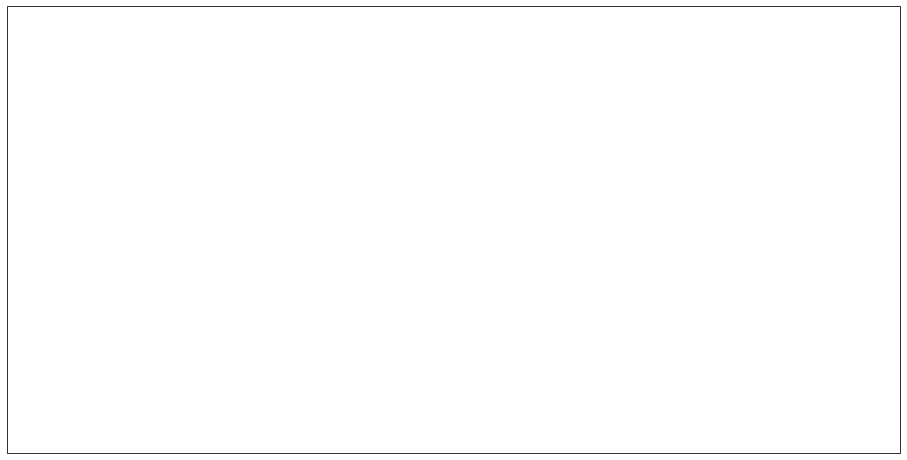

In [11]:
domain = "d01"  #2019-04-21 13
combo = '300hpa' # 300 hpa 850 hpa

if domain=='d01':
    grid_spacing = 9000.
    winds_thin=10
elif domain=='d02':
    grid_spacing=3000.
    winds_thin=25
else:
    print('provide correct value of grid spacing!!!')
    

#directory1='/glade/u/home/isingh9/scratch/cu_scheme_ON_latent_heat_on_20km/'
directory1="/glade/u/home/isingh9/scratch/WRF_4.3_run_theta_tend_template/" #LHT_ON_70_vertlevs_maxdom2/'
#directory2='/glade/u/home/isingh9/scratch/WRF_4.3_run_theta_tend_template/LHT_OFF_70_vertlevs_maxdom2/'

##### 
# file list from composites in Section 13
#DIRECTORY = dir_zhi
#TIMES     = [pd.to_datetime('2019-03-20 02:00:00'),pd.to_datetime('2019-03-20 07:00:00')] #final_df_vhigh_pvadv_vhigh_mi_pc.index[0:2]
#fi_list1 = [DIRECTORY+'wrfout_d01_'+TIME.strftime('%Y-%m-%d_%H:%M:%S') for TIME in TIMES]
#print(fi_list1)
####
file_finding_string = "wrfout_"+domain+"_2018-12-13_12:00:00"
fi_list1=(sorted(glob.glob(directory1+file_finding_string)))

if combo == 'surface':
    main_variable            = 'eth'
    lev_min                  = 285 # have to provide this
    lev_max                  = 381
    lev_spacing              = 1
    main_var_level           = 0
    main_var_level_type      = 'model'
    main_var_smooth          = False
    panel_plot               = False
    save_png                 = True
    experiment_name          = 'LT'#'LHT_exps_two_lh_on_'
    run_name                 = 'latent_heat_onoff_exps'
    variable_and_level       = main_variable + '_' + main_var_level_type + '_' + str(main_var_level)
    common_cmap              = cma4
    secondary_variable_plot  = True
    secondary_variable_name  = 'slp'
    secondary_variable_leveltype = '2D'
    secondary_variable_level = ''
    secondary_variable_min   = 980
    secondary_variable_step  = 3
    secondary_variable_max   = 1010
    secondary_variable_cmap_or_color = 'k'
    secondary_variable_lw    = 1.6
    secondary_variable_clabel= True 
    secondary_variable_smoothing = True 
    plot_winds               = True
    winds_type               = 'regular'
    winds_level_type         = 'sfc'
    winds_level              = ''
    plot_refl                = True
    refl_threshold           = 30
    refl_cont_color          = 'magenta'
    plot_uh                  = False
    plot_rain                = False
    plot_rainrate            = False
    plot_mslp                = False
    plot_hgts1               = False
    plot_hgts1_level         = False
    plot_hgts1_color         = False
    plot_hgts2               = False
    plot_hgts2_level         = False
    plot_hgts2_color         = False  
    hatching                 = False
    hatching_variable        = 'wspd'
    hatching_var_level       = 300
    hatching_var_cont_color  ='green'
    
elif combo == '300hpa':
    main_variable            = 'wspd'
    lev_min                  = 30 # have to provide this
    lev_max                  = 71
    lev_spacing              = 1
    main_var_level           = 300
    main_var_level_type      = 'pressure'
    main_var_smooth          = False
    panel_plot               = False
    save_png                 = False
    experiment_name          = 'LT'#'LHT_exps_two_lh_on_'
    run_name                 ='latent_heat_onoff_exps_13-14dec'
    variable_and_level       = main_variable + '_' + main_var_level_type + '_' + str(main_var_level)
    common_cmap              = cma4
    secondary_variable_plot  = True
    secondary_variable_name  = 'z'
    secondary_variable_leveltype='pressure'
    secondary_variable_level = 300
    secondary_variable_min   = 8000
    secondary_variable_step  = 40
    secondary_variable_max   = 15000
    secondary_variable_cmap_or_color = 'k'
    secondary_variable_lw    = 1.6
    secondary_variable_clabel= True
    secondary_variable_smoothing=False
    plot_winds               = True
    winds_type               = 'regular'
    winds_level_type         = 'p_level'
    winds_level              = 300
    plot_refl                = True
    refl_threshold           = 30
    refl_cont_color          = 'magenta'
    plot_uh                  = False
    plot_rain                = False
    plot_rainrate            = False
    plot_mslp                = False
    plot_hgts1               = False
    plot_hgts1_level         = False
    plot_hgts1_color         = False
    plot_hgts2               = False
    plot_hgts2_level         = False
    plot_hgts2_color         = False  
    hatching                 = False
    hatching_variable        = 'wspd'
    hatching_var_level       = 300
    hatching_var_cont_color  = 'green'
    
elif combo=='850hpa':
    main_variable='wspd'
    lev_min                  = 8 # have to provide this
    lev_max                  = 31
    lev_spacing              = 1
    main_var_level           = 850
    main_var_level_type      = 'pressure'
    main_var_smooth          = False
    panel_plot               = False
    save_png                 = False
    experiment_name          = 'LT'#'LHT_exps_two_lh_on_'
    run_name                 = 'latent_heat_on_exps'
    variable_and_level       = main_variable + '_' + main_var_level_type + '_' + str(main_var_level)
    common_cmap              = cma4
    secondary_variable_plot  = True
    secondary_variable_name  = 'z'
    secondary_variable_leveltype='pressure'
    secondary_variable_level = 850
    secondary_variable_min   = 2000
    secondary_variable_step  = 40
    secondary_variable_max   = 15000
    secondary_variable_cmap_or_color='k'
    secondary_variable_lw    = 1.3
    secondary_variable_clabel= True
    secondary_variable_smoothing = True
    plot_winds               = True
    winds_type               = 'regular'
    winds_level_type         = 'p_level'
    winds_level              = 850
    plot_refl                = True
    refl_threshold           = 30
    refl_cont_color          = 'magenta'
    plot_uh                  = False
    plot_rain                = False
    plot_rainrate            = False
    plot_mslp                = False
    plot_hgts1               = False
    plot_hgts1_level         = False
    plot_hgts1_color         = False
    plot_hgts2               = False
    plot_hgts2_level         = False
    plot_hgts2_color         = False  
    hatching                 = False
    hatching_variable        = 'wspd'
    hatching_var_level       = 300
    hatching_var_cont_color  = 'magenta'
    
    
elif combo == 'pv':
    main_variable            = 'pvo'
    lev_min                  = -9 # have to provide this
    lev_max                  = 9.1
    lev_spacing              = .1
    main_var_level           = 250
    main_var_level_type      = 'pressure'
    main_var_smooth          = False
    panel_plot               = False
    save_png                 = False
    experiment_name          = 'LT'#'LHT_exps_two_lh_on_'
    run_name                 ='latent_heat_onoff_exps'
    variable_and_level       = main_variable + '_' + main_var_level_type + '_' + str(main_var_level)
    common_cmap              = cma1
    secondary_variable_plot  = True
    secondary_variable_name  = 'z'
    secondary_variable_leveltype='pressure'
    secondary_variable_level = 250
    secondary_variable_min   = 8000
    secondary_variable_step  = 40
    secondary_variable_max   = 16000
    secondary_variable_cmap_or_color = 'k'
    secondary_variable_lw    = 1.6
    secondary_variable_clabel= True
    secondary_variable_smoothing=False
    plot_winds               = True
    winds_type               = 'regular'
    winds_level_type         = 'p_level'
    winds_level              = 250
    plot_refl                = True
    refl_threshold           = 30
    refl_cont_color          = 'magenta'
    plot_uh                  = False
    plot_rain                = False
    plot_rainrate            = False
    plot_mslp                = False
    plot_hgts1               = False
    plot_hgts1_level         = False
    plot_hgts1_color         = False
    plot_hgts2               = False
    plot_hgts2_level         = False
    plot_hgts2_color         = False  
    hatching                 = True
    hatching_variable        = 'wspd'
    hatching_var_level       = 250
    hatching_var_cont_color  = 'green'
else:
    print('no')

pt2=[-27,-65]
pt1=[-27,-60]

ii = 0 

#
#######
for file1 in fi_list1:
    print('file 1 : ',file1)
    
    if panel_plot:
        #fig = plt.figure(figsize=(16,14)) # Create a figure (for one subplot)
        fig = plt.figure(figsize=(16,14)) # Create a figure (for two subplots)
        #fig = plt.figure(figsize=(16,14)) # Create a figure (for three subplots)
        
        file2 = fi_list2[ii]
        #file3 = fi_list3[ii]
        print('file 2 : ',file2)
        #print('file 3 : ',file3)
        
        ax1 = fig.add_subplot(1, 2, 1, projection=crs.PlateCarree())
        ax2 = fig.add_subplot(1, 2, 2, projection=crs.PlateCarree())
        # ax3 = fig.add_subplot(1, 3, 3, projection=crs.PlateCarree())
    else:
        fig = plt.figure(figsize=(16,12)) # Create a figure
        ax1 = fig.add_subplot(1, 1, 1, projection=crs.PlateCarree())
        
    
    cont_out1, tim1 = plot_WRF_3dvar(run_name,domain,'','(a)',file1, grid_spacing, main_var_level_type,main_variable,main_var_level,main_var_smooth,\
                    lev_min,lev_max,lev_spacing,20,common_cmap,\
                    'small_area',lons,lats,True,\
                    [secondary_variable_plot,secondary_variable_name,secondary_variable_leveltype,secondary_variable_level,secondary_variable_min,secondary_variable_max,secondary_variable_step,secondary_variable_cmap_or_color,secondary_variable_lw,secondary_variable_clabel,secondary_variable_smoothing],\
                    plot_winds,[winds_type,winds_level_type,winds_level],[plot_refl,refl_threshold,refl_cont_color],plot_uh,plot_uh,plot_rain,plot_rainrate,plot_mslp,[plot_hgts1,plot_hgts1_level,plot_hgts1_color],[plot_hgts2,plot_hgts2_level,plot_hgts2_color],\
                    [hatching,hatching_variable,hatching_var_level,hatching_var_cont_color],\
                    winds_thin,\
                    False,pt1,pt2,\
                    terr,ax1) 
    if panel_plot:
        #print('--')
        cont_out2, tim2 = plot_WRF_3dvar(run_name,domain,'','(a)',file2, grid_spacing, main_var_level_type,main_variable,main_var_level,main_var_smooth,\
                    lev_min,lev_max,lev_spacing,20,common_cmap,\
                    'small_area',lons,lats,True,\
                    [secondary_variable_plot,secondary_variable_name,secondary_variable_leveltype,secondary_variable_level,secondary_variable_min,secondary_variable_max,secondary_variable_step,secondary_variable_cmap_or_color,secondary_variable_lw],\
                    plot_winds,[winds_type,winds_level_type,winds_level],[plot_refl,refl_threshold,refl_cont_color],plot_uh,plot_uh,plot_rain,plot_rainrate,plot_mslp,[plot_hgts1,plot_hgts1_level,plot_hgts1_color],[plot_hgts2,plot_hgts2_level,plot_hgts2_color],\
                    [hatching,hatching_variable,hatching_var_level,hatching_var_cont_color],\
                    winds_thin,\
                    False,pt1,pt2,\
                    terr,ax2) 
    ###########################################################################

    #cb_ax = fig.add_axes([0.2, 0.01, 0.6, 0.03]) 
    #[left, bottom, width, height]
    if panel_plot:
        #cb_ax = fig.add_axes([0.2, 0.3, 0.6, 0.02])  
        cb_ax = fig.add_axes([0.2, 0.245, 0.6, 0.02])  # two panels
        cbar = fig.colorbar(cont_out1, cax=cb_ax, orientation = 'horizontal')
        #cbar.formatter.set_powerlimits((0,0))
        plt.tight_layout()
    else:
        cbar = fig.colorbar(cont_out1,  orientation = 'horizontal',fraction=0.09,shrink=0.6,aspect=30,pad=0.02) #cax=cb_ax,
        #cbar.formatter.set_powerlimits((0,0))
        plt.tight_layout()
    
    if save_png:
        filename= (experiment_name + '_' + domain +'_'+ variable_and_level +'_' + tim1 + '.png').replace(":", "-")
        print(filename)   
        plt.savefig(filename,dpi=200,bbox_inches='tight')
    
    ii = ii + 1
    print('#######')
    print('\n\n')
    #plt.close()

## Parallel execution of the standard combinations

In [14]:
# perform calculations on a sub-domain to speed things up
from multiprocessing import Pool
import os
import time

def plot_WRF_3dvar_parallel(RUN, DOMAIN,SUPTITLE,PANEL_TEXT,FILE,GRID_SPACING_XY,VARTYPE,VARNAME,LEVEL,VAR_SMOOTH,\
                   MIN_LEV,MAX_LEV,STEP_LEV,NUMLEVELS,COLORMAP,\
                   AREA_TAG,LONS,LATS,LATLON_LABELS,\
                   PLOT_ANOTHER_VAR_CONT,\
                   PLOT_WINDS,WINDS_INFO,PLOT_REFL,PLOT_UH,PLOT_UPDRAFT,PLOT_RAIN,PLOT_RAIN_RATE,PLOT_MSLP,PLOT_HGTS,PLOT_HGTS1,\
                   HATCHING,\
                   WINDS_THIN_XY,\
                   PLOT_LINE,PT1,PT2,\
                   TERR):
    
    
    fig = plt.figure(figsize=(16,12)) # Create a figure
    AX = fig.add_subplot(1, 1, 1, projection=crs.PlateCarree())
    
    # Open the NetCDF file
    nc_file = Dataset(FILE)

    wrf_times = getvar(nc_file,'times')
    tiempo = np.datetime_as_string(wrf_times.values, timezone='UTC',unit='m')
        
    if VARTYPE!='2D':
        var2d = get_var_at_level_from_wrfoutput(nc_file,VARNAME,VARTYPE,LEVEL,terr,temp)
        #print(var2d)
        save_string =  DOMAIN+'_'+VARNAME+'_at_'+VARTYPE+'_'+str(LEVEL)+'_'+tiempo+'_'+AREA_TAG+'.png'
        title_string = var2d.description + ' (' +var2d.units + ') \n'
        #title_string = title_string.replace ('at ', '\nat ')
    elif VARTYPE=='2D':
        var2d = get_var_at_level_from_wrfoutput(nc_file,VARNAME,VARTYPE,LEVEL,terr,temp)
        save_string = VARNAME
        title_string = var2d.description + ' (' +var2d.units + ') \n'
    else:
        print('The values of VARTYPE can only be <2D> or <pressure> or <height> or <model> or <pv> !')
        
    print('minimum  value of var: ',np.nanmin(var2d.values))
    print('maximum  value of var: ',np.nanmax(var2d.values))
        
    if VAR_SMOOTH:
        print('smoothing the primary variable...')
        var2d.values = ndimage.gaussian_filter(var2d.values, sigma=1.5, order=0)
    #print(var2d)
    
    if PLOT_ANOTHER_VAR_CONT[0]:
        var2d_1 = get_var_at_level_from_wrfoutput(nc_file,PLOT_ANOTHER_VAR_CONT[1],PLOT_ANOTHER_VAR_CONT[2],PLOT_ANOTHER_VAR_CONT[3],terr,temp)
        
        if PLOT_ANOTHER_VAR_CONT[10]:
            print('smoothing the secondary variable...')
            var2d_1.values = ndimage.gaussian_filter(var2d_1.values, sigma=1.5, order=0)
            
        if PLOT_ANOTHER_VAR_CONT[5]:
            if isinstance(PLOT_ANOTHER_VAR_CONT[7],str):
                levels  = np.arange(PLOT_ANOTHER_VAR_CONT[4],PLOT_ANOTHER_VAR_CONT[5],PLOT_ANOTHER_VAR_CONT[6])
                levels = levels[levels!=0]
                #np.where(levels >= 0, "-", "--")
                C111 = AX.contour(LONS ,LATS, var2d_1.values,transform=crs.PlateCarree(),levels=levels,colors=PLOT_ANOTHER_VAR_CONT[7],linestyles='-',linewidths=PLOT_ANOTHER_VAR_CONT[8])
            elif isinstance(PLOT_ANOTHER_VAR_CONT[7],matplotlib.colors.LinearSegmentedColormap):
                levels  = np.arange(PLOT_ANOTHER_VAR_CONT[4],PLOT_ANOTHER_VAR_CONT[5],PLOT_ANOTHER_VAR_CONT[6])
                levels = levels[levels!=0]
                C111 = AX.contour(LONS ,LATS, var2d_1.values,transform=crs.PlateCarree(),levels=levels,cmap=PLOT_ANOTHER_VAR_CONT[7],linewidths=PLOT_ANOTHER_VAR_CONT[8],linestyles='-')#,linestyles='--')
                #C111.monochrome = True
                #for col, ls in zip(C111.collections, C111._process_linestyles()):
                #    col.set_linestyle(ls)
            else:
                print('Need to specify correct color/colormap for the secondary contour')
                #break
        else:
            #print('no max value given for secondary variable')
            levels  = np.arange(PLOT_ANOTHER_VAR_CONT[4],PLOT_ANOTHER_VAR_CONT[5],PLOT_ANOTHER_VAR_CONT[6])
            C111 = AX.contour(LONS ,LATS, var2d_1.values,transform=crs.PlateCarree(),levels=[PLOT_ANOTHER_VAR_CONT[4]],colors=PLOT_ANOTHER_VAR_CONT[7],linestyles='--',linewidths=PLOT_ANOTHER_VAR_CONT[8])
        
        if PLOT_ANOTHER_VAR_CONT[9]:
            plt.clabel(C111, inline=1, fontsize=10, fmt="%i")
            
        
    if PLOT_UH:
        uh = getvar(nc_file,'updraft_helicity')
        C0 = AX.contour(LONS, LATS, uh.values,transform=crs.PlateCarree(),\
                 levels = [-250.],colors='blue',linestyles='-')
    
    if PLOT_UPDRAFT:
        wa_ud = getvar(nc_file,'wa')
        ww = wa_ud[12:31,:,:].mean(axis=0)
        #print(ww)
        AX.contour(LONS, LATS, ww.values,levels=[8.],\
                     linewidths=1.3,colors="green",transform=crs.PlateCarree()) #fuchsia
        
    if PLOT_RAIN:
        RAINC = getvar(nc_file,'RAINC')
        rain = RAINC + getvar(nc_file,'RAINNC') + getvar(nc_file,'RAINSH')
        rain.attrs['description'] = 'total rain'
        rain.attrs['units'] = RAINC.units
        AX.contour(LONS ,LATS, rain.values,transform=crs.PlateCarree(),\
             cmap=cma4,linewidths=1.3)
        
    if PLOT_RAIN_RATE:
        search_string = (pd.to_datetime(wrf_times.values) -  pd.Timedelta(minutes=60)).strftime("%Y-%m-%d_%H:%M:%S")
        second_file = sorted(glob.glob(directory+"wrfout_d01_"+search_string))
        
        rainc = getvar(nc_file,'RAINC')
        rain = rainc + getvar(nc_file,'RAINNC') + getvar(nc_file,'RAINSH')
        rain.attrs['description'] = 'total rain'
        rain.attrs['units'] = rainc.units
        
        nc_file1 = Dataset(second_file[0])
        rainc1 = getvar(nc_file1,'RAINC')
        rain1 = rainc1 + getvar(nc_file1,'RAINNC') + getvar(nc_file1,'RAINSH')
        rain1.attrs['description'] = 'total rain'
        rain1.attrs['units'] = rainc1.units
        
        rr = (rain - rain1)/60.
        rr.attrs['description'] = 'rain rate'
        rr.attrs['units'] = 'mm/min'
        
        nc_file1.close()
        
        #print(rr)
        #print('max value  of rr =',rr.max())
        #print('min value  of rr =',rr.min())
        
        C4_1 = AX.contour(LONS ,LATS, rr.values,levels=np.arange(0.4,2.8,0.4),transform=crs.PlateCarree(),\
             cmap=cma4,linewidths=1.3,extend=True) # cma4 plt.get_cmap('autumn')
        #
    
    if MIN_LEV!=None:
        levels  = np.arange(MIN_LEV,MAX_LEV,STEP_LEV)
        C1 = AX.contourf(LONS ,LATS, var2d.values,transform=crs.PlateCarree(),levels=levels,\
             extend='both',cmap=COLORMAP)
    else:
        var2d_without_inf = np.where((var2d==np.inf),-1.0*10**-34,var2d)
        var2d_without_inf = np.where((var2d_without_inf==np.nan),-1.0*10**-34,var2d_without_inf)
        if (np.nanmin(var2d_without_inf))==0.0 and (np.nanmax(var2d_without_inf))==0.0:
            C1 = AX.contourf(LONS, LATS, var2d.values,transform=crs.PlateCarree(),\
                 extend='both',cmap=COLORMAP)
        else:
            C1 = AX.contourf(LONS, LATS, var2d.values,transform=crs.PlateCarree(),\
                 levels = np.linspace(np.amin(var2d.values),np.amax(var2d.values),NUMLEVELS),extend='both',\
                 cmap=COLORMAP)
    AX.background_patch.set_facecolor('gray')
    
    # Terrain
    C2 = AX.contour(LONS, LATS, TERR, np.array([1000.]),\
                     linewidths=1.4,colors="saddlebrown",transform=crs.PlateCarree())
    #np.array([500.,1000.,1500.,2000.,2500.])
    
    if PLOT_WINDS:
        n=2
        winds_thin_x=WINDS_THIN_XY
        
        if WINDS_INFO[0]=='regular':
            if WINDS_INFO[1]=='sfc':
                print('plotting wind barbs at the surface')
                u10,v10=getvar(nc_file,'uvmet10')
                C3=AX.barbs(LONS[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x], LATS[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x],\
                       u10[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x],\
                       v10[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x],linewidth=0.9, length=5, pivot='middle',transform=crs.PlateCarree(),\
                            flip_barb=True)

                #if WIND_STYLE=='sl':
                #    C3=AX.streamplot(LONS, LATS, u10.values, v10.values, density=1, linewidth=0.9, color='k', cmap=None,\
                #              norm=None, arrowsize=1.5, arrowstyle='-|>', minlength=0.1, transform=crs.PlateCarree(),\
                #              zorder=None, start_points=None, integration_direction='both',data=None)

            elif WINDS_INFO[1]=='p_level':
                print('plotting wind barbs at pressure level ',WINDS_INFO[2])
                u, v = getvar(nc_file,'uvmet')
                p = getvar(nc_file, "pressure")
                u10 = interplevel(u, p, WINDS_INFO[2])
                v10 = interplevel(v, p, WINDS_INFO[2])
                C3=AX.barbs(LONS[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x], LATS[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x],\
                       u10[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x],\
                       v10[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x],linewidth=0.9, length=5, pivot='middle',transform=crs.PlateCarree(),\
                            flip_barb=True)  

            elif WINDS_INFO[1]=='z_level':
                print('plotting wind barbs at height level ',WINDS_INFO[2])
                u, v = getvar(nc_file,'uvmet')
                z = getvar(nc_file, "z")
                u10 = interplevel(u, z, WINDS_INFO[2])
                v10 = interplevel(v, z, WINDS_INFO[2])
                C3=AX.barbs(LONS[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x], LATS[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x],\
                       u10[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x],\
                       v10[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x],linewidth=0.9, length=5, pivot='middle',transform=crs.PlateCarree(),\
                            flip_barb=True)
                
        elif WINDS_INFO[0]=='geostrophic':
            if WINDS_INFO[1]=='p_level':
                print('plotting geostrophic wind barbs at pressure level ',WINDS_INFO[2])
                lat_2d = getvar(nc_file,'lat')
                p = getvar(nc_file, "pressure")
                geo_hgts_3d = getvar(nc_file,'height')
                geo_hgts = interplevel(geo_hgts_3d, p, WINDS_INFO[2])
                geo_wind_u, geo_wind_v = mpcalc.geostrophic_wind(geo_hgts.values*units.m,latitude=np.deg2rad(lat_2d.values),dx=20000.*units.m,dy=20000.*units.m)
                u10 = geo_wind_u.magnitude
                v10 = geo_wind_v.magnitude
                C3=AX.barbs(LONS[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x], LATS[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x],\
                       u10[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x],\
                       v10[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x],linewidth=0.9, length=5, pivot='middle',transform=crs.PlateCarree(),\
                            flip_barb=True)
            elif WINDS_INFO[1]=='z_level':
                print('plotting geostrophic wind barbs at height level ',WINDS_INFO[2])
                #z = getvar(nc_file, "z")
                lat_2d = getvar(nc_file,'lat')
                geo_hgts_3d = getvar(nc_file,'height')
                geo_hgts = interplevel(geo_hgts_3d, geo_hgts_3d, WINDS_INFO[2])
                geo_wind_u, geo_wind_v = mpcalc.geostrophic_wind(geo_hgts.values*units.m,latitude=np.deg2rad(lat_2d.values),dx=20000.*units.m,dy=20000.*units.m)
                u10 = geo_wind_u.magnitude
                v10 = geo_wind_v.magnitude
                C3=AX.barbs(LONS[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x], LATS[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x],\
                       u10[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x],\
                       v10[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x],linewidth=0.9, length=5, pivot='middle',transform=crs.PlateCarree(),\
                            flip_barb=True)
        elif WINDS_INFO[0]=='ageostrophic':
            if WINDS_INFO[1]=='p_level':
                print('plotting  ageostrophic wind barbs at pressure level ',WINDS_INFO[2])
                lat_2d = getvar(nc_file,'lat')
                p = getvar(nc_file, "pressure")
                geo_hgts_3d = getvar(nc_file,'height')
                u_3d = getvar(nc_file,'ua')
                v_3d = getvar(nc_file,'va')
                geo_hgts = interplevel(geo_hgts_3d, p, WINDS_INFO[2])
                u_2d     = interplevel(u_3d       , p, WINDS_INFO[2])
                v_2d     = interplevel(v_3d       , p, WINDS_INFO[2])
                ageo_wind_u, ageo_wind_v = mpcalc.ageostrophic_wind(geo_hgts.values*units.m,u=u_2d, v = v_2d, latitude=np.deg2rad(lat_2d.values),dx=20000.*units.m,dy=20000.*units.m)
                u10 = ageo_wind_u.magnitude
                v10 = ageo_wind_v.magnitude
                C3=AX.barbs(LONS[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x], LATS[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x],\
                       u10[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x],\
                       v10[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x],linewidth=0.9, length=5, pivot='middle',transform=crs.PlateCarree(),\
                            flip_barb=True)
            elif WINDS_INFO[1]=='z_level':
                print('plotting ageostrophic wind barbs at height level ',WINDS_INFO[2])
                #z = getvar(nc_file, "z")
                lat_2d = getvar(nc_file,'lat')
                geo_hgts_3d = getvar(nc_file,'height')
                u_3d = getvar(nc_file,'ua')
                v_3d = getvar(nc_file,'va')
                geo_hgts = interplevel(geo_hgts_3d, geo_hgts_3d, WINDS_INFO[2])
                u_2d     = interplevel(u_3d       , geo_hgts_3d, WINDS_INFO[2])
                v_2d     = interplevel(v_3d       , geo_hgts_3d, WINDS_INFO[2])
                ageo_wind_u, ageo_wind_v = mpcalc.ageostrophic_wind(geo_hgts.values*units.m,u=u_2d, v = v_2d, latitude=np.deg2rad(lat_2d.values),dx=20000.*units.m,dy=20000.*units.m)
                u10 = ageo_wind_u.magnitude
                v10 = ageo_wind_v.magnitude
                C3=AX.barbs(LONS[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x], LATS[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x],\
                       u10[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x],\
                       v10[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x],linewidth=0.9, length=5, pivot='middle',transform=crs.PlateCarree(),\
                            flip_barb=True)
                
        elif WINDS_INFO[0]=='Q-vector':
            winds_thin_x=10
            n_reps_quiver = 50
            if WINDS_INFO[1]=='p_level':
                print('plotting Q-vectors at ',WINDS_INFO[2],' hPa')
                p      = getvar(nc_file, "pressure")
                z      = getvar(nc_file, "height")
                #theta  = getvar(nc_file, "theta")
                u_3d   = getvar(nc_file,'ua')
                v_3d   = getvar(nc_file,'va')
                tk_3d  = getvar(nc_file,'tk')
                
                u_2d     = interplevel(u_3d       , p, WINDS_INFO[2]).values*units('m/s')
                v_2d     = interplevel(v_3d       , p, WINDS_INFO[2]).values*units('m/s')
                tk_2d    = interplevel(tk_3d      , p, WINDS_INFO[2]).values*units('K'  )
                print('temp ',tk_2d)
                
                u_2d_s   = mpcalc.smooth_n_point(u_2d,  9, n_reps_quiver)
                v_2d_s   = mpcalc.smooth_n_point(v_2d,  9, n_reps_quiver)
                tk_2d_s  = mpcalc.smooth_n_point(tk_2d, 9, n_reps_quiver)
                
                lat_2d = getvar(nc_file,'lat')
                lon_2d = getvar(nc_file,'lon')
                dx, dy = mpcalc.lat_lon_grid_deltas(lon_2d.values*units('degrees'),lat_2d.values*units('degrees'))
                
                #dp     = (p[1:,:,:].values*100.0 - p[:-1,:,:].values*100.0)
                #sigma    = (mpconstants.Rd.magnitude * tk_2d_s.magnitude/WINDS_INFO[2]*100.0)*mpcalc.first_derivative(np.log(theta.values), axis=0, delta=dp)
                #sigma_2d = interplevel(sigma       , p.values, WINDS_INFO[2]).units('m^2 Pa^-2 s^-2')
                #print(sigma) 
                
                u10, v10 = mpcalc.q_vector(u_2d_s, v_2d_s, tk_2d_s, WINDS_INFO[2]*units('hPa'), dx=dx, dy=dy)
                print(u10)
                C3231=AX.quiver(LONS[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x], LATS[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x],\
                       u10[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x].m,\
                       v10[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x].m,pivot='middle',scale=2e-11, scale_units='inches',transform=crs.PlateCarree())
                #qk = AX.quiverkey(C3231, 0.49, 0.95, 500, r'$ 500 kg m^{-1} s^{-1}$', labelpos='E',
                #       coordinates='figure')
                
        elif WINDS_INFO[0]=='IVT':
            print('plotting IVT vectors...')
            qq = getvar(nc_file,'QVAPOR')[0:-1,:,:]
            #print()
            u,v = getvar(nc_file,'uvmet')
            #v = getvar(NC_FILE,'va')
            u = u[0:-1,:,:]
            v = v[0:-1,:,:]
            tk = getvar(nc_file,'tk')[0:-1,:,:]
            p = getvar(nc_file,'p',units='Pa')[0:-1,:,:]
            heights = getvar(nc_file,'z')
            rho = p.values/(281.0 * tk.values)

            lat_2d = getvar(nc_file,'lat')
            lon_2d = getvar(nc_file,'lon')
            dx, dy = mpcalc.lat_lon_grid_deltas(lon_2d.values*units('degrees'),lat_2d.values*units('degrees'))
            dx = dx[None,:,:]
            dy = dy[None,:,:]
            dz =  heights[1:,:,:].values - heights[:-1,:,:].values
            #print('dz: ',dz)
            u10 = np.sum(qq*rho*u*dz,axis=0) 
            v10 = np.sum(qq*rho*v*dz,axis=0) 
            #print('shape of ivt 3d: ', np.shape(ivt_3d))
            C3231=AX.quiver(LONS[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x], LATS[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x],\
                   u10[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x],\
                   v10[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x],pivot='middle',transform=crs.PlateCarree())
            qk = AX.quiverkey(C3231, 0.49, 0.95, 500, r'$ 500 kg m^{-1} s^{-1}$', labelpos='E',
                   coordinates='figure')

        else:
            print('please provide correct value of WINDS_TYPE: sfc, p_level, or z_level')
        
    if PLOT_REFL[0]:
        print('plotting '+str(int(PLOT_REFL[1]))+'-dBZ reflectivity contours')
        refl = getvar(nc_file,'dbz')[0,:,:].values
        refl[refl < -5.0] = 0.0
        #print(np.max(refl))
        C4 = AX.contour(LONS ,LATS, refl,transform=crs.PlateCarree(),levels=[PLOT_REFL[1]],colors=PLOT_REFL[2],linestyle='-')
   
    if PLOT_MSLP:
        print('plotting mslp')
        slp = getvar(nc_file,'slp')
        C41 = AX.contour(LONS ,LATS, slp.values,transform=crs.PlateCarree(),levels=np.arange(990,1010,2),colors='k',linestyles='-',linewidths=0.5)
        plt.clabel(C41,fontsize=9)
        
    if PLOT_HGTS[0]:
        p = getvar(nc_file, "pressure")
        z = getvar(nc_file, "z", units="m")
        z_prs_lvl = interplevel(z, p, PLOT_HGTS[1])
        if PLOT_HGTS[1]==850:
            levs=np.arange(1000,3500,40)
        elif PLOT_HGTS[1]==700:
            levs=np.arange(2000,4500,40)
        elif PLOT_HGTS[1]==500:
            levs=np.arange(5000,6000,40)
        elif PLOT_HGTS[1]==300:
            levs=np.arange(8000,10000,40)
        elif PLOT_HGTS[1]==250:
            levs=np.arange(10000,13000,40)
        elif PLOT_HGTS[1]==200:
            levs=np.arange(10000,13000,40)
        else:
            levs=np.arange(1000,13000,40)
        C42 = AX.contour(LONS ,LATS, z_prs_lvl.values,transform=crs.PlateCarree(),levels=levs,colors=PLOT_HGTS[2],linestyle='-',linewidth=0.4)
        plt.clabel(C42, inline=1, fontsize=10, fmt="%i")
        
    if PLOT_HGTS1[0]:
        print('plotting additional heights for ',PLOT_HGTS1[1],' hPa')
        p = getvar(nc_file, "pressure")
        z = getvar(nc_file, "z", units="m")
        z_prs_lvl = interplevel(z, p, PLOT_HGTS1[1])
        #print(z_prs_lvl)
        if PLOT_HGTS1[1]==850:
            levs=np.arange(1000,3500,20)
        elif PLOT_HGTS1[1]==700:
            levs=np.arange(2000,4500,40)
        elif PLOT_HGTS1[1]==500:
            levs=np.arange(5000,6000,40)
        elif PLOT_HGTS1[1]==300:
            levs=np.arange(8000,10000,40)
        elif PLOT_HGTS1[1]==250:
            levs=np.arange(10000,13000,40)
        elif PLOT_HGTS1[1]==200:
            levs=np.arange(10000,13000,40)
        else:
            levs=np.arange(1000,13000,40)
        C422 = AX.contour(LONS ,LATS, z_prs_lvl.values,transform=crs.PlateCarree(),levels=levs,colors=PLOT_HGTS1[2],linestyle='-',linewidth=0.4)
        plt.clabel(C422, inline=1, fontsize=10, fmt="%i")
        
        
    if HATCHING[0]:
        print('hatching '+HATCHING[1]+' values at pressure level ',HATCHING[2],' hPa')
        p = getvar(nc_file, "pressure")
        hatch_var = getvar(nc_file, HATCHING[1])
        hatch_var_prs_lvl = interplevel(hatch_var, p, HATCHING[2]).values
        C423 = AX.contourf(LONS ,LATS, hatch_var_prs_lvl, levels=np.arange(50,90,10), transform=crs.PlateCarree(),colors=HATCHING[3],alpha=0.09)#,hatches=['', '..'],  alpha=0.25)
        C4231 = AX.contour(LONS ,LATS, hatch_var_prs_lvl, levels=np.arange(50,90,10), transform=crs.PlateCarree(),colors=HATCHING[3],alpha=0.35,linewidths=1.8)

        #plt.clabel(C423, inline=1, fontsize=10, fmt="%i")
    
    if PLOT_LINE:
        AX.plot([PT1[1],PT2[1]],[PT1[0],PT2[0]],transform=crs.PlateCarree(),color='black')
        
    #AX.add_patch(mpatches.Rectangle(xy=[-90, -50], width=50, height=30,
    #                                facecolor='blue',
    #                                alpha=0.2,
    #                                transform=crs.PlateCarree()))

    # Add the gridlines
    gl = AX.gridlines()#color="gray",alpha=0.5, linestyle='--',draw_labels=True,linewidth=2)
    AX.coastlines(resolution='110m')
    gl.xlines = True
    gl.ylines = True
    if LATLON_LABELS:
        print('LATLON labels are on')
        gl.xlabels_top = True
        gl.ylabels_right = False
        gl.ylabels_left = True
        gl.ylabels_bottom = True
    else:
        gl.xlabels_top = False
        gl.ylabels_right = False
        gl.ylabels_left = False
        gl.ylabels_bottom = True
    #gl.xlines = False
    #gl.xlocator = mticker.FixedLocator([-67, -66, 0, 45, 180])
    gl.xformatter = LONGITUDE_FORMATTER
    gl.yformatter = LATITUDE_FORMATTER
    gl.xlabel_style = {'size': 15, 'color': 'gray'}#, 'weight': 'bold'}
    gl.ylabel_style = {'size': 15, 'color': 'gray'}#, 'weight': 'bold'}
    #MP_PHYSICS=ncfile.MP_PHYSICS
    #RA_LW_PHYSICS=ncfile.RA_LW_PHYSICS
    #RA_SW_PHYSICS=ncfile.RA_SW_PHYSICS
    #SF_SFCLAY_PHYSICS=ncfile.SF_SFCLAY_PHYSICS
    #SF_SURFACE_PHYSICS=ncfile.SF_SURFACE_PHYSICS
    #BL_PBL_PHYSICS=ncfile.BL_PBL_PHYSICS
    if SUPTITLE:
        title_string = title_string + ' (' + SUPTITLE + ')'
        #plt.suptitle(SUPTITLE, x=0.67,y=0.84, fontsize=8)
    
    AX.set_title(title_string + ' ' + tiempo, fontsize=16)
    
    #AX.text(x, y, s, bbox=dict(facecolor='red', alpha=0.5))
    #AX.text(x, y, s, bbox=dict(facecolor='red', alpha=0.5))
    if PANEL_TEXT:
        AX.annotate(PANEL_TEXT, xy=(0.04, 0.96), fontsize=12,
            xycoords='axes fraction', textcoords='offset points',
            bbox=dict(facecolor='white', alpha=0.9, boxstyle='round'),
            horizontalalignment='left', verticalalignment='top') #xytext=(-15, -15)
    #else:
    #    suptitle='MP:'+wrf_mp_physics[MP_PHYSICS]+'\n'+'SFC:'+wrf_sfc_physics[SF_SURFACE_PHYSICS]+'\n'+'Init. '+SIMULATION_START_DATE
   
    AX.set_extent([-85, -35, -50, -10], crs=crs.PlateCarree())
    if DOMAIN=='d02':
        AX.set_extent([-75, -50, -42, -20], crs=crs.PlateCarree())
    #if DOMAIN=='d01':
    #    AX.set_extent([-55, -30, -55, -10], crs=crs.PlateCarree())
    #AX.set_extent([-80, -45, -45, -10], crs=crs.PlateCarree())
    #AX.set_extent([-70, -55, -40, -20], crs=crs.PlateCarree())
    nc_file.close()
    print('------- X -------')
    
    cbar = fig.colorbar(C1,  orientation = 'horizontal',fraction=0.09,shrink=0.6,aspect=30,pad=0.02) #cax=cb_ax,
    #cbar.formatter.set_powerlimits((0,0))
    plt.tight_layout()
    
    filename= (RUN + '_' + domain + '_' + VARNAME + '_' + VARTYPE + '_' + str(LEVEL) +'_' + tiempo + '.png').replace(":", "-")
    print(filename)   
    plt.savefig(filename,dpi=150,bbox_inches='tight')
    # plt.close()
    #return C1, tiempo

combo ='surface'
domain='d02'
#'LHT_exps_two_lh_on_'

if domain=='d01':
    grid_spacing = 9000.
    winds_thin=15
elif domain=='d02':
    grid_spacing=3000.
    winds_thin=25
else:
    print('provide correct value of grid spacing!!!')

if combo == 'surface':
    main_variable            = 'eth'
    lev_min                  = 285 # have to provide this
    lev_max                  = 381
    lev_spacing              = 1
    main_var_level           = 0
    main_var_level_type      = 'model'
    panel_plot               = False
    save_png                 = True
    variable_and_level       = main_variable + '_' + main_var_level_type + '_' + str(main_var_level)
    common_cmap              = cma4
    secondary_variable_plot  = True
    secondary_variable_name  = 'slp'
    secondary_variable_leveltype = '2D'
    secondary_variable_level = ''
    secondary_variable_min   = 980
    secondary_variable_step  = 3
    secondary_variable_max   = 1010
    secondary_variable_cmap_or_color = 'k'
    secondary_variable_lw    = 1.6
    secondary_variable_clabel= True 
    secondary_variable_smoothing = True 
    plot_winds               = True
    winds_type               = 'regular'
    winds_level_type         = 'sfc'
    winds_level              = ''
    plot_refl                = True
    refl_threshold           = 30
    refl_cont_color          = 'magenta'
    plot_uh                  = False
    plot_rain                = False
    plot_rainrate            = False
    plot_mslp                = False
    plot_hgts1               = False
    plot_hgts1_level         = False
    plot_hgts1_color         = False
    plot_hgts2               = False
    plot_hgts2_level         = False
    plot_hgts2_color         = False  
    hatching                 = False
    hatching_variable        = 'wspd'
    hatching_var_level       = 300
    hatching_var_cont_color  ='green'
    
elif combo == '250hpa':
    main_variable            = 'wspd'
    lev_min                  = 35 # have to provide this
    lev_max                  = 81
    lev_spacing              = 1
    main_var_level           = 250
    main_var_level_type      = 'pressure'
    main_var_smooth          = False
    panel_plot               = False
    save_png                 = False
    variable_and_level       = main_variable + '_' + main_var_level_type + '_' + str(main_var_level)
    common_cmap              = cma4
    secondary_variable_plot  = True
    secondary_variable_name  = 'z'
    secondary_variable_leveltype='pressure'
    secondary_variable_level = 250
    secondary_variable_min   = 8000
    secondary_variable_step  = 40
    secondary_variable_max   = 16000
    secondary_variable_cmap_or_color = 'k'
    secondary_variable_lw    = 1.6
    secondary_variable_clabel= True
    secondary_variable_smoothing=False
    plot_winds               = True
    winds_type               = 'regular'
    winds_level_type         = 'p_level'
    winds_level              = 250
    plot_refl                = True
    refl_threshold           = 30
    refl_cont_color          = 'magenta'
    plot_uh                  = False
    plot_rain                = False
    plot_rainrate            = False
    plot_mslp                = False
    plot_hgts1               = False
    plot_hgts1_level         = False
    plot_hgts1_color         = False
    plot_hgts2               = False
    plot_hgts2_level         = False
    plot_hgts2_color         = False  
    hatching                 = False
    hatching_variable        = 'wspd'
    hatching_var_level       = 250
    hatching_var_cont_color  = 'green'
    
elif combo == '200hpa':
    main_variable            = 'wspd'
    lev_min                  = 35 # have to provide this
    lev_max                  = 81
    lev_spacing              = 1
    main_var_level           = 200
    main_var_level_type      = 'pressure'
    panel_plot               = False
    save_png                 = False
    variable_and_level       = main_variable + '_' + main_var_level_type + '_' + str(main_var_level)
    common_cmap              = cma4
    secondary_variable_plot  = True
    secondary_variable_name  = 'z'
    secondary_variable_leveltype='pressure'
    secondary_variable_level = 200
    secondary_variable_min   = 8000
    secondary_variable_step  = 40
    secondary_variable_max   = 18000
    secondary_variable_cmap_or_color = 'k'
    secondary_variable_lw    = 1.6
    secondary_variable_clabel= True
    secondary_variable_smoothing=False
    plot_winds               = True
    winds_type               = 'regular'
    winds_level_type         = 'p_level'
    winds_level              = 200
    plot_refl                = True
    refl_threshold           = 30
    refl_cont_color          = 'magenta'
    plot_uh                  = False
    plot_rain                = False
    plot_rainrate            = False
    plot_mslp                = False
    plot_hgts1               = False
    plot_hgts1_level         = False
    plot_hgts1_color         = False
    plot_hgts2               = False
    plot_hgts2_level         = False
    plot_hgts2_color         = False  
    hatching                 = False
    hatching_variable        = 'wspd'
    hatching_var_level       = 200
    hatching_var_cont_color  = 'green'
    
elif combo=='850hpa':
    main_variable='wspd'
    lev_min                  = 8 # have to provide this
    lev_max                  = 31
    lev_spacing              = 1
    main_var_level           = 850
    main_var_level_type      = 'pressure'
    main_var_smooth          = False
    panel_plot               = False
    save_png                 = False
    experiment_name          = 'LT'#'LHT_exps_two_lh_on_'
    run_name                 = 'latent_heat_on_exps'
    variable_and_level       = main_variable + '_' + main_var_level_type + '_' + str(main_var_level)
    common_cmap              = cma4
    secondary_variable_plot  = True
    secondary_variable_name  = 'z'
    secondary_variable_leveltype='pressure'
    secondary_variable_level = 850
    secondary_variable_min   = 100
    secondary_variable_step  = 20
    secondary_variable_max   = 15000
    secondary_variable_cmap_or_color='k'
    secondary_variable_lw    = 1.3
    secondary_variable_clabel= True
    secondary_variable_smoothing = True
    plot_winds               = True
    winds_type               = 'regular'
    winds_level_type         = 'p_level'
    winds_level              = 850
    plot_refl                = True
    refl_threshold           = 30
    refl_cont_color          = 'red'
    plot_uh                  = False
    plot_rain                = False
    plot_rainrate            = False
    plot_mslp                = False
    plot_hgts1               = False
    plot_hgts1_level         = False
    plot_hgts1_color         = False
    plot_hgts2               = False
    plot_hgts2_level         = False
    plot_hgts2_color         = False  
    hatching                 = True
    hatching_variable        = 'wspd'
    hatching_var_level       = 250
    hatching_var_cont_color  = 'magenta'
    
elif combo == 'pv':
    main_variable            = 'pvo'
    lev_min                  = -9 # have to provide this
    lev_max                  = 9.1
    lev_spacing              = .1
    main_var_level           = 250
    main_var_level_type      = 'pressure'
    main_var_smooth          = True
    panel_plot               = False
    variable_and_level       = main_variable + '_' + main_var_level_type + '_' + str(main_var_level)
    common_cmap              = cma1
    secondary_variable_plot  = True
    secondary_variable_name  = 'z'
    secondary_variable_leveltype='pressure'
    secondary_variable_level = 250
    secondary_variable_min   = 8000
    secondary_variable_step  = 40
    secondary_variable_max   = 16000
    secondary_variable_cmap_or_color = 'k'
    secondary_variable_lw    = 1.6
    secondary_variable_clabel= True
    secondary_variable_smoothing=False
    plot_winds               = True
    winds_type               = 'regular'
    winds_level_type         = 'p_level'
    winds_level              = 250
    plot_refl                = True
    refl_threshold           = 30
    refl_cont_color          = 'magenta'
    plot_uh                  = False
    plot_rain                = False
    plot_rainrate            = False
    plot_mslp                = False
    plot_hgts1               = False
    plot_hgts1_level         = False
    plot_hgts1_color         = False
    plot_hgts2               = False
    plot_hgts2_level         = False
    plot_hgts2_color         = False  
    hatching                 = True
    hatching_variable        = 'wspd'
    hatching_var_level       = 250
    hatching_var_cont_color  = 'green'
      
elif combo == 'hdiabatic_pv':
    print('###^^^^^###')
    main_variable            = 'vert_avgd_H_DIABATIC'
    lev_min                  = -4 # have to provide this
    lev_max                  = 4.1
    lev_spacing              = .1
    main_var_level           = None
    main_var_level_type      = '2D'
    main_var_smooth          = False
    panel_plot               = False
    save_png                 = False
    variable_and_level       = main_variable + '_' + main_var_level_type + '_' + str(main_var_level)
    common_cmap              = cma1
    secondary_variable_plot  = True
    secondary_variable_name  = 'pvo'
    secondary_variable_leveltype='pressure'
    secondary_variable_level = 250
    secondary_variable_min   = -9
    secondary_variable_step  = -2
    secondary_variable_max   = -1
    secondary_variable_cmap_or_color = 'k'
    secondary_variable_lw    = 1.6
    secondary_variable_clabel= True
    secondary_variable_smoothing=True
    plot_winds               = True
    winds_type               = 'regular'
    winds_level_type         = 'p_level'
    winds_level              = 250
    plot_refl                = False
    refl_threshold           = 30
    refl_cont_color          = 'magenta'
    plot_uh                  = False
    plot_rain                = False
    plot_rainrate            = False
    plot_mslp                = False
    plot_hgts1               = False
    plot_hgts1_level         = False
    plot_hgts1_color         = False
    plot_hgts2               = False
    plot_hgts2_level         = False
    plot_hgts2_color         = False  
    hatching                 = True
    hatching_variable        = 'wspd'
    hatching_var_level       = 250
    hatching_var_cont_color  = 'green'
else:
    print('no')
    
    
##########################################################
##########################################################
##########################################################
##########################################################
directory='/glade/u/home/isingh9/scratch/WRF_4.3_run_theta_tend_template/'
#directory = '/glade/u/home/isingh9/scratch/Zhixiao_WRF_run/'
ncfile = Dataset(directory+'wrfout_'+domain+'_2018-12-13_12:00:00')
#print(ncfile)
MP_PHYSICS=ncfile.MP_PHYSICS
RA_LW_PHYSICS=ncfile.RA_LW_PHYSICS
RA_SW_PHYSICS=ncfile.RA_SW_PHYSICS
SF_SFCLAY_PHYSICS=ncfile.SF_SFCLAY_PHYSICS
SF_SURFACE_PHYSICS=ncfile.SF_SURFACE_PHYSICS
BL_PBL_PHYSICS=ncfile.BL_PBL_PHYSICS
SIMULATION_START_DATE=ncfile.SIMULATION_START_DATE
DX=ncfile.DX
DY=ncfile.DY

temp = getvar(ncfile,'ua')
terr = getvar(ncfile,'ter')
lats, lons = latlon_coords(temp) # Get the latitude and longitude points
#lats = to_np(lats)
#lons = to_np(lons)
cart_proj = get_cartopy(temp) # Get the cartopy mapping object
ncfile.close()
##########################################################
##########################################################
##########################################################
##########################################################

In [15]:
#directory1="/glade/u/home/isingh9/scratch/WRF_4.3_run_theta_tend_template/LHT_ON_70_vertlevs_maxdom2/" #LHT_ON_70_vertlevs_maxdom2/'
#directory2='/glade/u/home/isingh9/scratch/WRF_4.3_run_theta_tend_template/LHT_OFF_70_vertlevs_maxdom2/'
directory='/glade/u/home/isingh9/scratch/WRF_4.3_run_theta_tend_template/'
#directory = '/glade/u/home/isingh9/scratch/Zhixiao_WRF_run/'
file_finding_string = "wrfout_"+domain+"_2018-12-13*"
experiment_name= '13-14dec_LHT_exps_lh_on'
fi_list1=(sorted(glob.glob(directory+file_finding_string)))
print(fi_list1)

argument = []
for fil in fi_list1:
    argument = argument + [(experiment_name,domain,'','(a)',fil, grid_spacing, main_var_level_type,main_variable,main_var_level,main_var_smooth,\
                    lev_min,lev_max,lev_spacing,20,common_cmap,\
                    'small_area',lons,lats,True,\
                    [secondary_variable_plot,secondary_variable_name,secondary_variable_leveltype,secondary_variable_level,secondary_variable_min,secondary_variable_max,secondary_variable_step,secondary_variable_cmap_or_color,secondary_variable_lw,secondary_variable_clabel,secondary_variable_smoothing],\
                    plot_winds,[winds_type,winds_level_type,winds_level],[plot_refl,refl_threshold,refl_cont_color],plot_uh,plot_uh,plot_rain,plot_rainrate,plot_mslp,[plot_hgts1,plot_hgts1_level,plot_hgts1_color],[plot_hgts2,plot_hgts2_level,plot_hgts2_color],\
                    [hatching,hatching_variable,hatching_var_level,hatching_var_cont_color],\
                    winds_thin,\
                    False,None,None,\
                    terr)]

#print(argument)
print(len(argument))
    

def main(FUNCTION, ARGUMENT):
    pool = Pool(12)
    start_time = time.perf_counter()
    results = pool.starmap(FUNCTION, ARGUMENT)
    finish_time = time.perf_counter()
    print(f"Program finished in {finish_time-start_time} seconds")

if __name__ == "__main__":
    main(plot_WRF_3dvar_parallel, argument)
#print(argument)
#era5_time_range.month

['/glade/u/home/isingh9/scratch/WRF_4.3_run_theta_tend_template/wrfout_d02_2018-12-13_00:00:00', '/glade/u/home/isingh9/scratch/WRF_4.3_run_theta_tend_template/wrfout_d02_2018-12-13_00:20:00', '/glade/u/home/isingh9/scratch/WRF_4.3_run_theta_tend_template/wrfout_d02_2018-12-13_00:40:00', '/glade/u/home/isingh9/scratch/WRF_4.3_run_theta_tend_template/wrfout_d02_2018-12-13_01:00:00', '/glade/u/home/isingh9/scratch/WRF_4.3_run_theta_tend_template/wrfout_d02_2018-12-13_01:20:00', '/glade/u/home/isingh9/scratch/WRF_4.3_run_theta_tend_template/wrfout_d02_2018-12-13_01:40:00', '/glade/u/home/isingh9/scratch/WRF_4.3_run_theta_tend_template/wrfout_d02_2018-12-13_02:00:00', '/glade/u/home/isingh9/scratch/WRF_4.3_run_theta_tend_template/wrfout_d02_2018-12-13_02:20:00', '/glade/u/home/isingh9/scratch/WRF_4.3_run_theta_tend_template/wrfout_d02_2018-12-13_02:40:00', '/glade/u/home/isingh9/scratch/WRF_4.3_run_theta_tend_template/wrfout_d02_2018-12-13_03:00:00', '/glade/u/home/isingh9/scratch/WRF_4.3_

findfont: Font family ['Helvetica'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Helvetica'] not found. Falling back to DejaVu Sans.


smoothing the secondary variable...
smoothing the secondary variable...
smoothing the secondary variable...


findfont: Font family ['Helvetica'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Helvetica'] not found. Falling back to DejaVu Sans.


smoothing the secondary variable...
smoothing the secondary variable...


findfont: Font family ['Helvetica'] not found. Falling back to DejaVu Sans.


smoothing the secondary variable...
smoothing the secondary variable...


findfont: Font family ['Helvetica'] not found. Falling back to DejaVu Sans.


smoothing the secondary variable...


findfont: Font family ['Helvetica'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Helvetica'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Helvetica'] not found. Falling back to DejaVu Sans.


smoothing the secondary variable...
smoothing the secondary variable...


findfont: Font family ['Helvetica'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Helvetica'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Helvetica'] not found. Falling back to DejaVu Sans.
/glade/scratch/isingh9/ipykernel_55528/481932144.py:142: DeprecationWarning: The background_patch property is deprecated. Use GeoAxes.patch instead.
  AX.background_patch.set_facecolor('gray')


plotting wind barbs at the surface


/glade/scratch/isingh9/ipykernel_55528/481932144.py:142: DeprecationWarning: The background_patch property is deprecated. Use GeoAxes.patch instead.
  AX.background_patch.set_facecolor('gray')


plotting wind barbs at the surface


/glade/scratch/isingh9/ipykernel_55528/481932144.py:142: DeprecationWarning: The background_patch property is deprecated. Use GeoAxes.patch instead.
  AX.background_patch.set_facecolor('gray')


plotting 30-dBZ reflectivity contours
plotting wind barbs at the surface


/glade/scratch/isingh9/ipykernel_55528/481932144.py:142: DeprecationWarning: The background_patch property is deprecated. Use GeoAxes.patch instead.
  AX.background_patch.set_facecolor('gray')


plotting wind barbs at the surface
plotting 30-dBZ reflectivity contours


/glade/scratch/isingh9/ipykernel_55528/481932144.py:142: DeprecationWarning: The background_patch property is deprecated. Use GeoAxes.patch instead.
  AX.background_patch.set_facecolor('gray')


plotting 30-dBZ reflectivity contours
plotting wind barbs at the surface


/glade/scratch/isingh9/ipykernel_55528/481932144.py:142: DeprecationWarning: The background_patch property is deprecated. Use GeoAxes.patch instead.
  AX.background_patch.set_facecolor('gray')


plotting 30-dBZ reflectivity contours


/glade/scratch/isingh9/ipykernel_55528/481932144.py:142: DeprecationWarning: The background_patch property is deprecated. Use GeoAxes.patch instead.
  AX.background_patch.set_facecolor('gray')


plotting wind barbs at the surface


/glade/scratch/isingh9/ipykernel_55528/481932144.py:142: DeprecationWarning: The background_patch property is deprecated. Use GeoAxes.patch instead.
  AX.background_patch.set_facecolor('gray')


plotting wind barbs at the surface
plotting 30-dBZ reflectivity contours
plotting wind barbs at the surface


/glade/scratch/isingh9/ipykernel_55528/481932144.py:142: DeprecationWarning: The background_patch property is deprecated. Use GeoAxes.patch instead.
  AX.background_patch.set_facecolor('gray')
/glade/scratch/isingh9/ipykernel_55528/481932144.py:142: DeprecationWarning: The background_patch property is deprecated. Use GeoAxes.patch instead.
  AX.background_patch.set_facecolor('gray')


plotting wind barbs at the surface
plotting 30-dBZ reflectivity contours
plotting wind barbs at the surfaceplotting 30-dBZ reflectivity contours

plotting 30-dBZ reflectivity contours


/glade/scratch/isingh9/ipykernel_55528/481932144.py:142: DeprecationWarning: The background_patch property is deprecated. Use GeoAxes.patch instead.
  AX.background_patch.set_facecolor('gray')


plotting 30-dBZ reflectivity contours


/glade/scratch/isingh9/ipykernel_55528/481932144.py:142: DeprecationWarning: The background_patch property is deprecated. Use GeoAxes.patch instead.
  AX.background_patch.set_facecolor('gray')


plotting wind barbs at the surface
plotting 30-dBZ reflectivity contours
plotting wind barbs at the surface
plotting 30-dBZ reflectivity contours
plotting 30-dBZ reflectivity contours


/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:1666: UserWarning: No contour levels were found within the data range.
  result = matplotlib.axes.Axes.contour(self, *args, **kwargs)
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:1666: UserWarning: The following kwargs were not used by contour: 'linestyle'
  result = matplotlib.axes.Axes.contour(self, *args, **kwargs)


LATLON labels are on


/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_55528/481932144.py:435: UserWarning: You have used the `textcoords` kwarg, but not the `xytext` kwarg.  This can lead to surprisin

------- X -------


findfont: Font family ['Helvetica'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Helvetica'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Helvetica'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Helvetica'] not found. Falling back to DejaVu Sans.
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:1666: UserWarning: No contour levels were found within the data range.
  result = matplotlib.axes.Axes.contour(self, *args, **kwargs)


13-14dec_LHT_exps_lh_on_d02_eth_model_0_2018-12-13T00-00Z.png


/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:1666: UserWarning: The following kwargs were not used by contour: 'linestyle'
  result = matplotlib.axes.Axes.contour(self, *args, **kwargs)


LATLON labels are on


/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_55528/481932144.py:435: UserWarning: You have used the `textcoords` kwarg, but not the `xytext` kwarg.  This can lead to surprisin

------- X -------


findfont: Font family ['Helvetica'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Helvetica'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Helvetica'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Helvetica'] not found. Falling back to DejaVu Sans.
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:1666: UserWarning: No contour levels were found within the data range.
  result = matplotlib.axes.Axes.contour(self, *args, **kwargs)


13-14dec_LHT_exps_lh_on_d02_eth_model_0_2018-12-13T00-40Z.png


/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:1666: UserWarning: No contour levels were found within the data range.
  result = matplotlib.axes.Axes.contour(self, *args, **kwargs)
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:1666: UserWarning: The following kwargs were not used by contour: 'linestyle'
  result = matplotlib.axes.Axes.contour(self, *args, **kwargs)


LATLON labels are on


/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_55528/481932144.py:435: UserWarning: You have used the `textcoords` kwarg, but not the `xytext` kwarg.  This can lead to surprisin

------- X -------


/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:1666: UserWarning: The following kwargs were not used by contour: 'linestyle'
  result = matplotlib.axes.Axes.contour(self, *args, **kwargs)


LATLON labels are on


/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_55528/481932144.py:435: UserWarning: You have used the `textcoords` kwarg, but not the `xytext` kwarg.  This can lead to surprisin

------- X -------


findfont: Font family ['Helvetica'] not found. Falling back to DejaVu Sans.
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:1666: UserWarning: No contour levels were found within the data range.
  result = matplotlib.axes.Axes.contour(self, *args, **kwargs)
findfont: Font family ['Helvetica'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Helvetica'] not found. Falling back to DejaVu Sans.
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:1666: UserWarning: The following kwargs were not used by contour: 'linestyle'
  result = matplotlib.axes.Axes.contour(self, *args, **kwargs)


LATLON labels are on


/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_55528/481932144.py:435: UserWarning: You have used the `textcoords` kwarg, but not the `xytext` kwarg.  This can lead to surprisin

------- X -------


findfont: Font family ['Helvetica'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Helvetica'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Helvetica'] not found. Falling back to DejaVu Sans.


13-14dec_LHT_exps_lh_on_d02_eth_model_0_2018-12-13T01-20Z.png


findfont: Font family ['Helvetica'] not found. Falling back to DejaVu Sans.
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:1666: UserWarning: No contour levels were found within the data range.
  result = matplotlib.axes.Axes.contour(self, *args, **kwargs)
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:1666: UserWarning: The following kwargs were not used by contour: 'linestyle'
  result = matplotlib.axes.Axes.contour(self, *args, **kwargs)


LATLON labels are on


/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_55528/481932144.py:435: UserWarning: You have used the `textcoords` kwarg, but not the `xytext` kwarg.  This can lead to surprisin

------- X -------


findfont: Font family ['Helvetica'] not found. Falling back to DejaVu Sans.


13-14dec_LHT_exps_lh_on_d02_eth_model_0_2018-12-13T07-20Z.png


findfont: Font family ['Helvetica'] not found. Falling back to DejaVu Sans.
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:1666: UserWarning: No contour levels were found within the data range.
  result = matplotlib.axes.Axes.contour(self, *args, **kwargs)
findfont: Font family ['Helvetica'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Helvetica'] not found. Falling back to DejaVu Sans.


13-14dec_LHT_exps_lh_on_d02_eth_model_0_2018-12-13T02-00Z.png


findfont: Font family ['Helvetica'] not found. Falling back to DejaVu Sans.
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:1666: UserWarning: No contour levels were found within the data range.
  result = matplotlib.axes.Axes.contour(self, *args, **kwargs)
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:1666: UserWarning: The following kwargs were not used by contour: 'linestyle'
  result = matplotlib.axes.Axes.contour(self, *args, **kwargs)


LATLON labels are on


/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_55528/481932144.py:435: UserWarning: You have used the `textcoords` kwarg, but not the `xytext` kwarg.  This can lead to surprisin

------- X -------


/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:1666: UserWarning: The following kwargs were not used by contour: 'linestyle'
  result = matplotlib.axes.Axes.contour(self, *args, **kwargs)


LATLON labels are on


/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_55528/481932144.py:435: UserWarning: You have used the `textcoords` kwarg, but not the `xytext` kwarg.  This can lead to surprisin

------- X -------


findfont: Font family ['Helvetica'] not found. Falling back to DejaVu Sans.
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:1666: UserWarning: No contour levels were found within the data range.
  result = matplotlib.axes.Axes.contour(self, *args, **kwargs)
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:1666: UserWarning: No contour levels were found within the data range.
  result = matplotlib.axes.Axes.contour(self, *args, **kwargs)
findfont: Font family ['Helvetica'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Helvetica'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Helvetica'] not found. Falling back to DejaVu Sans.
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:1666: UserWarning: The following kwargs were not used by contour: 'linestyle'
  result = matplotlib.axes.Axes.contour(self, *args, **kwargs)


LATLON labels are on


/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_55528/481932144.py:435: UserWarning: You have used the `textcoords` kwarg, but not the `xytext` kwarg.  This can lead to surprisin

LATLON labels are on


/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_55528/481932144.py:435: UserWarning: You have used the `textcoords` kwarg, but not the `xytext` kwarg.  This can lead to surprisin

13-14dec_LHT_exps_lh_on_d02_eth_model_0_2018-12-13T03-20Z.png
------- X -------
------- X -------


findfont: Font family ['Helvetica'] not found. Falling back to DejaVu Sans.
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:1666: UserWarning: No contour levels were found within the data range.
  result = matplotlib.axes.Axes.contour(self, *args, **kwargs)
findfont: Font family ['Helvetica'] not found. Falling back to DejaVu Sans.
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:1666: UserWarning: No contour levels were found within the data range.
  result = matplotlib.axes.Axes.contour(self, *args, **kwargs)
findfont: Font family ['Helvetica'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Helvetica'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Helvetica'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Helvetica'] not found. Falling back to DejaVu Sans.


13-14dec_LHT_exps_lh_on_d02_eth_model_0_2018-12-13T02-40Z.png


/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:1666: UserWarning: The following kwargs were not used by contour: 'linestyle'
  result = matplotlib.axes.Axes.contour(self, *args, **kwargs)


LATLON labels are on


/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_55528/481932144.py:435: UserWarning: You have used the `textcoords` kwarg, but not the `xytext` kwarg.  This can lead to surprisin

LATLON labels are on


/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
findfont: Font family ['Helvetica'] not found. Falling back to DejaVu Sans.
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_55528/481932144.py:435: UserWarning: You have used the

------- X -------
------- X -------


findfont: Font family ['Helvetica'] not found. Falling back to DejaVu Sans.


13-14dec_LHT_exps_lh_on_d02_eth_model_0_2018-12-13T04-00Z.png


findfont: Font family ['Helvetica'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Helvetica'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Helvetica'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Helvetica'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Helvetica'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Helvetica'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Helvetica'] not found. Falling back to DejaVu Sans.


13-14dec_LHT_exps_lh_on_d02_eth_model_0_2018-12-13T04-40Z.png


findfont: Font family ['Helvetica'] not found. Falling back to DejaVu Sans.


13-14dec_LHT_exps_lh_on_d02_eth_model_0_2018-12-13T06-00Z.png


findfont: Font family ['Helvetica'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Helvetica'] not found. Falling back to DejaVu Sans.


13-14dec_LHT_exps_lh_on_d02_eth_model_0_2018-12-13T05-20Z.png


findfont: Font family ['Helvetica'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Helvetica'] not found. Falling back to DejaVu Sans.


13-14dec_LHT_exps_lh_on_d02_eth_model_0_2018-12-13T06-40Z.png
getting  eth at model level  1
minimum  value of var:  282.83496
maximum  value of var:  337.62744
getting  eth at model level  1
minimum  value of var:  277.27466
maximum  value of var:  342.55786
getting  eth at model level  1
minimum  value of var:  273.22223
maximum  value of var:  343.83197
getting  eth at model level  1
minimum  value of var:  269.19995
maximum  value of var:  341.9973
getting  eth at model level  1
minimum  value of var:  271.3265
maximum  value of var:  344.54407
getting  eth at model level  1
minimum  value of var:  267.17273
maximum  value of var:  341.66016
getting  eth at model level  1
minimum  value of var:  267.2071
maximum  value of var:  339.73334
getting  eth at model level  1
minimum  value of var:  266.95547
maximum  value of var:  341.73187
getting  eth at model level  1
minimum  value of var:  267.2612
maximum  value of var:  341.74954
getting  eth at model level  1
minimum  value of va

smoothing the secondary variable...
plotting wind barbs at the surface
smoothing the secondary variable...
plotting 30-dBZ reflectivity contours
plotting wind barbs at the surface
plotting 30-dBZ reflectivity contours
smoothing the secondary variable...
smoothing the secondary variable...
plotting wind barbs at the surface
plotting wind barbs at the surface
plotting 30-dBZ reflectivity contours
plotting wind barbs at the surface
plotting 30-dBZ reflectivity contours
plotting 30-dBZ reflectivity contours
plotting wind barbs at the surface
plotting 30-dBZ reflectivity contours
plotting wind barbs at the surface
plotting 30-dBZ reflectivity contours
smoothing the secondary variable...
plotting wind barbs at the surface
plotting 30-dBZ reflectivity contours
smoothing the secondary variable...
LATLON labels are on
------- X -------
smoothing the secondary variable...
13-14dec_LHT_exps_lh_on_d02_eth_model_0_2018-12-13T16-20Z.png
plotting wind barbs at the surface
plotting 30-dBZ reflectivity

# Plot difference b/w two WRF files

In [153]:
#cma1=plt.get_cmap('bwr')
#cma2=coltbls.reflect()
#cma3=plt.get_cmap('tab20c')
#cma4=ncm.cmap("WhiteBlueGreenYellowRed")
#cma5=plt.get_cmap('gray_r')
directory='/glade/u/home/isingh9/scratch/WRF_4.3_run_theta_tend_template/LHT_ON_70_vertlevs_maxdom2/'
ncfile = Dataset(directory+'wrfout_d01_2018-11-12_12:00:00')

MP_PHYSICS=ncfile.MP_PHYSICS
RA_LW_PHYSICS=ncfile.RA_LW_PHYSICS
RA_SW_PHYSICS=ncfile.RA_SW_PHYSICS
SF_SFCLAY_PHYSICS=ncfile.SF_SFCLAY_PHYSICS
SF_SURFACE_PHYSICS=ncfile.SF_SURFACE_PHYSICS
BL_PBL_PHYSICS=ncfile.BL_PBL_PHYSICS
SIMULATION_START_DATE=ncfile.SIMULATION_START_DATE
DX=ncfile.DX
DY=ncfile.DY

temp = getvar(ncfile,'ua')
terr = getvar(ncfile,'ter')
lats, lons = latlon_coords(temp) # Get the latitude and longitude points
#lats = to_np(lats)
#lons = to_np(lons)
cart_proj = get_cartopy(temp) # Get the cartopy mapping object
ncfile.close()

xr.set_options(keep_attrs=True)

def plot_WRF_diff(RUN, DOMAIN,SUPTITLE,PANEL_TEXT,FILE1,FILE2,GRID_SPACING_XY,VARTYPE,VARNAME,LEVEL,\
                  VARTYPE2,VARNAME2,LEVEL2,\
                   MIN_LEV,MAX_LEV,STEP_LEV,NUMLEVELS,COLORMAP,MIN_LEV2,MAX_LEV2,STEP_LEV2,NUMLEVELS2,LEVELS2,\
                   AREA_TAG,LONS,LATS,LATLON_LABELS,\
                   PLOT_WINDS,WINDS_INFO,PLOT_REFL,\
                   WINDS_THIN_XY,\
                   PLOT_LINE,PT1,PT2,\
                   TERR,AX):
    
    # Open the NetCDF file
    nc_file1 = Dataset(FILE1)
    nc_file2 = Dataset(FILE2)

    wrf_times = getvar(nc_file1,'times')
    tiempo = np.datetime_as_string(wrf_times.values, timezone='UTC',unit='m')
    
    var2d1 = get_var_at_level_from_wrfoutput(nc_file1,VARNAME,VARTYPE,LEVEL,terr,temp)
    var2d2 = get_var_at_level_from_wrfoutput(nc_file2,VARNAME,VARTYPE,LEVEL,terr,temp)
    var2d = var2d2 - var2d1
    #print(var2d1)
    var2d.attrs['description'] = var2d.attrs['description'] + ' (diff.)'
    #var2d.attrs['units'] = var2d1['units']
    #print(var2d)
    
    if VARNAME2:
        var2d11 = get_var_at_level_from_wrfoutput(nc_file1,VARNAME2,VARTYPE2,LEVEL2,terr,temp)
        var2d22 = get_var_at_level_from_wrfoutput(nc_file2,VARNAME2,VARTYPE2,LEVEL2,terr,temp)
        var2d2 = var2d22 - var2d11

    if VARTYPE!='2D':
        #print(var2d)
        save_string =  DOMAIN+'_'+VARNAME+'_at_'+VARTYPE+'_'+str(LEVEL)+'_'+tiempo+'_'+AREA_TAG+'.png'
        title_string = var2d.description + ' (' +var2d.units + ') \n'
        #title_string = title_string.replace ('at ', '\nat ')
    
    elif VARTYPE=='2D':
        save_string = VARNAME
        title_string = var2d.description + '(' +var2d.units + ') \n'

    else:
        print('The values of VARTYPE can only be <2D> or <pressure> or <height> or <model> or <pv> !')
        
    #print(var2d)
    
    if MIN_LEV!=None:
        levels  = np.arange(MIN_LEV,MAX_LEV,STEP_LEV)
        C1 = AX.contourf(LONS ,LATS, var2d.values,transform=crs.PlateCarree(),levels=levels,\
             extend='both',cmap=COLORMAP)
    else:
        var2d_without_inf = np.where((var2d==np.inf),-1.0*10**-34,var2d)
        var2d_without_inf = np.where((var2d_without_inf==np.nan),-1.0*10**-34,var2d_without_inf)
        if (np.nanmin(var2d_without_inf))==0.0 and (np.nanmax(var2d_without_inf))==0.0:
            C1 = AX.contourf(LONS, LATS, var2d.values,transform=crs.PlateCarree(),\
                 extend='both',cmap=COLORMAP)
        else:
            C1 = AX.contourf(LONS, LATS, var2d.values,transform=crs.PlateCarree(),\
                 levels = np.linspace(np.amin(var2d.values),np.amax(var2d.values),NUMLEVELS),extend='both',\
                 cmap=COLORMAP)
           
    # contours for second variable
    if VARNAME2:
        if MIN_LEV2!=None:
            if LEVELS2:
                levels=LEVELS2
            else:
                levels  = np.arange(MIN_LEV2,MAX_LEV2,STEP_LEV2)
            
            C1_1 = AX.contour(LONS ,LATS, var2d2.values,transform=crs.PlateCarree(),levels=levels,\
                 extend='both',colors='k')
        else:
            if LEVELS2:
                levels=LEVELS2
                C1_1 = AX.contour(LONS ,LATS, var2d2.values,transform=crs.PlateCarree(),levels=levels,\
                 extend='both',colors='k')
            else:
                var2d_without_inf2 = np.where((var2d2==np.inf),-1.0*10**-34,var2d2)
                var2d_without_inf2 = np.where((var2d_without_inf2==np.nan),-1.0*10**-34,var2d_without_inf2)
                if (np.nanmin(var2d_without_inf2))==0.0 and (np.nanmax(var2d_without_inf2))==0.0:
                    C1_1 = AX.contourf(LONS, LATS, var2d2.values,transform=crs.PlateCarree(),\
                         extend='both',colors='k')
                else:
                    C1_1 = AX.contour(LONS, LATS, var2d2.values,transform=crs.PlateCarree(),\
                         levels = np.linspace(np.amin(var2d2.values),np.amax(var2d2.values),NUMLEVELS2),extend='both',colors='k')

    # Terrain
    C2 = AX.contour(LONS, LATS, TERR, np.array([1000.]),\
                     linewidths=1.4,colors="saddlebrown",transform=crs.PlateCarree())
    #np.array([500.,1000.,1500.,2000.,2500.])
    
    if PLOT_WINDS:
        n=2
        winds_thin_x=WINDS_THIN_XY

        if WINDS_INFO[1]=='sfc':
            print('plotting wind difference barbs at the surface')

            u10_1,v10_1=getvar(nc_file1,'uvmet10')
            u10_2,v10_2=getvar(nc_file2,'uvmet10')

            u10 = u10_2 - u10_1
            v10 = v10_2 - v10_1

            C3=AX.barbs(LONS[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x], LATS[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x],\
                   u10[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x],\
                   v10[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x],linewidth=0.9, length=5, pivot='middle',transform=crs.PlateCarree(),\
                        flip_barb=True)

            #if WIND_STYLE=='sl':
            #    C3=AX.streamplot(LONS, LATS, u10.values, v10.values, density=1, linewidth=0.9, color='k', cmap=None,\
            #              norm=None, arrowsize=1.5, arrowstyle='-|>', minlength=0.1, transform=crs.PlateCarree(),\
            #              zorder=None, start_points=None, integration_direction='both',data=None)

        elif WINDS_INFO[1]=='p_level':
            print('plotting wind difference barbs at pressure level ',WINDS_INFO[2])
            u_1, v_1 = getvar(nc_file1,'uvmet')
            p_1 = getvar(nc_file1, "pressure")
            u10_1 = interplevel(u_1, p_1, WINDS_INFO[2])
            v10_1 = interplevel(v_1, p_1, WINDS_INFO[2])

            u_2, v_2 = getvar(nc_file2,'uvmet')
            p_2 = getvar(nc_file2, "pressure")
            u10_2 = interplevel(u_2, p_2, WINDS_INFO[2])
            v10_2 = interplevel(v_2, p_2, WINDS_INFO[2])

            u10 = u10_2 - u10_1
            v10 = v10_2 - v10_1

            C3=AX.barbs(LONS[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x], LATS[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x],\
                   u10[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x],\
                   v10[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x],linewidth=0.9, length=5, pivot='middle',transform=crs.PlateCarree(),\
                   flip_barb=True)  

        elif WINDS_INFO[1]=='z_level':
            print('plotting wind difference barbs at height level ',WINDS_INFO[2])
            u_1, v_1 = getvar(nc_file1,'uvmet')
            z_1 = getvar(nc_file1, "z")
            u10_1 = interplevel(u_1, z_1, WINDS_INFO[2])
            v10_1 = interplevel(v_1, z_1, WINDS_INFO[2])

            u_2, v_2 = getvar(nc_file2,'uvmet')
            z_2 = getvar(nc_file2, "z")
            u10_2 = interplevel(u_2, z_2, WINDS_INFO[2])
            v10_2 = interplevel(v_2, z_2, WINDS_INFO[2])

            u10 = u10_2 - u10_1
            v10 = v10_2 - v10_1

            C3=AX.barbs(LONS[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x], LATS[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x],\
                   u10[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x],\
                   v10[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x],linewidth=0.9, length=5, pivot='middle',transform=crs.PlateCarree(),\
                        flip_barb=True)
        else:
            print('please provide correct value of WINDS_TYPE: sfc, p_level, or z_level')
            
    if PLOT_REFL[0]:
        print('plotting '+str(int(PLOT_REFL[1]))+'-dBZ reflectivity contours')
        refl = getvar(nc_file2,'dbz')[0,:,:].values
        refl[refl < 0.0] = 0.0
        #print(np.max(refl))
        C4 = AX.contour(LONS ,LATS, refl,transform=crs.PlateCarree(),levels=[PLOT_REFL[1]],colors=PLOT_REFL[2],linestyle='-')
   

    if PLOT_LINE:
        AX.plot([PT1[1],PT2[1]],[PT1[0],PT2[0]],transform=crs.PlateCarree(),color='black')

    # Add the gridlines
    gl = AX.gridlines()#color="gray",alpha=0.5, linestyle='--',draw_labels=True,linewidth=2)
    AX.coastlines(resolution='110m')
    if LATLON_LABELS:
        gl.xlines = False
        gl.ylines = False
        gl.xlabels_top = False
        gl.ylabels_right = False
        gl.ylabels_left = False
        gl.ylabels_bottom = False
        #gl.xlines = False
        #gl.xlocator = mticker.FixedLocator([-67, -66, 0, 45, 180])
        gl.xformatter = LONGITUDE_FORMATTER
        gl.yformatter = LATITUDE_FORMATTER
        gl.xlabel_style = {'size': 15, 'color': 'gray'}#, 'weight': 'bold'}
        gl.ylabel_style = {'size': 15, 'color': 'gray'}#, 'weight': 'bold'}
    #MP_PHYSICS=ncfile.MP_PHYSICS
    #RA_LW_PHYSICS=ncfile.RA_LW_PHYSICS
    #RA_SW_PHYSICS=ncfile.RA_SW_PHYSICS
    #SF_SFCLAY_PHYSICS=ncfile.SF_SFCLAY_PHYSICS
    #SF_SURFACE_PHYSICS=ncfile.SF_SURFACE_PHYSICS
    #BL_PBL_PHYSICS=ncfile.BL_PBL_PHYSICS
    if SUPTITLE:
        title_string = title_string + ' (' + SUPTITLE + ')'
        #plt.suptitle(SUPTITLE, x=0.67,y=0.84, fontsize=8)
    
    AX.set_title(title_string + ' ' + tiempo, fontsize=16)
    
    
    #AX.text(x, y, s, bbox=dict(facecolor='red', alpha=0.5))
    #AX.text(x, y, s, bbox=dict(facecolor='red', alpha=0.5))
    if PANEL_TEXT:
        AX.annotate(PANEL_TEXT, xy=(0.04, 0.96), fontsize=12,
            xycoords='axes fraction', textcoords='offset points',
            bbox=dict(facecolor='white', alpha=0.9, boxstyle='round'),
            horizontalalignment='left', verticalalignment='top') #xytext=(-15, -15)
    #else:
    #    suptitle='MP:'+wrf_mp_physics[MP_PHYSICS]+'\n'+'SFC:'+wrf_sfc_physics[SF_SURFACE_PHYSICS]+'\n'+'Init. '+SIMULATION_START_DATE
   
    #AX.set_extent([-85, -30, -55, -10], crs=crs.PlateCarree())
    AX.set_extent([-80, -45, -45, -10], crs=crs.PlateCarree())
    
    nc_file1.close()
    nc_file2.close()
    print('------- X -------')
    return C1, tiempo

file 1 :  /glade/u/home/isingh9/scratch/WRF_4.3_run_theta_tend_template/LHT_ON_70_vertlevs_maxdom2/wrfout_d01_2018-11-13_12:00:00
interpolating  wspd to pressure level  250
interpolating  wspd to pressure level  250
plotting wind difference barbs at pressure level  250
plotting 35-dBZ reflectivity contours


/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:1666: UserWarning: The following kwargs were not used by contour: 'linestyle'
  result = matplotlib.axes.Axes.contour(self, *args, **kwargs)
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead

------- X -------
LT_exps_d01_250_hpa_wspd_diff_AMS_poster_2018-11-13T12-00Z.png
#######





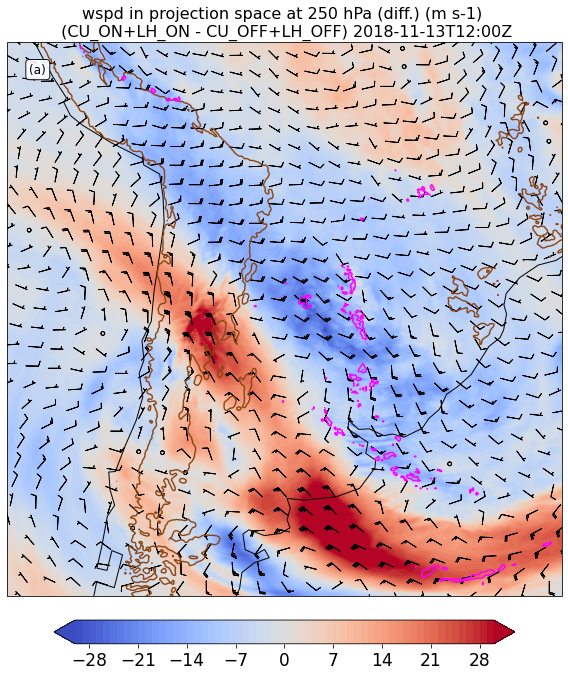

In [154]:
file_finding_string = "wrfout_d01_2018-11-13_12:00:00"
panel_plot = False
save_png = True
experiment_name = 'LT_exps'
variable_and_level = '250_hpa_wspd_diff_AMS_poster'
common_cmap = cma8





directory1='/glade/u/home/isingh9/scratch/WRF_4.3_run_theta_tend_template/LHT_ON_70_vertlevs_maxdom2/'
fi_list1=(sorted(glob.glob(directory1+file_finding_string)))

directory2='/glade/u/home/isingh9/scratch/WRF_4.3_run_theta_tend_template/LHT_OFF_70_vertlevs_maxdom2/'
fi_list2=(sorted(glob.glob(directory2+file_finding_string)))

#directory3='/glade/u/home/isingh9/scratch/cu_scheme_ON_latent_heat_off_20km/'
#fi_list3=(sorted(glob.glob(directory3+file_finding_string)))


#fi_list=fi_list+(sorted(glob.glob(directory_333m+"wrfout_d03_2017-11-29_2*")))
#print(fi_list1)
#fi_list = fi_list +  (sorted(glob.glob(directory_333m+"wrfout_d03_2017-11-29_2*")))
pt2=[-31.72,-64.4]
pt1=[-31.95,-64.8]
# 1800 UTC  pt1=[-32.0,-64.7]; pt2=[-31.6,-64.7]
# 1900 UTC  pt1=[-32.0,-64.7]; pt2=[-31.6,-64.7]
ii = 0 
for file1 in fi_list1:
    print('file 1 : ',file1)

    fig = plt.figure(figsize=(8,11)) # Create a figure
    
    file2 = fi_list2[ii]
    #file3 = fi_list3[ii]

    ax1 = fig.add_subplot(1, 1, 1, projection=crs.PlateCarree())
   
    cont_out, tim = plot_WRF_diff('IOP4_5_latent_heat_exps','d01','CU_ON+LH_ON - CU_OFF+LH_OFF','(a)',file2,file1,9000., 'pressure','wspd',250,\
                   'pressure',None,250,\
                    -30,31,1,20,common_cmap,None,40,10,5,[-20,20],\
                   'small_area',lons,lats,True,\
                   True,['regular','p_level',250],[True,35.,'magenta'],\
                   15,\
                   False,pt1,pt2,\
                   terr,ax1) 
    ###########################################################################

    cb_ax = fig.add_axes([0.1, 0.09, 0.8, 0.03])
    cbar = fig.colorbar(cont_out, cax=cb_ax, orientation = 'horizontal')

    plt.tight_layout()
    if save_png:
        filename= (experiment_name + '_' + 'd01' +'_'+ variable_and_level +'_' + tim + '.png').replace(":", "-")
        print(filename)   
        plt.savefig(filename,dpi=300)#bbox_inches="tight" #
    
    ii = ii + 1
    print('#######')
    print('\n\n')
    #plt.close()


# Plot time series of an area-averaged quantity

In [ ]:
directory='/glade/u/home/isingh9/scratch/WRF_4.3_run_theta_tend_template/LHT_ON_70_vertlevs_maxdom2/'
ncfile = Dataset(directory+'wrfout_d01_2018-11-10_08:00:00')

MP_PHYSICS=ncfile.MP_PHYSICS
RA_LW_PHYSICS=ncfile.RA_LW_PHYSICS
RA_SW_PHYSICS=ncfile.RA_SW_PHYSICS
SF_SFCLAY_PHYSICS=ncfile.SF_SFCLAY_PHYSICS
SF_SURFACE_PHYSICS=ncfile.SF_SURFACE_PHYSICS
BL_PBL_PHYSICS=ncfile.BL_PBL_PHYSICS
SIMULATION_START_DATE=ncfile.SIMULATION_START_DATE
DX=ncfile.DX
DY=ncfile.DY

temp = getvar(ncfile,'ua')
terr = getvar(ncfile,'ter')
lats, lons = latlon_coords(temp) # Get the latitude and longitude points
#lats = to_np(lats)
#lons = to_np(lons)
cart_proj = get_cartopy(temp) # Get the cartopy mapping object
ncfile.close()

In [ ]:
def plot_time_series_area_avgd(FILE,VARTYPE,LEVEL,VARNAMES,DOMAIN,GRID_SPACING_XY,LAT_N,LAT_S,LON_W,LON_E):

    # Open the NetCDF file
    nc_file = Dataset(FILE)
    
    X_NW, Y_NW = ll_to_xy(nc_file, LAT_N, LON_W)
    X_SE, Y_SE = ll_to_xy(nc_file, LAT_S, LON_E)
    #print(X_NW.values, Y_NW.values)
    #print(X_SE.values, Y_SE.values)

    wrf_times = getvar(nc_file,'times')
    tiempo = pd.to_datetime(wrf_times.values)#, timezone='UTC',unit='m')
    
    output_varmean_list=[]
    
    iii = 0 
    for VARNAME in VARNAMES:
        print('fetching variable : ',VARNAME)
        
        if VARTYPE!='2D':
            var2d = get_var_at_level_from_wrfoutput(nc_file,VARNAME,VARTYPE[iii],LEVEL[iii],terr,temp)
            #print(var2d)
            #save_string =  DOMAIN+'_'+VARNAME+'_at_'+VARTYPE+'_'+str(LEVEL)+'_'+tiempo+'_'+AREA_TAG+'.png'
            #title_string = var2d.description + ' (' +var2d.units + ') \n'
            #title_string = title_string.replace ('at ', '\nat ')
        elif VARTYPE=='2D':
            var2d = get_var_at_level_from_wrfoutput(nc_file,VARNAME,VARTYPE[iii],LEVEL[iii],terr,temp)
            #save_string = VARNAME
            #title_string = var2d.description + ' (' +var2d.units + ') \n'
        else:
            print('The values of VARTYPE can only be <2D> or <pressure> or <height> or <model> or <pv> !')
        
        output_varmean_list.append(np.mean(var2d.values[Y_SE.values:Y_NW.values,X_NW.values:X_SE.values]))
    
        iii = iii + 1
    #print(var2d)

    

    return tiempo , output_varmean_list
                     


directory1='/glade/u/home/isingh9/scratch/WRF_4.3_run_theta_tend_template/LHT_ON_70_vertlevs_maxdom2/'
fi_list1=(sorted(glob.glob(directory1+"wrfout_d01_2018-11-1[0-3]_??:00:00")))

directory2='/glade/u/home/isingh9/scratch/WRF_4.3_run_theta_tend_template/LHT_OFF_70_vertlevs_maxdom2/'
fi_list2=(sorted(glob.glob(directory2+"wrfout_d01_2018-11-1[0-3]_??:00:00")))


area_avgd_quant_list10 = []
times_list10=[]

area_avgd_quant_list20 = []
times_list20=[]

area_avgd_quant_list11 = []
times_list11=[]

area_avgd_quant_list21 = []
times_list21=[]

ii = 0
for file1 in fi_list1:
    
    file2=fi_list2[ii]
    #file3=fi_list3[ii]
    
    print('file 1: ',file1)
    print('file 2: ',file2)
    #print('file 3: ',file3)
    
    variable_name1 = ['meridional_index'] # has to be a list of one or more elements
    units1 = ['m/s']
    
    variable_name2 = ['pv_adv_ageo'] # has to be a list of one or more elements
    units2 = ['PV/hr']
  
    #aaa,bbb = plot_time_series_area_avgd(file1,['pv','2D'],[-2.0,None],variable_name,'d01',9000.,-26.0,-38.0,-67.5,-60.0)
    # large domain meridional index
    aaa,bbb = plot_time_series_area_avgd(file1,['pressure','3D'],[300,None],variable_name1,'d01',9000.,-20.,-50.,-90.,-60.)
    print('--')
    ccc,ddd = plot_time_series_area_avgd(file2,['pressure','3D'],[300,None],variable_name1,'d01',9000.,-20.,-50.,-90.,-60.)
    print('--')
    
    aaa1,bbb1 = plot_time_series_area_avgd(file1,['pressure','3D'],[300,None],variable_name2,'d01',9000.,-26.,-38.,-67.5,-60.)
    print('--')
    ccc1,ddd1 = plot_time_series_area_avgd(file2,['pressure','3D'],[300,None],variable_name2,'d01',9000.,-26.,-38.,-67.5,-60.)
    print('--')
    
    print('xxxxxxx')
    #eee,fff = plot_time_series_area_avgd(file3,'2D',0,'V10',20000.,-27.5,-30,-62.5,-60)
  
    
    times_list10.append(aaa)
    area_avgd_quant_list10.append(bbb)
    
    times_list20.append(ccc)
    area_avgd_quant_list20.append(ddd)
  
    times_list11.append(aaa1)
    area_avgd_quant_list11.append(bbb1)
    
    times_list21.append(ccc1)
    area_avgd_quant_list21.append(ddd1)
  
    
#     times_list3.append(eee)
#     area_avgd_quant_list3.append(fff)
    
    ii = ii + 1
    print('---------')
    
    
print('\n')
print(' ')
print('plotting ...')


fig, ax = plt.subplots(figsize=(12, 12))
ax.set(xlabel="Time (UTC)",\
       title="Time series of "+variable_name1[0] +  (' and '+ variable_name2[0]) if len(variable_name2) > 1 else '')
ax.tick_params(axis='y', labelcolor='blue')
ax.set_ylabel(variable_name1[0] + " (" + units1[0] + ")", color='blue')
# Define the date format
date_form = DateFormatter("%m-%d %H")
ax.xaxis.set_major_formatter(date_form)
ax.xaxis.set_major_locator(mdates.HourLocator(interval=18))

var10_values= [item[0] for item in area_avgd_quant_list10]
var20_values= [item[0] for item in area_avgd_quant_list20]

ax.plot(times_list10,var10_values,label=variable_name1[0] + ' CU ON LHT ON',color='blue',linestyle='-')
ax.plot(times_list20,var20_values,label=variable_name1[0] + ' CU OFF LHT OFF',color='blue',linestyle='--')
#plt.axhline(y=np.nanmean(var1_values), color='blue', linestyle='--')

# make another time series line in the same plot for the second variable 
if len(area_avgd_quant_list11)>0:
    ax2=ax.twinx()
    ax2.invert_yaxis()
    var11_values= [item[0] for item in area_avgd_quant_list11]
    var21_values= [item[0] for item in area_avgd_quant_list21]
    plt.plot(times_list11,var11_values,label=variable_name2[0] + ' CU ON LHT ON',color='red',linestyle='-')
    plt.plot(times_list21,var21_values,label=variable_name2[0] + ' CU OFF LHT OFF',color='red',linestyle='--')
    ax2.set_ylabel(variable_name2[0] + " (" + units2[0] + ")", color='red')  # we already handled the x-label with ax1
    ax2.tick_params(axis='y', labelcolor='red')

#plt.plot(times_list3,area_avgd_quant_list3,label='CU ON LHT OFF')
h1, l1 = ax.get_legend_handles_labels()
h2, l2 = ax2.get_legend_handles_labels()
ax.legend(h1+h2, l1+l2, loc=0)
filename = 'time_series_300hpa_'+variable_name1[0]+'_pv_adv_ageo.png'
print(filename)
#plt.savefig(filename,dpi=200)

In [ ]:
a=[1,2,3]
b=[4,5,6]
c=[7,8,9]


import csv
with open('text1.csv', 'w') as f:
    writer = csv.writer(f, delimiter='\t')
    writer.writerows(zip(a,b,c))
    
df = pd.read_csv('text1.csv',delimiter='\t',header=None)

In [ ]:
df

In [ ]:
print('plotting ...')
fig, ax = plt.subplots(figsize=(12, 12))
ax.set(xlabel="Time (UTC)",
       ylabel= variable_name[0] + " (" + units[0] + ")",
       title="Time series of "+variable_name[0] +  (' and '+ variable_name[1]) if len(variable_name) >1 else '')

# Define the date format
date_form = DateFormatter("%m-%d %H")
ax.xaxis.set_major_formatter(date_form)
# Ensure a major tick for each week using (interval=1) 
ax.xaxis.set_major_locator(mdates.HourLocator(interval=18))

var1_values= [item[0] for item in area_avgd_quant_list1]
plt.plot(times_list1,var1_values,label='CU ON LHT ON',color='blue')
plt.axhline(y=np.nanmean(var1_values), color='blue', linestyle='--')

# make another time series line in the same plot for the second variable 
if len(area_avgd_quant_list1[0])>1:
    ax2=ax.twinx()
    var2_values= [item[1] for item in area_avgd_quant_list1]
    plt.plot(times_list1,var2_values,label='CU OFF LHT OFF',color='red')
    ax2.set_ylabel(variable_name[1] + " (" + units[1] + ")", color='red')  # we already handled the x-label with ax1
    ax2.tick_params(axis='y', labelcolor='red')
#plt.plot(times_list3,area_avgd_quant_list3,label='CU ON LHT OFF')
#plt.legend()
filename = 'time_series_2pvu_'+variable_name[0]+'_LHT_dynamic_tropo.png'
print(filename)
plt.savefig(filename,dpi=200)


# Plot vertical profile of a quantity

In [ ]:
def plot_vertical_profile_point(NCFILE,VAR3D,LAT_POINT,LON_POINT):
    var =  getvar(NCFILE,VAR3D)
    hgt =  getvar(NCFILE,'height')
    xloc,yloc = ll_to_xy(NCFILE, LAT_POINT, LON_POINT)
    vert_prof = var[:,yloc,xloc]
    y_cord_hgts = hgt[:,yloc,xloc]
    fig = plt.figure(figsize=(8,8))
    plt.plot(vert_prof*3600.0,y_cord_hgts)
    plt.title('vertical profile of '+var.description.lower())#+' ('+var.units+')')
    plt.xlabel(var.description.lower() + ' (K/hr)')
    plt.ylabel('Height (m)')
    plt.ylim([0,18000])
    
    
directory='/glade/u/home/isingh9/scratch/WRF_4.3_run_theta_tend_template/LHT_ON_70_vertlevs_maxdom2/'
ncfile = Dataset(directory+'wrfout_d02_2018-11-13_14:00:00')
plot_vertical_profile_point(ncfile,'H_DIABATIC',-27,-60)

# Plot Hovmoller diagram

In [ ]:
def plot_hovmoller_wrf(NCFILELIST,VARIABLELIST,LONGITUDE_RANGE,LATITUDE_RANGE):
    
    directory='/glade/u/home/isingh9/scratch/WRF_4.3_run_theta_tend_template/LHT_ON_70_vertlevs_maxdom2/'
    ncfile = Dataset(directory+'wrfout_d01_2018-11-10_08:00:00')
    temp = getvar(ncfile,'ua') # temp and terr will be used in this function
    terr = getvar(ncfile,'ter')
    X_NW, Y_NW = ll_to_xy(ncfile, max(LATITUDE_RANGE), min(LONGITUDE_RANGE))
    X_SE, Y_SE = ll_to_xy(ncfile, min(LATITUDE_RANGE), max(LONGITUDE_RANGE))
    terr_sub = terr[Y_SE.values:Y_NW.values,X_NW.values:X_SE.values]
    lon_vals = terr_sub.coords['XLONG'][0,:].values
    
 
    var1_temp = []
    var2_temp = []
    var3_temp = []
    times_temp=  []
    
    for NCFILE in NCFILELIST:
        print(' ')
        print('file: ', NCFILE)
        nc_file = Dataset(NCFILE)
        wrf_times = getvar(nc_file,'times')
        tiempo = np.datetime_as_string(wrf_times.values, timezone='UTC',unit='m')

        print(VARIABLELIST[0]['name'])
        var = get_var_at_level_from_wrfoutput(nc_file,VARIABLELIST[0]['name'],VARIABLELIST[0]['level_type'],VARIABLELIST[0]['level'],terr,temp)
        var_sub = var[Y_SE.values:Y_NW.values,X_NW.values:X_SE.values]
        vals_along_long = np.nanmean(var_sub.values,axis=0)

        var1_temp = np.vstack([var1_temp, vals_along_long]) if len(var1_temp) else vals_along_long#,axis=1)
        times_temp.append(wrf_times.values)
        print(' ')


        if (len(VARIABLELIST)>1): 
            print('working on ',VARIABLELIST[1]['name'])
            var = get_var_at_level_from_wrfoutput(nc_file,VARIABLELIST[1]['name'],VARIABLELIST[1]['level_type'],VARIABLELIST[1]['level'],terr,temp)
            var_sub = var[Y_SE.values:Y_NW.values,X_NW.values:X_SE.values]
            vals_along_long = np.nanmean(var_sub.values,axis=0)
            var2_temp = np.vstack([var2_temp, vals_along_long]) if len(var2_temp) else vals_along_long#,axis=1)
            print(' ')
            
        if (len(VARIABLELIST)>2):  
            print('working on ',VARIABLELIST[2]['name'])
            var = get_var_at_level_from_wrfoutput(nc_file,VARIABLELIST[2]['name'],VARIABLELIST[2]['level_type'],VARIABLELIST[2]['level'],terr,temp)
            var_sub = var[Y_SE.values:Y_NW.values,X_NW.values:X_SE.values]
            vals_along_long = np.nanmean(var_sub.values,axis=0)
            var3_temp = np.vstack([var3_temp, vals_along_long]) if len(var3_temp) else vals_along_long#,axis=1)
            print(' ')
   
    return lon_vals,times_temp,var1_temp,var2_temp,var3_temp
        
#variable_hov = {
#  "name": "va",
#  "level_type": "pressure",
#  "level": 850,
#  "description":"v-wind (m/s)"
#}
# variable_hov = {
#   "name": "ctt",
#   "level_type": "2D",
#   "level": None,
#   "description":"Cloud Top Temperature (deg C)"
# }
variable_hov1 = [
#   ["name": "vint_mfc",
#   "level_type": "2D",
#   "level": None,
#   "description":"Vert. int. MFC (kg m^-2 s^-1)"],\
    
  {"name": "rain_rate",
  "level_type": "2D",
  "level": None,
  "description":"rain_rate (mm/min)"},    

  {"name": "pv_adv_ageo",
  "level_type": "pressure",
  "level": 100,
  "description":"PV advection by ageostrophic winds at 100 hPa"},
    
  {"name": "wspd",
  "level_type": "pressure",
  "level": 300,
  "description":"wind speed at 300 hPa"},
    
  {"name": "height",
  "level_type": "pv",
  "level": -2,
  "description":"DT height (m)"},
    
  {"name": "vert_avgd_H_DIABATIC",
  "level_type": "2D",
  "level": None,
  "description":"vertically averaged theta tendency (K/hr; microphysics)"},
    
  {"name": "height",
  "level_type": "pressure",
  "level": 300,
  "description":"Heights at 300 hPa"},

  {"name": "ctt",
  "level_type": "2D",
  "level": None,
  "description":"CTT (deg C)"}
]

variable_hov2 = [
#   ["name": "vint_mfc",
#   "level_type": "2D",
#   "level": None,
#   "description":"Vert. int. MFC (kg m^-2 s^-1)"],\
  {"name": "height",
  "level_type": "pressure",
  "level": 300,
  "description":"Heights at 300 hPa"}
]

#levs = np.arange(4000,12035,35) # for all heights

#levels_for_shaded =np.arange(-15,25,1)
#levels_for_shaded =np.arange(0.004,0.031,0.001)# rain_rate
levels_for_shaded = np.arange(-9,9.1,.1)
levels_for_line_cont1 = [0.01,0.02,0.03] # rain rate
levels_for_line_cont2 = np.arange(20,80,5) #np.arange(4000,19000,2000)

domain = 'd01'
file_finding_string = "wrfout_"+domain+"_2018-11-*_*:00:00"
panel_plot = False
save_hov_png = True
experiment_name = 'LHT_exps_two'
#variable_and_level = main_variable + '_' + main_var_level_type + '_' + str(main_var_level)
common_cmap = cma8

exp_names = ['LHT_ON_70_vertlevs_maxdom2','LHT_OFF_70_vertlevs_maxdom2']#,'cu_scheme_OFF_latent_heat_off_20km']


#for exp_name in exp_names:
# print(' ')
# print(' EXPERIMENT ',exp_name)
# print(' ')
#directory1='/glade/u/home/isingh9/scratch/cu_scheme_ON_latent_heat_on_20km/'
directory1='/glade/u/home/isingh9/scratch/WRF_4.3_run_theta_tend_template/'+exp_names[0]+'/'
fi_list1=(sorted(glob.glob(directory1+file_finding_string)))

#directory2='/glade/u/home/isingh9/scratch/WRF_4.3_run_theta_tend_template/'+exp_names[1]+'/'
#fi_list2=(sorted(glob.glob(directory2+file_finding_string)))

#directory3='/glade/u/home/isingh9/scratch/cu_scheme_ON_latent_heat_off_20km/'
#fi_list3=(sorted(glob.glob(directory3+file_finding_string)))

print(fi_list1)

long_vals,times_list,output11,output12,output13 = plot_hovmoller_wrf(fi_list1[1:],variable_hov1,[-80,-50],[-40,-20])
print(' ')
print('################################')
print(' ')
#print(fi_list2)

#long_vals,times_list,output21,output22 = plot_hovmoller_wrf(fi_list2[1:],variable_hov2,[-80,-50],[-40,-20])

fig = plt.figure(figsize=(15,11)) # Create a figure
ax1 = fig.add_subplot(1, 1, 1)#, projection=crs.PlateCarree())
#cont_hov = plt.contourf(long_vals,times_list,output,cmap=plt.get_cmap('RdBu'),levels=np.arange(-20.,21.,1.),extend='both')#, 20)
#cont_hov = plt.contourf(long_vals,times_list,output,cmap=plt.get_cmap('binary'),levels=np.arange(-80.,51.,1.),extend='both')#, 20)
cont_hov11 = plt.contour(long_vals,times_list,output11,colors='forestgreen',levels=levels_for_line_cont1)#,cmap=plt.get_cmap('RdBu'),levels=np.arange(-0.0008,0.00081,0.00001),extend='both')#, 20)
ax1.clabel(cont_hov11, inline=1, fontsize=10)
cont_hov12 = plt.contourf(long_vals,times_list,output12,levels_for_shaded,cmap=common_cmap,extend='both')#, 20)
cont_hov13 = plt.contour(long_vals,times_list,output13,levels_for_line_cont2,colors='dimgray')#, 20)
ax1.clabel(cont_hov13, inline=1, fontsize=10)
#cont_hov21 = plt.contour(long_vals,times_list,output21,colors='firebrick',levels=levs)#,levels=np.arange(5000,5850,50))
#ax1.clabel(cont_hov21, inline=1, fontsize=10)
#cont_hov22 = plt.contour(long_vals,times_list,output22)#,cmap=plt.get_cmap('RdBu'),levels=np.arange(-0.0008,0.00081,0.00001),extend='both')#, 20)


plt.colorbar(cont_hov12,orientation='horizontal',pad=0.083,aspect=45)#,format=OOMFormatter(-5, mathText=False))
#plt.title(variable_hov['description'] + '\n' + exp_name)

# Put a custom label on the y axis
plt.ylabel('Time')

plt.xlabel('Longitude (degrees)')

# Stop matplotlib providing clever axes range padding
plt.axis('tight')

plt.title('Rain rate (mm/min) and ageostrophic PV advection (PVU/h) at 100 hPa')

# As we are plotting annual variability, put years as the y ticks
plt.gca().yaxis.set_major_locator(mdates.HourLocator(interval=6))
# And format the ticks to just show the year
plt.gca().yaxis.set_major_formatter(mdates.DateFormatter('%m-%d %H:%M'))

#plt.show()
filename=exp_names[0]+'_'+variable_hov1[0]['name']+'_100hPa_pv_adv_ageo_hovmoller_300hpa_wspd.png'
print(' ')
print(filename)

if save_hov_png:
    print('saving file ...')
    plt.savefig(filename,dpi=200)
#levels=np.arange(160,331,1)

# Compare WRF output with GOES-16

## Compare WRF with GOES (2 subplots)

In [ ]:
from metpy.plots import ctables

nm,cm=cmap=ctables.registry.get_with_range('ir_tpc',0,200)

latlon_goes=xr.open_dataset('../simple.nc')
lats_goes=latlon_goes['lat'].values
lons_goes=latlon_goes['lon'].values

# WRF_4.3_run_theta_tend_template
wrf_directory='/glade/u/home/isingh9/scratch/WRF_4.3_run_theta_tend_template/LHT_ON_70_vertlevs_maxdom2/'
wrf_temp = Dataset(wrf_directory+'wrfout_d02_2018-11-11_00:00:00')
terr_wrf = getvar(wrf_temp,'ter')
lats_wrf, lons_wrf = latlon_coords(terr_wrf) # Get the latitude and longitude points
lats_wrf = to_np(lats_wrf)
lons_wrf = to_np(lons_wrf)
wrf_times = getvar(wrf_temp,'times')
#print(pd.to_datetime(wrf_times.values).strftime('%d %B %Y %H:%M UTC '))
wrf_temp.close()

terr=xr.open_dataset("/glade/u/home/isingh9/jupyter_nbks/etopo1.nc")
terr['Band1'].values[terr['Band1'].values < 0.]=np.nan

def plot_wrf_goes_comparison(GOES_FILE,WRF_FILE):
    print(' ')
    print('GOES_FILE: ',GOES_FILE)
    print('WRF_FILE: ',WRF_FILE)
    
    C=xr.open_dataset(GOES_FILE)
    #print(C)
   
    fig = plt.figure(figsize=(15, 15)) 
    #fig, (ax1, ax2) = plt.subplots(1, 2,  projection=crs.PlateCarree())
    ax1 = fig.add_subplot(1, 2, 1, projection=crs.PlateCarree())
    ax2 = fig.add_subplot(1, 2, 2, projection=crs.PlateCarree())
    #fig.suptitle('Horizontally stacked subplots')

    #ax.set_extent([-66, -64, -34, -30], crs=ccrs.PlateCarree())
    ax1.set_extent([-75, -55, -39, -24], crs=crs.PlateCarree())
    Rad = C.metpy.parse_cf('Rad')[3500:5000,2500:4000]
    #print(Rad)
    lats1=latlon_goes['lat'].values[3500:5000,2500:4000]
    lons1=latlon_goes['lon'].values[3500:5000,2500:4000]
    geos = Rad.metpy.cartopy_crs
    
    # Convert radiance to Brightness Temp 
    fk1 = C.variables['planck_fk1'].values
    fk2 = C.variables['planck_fk2'].values
    bc1 = C.variables['planck_bc1'].values
    bc2 = C.variables['planck_bc2'].values

    #print("fk1 = ",fk1)
    #print("fk2 = ",fk2)
    #print("bc1 = ",bc1)
    #print("bc2 = ",bc2)
    print(" ")

    #Compute brightness temp from radiances
    dat = (fk2 / ( np.log((fk1 / Rad.values) + 1 )) - bc1) / bc2
    #print((dat))
    #################################### Plot contours ################################
    pp1=ax1.contourf(lons1,lats1,dat,cmap=plt.get_cmap('viridis_r'),levels=np.arange(160,331,1),extend='both')#,\

    ################################ Plot terrain contours ##########################
    topo_cont1=ax1.contour(terr.lon.values,terr.lat.values,terr.Band1.values, levels=np.arange(0,7000,1000), 
                   colors="k",linewidths=0.4,transform=crs.PlateCarree())
    #ax.clabel(topo_cont, topo_cont.levels,inline=True, fmt='%1.f',fontsize=7)

    ################################# Title and colorbar ############################
    kk=pd.to_datetime(C.t.values)
    ax1.title.set_text('GOES-16 Ch14 Brightness Temperature $(K)$ \n'+kk.strftime('%d %B %Y %H:%M UTC '))
    cb_ch14 = fig.colorbar(pp1, ax=ax1, shrink=.85,orientation='horizontal',pad = 0.02)

    #################################### plot gridlines ############################
    gl = ax1.gridlines(crs=crs.PlateCarree(),draw_labels=True,linewidth=2, color='gray', alpha=0.5, linestyle='-')
    gl.xlabels_top = False
    gl.ylabels_left = True
    gl.ylabels_right = False
    gl.ylabels_bottom = True
    gl.xformatter = LONGITUDE_FORMATTER
    gl.yformatter = LATITUDE_FORMATTER
    gl.xlabel_style = {'size': 12, 'color': 'gray'}#, 'weight': 'bold'}
    gl.ylabel_style = {'size': 12, 'color': 'gray'}#, 'weight': 'bold'}
    ################################ WRF file ####################################   
    ncfile = Dataset(WRF_FILE)
    wrf_times = getvar(ncfile,'times')
    ctt = getvar(ncfile,'ctt',units='K')#/1000.
    #print(np.shape)
    #print(ctt)
    pp2 = ax2.contourf(lons_wrf,lats_wrf, ctt.values,transform=crs.PlateCarree(),levels=np.arange(160,331,1),\
                 extend='both',cmap=plt.get_cmap('viridis_r'))
    #topo_cont2=ax2.contour(lons_wrf,lats_wrf,terr_wrf.values, levels=np.arange(0,7000,1000), 
    #               colors="k",linewidths=0.4,transform=crs.PlateCarree())
    topo_cont2=ax2.contour(terr.lon.values,terr.lat.values,terr.Band1.values, levels=np.arange(0,7000,1000), 
                   colors="k",linewidths=0.4,transform=crs.PlateCarree())

    ax2.set_extent([-75, -55, -39, -24], crs=crs.PlateCarree())

    tiempo = pd.to_datetime(wrf_times.values).strftime('%d %B %Y %H:%M UTC ')
    ax2.title.set_text('WRF Cloud Top Temperature $(K)$ \n'+tiempo)
    #cb2 = ax2.colorbar(pp2)
    # Plot contours
    #levels=np.arange(0.0,800.0,10.0))
    #plt.colorbar(pp2,orientation='horizontal')
    ncfile.close()
    cb_ctt = fig.colorbar(pp2, ax=ax2, shrink=.850,orientation='horizontal', pad = 0.02)

    gl = ax2.gridlines(crs=crs.PlateCarree(),draw_labels=True,linewidth=2, color='gray', alpha=0.5, linestyle='-')
    gl.xlabels_top = False
    gl.ylabels_right = True
    gl.ylabels_left = False
    gl.ylabels_bottom = True
    #gl.xlines = False
    #gl.xlocator = mticker.FixedLocator([-67, -66, 0, 45, 180])
    gl.xformatter = LONGITUDE_FORMATTER
    gl.yformatter = LATITUDE_FORMATTER
    gl.xlabel_style = {'size': 12, 'color': 'gray'}#, 'weight': 'bold'}
    gl.ylabel_style = {'size': 12, 'color': 'gray'}#, 'weight': 'bold'}

    plt.tight_layout()
    filename_time = pd.to_datetime(wrf_times.values).strftime('%Y-%m-%d_%H-%M')
    filename = 'WRF_GOES_comparison_CTT_theta_tend_d02_70_vert_levs_'+filename_time+'.png'
    print('image file : ',filename)
    plt.savefig(filename,dpi=200)
    print('###############################################################')
    #plt.savefig()  

In [ ]:
wrf_files=sorted(glob.glob(wrf_directory+'/*.nc'))
#print(wrf_files)

################################################# match GOES and WRF files ########################
import os
#315 --> 11 Nov
directory='/glade/u/home/isingh9/work/GOES_RELAMPAGO_AWSdata/316/'
filelist = sorted(glob.glob(directory+'**/OR_ABI-L1b-RadF-M?C14_G16*.nc', recursive=True))
#print((filelist))

goes_times=[]

for ff in filelist:
    #print(ff)
    goes_times.append(pd.to_datetime((xr.open_dataset(ff).t.values)))

In [ ]:
wrf_directory = '/glade/u/home/isingh9/scratch/WRF_4.3_run_theta_tend_template/LHT_ON_70_vertlevs_maxdom2/'
wrf_files=sorted(glob.glob(wrf_directory+'wrfout_d02_2018-11-12_2*:00:00'))
print(wrf_files)

ii = 0 

for wrf_file in wrf_files:
    nc_file = Dataset(wrf_file)
    wrf_time = pd.to_datetime(getvar(nc_file,'times').values)
    print('time in WRF file is',wrf_time)
    closest_dict = { abs(wrf_time - goes_time) : goes_time for goes_time in goes_times}
    # extracting minimum key using min()
    res = closest_dict[min(closest_dict.keys())]
    print("Nearest time from GOES list : " + str(res))
    
    corresp_goes_file = filelist[list(closest_dict.values()).index(res)]
    print('corresponding goes file is: ',corresp_goes_file)
    
    plot_wrf_goes_comparison(corresp_goes_file,wrf_file)
    print('--------------')
#################################################################################################

## Compare WRF with GOES (multiple subplots) ensemble members

In [ ]:
from metpy.plots import ctables

nm,cm=cmap=ctables.registry.get_with_range('ir_tpc',0,200)

latlon_goes=xr.open_dataset('../simple.nc')
lats_goes=latlon_goes['lat'].values
lons_goes=latlon_goes['lon'].values

#wrf_directory='/glade/u/home/isingh9/scratch/WRF_4.3.3_run_ERA5_run1/'
wrf_directory='/glade/u/home/isingh9/scratch/cu_scheme_ON_latent_heat_on_20km/'
wrf_temp = Dataset(wrf_directory+'wrfout_d01_2018-11-13_00:00:00')
terr_wrf = getvar(wrf_temp,'ter')
lats_wrf, lons_wrf = latlon_coords(terr_wrf) # Get the latitude and longitude points
lats_wrf = to_np(lats_wrf)
lons_wrf = to_np(lons_wrf)
wrf_times = getvar(wrf_temp,'times')
#print(pd.to_datetime(wrf_times.values).strftime('%d %B %Y %H:%M UTC '))
wrf_temp.close()

terr=xr.open_dataset("/glade/u/home/isingh9/jupyter_nbks/etopo1.nc")
terr['Band1'].values[terr['Band1'].values < 0.]=np.nan



def plot_wrf_ax(WRFFILE,AX,FIG,LABEL,DESCRIPTION):
    ################################ WRF file ####################################   
    ncfile = Dataset(WRFFILE)
    wrf_times = getvar(ncfile,'times')
    ctt = getvar(ncfile,'ctt',units='K')#/1000.
    #print(ctt)
    pp2 = AX.contourf(lons_wrf,lats_wrf, ctt.values,transform=crs.PlateCarree(),levels=np.arange(160,331,1),\
                 extend='both',cmap=plt.get_cmap('viridis_r'))
    topo_cont2=AX.contour(terr.lon.values,terr.lat.values,terr.Band1.values, levels=np.arange(0,7000,1000), 
                   colors="k",linewidths=0.4,transform=crs.PlateCarree())

    AX.set_extent([-75, -55, -39, -24], crs=crs.PlateCarree())

    tiempo = pd.to_datetime(wrf_times.values).strftime('%d %B %Y %H:%M UTC ')
    filename_time = pd.to_datetime(wrf_times.values).strftime('%Y-%m-%d_%H-%M')
    AX.set_title('WRF Cloud Top Temperature $(K)$ \n'+tiempo,fontsize=13)
    AX.text(0.05, 0.89, LABEL, fontsize=13,  transform=AX.transAxes, color='white')
    AX.text(0.63, 0.85, DESCRIPTION, fontsize=9,  transform=AX.transAxes, color='white')
    #cb2 = ax2.colorbar(pp2)
    # Plot contours
    #levels=np.arange(0.0,800.0,10.0))
    #plt.colorbar(pp2,orientation='horizontal')
    ncfile.close()
    #cb_ctt = FIG.colorbar(pp2, ax=AX, shrink=.850,orientation='horizontal', pad = 0.02)

    gl_wrf = AX.gridlines(crs=crs.PlateCarree(),draw_labels=True,linewidth=2, color='gray', alpha=0.5, linestyle='-')
    gl_wrf.xlabels_top = False
    gl_wrf.ylabels_right = False
    gl_wrf.ylabels_left = False
    gl_wrf.ylabels_bottom = False
    gl_wrf.xformatter = LONGITUDE_FORMATTER
    gl_wrf.yformatter = LATITUDE_FORMATTER
    gl_wrf.xlabel_style = {'size': 9, 'color': 'gray'}#, 'weight': 'bold'}
    gl_wrf.ylabel_style = {'size': 9, 'color': 'gray'}#, 'weight': 'bold'}
    
    return tiempo, filename_time


def plot_wrf_goes_comparison(GOES_FILE,WRF_FILE):
    print(' ')
    print('GOES_FILE: ',GOES_FILE)
    print('WRF_FILE: ',WRF_FILE)
   
    fig = plt.figure(figsize=(13, 8)) 
    #fig, (ax1, ax2) = plt.subplots(1, 2,  projection=crs.PlateCarree())
    ax1 = fig.add_subplot(1, 3, 1, projection=crs.PlateCarree())
    ax2 = fig.add_subplot(1, 3, 2, projection=crs.PlateCarree())
    ax3 = fig.add_subplot(1, 3, 3, projection=crs.PlateCarree())
    #ax4 = fig.add_subplot(2, 3, 4, projection=crs.PlateCarree())
    #ax5 = fig.add_subplot(2, 3, 5, projection=crs.PlateCarree())
    #ax6 = fig.add_subplot(2, 3, 6, projection=crs.PlateCarree())
    #fig.suptitle('Horizontally stacked subplots')
    
    C=xr.open_dataset(GOES_FILE)
    #ax.set_extent([-66, -64, -34, -30], crs=ccrs.PlateCarree())
    ax1.set_extent([-75, -55, -39, -24], crs=crs.PlateCarree())
    Rad = C.metpy.parse_cf('Rad')[3500:5000,2500:4000]
    #print(Rad)
    lats1=latlon_goes['lat'].values[3500:5000,2500:4000]
    lons1=latlon_goes['lon'].values[3500:5000,2500:4000]
    geos = Rad.metpy.cartopy_crs

    # Convert radiance to Brightness Temp 
    fk1 = C.variables['planck_fk1'].values
    fk2 = C.variables['planck_fk2'].values
    bc1 = C.variables['planck_bc1'].values
    bc2 = C.variables['planck_bc2'].values
    print(" ")

    #Compute brightness temp from radiances
    dat = (fk2 / ( np.log((fk1 / Rad.values) + 1 )) - bc1) / bc2
    #print((dat))
    #################################### Plot contours ################################
    pp1=ax1.contourf(lons1,lats1,dat,cmap=plt.get_cmap('viridis_r'),levels=np.arange(160,331,1),extend='both')#,\

    ################################ Plot terrain contours ##########################
    topo_cont1=ax1.contour(terr.lon.values,terr.lat.values,terr.Band1.values, levels=np.arange(0,7000,1000), 
                   colors="k",linewidths=0.4,transform=crs.PlateCarree())
    #ax.clabel(topo_cont, topo_cont.levels,inline=True, fmt='%1.f',fontsize=7)

    ################################# Title and colorbar ############################
    kk=pd.to_datetime(C.t.values)
    ax1.set_title('GOES-16 Ch14 Brightness Temp. $(K)$ \n'+kk.strftime('%d %B %Y %H:%M UTC '),fontsize=13)
    ax1.text(0.05, 0.89, '(a)', fontsize=13, transform=ax1.transAxes, color='white')
    
    #cb_ch14 = fig.colorbar(pp1, ax=ax1, shrink=.85,orientation='horizontal',pad = 0.02)

    #################################### plot gridlines ############################
    gl = ax1.gridlines(crs=crs.PlateCarree(),draw_labels=True,linewidth=2, color='gray', alpha=0.5, linestyle='-')
    gl.xlabels_top = False
    gl.ylabels_left = True
    gl.ylabels_right = False
    gl.ylabels_bottom = True
    gl.xformatter = LONGITUDE_FORMATTER
    gl.yformatter = LATITUDE_FORMATTER
    gl.xlabel_style = {'size': 9, 'color': 'gray'}#, 'weight': 'bold'}
    gl.ylabel_style = {'size': 9, 'color': 'gray'}#, 'weight': 'bold'}


    temp1, filname_time = plot_wrf_ax('/glade/u/home/isingh9/scratch/cu_scheme_ON_latent_heat_on_20km/'+WRF_FILE,ax2,fig,'(b)','20km: CU scheme ON; LT heat ON')
    plot_wrf_ax('/glade/u/home/isingh9/scratch/cu_scheme_OFF_latent_heat_off_20km/'+WRF_FILE,ax3,fig,'(c)','20km: CU scheme OFF; LT heat OFF')
    #plot_wrf_ax('/glade/u/home/isingh9/scratch/WRF_4.3.3_run_ERA5_run3/'+WRF_FILE,ax4,fig,'(d)','Run#3\nStart:2018-11-09 00\nMorrison;MYNN')
    #plot_wrf_ax('/glade/u/home/isingh9/scratch/WRF_4.3.3_run_ERA5_run4/'+WRF_FILE,ax5,fig,'(e)','Run#4\nStart:2018-11-09 00\nThompson;MYNN')
    #plot_wrf_ax('/glade/u/home/isingh9/scratch/WRF_4.3.3_run_ERA5_run5/'+WRF_FILE,ax6,fig,'(f)','Run#5\nStart:2018-11-09 00\nNSSL;Yonsei')
    
    #cb_ax = fig.add_axes([0.15, .87, 0.35, 0.03])
    cb_ax = fig.add_axes([.99, 0.1, 0.02, 0.8])
    cbar = fig.colorbar(pp1, cax=cb_ax)
    
    #divider = make_axes_locatable(plt.gca())
    #cax = divider.append_axes('right', size='5%', pad=0.05)
    #fig.colorbar(pp1, cax=cax, orientation='vertical')
    
    #cb_ch14 = fig.colorbar(pp1,shrink=.85,orientation='horizontal',pad = 0.02)

    plt.tight_layout()
    #'/glade/u/home/isingh9/scratch/WRF_4.3.3_run_ERA5_run1/'+WRF_FILE
    #filename_time = pd.to_datetime(wrf_times.values).strftime('%Y-%m-%d_%H-%M')
    filename = 'WRF_large_dom_20km_GOES_comparison_CTT_'+filname_time+'.png'
    print('image file : ',filename)
    plt.savefig(filename,dpi=200)
    print('###############################################################')
    #plt.savefig()
    

wrf_files=sorted(glob.glob(wrf_directory+'/*.nc'))
#print(wrf_files)

################################################# match GOES and WRF files ########################
import os

directory='/glade/u/home/isingh9/work/GOES_RELAMPAGO_AWSdata/317/'
filelist = sorted(glob.glob(directory+'**/OR_ABI-L1b-RadF-M?C14_G16*.nc', recursive=True))
#print((filelist))

goes_times=[]

for ff in filelist:
    #print(ff)
    goes_times.append(pd.to_datetime((xr.open_dataset(ff).t.values)))

#wrf_directory = '/glade/u/home/isingh9/scratch/WRF_4.3.3_run_ERA5_run1/'
wrf_files=sorted(glob.glob(wrf_directory+'wrfout_d01_2018-11-13*'))
#print(wrf_files)

ii = 0 

for wrf_file in wrf_files:
    nc_file = Dataset(wrf_file)
    wrf_time = pd.to_datetime(getvar(nc_file,'times').values)
    print('time in WRF file is',wrf_time)
    closest_dict = { abs(wrf_time - goes_time) : goes_time for goes_time in goes_times}
    # extracting minimum key using min()
    res = closest_dict[min(closest_dict.keys())]
    print("Nearest time from GOES list : " + str(res))
    
    corresp_goes_file = filelist[list(closest_dict.values()).index(res)]
    print('corresponding goes file is: ',corresp_goes_file)
    
    wrf_filename_only = os.path.basename(wrf_file)
    plot_wrf_goes_comparison(corresp_goes_file,wrf_filename_only)
    print('--------------')
#################################################################################################

# Compare two WRF runs

In [ ]:
import cartopy.crs as crs
import matplotlib.ticker as mticker
from cartopy.feature import NaturalEarthFeature
from cartopy.mpl.gridliner import LATITUDE_FORMATTER, LONGITUDE_FORMATTER

#wrf_directory='/glade/u/home/isingh9/scratch/cu_scheme_ON_latent_heat_on_20km/'
wrf_directory='/glade/u/home/isingh9/scratch/WRF_4.3_run_theta_tend_template/LHT_ON_70_vertlevs_maxdom2/'
wrf_temp = Dataset(wrf_directory+'wrfout_d01_2018-11-13_00:00:00')
terr_wrf = getvar(wrf_temp,'ter')
lats_wrf, lons_wrf = latlon_coords(terr_wrf) # Get the latitude and longitude points
lats_wrf = to_np(lats_wrf)
lons_wrf = to_np(lons_wrf)
wrf_times = getvar(wrf_temp,'times')
#print(pd.to_datetime(wrf_times.values).strftime('%d %B %Y %H:%M UTC '))
wrf_temp.close()

terr=xr.open_dataset("/glade/u/home/isingh9/jupyter_nbks/etopo1.nc")
terr['Band1'].values[terr['Band1'].values < 0.]=np.nan

def plot_2_WRF_runs_comparison(WRF_FILE1,WRF_FILE2):
    print('WRF file 1 :',WRF_FILE1)
    print('WRF file 2 :',WRF_FILE2)
    
    var_name_for_filename = '500hpa_geop'
    #experiment_name = 'latent_heat_on_off_exps'
    experiment_name = 'LHT_ON_OFF_d02_70vlevels'
    levels_both = np.arange(270,321,1) # T2
    #levels_both = np.arange(10,71,1) # refl
    terrain_levs = np.arange(1000,7500,1000)
    common_title_string = '2-m temperature (K)' # T2
    #common_title_string = 'Reflectivity at the lowest model level (dBZ)'
    #lon_grids = np.arange(-66, -62.5, 0.25)
    #lat_grids = np.arange(-33, -30, 0.25)
    lon_grids = np.arange(-105, -45, 3)
    lat_grids = np.arange(-69, 4, 3)

    fig = plt.figure(figsize=(15,10)) # Create a figure
    ax1 = fig.add_subplot(1, 2, 1, projection=crs.PlateCarree())
    ax2 = fig.add_subplot(1, 2, 2, projection=crs.PlateCarree())
    
    #winds_thin_x=5 large domain
    winds_thin_x=10
    #map_extent = [-85, -45, -49, 0]
    map_extent = [-75, -55, -39, -24]
    plot_refl_35_dbz_contours = True
    
    #----------------------------------------------------------------------------------------------------------------------------------------------
    # WRF1 #

    ncfile1 = Dataset(WRF_FILE1)
    wrf_times = getvar(ncfile1,'times')
    ctt = getvar(ncfile1,'T2')[:,:]
    refl1 = getvar(ncfile1,'dbz')[0,:,:]
    u10_1,v10_1=getvar(ncfile1,'uvmet10')
    ncfile1.close()
    #print(ctt)
    pp1 = ax1.contourf(lons_wrf,lats_wrf, ctt.values,transform=crs.PlateCarree(),levels=levels_both,extend='both',cmap=cma4)
    n=2
    print('plotting winds at the surface')
    C3=ax1.barbs(lons_wrf[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x], lats_wrf[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x],\
           u10_1[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x],\
           v10_1[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x],linewidth=0.9, length=5, pivot='middle',transform=crs.PlateCarree(),\
                flip_barb=True) 
    if plot_refl_35_dbz_contours:
        C2 = ax1.contour(lons_wrf ,lats_wrf, refl1.values,transform=crs.PlateCarree(),levels=[35.0],colors='k')

    #matplotlib.cm.get_cmap('pyart_NWSRef')
    topo_cont1=ax1.contour(lons_wrf,lats_wrf,terr_wrf, levels=terrain_levs, colors="saddlebrown",linewidths=0.9,transform=crs.PlateCarree())

    #ax1.set_extent([-65.5, -63.5, -32.25, -30.75], crs=crs.PlateCarree())
    ax1.set_extent(map_extent, crs=crs.PlateCarree())

    gl_wrf = ax1.gridlines(crs=crs.PlateCarree(),draw_labels=True,linewidth=1, color='gray', alpha=0.5, linestyle='-')
    gl_wrf.xlabels_top = False
    gl_wrf.ylabels_right = False #True
    gl_wrf.ylabels_left = False
    gl_wrf.ylabels_bottom = False
    gl_wrf.xlocator = mticker.FixedLocator(list(lon_grids))
    gl_wrf.ylocator = mticker.FixedLocator(list(lat_grids))
    gl_wrf.xformatter = LONGITUDE_FORMATTER
    gl_wrf.yformatter = LATITUDE_FORMATTER
    gl_wrf.xlabel_style = {'size': 10, 'color': 'k'}#, 'weight': 'bold'}
    gl_wrf.ylabel_style = {'size': 10, 'color': 'k'}#, 'weight': 'bold'}


    tiempo = pd.to_datetime(wrf_times.values).strftime('%d %B %Y %H:%M UTC ')
    #ax1.set_title(common_title_string+'\n'+tiempo+'\nLTH ON',fontsize=13)
    ax1.set_title(common_title_string+'\n'+tiempo+'\nLH ON',fontsize=13)
    #ax1.set_title(common_title_string+'\n'+tiempo+'\nSDC ON',fontsize=13)

    #----------------------------------------------------------------------------------------------------------------------------------------------
    # WRF2 #
    ncfile2 = Dataset(WRF_FILE2)
    wrf_times = getvar(ncfile2,'times')
    ctt = getvar(ncfile2,'T2')[:,:]
    terr_wrf1 = getvar(ncfile2,'ter')
    refl2 = getvar(ncfile2,'dbz')[0,:,:]
    u10_2,v10_2=getvar(ncfile2,'uvmet10')
    ncfile2.close()
    #print(ctt)
    pp2 = ax2.contourf(lons_wrf,lats_wrf, ctt.values,transform=crs.PlateCarree(),levels=levels_both,extend='both',cmap=cma4)
    
    if plot_refl_35_dbz_contours:
        C22 = ax2.contour(lons_wrf ,lats_wrf, refl2.values,transform=crs.PlateCarree(),levels=[35.0],colors='k')
    #matplotlib.cm.get_cmap('pyart_NWSRef')
    n=2
    print('plotting winds at the surface')
    C3=ax2.barbs(lons_wrf[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x], lats_wrf[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x],\
           u10_2[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x],\
           v10_2[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x],linewidth=0.9, length=5, pivot='middle',transform=crs.PlateCarree(),\
                flip_barb=True)
    topo_cont2=ax2.contour(lons_wrf,lats_wrf,terr_wrf1,levels=terrain_levs,colors="saddlebrown",linewidths=0.9,transform=crs.PlateCarree())

    #ax2.set_extent([-65.5, -63.5, -32.25, -30.75], crs=crs.PlateCarree())
    ax2.set_extent(map_extent, crs=crs.PlateCarree())

    gl_wrf = ax2.gridlines(crs=crs.PlateCarree(),draw_labels=True,linewidth=1, color='gray', alpha=0.5, linestyle='-')
    gl_wrf.xlabels_top = False
    gl_wrf.ylabels_right = True
    gl_wrf.ylabels_left = False
    gl_wrf.ylabels_bottom = False
    gl_wrf.xlocator = mticker.FixedLocator(list(lon_grids))
    gl_wrf.ylocator = mticker.FixedLocator(list(lat_grids))
    gl_wrf.xformatter = LONGITUDE_FORMATTER
    gl_wrf.yformatter = LATITUDE_FORMATTER
    gl_wrf.xlabel_style = {'size': 10, 'color': 'k'}#, 'weight': 'bold'}
    gl_wrf.ylabel_style = {'size': 10, 'color': 'k'}#, 'weight': 'bold'}

    tiempo = pd.to_datetime(wrf_times.values).strftime('%d %B %Y %H:%M UTC ')
    filename_time = pd.to_datetime(wrf_times.values).strftime('%Y-%m-%d_%H-%M')
    #ax2.set_title(common_title_string+'\n'+tiempo+'\nSDC OFF',fontsize=13)
    #ax2.set_title(common_title_string+'\n'+tiempo+'\nLTH OFF',fontsize=13)
    ax2.set_title(common_title_string+'\n'+tiempo+'\nLH OFF',fontsize=13)
    #fig.subplots_adjust(right=0.8)
    #cb_ax = fig.add_axes([.99, 0.1, 0.02, 0.8]) vertical colorbar 
    cb_ax = fig.add_axes([0.2, 0.15, 0.6, 0.03]) 
    #cb_ax = fig.add_axes([0.2, 0.02, 0.6, 0.03]) # large domain
    #[left, bottom, width, height]
    cbar = fig.colorbar(pp2, cax=cb_ax, orientation = 'horizontal')

    plt.tight_layout()
    #'/glade/u/home/isingh9/scratch/WRF_4.3.3_run_ERA5_run1/'+WRF_FILE
    filename_time = pd.to_datetime(wrf_times.values).strftime('%Y-%m-%d_%H-%M')
    filename = 'WRF_comp_'+var_name_for_filename+'_'+experiment_name+'_'+filename_time+'.png'
    print('image file : ',filename)
    plt.savefig(filename,dpi=200)
    plt.close()
    #plt.show()

# Zhixiao's WRF run

## Function to get time series of area-averaged quantities

In [ ]:
dir_zhi = '/glade/u/home/isingh9/scratch/Zhixiao_WRF_run/'

ncfile = Dataset(dir_zhi+'wrfout_d01_2018-11-10_08:00:00')

MP_PHYSICS=ncfile.MP_PHYSICS
RA_LW_PHYSICS=ncfile.RA_LW_PHYSICS
RA_SW_PHYSICS=ncfile.RA_SW_PHYSICS
SF_SFCLAY_PHYSICS=ncfile.SF_SFCLAY_PHYSICS
SF_SURFACE_PHYSICS=ncfile.SF_SURFACE_PHYSICS
BL_PBL_PHYSICS=ncfile.BL_PBL_PHYSICS
SIMULATION_START_DATE=ncfile.SIMULATION_START_DATE
DX=ncfile.DX
DY=ncfile.DY

temp = getvar(ncfile,'ua')
terr = getvar(ncfile,'ter')
lats, lons = latlon_coords(temp) # Get the latitude and longitude points
#lats = to_np(lats)
#lons = to_np(lons)
cart_proj = get_cartopy(temp) # Get the cartopy mapping object
ncfile.close()


def plot_time_series_area_avgd_zhixiao(FILE,VARTYPE,LEVEL,VARNAME,DOMAIN,GRID_SPACING_XY,LAT_N,LAT_S,LON_W,LON_E):

    # Open the NetCDF file
    nc_file = Dataset(FILE)
    
    if LAT_N:
        X_NW, Y_NW = ll_to_xy(nc_file, LAT_N, LON_W)
        X_SE, Y_SE = ll_to_xy(nc_file, LAT_S, LON_E)
        #print(X_NW.values, Y_NW.values)
        #print(X_SE.values, Y_SE.values)

    wrf_times = getvar(nc_file,'times')
    tiempo = pd.to_datetime(wrf_times.values).strftime('%Y-%m-%d %H-%M')#, timezone='UTC',unit='m')
    
    output_varmean_list=[]
    
    iii = 0 
    
    print('fetching variable : ',VARNAME)

    if VARTYPE!='2D':
        var2d = get_var_at_level_from_wrfoutput(nc_file,VARNAME,VARTYPE,LEVEL,terr,temp)
        #print(var2d)
        #save_string =  DOMAIN+'_'+VARNAME+'_at_'+VARTYPE+'_'+str(LEVEL)+'_'+tiempo+'_'+AREA_TAG+'.png'
        #title_string = var2d.description + ' (' +var2d.units + ') \n'
        #title_string = title_string.replace ('at ', '\nat ')
    elif VARTYPE=='2D':
        var2d = get_var_at_level_from_wrfoutput(nc_file,VARNAME,VARTYPE,LEVEL,terr,temp)
        #save_string = VARNAME
        #title_string = var2d.description + ' (' +var2d.units + ') \n'
    else:
        print('The values of VARTYPE can only be <2D> or <pressure> or <height> or <model> or <pv> !')

    if LAT_N:
        output_varmean_list.append(np.nanmean(var2d.values[Y_SE.values:Y_NW.values,X_NW.values:X_SE.values]))
    else:  
        output_varmean_list.append(np.nanmean(var2d.values))


    iii = iii + 1
    #print(var2d)

    

    return tiempo , output_varmean_list
                     

## Execution cell

In [ ]:
dir_zhi = '/glade/u/home/isingh9/scratch/Zhixiao_WRF_run/'
fi_list1=(sorted(glob.glob(dir_zhi+"wrfout_d01_2019-02-1[3-9]_*:00:00")))
print('number of files: ',len(fi_list1))

area_avgd_quant_list11 = []
area_avgd_quant_list12 = []
area_avgd_quant_list13 = []
area_avgd_quant_list14 = []
area_avgd_quant_list15 = []

times_list11=[]

import csv
time_period_csv=pd.to_datetime(xr.open_dataset(fi_list1[0]).XTIME.values[0]).strftime('%Y-%m-%d_%H-%M')+'-'+\
                pd.to_datetime(xr.open_dataset(fi_list1[-1]).XTIME.values[0]).strftime('%Y-%m-%d_%H-%M')
print('time period is : ',time_period_csv)
csv_file_name='zhixiao_time_series_va_meridiona_index_ulpvageoadv_'+time_period_csv+'.csv'
print('csv_file_name:  ',csv_file_name)


with open(csv_file_name, 'w') as f:
    writer = csv.writer(f, delimiter='\t')
    
    for file1 in fi_list1:

        print('file 1: ',file1)

        variable_name1 = 'meridional_index' # has to be a list of one or more elements
        units1 = 'm/s'

        variable_name2 = 'va' # has to be a list of one or more elements
        units2 = 'm/s'

        variable_name3 = '250-150hpa_pv_adv_ageo' # has to be a list of one or more elements
        units3 = 'PV/hr'
        
        variable_name4 = 'H_DIABATIC' # has to be a list of one or more elements
        units3 = 'K/hr'

        variable_name5 = 'vint_mfc' # has to be a list of one or more elements
        units4 = 'kg m^-2 s^-1'

        variable_name6 = 'ctt' # has to be a list of one or more elements
        units5 = 'deg C'

        #aaa,bbb = plot_time_series_area_avgd(file1,['pv','2D'],[-2.0,None],variable_name,'d01',9000.,-26.0,-38.0,-67.5,-60.0)
        # large domain meridional index
        aaa1,bbb1 = plot_time_series_area_avgd_zhixiao(file1,'pressure',300,variable_name1,'d01',9000.,-26,-38.,-66.,-54.)
        print('--') 
        aaa2,bbb2 = plot_time_series_area_avgd_zhixiao(file1,'vert_avgd_pressure_levs',[1000,950,900,850,800],variable_name2,'d01',9000.,-25,-35.,-66,-60.)
        print('--') 
        aaa3,bbb3 = plot_time_series_area_avgd_zhixiao(file1,'2D',None,variable_name3,'d01',9000.,-26,-38.,-66,-54.)
        print('--') 
        aaa4,bbb4 = plot_time_series_area_avgd_zhixiao(file1,'vert_avgd_pressure_levs',[500,450,400,350,300,250,200],variable_name4,'d01',9000.,-25,-35.,-66,-60.)
        print('--')
        aaa5,bbb5 = plot_time_series_area_avgd_zhixiao(file1,'2D',None,variable_name5,'d01',9000.,-26,-38.,-66,-54.)
        print('--') 

        #   aaa2,bbb2 = plot_time_series_area_avgd_zhixiao(file1,'2D',None,variable_name3,'d01',9000.,-20.,-50.,-90.,-60.)
    #   print('--') 
    #   aaa3,bbb3 = plot_time_series_area_avgd_zhixiao(file1,'2D',None,variable_name4,'d01',9000.,-26.,-38.,-67.5,-60.)
    #   print('--') 
        print('xxxxxxx')
        #eee,fff = plot_time_series_area_avgd(file3,'2D',0,'V10',20000.,-27.5,-30,-62.5,-60)


        times_list11.append(aaa1)
        area_avgd_quant_list11.append(bbb1)
        area_avgd_quant_list12.append(bbb2)
        area_avgd_quant_list13.append(bbb3)
        area_avgd_quant_list14.append(bbb4)
        area_avgd_quant_list15.append(bbb5)
        #area_avgd_quant_list12.append(bbb2)
        #area_avgd_quant_list13.append(bbb3)
        print('time: ' ,aaa1)
        print('var 1: ',bbb1)
        print('var 2: ',bbb2)
        print('var 3: ',bbb3)
        print('var 4: ',bbb4)
        print('var 5: ',bbb5)
        
        
        writer.writerows(zip([aaa1],bbb1,bbb2,bbb3,bbb4,bbb5))
    #   times_list3.append(eee)
    #   area_avgd_quant_list3.append(fff)
        print('---------')

    
print('\n')
print(' ')


In [ ]:
# multiprocessing 


dir_zhi = '/glade/u/home/isingh9/scratch/Zhixiao_WRF_run/'
fi_list1=(sorted(glob.glob(dir_zhi+"wrfout_d01_2019-04-01_*:00:00")))
print('number of files: ',len(fi_list1))

area_avgd_quant_list11 = []
area_avgd_quant_list12 = []
area_avgd_quant_list13 = []
area_avgd_quant_list14 = []
area_avgd_quant_list15 = []

times_list11=[]

import csv



def work_betch(FILE):
    time_period_csv=pd.to_datetime(xr.open_dataset(FILE).XTIME.values[0]).strftime('%Y-%m-%d_%H-%M')
    print('time period is : ',time_period_csv)
    csv_file_name='test_singletime_zhixiao_time_series_va_meridiona_index_ulpvageoadv_'+time_period_csv+'.csv'
    print('csv_file_name:  ',csv_file_name)

    ii = 0

    with open(csv_file_name, 'w') as f:
        writer = csv.writer(f, delimiter='\t')

        print('file : ',FILE)

        variable_name1 = 'meridional_index' # has to be a list of one or more elements
        units1 = 'm/s'

        variable_name2 = 'va' # has to be a list of one or more elements
        units2 = 'm/s'

        variable_name3 = '250-150hpa_pv_adv_ageo' # has to be a list of one or more elements
        units3 = 'PV/hr'

        variable_name4 = 'H_DIABATIC' # has to be a list of one or more elements
        units3 = 'K/hr'

        variable_name5 = 'vint_mfc' # has to be a list of one or more elements
        units4 = 'kg m^-2 s^-1'

        variable_name6 = 'ctt' # has to be a list of one or more elements
        units5 = 'deg C'

        #aaa,bbb = plot_time_series_area_avgd(file1,['pv','2D'],[-2.0,None],variable_name,'d01',9000.,-26.0,-38.0,-67.5,-60.0)
        # large domain meridional index
        aaa1,bbb1 = plot_time_series_area_avgd_zhixiao(FILE,'pressure',300,variable_name1,'d01',9000.,-26,-38.,-66.,-54.)
        print('--') 
        aaa2,bbb2 = plot_time_series_area_avgd_zhixiao(FILE,'vert_avgd_pressure_levs',[1000,950,900,850,800],variable_name2,'d01',9000.,-25,-35.,-66,-60.)
        print('--') 
        aaa3,bbb3 = plot_time_series_area_avgd_zhixiao(FILE,'2D',None,variable_name3,'d01',9000.,-26,-38.,-66,-54.)
        print('--') 
        aaa4,bbb4 = plot_time_series_area_avgd_zhixiao(FILE,'vert_avgd_pressure_levs',[500,450,400,350,300,250,200],variable_name4,'d01',9000.,-25,-35.,-66,-60.)
        print('--')
        aaa5,bbb5 = plot_time_series_area_avgd_zhixiao(FILE,'2D',None,variable_name5,'d01',9000.,-26,-38.,-66,-54.)
        print('--') 

        #   aaa2,bbb2 = plot_time_series_area_avgd_zhixiao(file1,'2D',None,variable_name3,'d01',9000.,-20.,-50.,-90.,-60.)
    #   print('--') 
    #   aaa3,bbb3 = plot_time_series_area_avgd_zhixiao(file1,'2D',None,variable_name4,'d01',9000.,-26.,-38.,-67.5,-60.)
    #   print('--') 
        print('xxxxxxx')
        #eee,fff = plot_time_series_area_avgd(file3,'2D',0,'V10',20000.,-27.5,-30,-62.5,-60)


#         times_list11.append(aaa1)
#         area_avgd_quant_list11.append(bbb1)
#         area_avgd_quant_list12.append(bbb2)
#         area_avgd_quant_list13.append(bbb3)
#         area_avgd_quant_list14.append(bbb4)
#         area_avgd_quant_list15.append(bbb5)
#         #area_avgd_quant_list12.append(bbb2)
        #area_avgd_quant_list13.append(bbb3)
        print('time: ' ,aaa1)
        print('var 1: ',bbb1)
        print('var 2: ',bbb2)
        print('var 3: ',bbb3)
        print('var 4: ',bbb4)
        print('var 5: ',bbb5)


        writer.writerows(zip([aaa1],bbb1,bbb2,bbb3,bbb4,bbb5))
        print('---------')


print('\n')
print(' ')


In [ ]:
import multiprocessing as mp

master_list = fi_list1
with mp.Pool() as pool:
    results = pool.map(work_betch, master_list, chunksize=1)
    
     with Pool(size) as p:
        results = p.map(analyze, files)
    for res in results:
        print(res)

## Combine all CSV files to get one big time series

In [ ]:
extension = 'csv'
all_filenames = [i for i in glob.glob('zhixiao_time_series_va_meridiona_index_ulpvageoadv_*.{}'.format(extension))]

#print(all_filenames)

combined_csv = pd.concat([pd.read_csv(f,header=None,delimiter='\t',names=['date','meridional_index','low-level_v','UL_PV_ageo_adv','500-200hPa_heating','VINT_MFC'],index_col='date',parse_dates=True) for f in all_filenames ])

final_df = combined_csv.sort_values(by='date')

print(len(final_df))

final_df = final_df[final_df['UL_PV_ageo_adv'] > 0.0]

print(len(final_df))

In [ ]:
final_df =  final_df.ewm(span = 8).mean()   #final_df.rolling(window=24).mean()
final_df

## Plot time series 

In [ ]:
variable_name1_plot = 'meridional_index'
variable_name2_plot = 'low-level_v'
variable_name3_plot = 'UL_PV_ageo_adv'
units1_plot = 'm/s'
units2_plot = 'm/s'
units3_plot = 'PVU/hr'

fig, ax = plt.subplots(figsize=(16, 12))
ax.set(xlabel="Time (UTC)",\
       title="Time series of "+variable_name1_plot +', '+variable_name2_plot+', and '+ variable_name3_plot)
ax.tick_params(axis='y', labelcolor='blue')
ax.set_ylabel(variable_name1_plot + " (" + units1_plot + ")" +", "+variable_name2_plot + " (" + units2_plot + ")", color='blue')


ax.scatter(final_df.index,final_df[variable_name1_plot],label=variable_name1_plot,color='blue',s=2)#,linestyle='-')
ax.scatter(final_df.index,final_df[variable_name2_plot],label=variable_name2_plot,color='green',s=2)#,linestyle='--')

ax2=ax.twinx()
ax2.invert_yaxis()
ax2.scatter(final_df.index,final_df[variable_name3_plot],label=variable_name3_plot,color='red',s=2)#,linestyle='-')
ax2.set_ylabel(variable_name3_plot + " (" + units3_plot + ")", color='red')  # we already handled the x-label with ax1
ax2.tick_params(axis='y', labelcolor='red')

# Define the date format
date_form = DateFormatter("%m-%d %H")
ax.xaxis.set_major_formatter(date_form)
ax.xaxis.set_major_locator(mdates.DayLocator(interval=28))

#plt.plot(times_list3,area_avgd_quant_list3,label='CU ON LHT OFF')
h1, l1 = ax.get_legend_handles_labels()
h2, l2 = ax2.get_legend_handles_labels()
ax.legend(h1+h2, l1+l2, loc=0)


ax.axhline(y=final_df['meridional_index'].mean() + 2.0*final_df['meridional_index'].std(),color='blue')
ax2.axhline(y=final_df['UL_PV_ageo_adv'].mean() + 2.0*final_df['UL_PV_ageo_adv'].std(),color='red')

plt.grid()
filename = 'time_series_300hpa_'+variable_name1_plot+'_ll_va_pv_adv_ageo_zhixiao_run_TEST1'+'_.png'
print(filename)
plt.savefig(filename,dpi=200)

In [ ]:
final_df['UL_PV_ageo_adv'].hist(bins=200)
ax=plt.gca()
ax.axvline(x=final_df['UL_PV_ageo_adv'].mean(),color='k')
ax.axvline(x=final_df['UL_PV_ageo_adv'].mean()+final_df['UL_PV_ageo_adv'].std(),color='k')
ax.axvline(x=final_df['UL_PV_ageo_adv'].mean()+2.0*final_df['UL_PV_ageo_adv'].std(),color='k')
ax.axvline(x=final_df['UL_PV_ageo_adv'].mean()-final_df['UL_PV_ageo_adv'].std(),color='k')
ax.axvline(x=final_df['UL_PV_ageo_adv'].mean()-2.0*final_df['UL_PV_ageo_adv'].std(),color='k')

In [ ]:
final_df['meridional_index'].hist(bins=200)
ax=plt.gca()
ax.axvline(x=final_df['meridional_index'].mean(),color='k')
ax.axvline(x=final_df['meridional_index'].mean()+final_df['meridional_index'].std(),color='k')
ax.axvline(x=final_df['meridional_index'].mean()+2.0*final_df['meridional_index'].std(),color='k')
ax.axvline(x=final_df['meridional_index'].mean()-final_df['meridional_index'].std(),color='k')
ax.axvline(x=final_df['meridional_index'].mean()-2.0*final_df['meridional_index'].std(),color='k')

In [ ]:
final_df['500-200hPa_heating'].hist(bins=200)
ax=plt.gca()
ax.axvline(x=final_df['500-200hPa_heating'].mean(),color='k')
ax.axvline(x=final_df['500-200hPa_heating'].mean()+final_df['500-200hPa_heating'].std(),color='k')
ax.axvline(x=final_df['500-200hPa_heating'].mean()+2.0*final_df['500-200hPa_heating'].std(),color='k')
ax.axvline(x=final_df['500-200hPa_heating'].mean()-final_df['500-200hPa_heating'].std(),color='k')
ax.axvline(x=final_df['500-200hPa_heating'].mean()-2.0*final_df['500-200hPa_heating'].std(),color='k')
ax.set_ylim([0,300])

In [ ]:
final_df.astype('float64').corr(method='pearson')

## Filter out cases to create composites

In [ ]:
final_df_vhigh_pvadv = final_df[final_df['UL_PV_ageo_adv'] > (final_df['UL_PV_ageo_adv'].mean() + 2.0*final_df['UL_PV_ageo_adv'].std())]
final_df_vhigh_pvadv_vhigh_mi = final_df[(final_df['UL_PV_ageo_adv'] > (final_df['UL_PV_ageo_adv'].mean() + 2.0*final_df['UL_PV_ageo_adv'].std())) & \
                               (final_df['meridional_index'] > (final_df['meridional_index'].mean() + 2.0*final_df['meridional_index'].std()))]
final_df_vhigh_pvadv_vhigh_heating = final_df[(final_df['UL_PV_ageo_adv'] > (final_df['UL_PV_ageo_adv'].mean() + 2.0*final_df['UL_PV_ageo_adv'].std())) & \
                               (final_df['500-200hPa_heating'] > (final_df['500-200hPa_heating'].mean() + 2.0*final_df['500-200hPa_heating'].std()))]
final_df_vhigh_mi_vhigh_heating = final_df[(final_df['meridional_index'] > (final_df['meridional_index'].mean() + 2.0*final_df['UL_PV_ageo_adv'].std())) & \
                               (final_df['500-200hPa_heating'] > (final_df['500-200hPa_heating'].mean() + 2.0*final_df['500-200hPa_heating'].std()))]
final_df_belavg_pvadv_vhigh_mi = final_df[(final_df['UL_PV_ageo_adv'] <= (final_df['UL_PV_ageo_adv'].mean())) & \
                               (final_df['meridional_index'] > (final_df['meridional_index'].mean() + 2.0*final_df['meridional_index'].std()))]
final_df_vhigh_pvadv_belavg_mi = final_df[(final_df['UL_PV_ageo_adv'] > (final_df['UL_PV_ageo_adv'].mean() + 2.0*final_df['UL_PV_ageo_adv'].std())) & \
                               (final_df['meridional_index'] < (final_df['meridional_index'].mean()))]
final_df_high_pvadv_high_mi = final_df[(final_df['UL_PV_ageo_adv'] > (final_df['UL_PV_ageo_adv'].mean() + 1.0*final_df['UL_PV_ageo_adv'].std())) & \
                               (final_df['meridional_index'] > (final_df['meridional_index'].mean() + 1.0*final_df['meridional_index'].std()))]
final_df_vhigh_mi = final_df[final_df['meridional_index'] > (final_df['meridional_index'].mean() + 2.0*final_df['meridional_index'].std())]

In [ ]:
# using percentiles

final_df_vhigh_pvadv_pc              = final_df[ final_df['UL_PV_ageo_adv']     > (final_df['UL_PV_ageo_adv']     .quantile(.95))]

final_df_vhigh_pvadv_vhigh_mi_pc      = final_df[(final_df['UL_PV_ageo_adv']     > (final_df['UL_PV_ageo_adv']     .quantile(.95))) & \
                                              (final_df['meridional_index']   > (final_df['meridional_index']   .quantile(.95)))]

final_df_vhigh_pvadv_vhigh_heating_pc = final_df[(final_df['UL_PV_ageo_adv']     > (final_df['UL_PV_ageo_adv']     .quantile(.95))) & \
                                              (final_df['500-200hPa_heating'] > (final_df['500-200hPa_heating'] .quantile(.95)))]

final_df_vhigh_mi_vhigh_heating_pc = final_df[(final_df['meridional_index']     > (final_df['meridional_index']     .quantile(.95))) & \
                                              (final_df['500-200hPa_heating'] > (final_df['500-200hPa_heating'] .quantile(.95)))]

final_df_belavg_pvadv_vhigh_mi_pc     = final_df[(final_df['UL_PV_ageo_adv']     < (final_df['UL_PV_ageo_adv']     .quantile(.50))) & \
                                              (final_df['meridional_index']   > (final_df['meridional_index']   .quantile(.95)))]

final_df_low_pvadv_vhigh_mi_pc     = final_df[(final_df['UL_PV_ageo_adv']     < (final_df['UL_PV_ageo_adv']     .quantile(.25))) & \
                                              (final_df['meridional_index']   > (final_df['meridional_index']   .quantile(.95)))]

final_df_vhigh_pvadv_belavg_mi_pc     = final_df[(final_df['UL_PV_ageo_adv']     > (final_df['UL_PV_ageo_adv']     .quantile(.95))) & \
                                                 (final_df['meridional_index']   < (final_df['meridional_index']   .quantile(.50)))]

final_df_high_pvadv_high_mi_pc        = final_df[(final_df['UL_PV_ageo_adv']     > (final_df['UL_PV_ageo_adv']     .quantile(.75))) & \
                                                 (final_df['meridional_index']   > (final_df['meridional_index']   .quantile(.75)))]

final_df_high_pvadv_low_mi_pc        = final_df[(final_df['UL_PV_ageo_adv']     > (final_df['UL_PV_ageo_adv']     .quantile(.75))) & \
                                                 (final_df['meridional_index']   < (final_df['meridional_index']   .quantile(.25)))]

final_df_low_pvadv_high_mi_pc        = final_df[(final_df['UL_PV_ageo_adv']     < (final_df['UL_PV_ageo_adv']     .quantile(.25))) & \
                                                (final_df['meridional_index']   > (final_df['meridional_index']   .quantile(.75)))]


final_df_vhigh_mi_pc                  = final_df[ final_df['meridional_index']   > (final_df['meridional_index']   .quantile(.95))]

In [ ]:
print(final_df_vhigh_pvadv_vhigh_mi_pc.index)
#print(final_df_vhigh_mi_vhigh_heating.index)
# events for final_df_high_pvadv_low_mi_pc
#         2018-10-19 08 - 14 UTC
#         2018-10-22 15 - 23 UTC
#         2018-10-23 00 - 04 UTC
#         2018-10-24 12 - 18 UTC
#         2018-11-05 00 - 07 UTC
#         2018-11-22 17 - 20 UTC
#         2018-12-12 12 - 16 UTC
#         2019-02-02 08 - 19 UTC
#         2019-04-21 13 - 19 UTC  # plot 
#         2019-04-22 08 - 14 UTC


# events for final_df_low_pvadv_high_mi_pc
#         2019-02-17 00 - 23 UTC # seems like it happens late summer 

In [ ]:
final_df_vhigh_pvadv_vhigh_mi_pc

In [ ]:
# Events:
# Very high positive PV advection and very high MI
## --> 2019-01-09 19:00:00+00:00', '2019-01-09 20:00:00+00:00',
               '2019-01-09 21:00:00+00:00', '2019-01-09 22:00:00+00:00',
               '2019-01-09 23:00:00+00:00'

In [ ]:
dir_zhi = '/glade/u/home/isingh9/scratch/Zhixiao_WRF_run/'
ncfile = Dataset(dir_zhi+'wrfout_d01_2018-11-10_08:00:00')

MP_PHYSICS=ncfile.MP_PHYSICS
RA_LW_PHYSICS=ncfile.RA_LW_PHYSICS
RA_SW_PHYSICS=ncfile.RA_SW_PHYSICS
SF_SFCLAY_PHYSICS=ncfile.SF_SFCLAY_PHYSICS
SF_SURFACE_PHYSICS=ncfile.SF_SURFACE_PHYSICS
BL_PBL_PHYSICS=ncfile.BL_PBL_PHYSICS
SIMULATION_START_DATE=ncfile.SIMULATION_START_DATE
DX=ncfile.DX
DY=ncfile.DY

temp = getvar(ncfile,'ua')
terr = getvar(ncfile,'ter')
lats, lons = latlon_coords(temp) # Get the latitude and longitude points
#lats = to_np(lats)
#lons = to_np(lons)
cart_proj = get_cartopy(temp) # Get the cartopy mapping object
ncfile.close()

In [ ]:
def create_composite_var_wrf_files(DIRECTORY, TIMES):
    filenames = [DIRECTORY+'/wrfout_d01_'+TIME.strftime('%Y-%m-%d_%H:%M:%S') for TIME in TIMES]
    
    print('found a total of ',len(filenames),'files :',filenames)
    
    list_hpa850_hgt =[]
    list_hpa500_hgt =[]
    list_hpa300_hgt =[]
    list_hpa850_wspd=[]
    list_hpa500_wspd=[]
    list_hpa300_wspd=[]
    list_ctt=[]
    list_t2=[]
    list_slp=[]
    list_u10=[]
    list_v10=[]
    
    
    VARS = [{'name':'height','type':'pressure','level':850  },\
            {'name':'height','type':'pressure','level':500  },\
            {'name':'height','type':'pressure','level':300  },\
            {'name':'wspd'  ,'type':'pressure','level':850  },\
            {'name':'wspd'  ,'type':'pressure','level':500  },\
            {'name':'wspd'  ,'type':'pressure','level':300  },\
            {'name':'ctt'   ,'type':'2D'      ,'level':None },\
            {'name':'T2'    ,'type':'2D'      ,'level':None },\
            {'name':'slp'   ,'type':'2D'      ,'level':None },\
            {'name':'U10'   ,'type':'2D'      ,'level':None },\
            {'name':'V10'   ,'type':'2D'      ,'level':None }]
    
    for fl in filenames:
        print(fl)
        # Open the NetCDF file
        nc_file = Dataset(fl)
        wrf_times = getvar(nc_file,'times')
        tiempo = pd.to_datetime(wrf_times.values).strftime('%Y-%m-%d %H-%M')#, timezone='UTC',unit='m')
       
        iii = 0
        
       
        for VAR in VARS:

            print('fetching variable : ',VAR['name'])

            if VAR['type']!='2D':
                var2d = get_var_at_level_from_wrfoutput(nc_file,VAR['name'],VAR['type'],VAR['level'],terr,temp)
                #print(var2d)
                #save_string =  DOMAIN+'_'+VARNAME+'_at_'+VARTYPE+'_'+str(LEVEL)+'_'+tiempo+'_'+AREA_TAG+'.png'
                #title_string = var2d.description + ' (' +var2d.units + ') \n'
                #title_string = title_string.replace ('at ', '\nat ')
            elif VAR['type']=='2D':
                var2d = get_var_at_level_from_wrfoutput(nc_file,VAR['name'],VAR['type'],VAR['level'],terr,temp)
                #save_string = VARNAME
                #title_string = var2d.description + ' (' +var2d.units + ') \n'
            else:
                print('The values of VARTYPE can only be <2D> or <pressure> or <height> or <model> or <pv> !')

            if iii==0:
                print('saving ',VAR['name'])
                list_hpa850_hgt.append(var2d.values)
            elif iii==1:
                print('saving ',VAR['name'])
                list_hpa500_hgt.append(var2d.values)
            elif iii==2:
                print('saving ',VAR['name'])
                list_hpa300_hgt.append(var2d.values)
            elif iii==3:
                print('saving ',VAR['name'])
                list_hpa850_wspd.append(var2d.values)
            elif iii==4:
                print('saving ',VAR['name'])
                list_hpa500_wspd.append(var2d.values)
            elif iii==5:
                print('saving ',VAR['name'])
                list_hpa300_wspd.append(var2d.values)
            elif iii==6:
                print('saving ',VAR['name'])
                list_ctt.append(var2d.values)
            elif iii==7:
                print('saving ',VAR['name'])
                list_t2.append(var2d.values)
            elif iii==8:
                print('saving ',VAR['name'])
                list_slp.append(var2d.values)
            elif iii==9:
                print('saving ',VAR['name'])
                list_u10.append(var2d.values)
            elif iii==10:
                print('saving ',VAR['name'])
                list_v10.append(var2d.values)
            else:
                print('something went wrong!')
                
            iii = iii + 1
        print('--- \n')
            
    print('shape of all hpa_850_hgt_combined ',np.shape(np.array(list_hpa850_hgt)))
            
    return np.array(list_hpa850_hgt).mean(axis=0) ,np.array(list_hpa500_hgt).mean(axis=0) ,np.array(list_hpa300_hgt).mean(axis=0) ,\
           np.array(list_hpa850_wspd).mean(axis=0),np.array(list_hpa500_wspd).mean(axis=0),np.array(list_hpa300_wspd).mean(axis=0),\
           np.array(list_ctt).mean(axis=0),np.array(list_t2).mean(axis=0),np.array(list_slp).mean(axis=0),\
           np.array(list_u10).mean(axis=0),np.array(list_v10).mean(axis=0)



df_name = final_df_low_pvadv_high_mi_pc
case_name='final_df_low_pvadv_high_mi_pc'
suffix = '_onlypospvadv'
composite_name = case_name + suffix
composite_title_name = 'Composite (High PV adv + Low MI)\n'

hgt_850,hgt_500,hgt_300,wspd_850,wspd_500,wspd_300,ctt,t2,slp,u10,v10=create_composite_var_wrf_files('/glade/u/home/isingh9/scratch/Zhixiao_WRF_run', df_name.index)

print('shape of hgt_850',np.shape(hgt_850))

In [ ]:
dir_zhi = '/glade/u/home/isingh9/scratch/Zhixiao_WRF_run/'
ncfile = Dataset(dir_zhi+'wrfout_d01_2018-11-10_08:00:00')

MP_PHYSICS=ncfile.MP_PHYSICS
RA_LW_PHYSICS=ncfile.RA_LW_PHYSICS
RA_SW_PHYSICS=ncfile.RA_SW_PHYSICS
SF_SFCLAY_PHYSICS=ncfile.SF_SFCLAY_PHYSICS
SF_SURFACE_PHYSICS=ncfile.SF_SURFACE_PHYSICS
BL_PBL_PHYSICS=ncfile.BL_PBL_PHYSICS
SIMULATION_START_DATE=ncfile.SIMULATION_START_DATE
DX=ncfile.DX
DY=ncfile.DY

temp = getvar(ncfile,'ua')
terr = getvar(ncfile,'ter')
lats, lons = latlon_coords(temp) # Get the latitude and longitude points
#lats = to_np(lats)
#lons = to_np(lons)
cart_proj = get_cartopy(temp) # Get the cartopy mapping object
ncfile.close()

## Composite Figure 1

In [ ]:


#final_df_belavg_pvadv_vhigh_mi --> 62 cases
#40 something cases

levs_850hgt = np.arange(1000,3500,10)
levs_500hgt = np.arange(4000,6500,40)
levs_300hgt = np.arange(8000,10000,40)

levs_t2     = np.arange(-10,41,1)
levs_slp    = np.arange(980,1025,5)
levs_ctt    = np.arange(-40,21,1)

levs_850wsp = np.arange(1,21,1)
levs_500wsp = np.arange(10,61,1)
levs_300wsp = np.arange(10,71,1)

In [ ]:
fig = plt.figure(figsize=(16,14)) # Create a figure (for two subplots)
ax1 = fig.add_subplot(1, 1, 1, projection=crs.PlateCarree())

C422 = ax1.contour(lons ,lats, hgt_850,transform=crs.PlateCarree(),levels=levs_850hgt,colors='k',linestyle='-',linewidth=0.4)
plt.clabel(C422, inline=1, fontsize=10, fmt="%i")

C421 = ax1.contour(lons ,lats, hgt_300,transform=crs.PlateCarree(),levels=levs_300hgt,colors='blue',linestyle='-',linewidth=0.4)
plt.clabel(C421, inline=1, fontsize=10, fmt="%i")

C420 = ax1.contourf(lons ,lats, wspd_300,transform=crs.PlateCarree(),levels=levs_300wsp,cmap=cma4,extend='both')


C2 = ax1.contour(lons, lats, terr, np.array([1000.]),\
                     linewidths=1.4,colors="saddlebrown",transform=crs.PlateCarree())


gl = ax1.gridlines()#color="gray",alpha=0.5, linestyle='--',draw_labels=True,linewidth=2)
ax1.coastlines(resolution='110m')
gl.xlines = True
gl.ylines = True
    
gl.xlabels_top = True
gl.ylabels_right = False
gl.ylabels_left = True
gl.ylabels_bottom = True

gl.xformatter = LONGITUDE_FORMATTER
gl.yformatter = LATITUDE_FORMATTER
gl.xlabel_style = {'size': 15, 'color': 'gray'}#, 'weight': 'bold'}
gl.ylabel_style = {'size': 15, 'color': 'gray'}#, 'weight': 'bold'}

plt.title(composite_title_name+'300 hPa wind speed (m/s)')
cbar = fig.colorbar(C420,  orientation = 'horizontal',fraction=0.09,shrink=0.6,aspect=30,pad=0.02) #cax=cb_ax,
plt.tight_layout()
filename='composite_hgt_850_300_wspd_300_'+composite_name+'.png'
print(filename)
plt.savefig(filename,dpi=200)

## Composite Figure 2

In [ ]:
fig = plt.figure(figsize=(16,14)) # Create a figure (for two subplots)
ax1 = fig.add_subplot(1, 1, 1, projection=crs.PlateCarree())

C422 = ax1.contour(lons ,lats, hgt_850,transform=crs.PlateCarree(),levels=levs_850hgt,colors='k',linestyle='-',linewidth=0.4)
plt.clabel(C422, inline=1, fontsize=10, fmt="%i")

C421 = ax1.contour(lons ,lats, hgt_500,transform=crs.PlateCarree(),levels=levs_500hgt,colors='blue',linestyle='-',linewidth=0.4)
plt.clabel(C421, inline=1, fontsize=10, fmt="%i")

C420 = ax1.contourf(lons ,lats, wspd_850,transform=crs.PlateCarree(),levels=levs_850wsp,cmap=cma4,extend='both')


C2 = ax1.contour(lons, lats, terr, np.array([1000.]),\
                     linewidths=1.4,colors="saddlebrown",transform=crs.PlateCarree())


gl = ax1.gridlines()#color="gray",alpha=0.5, linestyle='--',draw_labels=True,linewidth=2)
ax1.coastlines(resolution='110m')
gl.xlines = True
gl.ylines = True
    
gl.xlabels_top = True
gl.ylabels_right = False
gl.ylabels_left = True
gl.ylabels_bottom = True

gl.xformatter = LONGITUDE_FORMATTER
gl.yformatter = LATITUDE_FORMATTER
gl.xlabel_style = {'size': 15, 'color': 'gray'}#, 'weight': 'bold'}
gl.ylabel_style = {'size': 15, 'color': 'gray'}#, 'weight': 'bold'}


plt.title(composite_title_name+'850 hPa wind speed (m/s)')
cbar = fig.colorbar(C420,  orientation = 'horizontal',fraction=0.09,shrink=0.6,aspect=30,pad=0.02) #cax=cb_ax,
plt.tight_layout()
filename = 'composite_hgt_850_500_wspd_850_'+composite_name+'.png'
print(filename)
plt.savefig(filename,dpi=200)

## Composite Figure 3

In [ ]:
fig = plt.figure(figsize=(16,14)) # Create a figure (for two subplots)
ax1 = fig.add_subplot(1, 1, 1, projection=crs.PlateCarree())

C421 = ax1.contour(lons ,lats, slp,transform=crs.PlateCarree(),levels=levs_slp,colors='blue',linestyle='-',linewidth=0.4)
plt.clabel(C421, inline=1, fontsize=10, fmt="%i")

C420 = ax1.contourf(lons ,lats, t2,transform=crs.PlateCarree(),levels=levs_t2,cmap=cma4,extend='both')

winds_thin_x = 20
C01=ax1.barbs(lons[::winds_thin_x,::winds_thin_x],lats[::winds_thin_x,::winds_thin_x],u10[::winds_thin_x,::winds_thin_x],v10[::winds_thin_x,::winds_thin_x],linewidth=0.9, length=6, pivot='middle',transform=crs.PlateCarree(),flip_barb=True)


C2 = ax1.contour(lons, lats, terr, np.array([1000.]),\
                     linewidths=1.4,colors="saddlebrown",transform=crs.PlateCarree())


gl = ax1.gridlines()#color="gray",alpha=0.5, linestyle='--',draw_labels=True,linewidth=2)
ax1.coastlines(resolution='110m')
gl.xlines = True
gl.ylines = True
    
gl.xlabels_top = True
gl.ylabels_right = False
gl.ylabels_left = True
gl.ylabels_bottom = True

gl.xformatter = LONGITUDE_FORMATTER
gl.yformatter = LATITUDE_FORMATTER
gl.xlabel_style = {'size': 15, 'color': 'gray'}#, 'weight': 'bold'}
gl.ylabel_style = {'size': 15, 'color': 'gray'}#, 'weight': 'bold'}

plt.title(composite_title_name+'2-m Temperature (deg C) and SLP (hPa)')
cbar = fig.colorbar(C420,  orientation = 'horizontal',fraction=0.09,shrink=0.6,aspect=30,pad=0.02) #cax=cb_ax,
plt.tight_layout()
filename='composite_t2_slp_uv10_'+composite_name+'.png'
print(filename)
plt.savefig(filename,dpi=200)

## Composite Figure 4

In [ ]:
fig = plt.figure(figsize=(16,14)) # Create a figure (for two subplots)
ax1 = fig.add_subplot(1, 1, 1, projection=crs.PlateCarree())

C421 = ax1.contour(lons ,lats, hgt_300,transform=crs.PlateCarree(),levels=levs_300hgt,colors='aqua',linestyle='-',linewidth=0.4)
plt.clabel(C421, inline=1, fontsize=10, fmt="%i")

C420 = ax1.contourf(lons ,lats, ctt,transform=crs.PlateCarree(),levels=levs_ctt,cmap=cma5,extend='both')

C2 = ax1.contour(lons, lats, terr, np.array([1000.]),\
                     linewidths=1.4,colors="saddlebrown",transform=crs.PlateCarree())


gl = ax1.gridlines()#color="gray",alpha=0.5, linestyle='--',draw_labels=True,linewidth=2)
ax1.coastlines(resolution='110m')
gl.xlines = True
gl.ylines = True
    
gl.xlabels_top = True
gl.ylabels_right = False
gl.ylabels_left = True
gl.ylabels_bottom = True

gl.xformatter = LONGITUDE_FORMATTER
gl.yformatter = LATITUDE_FORMATTER
gl.xlabel_style = {'size': 15, 'color': 'gray'}#, 'weight': 'bold'}
gl.ylabel_style = {'size': 15, 'color': 'gray'}#, 'weight': 'bold'}

plt.title(composite_title_name+'Cloud top Temperature (deg C)')
cbar = fig.colorbar(C420,  orientation = 'horizontal',fraction=0.09,shrink=0.6,aspect=30,pad=0.02) #cax=cb_ax,
plt.tight_layout()
filename = 'composite_ctt_'+composite_name+'.png'
print(filename)
plt.savefig(filename,dpi=200)

# ERA5: Interaction of convection with synoptic-scale flow

In [6]:
from windspharm.xarray import VectorWind
from windspharm.examples import example_data_path
from windspharm.tools import prep_data

## Function to plot ERA5 fields at a given time

In [92]:
terr=xr.open_dataset("/glade/u/home/isingh9/jupyter_nbks/etopo1.nc")
terr['Band1'].values[terr['Band1'].values < 0.]=np.nan

west_lon= 275
east_lon= 325
south_lat=-45.0
north_lat=-15.0


def plot_era5_temp(VAR,HGTS,U_IRROT,V_IRROT,U,V,HYDROM,RR,TIM,TITLE,FILENAME_ADDITIVE):
    fig = plt.figure(figsize=(16, 16)) 
    ax1 = fig.add_subplot(1, 1, 1, projection=crs.PlateCarree())
    ax1.set_extent([-85, -35, -45, -15], crs=crs.PlateCarree())
    lons= VAR.longitude
    lats= VAR.latitude
    C11=ax1.contourf(lons,lats,VAR,cmap=cma1,extend='both',levels=np.arange(-2,2.1,.1))#,cmap=cma4,extend='both')
    C12=ax1.contour(lons,lats,HGTS,levels=np.arange(8000,16000,40),colors='k')#,levels=np.arange(40,92,2),cmap=cma4,extend='both')
    ax1.clabel(C12, C12.levels,inline=True, fmt="%i",fontsize=11)
    C13=ax1.contour(lons,lats,HYDROM.values*1000.,levels=[0.009],colors='dimgray',linewidths=3.4)#,levels=np.arange(40,92,2),cmap=cma4,extend='both')
    
    C14=ax1.contour(lons,lats,RR,levels=np.arange(3,36,4),linewidths=2.)#,levels=np.arange(40,92,2),cmap=cma4,extend='both')
    
    wspd = np.sqrt(U**2 + V**2)
    C423 = ax1.contourf(lons ,lats, wspd, levels=np.arange(50,150,10), transform=crs.PlateCarree(),colors='green',alpha=0.09)#,hatches=['', '..'],  alpha=0.25)
    C4231=  ax1.contour(lons ,lats, wspd, levels=np.arange(50,150,10), transform=crs.PlateCarree(),colors='green',alpha=0.35,linewidths=1.8)

    topo_cont1=ax1.contour(terr.lon.values,terr.lat.values,terr.Band1.values, levels=np.array([1000,3000,5000]), 
                   colors="k",linewidths=0.4,transform=crs.PlateCarree())

    N = 5
    C3231=ax1.quiver(lons[::N], lats[::N],U_IRROT[::N,::N],V_IRROT[::N,::N],pivot='middle',scale=25, scale_units='inches',transform=crs.PlateCarree())
    qk = ax1.quiverkey(C3231, 0.92, 0.8, 10, r'$ 10 m s^{-1}$', labelpos='E',
                   coordinates='figure')

    # sallj box
#     ax1.add_patch(mpl.patches.Rectangle(xy=[-65.1,-25],width=10,height=7.5,fill=None, lw=2.8, edgecolor='r',transform=crs.PlateCarree()))
#     ax1.text(-65.1,-25,'SALLJ calc',size=30,color='r')
#     # pvadv
#     ax1.add_patch(mpl.patches.Rectangle(xy=[-64.9,-40],width=15,height=20,fill=None, lw=2.8, edgecolor='g',transform=crs.PlateCarree()))
#     ax1.text(-64.9,-40,'PV adv irrot',size=30,color='g')
#     # MI
#     ax1.add_patch(mpl.patches.Rectangle(xy=[-70,-45],width=35,height=25,fill=None, lw=2.8, edgecolor='k',transform=crs.PlateCarree()))
#     ax1.text(-70,-45,'MI calc',size=30,color='k')
#     # rrmax
#     ax1.add_patch(mpl.patches.Rectangle(xy=[-67.5,-40],width=15,height=20,fill=None, lw=2.8, edgecolor='b',transform=crs.PlateCarree()))
#     ax1.text(-67.5,-39,'Rain rate max calc',size=30,color='b')
#     # jet max
#     ax1.add_patch(mpl.patches.Rectangle(xy=[-70,-40],width=20,height=20,fill=None, lw=2.8, edgecolor='magenta',transform=crs.PlateCarree()))
#     ax1.text(-70,-39.9,'Jet max calc',size=30,color='magenta')

    
    ax1.set_title(TITLE)
    #################################################################################
    gl = ax1.gridlines(crs=crs.PlateCarree(),draw_labels=True,linewidth=2, color='gray', alpha=0.5, linestyle='-')
    gl.xlabels_top = False
    gl.ylabels_left = True
    gl.ylabels_right = False
    gl.ylabels_bottom = True
    gl.xformatter = LONGITUDE_FORMATTER
    gl.yformatter = LATITUDE_FORMATTER
    gl.xlabel_style = {'size': 12, 'color': 'gray'}#, 'weight': 'bold'}
    gl.ylabel_style = {'size': 12, 'color': 'gray'}#, 'weight': 'bold'}
    ax1.coastlines(resolution='110m')
    
    cb_ax = fig.add_axes([0.2, 0.15, 0.6, 0.02])  
    cbar = fig.colorbar(C11,cax=cb_ax,orientation = 'horizontal',fraction=0.09,shrink=0.6,aspect=30,pad=0.02) #cax=cb_ax,
    plt.tight_layout()
    
    filename='ERA5_vertavgd_pv_adv_irrot_winds_'+FILENAME_ADDITIVE+'_'+TIM.strftime('%Y-%m-%d_%H')+'.png'
    print('        saved to file: ',filename)
    plt.savefig(filename,dpi=150)

def get_val_tim_era5_fc(RRATE,TIM):
    print('    getting rain rate...')
    tim_same_day_06 = TIM.replace(hour=6)
    tim_same_day_18 = TIM.replace(hour=18)
    tim_prev_day_18 = TIM.replace(hour=18) - pd.Timedelta(days=1)
    
    if (TIM.hour>=7) & (TIM.hour<=18):
        print('        forecast_initial_time = ',tim_same_day_06)
        diff = int((TIM - tim_same_day_06).total_seconds()/3600)
        print('        forecast hour = ',diff)
        mtpr_subset = RRATE['MTPR'].sel(forecast_initial_time=tim_same_day_06,forecast_hour=diff).sel(latitude=np.arange(south_lat,north_lat,0.25),\
                            longitude=np.arange(west_lon,east_lon,0.25))
    elif (TIM.hour>=19) & (TIM.hour<=23):
        print('        forecast_initial_time = ',tim_same_day_18)
        diff = int((TIM - tim_same_day_18).total_seconds()/3600)
        print('        forecast hour = ',diff)
        mtpr_subset = RRATE['MTPR'].sel(forecast_initial_time=tim_same_day_18,forecast_hour=diff).sel(latitude=np.arange(south_lat,north_lat,0.25),\
                            longitude=np.arange(west_lon,east_lon,0.25))
    elif (TIM.hour>=0) & (TIM.hour<=6):
        print('        forecast_initial_time = ',tim_prev_day_18)
        diff = int((TIM - tim_prev_day_18).total_seconds()/3600)
        print('        forecast hour = ',diff)
        mtpr_subset = RRATE['MTPR'].sel(forecast_initial_time=tim_prev_day_18,forecast_hour=diff).sel(latitude=np.arange(south_lat,north_lat,0.25),\
                            longitude=np.arange(west_lon,east_lon,0.25))
    else:
        print('something is wrong!')
        
    mtpr_subset.values = mtpr_subset.values*3600.0
        
    return mtpr_subset


def area_grid_latlon(lats,lons):
    A = np.pi*(earth_rad**2)*abs(np.sin(lat1)-np.sin(lat2))*abs(lon1-lon2)/180.
    
    
def calc_nbe(u_wind_xr,v_wind_xr,geo_pt_xr,TIME,LEVEL):
    print('Calculating NBE at level '+str(LEVEL)+' for time ',TIME)
    
    # perform calculations on a sub-domain to speed things up
    west_lon=275
    east_lon=325  # -35
    south_lat=-45.0
    north_lat=-15.0

    # extract lat-lon values from a random time step of u (or any other variable)
    uuu = u_wind_xr['U'].sel(time=TIME,latitude=np.arange(south_lat,north_lat,0.25),\
                       longitude=np.arange(west_lon,east_lon,0.25),level=300)

    subset_lats=uuu.latitude.values
    subset_lons=uuu.longitude.values
    

    lats_array_subset_degrees = np.ones_like(uuu.values)*subset_lats[:,np.newaxis]
    #print('   ')
    #print('lats_array_subset_degrees',lats_array_subset_degrees)
    #print('   ')
    lons_array_subset_degrees = np.ones_like(uuu.values)*subset_lons[np.newaxis,:] - 180.
    # convert degrees to radians
    lats_array_subset_radians = lats_array_subset_degrees*np.pi/180.0
    lons_array_subset_radians = lons_array_subset_degrees*np.pi/180.0
    # calculate grid spacings to compute gradients and laplacian while computing NBE residual
    dx1_subset, dy1_subset = mpcalc.lat_lon_grid_deltas(lons_array_subset_degrees*units('degrees'),\
                                                        lats_array_subset_degrees*units('degrees'))
    #print(dy1_subset)
#     print('   ')
#     print('shape of dx1_subset  = ',np.shape(dx1_subset))
#     print('dx1_subset = ',dx1_subset)
#     print('   ')
#     print('dy1_subset = ',dy1_subset)
#     print('   ')
    
    
    uwnd_temp  = u_wind_xr['U'].sel(time=TIME,level=LEVEL)
    vwnd_temp  = v_wind_xr['V'].sel(time=TIME,level=LEVEL)
    w_temp     = VectorWind(uwnd_temp, vwnd_temp)
    vort_temp  = w_temp.vorticity()
    
    uwnd_subset= uwnd_temp.sel(latitude=np.arange(south_lat,north_lat,0.25),\
                            longitude=np.arange(west_lon,east_lon,0.25))
    vwnd_subset= vwnd_temp.sel(latitude=np.arange(south_lat,north_lat,0.25),\
                            longitude=np.arange(west_lon,east_lon,0.25))
    geop_subset= geo_pt_xr['Z'].sel(time=TIME,level=LEVEL,latitude=np.arange(south_lat,north_lat,0.25),\
               longitude=np.arange(west_lon,east_lon,0.25))
    geop_subset.values= ndimage.gaussian_filter(geop_subset.values, sigma=1.5, order=0)
    vort_subset = vort_temp.sel(latitude=np.arange(south_lat,north_lat,0.25),\
               longitude=np.arange(west_lon,east_lon,0.25))
  
    radius_earth = 6378100.0
    omega = 2*np.pi/(24*60*60)
    cor_param = 2.0*omega*np.sin(lats_array_subset_radians)
    rossby_param = 2.0*omega*np.cos(lats_array_subset_radians)/radius_earth

    #print('calculating d_u_dy...')
    d_u_dy = mpcalc.first_derivative(uwnd_subset.values, axis=0, delta=dy1_subset).magnitude
    #print('calculating d_u_dx...')
    d_u_dx = mpcalc.first_derivative(uwnd_subset.values, axis=1, delta=dx1_subset).magnitude
    #print('calculating d_v_dy...')
    d_v_dy = mpcalc.first_derivative(vwnd_subset.values, axis=0, delta=dy1_subset).magnitude
    #print('calculating d_v_dx...')
    d_v_dx = mpcalc.first_derivative(vwnd_subset.values, axis=1, delta=dx1_subset).magnitude 

    laplacian_geopot = mpcalc.laplacian(geop_subset,deltas=[dy1_subset.magnitude,dx1_subset.magnitude]).magnitude

    nbe = 2.0*(d_u_dx*d_v_dy - d_v_dx*d_u_dy) + cor_param*vort_subset.values \
          -1.0*rossby_param*uwnd_subset.values - laplacian_geopot
    
    #nbe = ndimage.gaussian_filter(nbe, sigma=2.5, order=0)

    return nbe
    
def plot_ERA5_timestep(TOP_LAYER_LEV,BOT_LAYER_LEV,TIM,FILENAME_ADDITIVE):
    
    DIRECTORY_PRES    = '/glade/collections/rda/data/ds633.0/e5.oper.an.pl/'
    DIRECTORY_FLUX    = '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/'

    u_filenames    = DIRECTORY_PRES+TIM.strftime('%Y%m')+'/'+'e5.oper.an.pl.128_131_u.ll025uv.'+TIM.strftime('%Y%m%d00_%Y%m%d23.nc')
    v_filenames    = DIRECTORY_PRES+TIM.strftime('%Y%m')+'/'+'e5.oper.an.pl.128_132_v.ll025uv.'+TIM.strftime('%Y%m%d00_%Y%m%d23.nc')
    pv_filenames   = DIRECTORY_PRES+TIM.strftime('%Y%m')+'/'+'e5.oper.an.pl.128_060_pv.ll025sc.'+TIM.strftime('%Y%m%d00_%Y%m%d23.nc')
    z_filenames    = DIRECTORY_PRES+TIM.strftime('%Y%m')+'/'+'e5.oper.an.pl.128_129_z.ll025sc.'+TIM.strftime('%Y%m%d00_%Y%m%d23.nc')
    clwc_filenames = DIRECTORY_PRES+TIM.strftime('%Y%m')+'/'+'e5.oper.an.pl.128_246_clwc.ll025sc.'+TIM.strftime('%Y%m%d00_%Y%m%d23.nc')
    ciwc_filenames = DIRECTORY_PRES+TIM.strftime('%Y%m')+'/'+'e5.oper.an.pl.128_247_ciwc.ll025sc.'+TIM.strftime('%Y%m%d00_%Y%m%d23.nc')
    cswc_filenames = DIRECTORY_PRES+TIM.strftime('%Y%m')+'/'+'e5.oper.an.pl.128_076_cswc.ll025sc.'+TIM.strftime('%Y%m%d00_%Y%m%d23.nc')
    #crwc_filenames = [DIRECTORY+TIME.strftime('%Y%m')+'/'+'e5.oper.an.pl.128_075_crwc.ll025sc.'+TIME.strftime('%Y%m%d00_%Y%m%d23.nc') for TIME in era5_time_range]
    #mtpr_filenames = sorted(glob.glob(DIRECTORY_FLUX+TIME.strftime('%Y%m')+'/e5.oper.fc.sfc.meanflux.235_055_mtpr*.nc')
    prev_month = TIM-pd.Timedelta(days=20)
    mtpr_filename_prev_month = sorted(glob.glob(DIRECTORY_FLUX+prev_month.strftime('%Y%m')+'/e5.oper.fc.sfc.meanflux.235_055_mtpr*.nc'))[1]
    mtpr_filenames = [mtpr_filename_prev_month] + sorted(glob.glob(DIRECTORY_FLUX+TIM.strftime('%Y%m')+'/e5.oper.fc.sfc.meanflux.235_055_mtpr*.nc'))

    print('u file is    ',u_filenames)
    print('v file is    ',v_filenames)
    print('pv file is   ',pv_filenames)
    print('rr files are ',mtpr_filenames)
   
    uwnd_xr = xr.open_dataset(u_filenames)
    vwnd_xr = xr.open_dataset(v_filenames)
    pv_xr   = xr.open_dataset(pv_filenames)
    z_xr    = xr.open_dataset(z_filenames)

    clwc_xr = xr.open_dataset(clwc_filenames)
    ciwc_xr = xr.open_dataset(ciwc_filenames)
    cswc_xr = xr.open_dataset(cswc_filenames)
    mtpr_xr = xr.open_mfdataset(mtpr_filenames)

    
    top_layer_pres_hpa = TOP_LAYER_LEV
    bot_layer_pres_hpa = BOT_LAYER_LEV
    
    uwnd_levs = uwnd_xr['U'].sel(time=TIM,level=slice(top_layer_pres_hpa,bot_layer_pres_hpa))
    vwnd_levs = vwnd_xr['V'].sel(time=TIM,level=slice(top_layer_pres_hpa,bot_layer_pres_hpa))
    pv_levs   = pv_xr['PV'] .sel(time=TIM,level=slice(top_layer_pres_hpa,bot_layer_pres_hpa))
    z_300     = z_xr['Z'].sel(time=TIM,level=bot_layer_pres_hpa)/9.81
    
    #print(pv_levs.values)

    u_300_subset = uwnd_xr['U'].sel(time=TIM,level=bot_layer_pres_hpa).sel(latitude=np.arange(south_lat,north_lat,0.25),\
                                longitude=np.arange(west_lon,east_lon,0.25))
    v_300_subset = vwnd_xr['V'].sel(time=TIM,level=bot_layer_pres_hpa).sel(latitude=np.arange(south_lat,north_lat,0.25),\
                                longitude=np.arange(west_lon,east_lon,0.25))

    clwc_subset = clwc_xr['CLWC'].sel(time=TIM,level=slice(top_layer_pres_hpa,bot_layer_pres_hpa)).mean(dim='level',keep_attrs=True).sel(latitude=np.arange(south_lat,north_lat,0.25),\
                                longitude=np.arange(west_lon,east_lon,0.25))
    ciwc_subset = ciwc_xr['CIWC'].sel(time=TIM,level=slice(top_layer_pres_hpa,bot_layer_pres_hpa)).mean(dim='level',keep_attrs=True).sel(latitude=np.arange(south_lat,north_lat,0.25),\
                                longitude=np.arange(west_lon,east_lon,0.25))
    cswc_subset = cswc_xr['CSWC'].sel(time=TIM,level=slice(top_layer_pres_hpa,bot_layer_pres_hpa)).mean(dim='level',keep_attrs=True).sel(latitude=np.arange(south_lat,north_lat,0.25),\
                                longitude=np.arange(west_lon,east_lon,0.25))
            
    hydrometeor_subset = clwc_subset + ciwc_subset+ cswc_subset

    # perform Helmholtz decomposition and get 
    print('    performing Helmholtz decomposition...')
    w_levs = VectorWind(uwnd_levs, vwnd_levs)
    uchi_levs, vchi_levs = w_levs.irrotationalcomponent() #helmholtz()

    uchi_levs_subset = uchi_levs.sel(latitude=np.arange(south_lat,north_lat,0.25),\
                        longitude=np.arange(west_lon,east_lon,0.25))
    vchi_levs_subset = vchi_levs.sel(latitude=np.arange(south_lat,north_lat,0.25),\
                        longitude=np.arange(west_lon,east_lon,0.25))
    pv_levs_subset   = pv_levs  .sel(latitude=np.arange(south_lat,north_lat,0.25),\
                        longitude=np.arange(west_lon,east_lon,0.25))
    
    z_300_subset     = z_300    .sel(latitude=np.arange(south_lat,north_lat,0.25),\
                        longitude=np.arange(west_lon,east_lon,0.25))

    uchi_layer_avgd = uchi_levs_subset.mean(dim='level',keep_attrs=True)
    vchi_layer_avgd = vchi_levs_subset.mean(dim='level',keep_attrs=True)

    uchi_levs_subset.values = ndimage.gaussian_filter(uchi_levs_subset.values, sigma=1.0, order=0)
    vchi_levs_subset.values = ndimage.gaussian_filter(vchi_levs_subset.values, sigma=1.0, order=0)
    pv_levs_subset.values   = ndimage.gaussian_filter(pv_levs_subset.values, sigma=1.0, order=0)
    
    pv_adv_mean = mpcalc.advection(pv_levs_subset, u=uchi_levs_subset, v=vchi_levs_subset).mean(dim='level',keep_attrs=True)#,dx=dx.magnitude, dy=dy.magnitude)*3600.
    pv_adv_mean.values=pv_adv_mean.values*3600.0*10**6

    rain_rate_mmhr = get_val_tim_era5_fc(mtpr_xr,TIM)
    
    plot_era5_temp(pv_adv_mean,z_300_subset,uchi_layer_avgd,vchi_layer_avgd,u_300_subset,v_300_subset,hydrometeor_subset,rain_rate_mmhr,TIM,str(top_layer_pres_hpa)+'-'+str(bot_layer_pres_hpa)+' hPa vert. avgd. PV advection (PVU/hr) by divergent winds; '+str(bot_layer_pres_hpa)+' hPa heights (m)\n'+TIM.strftime('%Y-%m-%d %H UTC'),FILENAME_ADDITIVE)
          
        
def plot_ERA5_PV_wspd_timestep(TIM):
    
    DIRECTORY_PRES    = '/glade/collections/rda/data/ds633.0/e5.oper.an.pl/'
    DIRECTORY_FLUX    = '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/'

    u_filenames    = DIRECTORY_PRES+TIM.strftime('%Y%m')+'/'+'e5.oper.an.pl.128_131_u.ll025uv.'+TIM.strftime('%Y%m%d00_%Y%m%d23.nc')
    v_filenames    = DIRECTORY_PRES+TIM.strftime('%Y%m')+'/'+'e5.oper.an.pl.128_132_v.ll025uv.'+TIM.strftime('%Y%m%d00_%Y%m%d23.nc')
    pv_filenames   = DIRECTORY_PRES+TIM.strftime('%Y%m')+'/'+'e5.oper.an.pl.128_060_pv.ll025sc.'+TIM.strftime('%Y%m%d00_%Y%m%d23.nc')
    z_filenames    = DIRECTORY_PRES+TIM.strftime('%Y%m')+'/'+'e5.oper.an.pl.128_129_z.ll025sc.'+TIM.strftime('%Y%m%d00_%Y%m%d23.nc')
    clwc_filenames = DIRECTORY_PRES+TIM.strftime('%Y%m')+'/'+'e5.oper.an.pl.128_246_clwc.ll025sc.'+TIM.strftime('%Y%m%d00_%Y%m%d23.nc')
    ciwc_filenames = DIRECTORY_PRES+TIM.strftime('%Y%m')+'/'+'e5.oper.an.pl.128_247_ciwc.ll025sc.'+TIM.strftime('%Y%m%d00_%Y%m%d23.nc')
    cswc_filenames = DIRECTORY_PRES+TIM.strftime('%Y%m')+'/'+'e5.oper.an.pl.128_076_cswc.ll025sc.'+TIM.strftime('%Y%m%d00_%Y%m%d23.nc')
    #crwc_filenames = [DIRECTORY+TIME.strftime('%Y%m')+'/'+'e5.oper.an.pl.128_075_crwc.ll025sc.'+TIME.strftime('%Y%m%d00_%Y%m%d23.nc') for TIME in era5_time_range]
    #mtpr_filenames = sorted(glob.glob(DIRECTORY_FLUX+TIME.strftime('%Y%m')+'/e5.oper.fc.sfc.meanflux.235_055_mtpr*.nc')
    prev_month = TIM-pd.Timedelta(days=28)
    mtpr_filename_prev_month = sorted(glob.glob(DIRECTORY_FLUX+prev_month.strftime('%Y%m')+'/e5.oper.fc.sfc.meanflux.235_055_mtpr*.nc'))[1]
    mtpr_filenames = [mtpr_filename_prev_month] + sorted(glob.glob(DIRECTORY_FLUX+TIM.strftime('%Y%m')+'/e5.oper.fc.sfc.meanflux.235_055_mtpr*.nc'))

    print('u file is    ',u_filenames)
    print('v file is    ',v_filenames)
    print('pv file is   ',pv_filenames)
    print('rr files are ',mtpr_filenames)
   
    uwnd_xr = xr.open_dataset(u_filenames)
    vwnd_xr = xr.open_dataset(v_filenames)
    pv_xr   = xr.open_dataset(pv_filenames)
    z_xr    = xr.open_dataset(z_filenames)

    clwc_xr = xr.open_dataset(clwc_filenames)
    ciwc_xr = xr.open_dataset(ciwc_filenames)
    cswc_xr = xr.open_dataset(cswc_filenames)
    mtpr_xr = xr.open_mfdataset(mtpr_filenames)


    level_pres_hpa = 250
    
    ############ for helmholtz decomposition (need global data)
    uwnd_levs = uwnd_xr['U'].sel(time=TIM,level=level_pres_hpa)
    vwnd_levs = vwnd_xr['V'].sel(time=TIM,level=level_pres_hpa)
    ############
    
    
    # limited domain data for plotting
    pv_300_subset   = pv_xr['PV'] .sel(time=TIM,level=level_pres_hpa,latitude=np.arange(south_lat,north_lat,0.25),\
                                longitude=np.arange(west_lon,east_lon,0.25))
    pv_300_subset.values = ndimage.gaussian_filter(pv_300_subset.values, sigma=1.0, order=0)
    
    z_300_subset    = z_xr['Z'].sel(time=TIM,level=level_pres_hpa,latitude=np.arange(south_lat,north_lat,0.25),\
                                longitude=np.arange(west_lon,east_lon,0.25))/9.81

    u_300_subset = uwnd_xr['U'].sel(time=TIM,level=level_pres_hpa).sel(latitude=np.arange(south_lat,north_lat,0.25),\
                                longitude=np.arange(west_lon,east_lon,0.25))
    v_300_subset = vwnd_xr['V'].sel(time=TIM,level=level_pres_hpa).sel(latitude=np.arange(south_lat,north_lat,0.25),\
                                longitude=np.arange(west_lon,east_lon,0.25))
    wspd         = np.sqrt(u_300_subset.values**2 + v_300_subset.values**2)
    
    clwc_300_subset = clwc_xr['CLWC'].sel(time=TIM,level=level_pres_hpa,latitude=np.arange(south_lat,north_lat,0.25),\
                                longitude=np.arange(west_lon,east_lon,0.25))
    ciwc_300_subset = ciwc_xr['CIWC'].sel(time=TIM,level=level_pres_hpa,latitude=np.arange(south_lat,north_lat,0.25),\
                                longitude=np.arange(west_lon,east_lon,0.25))
    cswc_300_subset = cswc_xr['CSWC'].sel(time=TIM,level=level_pres_hpa,latitude=np.arange(south_lat,north_lat,0.25),\
                                longitude=np.arange(west_lon,east_lon,0.25))
            
    hydrometeor_subset = clwc_300_subset + ciwc_300_subset+ cswc_300_subset
    ##########
    
    # perform Helmholtz decomposition and get 
    print('    performing Helmholtz decomposition...')
    w_levs = VectorWind(uwnd_levs, vwnd_levs)
    uchi_levs, vchi_levs = w_levs.irrotationalcomponent() #helmholtz()

    uchi_300_subset = uchi_levs.sel(latitude=np.arange(south_lat,north_lat,0.25),\
                        longitude=np.arange(west_lon,east_lon,0.25))
    vchi_300_subset = vchi_levs.sel(latitude=np.arange(south_lat,north_lat,0.25),\
                        longitude=np.arange(west_lon,east_lon,0.25))
    #####################

    rain_rate_mmhr = get_val_tim_era5_fc(mtpr_xr,TIM)
    
    # plotting work
    fig = plt.figure(figsize=(16, 16)) 
    ax1 = fig.add_subplot(1, 1, 1, projection=crs.PlateCarree())
    ax1.set_extent([-85, -35, -45, -15], crs=crs.PlateCarree())
    lons= uchi_300_subset.longitude
    lats= uchi_300_subset.latitude
    C11=ax1.contourf(lons,lats,wspd,cmap=cma4,extend='both',levels=np.arange(30,100,5))#,cmap=cma4,extend='both')
    pv_levs  = np.array([-10,-9,-8,-7,-6,-5,-4,-3,-2,-1,1,2,3,4,5])
    C12=ax1.contour(lons,lats,pv_300_subset.values*10**6,levels=pv_levs,colors='k',linestyles=np.where(pv_levs > 0, "--", "-"))#,levels=np.arange(40,92,2),cmap=cma4,extend='both')
    ax1.clabel(C12, C12.levels,inline=True, fmt="%i",fontsize=11)
    
    C13=ax1.contour(lons,lats,hydrometeor_subset.values*1000.,levels=[0.009],colors='dimgray',linewidths=3.4)#,levels=np.arange(40,92,2),cmap=cma4,extend='both')
    
    C14=ax1.contour(lons,lats,rain_rate_mmhr,levels=np.arange(3,36,4),linewidths=2.)#,levels=np.arange(40,92,2),cmap=cma4,extend='both')
    
    #
    topo_cont1=ax1.contour(terr.lon.values,terr.lat.values,terr.Band1.values, levels=np.array([1000,3000,5000]), 
                   colors="k",linewidths=0.4,transform=crs.PlateCarree())
    #
    
    ######
    N = 5
    #wspd_chi = np.sqrt(uchi_300_subset.values**2 + vchi_300_subset.values**2)
    #wspd_chi_mask = np.where(wspd_chi > 2.5, 1.0, np.nan)
    #uchi_300_subset_modified = uchi_300_subset.values*wspd_chi_mask
    #vchi_300_subset_modified = vchi_300_subset.values*wspd_chi_mask
    
    C3231=ax1.quiver(lons[::N], lats[::N],uchi_300_subset[::N,::N],vchi_300_subset[::N,::N],pivot='middle',scale=25, scale_units='inches',\
                     transform=crs.PlateCarree(),width=0.0015,headwidth=6,headlength=8)
    qk = ax1.quiverkey(C3231, 0.92, 0.8, 10, r'$ 10 m s^{-1}$', labelpos='E',
                   coordinates='figure')
    ######
    
    ax1.set_title(str(level_pres_hpa)+' hPa PV (PVU), wspd (m/s), heights (m), and divergent winds (m/s)\n'+TIM.strftime('%Y-%m-%d %H UTC'))
    #################################################################################
    gl = ax1.gridlines(crs=crs.PlateCarree(),draw_labels=True,linewidth=2, color='gray', alpha=0.5, linestyle='-')
    gl.xlabels_top = False
    gl.ylabels_left = True
    gl.ylabels_right = False
    gl.ylabels_bottom = True
    gl.xformatter = LONGITUDE_FORMATTER
    gl.yformatter = LATITUDE_FORMATTER
    gl.xlabel_style = {'size': 12, 'color': 'gray'}#, 'weight': 'bold'}
    gl.ylabel_style = {'size': 12, 'color': 'gray'}#, 'weight': 'bold'}
    ax1.coastlines(resolution='110m')
    
    cb_ax = fig.add_axes([0.2, 0.15, 0.6, 0.02])  
    cbar = fig.colorbar(C11,cax=cb_ax,orientation = 'horizontal',fraction=0.09,shrink=0.6,aspect=30,pad=0.02) #cax=cb_ax,
    plt.tight_layout()
    
    filename='ERA5_250hpa_pv_irrot_winds_rr_'+TIM.strftime('%Y-%m-%d_%H')+'_special_case.png'
    print('        saved to file: ',filename)
    plt.savefig(filename,dpi=150)

        
def plot_ERA5_NBE_timestep(TIM):
    
    DIRECTORY_PRES    = '/glade/collections/rda/data/ds633.0/e5.oper.an.pl/'
    DIRECTORY_FLUX    = '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/'

    u_filenames    = DIRECTORY_PRES+TIM.strftime('%Y%m')+'/'+'e5.oper.an.pl.128_131_u.ll025uv.'+TIM.strftime('%Y%m%d00_%Y%m%d23.nc')
    v_filenames    = DIRECTORY_PRES+TIM.strftime('%Y%m')+'/'+'e5.oper.an.pl.128_132_v.ll025uv.'+TIM.strftime('%Y%m%d00_%Y%m%d23.nc')
    pv_filenames   = DIRECTORY_PRES+TIM.strftime('%Y%m')+'/'+'e5.oper.an.pl.128_060_pv.ll025sc.'+TIM.strftime('%Y%m%d00_%Y%m%d23.nc')
    z_filenames    = DIRECTORY_PRES+TIM.strftime('%Y%m')+'/'+'e5.oper.an.pl.128_129_z.ll025sc.'+TIM.strftime('%Y%m%d00_%Y%m%d23.nc')
    clwc_filenames = DIRECTORY_PRES+TIM.strftime('%Y%m')+'/'+'e5.oper.an.pl.128_246_clwc.ll025sc.'+TIM.strftime('%Y%m%d00_%Y%m%d23.nc')
    ciwc_filenames = DIRECTORY_PRES+TIM.strftime('%Y%m')+'/'+'e5.oper.an.pl.128_247_ciwc.ll025sc.'+TIM.strftime('%Y%m%d00_%Y%m%d23.nc')
    cswc_filenames = DIRECTORY_PRES+TIM.strftime('%Y%m')+'/'+'e5.oper.an.pl.128_076_cswc.ll025sc.'+TIM.strftime('%Y%m%d00_%Y%m%d23.nc')
    #crwc_filenames = [DIRECTORY+TIME.strftime('%Y%m')+'/'+'e5.oper.an.pl.128_075_crwc.ll025sc.'+TIME.strftime('%Y%m%d00_%Y%m%d23.nc') for TIME in era5_time_range]
    #mtpr_filenames = sorted(glob.glob(DIRECTORY_FLUX+TIME.strftime('%Y%m')+'/e5.oper.fc.sfc.meanflux.235_055_mtpr*.nc')
    prev_month = TIM-pd.Timedelta(days=28)
    mtpr_filename_prev_month = sorted(glob.glob(DIRECTORY_FLUX+prev_month.strftime('%Y%m')+'/e5.oper.fc.sfc.meanflux.235_055_mtpr*.nc'))[1]
    mtpr_filenames = [mtpr_filename_prev_month] + sorted(glob.glob(DIRECTORY_FLUX+TIM.strftime('%Y%m')+'/e5.oper.fc.sfc.meanflux.235_055_mtpr*.nc'))

    print('u file is    ',u_filenames)
    print('v file is    ',v_filenames)
    print('pv file is   ',pv_filenames)
    print('rr files are ',mtpr_filenames)
   
    uwnd_xr = xr.open_dataset(u_filenames)
    vwnd_xr = xr.open_dataset(v_filenames)
    pv_xr   = xr.open_dataset(pv_filenames)
    z_xr    = xr.open_dataset(z_filenames)

    clwc_xr = xr.open_dataset(clwc_filenames)
    ciwc_xr = xr.open_dataset(ciwc_filenames)
    cswc_xr = xr.open_dataset(cswc_filenames)
    mtpr_xr = xr.open_mfdataset(mtpr_filenames)

    # NBE (200-300 hPa )
    nbe_200 = calc_nbe(uwnd_xr,vwnd_xr,z_xr,TIM,200)
    nbe_225 = calc_nbe(uwnd_xr,vwnd_xr,z_xr,TIM,225)
    nbe_250 = calc_nbe(uwnd_xr,vwnd_xr,z_xr,TIM,250)
    nbe_300 = calc_nbe(uwnd_xr,vwnd_xr,z_xr,TIM,300)
    nbe_mean = (nbe_200 + nbe_225 + nbe_250 + nbe_300)/4.0
    nbe_levs = np.linspace(-7*10**-8,7*10**-8,9)
    nbe_levs = nbe_levs[nbe_levs!=0.0]
    
    # 300 hPa PV contours
    pv_300   = pv_xr['PV'].sel(time=TIM,level=300,latitude=np.arange(south_lat,north_lat,0.25),\
                                longitude=np.arange(west_lon,east_lon,0.25))*10**6
    
    # 300 hPa height contours
    z_300     = z_xr['Z'].sel(time=TIM,level=300,latitude=np.arange(south_lat,north_lat,0.25),\
                                longitude=np.arange(west_lon,east_lon,0.25))/9.81

    # 850 hPa (SALLJ)
    u_850_subset = uwnd_xr['U'].sel(time=TIM,level=850).sel(latitude=np.arange(south_lat,north_lat,0.25),\
                                longitude=np.arange(west_lon,east_lon,0.25))
    v_850_subset = vwnd_xr['V'].sel(time=TIM,level=850).sel(latitude=np.arange(south_lat,north_lat,0.25),\
                                longitude=np.arange(west_lon,east_lon,0.25))
    
    # jet streak for hatching
    u_300_subset = uwnd_xr['U'].sel(time=TIM,level=300).sel(latitude=np.arange(south_lat,north_lat,0.25),\
                                longitude=np.arange(west_lon,east_lon,0.25))
    v_300_subset = vwnd_xr['V'].sel(time=TIM,level=300).sel(latitude=np.arange(south_lat,north_lat,0.25),\
                                longitude=np.arange(west_lon,east_lon,0.25))


    # Cloud contours
    clwc_subset = clwc_xr['CLWC'].sel(time=TIM,level=slice(200,300)).mean(dim='level',keep_attrs=True).sel(latitude=np.arange(south_lat,north_lat,0.25),\
                                longitude=np.arange(west_lon,east_lon,0.25))
    ciwc_subset = ciwc_xr['CIWC'].sel(time=TIM,level=slice(200,300)).mean(dim='level',keep_attrs=True).sel(latitude=np.arange(south_lat,north_lat,0.25),\
                                longitude=np.arange(west_lon,east_lon,0.25))
    cswc_subset = cswc_xr['CSWC'].sel(time=TIM,level=slice(200,300)).mean(dim='level',keep_attrs=True).sel(latitude=np.arange(south_lat,north_lat,0.25),\
                                longitude=np.arange(west_lon,east_lon,0.25))
    hydrometeor_subset = clwc_subset + ciwc_subset+ cswc_subset

    # Rain rate contours
    rain_rate_mmhr = get_val_tim_era5_fc(mtpr_xr,TIM)
    
    fig = plt.figure(figsize=(16, 16)) 
    ax1 = fig.add_subplot(1, 1, 1, projection=crs.PlateCarree())
    ax1.set_extent([-85, -35, -45, -15], crs=crs.PlateCarree())
    VAR = pv_300
    lons= VAR.longitude
    lats= VAR.latitude
    C11=ax1.contourf(lons,lats,VAR,cmap=cma1,extend='both',levels=np.arange(-7,7.1,.1))#,cmap=cma4,extend='both')
    
    C12=ax1.contour(lons,lats,z_300,levels=np.arange(1000,12000,40),colors='k')#,levels=np.arange(40,92,2),cmap=cma4,extend='both')
    ax1.clabel(C12, C12.levels,inline=True, fmt="%i",fontsize=11)
    
    C13=ax1.contour(lons,lats,hydrometeor_subset.values*1000.,levels=[0.009],colors='dimgray',linewidths=3.4)#,levels=np.arange(40,92,2),cmap=cma4,extend='both')
    
    C14=ax1.contour(lons,lats,rain_rate_mmhr,levels=np.arange(3,36,4),linewidths=2.)#,levels=np.arange(40,92,2),cmap=cma4,extend='both')
    
    C15=ax1.contour(lons,lats,nbe_mean,levels=nbe_levs,linewidths=2.,colors='magenta')#,levels=np.arange(40,92,2),cmap=cma4,extend='both')

    wspd_300 = np.sqrt(u_300_subset.values**2 + v_300_subset.values**2)
    C423 = ax1.contourf(lons ,lats, wspd_300, levels=np.arange(50,90,10), transform=crs.PlateCarree(),colors='green',alpha=0.09)#,hatches=['', '..'],  alpha=0.25)
    C4231=  ax1.contour(lons ,lats, wspd_300, levels=np.arange(50,90,10), transform=crs.PlateCarree(),colors='green',alpha=0.35,linewidths=1.8)

    topo_cont1=ax1.contour(terr.lon.values,terr.lat.values,terr.Band1.values, levels=np.array([1000,3000,5000]), 
                   colors="k",linewidths=0.4,transform=crs.PlateCarree())

    N = 5
    C3231=ax1.quiver(lons[::N], lats[::N],u_850_subset[::N,::N],v_850_subset[::N,::N],pivot='middle',scale=40, scale_units='inches',transform=crs.PlateCarree())
    qk = ax1.quiverkey(C3231, 0.92, 0.8, 10, r'$ 10 m s^{-1}$', labelpos='E',
                   coordinates='figure')
    
    ax1.set_title('PV at 300 hPa; 850 hPa winds; NBE; Rain rate; 300 hPa heights\n'+TIM.strftime('%Y-%m-%d %H UTC'))
    #################################################################################
    gl = ax1.gridlines(crs=crs.PlateCarree(),draw_labels=True,linewidth=2, color='gray', alpha=0.5, linestyle='-')
    gl.xlabels_top = False
    gl.ylabels_left = True
    gl.ylabels_right = False
    gl.ylabels_bottom = True
    gl.xformatter = LONGITUDE_FORMATTER
    gl.yformatter = LATITUDE_FORMATTER
    gl.xlabel_style = {'size': 12, 'color': 'gray'}#, 'weight': 'bold'}
    gl.ylabel_style = {'size': 12, 'color': 'gray'}#, 'weight': 'bold'}
    ax1.coastlines(resolution='110m')
    
    cb_ax = fig.add_axes([0.2, 0.15, 0.6, 0.02])  
    cbar = fig.colorbar(C11,cax=cb_ax,orientation = 'horizontal',fraction=0.09,shrink=0.6,aspect=30,pad=0.02) #cax=cb_ax,
    plt.tight_layout()
    
    filename='ERA5_pv_850_winds_NBE_'+TIM.strftime('%Y-%m-%d_%H')+'_special_cases_test.png'
    print('        saved to file: ',filename)
    plt.savefig(filename,dpi=150)
    
    
    
def plot_ERA5_stationary_wave_flux_300hPa(TIM):

    """
    #################################################################################################
    Caculating the Horizontal Wave-Activity Flux (HOR-TN01-WAF)
    derived by Takaya and Nakamura (JAS,2001)

    •Coder: Lai Sheng @ College of Atmospheric Science ,Chengdu University of Information Technology.
    •E-mail: laish12@lzu.edu.cn

    This Python script use the TN01 diagnostic formula in Spherical coordinates,
    which is the Eq.38 of Takaya's paper published in 2001.

    The first two terms in Eq.38 are taken into account while computing on the horizontal direction.
    And assuming the wave is stationary ,so the C_u in Eq.38 would be zero.

    Results are compatible with the Wave-Activity Flux figures made by JMA-TCC,
    (http://ds.data.jma.go.jp/tcc/tcc/products/clisys/figures/db_hist_pen_tcc.html)
    and also the programs by Kazuaki Nishii @ University of Tokyo.
    (http://www.atmos.rcast.u-tokyo.ac.jp/nishii/programs/index.html)

    -- Program Process --
    1.Read in data:
        - Climatology average background of wind(U_c & V_c) and geopotential(phi_c).
        - Geopotential in the analysis period.
    2.Compute the pertubation stream-function(psi_p) and the HOR-TN01-WAF.
    3.Plot & Output the results.

    You can also check out the guidebook along with this script for more information.
    Bug reports are appreciated.
    #################################################################################################
    """
    
    from copy import copy

    a=6.37e6 #Earth Radius
    omega=7.292e-5 #Rotational angular velocity of the Earth

    DIRECTORY_PRES    = '/glade/collections/rda/data/ds633.0/e5.oper.an.pl/'
    DIRECTORY_FLUX    = '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/'

    u_filenames    = DIRECTORY_PRES+TIM.strftime('%Y%m')+'/'+'e5.oper.an.pl.128_131_u.ll025uv.'+TIM.strftime('%Y%m%d00_%Y%m%d23.nc')
    v_filenames    = DIRECTORY_PRES+TIM.strftime('%Y%m')+'/'+'e5.oper.an.pl.128_132_v.ll025uv.'+TIM.strftime('%Y%m%d00_%Y%m%d23.nc')
    z_filenames    = DIRECTORY_PRES+TIM.strftime('%Y%m')+'/'+'e5.oper.an.pl.128_129_z.ll025sc.'+TIM.strftime('%Y%m%d00_%Y%m%d23.nc')
    
    print('u file is    ',u_filenames)
    print('v file is    ',v_filenames)
   
    uwnd_xr = xr.open_dataset(u_filenames)
    vwnd_xr = xr.open_dataset(v_filenames)
    z_xr    = xr.open_dataset(z_filenames)
    level_pres_hpa = 300
    
    ############ for helmholtz decomposition (need global data)
    uwnd_levs = uwnd_xr['U'].sel(time=TIM,level=level_pres_hpa)
    vwnd_levs = vwnd_xr['V'].sel(time=TIM,level=level_pres_hpa)
    ############
    
    
    # limited domain data for plotting   
    z_300_subset    = z_xr['Z'].sel(time=TIM,level=level_pres_hpa,latitude=np.arange(south_lat,north_lat,0.25),\
                                longitude=np.arange(west_lon,east_lon,0.25))

    u_300_subset = uwnd_xr['U'].sel(time=TIM,level=level_pres_hpa).sel(latitude=np.arange(south_lat,north_lat,0.25),\
                                longitude=np.arange(west_lon,east_lon,0.25))
    v_300_subset = vwnd_xr['V'].sel(time=TIM,level=level_pres_hpa).sel(latitude=np.arange(south_lat,north_lat,0.25),\
                                longitude=np.arange(west_lon,east_lon,0.25))   
    
    #Read in data
    climatology_dir='/glade/u/home/isingh9/work/ERA5_SON_DJF_monthly_means/'
    climatology_phi_xr = xr.open_dataset(climatology_dir+'300hpa_geop_mon_mean_1970_2018.nc')
    climatology_u_xr = xr.open_dataset(climatology_dir+'300hpa_uwnd_mon_mean_1970_2018.nc')
    climatology_v_xr = xr.open_dataset(climatology_dir+'300hpa_vwnd_mon_mean_1970_2018.nc')
    lon=climatology_phi_xr.variables['longitude'][:]
    lat=climatology_phi_xr.variables['latitude'][:]
    print(lon)
    print(lat)
    
    dlon=np.gradient(lon)*np.pi/180.0
    dlat=np.gradient(lat)*np.pi/180.0
    f= 2*omega*np.sin(lat*np.pi/180.0)#Coriolis parameter
    cos_lat=np.cos(lat*np.pi/180.0)   #cos(lat)

    u_c_subset = climatology_u_xr['u'] .sel(latitude=np.arange(south_lat,north_lat,0.25),\
                                longitude=np.arange(west_lon,east_lon,0.25))
    v_c_subset = climatology_v_xr['v'] .sel(latitude=np.arange(south_lat,north_lat,0.25),\
                                longitude=np.arange(west_lon,east_lon,0.25))
    phi_c_subset = climatology_phi_xr['z'] .sel(time=TIM,level=level_pres_hpa,latitude=np.arange(south_lat,north_lat,0.25),\
                                longitude=np.arange(west_lon,east_lon,0.25))
    psi_p= (z_300_subset-phi_c_subset)/f #Pertubation stream-function

    #5 partial differential terms
    dpsi_dlon=np.gradient(psi_p,dlon[1])[1]
    dpsi_dlat=np.gradient(psi_p,dlat[1])[0]
    d2psi_dlon2=np.gradient(dpsi_dlon,dlon[1])[1]
    d2psi_dlat2=np.gradient(dpsi_dlat,dlat[1])[0]
    d2psi_dlondlat=np.gradient(dpsi_dlat,dlon[1])[1]

    termxu=dpsi_dlon*dpsi_dlon-psi_p*d2psi_dlon2
    termxv=dpsi_dlon*dpsi_dlat-psi_p*d2psi_dlondlat
    termyv=dpsi_dlat*dpsi_dlat-psi_p*d2psi_dlat2

    #coefficient
    p_lev=300.0 #unit in hPa
    p=p_lev/1000.0
    magU=np.sqrt(u_c_subset**2+v_c_subset**2)
    coeff=((p*cos_lat)/(2*magU.T)).T
    #x-component of TN-WAF
    px=(coeff.T/(a*a*cos_lat)).T * (((u_c.T)/cos_lat).T*termxu+v_c*termxv)
    #y-component of TN-WAF
    py=(coeff.T/(a*a)).T * (((u_c.T)/cos_lat).T*termxv+v_c*termyv)
    #end of computation
    ############################################
    
    topo_cont1=ax1.contour(terr.lon.values,terr.lat.values,terr.Band1.values, levels=np.array([1000,3000,5000]), 
                   colors="k",linewidths=0.4,transform=crs.PlateCarree())

    N = 5
    C3231=ax1.quiver(lons[::N], lats[::N],px[::N,::N],py[::N,::N],pivot='middle',scale=40, scale_units='inches',transform=crs.PlateCarree())
    qk = ax1.quiverkey(C3231, 0.92, 0.8, 10, r'$ 10 m s^{-1}$', labelpos='E',
                   coordinates='figure')
    
    ax1.set_title('Perturbation streamfunction at 300 hPa; Stationary wave activity flux vectors\n'+TIM.strftime('%Y-%m-%d %H UTC'))
    #################################################################################
    gl = ax1.gridlines(crs=crs.PlateCarree(),draw_labels=True,linewidth=2, color='gray', alpha=0.5, linestyle='-')
    gl.xlabels_top = False
    gl.ylabels_left = True
    gl.ylabels_right = False
    gl.ylabels_bottom = True
    gl.xformatter = LONGITUDE_FORMATTER
    gl.yformatter = LATITUDE_FORMATTER
    gl.xlabel_style = {'size': 12, 'color': 'gray'}#, 'weight': 'bold'}
    gl.ylabel_style = {'size': 12, 'color': 'gray'}#, 'weight': 'bold'}
    ax1.coastlines(resolution='110m')
    
    cb_ax = fig.add_axes([0.2, 0.15, 0.6, 0.02])  
    cbar = fig.colorbar(C11,cax=cb_ax,orientation = 'horizontal',fraction=0.09,shrink=0.6,aspect=30,pad=0.02) #cax=cb_ax,
    plt.tight_layout()
    
    filename='ERA5_300hPa_stationary_wave_activity)flux_'+TIM.strftime('%Y-%m-%d_%H')+'.png'
    print('        saved to file: ',filename)
    plt.savefig(filename,dpi=150)

In [8]:
plot_ERA5_timestep(pd.to_datetime('2018-11-11'))

u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/201811/e5.oper.an.pl.128_131_u.ll025uv.2018111100_2018111123.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/201811/e5.oper.an.pl.128_132_v.ll025uv.2018111100_2018111123.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/201811/e5.oper.an.pl.128_060_pv.ll025sc.2018111100_2018111123.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/201810/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2018101606_2018110106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/201811/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2018110106_2018111606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/201811/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2018111606_2018120106.nc']
    performing Helmholtz decomposition...


IndexError: The indexing operation you are attempting to perform is not valid on netCDF4.Variable object. Try loading your data into memory first by calling .load().

## Plot dq/dy

In [ ]:
# perform calculations on a sub-domain to speed things up
west_lon=275
east_lon=325  # -35
south_lat=-45.0
north_lat=-15.0

da_pv=xr.open_dataset('/glade/u/home/isingh9/work/ERA5_SON_DJF_monthly_means/300hpa_pv_mon_mean_1970_2018.nc')
nov_mean_pv = da_pv.pv.sel(time=da_pv.time.dt.month.isin([10]),latitude=np.arange(south_lat,north_lat,0.25),\
                           longitude=np.arange(-85,-40,0.25)).mean(dim='time')

In [ ]:
nov_mean_pv.values

In [ ]:
#pv_cont = nov_mean_pv.plot(cmap=plt.get_cmap('bwr'))
print(np.shape(nov_mean_pv.values))
#pv_gradient = mpcalc.gradient(pv_cont, axes=None, coordinates=None, deltas=None)

In [ ]:
era5_time_range = pd.date_range(start='2017-11-01', end='2017-11-01', freq='1D')

# perform calculations on a sub-domain to speed things up
west_lon=275
east_lon=325  # -35
south_lat=-45.0
north_lat=-15.0

DIRECTORY_PRES    = '/glade/collections/rda/data/ds633.0/e5.oper.an.pl/'
DIRECTORY_FLUX    = '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/'

u_filenames    = [DIRECTORY_PRES+TIME.strftime('%Y%m')+'/'+'e5.oper.an.pl.128_131_u.ll025uv.'+TIME.strftime('%Y%m%d00_%Y%m%d23.nc') for TIME in era5_time_range]
v_filenames    = [DIRECTORY_PRES+TIME.strftime('%Y%m')+'/'+'e5.oper.an.pl.128_132_v.ll025uv.'+TIME.strftime('%Y%m%d00_%Y%m%d23.nc') for TIME in era5_time_range]
pv_filenames   = [DIRECTORY_PRES+TIME.strftime('%Y%m')+'/'+'e5.oper.an.pl.128_060_pv.ll025sc.'+TIME.strftime('%Y%m%d00_%Y%m%d23.nc') for TIME in era5_time_range]
z_filenames    = [DIRECTORY_PRES+TIME.strftime('%Y%m')+'/'+'e5.oper.an.pl.128_129_z.ll025sc.'+TIME.strftime('%Y%m%d00_%Y%m%d23.nc') for TIME in era5_time_range]
clwc_filenames = [DIRECTORY_PRES+TIME.strftime('%Y%m')+'/'+'e5.oper.an.pl.128_246_clwc.ll025sc.'+TIME.strftime('%Y%m%d00_%Y%m%d23.nc') for TIME in era5_time_range]
ciwc_filenames = [DIRECTORY_PRES+TIME.strftime('%Y%m')+'/'+'e5.oper.an.pl.128_247_ciwc.ll025sc.'+TIME.strftime('%Y%m%d00_%Y%m%d23.nc') for TIME in era5_time_range]
cswc_filenames = [DIRECTORY_PRES+TIME.strftime('%Y%m')+'/'+'e5.oper.an.pl.128_076_cswc.ll025sc.'+TIME.strftime('%Y%m%d00_%Y%m%d23.nc') for TIME in era5_time_range]
#crwc_filenames = [DIRECTORY+TIME.strftime('%Y%m')+'/'+'e5.oper.an.pl.128_075_crwc.ll025sc.'+TIME.strftime('%Y%m%d00_%Y%m%d23.nc') for TIME in era5_time_range]
#mtpr_filenames = sorted(glob.glob(DIRECTORY_FLUX+TIME.strftime('%Y%m')+'/e5.oper.fc.sfc.meanflux.235_055_mtpr*.nc')
prev_month = era5_time_range[0]-pd.Timedelta(days=20)
mtpr_filename_prev_month = sorted(glob.glob(DIRECTORY_FLUX+prev_month.strftime('%Y%m')+'/e5.oper.fc.sfc.meanflux.235_055_mtpr*.nc'))[1]
mtpr_filenames = [mtpr_filename_prev_month] + sorted(glob.glob(DIRECTORY_FLUX+era5_time_range[0].strftime('%Y%m')+'/e5.oper.fc.sfc.meanflux.235_055_mtpr*.nc'))

#[DIRECTORY_FLUX+TIME.strftime('%Y%m')+'/'+'e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.'+TIME.strftime('%Y%m0106_%Y%m1606.nc') for TIME in era5_time_range]
#/glade/collections/rda/data/ds633.0/e5.oper.an.pl/201811>
u_filenames 

uwnd_xr = xr.open_dataset(u_filenames[0])
lons = uwnd_xr.longitude.values
lats = uwnd_xr.latitude.values


import csv
time_period_csv=era5_time_range[0].strftime('%Y-%m-%d_%H-%M')+'-'+\
                era5_time_range[-1].strftime('%Y-%m-%d_%H-%M')
print('time period is : ',time_period_csv)
csv_file_name='ERA5_time_series_va_meridional_index_ulpvadvirrot_'+time_period_csv+'.csv'
print('csv_file_name:  ',csv_file_name)


with open(csv_file_name, 'w') as f:
    writer = csv.writer(f, delimiter='\t')

    for ii in range(len(u_filenames)):
        print('u file is ',u_filenames[ii])
        print('v file is ',v_filenames[ii])
        print('pv file is ',pv_filenames[ii])
        print('rr files are ',mtpr_filenames)
   
        uwnd_xr = xr.open_dataset(u_filenames[ii])
        vwnd_xr = xr.open_dataset(v_filenames[ii])
        pv_xr = xr.open_dataset(pv_filenames[ii])
        z_xr = xr.open_dataset(z_filenames[ii])

        clwc_xr = xr.open_dataset(clwc_filenames[ii])
        ciwc_xr = xr.open_dataset(ciwc_filenames[ii])
        cswc_xr = xr.open_dataset(cswc_filenames[ii])

        mtpr_xr = xr.open_mfdataset(mtpr_filenames)

        for tim in pd.to_datetime(uwnd_xr.time.values):
            print('working on time ',tim)

            uwnd_levs = uwnd_xr['U'].sel(time=tim,level=slice(200,300))
            vwnd_levs = vwnd_xr['V'].sel(time=tim,level=slice(200,300))
            pv_levs   = pv_xr['PV'].sel(time=tim,level=slice(200,300))
            z_300     = z_xr['Z'].sel(time=tim,level=300)/9.81

            u_300_subset = uwnd_xr['U'].sel(time=tim,level=300).sel(latitude=np.arange(south_lat,north_lat,0.25),\
                                longitude=np.arange(west_lon,east_lon,0.25))
            v_300_subset = vwnd_xr['V'].sel(time=tim,level=300).sel(latitude=np.arange(south_lat,north_lat,0.25),\
                                longitude=np.arange(west_lon,east_lon,0.25))

            clwc_subset = clwc_xr['CLWC'].sel(time=tim,level=slice(200,300)).mean(dim='level',keep_attrs=True).sel(latitude=np.arange(south_lat,north_lat,0.25),\
                                longitude=np.arange(west_lon,east_lon,0.25))
            ciwc_subset = ciwc_xr['CIWC'].sel(time=tim,level=slice(200,300)).mean(dim='level',keep_attrs=True).sel(latitude=np.arange(south_lat,north_lat,0.25),\
                                longitude=np.arange(west_lon,east_lon,0.25))
            cswc_subset = cswc_xr['CSWC'].sel(time=tim,level=slice(200,300)).mean(dim='level',keep_attrs=True).sel(latitude=np.arange(south_lat,north_lat,0.25),\
                                longitude=np.arange(west_lon,east_lon,0.25))
            
            hydrometeor_subset = clwc_subset + ciwc_subset+ cswc_subset

            # perform Helmholtz decomposition and get 
            print('    performing Helmholtz decomposition...')
            w_levs = VectorWind(uwnd_levs, vwnd_levs)
            uchi_levs, vchi_levs = w_levs.irrotationalcomponent() #helmholtz()

            uchi_levs_subset = uchi_levs.sel(latitude=np.arange(south_lat,north_lat,0.25),\
                                longitude=np.arange(west_lon,east_lon,0.25))
            vchi_levs_subset = vchi_levs.sel(latitude=np.arange(south_lat,north_lat,0.25),\
                                longitude=np.arange(west_lon,east_lon,0.25))
            pv_levs_subset   = pv_levs  .sel(latitude=np.arange(south_lat,north_lat,0.25),\
                                longitude=np.arange(west_lon,east_lon,0.25))
            z_300_subset     = z_300    .sel(latitude=np.arange(south_lat,north_lat,0.25),\
                                longitude=np.arange(west_lon,east_lon,0.25))

            uchi_layer_avgd = uchi_levs_subset.mean(dim='level',keep_attrs=True)
            vchi_layer_avgd = vchi_levs_subset.mean(dim='level',keep_attrs=True)

            pv_adv_mean = mpcalc.advection(pv_levs_subset, u=uchi_levs_subset, v=vchi_levs_subset).mean(dim='level',keep_attrs=True)#,dx=dx.magnitude, dy=dy.magnitude)*3600.
            pv_adv_mean.values=pv_adv_mean.values*3600.0*10**6

            rain_rate_mmhr = get_val_tim_era5_fc(mtpr_xr,tim)
            #print(np.min(rain_rate_mmhr))
            #print(np.max(rain_rate_mmhr))
            #print(rain_rate_mmhr)

            plot_era5_temp(pv_adv_mean,z_300_subset,uchi_layer_avgd,vchi_layer_avgd,u_300_subset,v_300_subset,hydrometeor_subset,rain_rate_mmhr,tim,'PV advection vert avgd. 200 - 300 hPa (PVU/hr); 300 hPa heights; divergent winds\n'+tim.strftime('%Y-%m-%d %H UTC'))
            #print(pv_adv_mean)
            
            # SALLJ magnitude calculation
            uwnd_low = uwnd_xr['U'].sel(time=tim,level=slice(750,900),latitude=np.arange(-25,-17.5,0.25),\
                                longitude=np.arange(295,305,0.25)).mean(dim='level',skipna = True)
            vwnd_low = vwnd_xr['V'].sel(time=tim,level=slice(750,900),latitude=np.arange(-25,-17.5,0.25),\
                                longitude=np.arange(295,305,0.25)).mean(dim='level',skipna = True)
            sallj_mag = np.sqrt((uwnd_low**2 + vwnd_low**2).mean(skipna = True).values)

            # area-averaged pv_adv_irrot calculation
            pvadv_irrot = pv_adv_mean.sel(latitude=np.arange(-40,-20,0.25),\
                                         longitude=np.arange(295,310,0.25)).mean(skipna = True).values
            
            # write_to_csv file 
            col1_date = tim.strftime('%Y-%m-%d %H')
            col2_sallj = sallj_mag
            col3_pvadv_irrot = pvadv_irrot
            col4_rrmax = rain_rate_mmhr.sel(latitude=np.arange(-40,-20,0.25),\
                                         longitude=np.arange(292.5,307.5,0.25)).max(skipna = True).values
            col5_MI = abs(vwnd_xr['V'].sel(time=tim,level=300,latitude=np.arange(-45,-20,0.25),\
                                longitude=np.arange(290,325,0.25))).mean(skipna = True).values
            uwnd_jet = uwnd_xr['U'].sel(time=tim,level=300,latitude=np.arange(-40,-20,0.25),\
                        longitude=np.arange(290,310,0.25))
            vwnd_jet = vwnd_xr['V'].sel(time=tim,level=300,latitude=np.arange(-40,-20,0.25),\
                        longitude=np.arange(290,310,0.25))
            col6_max_jet =  np.sqrt((uwnd_jet**2 + vwnd_jet**2).max(skipna = True).values)
            writer.writerows(zip([col1_date],[col2_sallj],[col3_pvadv_irrot],[col4_rrmax],[col5_MI],[col6_max_jet]))
        print('\n------------------\n')
        #date sallj pvadv rr_area_ rr_max MI_area_wgtd area_jet jet_max


## Parallel processing

In [38]:
from windspharm.xarray import VectorWind

In [98]:
DIRECTORY_PRES    = '/glade/collections/rda/data/ds633.0/e5.oper.an.pl/'
terr=xr.open_dataset("/glade/u/home/isingh9/jupyter_nbks/etopo1.nc")
terr['Band1'].values[terr['Band1'].values < 0.]=np.nan


def get_val_tim_era5_fc(RRATE,TIM):
    print('    getting rain rate...')
    tim_same_day_06 = TIM.replace(hour=6)
    tim_same_day_18 = TIM.replace(hour=18)
    tim_prev_day_18 = TIM.replace(hour=18) - pd.Timedelta(days=1)
    
    if (TIM.hour>=7) & (TIM.hour<=18):
        #print('        forecast_initial_time = ',tim_same_day_06)
        diff = int((TIM - tim_same_day_06).total_seconds()/3600)
        #print('        forecast hour = ',diff)
        mtpr_subset = RRATE['MTPR'].sel(forecast_initial_time=tim_same_day_06,forecast_hour=diff).sel(latitude=np.arange(south_lat,north_lat,0.25),\
                            longitude=np.arange(west_lon,east_lon,0.25))
    elif (TIM.hour>=19) & (TIM.hour<=23):
        #print('        forecast_initial_time = ',tim_same_day_18)
        diff = int((TIM - tim_same_day_18).total_seconds()/3600)
        #print('        forecast hour = ',diff)
        mtpr_subset = RRATE['MTPR'].sel(forecast_initial_time=tim_same_day_18,forecast_hour=diff).sel(latitude=np.arange(south_lat,north_lat,0.25),\
                            longitude=np.arange(west_lon,east_lon,0.25))
    elif (TIM.hour>=0) & (TIM.hour<=6):
        #print('        forecast_initial_time = ',tim_prev_day_18)
        diff = int((TIM - tim_prev_day_18).total_seconds()/3600)
        #print('        forecast hour = ',diff)
        mtpr_subset = RRATE['MTPR'].sel(forecast_initial_time=tim_prev_day_18,forecast_hour=diff).sel(latitude=np.arange(south_lat,north_lat,0.25),\
                            longitude=np.arange(west_lon,east_lon,0.25))
    else:
        print('something is wrong!')
        
    mtpr_subset.values = mtpr_subset.values*3600.0
        
    return mtpr_subset

    
def process_ERA5_file_parallel(time_number,u_filename,v_filename,pv_filename,mtpr_filenames):

    uwnd_xr = xr.open_dataset(u_filename)
    vwnd_xr = xr.open_dataset(v_filename)
    pv_xr = xr.open_dataset(pv_filename)
    mtpr_xr = xr.open_mfdataset(mtpr_filenames)

    tim = pd.to_datetime(uwnd_xr.time.values)[time_number]
    print('working on time ',tim)

    uwnd_levs = uwnd_xr['U'].sel(time=tim,level=slice(200,300))
    vwnd_levs = vwnd_xr['V'].sel(time=tim,level=slice(200,300))
    pv_levs   = pv_xr['PV'].sel(time=tim,level=slice(200,300))
   
    w_levs = VectorWind(uwnd_levs, vwnd_levs)
    uchi_levs, vchi_levs = w_levs.irrotationalcomponent() #helmholtz()

    uchi_levs_subset = uchi_levs.sel(latitude=np.arange(south_lat,north_lat,0.25),\
                        longitude=np.arange(west_lon,east_lon,0.25))
    vchi_levs_subset = vchi_levs.sel(latitude=np.arange(south_lat,north_lat,0.25),\
                        longitude=np.arange(west_lon,east_lon,0.25))
    pv_levs_subset   = pv_levs  .sel(latitude=np.arange(south_lat,north_lat,0.25),\
                        longitude=np.arange(west_lon,east_lon,0.25))

    pv_adv_mean = mpcalc.advection(pv_levs_subset, u=uchi_levs_subset, v=vchi_levs_subset).mean(dim='level',keep_attrs=True)#,dx=dx.magnitude, dy=dy.magnitude)*3600.
    pv_adv_mean.values=pv_adv_mean.values*3600.0*10**6

    rain_rate_mmhr = get_val_tim_era5_fc(mtpr_xr,tim)

    # SALLJ magnitude calculation
    uwnd_low = uwnd_xr['U'].sel(time=tim,level=slice(750,900),latitude=np.arange(-25,-17.5,0.25),\
                        longitude=np.arange(295,305,0.25)).mean(dim='level',skipna = True)
    vwnd_low = vwnd_xr['V'].sel(time=tim,level=slice(750,900),latitude=np.arange(-25,-17.5,0.25),\
                        longitude=np.arange(295,305,0.25)).mean(dim='level',skipna = True)
    sallj_mag = np.sqrt((uwnd_low**2 + vwnd_low**2).mean(skipna = True).values)

    # area-averaged pv_adv_irrot calculation
    pvadv_irrot = pv_adv_mean.sel(latitude=np.arange(-40,-20,0.25),\
                                 longitude=np.arange(295,310,0.25)).mean(skipna = True).values

    # write_to_csv file 
    col1_date = tim.strftime('%Y-%m-%d %H')
    col2_sallj = sallj_mag
    col3_pvadv_irrot = pvadv_irrot
    col4_rrmax = rain_rate_mmhr.sel(latitude=np.arange(-40,-20,0.25),\
                                 longitude=np.arange(292.5,307.5,0.25)).max(skipna = True).values
    col5_rravg = rain_rate_mmhr.sel(latitude=np.arange(-40,-20,0.25),\
                                 longitude=np.arange(292.5,307.5,0.25)).mean(skipna = True).values
    col6_MI = abs(vwnd_xr['V'].sel(time=tim,level=300,latitude=np.arange(-45,-20,0.25),\
                        longitude=np.arange(290,325,0.25))).mean(skipna = True).values
    uwnd_jet = uwnd_xr['U'].sel(time=tim,level=300,latitude=np.arange(-40,-20,0.25),\
                        longitude=np.arange(290,310,0.25))
    vwnd_jet = vwnd_xr['V'].sel(time=tim,level=300,latitude=np.arange(-40,-20,0.25),\
                        longitude=np.arange(290,310,0.25))
    col7_max_jet =  np.sqrt((uwnd_jet**2 + vwnd_jet**2).max(skipna = True).values)
    ############################################   
    return [col1_date,col2_sallj,col3_pvadv_irrot,col4_rrmax,col5_rravg,col6_MI,col7_max_jet]

    #print('\n######\n')

    print('\n------------------\n')
    #date sallj pvadv rr_area_ rr_max MI_area_wgtd area_jet jet_max
    
    
def get_ERA5_max_PVadv(time_number,u_filename,v_filename,pv_filename):

    uwnd_xr = xr.open_dataset(u_filename)
    vwnd_xr = xr.open_dataset(v_filename)
    pv_xr = xr.open_dataset(pv_filename)

    tim = pd.to_datetime(uwnd_xr.time.values)[time_number]
    print('working on time ',tim)

    uwnd_levs = uwnd_xr['U'].sel(time=tim,level=slice(150,250))
    vwnd_levs = vwnd_xr['V'].sel(time=tim,level=slice(150,250))
    pv_levs   = pv_xr['PV'].sel(time=tim,level=slice(150,250))
   
    w_levs = VectorWind(uwnd_levs, vwnd_levs)
    uchi_levs, vchi_levs = w_levs.irrotationalcomponent() #helmholtz()
    
    select_lats = np.arange(-40,-20,0.25)
    select_lons = np.arange(295,310,0.25)
    
    uchi_levs_subset = uchi_levs.sel(latitude=select_lats,longitude=select_lons)
    vchi_levs_subset = vchi_levs.sel(latitude=select_lats,longitude=select_lons)
    pv_levs_subset   = pv_levs  .sel(latitude=select_lats,longitude=select_lons)

    pv_adv_mean = mpcalc.advection(pv_levs_subset, u=uchi_levs_subset, v=vchi_levs_subset).mean(dim='level',keep_attrs=True)#,dx=dx.magnitude, dy=dy.magnitude)*3600.
    pv_adv_mean.values=ndimage.gaussian_filter(pv_adv_mean.values, sigma=1.5, order=0)*3600.0*10**6


    # area-averaged pv_adv_irrot calculation
    pvadv_positive_vals_only = pv_adv_mean.where(pv_adv_mean>0.0)
    max_lat_lon = pvadv_positive_vals_only.argmax(dim=["latitude", "longitude"])
    #print('argmax result',max_lat_lon)
    max_lat_ind = max_lat_lon["latitude"].values
    max_lon_ind = max_lat_lon["longitude"].values
    
    lats = pvadv_positive_vals_only.latitude.values
    lons = pvadv_positive_vals_only.longitude.values
    
    max_lat = lats[max_lat_ind]
    max_lon = lons[max_lon_ind]
    
    #print('latitude of max positive PV advection is ',max_lat)
    #print('latitude of max positive PV advection is ',max_lon)
    
    pvadv_irrot_max = pvadv_positive_vals_only.max(skipna = True).values

    # write_to_csv file 
    col1_date = tim.strftime('%Y-%m-%d %H')
    col3_pvadv_irrot = pvadv_irrot_max
    ############################################   
    return [col1_date,col3_pvadv_irrot,max_lat,max_lon]

    #print('\n######\n')

    print('\n------------------\n')
    #date sallj pvadv rr_area_ rr_max MI_area_wgtd area_jet jet_max
    
    
def create_composite_ERA5_times_surface(TIMES):
    #u_filenames    = [DIRECTORY_PRES+TIME.strftime('%Y%m')+'/'+'e5.oper.an.pl.128_131_u.ll025uv.'+TIME.strftime('%Y%m%d00_%Y%m%d23.nc') for TIME in TIMES]
    #v_filenames    = [DIRECTORY_PRES+TIME.strftime('%Y%m')+'/'+'e5.oper.an.pl.128_132_v.ll025uv.'+TIME.strftime('%Y%m%d00_%Y%m%d23.nc') for TIME in TIMES]
    #pv_filenames   = [DIRECTORY_PRES+TIME.strftime('%Y%m')+'/'+'e5.oper.an.pl.128_060_pv.ll025sc.'+TIME.strftime('%Y%m%d00_%Y%m%d23.nc') for TIME in TIMES]
    #z_filenames    = [DIRECTORY_PRES+TIME.strftime('%Y%m')+'/'+'e5.oper.an.pl.128_129_z.ll025sc.'+TIME.strftime('%Y%m%d00_%Y%m%d23.nc') for TIME in TIMES]
    #clwc_filenames = [DIRECTORY_PRES+TIME.strftime('%Y%m')+'/'+'e5.oper.an.pl.128_246_clwc.ll025sc.'+TIME.strftime('%Y%m%d00_%Y%m%d23.nc') for TIME in TIMES]
    #ciwc_filenames = [DIRECTORY_PRES+TIME.strftime('%Y%m')+'/'+'e5.oper.an.pl.128_247_ciwc.ll025sc.'+TIME.strftime('%Y%m%d00_%Y%m%d23.nc') for TIME in TIMES]
    #cswc_filenames = [DIRECTORY_PRES+TIME.strftime('%Y%m')+'/'+'e5.oper.an.pl.128_076_cswc.ll025sc.'+TIME.strftime('%Y%m%d00_%Y%m%d23.nc') for TIME in TIMES]
    t2_filenames   = sorted([*set([(glob.glob(DIRECTORY_SFC+toim.strftime('%Y%m')+'/e5.oper.an.sfc.128_167*.nc'))[0] for toim in TIMES])])
    u10_filenames  = sorted([*set([(glob.glob(DIRECTORY_SFC+toim.strftime('%Y%m')+'/e5.oper.an.sfc.128_165*.nc'))[0] for toim in TIMES])])
    v10_filenames  = sorted([*set([(glob.glob(DIRECTORY_SFC+toim.strftime('%Y%m')+'/e5.oper.an.sfc.128_166*.nc'))[0] for toim in TIMES])])
    slp_filenames  = sorted([*set([(glob.glob(DIRECTORY_SFC+toim.strftime('%Y%m')+'/e5.oper.an.sfc.128_151*.nc'))[0] for toim in TIMES])]) 
    
#     prev_month = TIMES.min() - pd.Timedelta(days=20)
#     last_date  = TIMES.max()
#     date_range = pd.date_range(TIMES.min(),TIMES.max() + pd.Timedelta(days=20),freq='m')
#     mtpr_filename_prev_month = sorted(glob.glob(DIRECTORY_FLUX+prev_month.strftime('%Y%m')+'/e5.oper.fc.sfc.meanflux.235_055_mtpr*.nc'))[1]
#     mtpr_filenames = []
#     for tim in date_range:
#         temp_files = sorted(glob.glob(DIRECTORY_FLUX+tim.strftime('%Y%m')+'/e5.oper.fc.sfc.meanflux.235_055_mtpr*.nc'))
#         for ii in range(len(temp_files)):
#             mtpr_filenames.append(temp_files[ii])
#     mtpr_filenames = [mtpr_filename_prev_month] + mtpr_filenames
    
    print('t2  filenames: ',t2_filenames)
    print('u10 filenames: ',u10_filenames)
    print('v10 filenames: ',v10_filenames)
    print('slp filenames: ',slp_filenames)
    
    
    #print(xr.open_mfdataset(t2_filenames))
    # figure 1 : surface plot
    

    def non_time_coords(ds):
        return [v for v in ds.data_vars if 'time' not in ds[v].dims]

    def drop_non_essential_vars_pop(ds):
        return ds.drop(non_time_coords(ds))

    #xr.open_mfdataset('*.nc', combine='by_coords', preprocess=drop_all_coords)
    t2  = xr.open_mfdataset(t2_filenames, chunks={'time': 1},\
                       preprocess=drop_non_essential_vars_pop, )['VAR_2T'].sel(time=TIMES,latitude=np.arange(south_lat,north_lat,0.25),\
                                longitude=np.arange(west_lon,east_lon,0.25)).mean(dim='time',keep_attrs=True)
    slp = xr.open_mfdataset(slp_filenames, chunks={'time': 1},\
                       preprocess=drop_non_essential_vars_pop)['MSL'].sel(time=TIMES,latitude=np.arange(south_lat,north_lat,0.25),\
                                longitude=np.arange(west_lon,east_lon,0.25)).mean(dim='time',keep_attrs=True)
    u10 = xr.open_mfdataset(u10_filenames, chunks={'time': 1},\
                       preprocess=drop_non_essential_vars_pop)['VAR_10U'].sel(time=TIMES,latitude=np.arange(south_lat,north_lat,0.25),\
                                longitude=np.arange(west_lon,east_lon,0.25)).mean(dim='time',keep_attrs=True)
    v10 = xr.open_mfdataset(v10_filenames, chunks={'time': 1},\
                       preprocess=drop_non_essential_vars_pop)['VAR_10V'].sel(time=TIMES,latitude=np.arange(south_lat,north_lat,0.25),\
                                longitude=np.arange(west_lon,east_lon,0.25)).mean(dim='time',keep_attrs=True)
    
    #decode_times=False
    print(t2)
    
    lats = t2.latitude.values
    lons = t2.longitude.values
    
    fig = plt.figure(figsize=(16,14)) # Create a figure (for two subplots)
    ax1 = fig.add_subplot(1, 1, 1, projection=crs.PlateCarree())
    ax1.set_extent([-85, -35, -45, -15], crs=crs.PlateCarree())

    C421 = ax1.contour(lons ,lats, slp.values/100.,transform=crs.PlateCarree(),levels=levs_slp,colors='k',linestyle='-',linewidth=0.4)
    plt.clabel(C421, inline=1, fontsize=10, fmt="%i")

    C420 = ax1.contourf(lons ,lats, t2.values,transform=crs.PlateCarree(),levels=levs_t2,cmap=cma4,extend='both')

    winds_thin_x = 5
    C01=ax1.barbs(lons[::winds_thin_x],lats[::winds_thin_x],u10.values[::winds_thin_x,::winds_thin_x],v10.values[::winds_thin_x,::winds_thin_x],linewidth=0.9, length=6, pivot='middle',transform=crs.PlateCarree(),flip_barb=True)

    topo_cont1=ax1.contour(terr.lon.values,terr.lat.values,terr.Band1.values, levels=[1000], \
                   colors="saddlebrown",linewidths=0.7,transform=crs.PlateCarree())

    gl = ax1.gridlines()#color="gray",alpha=0.5, linestyle='--',draw_labels=True,linewidth=2)
    ax1.coastlines(resolution='110m')
    gl.xlines = True
    gl.ylines = True

    gl.xlabels_top = True
    gl.ylabels_right = False
    gl.ylabels_left = True
    gl.ylabels_bottom = True

    gl.xformatter = LONGITUDE_FORMATTER
    gl.yformatter = LATITUDE_FORMATTER
    gl.xlabel_style = {'size': 15, 'color': 'gray'}#, 'weight': 'bold'}
    gl.ylabel_style = {'size': 15, 'color': 'gray'}#, 'weight': 'bold'}

    composite_name = 'high_pv_high_mi'
    plt.title('ERA5 composite High PV adv irrot and high MI ('+str(len(TIMES))+' timeteps)\n'+'2-m Temperature (deg C) and SLP (hPa)')
    cbar = fig.colorbar(C420,  orientation = 'horizontal',fraction=0.09,shrink=0.6,aspect=30,pad=0.02) #cax=cb_ax,
    plt.tight_layout()
    filename='ERA5 composite_t2_slp_uv10_'+composite_name+'.png'
    #print(filename)
    #plt.savefig(filename,dpi=200)
    
def create_composite_ERA5_times_300hpa(DF,LEVEL,FILENAME_ADDITIVE):
    
    
    TIMES = DF.index
    MEAN_LON = DF["max_lon"].mean()
    MEAN_LAT = DF["max_lat"].mean()
    print('mean lon is ',MEAN_LON)
    print('mean lat is ',MEAN_LAT)
    
    u_list=[]
    v_list=[]
    pv_list=[]
    z_list=[]
    
    ii = 0
    N = 15
    
    for TIM in TIMES:
        MAX_LON = DF.max_lon.values[ii]
        MAX_LAT = DF.max_lat.values[ii]
        print(' working on time : ',TIM)
        print('MAX_LON: ',MAX_LON)
        print('MAX_LAT: ',MAX_LAT)
        
        
        u_filename    = DIRECTORY_PRES+TIM.strftime('%Y%m')+'/'+'e5.oper.an.pl.128_131_u.ll025uv.'+TIM.strftime('%Y%m%d00_%Y%m%d23.nc') 
        v_filename    = DIRECTORY_PRES+TIM.strftime('%Y%m')+'/'+'e5.oper.an.pl.128_132_v.ll025uv.'+TIM.strftime('%Y%m%d00_%Y%m%d23.nc')
        pv_filename   = DIRECTORY_PRES+TIM.strftime('%Y%m')+'/'+'e5.oper.an.pl.128_060_pv.ll025sc.'+TIM.strftime('%Y%m%d00_%Y%m%d23.nc') 
        z_filename    = DIRECTORY_PRES+TIM.strftime('%Y%m')+'/'+'e5.oper.an.pl.128_129_z.ll025sc.'+TIM.strftime('%Y%m%d00_%Y%m%d23.nc')
 
        lats_TIM = np.arange(MAX_LAT-N,MAX_LAT+N,0.25)
        lons_TIM = np.arange(MAX_LON-N,MAX_LON+N,0.25)
        print('shape of lats_TIM: ',np.shape(lats_TIM))
        print('shape of lons_TIM: ',np.shape(lons_TIM))
        
        uu = xr.open_dataset(u_filename)['U'].sel(time=TIM,level=LEVEL,latitude=lats_TIM,longitude=lons_TIM).values
        vv = xr.open_dataset(v_filename)['V'].sel(time=TIM,level=LEVEL,latitude=lats_TIM,longitude=lons_TIM).values
        zz = xr.open_dataset(z_filename)['Z'].sel(time=TIM,level=LEVEL,latitude=lats_TIM,longitude=lons_TIM).values
        pv = xr.open_dataset(pv_filename)['PV'].sel(time=TIM,level=LEVEL,latitude=lats_TIM,longitude=lons_TIM).values
        #decode_times=False
        u_list.append(uu)
        v_list.append(vv)
        pv_list.append(pv)
        z_list.append(zz)
        
        ii = ii + 1
              
        print('shape of zz: ',np.shape(zz))
        
    
    
    u_composite = np.mean(np.array(u_list),axis=0)
    v_composite = np.mean(np.array(v_list),axis=0)
    pv_composite = np.mean(np.array(pv_list),axis=0)
    z_composite = np.mean(np.array(z_list),axis=0)
    
    wspd_composite = np.sqrt(u_composite**2 + v_composite**2)
    
    #lats = np.arange(MEAN_LAT-N,MEAN_LAT+N,0.25)
    #lons = np.arange(MEAN_LON-N,MEAN_LON+N,0.25)
    
    print('lats_TIM :',lats_TIM)
    lats = np.linspace(MEAN_LAT-N, (MEAN_LAT-N) + 0.25*len(lats_TIM), num=len(lats_TIM))
    print('lats :',lats)
    lons = np.linspace(MEAN_LON-N, (MEAN_LON-N) + 0.25*len(lons_TIM), num=len(lons_TIM))
    print(lons)
    print('size of lats = ',np.shape(lats))
    print('size of lons = ',np.shape(lons))
    print('size of z_composite = ',np.shape(z_composite))

    
    fig = plt.figure(figsize=(16,14)) # Create a figure (for two subplots)
    ax1 = fig.add_subplot(1, 1, 1, projection=crs.PlateCarree())
    ax1.set_extent([-80, -40, -47.5, -15], crs=crs.PlateCarree())

    C421 = ax1.contour(lons ,lats,z_composite/9.81 ,transform=crs.PlateCarree(),levels=np.arange(8000,14000,40),colors='k',linestyle='-',linewidth=0.4)
    plt.clabel(C421, inline=1, fontsize=10, fmt="%i")

    C420 = ax1.contourf(lons ,lats, wspd_composite,transform=crs.PlateCarree(),levels=np.arange(20,72,2),cmap=cma4,extend='both')

    topo_cont1=ax1.contour(terr.lon.values,terr.lat.values,terr.Band1.values, levels=[1000], \
                   colors="saddlebrown",linewidths=0.7,transform=crs.PlateCarree())

    gl = ax1.gridlines()#color="gray",alpha=0.5, linestyle='--',draw_labels=True,linewidth=2)
    ax1.coastlines(resolution='110m')
    gl.xlines = True
    gl.ylines = True

    gl.xlabels_top = True
    gl.ylabels_right = False
    gl.ylabels_left = True
    gl.ylabels_bottom = True

    gl.xformatter = LONGITUDE_FORMATTER
    gl.yformatter = LATITUDE_FORMATTER
    gl.xlabel_style = {'size': 15, 'color': 'gray'}#, 'weight': 'bold'}
    gl.ylabel_style = {'size': 15, 'color': 'gray'}#, 'weight': 'bold'}

    plt.title('ERA5 composite PV advection by irrotational winds ('+FILENAME_ADDITIVE+')')
    cbar = fig.colorbar(C420,  orientation = 'horizontal',fraction=0.09,shrink=0.6,aspect=30,pad=0.02) #cax=cb_ax,
    plt.tight_layout()
    filename='ERA5_composite_pvadv_irrot_'+FILENAME_ADDITIVE+'.png'
    print('saving to file: ',filename)
    plt.savefig(filename,dpi=200)
  
    
def plot_ERA5_var_parallel(time_number,u_filename,v_filename,pv_filename):
    #uwnd_xr = xr.open_dataset(u_filename)
    #vwnd_xr = xr.open_dataset(v_filename)
    pv_xr = xr.open_dataset(pv_filename)
    
    pv_levs   = pv_xr['PV'].sel(time=tim,level=300)
   
    w_levs = VectorWind(uwnd_levs, vwnd_levs)
    uchi_levs, vchi_levs = w_levs.irrotationalcomponent() #helmholtz()
    #d_pv_dy = mpcalc.gradient(, axes=None, coordinates=None, deltas=None)
    

In [12]:
def get_ERA5_max_PVadv(time_number,u_filename,v_filename,pv_filename):

    uwnd_xr = xr.open_dataset(u_filename)
    vwnd_xr = xr.open_dataset(v_filename)
    pv_xr = xr.open_dataset(pv_filename)

    tim = pd.to_datetime(uwnd_xr.time.values)[time_number]
    print('working on time ',tim)

    uwnd_levs = uwnd_xr['U'].sel(time=tim,level=slice(150,250))
    vwnd_levs = vwnd_xr['V'].sel(time=tim,level=slice(150,250))
    pv_levs   = pv_xr['PV'].sel(time=tim,level=slice(150,250))
   
    w_levs = VectorWind(uwnd_levs, vwnd_levs)
    uchi_levs, vchi_levs = w_levs.irrotationalcomponent() #helmholtz()
    
    select_lats = np.arange(-40,-20,0.25)
    select_lons = np.arange(295,310,0.25)
    
    uchi_levs_subset = uchi_levs.sel(latitude=select_lats,longitude=select_lons)
    vchi_levs_subset = vchi_levs.sel(latitude=select_lats,longitude=select_lons)
    pv_levs_subset   = pv_levs  .sel(latitude=select_lats,longitude=select_lons)

    pv_adv_mean = mpcalc.advection(pv_levs_subset, u=uchi_levs_subset, v=vchi_levs_subset).mean(dim='level',keep_attrs=True)#,dx=dx.magnitude, dy=dy.magnitude)*3600.
    pv_adv_mean.values=ndimage.gaussian_filter(pv_adv_mean.values, sigma=1.5, order=0)*3600.0*10**6


    # area-averaged pv_adv_irrot calculation
    pvadv_positive_vals_only = pv_adv_mean.where(pv_adv_mean>0.0)
    max_lat_lon = pvadv_positive_vals_only.argmax(dim=["latitude", "longitude"])
    #print('argmax result',max_lat_lon)
    max_lat_ind = max_lat_lon["latitude"].values
    max_lon_ind = max_lat_lon["longitude"].values
    
    lats = pvadv_positive_vals_only.latitude.values
    lons = pvadv_positive_vals_only.longitude.values
    
    max_lat = lats[max_lat_ind]
    max_lon = lons[max_lon_ind]
    print('latitude of max positive PV advection is ',max_lat)
    print('latitude of max positive PV advection is ',max_lon)
    
    pvadv_irrot_max = pvadv_positive_vals_only.max(skipna = True).values

    # write_to_csv file 
    col1_date = tim.strftime('%Y-%m-%d %H')
    col3_pvadv_irrot = pvadv_irrot_max
    ############################################   
    return [col1_date,col3_pvadv_irrot,max_lat,max_lon]

    #print('\n######\n')

    print('\n------------------\n')
    #date sallj pvadv rr_area_ rr_max MI_area_wgtd area_jet jet_max
  
DIRECTORY_PRES    = '/glade/collections/rda/data/ds633.0/e5.oper.an.pl/'
TIME = pd.to_datetime('2012-11-12 13:00')
u_filename  = DIRECTORY_PRES+TIME.strftime('%Y%m')+'/'+'e5.oper.an.pl.128_131_u.ll025uv.'+TIME.strftime('%Y%m%d00_%Y%m%d23.nc') 
v_filename  = DIRECTORY_PRES+TIME.strftime('%Y%m')+'/'+'e5.oper.an.pl.128_132_v.ll025uv.'+TIME.strftime('%Y%m%d00_%Y%m%d23.nc') 
pv_filename = DIRECTORY_PRES+TIME.strftime('%Y%m')+'/'+'e5.oper.an.pl.128_060_pv.ll025sc.'+TIME.strftime('%Y%m%d00_%Y%m%d23.nc')

print(u_filename)
get_ERA5_max_PVadv(0,u_filename,v_filename,pv_filename)


/glade/collections/rda/data/ds633.0/e5.oper.an.pl/201211/e5.oper.an.pl.128_131_u.ll025uv.2012111200_2012111223.nc
working on time  2012-11-12 00:00:00
latitude of max positive PV advection is  -31.0
latitude of max positive PV advection is  295.5


['2012-11-12 00', array(0.09860722), -31.0, 295.5]

In [8]:
# perform calculations on a sub-domain to speed things up
from multiprocessing import Pool
import os
import time
import csv

In [9]:
#west_lon=275
#east_lon=325  # -35
#south_lat=-45.0
#north_lat=-15.0

DIRECTORY_PRES    = '/glade/collections/rda/data/ds633.0/e5.oper.an.pl/'
DIRECTORY_FLUX    = '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/'

year_to_do = 2017

era5_time_ranges = [pd.date_range(start=str(year_to_do)+'-10-01',   end=str(year_to_do)+'-10-31', freq='1D'),\
                    pd.date_range(start=str(year_to_do)+'-11-01',   end=str(year_to_do)+'-11-30', freq='1D'),\
                    pd.date_range(start=str(year_to_do)+'-12-01',   end=str(year_to_do)+'-12-31', freq='1D'),\
                    pd.date_range(start=str(year_to_do+1)+'-01-01', end=str(year_to_do+1)+'-01-31', freq='1D'),\
                    pd.date_range(start=str(year_to_do+1)+'-02-01', end=str(year_to_do+1)+'-02-28', freq='1D'),\
                    pd.date_range(start=str(year_to_do+1)+'-03-01', end=str(year_to_do+1)+'-03-31', freq='1D')]


for era5_time_range in era5_time_ranges:
    print('\n############### working on times: ###################\n')
    print(era5_time_range)
    print('----------------------------------\n')
    u_filenames  = [DIRECTORY_PRES+TIME.strftime('%Y%m')+'/'+'e5.oper.an.pl.128_131_u.ll025uv.'+TIME.strftime('%Y%m%d00_%Y%m%d23.nc') for TIME in era5_time_range]
    v_filenames  = [DIRECTORY_PRES+TIME.strftime('%Y%m')+'/'+'e5.oper.an.pl.128_132_v.ll025uv.'+TIME.strftime('%Y%m%d00_%Y%m%d23.nc') for TIME in era5_time_range]
    pv_filenames = [DIRECTORY_PRES+TIME.strftime('%Y%m')+'/'+'e5.oper.an.pl.128_060_pv.ll025sc.'+TIME.strftime('%Y%m%d00_%Y%m%d23.nc') for TIME in era5_time_range]
    #z_filenames =  [DIRECTORY_PRES+TIME.strftime('%Y%m')+'/'+'e5.oper.an.pl.128_129_z.ll025sc.'+TIME.strftime('%Y%m%d00_%Y%m%d23.nc') for TIME in era5_time_range]
    #clwc_filenames = [DIRECTORY_PRES+TIME.strftime('%Y%m')+'/'+'e5.oper.an.pl.128_246_clwc.ll025sc.'+TIME.strftime('%Y%m%d00_%Y%m%d23.nc') for TIME in era5_time_range]
    #ciwc_filenames = [DIRECTORY_PRES+TIME.strftime('%Y%m')+'/'+'e5.oper.an.pl.128_247_ciwc.ll025sc.'+TIME.strftime('%Y%m%d00_%Y%m%d23.nc') for TIME in era5_time_range]
    #cswc_filenames = [DIRECTORY_PRES+TIME.strftime('%Y%m')+'/'+'e5.oper.an.pl.128_076_cswc.ll025sc.'+TIME.strftime('%Y%m%d00_%Y%m%d23.nc') for TIME in era5_time_range]
    #crwc_filenames = [DIRECTORY+TIME.strftime('%Y%m')+'/'+'e5.oper.an.pl.128_075_crwc.ll025sc.'+TIME.strftime('%Y%m%d00_%Y%m%d23.nc') for TIME in era5_time_range]
    #mtpr_filenames = sorted(glob.glob(DIRECTORY_FLUX+TIME.strftime('%Y%m')+'/e5.oper.fc.sfc.meanflux.235_055_mtpr*.nc')
    prev_month = era5_time_range[0]-pd.Timedelta(days=20)
    mtpr_filename_prev_month = sorted(glob.glob(DIRECTORY_FLUX+prev_month.strftime('%Y%m')+'/e5.oper.fc.sfc.meanflux.235_055_mtpr*.nc'))[1]
    mtpr_filenames = [mtpr_filename_prev_month] + sorted(glob.glob(DIRECTORY_FLUX+era5_time_range[0].strftime('%Y%m')+'/e5.oper.fc.sfc.meanflux.235_055_mtpr*.nc'))

    argument = []
    for xx in range(len(u_filenames)):
        for yy in range(24):
            #argument = argument + [(yy,u_filenames[xx],v_filenames[xx],pv_filenames[xx],mtpr_filenames)]
            argument = argument + [(yy,u_filenames[xx],v_filenames[xx],pv_filenames[xx])]

    print(len(argument))
    
    time_period_csv=era5_time_range[0].strftime('%Y-%m-%d_%H-%M')+'-'+\
                    era5_time_range[-1].strftime('%Y-%m-%d_%H-%M')
    print('time period is : ',time_period_csv)
    #csv_file_name='ERA5_time_series_va_meridional_index_ulpvadvirrot_parallel_7outputvars_'+time_period_csv+'.csv'
    csv_file_name='ERA5_time_series_max_ulpvadvirrot_parallel_'+time_period_csv+'.csv'

    print('csv_file_name:  ',csv_file_name)

    
    def main(FUNCTION, ARGUMENT, CSV_FILENAME):
        pool = Pool(24)
        start_time = time.perf_counter()
        results = pool.starmap(FUNCTION, ARGUMENT)
        finish_time = time.perf_counter()
        print(f"Program finished in {finish_time-start_time} seconds")

        
        filio = open(CSV_FILENAME, 'w+', newline ='')

        # writing the data into the file
        with filio:   
            write = csv.writer(filio)
            write.writerows(results)
        print('\nCSV file written!!!\n')
        
    if __name__ == "__main__":
        #main(process_ERA5_file_parallel, argument, csv_file_name)
        main(get_ERA5_max_PVadv, argument, csv_file_name)
    #print(argument)
    #era5_time_range.month


############### working on times: ###################

DatetimeIndex(['2017-10-01', '2017-10-02', '2017-10-03', '2017-10-04',
               '2017-10-05', '2017-10-06', '2017-10-07', '2017-10-08',
               '2017-10-09', '2017-10-10', '2017-10-11', '2017-10-12',
               '2017-10-13', '2017-10-14', '2017-10-15', '2017-10-16',
               '2017-10-17', '2017-10-18', '2017-10-19', '2017-10-20',
               '2017-10-21', '2017-10-22', '2017-10-23', '2017-10-24',
               '2017-10-25', '2017-10-26', '2017-10-27', '2017-10-28',
               '2017-10-29', '2017-10-30', '2017-10-31'],
              dtype='datetime64[ns]', freq='D')
----------------------------------

744
time period is :  2017-10-01_00-00-2017-10-31_00-00
csv_file_name:   ERA5_time_series_max_ulpvadvirrot_parallel_2017-10-01_00-00-2017-10-31_00-00.csv
working on time  2017-10-04 00:00:00
working on time working on time   2017-10-04 08:00:002017-10-04 16:00:00

working on time working on time   workin

working on time  2017-10-20 17:00:00
working on time  2017-10-19 09:00:00
working on time  2017-10-24 00:00:00
working on time  2017-10-21 01:00:00
working on time  2017-10-21 09:00:00
working on time  2017-10-18 10:00:00
working on time  2017-10-24 08:00:00
working on time  2017-10-22 17:00:00
working on time  2017-10-21 17:00:00
working on time  2017-10-22 09:00:00
working on time  2017-10-18 03:00:00
working on time  2017-10-18 18:00:00
working on time  2017-10-23 01:00:00
working on time  2017-10-20 10:00:00
working on time  2017-10-23 17:00:00
working on time  2017-10-22 01:00:00working on time 
 2017-10-17 03:00:00
working on time  2017-10-19 18:00:00
working on time  2017-10-17 11:00:00
working on time  2017-10-23 09:00:00
working on time  2017-10-20 02:00:00
working on time  2017-10-24 01:00:00
working on time  2017-10-20 18:00:00
working on time  2017-10-19 02:00:00working on time 
 2017-10-19 10:00:00
working on time  2017-10-24 16:00:00
working on time  working on time worki

working on time  2017-11-05 19:00:00
working on time  2017-11-08 03:00:00
working on time  2017-11-03 11:00:00
working on time working on time working on time working on time working on time    2017-11-07 12:00:00 2017-11-02 20:00:002017-11-06 04:00:00
 2017-11-04 04:00:00

2017-11-04 20:00:00

working on time  2017-11-03 04:00:00
working on time  2017-11-06 20:00:00
working on time  2017-11-07 04:00:00
working on time  
2017-11-06 12:00:002017-11-04 12:00:00
working on time  working on time  2017-11-02 04:00:00
working on time  2017-11-03 20:00:00
working on time  2017-11-07 20:00:00
working on time  2017-11-05 20:00:00
working on time  2017-11-03 12:00:00working on time 
 2017-11-01 20:00:00
working on time working on time   2017-11-05 12:00:002017-11-02 12:00:00

working on time  2017-11-05 04:00:00working on time  2017-11-08 20:00:00

working on time  2017-11-01 04:00:00
working on time  2017-11-08 12:00:00
working on time  2017-11-08 04:00:00
working on time  2017-11-01 12:00:00
w

working on time  2017-11-20 22:00:00
working on time  working on time 2017-11-23 21:00:00
 2017-11-24 21:00:00
working on time  2017-11-17 15:00:00
working on time  2017-11-23 13:00:00
working on time  2017-11-21 06:00:00
working on time  2017-11-18 07:00:00
working on time  2017-11-17 23:00:00
working on time working on time   2017-11-24 05:00:002017-11-21 14:00:00

working on time  2017-11-18 15:00:00
working on time  working on time 2017-11-20 07:00:00
 2017-11-19 15:00:00
working on time  2017-11-22 14:00:00
working on time  2017-11-23 06:00:00
working on time  2017-11-22 06:00:00
working on time  2017-11-20 14:00:00
working on time  2017-11-19 23:00:00
working on time  2017-11-21 22:00:00working on time 
 2017-11-20 23:00:00
working on time  2017-11-22 22:00:00
working on time  2017-11-24 22:00:00
working on time  2017-11-18 23:00:00
working on time  2017-11-19 07:00:00
working on time  2017-11-23 22:00:00
working on time  2017-11-25 00:00:00
working on time  2017-11-24 14:00:00
w

working on time  2017-12-09 18:00:00working on time  2017-12-16 16:00:00
working on time  2017-12-15 01:00:00

working on time  2017-12-13 01:00:00
working on time  2017-12-15 17:00:00
working on time  2017-12-14 01:00:00
working on time working on time  working on time 2017-12-16 09:00:00 
working on time  2017-12-14 09:00:00 
2017-12-14 17:00:002017-12-09 10:00:00

working on time  2017-12-09 02:00:00
working on time  2017-12-10 18:00:00
working on time  2017-12-15 09:00:00
working on time  2017-12-16 01:00:00
working on time  2017-12-10 10:00:00
working on time  2017-12-13 18:00:00
working on time  2017-12-12 10:00:00
working on time  2017-12-12 18:00:00
working on time  2017-12-10 02:00:00
working on time working on time   2017-12-12 02:00:002017-12-13 10:00:00

working on time  2017-12-11 19:00:00
working on time  2017-12-11 10:00:00
working on time  2017-12-16 17:00:00
working on time  2017-12-15 02:00:00
working on time  2017-12-13 02:00:00
working on time  2017-12-14 10:00:00
w

working on time  2017-12-29 12:00:00
working on time  2017-12-31 12:00:00
working on time  2017-12-25 13:00:00
working on time  2017-12-25 21:00:00
working on time  2017-12-30 04:00:00
working on time  2017-12-30 12:00:00
working on time  2017-12-29 20:00:00
working on time  2017-12-28 05:00:00
working on time  2017-12-25 06:00:00
working on time  2017-12-26 05:00:00
working on time  2017-12-27 21:00:00
working on time  2017-12-26 13:00:00
working on time  2017-12-26 21:00:00
working on time  2017-12-30 20:00:00
working on time  2017-12-29 04:00:00
working on time  2017-12-27 13:00:00
working on time  2017-12-31 20:00:00working on time  2017-12-27 05:00:00

working on time  2017-12-31 04:00:00
working on time  2017-12-28 13:00:00
working on time  2017-12-29 13:00:00
working on time  2017-12-28 21:00:00
working on time  working on time  2017-12-25 22:00:00
working on time  2017-12-30 13:00:00
2017-12-30 05:00:00
working on time  2017-12-25 07:00:00
working on time  2017-12-25 14:00:00
w

working on time  2018-01-15 21:00:00
working on time working on time   2018-01-09 15:00:002018-01-13 14:00:00

working on time  2018-01-16 13:00:00
working on time  
2018-01-14 06:00:00working on time  2018-01-11 22:00:00
working on time  2018-01-12 07:00:00
working on time working on time  working on time  2018-01-12 15:00:00 2018-01-10 23:00:00
2018-01-14 14:00:00

working on time  2018-01-13 22:00:00
working on time  2018-01-14 22:00:00
working on time  2018-01-15 06:00:00
working on time  2018-01-16 21:00:00
working on time  2018-01-12 22:00:00
working on time  2018-01-10 07:00:00
working on time  2018-01-16 06:00:00
working on time  2018-01-17 00:00:00
working on time  2018-01-11 15:00:00
working on time  2018-01-09 23:00:00
working on time  2018-01-15 22:00:00
working on time  2018-01-15 14:00:00
working on time  2018-01-16 14:00:00
working on time  2018-01-13 07:00:00
working on time  2018-01-17 08:00:00
working on time  2018-01-10 15:00:00
working on time  2018-01-14 07:00:00
w

working on time working on time  2018-02-06 13:00:00working on time 
  2018-02-06 06:00:002018-02-06 20:00:00

working on time  working on time  2018-02-01 01:00:00
2018-02-01 22:00:00
working on time  2018-02-03 02:00:00
working on time  2018-02-06 21:00:00
working on time  2018-02-03 16:00:00
working on time  working on time 2018-02-02 05:00:00
working on time   2018-02-03 23:00:002018-02-02 19:00:00

working on time  2018-02-02 12:00:00
working on time working on time  2018-02-06 00:00:00 
2018-02-01 08:00:00
working on time working on time  working on time   2018-02-06 07:00:00working on time working on time 
 working on time 2018-02-04 13:00:00 2018-02-07 04:00:00
2018-02-04 20:00:00
working on time 2018-02-06 14:00:00 working on time working on time 2018-02-04 06:00:00  2018-02-01 15:00:00

 2018-02-07 11:00:00

working on time 2018-02-03 09:00:00
 
working on time working on time 2018-02-05 17:00:00  2018-02-05 03:00:00

2018-02-05 10:00:00
working on time  2018-02-07 18:00:00
w

working on time  2018-02-16 02:00:00working on time  
2018-02-18 10:00:00
working on time  2018-02-15 13:00:00
working on time  2018-02-21 14:00:00
working on time  2018-02-15 20:00:00
working on time  2018-02-20 10:00:00
working on time  2018-02-17 00:00:00
working on time  2018-02-19 00:00:00
working on time  2018-02-20 04:00:00
working on time  2018-02-16 17:00:00
working on time  2018-02-19 07:00:00
working on time  2018-02-20 17:00:00
working on time  2018-02-18 17:00:00
working on time  2018-02-17 07:00:00
working on time  2018-02-17 21:00:00
working on time  2018-02-19 14:00:00
working on time  2018-02-21 08:00:00
working on time  2018-02-19 21:00:00
working on time  2018-02-16 10:00:00
working on time  2018-02-15 06:00:00
working on time  2018-02-20 11:00:00
working on time  working on time  2018-02-21 01:00:002018-02-17 14:00:00

working on time  2018-02-21 15:00:00
working on time  2018-02-16 03:00:00
working on time  2018-02-22 00:00:00
working on time  working on time 2018-

working on time working on time working on time working on time working on time working on time working on time working on time working on time working on time working on time working on time working on time   working on time     working on time working on time     working on time     2018-03-08 16:00:002018-03-01 08:00:002018-03-03 08:00:002018-03-06 16:00:002018-03-06 00:00:002018-03-01 00:00:00  working on time 2018-03-01 16:00:002018-03-03 00:00:002018-03-06 08:00:002018-03-03 16:00:002018-03-08 08:00:00 2018-03-08 00:00:002018-03-07 00:00:002018-03-07 16:00:00





2018-03-02 00:00:002018-03-02 16:00:00 



2018-03-02 08:00:00





2018-03-07 08:00:00
working on time working on time working on time  
  2018-03-05 08:00:002018-03-05 00:00:002018-03-05 16:00:00


working on time working on time working on time  2018-03-04 08:00:00
  2018-03-04 16:00:002018-03-04 00:00:00

working on time  working on time 2018-03-03 09:00:00 
2018-03-03 01:00:00
working on time  2018-03-01 09:00:00
w

working on time  2018-03-22 10:00:00
working on time  2018-03-19 10:00:00
working on time  2018-03-20 10:00:00
working on time  2018-03-21 10:00:00
working on time  2018-03-21 02:00:00
working on time  2018-03-20 18:00:00
working on time  2018-03-24 09:00:00
working on time  2018-03-18 11:00:00
working on time  2018-03-21 18:00:00
working on time  2018-03-24 01:00:00
working on time  2018-03-17 12:00:00
working on time  2018-03-19 03:00:00
working on time  2018-03-23 18:00:00
working on time  2018-03-22 02:00:00
working on time  2018-03-23 10:00:00
working on time  2018-03-22 18:00:00
working on time  2018-03-24 17:00:00
working on time  2018-03-17 04:00:00
working on time  2018-03-18 04:00:00
working on time  2018-03-23 02:00:00
working on time  2018-03-19 19:00:00
working on time  2018-03-20 03:00:00
working on time  2018-03-18 19:00:00
working on time  2018-03-21 11:00:00
working on time  2018-03-22 11:00:00
working on time  2018-03-20 11:00:00
working on time  2018-03-17 20:00:00
w

In [ ]:
era5_time_ranges = []
for year_to_do in range(2001,2006,1):
    temp = [(pd.date_range(start=str(year_to_do)+'-10-01',   end=str(year_to_do)+'-10-31', freq='1D'),\
                    pd.date_range(start=str(year_to_do)+'-11-01',   end=str(year_to_do)+'-11-30', freq='1D'),\
                    pd.date_range(start=str(year_to_do)+'-12-01',   end=str(year_to_do)+'-12-31', freq='1D'),\
                    pd.date_range(start=str(year_to_do+1)+'-01-01', end=str(year_to_do+1)+'-01-31', freq='1D'),\
                    pd.date_range(start=str(year_to_do+1)+'-02-01', end=str(year_to_do+1)+'-02-28', freq='1D'),\
                    pd.date_range(start=str(year_to_do+1)+'-03-01', end=str(year_to_do+1)+'-03-31', freq='1D'))]
      
    for element in temp:
        era5_time_ranges.append(element)

for era_date_rr in era5_time_ranges:
    print(era_date_rr)
    print('[[[[[[[[[[[]]]]]]]]]]]')

### Combine all the csv files

In [33]:
extension = 'csv'
all_filenames = [i for i in glob.glob('ERA5_time_series_va_meridional_index_ulpvadvirrot_parallel_7outputvars_20*.{}'.format(extension))]
#print(all_filenames)
combined_csv = pd.concat([pd.read_csv(f,header=None,delimiter=',',names=['date','sallj','pvadv_irrot','rrmax','rravg','MI','max_jet'],index_col='date',parse_dates=True) for f in all_filenames ])
final_df = combined_csv.sort_values(by='date')
#print(len(final_df))
#final_df = final_df[final_df['pvadv_irrot'] > 0.0]
#print(len(final_df))
final_df

,sallj,pvadv_irrot,rrmax,rravg,MI,max_jet
date,,,,,,
2001-10-01 00:00:00,15.059146,0.002042,16.026735,0.676183,8.213977,67.866691
2001-10-01 01:00:00,15.184446,0.006518,17.120218,0.678237,7.998373,67.121025
2001-10-01 02:00:00,15.122255,0.021396,16.348600,0.669517,7.843584,65.957495
2001-10-01 03:00:00,15.047113,0.034238,15.852070,0.651065,7.698371,65.081147
2001-10-01 04:00:00,14.936342,0.040069,15.664959,0.637117,7.625264,64.729644
...,...,...,...,...,...,...
2019-03-31 19:00:00,7.725569,0.011742,7.924747,0.269797,12.561857,38.292118
2019-03-31 20:00:00,7.487616,0.010454,9.354687,0.244777,12.329542,38.130238
2019-03-31 21:00:00,7.431651,0.010434,9.752083,0.214932,12.051745,38.254720


In [40]:
#final_df.index.year.unique()
final_df.groupby(final_df.index.month).count()['pvadv_irrot'].values

array([6696, 6048, 6696, 6696, 6480, 6696])

pvadv median :  0.00901041783852685
pvadv 90 percentile :  0.03427332379482146
[0.03614098 0.08597884 0.0661589  0.19026284 0.14753086 0.07422342]


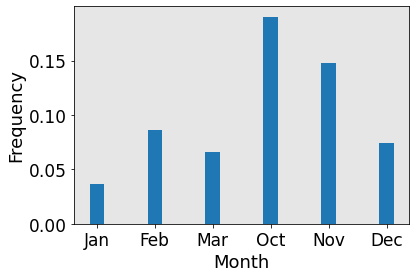

In [54]:
#final_df.pvadv_irrot.plot()

pvadv_median = final_df['pvadv_irrot'].quantile(.50)
pvadv_90_pc  = final_df['pvadv_irrot'].quantile(.90)
print('pvadv median : ',pvadv_median)
print('pvadv 90 percentile : ',pvadv_90_pc)
#df_sallj_48hrs_abvavg = final_df[final_df.rolling(48)['max_pos_PVadv'].min() >= sallj_median]
df_pvadv_48hrs_abv75pc = final_df[final_df['pvadv_irrot'] >= pvadv_90_pc]
df_pvadv_48hrs_abv75pc

#print(df_pvadv_48hrs_abv75pc)
df = df_pvadv_48hrs_abv75pc
aaa=(df.groupby(df.index.month).count()['pvadv_irrot'].values)/(final_df.groupby(final_df.index.month).count()['pvadv_irrot'].values)
print(aaa)


br1 = np.arange(len(aaa))
barWidth=0.25

fig, ax = plt.subplots()
plt.bar(br1,aaa,width=0.25)
plt.xlabel('Month')
plt.ylabel('Frequency')
plt.title('')
xtick_labels = ['Jan', 'Feb','Mar','Oct','Nov','Dec']
plt.xticks([r for r in range(len(aaa))],xtick_labels)
fig.savefig('Bar_plot_monthly_aavg_pvadvirrot_90pc_ERA5data_times_exceedance_divided_total_times.png', dpi=200, format='png', bbox_inches='tight')

#df_resampled = df_pvadv_48hrs_abv75pc.resample('D').mean()
#df_resampled

pvadv median :  0.00901041783852685
pvadv 90 percentile :  0.03427332379482146


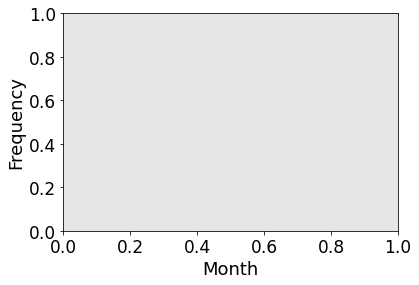

In [44]:
#final_df.pvadv_irrot.plot()

pvadv_median = final_df['pvadv_irrot'].quantile(.50)
pvadv_90_pc  = final_df['pvadv_irrot'].quantile(.90)
print('pvadv median : ',pvadv_median)
print('pvadv 90 percentile : ',pvadv_90_pc)
#df_sallj_48hrs_abvavg = final_df[final_df.rolling(48)['max_pos_PVadv'].min() >= sallj_median]
df_pvadv_48hrs_abv75pc = final_df[final_df['pvadv_irrot'] >= pvadv_90_pc]
df_pvadv_48hrs_abv75pc

#print(df_pvadv_48hrs_abv75pc)
df = df_pvadv_48hrs_abv75pc
df.reset_index(inplace=True)
#df.reset_index(inplace=True)
#print(df)
fig, ax = plt.subplots()
df.date.groupby(df.date.dt.month).count()#.plot(kind="bar")
plt.xlabel('Month')
plt.ylabel('Frequency')
plt.title('')
#xtick_labels = ['Jan', 'Feb','Mar','Oct','Nov','Dec']
#ax.set_xticklabels(xtick_labels,rotation = 0)
#final_df.groupby(final_df.index.month).count().plot(kind="bar")
fig.savefig('Bar_plot_monthly_aavg_pvadvirrot_90pc.png', dpi=200, format='png', bbox_inches='tight')

#df_resampled = df_pvadv_48hrs_abv75pc.resample('D').mean()
#df_resampled

In [6]:
# max UL +PV advection

extension = 'csv'
all_filenames = [i for i in glob.glob('ERA5_time_series_max_ulpvadvirrot_parallel*.{}'.format(extension))]
#print(all_filenames)
combined_csv = pd.concat([pd.read_csv(f,header=None,delimiter=',',names=['date','max_pos_PVadv','max_lat','max_lon'],index_col='date',parse_dates=True) for f in all_filenames ])
final_df = combined_csv.sort_values(by='date')
#print(len(final_df))
#final_df = final_df[final_df['pvadv_irrot'] > 0.0]
print(len(final_df))
final_df.index.year.unique()

10944


Int64Index([2002, 2017, 2018, 2019], dtype='int64', name='date')

pvadv median :  0.31052854967742693
pvadv 75 percentile :  0.9137121545706895


[Text(0, 0, 'Jan'),
 Text(1, 0, 'Feb'),
 Text(2, 0, 'Mar'),
 Text(3, 0, 'Oct'),
 Text(4, 0, 'Nov'),
 Text(5, 0, 'Dec')]

findfont: Font family ['Helvetica'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Helvetica'] not found. Falling back to DejaVu Sans.


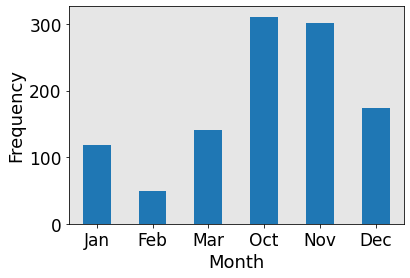

In [7]:
#final_df.max_pos_PVadv.plot()

pvadv_median = final_df['max_pos_PVadv'].quantile(.50)
pvadv_75_pc  = final_df['max_pos_PVadv'].quantile(.90)
print('pvadv median : ',pvadv_median)
print('pvadv 75 percentile : ',pvadv_75_pc)
#df_sallj_48hrs_abvavg = final_df[final_df.rolling(48)['max_pos_PVadv'].min() >= sallj_median]
df_pvadv_48hrs_abv75pc = final_df[final_df['max_pos_PVadv'] >= pvadv_75_pc]
df_pvadv_48hrs_abv75pc


df = df_pvadv_48hrs_abv75pc
df.reset_index(inplace=True)
#df.reset_index(inplace=True)
#print(df)
fig, ax = plt.subplots()
df.date.groupby(df.date.dt.month).count().plot(kind="bar")
plt.xlabel('Month')
plt.ylabel('Frequency')
plt.title('')
xtick_labels = ['Jan', 'Feb','Mar','Oct','Nov','Dec']
ax.set_xticklabels(xtick_labels,rotation = 0)
#final_df.groupby(final_df.index.month).count().plot(kind="bar")
#fig.savefig('test_rotation.png', dpi=300, format='png', bbox_inches='tight')

#df_resampled = df_pvadv_48hrs_abv75pc.resample('D').mean()
#df_resampled

In [10]:
dt = df_pvadv_48hrs_abv75pc.index.to_series()
hour = pd.Timedelta('1H')
breaks = dt.diff() != hour
groups = breaks.cumsum()
df_pvadv_48hrs_abv75pc['groups'] = groups
df_pvadv_48hrs_abv75pc

/glade/scratch/isingh9/ipykernel_6869/1621923808.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_pvadv_48hrs_abv75pc['groups'] = groups


,date,max_pos_PVadv,max_lat,max_lon,groups
0,2002-10-02 14:00:00,1.107333,-36.25,296.00,1
1,2002-10-02 15:00:00,1.207012,-36.50,296.75,2
2,2002-10-02 16:00:00,1.129474,-36.75,297.75,3
3,2002-10-02 17:00:00,1.665042,-30.00,303.25,4
4,2002-10-02 18:00:00,1.764515,-30.00,304.50,5
...,...,...,...,...,...
1090,2019-03-18 22:00:00,1.130103,-32.50,309.75,1091
1091,2019-03-20 17:00:00,0.981206,-30.75,301.50,1092
1092,2019-03-20 18:00:00,1.066329,-31.25,302.75,1093
1093,2019-03-20 19:00:00,1.045685,-31.00,302.50,1094


In [8]:
df = df_pvadv_48hrs_abv75pc
df.reset_index(inplace=True)

dt = df.date
#hour = pd.Timedelta('3H')
hour = pd.Timedelta(1, unit="H")
in_block = ((dt - dt.shift(-1)).abs() == hour)  | (dt.diff() == hour)
#in_block

filt = df.loc[in_block]
breaks = filt['date'].diff() != hour
groups = breaks.cumsum()
#groups


df['groups'] = groups
df

/glade/scratch/isingh9/ipykernel_33985/571485357.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['groups'] = groups


,index,date,max_pos_PVadv,max_lat,max_lon,groups
0,0,2002-10-02 14:00:00,1.107333,-36.25,296.00,1.0
1,1,2002-10-02 15:00:00,1.207012,-36.50,296.75,1.0
2,2,2002-10-02 16:00:00,1.129474,-36.75,297.75,1.0
3,3,2002-10-02 17:00:00,1.665042,-30.00,303.25,1.0
4,4,2002-10-02 18:00:00,1.764515,-30.00,304.50,1.0
...,...,...,...,...,...,...
1090,1090,2019-03-18 22:00:00,1.130103,-32.50,309.75,NaN
1091,1091,2019-03-20 17:00:00,0.981206,-30.75,301.50,156.0
1092,1092,2019-03-20 18:00:00,1.066329,-31.25,302.75,156.0
1093,1093,2019-03-20 19:00:00,1.045685,-31.00,302.50,156.0


In [32]:
df[0:50]

,index,date,max_pos_PVadv,max_lat,max_lon,groups
0,0,2002-10-02 14:00:00,1.107333,-36.25,296.00,1.0
1,1,2002-10-02 15:00:00,1.207012,-36.50,296.75,1.0
2,2,2002-10-02 16:00:00,1.129474,-36.75,297.75,1.0
3,3,2002-10-02 17:00:00,1.665042,-30.00,303.25,1.0
4,4,2002-10-02 18:00:00,1.764515,-30.00,304.50,1.0
5,5,2002-10-02 19:00:00,1.241841,-30.50,305.00,1.0
6,6,2002-10-02 20:00:00,2.637573,-30.25,306.50,1.0
7,7,2002-10-02 21:00:00,2.020123,-30.25,308.00,1.0
8,8,2002-10-02 22:00:00,2.018669,-29.75,309.25,1.0
9,9,2002-10-02 23:00:00,1.459003,-32.00,303.50,1.0


In [9]:
high_pv_num_20=0
df_select = pd.DataFrame(columns = ['date', 'max_pos_PVadv', 'max_lat','max_lon'])

for _, frame in filt.groupby(groups):
    #print(frame, end='\n\n')
    #print('len of this group is : ',len(frame))
    start_date = frame.iloc[0]['date']
    mid_date = frame.iloc[(len(frame))//2]['date']
    end_date = frame.iloc[-1]['date']
    
    #print('start point of this group is ',start_date)
    #print('mid point of this group is ',mid_date)
    #print('\n')
    #print('end point of this group is ',end_date)
    #print(frame)
    
    if len(frame)>=12:
        print(' long group found \n')
        print(frame.iloc[[(len(frame))//2]])
        print('\n-----\n')
        df_select = pd.concat([df_select,frame.iloc[[(len(frame))//2]]])
        #print(' Found a group with > 20 times ...')
        high_pv_num_20=high_pv_num_20+1
        #plot_ERA5_timestep(pd.to_datetime(start_date))
        #plot_ERA5_timestep(pd.to_datetime(mid_date))
        #plot_ERA5_timestep(pd.to_datetime(end_date))
        #plot_ERA5_NBE_timestep(pd.to_datetime(start_date))
        #plot_ERA5_NBE_timestep(pd.to_datetime(mid_date))
        #plot_ERA5_NBE_timestep(pd.to_datetime(end_date))
        #print('%age of time SALLJ > 75th percentile ',frame.loc[frame['sallj'] > sallj_75_pc,'sallj'].count()*100./frame['sallj'].count())
        #print('%age of time SALLJ > 50th percentile ',frame.loc[frame['sallj'] > sallj_50_pc,'sallj'].count()*100./frame['sallj'].count())
        #print('-------')
    #print('\n')

print(df_select)
print('number of > 20-hr high_pv_num ',high_pv_num_20)

 long group found 

   index                date  max_pos_PVadv  max_lat  max_lon
7      7 2002-10-02 21:00:00       2.020123   -30.25    308.0

-----

 long group found 

    index                date  max_pos_PVadv  max_lat  max_lon
73     73 2002-10-27 08:00:00       1.807795    -32.0    308.5

-----

 long group found 

     index                date  max_pos_PVadv  max_lat  max_lon
125    125 2002-11-17 09:00:00       0.913978   -30.75   296.75

-----

 long group found 

     index                date  max_pos_PVadv  max_lat  max_lon
164    164 2002-11-25 05:00:00       1.990252   -32.25    295.0

-----

 long group found 

     index       date  max_pos_PVadv  max_lat  max_lon
208    208 2002-12-06       2.354315    -29.0   302.25

-----

 long group found 

     index                date  max_pos_PVadv  max_lat  max_lon
261    261 2017-10-01 20:00:00       4.783515   -20.25    299.5

-----

 long group found 

     index                date  max_pos_PVadv  max_lat  max_lon
340 

-----------------------------
 month is  Oct
dataframe for this month is :

                    date max_pos_PVadv max_lat max_lon  index
7    2002-10-02 21:00:00      2.020123  -30.25   308.0    7.0
73   2002-10-27 08:00:00      1.807795   -32.0   308.5   73.0
261  2017-10-01 20:00:00      4.783515  -20.25   299.5  261.0
340  2017-10-18 20:00:00      2.217319  -33.25   295.0  340.0
392  2017-10-25 21:00:00      1.043988  -25.25   300.5  392.0
647  2018-10-01 07:00:00      1.117419   -35.0  303.75  647.0
676  2018-10-31 06:00:00      2.429561  -35.25  304.75  676.0
-----
mean lon is  302.85714285714283
mean lat is  -30.178571428571427
 working on time :  2002-10-02 21:00:00
MAX_LON:  308.0
MAX_LAT:  -30.25
shape of lats_TIM:  (120,)
shape of lons_TIM:  (120,)
shape of zz:  (120, 120)
 working on time :  2002-10-27 08:00:00
MAX_LON:  308.5
MAX_LAT:  -32.0
shape of lats_TIM:  (120,)
shape of lons_TIM:  (120,)
shape of zz:  (120, 120)
 working on time :  2017-10-01 20:00:00
MAX_LON:  299.

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:1666: UserWarning: The following kwargs were not used by contour: 'linestyle', 'linewidth'
  result = matplotlib.axes.Axes.contour(self, *args, **kwargs)
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visib

saving to file:  ERA5_composite_90th_percentile_pvadv_irrot_Oct.png
-----------------------------
 month is  Nov
dataframe for this month is :

                    date max_pos_PVadv max_lat max_lon  index
125  2002-11-17 09:00:00      0.913978  -30.75  296.75  125.0
164  2002-11-25 05:00:00      1.990252  -32.25   295.0  164.0
448  2017-11-04 08:00:00      1.174108  -32.75   302.0  448.0
803  2018-11-24 20:00:00      1.755433  -34.75  307.25  803.0
-----
mean lon is  300.25
mean lat is  -32.625
 working on time :  2002-11-17 09:00:00
MAX_LON:  296.75
MAX_LAT:  -30.75
shape of lats_TIM:  (120,)
shape of lons_TIM:  (120,)
shape of zz:  (120, 120)
 working on time :  2002-11-25 05:00:00
MAX_LON:  295.0
MAX_LAT:  -32.25
shape of lats_TIM:  (120,)
shape of lons_TIM:  (120,)
shape of zz:  (120, 120)
 working on time :  2017-11-04 08:00:00
MAX_LON:  302.0
MAX_LAT:  -32.75
shape of lats_TIM:  (120,)
shape of lons_TIM:  (120,)
shape of zz:  (120, 120)
 working on time :  2018-11-24 20:00:00
MA

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:1666: UserWarning: The following kwargs were not used by contour: 'linestyle', 'linewidth'
  result = matplotlib.axes.Axes.contour(self, *args, **kwargs)
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visib

saving to file:  ERA5_composite_90th_percentile_pvadv_irrot_Nov.png
-----------------------------
 month is  Dec
dataframe for this month is :

                    date max_pos_PVadv max_lat max_lon  index
208  2002-12-06 00:00:00      2.354315   -29.0  302.25  208.0
513  2017-12-17 03:00:00      2.143648   -37.5   298.0  513.0
821  2018-12-11 09:00:00      1.279524  -34.25  298.25  821.0
847  2018-12-14 04:00:00      3.682263  -30.25  299.75  847.0
-----
mean lon is  299.5625
mean lat is  -32.75
 working on time :  2002-12-06 00:00:00
MAX_LON:  302.25
MAX_LAT:  -29.0
shape of lats_TIM:  (120,)
shape of lons_TIM:  (120,)
shape of zz:  (120, 120)
 working on time :  2017-12-17 03:00:00
MAX_LON:  298.0
MAX_LAT:  -37.5
shape of lats_TIM:  (120,)
shape of lons_TIM:  (120,)
shape of zz:  (120, 120)
 working on time :  2018-12-11 09:00:00
MAX_LON:  298.25
MAX_LAT:  -34.25
shape of lats_TIM:  (120,)
shape of lons_TIM:  (120,)
shape of zz:  (120, 120)
 working on time :  2018-12-14 04:00:00
MA

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:1666: UserWarning: The following kwargs were not used by contour: 'linestyle', 'linewidth'
  result = matplotlib.axes.Axes.contour(self, *args, **kwargs)
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visib

saving to file:  ERA5_composite_90th_percentile_pvadv_irrot_Dec.png


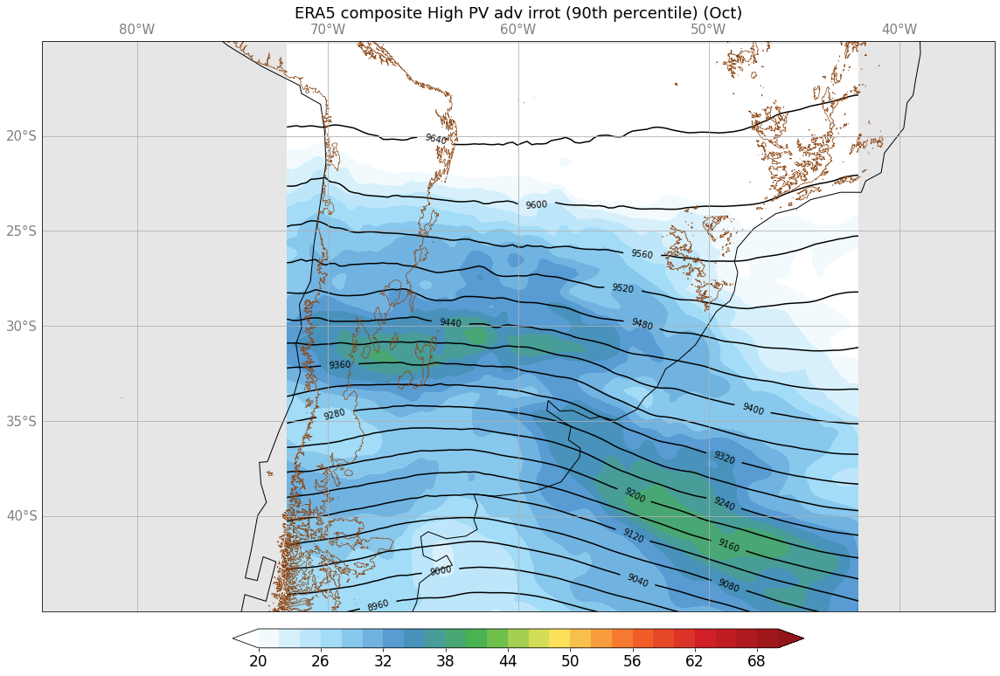

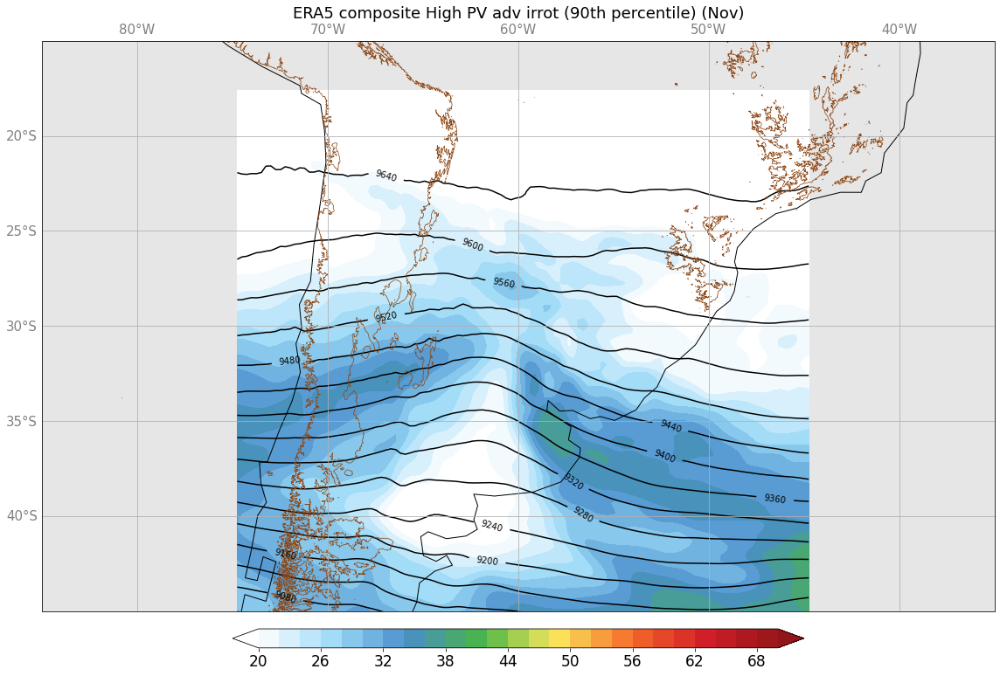

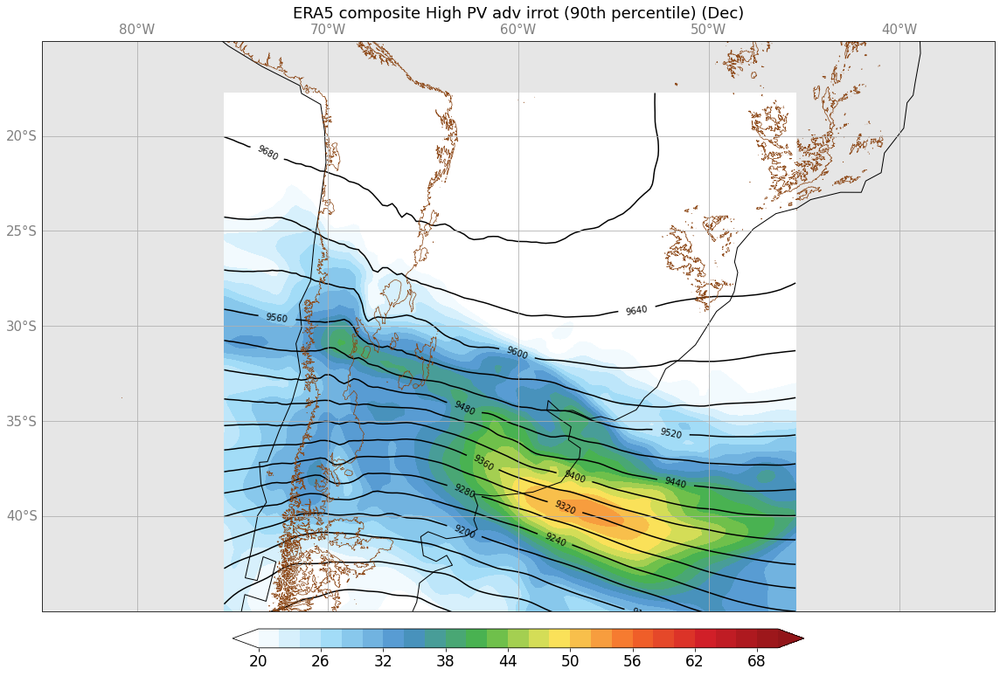

In [26]:
#months=[1,2,3,10,11,12]
months=[10,11,12]
#month_names=['Jan','Feb','Mar','Oct','Nov','Dec']
month_names=['Oct','Nov','Dec']
ii = 0
   
for mon in months:
    mn=month_names[ii]
    ii = ii + 1
    print('-----------------------------')
    print(' month is ',mn)
    df_mon = df_select.loc[(pd.to_datetime(df_select['date']).dt.month==mon)]
    print('dataframe for this month is :\n')
    print(df_mon) 
    print('-----')
    if len(df_mon)>0:
        create_composite_ERA5_times_300hpa(df_mon,mn)
    else:
        print('skipping ...')
        continue

In [8]:
final_df.index.year.unique()

Int64Index([2002], dtype='int64', name='date')

In [16]:
final_df.groupby(final_df.index.month).corr(method='pearson')

sallj  pvadv_irrot     rrmax     rravg        MI  \
date                                                                    
1    sallj        1.000000     0.325085  0.475781  0.544101  0.130477   
     pvadv_irrot  0.325085     1.000000  0.382629  0.528631  0.153220   
     rrmax        0.475781     0.382629  1.000000  0.762867  0.135127   
     rravg        0.544101     0.528631  0.762867  1.000000  0.147120   
     MI           0.130477     0.153220  0.135127  0.147120  1.000000   
     max_jet      0.414460     0.225637  0.387607  0.386934  0.427291   
2    sallj        1.000000     0.239971  0.398974  0.468802  0.032584   
     pvadv_irrot  0.239971     1.000000  0.322189  0.492967  0.043938   
     rrmax        0.398974     0.322189  1.000000  0.712723 -0.002510   
     rravg        0.468802     0.492967  0.712723  1.000000 -0.002616   
     MI           0.032584     0.043938 -0.002510 -0.002616  1.000000   
     max_jet      0.351628     0.246358  0.266416  0.252450  0.351294   
3    sallj        1.000000     0.253861  0.463788  0.532304  0.145946   
     pvadv_irrot  0.253861     1.000000  0.386130  0.544253  0.131718   
     rrmax        0.463788     0.386130  1.000000  0.758025  0.027657   
     rravg        0.532304     0.544253  0.758025  1.000000  0.078394   
     MI           0.145946     0.131718  0.027657  0.078394  1.000000   
     max_jet      0.392616     0.229213  0.267311  0.329226  0.437757   
10   sallj        1.000000     0.456577  0.539058  0.607612  0.254456   
     pvadv_irrot  0.456577     1.000000  0.496099  0.633970  0.207821   
     rrmax        0.539058     0.496099  1.000000  0.767940  0.130589   
     rravg        0.607612     0.633970  0.767940  1.000000  0.277793   
     MI           0.254456     0.207821  0.130589  0.277793  1.000000   
     max_jet      0.347675     0.188856  0.221845  0.201987  0.232627   
11   sallj        1.000000     0.448189  0.495099  0.636578  0.239919   
     pvadv_irrot  0.448189     1.000000  0.455494  0.577903  0.151549   
     rrmax        0.495099     0.455494  1.000000  0.773068  0.038139   
     rravg        0.636578     0.577903  0.773068  1.000000  0.151946   
     MI           0.239919     0.151549  0.038139  0.151946  1.000000   
     max_jet      0.495480     0.268015  0.350247  0.382940  0.247775   
12   sallj        1.000000     0.331843  0.514809  0.595930  0.258365   
     pvadv_irrot  0.331843     1.000000  0.417560  0.555605  0.067361   
     rrmax        0.514809     0.417560  1.000000  0.778455  0.017857   
     rravg        0.595930     0.555605  0.778455  1.000000  0.110699   
     MI           0.258365     0.067361  0.017857  0.110699  1.000000   
     max_jet      0.561730     0.250892  0.301703  0.356568  0.424423   

                   max_jet  
date                        
1    sallj        0.414460  
     pvadv_irrot  0.225637  
     rrmax        0.387607  
     rravg        0.386934  
     MI           0.427291  
     max_jet      1.000000  
2    sallj        0.351628  
     pvadv_irrot  0.246358  
     rrmax        0.266416  
     rravg        0.252450  
     MI           0.351294  
     max_jet      1.000000  
3    sallj        0.392616  
     pvadv_irrot  0.229213  
     rrmax        0.267311  
     rravg        0.329226  
     MI           0.437757  
     max_jet      1.000000  
10   sallj        0.347675  
     pvadv_irrot  0.188856  
     rrmax        0.221845  
     rravg        0.201987  
     MI           0.232627  
     max_jet      1.000000  
11   sallj        0.495480  
     pvadv_irrot  0.268015  
     rrmax        0.350247  
     rravg        0.382940  
     MI           0.247775  
     max_jet      1.000000  
12   sallj        0.561730  
     pvadv_irrot  0.250892  
     rrmax        0.301703  
     rravg        0.356568  
     MI           0.424423  
     max_jet      1.000000

In [ ]:
final_df.corr(method='pearson')

In [ ]:
sallj_median = final_df['sallj'].quantile(.50)
sallj_75_pc  = final_df['sallj'].quantile(.75)
print('sallj median : ',sallj_median)
print('sallj 75 percentile : ',sallj_75_pc)
df_sallj_48hrs_abvavg = final_df[final_df.rolling(48)['sallj'].min() >= sallj_median]
df_sallj_48hrs_abv75pc = final_df[final_df.rolling(48)['sallj'].min() >= sallj_75_pc]
df_sallj_48hrs_abv75pc

In [ ]:
df_sallj_48hrs_abv75pc.index.month.isin([2])

df.loc[(df['date'].dt.day==25) & (cust_df['date'].dt.month==12), 'xmas'] =

In [ ]:
plot_ERA5_timestep(pd.to_datetime('2018-11-12 09:00:00'))

### Times of continous postive PV advection by irrotational winds

In [29]:
pvirrot_median = final_df['pvadv_irrot'].quantile(.50)
pvirrot_75_pc  = final_df['pvadv_irrot'].quantile(.75)
print('pvirrot median : ',pvirrot_median)
print('pvirrot 75 percentile : ',pvirrot_75_pc)
#df_pvirrot_48hrs_abvavg  = final_df[final_df.rolling(24)['pvadv_irrot'].min() >= pvirrot_median]
#df_pvirrot_48hrs_abv75pc = final_df[final_df.rolling(24)['pvadv_irrot'].min() >= pvirrot_75_pc]
df_pvirrot_48hrs_abv75pc = final_df[final_df['pvadv_irrot'] >= pvirrot_75_pc]
df_pvirrot_48hrs_abv75pc

pvirrot median :  0.00901041783852685
pvirrot 75 percentile :  0.01967699981683455


,sallj,pvadv_irrot,rrmax,rravg,MI,max_jet
date,,,,,,
2001-10-01 02:00:00,15.122255,0.021396,16.348600,0.669517,7.843584,65.957495
2001-10-01 03:00:00,15.047113,0.034238,15.852070,0.651065,7.698371,65.081147
2001-10-01 04:00:00,14.936342,0.040069,15.664959,0.637117,7.625264,64.729644
2001-10-01 05:00:00,14.790277,0.047736,14.767170,0.620397,7.585202,64.292856
2001-10-01 06:00:00,14.552658,0.053478,15.155125,0.608762,7.634635,64.089396
...,...,...,...,...,...,...
2019-03-27 19:00:00,4.512023,0.022337,2.610111,0.016691,8.734304,43.731266
2019-03-27 20:00:00,4.761622,0.021038,2.243614,0.015694,8.706626,43.024387
2019-03-27 21:00:00,5.299736,0.020079,3.295469,0.015697,8.575545,42.632214


In [ ]:
# Monthly analysis of PV advection 

[Text(0, 0, 'Jan'),
 Text(1, 0, 'Feb'),
 Text(2, 0, 'Mar'),
 Text(3, 0, 'Oct'),
 Text(4, 0, 'Nov'),
 Text(5, 0, 'Dec')]

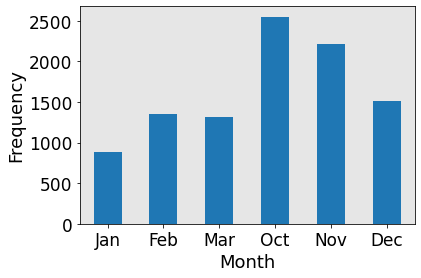

In [45]:
df = df_pvirrot_48hrs_abv75pc
#df.reset_index(inplace=True)
#print(df)
fig, ax = plt.subplots()
df.date.groupby(df.date.dt.month).count().plot(kind="bar")
plt.xlabel('Month')
plt.ylabel('Frequency')
plt.title('')
xtick_labels = ['Jan', 'Feb','Mar','Oct','Nov','Dec']
ax.set_xticklabels(xtick_labels,rotation = 0)
plt.savefig()
#final_df.groupby(final_df.index.month).count().plot(kind="bar")
#fig.savefig('test_rotation.png', dpi=300, format='png', bbox_inches='tight')

In [ ]:
# Interannual analysis of PV advection

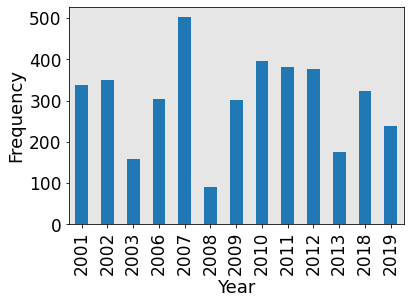

In [32]:
df = df_pvadv_48hrs_abv75pc
df_pvadv_48hrs_abv75pc
#df.reset_index(inplace=True)
#print(df)
fig, ax = plt.subplots()
df.date.groupby(df.date.dt.year).count().plot(kind="bar")
plt.xlabel('Year')
plt.ylabel('Frequency')
plt.title('')
plt.savefig('Bar_plot_yearly_aavg_pvadvirrot_90pc.png')
#xtick_labels = ['Jan', 'Feb','Mar','Oct','Nov','Dec']
#ax.set_xticklabels(xtick_labels,rotation = 0)
#final_df.groupby(final_df.index.month).count().plot(kind="bar")

## Zhe Feng MCS tracking data

In [17]:
# Zhe Feng OLD data
mcs_track_data_file = '/glade/u/home/isingh9/work/Zhe_Feng_data/Feng2020JGR_data/data/spac/robust_mcs_tracks_extc_20140101_20141231.nc'
#mcs_track_data_file='/glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20020101.0000_20030101.0000.nc'
mcs_feng_data = xr.open_dataset(mcs_track_data_file)
mcs_feng_data
#print(np.nanmax(mcs_feng_data.meanlon.values))
#print(np.nanmin(mcs_feng_data.meanlon.values))
#mcs_feng_data.meanlat.isel(times=3,tracks=4)

<xarray.Dataset>
Dimensions:                       (times: 200, tracks: 13881, nmaxmerge: 100, nmaxpf: 3, nmaxpix: 10000)
Coordinates:
  * times                         (times) float32 0.0 1.0 2.0 ... 198.0 199.0
  * tracks                        (tracks) int32 0 1 2 3 ... 13878 13879 13880
Dimensions without coordinates: nmaxmerge, nmaxpf, nmaxpix
Data variables: (12/57)
    length                        (tracks) float32 ...
    mcs_length                    (tracks) float32 ...
    mcs_type                      (tracks) int16 ...
    starttrackresult              (tracks) float32 ...
    endtrackresult                (tracks) float32 ...
    base_time                     (tracks, times) datetime64[ns] ...
    ...                            ...
    movement_r                    (tracks, times) float32 ...
    movement_r_meters_per_second  (tracks, times) float32 ...
    movement_theta                (tracks, times) float32 ...
    movement_storm_x              (tracks, times) float32 ...
    movement_storm_y              (tracks, times) float32 ...
    movement_time_lag             (tracks, times) float32 ...
Attributes: (12/26)
    title:                           Robust MCS statistics defined by precipi...
    source1:                         gpmirimerg
    description:                     gpm
    startdate:                       20140101
    enddate:                         20141231
    _FillValue:                      -999
    ...                              ...
    PF_rainrate_skewness_slope:      0.0100072
    PF_heavyrain_ratio_intercept:    3.419024
    PF_heavyrain_ratio_slope:        0.438709
    contact:                         Zhe Feng: zhe.feng@pnnl.gov
    created_on:                      Mon Jun  8 10:06:23 2020
    movement_estimate_lag_order:     3

In [73]:
# Zhe Feng NEW data
#mcs_track_data_file = '/glade/u/home/isingh9/work/Zhe_Feng_data/Feng2020JGR_data/data/spac/robust_mcs_tracks_extc_20140101_20141231.nc'
mcs_track_data_file='/glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20020101.0000_20030101.0000.nc'
mcs_feng_data = xr.open_dataset(mcs_track_data_file)
mcs_feng_data
#print(np.nanmean(mcs_feng_data.mcs_duration.values))
#print(np.nanmax(mcs_feng_data.meanlon.values))
#print(np.nanmin(mcs_feng_data.meanlon.values))
#mcs_feng_data.meanlat.isel(times=3,tracks=4)

<xarray.Dataset>
Dimensions:                  (tracks: 1070, times: 400, mergers: 50, nmaxpf: 3)
Coordinates:
  * tracks                   (tracks) int64 22 26 85 96 ... 32403 32439 32441
  * times                    (times) int64 0 1 2 3 4 5 ... 395 396 397 398 399
  * mergers                  (mergers) int64 0 1 2 3 4 5 6 ... 44 45 46 47 48 49
  * nmaxpf                   (nmaxpf) int64 0 1 2
Data variables: (12/55)
    track_duration           (tracks) int32 ...
    start_status             (tracks) float64 ...
    end_status               (tracks) float64 ...
    start_basetime           (tracks) datetime64[ns] ...
    end_basetime             (tracks) datetime64[ns] ...
    start_split_cloudnumber  (tracks) float64 ...
    ...                       ...
    pf_mcsstatus             (tracks, times) float64 ...
    movement_distance        (tracks, times) float32 ...
    movement_speed           (tracks, times) float32 ...
    movement_theta           (tracks, times) float32 ...
    movement_distance_x      (tracks, times) float32 ...
    movement_distance_y      (tracks, times) float32 ...
Attributes: (12/27)
    Title:                       Statistics of each MCS track
    Institution:                 Pacific Northwest National Laboratory
    Contact:                     Zhe Feng, zhe.feng@pnnl.gov
    Created_on:                  Wed Mar  9 21:33:19 2022
    startdate:                   20020101.0000
    enddate:                     20030101.0000
    ...                          ...
    coefs_pf_heavyratio:         [3.419024 0.438709]
    max_speed_thresh:            50
    lon_box:                     [-80. -40.]
    lat_box:                     [-45. -15.]
    subset_start_time:           2002-01-01T00:00:00
    subset_end_time:             2002-12-31T23:59:00

In [82]:
print(mcs_feng_data.start_basetime.sel(tracks=22).values)
print(mcs_feng_data.end_basetime.sel(tracks=22).values)
print(mcs_feng_data.base_time.sel(tracks=22).values)
print(mcs_feng_data.track_duration.sel(tracks=22).values)

2002-01-01T00:30:00.000013440
2002-01-01T06:30:00.000013440
['2002-01-01T00:30:00.000013440' '2002-01-01T01:30:00.000000000'
 '2002-01-01T02:30:00.000026880' '2002-01-01T03:30:00.000013440'
 '2002-01-01T04:30:00.000000000' '2002-01-01T05:30:00.000026880'
 '2002-01-01T06:30:00.000013440'                           'NaT'
                           'NaT'                           'NaT'
                           'NaT'                           'NaT'
                           'NaT'                           'NaT'
                           'NaT'                           'NaT'
                           'NaT'                           'NaT'
                           'NaT'                           'NaT'
                           'NaT'                           'NaT'
                           'NaT'                           'NaT'
                           'NaT'                           'NaT'
                           'NaT'                           'NaT'
                           'Na

In [106]:
def subset_file(infile, outdir, lon_box, lat_box, time_box):
    
    print('input file is ',infile)
    
    status = 0

    # Read input MCS track file
    ds = xr.open_dataset(infile)

    # Get track initiation lat/lon location
    lon0 = ds.meanlon.isel(times=0)
    lat0 = ds.meanlat.isel(times=0)
    tim0 = pd.to_datetime(ds.base_time.isel(times=0))

    # Get track index for MCS initiation location within a region
    trackid = np.where((lon0 >= np.min(lon_box)) & (lon0 <= np.max(lon_box)) & (lat0 >= np.min(lat_box)) & (lat0 <= np.max(lat_box)) & \
                       (tim0 >=    min(time_box))& (tim0 <=    max(time_box)) )[0]
 
    #for item in trackid:
    #    print(item)
    #    print(list(ds.tracks.values).count(item))
        
    #print('trackid : ',trackid)
    # Subset the tracks from the dataset
    #print(ds.tracks.values)
    dsout = ds.isel(tracks=trackid, drop=True)

    # Strip the path to get input file name
    infilename = os.path.basename(infile)
    # Make output file name 
    #outfile = f'{outdir}{infilename}'

    # Write output file
    #dsout.to_netcdf(path=outfile, mode='w', format='NETCDF4_CLASSIC', unlimited_dims='tracks')
    #print(f'Output saved: {outfile}')

    status = 1
    return dsout


lon_box = [-60,-50]
lat_box = [-30, -20]
timeframe=[pd.to_datetime('2012-10-01'),pd.to_datetime('2012-10-31')]

# Define output directory
#outdir = f'/global/cscratch1/sd/feng045/waccem/mcs_region/spac/subset_africa_stats/'
#os.makedirs(outdir, exist_ok=True)

# Call function
year=2002
#mcs_track_data_file = '/glade/u/home/isingh9/work/Zhe_Feng_data/Feng2020JGR_data/data/spac/robust_mcs_tracks_extc_'+str(year)+'0101_'+str(year)+'1231.nc'
mcs_track_data_file='/glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20120101.0000_20130101.0000.nc'
ds = subset_file(mcs_track_data_file, None, lon_box, lat_box, timeframe)
print(np.nanmean(ds.mcs_duration.values))
#print(ds)
#meanlats = ds.meanlat.mean(dim='times',skipna=True)
#meanlons = ds.meanlon.mean(dim='times',skipna=True)
#print(meanlats)

input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20120101.0000_20130101.0000.nc
21.357142857142858


In [29]:
# create csv file containing all information of all MCSs when their area is the largest 
years=np.arange(2001,2021,1)
mcs_track_data_files=['/glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_'+str(year)+'0101.0000_'+str(year+1)+'0101.0000.nc' for year in years]
print(mcs_track_data_files)

df_list=[]
for fil in mcs_track_data_files:
    print('working on file: ',fil)
    ds=xr.open_dataset(fil)
    #print(ds)
    core_area_max_ind = ds.total_rain.argmax(dim='times',skipna=True)
    core_area_max_time=ds.base_time[:,core_area_max_ind]
    #print('indices of max core area in time dimension for each track: ',core_area_max_ind)
    #print('values of core area max for each track',core_area_max)
    #print('time of max core area for each track',core_area_max_time)
    #print('size of time array of max core area for each track',np.shape(core_area_max_time))
    ds_final=ds.isel(times=core_area_max_ind)#.squeeze(dim='times')
    ds_final=ds_final.drop_dims(['mergers','nmaxpf']).drop('times')
    #print(ds_final)#.isel(tracks=0).base_time)
    df_temp=ds_final.to_dataframe()
    df_temp=df_temp.dropna(axis='columns')
    df_temp['base_time']=pd.to_datetime(df_temp['base_time'])
    df_temp_sondjfm = df_temp[df_temp['base_time'].dt.month.isin([1, 2, 3, 9, 10, 11, 12])]
    df_temp_useless = df_temp[df_temp['base_time'].dt.month.isin([4, 5, 6, 7, 8])]
    print('total tracks in the year: ',len(ds.tracks))
    print('tracks in SONDJF: ',len(df_temp_sondjfm))
    print('tracks in the rest: ',len(df_temp_useless))
    df_list.append(df_temp_sondjfm)
    
final_df = pd.concat(df_list, ignore_index=True)

['/glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20010101.0000_20020101.0000.nc', '/glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20020101.0000_20030101.0000.nc', '/glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20030101.0000_20040101.0000.nc', '/glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20040101.0000_20050101.0000.nc', '/glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20050101.0000_20060101.0000.nc', '/glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20060101.0000_20070101.0000.nc', '/glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20070101.0000_20080101.0000.nc', '/glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20080101.0000_20090101.0000.nc', '/glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20090101.0000_20100101.0000.nc', '/glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20

In [30]:
final_df.to_csv('Zhe_Feng_SONDJFM_2001-2020_tracks_stats_time_of_max_total_rain.csv')

In [31]:
df = pd.read_csv('Zhe_Feng_SONDJFM_2001-2020_tracks_stats_time_of_max_total_rain.csv')
df_feng_tracks=df.loc[:, ~df.columns.str.match('^Unnamed')]
df_feng_tracks['base_time']=pd.to_datetime(df_feng_tracks['base_time'])
df_feng_tracks=df_feng_tracks.loc[(df_feng_tracks.meanlon>=-70.) & (df_feng_tracks.meanlon<=-50.) &\
                 (df_feng_tracks.meanlat >=-45.) & (df_feng_tracks.meanlat<=-20)]
df_feng_tracks

/glade/scratch/isingh9/ipykernel_37070/1937025759.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_feng_tracks['base_time']=pd.to_datetime(df_feng_tracks['base_time'])


,track_duration,start_status,end_status,start_basetime,end_basetime,base_time,meanlat,meanlon,area,cloudnumber,...,cold_area,corecold_mintb,corecold_meantb,mcs_duration,mcs_status,ccs_area,pf_npf,pf_landfrac,total_rain,pf_lifetime
7,19,2.0,0.0,2001-01-02 13:30:00.000000000,2001-01-03 07:30:00.000000000,2001-01-02 22:30:00.000000000,-26.534346,-66.168690,85600.0,80.0,...,37300.0,201.29443,224.23468,9,1.0,84000.0,2.0,1.000000,1269.7411,12.0
11,22,1.0,0.0,2001-01-02 17:30:00.000026880,2001-01-03 14:30:00.000026880,2001-01-03 05:30:00.000026880,-38.679527,-59.106937,203200.0,23.0,...,176900.0,218.51088,231.65326,16,1.0,203200.0,8.0,0.678571,4175.0986,18.0
13,17,1.0,3.0,2001-01-03 09:30:00.000013440,2001-01-04 01:30:00.000000000,2001-01-03 13:30:00.000000000,-34.356346,-66.031770,122900.0,53.0,...,63700.0,212.82231,228.51901,12,1.0,117700.0,1.0,1.000000,2472.7173,16.0
18,8,2.0,0.0,2001-01-04 01:30:00.000000000,2001-01-04 08:30:00.000026880,2001-01-04 02:30:00.000026880,-28.934563,-64.532570,100400.0,50.0,...,62800.0,201.91472,227.55675,7,1.0,98600.0,2.0,1.000000,2271.5818,6.0
21,24,33.0,3.0,2001-01-04 07:30:00.000000000,2001-01-05 06:30:00.000013440,2001-01-04 20:30:00.000026880,-29.043009,-57.660470,353300.0,14.0,...,73500.0,195.94351,216.93979,16,1.0,353200.0,7.0,1.000000,8515.0070,19.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15937,15,1.0,0.0,2020-12-29 16:30:00.000000000,2020-12-30 06:30:00.000013312,2020-12-29 20:30:00.000026880,-22.338074,-66.768960,32700.0,142.0,...,10800.0,202.32315,220.52528,6,0.0,32600.0,6.0,1.000000,1028.1249,10.0
15943,18,2.0,0.0,2020-12-30 17:30:00.000026880,2020-12-31 10:30:00.000000000,2020-12-30 20:30:00.000026880,-25.638716,-64.299300,57600.0,104.0,...,12400.0,198.79300,216.05267,11,1.0,56200.0,2.0,1.000000,1888.6788,14.0
15944,10,44.0,3.0,2020-12-30 18:30:00.000013312,2020-12-31 03:30:00.000013312,2020-12-30 22:30:00.000000000,-31.054249,-53.082010,254300.0,20.0,...,155400.0,202.82580,230.83690,10,1.0,226600.0,8.0,0.508154,8032.5010,10.0
15947,23,1.0,3.0,2020-12-31 00:30:00.000013312,2020-12-31 22:30:00.000000000,2020-12-31 07:30:00.000000000,-25.572796,-59.617455,215400.0,25.0,...,57000.0,192.37254,217.66910,20,1.0,213800.0,3.0,1.000000,8938.3460,23.0


In [32]:
#unique_days=pd.to_datetime(final_df.base_time.map(pd.Timestamp.date).unique())
#unique_days

large_core_area_thres  = df_feng_tracks['core_area'].quantile(.90)
#print('core area 90 percentile : ',large_core_area_thres)
df_core_large= df_feng_tracks[df_feng_tracks['core_area'] >= large_core_area_thres]
#df_wcc_large=df_wcc_large.resample('D').max().dropna()
df_core_large['']

#unique_days=pd.to_datetime(df_core_large.base_time.map(pd.Timestamp.date).unique())
#print(unique_days)

core area 90 percentile :  327600.0
DatetimeIndex(['2001-01-06', '2001-01-10', '2001-01-17', '2001-01-22',
               '2001-01-28', '2001-01-31', '2001-02-10', '2001-02-12',
               '2001-02-19', '2001-02-22',
               ...
               '2020-01-30', '2020-02-14', '2020-02-18', '2020-03-11',
               '2020-10-26', '2020-11-09', '2020-11-25', '2020-11-26',
               '2020-12-03', '2020-12-05'],
              dtype='datetime64[ns]', length=561, freq=None)


u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/202012/e5.oper.an.pl.128_131_u.ll025uv.2020123100_2020123123.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/202012/e5.oper.an.pl.128_132_v.ll025uv.2020123100_2020123123.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/202012/e5.oper.an.pl.128_060_pv.ll025sc.2020123100_2020123123.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/202012/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2020121606_2021010106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/202012/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2020120106_2020121606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/202012/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2020121606_2021010106.nc']
    performing Helmholtz decomposition...
    getting rain rate...
        forecast_initial_time =  2020-12-31 06:00:00
        forecast hour =  12


findfont: Font family ['Helvetica'] not found. Falling back to DejaVu Sans.
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_37070/2968915399.py:67: UserWarning: This figure inclu

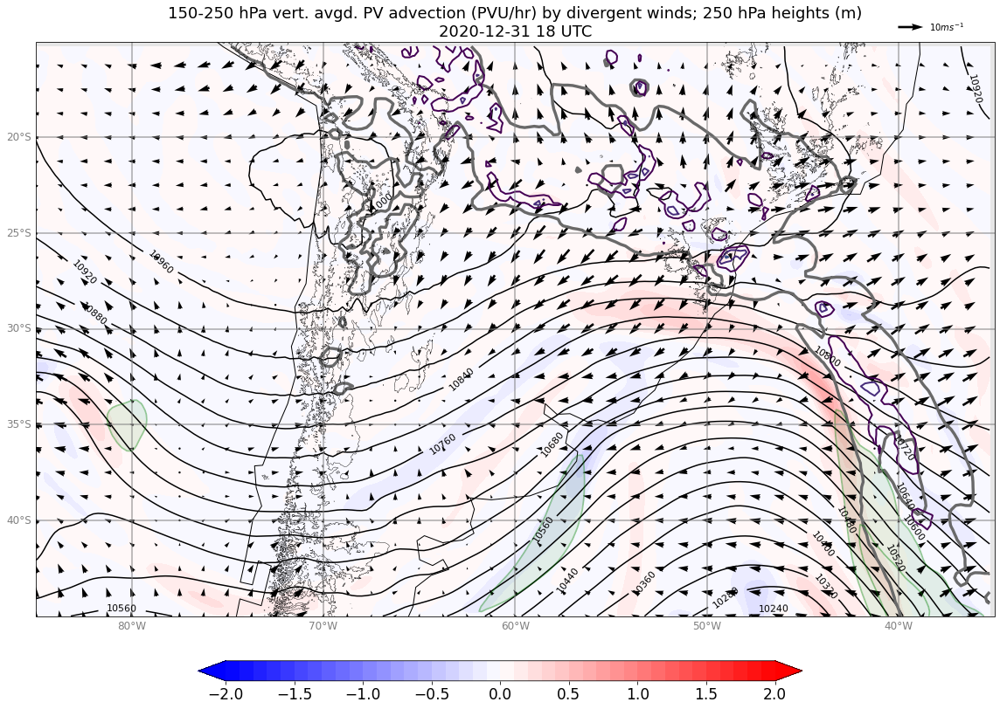

In [39]:
#'2020-12-05 '
plot_ERA5_timestep(150,250,pd.to_datetime('2020-12-31 18'))

In [27]:
# load TRMM WCC data
dd=pd.read_csv('TRMM_WCC_data_1998-2013_SONDJFM.csv')
df_wcc=dd.loc[:, ~dd.columns.str.match('^Unnamed')]
df_wcc['datetime']=pd.to_datetime(df_wcc['datetime'])

# extract the data within a lat-lon box
df_wcc=df_wcc.loc[(df_wcc.core_lon>=-70.) & (df_wcc.core_lon<=-50.) &\
                 (df_wcc.core_lat >=-45.) & (df_wcc.core_lat<=-20)]
df_wcc=df_wcc.set_index('datetime')
#unique_days_wcc=pd.to_datetime(pd.to_datetime(df_wcc['datetime']).map(pd.Timestamp.date).unique())
#unique_days_wcc
large_wcc_area_thres  = df_wcc['core_area'].quantile(.90)
print('core area 90 percentile : ',large_wcc_area_thres)
df_wcc_large= df_wcc[df_wcc['core_area'] >= large_wcc_area_thres]
df_wcc_large=df_wcc_large.resample('D').max().dropna()
df_wcc_large


/glade/scratch/isingh9/ipykernel_37070/1891289944.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_wcc['datetime']=pd.to_datetime(df_wcc['datetime'])


core area 90 percentile :  3997.2739999999994


,orbit,date,time,core_id,core_lon,core_lat,core_area,core_top_ht,core_bot_ht,core_dim_x,...,storm_rain_rate_min,storm_rain_pix_all,storm_rain_pix_stra,storm_rain_pix_conv,storm_rain_rate_mean_all,storm_rain_rate_mean_stra,storm_rain_rate_mean_conv,storm_rain_vol_all,storm_rain_vol_stra,storm_rain_vol_conv
datetime,,,,,,,,,,,,,,,,,,,,,
1998-01-07,b'00635',19980107.0,30339.0,1.0,-56.65,-24.50,5709.91,7.25,0.50,1.65,...,0.0,3428.0,2360.0,624.0,4.5761,3.1120,13.3547,121.7477,56.9999,64.6760
1998-01-15,b'00774',19980115.0,223701.0,1.0,-54.12,-23.58,6232.79,9.75,0.50,2.10,...,0.0,2140.0,947.0,621.0,3.9132,0.9257,12.0424,65.9031,6.8986,58.8522
1998-01-21,b'00863',19980121.0,152014.0,2.0,-60.78,-33.28,9329.27,8.50,0.75,2.20,...,0.0,4568.0,2744.0,1178.0,4.7677,1.5418,14.8874,154.8926,30.0885,124.7277
1998-01-30,b'01001',19980130.0,91726.0,4.0,-56.35,-29.42,6165.43,7.25,0.75,1.55,...,0.0,6770.0,4454.0,1759.0,5.8555,3.4497,13.7928,294.4038,114.1082,180.1804
1998-02-04,b'01078',19980204.0,62720.0,3.0,-54.38,-25.67,5836.55,8.50,0.50,1.75,...,0.0,7974.0,4901.0,1949.0,6.6066,3.6037,17.9358,396.6720,132.9855,263.2133
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2013-10-26,b'90827',20131026.0,95541.0,1.0,-52.97,-32.05,4375.32,4.75,0.75,1.40,...,0.0,9436.0,6809.0,1670.0,4.3468,3.1767,11.6064,298.0958,157.2017,140.8667
2013-10-31,b'90907',20131031.0,114729.0,1.0,-61.75,-30.02,9634.60,9.75,0.75,2.15,...,0.0,3854.0,2542.0,884.0,4.8782,2.2945,17.1617,134.3010,43.2398,106.1699
2013-11-01,b'90922',20131101.0,105203.0,2.0,-60.30,-31.88,10494.51,9.00,0.75,2.00,...,0.0,5974.0,4901.0,856.0,6.3482,4.6373,18.4928,274.8623,164.7191,110.1247


In [23]:
df_wcc_large.loc['2001-01']

,orbit,date,time,core_id,core_lon,core_lat,core_area,core_top_ht,core_bot_ht,core_dim_x,...,storm_rain_rate_min,storm_rain_pix_all,storm_rain_pix_stra,storm_rain_pix_conv,storm_rain_rate_mean_all,storm_rain_rate_mean_stra,storm_rain_rate_mean_conv,storm_rain_vol_all,storm_rain_vol_stra,storm_rain_vol_conv
datetime,,,,,,,,,,,,,,,,,,,,,
2001-01-07,b'17919',20010107.0,54929.0,1.0,-60.42,-31.95,6216.06,7.75,0.50,1.40,...,0.00,5525.0,3382.0,1220.0,4.4334,2.4348,13.3159,177.1836,59.5652,117.5120
2001-01-08,b'17938',20010108.0,92730.0,1.0,-59.55,-29.27,4664.59,7.50,0.50,1.75,...,0.00,1049.0,379.0,461.0,6.9868,1.0294,15.0513,55.0405,2.9299,52.1077
2001-01-18,b'18092',20010118.0,34747.0,1.0,-60.80,-31.65,11051.63,7.75,0.50,2.05,...,0.00,2599.0,1551.0,751.0,6.3865,1.7879,18.4054,121.2578,20.2578,100.9778
2001-01-23,b'18184',20010123.0,234405.0,1.0,-67.32,-34.55,7179.47,9.25,0.75,1.70,...,-99.99,2368.0,1208.0,679.0,5.1815,1.7190,14.9966,86.3531,14.6139,71.6637


In [35]:
unique_days.intersection(df_wcc.index)

DatetimeIndex([], dtype='datetime64[ns]', freq=None)

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '


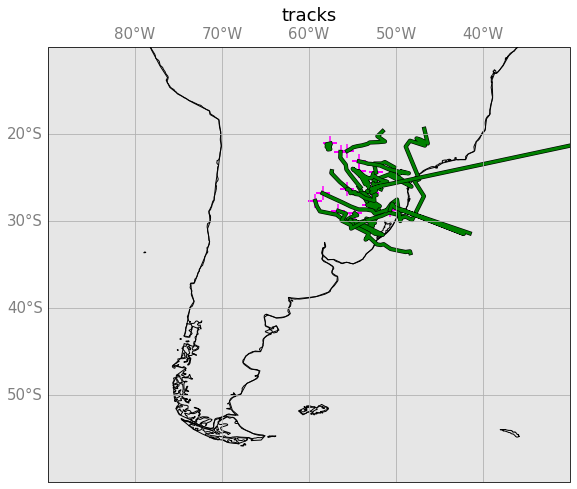

In [38]:
f, ax = plt.subplots(1, 1, figsize=(11,8), subplot_kw=dict(projection=crs.PlateCarree()))
ax.set_extent([-90, -30, -10, -60], crs=crs.PlateCarree()); ax.coastlines()
gl = ax.gridlines()#color="gray",alpha=0.5, linestyle='--',draw_labels=True,linewidth=2)
ax.coastlines(resolution='110m')
gl.xlines = True
gl.ylines = True

gl.xlabels_top = True
gl.ylabels_right = False
gl.ylabels_left = True
gl.ylabels_bottom = True

gl.xformatter = LONGITUDE_FORMATTER
gl.yformatter = LATITUDE_FORMATTER
gl.xlabel_style = {'size': 15, 'color': 'gray'}#, 'weight': 'bold'}
gl.ylabel_style = {'size': 15, 'color': 'gray'}#, 'weight': 'bold'}

plt.title('tracks')

for ii in range(len(ds.tracks)):
    ax.plot(ds.meanlon.isel(tracks=ii),ds.meanlat.isel(tracks=ii),c='k',linewidth=4.25)
    ax.plot(ds.meanlon.isel(tracks=ii),ds.meanlat.isel(tracks=ii),c='green',  linewidth=3.0)
    ii = ii  + 1
    
ax.scatter(ds.meanlon.isel(times=0),ds.meanlat.isel(times=0),s=200,c='magenta',marker='+')

    

year :  2018


plotting tracks for October and period  [Timestamp('2018-10-01 00:00:00'), Timestamp('2018-10-31 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/Feng2020JGR_data/data/spac/robust_mcs_tracks_extc_20180101_20181231.nc
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/Feng2020JGR_data/data/spac/robust_mcs_tracks_extc_20180101_20181231.nc
plotting tracks for November and period  [Timestamp('2018-11-01 00:00:00'), Timestamp('2018-11-30 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/Feng2020JGR_data/data/spac/robust_mcs_tracks_extc_20180101_20181231.nc
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/Feng2020JGR_data/data/spac/robust_mcs_tracks_extc_20180101_20181231.nc
plotting tracks for December and period  [Timestamp('2018-12-01 00:00:00'), Timestamp('2018-12-31 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/Feng2020JGR_data/data/spac/robust_mcs_tracks_extc_20180101_20181231.nc
input file is  /glade

/glade/scratch/isingh9/ipykernel_8666/2598062592.py:90: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


saving to ...  MCS_tracks_Z_Zhe_Feng_South_America_ONDJFM_2018.png


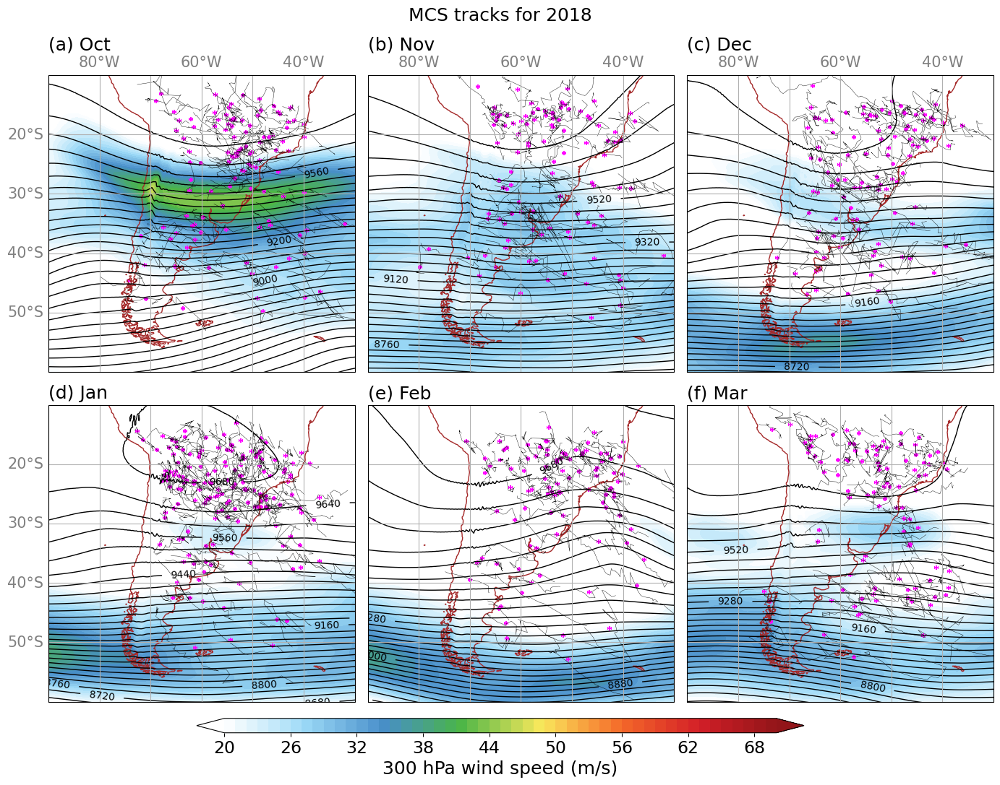

In [10]:
def plot_tracks_6months(year):
    
    mpl.rcParams['font.size'] = 12
    mpl.rcParams['font.family'] = 'Helvetica'

    season        = ['October','November','December','January','February','March']
    month_numbers = ['10','11','12','01','02','03']
    timeframes=[[pd.to_datetime(str(year)+'-10-01'),pd.to_datetime(str(year)+'-10-31')],\
                [pd.to_datetime(str(year)+'-11-01'),pd.to_datetime(str(year)+'-11-30')],\
                [pd.to_datetime(str(year)+'-12-01'),pd.to_datetime(str(year)+'-12-31')],\
                [pd.to_datetime(str(year)+'-01-01'),pd.to_datetime(str(year)+'-01-31')],\
                [pd.to_datetime(str(year)+'-02-01'),pd.to_datetime(str(year)+'-02-28')],\
                [pd.to_datetime(str(year)+'-03-01'),pd.to_datetime(str(year)+'-03-31')]]
    titles = ['(a) Oct','(b) Nov','(c) Dec','(d) Jan','(e) Feb','(f) Mar']

    fig = plt.figure(figsize=[14,10], dpi=100)

    resolution = '110m'
    #land = cfeature.NaturalEarthFeature('physical', 'land', resolution)
    #ocean = cfeature.NaturalEarthFeature('physical', 'ocean', resolution)
    #borders = cfeature.NaturalEarthFeature('cultural', 'admin_0_boundary_lines_land', resolution)
#     states = cfeature.NaturalEarthFeature('cultural', 'admin_1_states_provinces_lakes', resolution)

    for jj in range(0,6):
        print('plotting tracks for '+season[jj]+' and period ',timeframes[jj])
        ax = plt.subplot(2, 3, jj+1, projection=crs.PlateCarree())
        ax.set_extent([-90, -30, -10, -60], crs=crs.PlateCarree()); 
        gl = ax.gridlines()#color="gray",alpha=0.5, linestyle='--',draw_labels=True,linewidth=2)
        ax.coastlines(color='brown')
        gl.xlines = True
        gl.ylines = True

        if jj<=2:
            gl.top_labels = True
        if (jj==0) | (jj==3):
            gl.left_labels = True


        gl.xformatter = LONGITUDE_FORMATTER
        gl.yformatter = LATITUDE_FORMATTER
        gl.xlabel_style = {'size': 15, 'color': 'gray'}#, 'weight': 'bold'}
        gl.ylabel_style = {'size': 15, 'color': 'gray'}#, 'weight': 'bold'}

        mcs_track_data_file = '/glade/u/home/isingh9/work/Zhe_Feng_data/Feng2020JGR_data/data/spac/robust_mcs_tracks_extc_'+str(year)+'0101_'+str(year)+'1231.nc'

        ds = subset_file(mcs_track_data_file,None,[-80,-40],[-50,-15],timeframes[jj])
        ds_count = subset_file(mcs_track_data_file,None,[-70,-55],[-45,-25],timeframes[jj])
        #ax.set_title(titles[jj] + ', count:' + str(len(ds_count.tracks)), loc='left')
        ax.set_title(titles[jj], loc='left')
       
        # plot tracks
        for ii in range(len(ds.tracks)):
            #ax.plot(ds.meanlon.isel(tracks=ii),ds.meanlat.isel(tracks=ii),c='k',linewidth=1.0)
            ax.plot(ds.meanlon.isel(tracks=ii),ds.meanlat.isel(tracks=ii),c='k',  linewidth=0.3)
            ii = ii  + 1
            
            
        gh_300=xr.open_dataset('/glade/u/home/isingh9/work/ERA5_SON_DJF_monthly_means/300hpa_geop_mon_mean_1970_2018.nc')
        #pv_300=xr.open_dataset('/glade/u/home/isingh9/work/ERA5_SON_DJF_monthly_means/300hpa_pv_mon_mean_1970_2018.nc')
        u_300=xr.open_dataset('/glade/u/home/isingh9/work/ERA5_SON_DJF_monthly_means/300hpa_uwnd_mon_mean_1970_2018.nc')
        v_300=xr.open_dataset('/glade/u/home/isingh9/work/ERA5_SON_DJF_monthly_means/300hpa_vwnd_mon_mean_1970_2018.nc')

        gph = gh_300.z.sel(time=timeframes[jj][0])/9.81
        #pv  = pv_300.pv.sel(time=str(year)+'-'+month_numbers[jj]+'-01')*10**6
        u   = u_300 .u.sel(time=timeframes[jj][0])
        v   = v_300 .v.sel(time=timeframes[jj][0])
        wspd = np.sqrt(u**2 + v**2)
        
        
        cf1 = plt.contour(gh_300.longitude.values,gh_300.latitude.values,gph.values, levels=np.arange(8000,13000,40),transform=crs.PlateCarree(), colors='k',linewidths=1.0)
        #cf1 = plt.contour(pv_300.longitude.values,pv_300.latitude.values,pv.values, levels=np.arange(-8,0,0.5),transform=crs.PlateCarree(), colors='k',linewidths=1.0,linestyles='-')
        ax.clabel(cf1, inline=1, fontsize=10)
        cf2 = plt.contourf(u_300.longitude.values,u_300.latitude.values,wspd.values, levels=np.arange(20,71,1), cmap=cma4,transform=crs.PlateCarree(),extend='both')
        meanlats = ds.meanlat.mean(dim='times',skipna=True)
        meanlons = ds.meanlon.mean(dim='times',skipna=True)
        sc1 = plt.scatter(meanlons.values,meanlats.values,s=20,c='magenta',marker='+',transform=crs.PlateCarree())

        ax.set_aspect('auto', adjustable=None)
        
    cb_ax = fig.add_axes([0.2, -0.025, 0.6, 0.02])  # two panels
    cbar = fig.colorbar(cf2, cax=cb_ax, orientation = 'horizontal',label='300 hPa wind speed (m/s)',extend='both')
    #cbar.formatter.set_powerlimits((0,0))
    
        # Terrain height
        #ct = ax.contour(lon_hgt, lat_hgt, hgt_s, levels=levelshgt, \
        #                colors='dimgray', linewidths=(1.0,1.5), transform=ccrs.PlateCarree(), zorder=6)
#         ctlb = ax.clabel(ct, inline=True, fmt='%.0f', fontsize=10)

    plt.suptitle('MCS tracks for '+str(year),fontsize=18)
    plt.tight_layout()
    #plt.tight_layout(w_pad=2.5, h_pad=1.2)
    filename = 'MCS_tracks_Z_Zhe_Feng_South_America_ONDJFM_'+str(year)+'.png'
    print('saving to ... ',filename)
    fig.savefig(filename, dpi=200, bbox_inches='tight')
    #plt.close()

    
for kk in np.arange(2018,2019,1):
    print('year : ',kk)
    print('\n')
    plot_tracks_6months(kk)

year :  2018


plotting tracks for September and period  [Timestamp('2018-09-01 00:00:00'), Timestamp('2018-09-30 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/Feng2020JGR_data/data/spac/robust_mcs_tracks_extc_20180101_20181231.nc
plotting tracks for October and period  [Timestamp('2018-10-01 00:00:00'), Timestamp('2018-10-31 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/Feng2020JGR_data/data/spac/robust_mcs_tracks_extc_20180101_20181231.nc
plotting tracks for November and period  [Timestamp('2018-11-01 00:00:00'), Timestamp('2018-11-30 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/Feng2020JGR_data/data/spac/robust_mcs_tracks_extc_20180101_20181231.nc
plotting tracks for December and period  [Timestamp('2018-12-01 00:00:00'), Timestamp('2018-12-31 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/Feng2020JGR_data/data/spac/robust_mcs_tracks_extc_20180101_20181231.nc
plotting tracks for January and perio

/glade/scratch/isingh9/ipykernel_8666/1373980075.py:96: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


saving to ...  MCS_tracks_Z_Zhe_Feng_South_America_SONDJF_2018.png


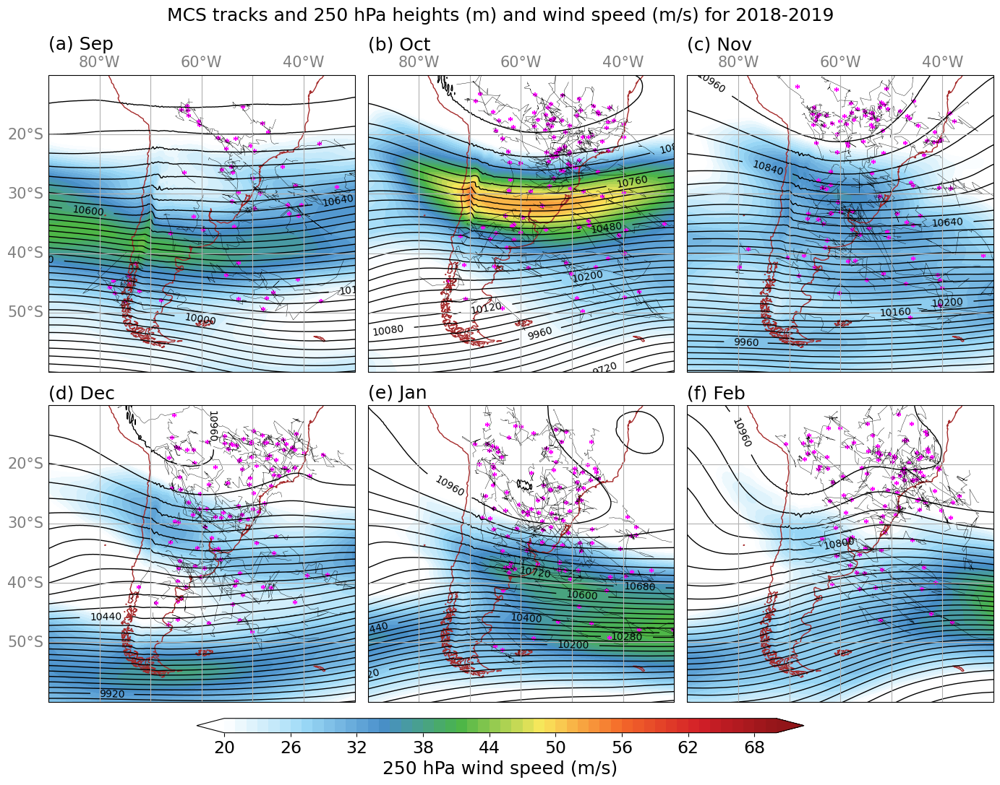

In [15]:
# Same as above but for SONDJF

def plot_tracks_6months(year):
    
    mpl.rcParams['font.size'] = 12
    mpl.rcParams['font.family'] = 'Helvetica'

    #season        = ['October','November','December','January','February','March']
    season        = ['September','October','November','December','January','February']
    month_numbers = ['09','10','11','12','01','02']
    timeframes=[[pd.to_datetime(str(year)+'-09-01'),pd.to_datetime(str(year)+'-09-30')],\
                [pd.to_datetime(str(year)+'-10-01'),pd.to_datetime(str(year)+'-10-31')],\
                [pd.to_datetime(str(year)+'-11-01'),pd.to_datetime(str(year)+'-11-30')],\
                [pd.to_datetime(str(year)+'-12-01'),pd.to_datetime(str(year)+'-12-31')],\
                [pd.to_datetime(str(year+1)+'-01-01'),pd.to_datetime(str(year+1)+'-01-31')],\
                [pd.to_datetime(str(year+1)+'-02-01'),pd.to_datetime(str(year+1)+'-02-28')]]
    titles = ['(a) Sep','(b) Oct','(c) Nov','(d) Dec','(e) Jan','(f) Feb']

    fig = plt.figure(figsize=[14,10], dpi=100)

    resolution = '110m'
    #land = cfeature.NaturalEarthFeature('physical', 'land', resolution)
    #ocean = cfeature.NaturalEarthFeature('physical', 'ocean', resolution)
    #borders = cfeature.NaturalEarthFeature('cultural', 'admin_0_boundary_lines_land', resolution)
#     states = cfeature.NaturalEarthFeature('cultural', 'admin_1_states_provinces_lakes', resolution)

    for jj in range(0,6):
        print('plotting tracks for '+season[jj]+' and period ',timeframes[jj])
        ax = plt.subplot(2, 3, jj+1, projection=crs.PlateCarree())
        ax.set_extent([-90, -30, -10, -60], crs=crs.PlateCarree()); 
        gl = ax.gridlines()#color="gray",alpha=0.5, linestyle='--',draw_labels=True,linewidth=2)
        ax.coastlines(color='brown')
        gl.xlines = True
        gl.ylines = True

        if jj<=2:
            gl.top_labels = True
        if (jj==0) | (jj==3):
            gl.left_labels = True


        gl.xformatter = LONGITUDE_FORMATTER
        gl.yformatter = LATITUDE_FORMATTER
        gl.xlabel_style = {'size': 15, 'color': 'gray'}#, 'weight': 'bold'}
        gl.ylabel_style = {'size': 15, 'color': 'gray'}#, 'weight': 'bold'}

        if jj<4:
            mcs_track_data_file = '/glade/u/home/isingh9/work/Zhe_Feng_data/Feng2020JGR_data/data/spac/robust_mcs_tracks_extc_'+str(year)+'0101_'+str(year)+'1231.nc'
        else:
            mcs_track_data_file = '/glade/u/home/isingh9/work/Zhe_Feng_data/Feng2020JGR_data/data/spac/robust_mcs_tracks_extc_'+str(year+1)+'0101_'+str(year+1)+'1231.nc'
  
        ds = subset_file(mcs_track_data_file,None,[-80,-40],[-50,-15],timeframes[jj])
        #ds_count = subset_file(mcs_track_data_file,None,[-70,-55],[-45,-25],timeframes[jj])
        #ax.set_title(titles[jj] + ', count:' + str(len(ds_count.tracks)), loc='left')
        ax.set_title(titles[jj], loc='left')
       
        # plot tracks
        for ii in range(len(ds.tracks)):
            #ax.plot(ds.meanlon.isel(tracks=ii),ds.meanlat.isel(tracks=ii),c='k',linewidth=1.0)
            ax.plot(ds.meanlon.isel(tracks=ii),ds.meanlat.isel(tracks=ii),c='k',  linewidth=0.3)
            ii = ii  + 1
            
            
        gh_300=xr.open_dataset('/glade/u/home/isingh9/work/ERA5_SON_DJF_monthly_means/250hpa_geop_mon_mean_1970_2018.nc')
        #pv_300=xr.open_dataset('/glade/u/home/isingh9/work/ERA5_SON_DJF_monthly_means/300hpa_pv_mon_mean_1970_2018.nc')
        u_300=xr.open_dataset('/glade/u/home/isingh9/work/ERA5_SON_DJF_monthly_means/250hpa_uwnd_mon_mean_1970_2018.nc')
        v_300=xr.open_dataset('/glade/u/home/isingh9/work/ERA5_SON_DJF_monthly_means/250hpa_vwnd_mon_mean_1970_2018.nc')

        gph = gh_300.z.sel(time=timeframes[jj][0])/9.81
        #pv  = pv_300.pv.sel(time=str(year)+'-'+month_numbers[jj]+'-01')*10**6
        u   = u_300 .u.sel(time=timeframes[jj][0])
        v   = v_300 .v.sel(time=timeframes[jj][0])
        wspd = np.sqrt(u**2 + v**2)
        
        
        cf1 = plt.contour(gh_300.longitude.values,gh_300.latitude.values,gph.values, levels=np.arange(8000,13000,40),transform=crs.PlateCarree(), colors='k',linewidths=1.0)
        #cf1 = plt.contour(pv_300.longitude.values,pv_300.latitude.values,pv.values, levels=np.arange(-8,0,0.5),transform=crs.PlateCarree(), colors='k',linewidths=1.0,linestyles='-')
        ax.clabel(cf1, inline=1, fontsize=10)
        cf2 = plt.contourf(u_300.longitude.values,u_300.latitude.values,wspd.values, levels=np.arange(20,71,1), cmap=cma4,transform=crs.PlateCarree(),extend='both')
        meanlats = ds.meanlat.mean(dim='times',skipna=True)
        meanlons = ds.meanlon.mean(dim='times',skipna=True)
        sc1 = plt.scatter(meanlons.values,meanlats.values,s=20,c='magenta',marker='+',transform=crs.PlateCarree())

        ax.set_aspect('auto', adjustable=None)
        
    cb_ax = fig.add_axes([0.2, -0.025, 0.6, 0.02])  # two panels
    cbar = fig.colorbar(cf2, cax=cb_ax, orientation = 'horizontal',label='250 hPa wind speed (m/s)',extend='both')
    #cbar.formatter.set_powerlimits((0,0))
    
        # Terrain height
        #ct = ax.contour(lon_hgt, lat_hgt, hgt_s, levels=levelshgt, \
        #                colors='dimgray', linewidths=(1.0,1.5), transform=ccrs.PlateCarree(), zorder=6)
#         ctlb = ax.clabel(ct, inline=True, fmt='%.0f', fontsize=10)

    plt.suptitle('MCS tracks and 250 hPa heights (m) and wind speed (m/s) for '+str(year)+'-'+str(year+1),fontsize=18)
    plt.tight_layout()
    #plt.tight_layout(w_pad=2.5, h_pad=1.2)
    filename = 'MCS_tracks_Z_Zhe_Feng_South_America_SONDJF_'+str(year)+'.png'
    print('saving to ... ',filename)
    fig.savefig(filename, dpi=200, bbox_inches='tight')
    #plt.close()

    
for kk in np.arange(2018,2019,1):
    print('year : ',kk)
    print('\n')
    plot_tracks_6months(kk)

['/glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20010101.0000_20020101.0000.nc', '/glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20020101.0000_20030101.0000.nc', '/glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20030101.0000_20040101.0000.nc', '/glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20040101.0000_20050101.0000.nc', '/glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20050101.0000_20060101.0000.nc', '/glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20060101.0000_20070101.0000.nc', '/glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20070101.0000_20080101.0000.nc', '/glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20080101.0000_20090101.0000.nc', '/glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20090101.0000_20100101.0000.nc', '/glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20


-------

month is  October
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20010101.0000_20020101.0000.nc
year is  2001
time frame is  [Timestamp('2001-10-01 00:00:00'), Timestamp('2001-10-31 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20010101.0000_20020101.0000.nc
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20020101.0000_20030101.0000.nc
year is  2002
time frame is  [Timestamp('2002-10-01 00:00:00'), Timestamp('2002-10-31 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20020101.0000_20030101.0000.nc
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20030101.0000_20040101.0000.nc
year is  2003
time frame is  [Timestamp('2003-10-01 00:00:00'), Timestamp('2003-10-31 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20030101.0000_20040101.0000.nc
file i

file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20080101.0000_20090101.0000.nc
year is  2008
time frame is  [Timestamp('2008-11-01 00:00:00'), Timestamp('2008-11-30 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20080101.0000_20090101.0000.nc
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20090101.0000_20100101.0000.nc
year is  2009
time frame is  [Timestamp('2009-11-01 00:00:00'), Timestamp('2009-11-30 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20090101.0000_20100101.0000.nc
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20100101.0000_20110101.0000.nc
year is  2010
time frame is  [Timestamp('2010-11-01 00:00:00'), Timestamp('2010-11-30 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20100101.0000_20110101.0000.nc
file is  /glade/u/home/isingh9/wor

file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20140101.0000_20150101.0000.nc
year is  2014
time frame is  [Timestamp('2014-12-01 00:00:00'), Timestamp('2014-12-31 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20140101.0000_20150101.0000.nc
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20150101.0000_20160101.0000.nc
year is  2015
time frame is  [Timestamp('2015-12-01 00:00:00'), Timestamp('2015-12-31 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20150101.0000_20160101.0000.nc
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20160101.0000_20170101.0000.nc
year is  2016
time frame is  [Timestamp('2016-12-01 00:00:00'), Timestamp('2016-12-31 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20160101.0000_20170101.0000.nc
file is  /glade/u/home/isingh9/wor

file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20020101.0000_20030101.0000.nc
year is  2002
time frame is  [Timestamp('2002-02-01 00:00:00'), Timestamp('2002-02-28 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20020101.0000_20030101.0000.nc
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20030101.0000_20040101.0000.nc
year is  2003
time frame is  [Timestamp('2003-02-01 00:00:00'), Timestamp('2003-02-28 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20030101.0000_20040101.0000.nc
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20040101.0000_20050101.0000.nc
year is  2004
time frame is  [Timestamp('2004-02-01 00:00:00'), Timestamp('2004-02-28 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20040101.0000_20050101.0000.nc
file is  /glade/u/home/isingh9/wor

file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20080101.0000_20090101.0000.nc
year is  2008
time frame is  [Timestamp('2008-03-01 00:00:00'), Timestamp('2008-03-31 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20080101.0000_20090101.0000.nc
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20090101.0000_20100101.0000.nc
year is  2009
time frame is  [Timestamp('2009-03-01 00:00:00'), Timestamp('2009-03-31 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20090101.0000_20100101.0000.nc
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20100101.0000_20110101.0000.nc
year is  2010
time frame is  [Timestamp('2010-03-01 00:00:00'), Timestamp('2010-03-31 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20100101.0000_20110101.0000.nc
file is  /glade/u/home/isingh9/wor

/glade/scratch/isingh9/ipykernel_37070/485647143.py:38: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_wcc['datetime']=pd.to_datetime(df_wcc['datetime'])


                        orbit      date    time  core_id  core_lon  core_lat  \
datetime                                                                       
1998-01-01 05:26:50  b'00542'  19980101   52650      2.0    -64.47    -30.33   
1998-01-01 05:26:50  b'00542'  19980101   52650      1.0    -62.72    -30.85   
1998-01-03 22:37:01  b'00584'  19980103  223701      1.0    -59.45    -27.10   
1998-01-04 23:01:42  b'00600'  19980104  230142      1.0    -56.28    -32.08   
1998-01-04 23:01:42  b'00600'  19980104  230142      2.0    -55.80    -31.58   
...                       ...       ...     ...      ...       ...       ...   
2013-12-19 10:39:36  b'91670'  20131219  103936      1.0    -66.07    -32.57   
2013-12-20 06:28:35  b'91682'  20131220   62835      1.0    -67.15    -30.15   
2013-12-27 03:17:54  b'91789'  20131227   31754      1.0    -58.55    -32.62   
2013-12-29 06:18:34  b'91823'  20131229   61834      1.0    -62.53    -30.70   
2013-12-31 04:28:49  b'91853'  20131231 

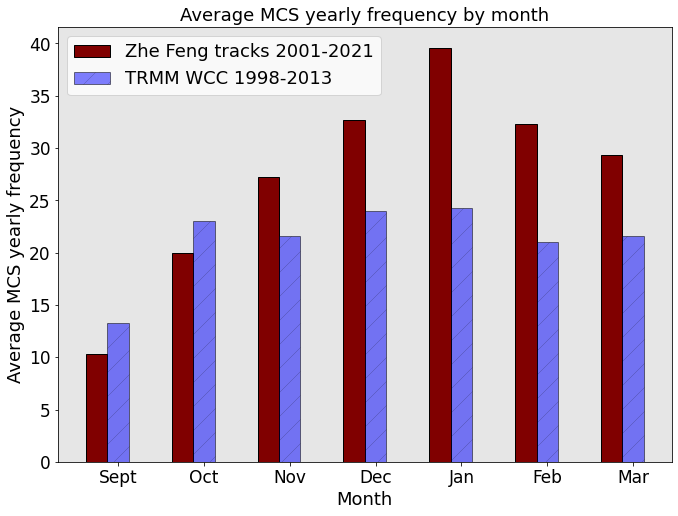

In [107]:
years=np.arange(2001,2021,1)

mcs_track_data_files=['/glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_'+str(year)+'0101.0000_'+str(year+1)+'0101.0000.nc' for year in years]
print(mcs_track_data_files)
def out_timeframes(year):
    timeframes=[[pd.to_datetime(str(year)+'-09-01'),pd.to_datetime(str(year)+'-09-30')],\
                [pd.to_datetime(str(year)+'-10-01'),pd.to_datetime(str(year)+'-10-31')],\
                [pd.to_datetime(str(year)+'-11-01'),pd.to_datetime(str(year)+'-11-30')],\
                [pd.to_datetime(str(year)+'-12-01'),pd.to_datetime(str(year)+'-12-31')],\
                [pd.to_datetime(str(year)+'-01-01'),pd.to_datetime(str(year)+'-01-31')],\
                [pd.to_datetime(str(year)+'-02-01'),pd.to_datetime(str(year)+'-02-28')],\
                [pd.to_datetime(str(year)+'-03-01'),pd.to_datetime(str(year)+'-03-31')]]
    
    return timeframes

months= ['September','October','November','December','January','February','March']
kk = 0 
data = np.zeros((7))

for jj in range(7):
    print('month is ',months[jj])
    kk=0
    for fil in mcs_track_data_files:
        print('file is ',fil)
        yr = years[kk]
        print('year is ',yr)
        print('time frame is ',out_timeframes(yr)[jj])
        data[jj]=data[jj]+len(subset_file(fil,None,[-70,-55],[-45,-25],out_timeframes(yr)[jj]).tracks)
        kk = kk + 1
    print('\n-------\n')
    
data=data/len(years)

# load TRMM WCC data
#load TRMM WCC data
dd=pd.read_csv('TRMM_WCC_data_1998-2013_SONDJFM.csv')
df_wcc=dd.loc[:, ~dd.columns.str.match('^Unnamed')]
df_wcc['datetime']=pd.to_datetime(df_wcc['datetime'])
# extract the data within a lat-lon box
df_wcc=df_wcc.loc[(df_wcc.core_lon>=-70.) & (df_wcc.core_lon<=-55.) &\
                 (df_wcc.core_lat >=-45.) & (df_wcc.core_lat<=-25)]
df_wcc=df_wcc.set_index('datetime')
print(df_wcc)
data_trmm=df_wcc.groupby([df_wcc.index.month])['orbit'].count()
print(data_trmm)
correct_month_order=[3,4,5,6,0,1,2]
data_trmm=data_trmm.values[correct_month_order]/(2013-1998+1)
print(data_trmm)


fig = plt.figure(figsize=(11,8))
xtick_labels = ['Sept','Oct','Nov','Dec','Jan', 'Feb','Mar']

# Set position of bar on X axis
barWidth = 0.25
br1 = np.arange(len(data))
br2 = [x + barWidth for x in br1]
 
plt.bar(br1, data, color ='maroon',width=0.25,label='Zhe Feng tracks 2001-2021',edgecolor='k')
plt.bar(br2, data_trmm, color ='blue',width=0.25, label='TRMM WCC 1998-2013',alpha=0.5,hatch='/',edgecolor='k',fill=True)

plt.xlabel('Month')
plt.ylabel('Average MCS yearly frequency')
plt.title ('Average MCS yearly frequency by month')
plt.xticks([r + barWidth for r in range(len(data))],xtick_labels)
plt.legend()
#xtick_labels = ['Oct','Nov','Dec','Jan', 'Feb','Mar']
#ax.set_xticklabels(xtick_labels,rotation = 0)
#final_df.groupby(final_df.index.month).count().plot(kind="bar")
fig.savefig('no_MCSs_by_month.png', dpi=200)

month is  September
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20010101.0000_20020101.0000.nc
year is  2001
time frame is  [Timestamp('2001-09-01 00:00:00'), Timestamp('2001-09-30 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20010101.0000_20020101.0000.nc
mean duration of MCS is  9.842105263157896
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20020101.0000_20030101.0000.nc
year is  2002
time frame is  [Timestamp('2002-09-01 00:00:00'), Timestamp('2002-09-30 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20020101.0000_20030101.0000.nc
mean duration of MCS is  10.0
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20030101.0000_20040101.0000.nc
year is  2003
time frame is  [Timestamp('2003-09-01 00:00:00'), Timestamp('2003-09-30 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/

mean duration of MCS is  15.222222222222221
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20040101.0000_20050101.0000.nc
year is  2004
time frame is  [Timestamp('2004-10-01 00:00:00'), Timestamp('2004-10-31 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20040101.0000_20050101.0000.nc
mean duration of MCS is  12.846153846153847
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20050101.0000_20060101.0000.nc
year is  2005
time frame is  [Timestamp('2005-10-01 00:00:00'), Timestamp('2005-10-31 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20050101.0000_20060101.0000.nc
mean duration of MCS is  15.666666666666666
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20060101.0000_20070101.0000.nc
year is  2006
time frame is  [Timestamp('2006-10-01 00:00:00'), Timestamp('2006-10-31 00:00:00')]
input file is  /g

mean duration of MCS is  17.652173913043477
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20070101.0000_20080101.0000.nc
year is  2007
time frame is  [Timestamp('2007-11-01 00:00:00'), Timestamp('2007-11-30 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20070101.0000_20080101.0000.nc
mean duration of MCS is  15.041666666666666
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20080101.0000_20090101.0000.nc
year is  2008
time frame is  [Timestamp('2008-11-01 00:00:00'), Timestamp('2008-11-30 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20080101.0000_20090101.0000.nc
mean duration of MCS is  16.4
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20090101.0000_20100101.0000.nc
year is  2009
time frame is  [Timestamp('2009-11-01 00:00:00'), Timestamp('2009-11-30 00:00:00')]
input file is  /glade/u/home/is

mean duration of MCS is  16.829787234042552
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20100101.0000_20110101.0000.nc
year is  2010
time frame is  [Timestamp('2010-12-01 00:00:00'), Timestamp('2010-12-31 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20100101.0000_20110101.0000.nc
mean duration of MCS is  17.083333333333332
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20110101.0000_20120101.0000.nc
year is  2011
time frame is  [Timestamp('2011-12-01 00:00:00'), Timestamp('2011-12-31 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20110101.0000_20120101.0000.nc
mean duration of MCS is  10.35
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20120101.0000_20130101.0000.nc
year is  2012
time frame is  [Timestamp('2012-12-01 00:00:00'), Timestamp('2012-12-31 00:00:00')]
input file is  /glade/u/home/i

mean duration of MCS is  15.225806451612904
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20140101.0000_20150101.0000.nc
year is  2014
time frame is  [Timestamp('2014-01-01 00:00:00'), Timestamp('2014-01-31 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20140101.0000_20150101.0000.nc
mean duration of MCS is  14.051282051282051
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20150101.0000_20160101.0000.nc
year is  2015
time frame is  [Timestamp('2015-01-01 00:00:00'), Timestamp('2015-01-31 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20150101.0000_20160101.0000.nc
mean duration of MCS is  15.31578947368421
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20160101.0000_20170101.0000.nc
year is  2016
time frame is  [Timestamp('2016-01-01 00:00:00'), Timestamp('2016-01-31 00:00:00')]
input file is  /gl

mean duration of MCS is  17.682926829268293
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20170101.0000_20180101.0000.nc
year is  2017
time frame is  [Timestamp('2017-02-01 00:00:00'), Timestamp('2017-02-28 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20170101.0000_20180101.0000.nc
mean duration of MCS is  17.136363636363637
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20180101.0000_20190101.0000.nc
year is  2018
time frame is  [Timestamp('2018-02-01 00:00:00'), Timestamp('2018-02-28 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20180101.0000_20190101.0000.nc
mean duration of MCS is  10.55
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20190101.0000_20200101.0000.nc
year is  2019
time frame is  [Timestamp('2019-02-01 00:00:00'), Timestamp('2019-02-28 00:00:00')]
input file is  /glade/u/home/i

mean duration of MCS is  19.48
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20200101.0000_20210101.0000.nc
year is  2020
time frame is  [Timestamp('2020-03-01 00:00:00'), Timestamp('2020-03-31 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20200101.0000_20210101.0000.nc
mean duration of MCS is  15.833333333333334

-------



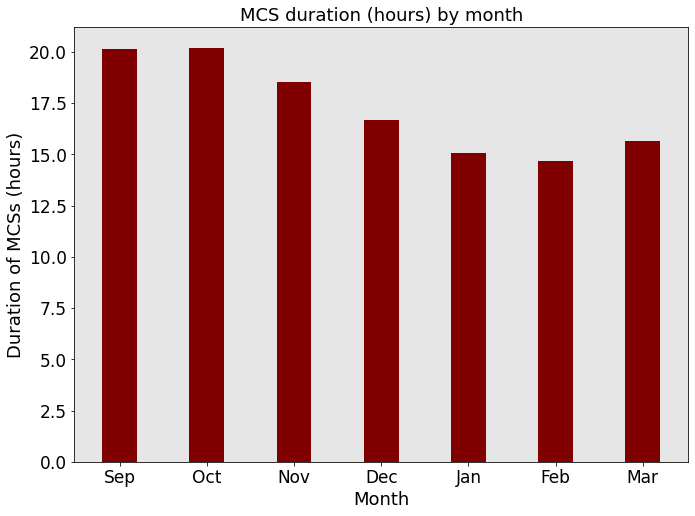

In [25]:
# MCS duration (hours)

#mcs_track_data_files=['/glade/u/home/isingh9/work/Zhe_Feng_data/Feng2020JGR_data/data/spac/robust_mcs_tracks_extc_'+str(year)+'0101_'+str(year)+'1231.nc' for year in np.arange(2014,2020,1)]
mcs_track_data_files=['/glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_'+str(year)+'0101.0000_'+str(year+1)+'0101.0000.nc' for year in years]

def out_timeframes(year):
    timeframes=[[pd.to_datetime(str(year)+'-09-01'),pd.to_datetime(str(year)+'-09-30')],\
                [pd.to_datetime(str(year)+'-10-01'),pd.to_datetime(str(year)+'-10-31')],\
                [pd.to_datetime(str(year)+'-11-01'),pd.to_datetime(str(year)+'-11-30')],\
                [pd.to_datetime(str(year)+'-12-01'),pd.to_datetime(str(year)+'-12-31')],\
                [pd.to_datetime(str(year)+'-01-01'),pd.to_datetime(str(year)+'-01-31')],\
                [pd.to_datetime(str(year)+'-02-01'),pd.to_datetime(str(year)+'-02-28')],\
                [pd.to_datetime(str(year)+'-03-01'),pd.to_datetime(str(year)+'-03-31')]]
    
    return timeframes

years=np.arange(2001,2021,1)
months= ['September','October','November','December','January','February','March']
kk = 0 
data = np.zeros((7))


for jj in range(7):
    print('month is ',months[jj])
    kk=0
    for fil in mcs_track_data_files:
        print('file is ',fil)
        yr = years[kk]
        print('year is ',yr)
        print('time frame is ',out_timeframes(yr)[jj])
        ds_subset = subset_file(fil,None,[-70,-55],[-45,-25],out_timeframes(yr)[jj])
        mean_length = np.nanmean(ds_subset.mcs_duration.values)
        print('mean duration of MCS is ',mean_length)
        data[jj]=data[jj]+mean_length
        kk = kk + 1
    print('\n-------\n')
    
data=data/len(years)

fig = plt.figure(figsize=(11,8))
xtick_labels = ['Sep','Oct','Nov','Dec','Jan', 'Feb','Mar']
plt.bar(xtick_labels, data, color ='maroon',width = 0.4)
plt.xlabel('Month')
plt.ylabel('Average duration of MCSs (hours)')
plt.title('Average MCS duration (hours) by month')
#xtick_labels = ['Oct','Nov','Dec','Jan', 'Feb','Mar']
#ax.set_xticklabels(xtick_labels,rotation = 0)
#final_df.groupby(final_df.index.month).count().plot(kind="bar")
fig.savefig('duration_MCSs_by_month.png', dpi=200)

month is  September
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20010101.0000_20020101.0000.nc
year is  2001
time frame is  [Timestamp('2001-09-01 00:00:00'), Timestamp('2001-09-30 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20010101.0000_20020101.0000.nc
mean heavy (>10 mm/h) rainrate of MCS is  12.888723  mm/h
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20020101.0000_20030101.0000.nc
year is  2002
time frame is  [Timestamp('2002-09-01 00:00:00'), Timestamp('2002-09-30 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20020101.0000_20030101.0000.nc
mean heavy (>10 mm/h) rainrate of MCS is  13.424814  mm/h
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20030101.0000_20040101.0000.nc
year is  2003
time frame is  [Timestamp('2003-09-01 00:00:00'), Timestamp('2003-09-30 00:00:00')]
input file is

mean heavy (>10 mm/h) rainrate of MCS is  12.857448  mm/h
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20040101.0000_20050101.0000.nc
year is  2004
time frame is  [Timestamp('2004-10-01 00:00:00'), Timestamp('2004-10-31 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20040101.0000_20050101.0000.nc
mean heavy (>10 mm/h) rainrate of MCS is  13.359019  mm/h
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20050101.0000_20060101.0000.nc
year is  2005
time frame is  [Timestamp('2005-10-01 00:00:00'), Timestamp('2005-10-31 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20050101.0000_20060101.0000.nc
mean heavy (>10 mm/h) rainrate of MCS is  13.642752  mm/h
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20060101.0000_20070101.0000.nc
year is  2006
time frame is  [Timestamp('2006-10-01 00:00:00'), Timestamp

mean heavy (>10 mm/h) rainrate of MCS is  14.437558  mm/h
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20070101.0000_20080101.0000.nc
year is  2007
time frame is  [Timestamp('2007-11-01 00:00:00'), Timestamp('2007-11-30 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20070101.0000_20080101.0000.nc
mean heavy (>10 mm/h) rainrate of MCS is  14.054451  mm/h
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20080101.0000_20090101.0000.nc
year is  2008
time frame is  [Timestamp('2008-11-01 00:00:00'), Timestamp('2008-11-30 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20080101.0000_20090101.0000.nc
mean heavy (>10 mm/h) rainrate of MCS is  14.040839  mm/h
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20090101.0000_20100101.0000.nc
year is  2009
time frame is  [Timestamp('2009-11-01 00:00:00'), Timestamp

mean heavy (>10 mm/h) rainrate of MCS is  14.398965  mm/h
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20100101.0000_20110101.0000.nc
year is  2010
time frame is  [Timestamp('2010-12-01 00:00:00'), Timestamp('2010-12-31 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20100101.0000_20110101.0000.nc
mean heavy (>10 mm/h) rainrate of MCS is  13.694135  mm/h
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20110101.0000_20120101.0000.nc
year is  2011
time frame is  [Timestamp('2011-12-01 00:00:00'), Timestamp('2011-12-31 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20110101.0000_20120101.0000.nc
mean heavy (>10 mm/h) rainrate of MCS is  14.766305  mm/h
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20120101.0000_20130101.0000.nc
year is  2012
time frame is  [Timestamp('2012-12-01 00:00:00'), Timestamp

mean heavy (>10 mm/h) rainrate of MCS is  13.9653635  mm/h
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20140101.0000_20150101.0000.nc
year is  2014
time frame is  [Timestamp('2014-01-01 00:00:00'), Timestamp('2014-01-31 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20140101.0000_20150101.0000.nc
mean heavy (>10 mm/h) rainrate of MCS is  14.9887  mm/h
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20150101.0000_20160101.0000.nc
year is  2015
time frame is  [Timestamp('2015-01-01 00:00:00'), Timestamp('2015-01-31 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20150101.0000_20160101.0000.nc
mean heavy (>10 mm/h) rainrate of MCS is  14.769124  mm/h
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20160101.0000_20170101.0000.nc
year is  2016
time frame is  [Timestamp('2016-01-01 00:00:00'), Timestamp(

mean heavy (>10 mm/h) rainrate of MCS is  15.075848  mm/h
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20160101.0000_20170101.0000.nc
year is  2016
time frame is  [Timestamp('2016-02-01 00:00:00'), Timestamp('2016-02-28 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20160101.0000_20170101.0000.nc
mean heavy (>10 mm/h) rainrate of MCS is  14.860969  mm/h
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20170101.0000_20180101.0000.nc
year is  2017
time frame is  [Timestamp('2017-02-01 00:00:00'), Timestamp('2017-02-28 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20170101.0000_20180101.0000.nc
mean heavy (>10 mm/h) rainrate of MCS is  14.770871  mm/h
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20180101.0000_20190101.0000.nc
year is  2018
time frame is  [Timestamp('2018-02-01 00:00:00'), Timestamp

mean heavy (>10 mm/h) rainrate of MCS is  15.334469  mm/h
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20180101.0000_20190101.0000.nc
year is  2018
time frame is  [Timestamp('2018-03-01 00:00:00'), Timestamp('2018-03-31 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20180101.0000_20190101.0000.nc
mean heavy (>10 mm/h) rainrate of MCS is  15.306132  mm/h
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20190101.0000_20200101.0000.nc
year is  2019
time frame is  [Timestamp('2019-03-01 00:00:00'), Timestamp('2019-03-31 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20190101.0000_20200101.0000.nc


findfont: Font family ['Helvetica'] not found. Falling back to DejaVu Sans.


mean heavy (>10 mm/h) rainrate of MCS is  15.308782  mm/h
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20200101.0000_20210101.0000.nc
year is  2020
time frame is  [Timestamp('2020-03-01 00:00:00'), Timestamp('2020-03-31 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20200101.0000_20210101.0000.nc
mean heavy (>10 mm/h) rainrate of MCS is  14.109197  mm/h

-------



findfont: Font family ['Helvetica'] not found. Falling back to DejaVu Sans.


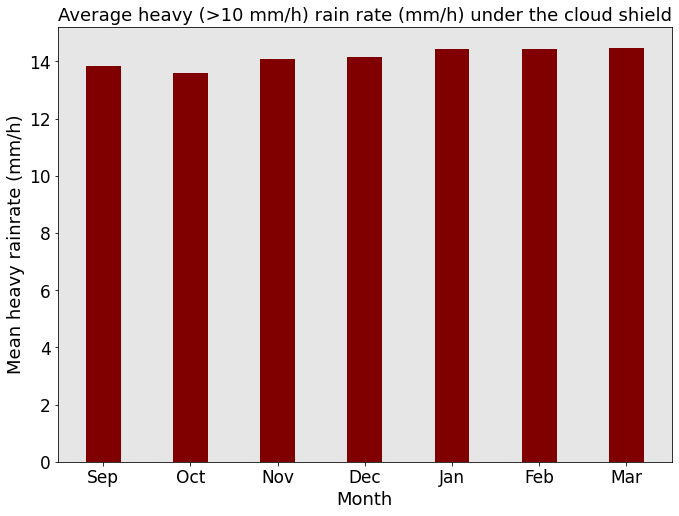

In [9]:
# rainfall (hours)
years=np.arange(2001,2021,1)
#mcs_track_data_files=['/glade/u/home/isingh9/work/Zhe_Feng_data/Feng2020JGR_data/data/spac/robust_mcs_tracks_extc_'+str(year)+'0101_'+str(year)+'1231.nc' for year in np.arange(2014,2020,1)]
mcs_track_data_files=['/glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_'+str(year)+'0101.0000_'+str(year+1)+'0101.0000.nc' for year in years]

def out_timeframes(year):
    timeframes=[[pd.to_datetime(str(year)+'-09-01'),pd.to_datetime(str(year)+'-09-30')],\
                [pd.to_datetime(str(year)+'-10-01'),pd.to_datetime(str(year)+'-10-31')],\
                [pd.to_datetime(str(year)+'-11-01'),pd.to_datetime(str(year)+'-11-30')],\
                [pd.to_datetime(str(year)+'-12-01'),pd.to_datetime(str(year)+'-12-31')],\
                [pd.to_datetime(str(year)+'-01-01'),pd.to_datetime(str(year)+'-01-31')],\
                [pd.to_datetime(str(year)+'-02-01'),pd.to_datetime(str(year)+'-02-28')],\
                [pd.to_datetime(str(year)+'-03-01'),pd.to_datetime(str(year)+'-03-31')]]
    
    return timeframes


months= ['September','October','November','December','January','February','March']
kk = 0 
data = np.zeros((7))


for jj in range(7):
    print('month is ',months[jj])
    kk=0
    for fil in mcs_track_data_files:
        print('file is ',fil)
        yr = years[kk]
        print('year is ',yr)
        print('time frame is ',out_timeframes(yr)[jj])
        ds_subset = subset_file(fil,None,[-70,-55],[-45,-25],out_timeframes(yr)[jj])
        mean_rr = np.nanmean(ds_subset.rainrate_heavyrain.values)
        print('mean heavy (>10 mm/h) rainrate of MCS is ',mean_rr,' mm/h')
        data[jj]=data[jj]+mean_rr
        kk = kk + 1
    print('\n-------\n')
    
data=data/len(years)

fig = plt.figure(figsize=(11,8))
xtick_labels = ['Sep','Oct','Nov','Dec','Jan', 'Feb','Mar']
plt.bar(xtick_labels, data, color ='maroon',width = 0.4)
plt.xlabel('Month')
plt.ylabel('Mean heavy rainrate (mm/h)')
plt.title('Average heavy (>10 mm/h) rain rate (mm/h) under the cloud shield')
fig.savefig('total_rain_by_month.png', dpi=200)

month is  September
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20010101.0000_20020101.0000.nc
year is  2001
time frame is  [Timestamp('2001-09-01 00:00:00'), Timestamp('2001-09-30 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20010101.0000_20020101.0000.nc
core_meantb of MCS is  220.79308  K
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20020101.0000_20030101.0000.nc
year is  2002
time frame is  [Timestamp('2002-09-01 00:00:00'), Timestamp('2002-09-30 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20020101.0000_20030101.0000.nc
core_meantb of MCS is  218.87984  K
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20030101.0000_20040101.0000.nc
year is  2003
time frame is  [Timestamp('2003-09-01 00:00:00'), Timestamp('2003-09-30 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/s

core_meantb of MCS is  218.43779  K
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20050101.0000_20060101.0000.nc
year is  2005
time frame is  [Timestamp('2005-10-01 00:00:00'), Timestamp('2005-10-31 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20050101.0000_20060101.0000.nc
core_meantb of MCS is  218.18178  K
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20060101.0000_20070101.0000.nc
year is  2006
time frame is  [Timestamp('2006-10-01 00:00:00'), Timestamp('2006-10-31 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20060101.0000_20070101.0000.nc
core_meantb of MCS is  218.33653  K
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20070101.0000_20080101.0000.nc
year is  2007
time frame is  [Timestamp('2007-10-01 00:00:00'), Timestamp('2007-10-31 00:00:00')]
input file is  /glade/u/home/isingh9/work

core_meantb of MCS is  220.01962  K
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20090101.0000_20100101.0000.nc
year is  2009
time frame is  [Timestamp('2009-11-01 00:00:00'), Timestamp('2009-11-30 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20090101.0000_20100101.0000.nc
core_meantb of MCS is  216.94644  K
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20100101.0000_20110101.0000.nc
year is  2010
time frame is  [Timestamp('2010-11-01 00:00:00'), Timestamp('2010-11-30 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20100101.0000_20110101.0000.nc
core_meantb of MCS is  220.17262  K
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20110101.0000_20120101.0000.nc
year is  2011
time frame is  [Timestamp('2011-11-01 00:00:00'), Timestamp('2011-11-30 00:00:00')]
input file is  /glade/u/home/isingh9/work

core_meantb of MCS is  218.83908  K
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20140101.0000_20150101.0000.nc
year is  2014
time frame is  [Timestamp('2014-12-01 00:00:00'), Timestamp('2014-12-31 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20140101.0000_20150101.0000.nc
core_meantb of MCS is  218.5771  K
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20150101.0000_20160101.0000.nc
year is  2015
time frame is  [Timestamp('2015-12-01 00:00:00'), Timestamp('2015-12-31 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20150101.0000_20160101.0000.nc
core_meantb of MCS is  217.16237  K
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20160101.0000_20170101.0000.nc
year is  2016
time frame is  [Timestamp('2016-12-01 00:00:00'), Timestamp('2016-12-31 00:00:00')]
input file is  /glade/u/home/isingh9/work/

core_meantb of MCS is  217.84189  K
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20180101.0000_20190101.0000.nc
year is  2018
time frame is  [Timestamp('2018-01-01 00:00:00'), Timestamp('2018-01-31 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20180101.0000_20190101.0000.nc
core_meantb of MCS is  218.59428  K
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20190101.0000_20200101.0000.nc
year is  2019
time frame is  [Timestamp('2019-01-01 00:00:00'), Timestamp('2019-01-31 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20190101.0000_20200101.0000.nc
core_meantb of MCS is  216.41476  K
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20200101.0000_20210101.0000.nc
year is  2020
time frame is  [Timestamp('2020-01-01 00:00:00'), Timestamp('2020-01-31 00:00:00')]
input file is  /glade/u/home/isingh9/work

core_meantb of MCS is  217.46684  K
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20020101.0000_20030101.0000.nc
year is  2002
time frame is  [Timestamp('2002-03-01 00:00:00'), Timestamp('2002-03-31 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20020101.0000_20030101.0000.nc
core_meantb of MCS is  217.74297  K
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20030101.0000_20040101.0000.nc
year is  2003
time frame is  [Timestamp('2003-03-01 00:00:00'), Timestamp('2003-03-31 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20030101.0000_20040101.0000.nc
core_meantb of MCS is  218.03578  K
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20040101.0000_20050101.0000.nc
year is  2004
time frame is  [Timestamp('2004-03-01 00:00:00'), Timestamp('2004-03-31 00:00:00')]
input file is  /glade/u/home/isingh9/work

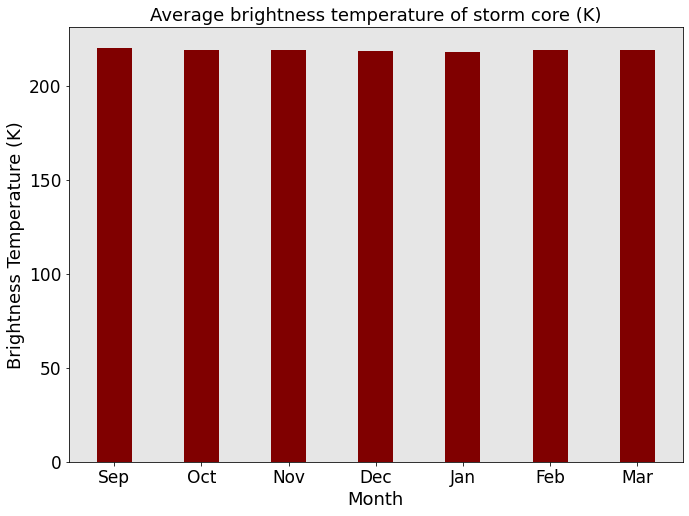

In [10]:
# rainfall (hours)

#mcs_track_data_files=['/glade/u/home/isingh9/work/Zhe_Feng_data/Feng2020JGR_data/data/spac/robust_mcs_tracks_extc_'+str(year)+'0101_'+str(year)+'1231.nc' for year in np.arange(2014,2020,1)]
mcs_track_data_files=['/glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_'+str(year)+'0101.0000_'+str(year+1)+'0101.0000.nc' for year in years]

def out_timeframes(year):
    timeframes=[[pd.to_datetime(str(year)+'-09-01'),pd.to_datetime(str(year)+'-09-30')],\
                [pd.to_datetime(str(year)+'-10-01'),pd.to_datetime(str(year)+'-10-31')],\
                [pd.to_datetime(str(year)+'-11-01'),pd.to_datetime(str(year)+'-11-30')],\
                [pd.to_datetime(str(year)+'-12-01'),pd.to_datetime(str(year)+'-12-31')],\
                [pd.to_datetime(str(year)+'-01-01'),pd.to_datetime(str(year)+'-01-31')],\
                [pd.to_datetime(str(year)+'-02-01'),pd.to_datetime(str(year)+'-02-28')],\
                [pd.to_datetime(str(year)+'-03-01'),pd.to_datetime(str(year)+'-03-31')]]
    
    return timeframes

years=np.arange(2001,2021,1)
months= ['September','October','November','December','January','February','March']
kk = 0 
data = np.zeros((7))


for jj in range(7):
    print('month is ',months[jj])
    kk=0
    for fil in mcs_track_data_files:
        print('file is ',fil)
        yr = years[kk]
        print('year is ',yr)
        print('time frame is ',out_timeframes(yr)[jj])
        ds_subset = subset_file(fil,None,[-70,-55],[-45,-25],out_timeframes(yr)[jj])
        core_meantb = np.nanmean(ds_subset.core_meantb.values)
        print('core_meantb of MCS is ',core_meantb,' K')
        data[jj]=data[jj]+core_meantb
        kk = kk + 1
    print('\n-------\n')
    
data=data/len(years)

fig = plt.figure(figsize=(11,8))
xtick_labels = ['Sep','Oct','Nov','Dec','Jan', 'Feb','Mar']
plt.bar(xtick_labels, data, color ='maroon',width = 0.4)
plt.xlabel('Month')
plt.ylabel('Brightness Temperature (K)')
plt.title('Average brightness temperature of storm core (K)')
fig.savefig('core_meantb_by_month.png', dpi=200)

month is  September
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20010101.0000_20020101.0000.nc
year is  2001
time frame is  [Timestamp('2001-09-01 00:00:00'), Timestamp('2001-09-30 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20010101.0000_20020101.0000.nc
corecold_meantb of MCS is  214.70372  K
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20020101.0000_20030101.0000.nc
year is  2002
time frame is  [Timestamp('2002-09-01 00:00:00'), Timestamp('2002-09-30 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20020101.0000_20030101.0000.nc
corecold_meantb of MCS is  209.94421  K
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20030101.0000_20040101.0000.nc
year is  2003
time frame is  [Timestamp('2003-09-01 00:00:00'), Timestamp('2003-09-30 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Fen

corecold_meantb of MCS is  210.91093  K
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20050101.0000_20060101.0000.nc
year is  2005
time frame is  [Timestamp('2005-10-01 00:00:00'), Timestamp('2005-10-31 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20050101.0000_20060101.0000.nc
corecold_meantb of MCS is  209.25044  K
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20060101.0000_20070101.0000.nc
year is  2006
time frame is  [Timestamp('2006-10-01 00:00:00'), Timestamp('2006-10-31 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20060101.0000_20070101.0000.nc
corecold_meantb of MCS is  209.08424  K
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20070101.0000_20080101.0000.nc
year is  2007
time frame is  [Timestamp('2007-10-01 00:00:00'), Timestamp('2007-10-31 00:00:00')]
input file is  /glade/u/home/

corecold_meantb of MCS is  214.5024  K
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20090101.0000_20100101.0000.nc
year is  2009
time frame is  [Timestamp('2009-11-01 00:00:00'), Timestamp('2009-11-30 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20090101.0000_20100101.0000.nc
corecold_meantb of MCS is  207.74681  K
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20100101.0000_20110101.0000.nc
year is  2010
time frame is  [Timestamp('2010-11-01 00:00:00'), Timestamp('2010-11-30 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20100101.0000_20110101.0000.nc
corecold_meantb of MCS is  214.51091  K
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20110101.0000_20120101.0000.nc
year is  2011
time frame is  [Timestamp('2011-11-01 00:00:00'), Timestamp('2011-11-30 00:00:00')]
input file is  /glade/u/home/i

corecold_meantb of MCS is  211.62378  K
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20140101.0000_20150101.0000.nc
year is  2014
time frame is  [Timestamp('2014-12-01 00:00:00'), Timestamp('2014-12-31 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20140101.0000_20150101.0000.nc
corecold_meantb of MCS is  211.14444  K
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20150101.0000_20160101.0000.nc
year is  2015
time frame is  [Timestamp('2015-12-01 00:00:00'), Timestamp('2015-12-31 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20150101.0000_20160101.0000.nc
corecold_meantb of MCS is  207.07016  K
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20160101.0000_20170101.0000.nc
year is  2016
time frame is  [Timestamp('2016-12-01 00:00:00'), Timestamp('2016-12-31 00:00:00')]
input file is  /glade/u/home/

corecold_meantb of MCS is  208.70879  K
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20180101.0000_20190101.0000.nc
year is  2018
time frame is  [Timestamp('2018-01-01 00:00:00'), Timestamp('2018-01-31 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20180101.0000_20190101.0000.nc
corecold_meantb of MCS is  210.5344  K
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20190101.0000_20200101.0000.nc
year is  2019
time frame is  [Timestamp('2019-01-01 00:00:00'), Timestamp('2019-01-31 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20190101.0000_20200101.0000.nc
corecold_meantb of MCS is  206.46883  K
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20200101.0000_20210101.0000.nc
year is  2020
time frame is  [Timestamp('2020-01-01 00:00:00'), Timestamp('2020-01-31 00:00:00')]
input file is  /glade/u/home/i

corecold_meantb of MCS is  208.83687  K
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20020101.0000_20030101.0000.nc
year is  2002
time frame is  [Timestamp('2002-03-01 00:00:00'), Timestamp('2002-03-31 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20020101.0000_20030101.0000.nc
corecold_meantb of MCS is  209.64351  K
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20030101.0000_20040101.0000.nc
year is  2003
time frame is  [Timestamp('2003-03-01 00:00:00'), Timestamp('2003-03-31 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20030101.0000_20040101.0000.nc
corecold_meantb of MCS is  209.22925  K
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20040101.0000_20050101.0000.nc
year is  2004
time frame is  [Timestamp('2004-03-01 00:00:00'), Timestamp('2004-03-31 00:00:00')]
input file is  /glade/u/home/

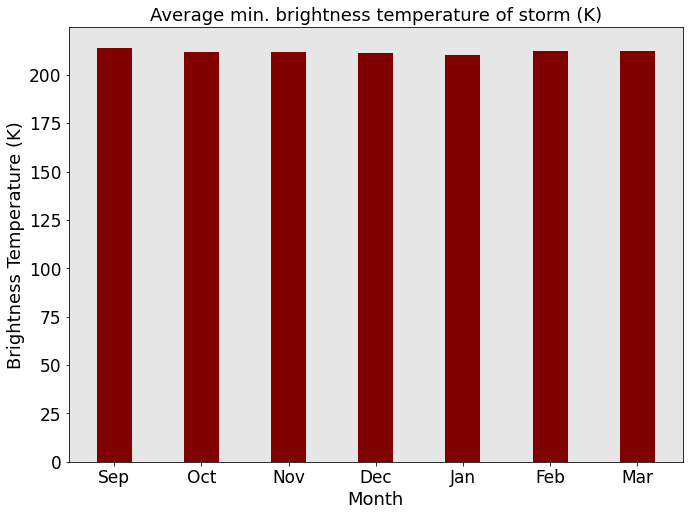

In [18]:
# rainfall (hours)

#mcs_track_data_files=['/glade/u/home/isingh9/work/Zhe_Feng_data/Feng2020JGR_data/data/spac/robust_mcs_tracks_extc_'+str(year)+'0101_'+str(year)+'1231.nc' for year in np.arange(2014,2020,1)]
mcs_track_data_files=['/glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_'+str(year)+'0101.0000_'+str(year+1)+'0101.0000.nc' for year in years]

def out_timeframes(year):
    timeframes=[[pd.to_datetime(str(year)+'-09-01'),pd.to_datetime(str(year)+'-09-30')],\
                [pd.to_datetime(str(year)+'-10-01'),pd.to_datetime(str(year)+'-10-31')],\
                [pd.to_datetime(str(year)+'-11-01'),pd.to_datetime(str(year)+'-11-30')],\
                [pd.to_datetime(str(year)+'-12-01'),pd.to_datetime(str(year)+'-12-31')],\
                [pd.to_datetime(str(year)+'-01-01'),pd.to_datetime(str(year)+'-01-31')],\
                [pd.to_datetime(str(year)+'-02-01'),pd.to_datetime(str(year)+'-02-28')],\
                [pd.to_datetime(str(year)+'-03-01'),pd.to_datetime(str(year)+'-03-31')]]
    
    return timeframes

years=np.arange(2001,2021,1)
months= ['September','October','November','December','January','February','March']
kk = 0 
data = np.zeros((7))


for jj in range(7):
    print('month is ',months[jj])
    kk=0
    for fil in mcs_track_data_files:
        print('file is ',fil)
        yr = years[kk]
        print('year is ',yr)
        print('time frame is ',out_timeframes(yr)[jj])
        ds_subset = subset_file(fil,None,[-70,-55],[-45,-25],out_timeframes(yr)[jj])
        corecold_mintb = np.nanmean(ds_subset.corecold_mintb.values)
        print('corecold_meantb of MCS is ',corecold_mintb,' K')
        data[jj]=data[jj]+corecold_mintb
        kk = kk + 1
    print('\n-------\n')
    
data=data/len(years)

fig = plt.figure(figsize=(11,8))
xtick_labels = ['Sep','Oct','Nov','Dec','Jan', 'Feb','Mar']
plt.bar(xtick_labels, data, color ='maroon',width = 0.4)
plt.xlabel('Month')
plt.ylabel('Brightness Temperature (K)')
plt.title('Average min. brightness temperature of storm (K)')
fig.savefig('corecold_mintb_by_month.png', dpi=200)

month is  September
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20010101.0000_20020101.0000.nc
year is  2001
time frame is  [Timestamp('2001-09-01 00:00:00'), Timestamp('2001-09-30 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20010101.0000_20020101.0000.nc
core_area of MCS is  123597.46  km2
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20020101.0000_20030101.0000.nc
year is  2002
time frame is  [Timestamp('2002-09-01 00:00:00'), Timestamp('2002-09-30 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20020101.0000_20030101.0000.nc
core_area of MCS is  227802.73  km2
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20030101.0000_20040101.0000.nc
year is  2003
time frame is  [Timestamp('2003-09-01 00:00:00'), Timestamp('2003-09-30 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/s

core_area of MCS is  185515.89  km2
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20050101.0000_20060101.0000.nc
year is  2005
time frame is  [Timestamp('2005-10-01 00:00:00'), Timestamp('2005-10-31 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20050101.0000_20060101.0000.nc
core_area of MCS is  106212.2  km2
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20060101.0000_20070101.0000.nc
year is  2006
time frame is  [Timestamp('2006-10-01 00:00:00'), Timestamp('2006-10-31 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20060101.0000_20070101.0000.nc
core_area of MCS is  428917.47  km2
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20070101.0000_20080101.0000.nc
year is  2007
time frame is  [Timestamp('2007-10-01 00:00:00'), Timestamp('2007-10-31 00:00:00')]
input file is  /glade/u/home/isingh9/work/

core_area of MCS is  71290.37  km2
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20090101.0000_20100101.0000.nc
year is  2009
time frame is  [Timestamp('2009-11-01 00:00:00'), Timestamp('2009-11-30 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20090101.0000_20100101.0000.nc
core_area of MCS is  153835.22  km2
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20100101.0000_20110101.0000.nc
year is  2010
time frame is  [Timestamp('2010-11-01 00:00:00'), Timestamp('2010-11-30 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20100101.0000_20110101.0000.nc
core_area of MCS is  53819.945  km2
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20110101.0000_20120101.0000.nc
year is  2011
time frame is  [Timestamp('2011-11-01 00:00:00'), Timestamp('2011-11-30 00:00:00')]
input file is  /glade/u/home/isingh9/work/

core_area of MCS is  76109.195  km2
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20140101.0000_20150101.0000.nc
year is  2014
time frame is  [Timestamp('2014-12-01 00:00:00'), Timestamp('2014-12-31 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20140101.0000_20150101.0000.nc
core_area of MCS is  88740.625  km2
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20150101.0000_20160101.0000.nc
year is  2015
time frame is  [Timestamp('2015-12-01 00:00:00'), Timestamp('2015-12-31 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20150101.0000_20160101.0000.nc
core_area of MCS is  140377.31  km2
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20160101.0000_20170101.0000.nc
year is  2016
time frame is  [Timestamp('2016-12-01 00:00:00'), Timestamp('2016-12-31 00:00:00')]
input file is  /glade/u/home/isingh9/work

core_area of MCS is  76442.74  km2
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20170101.0000_20180101.0000.nc
year is  2017
time frame is  [Timestamp('2017-01-01 00:00:00'), Timestamp('2017-01-31 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20170101.0000_20180101.0000.nc
core_area of MCS is  93175.03  km2
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20180101.0000_20190101.0000.nc
year is  2018
time frame is  [Timestamp('2018-01-01 00:00:00'), Timestamp('2018-01-31 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20180101.0000_20190101.0000.nc
core_area of MCS is  58355.684  km2
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20190101.0000_20200101.0000.nc
year is  2019
time frame is  [Timestamp('2019-01-01 00:00:00'), Timestamp('2019-01-31 00:00:00')]
input file is  /glade/u/home/isingh9/work/Z

core_area of MCS is  59990.066  km2

-------

month is  March
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20010101.0000_20020101.0000.nc
year is  2001
time frame is  [Timestamp('2001-03-01 00:00:00'), Timestamp('2001-03-31 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20010101.0000_20020101.0000.nc
core_area of MCS is  91735.75  km2
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20020101.0000_20030101.0000.nc
year is  2002
time frame is  [Timestamp('2002-03-01 00:00:00'), Timestamp('2002-03-31 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20020101.0000_20030101.0000.nc
core_area of MCS is  89805.336  km2
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20030101.0000_20040101.0000.nc
year is  2003
time frame is  [Timestamp('2003-03-01 00:00:00'), Timestamp('2003-03-31 00:00:00')]
input file is  /

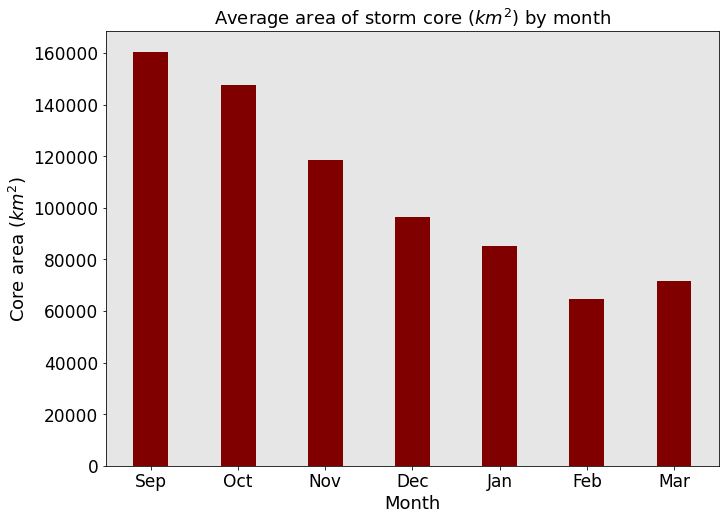

In [69]:
# rainfall (hours)

#mcs_track_data_files=['/glade/u/home/isingh9/work/Zhe_Feng_data/Feng2020JGR_data/data/spac/robust_mcs_tracks_extc_'+str(year)+'0101_'+str(year)+'1231.nc' for year in np.arange(2014,2020,1)]
mcs_track_data_files=['/glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_'+str(year)+'0101.0000_'+str(year+1)+'0101.0000.nc' for year in years]

def out_timeframes(year):
    timeframes=[[pd.to_datetime(str(year)+'-09-01'),pd.to_datetime(str(year)+'-09-30')],\
                [pd.to_datetime(str(year)+'-10-01'),pd.to_datetime(str(year)+'-10-31')],\
                [pd.to_datetime(str(year)+'-11-01'),pd.to_datetime(str(year)+'-11-30')],\
                [pd.to_datetime(str(year)+'-12-01'),pd.to_datetime(str(year)+'-12-31')],\
                [pd.to_datetime(str(year)+'-01-01'),pd.to_datetime(str(year)+'-01-31')],\
                [pd.to_datetime(str(year)+'-02-01'),pd.to_datetime(str(year)+'-02-28')],\
                [pd.to_datetime(str(year)+'-03-01'),pd.to_datetime(str(year)+'-03-31')]]
    
    return timeframes

years=np.arange(2001,2021,1)
months= ['September','October','November','December','January','February','March']
kk = 0 
data = np.zeros((7))


for jj in range(7):
    print('month is ',months[jj])
    kk=0
    for fil in mcs_track_data_files:
        print('file is ',fil)
        yr = years[kk]
        print('year is ',yr)
        print('time frame is ',out_timeframes(yr)[jj])
        ds_subset = subset_file(fil,None,[-70,-55],[-45,-25],out_timeframes(yr)[jj])
        core_area = np.nanmean(ds_subset.core_area.values)
        print('core_area of MCS is ',core_area,' km2')
        data[jj]=data[jj]+core_area
        kk = kk + 1
    print('\n-------\n')
    
data=data/len(years)

fig = plt.figure(figsize=(11,8))
xtick_labels = ['Sep','Oct','Nov','Dec','Jan', 'Feb','Mar']
plt.bar(xtick_labels, data, color ='maroon',width = 0.4)
plt.xlabel('Month')
plt.ylabel('Core area ($km^{2}$)')
plt.title('Average area of storm core ($km^{2}$) by month')
fig.savefig('core_area_by_month.png', dpi=200)

In [65]:
# load TRMM WCC data
#load TRMM WCC data
dd=pd.read_csv('TRMM_WCC_data_1998-2013_SONDJFM.csv')
df_wcc=dd.loc[:, ~dd.columns.str.match('^Unnamed')]
df_wcc['datetime']=pd.to_datetime(df_wcc['datetime'])
# extract the data within a lat-lon box
df_wcc=df_wcc.loc[(df_wcc.core_lon>=-70.) & (df_wcc.core_lon<=-55.) &\
                 (df_wcc.core_lat >=-45.) & (df_wcc.core_lat<=-25)]
df_wcc=df_wcc.set_index('datetime')
print(df_wcc)
data_trmm=df_wcc.groupby([df_wcc.index.month])['core_area'].mean()
print(data_trmm)
correct_month_order=[3,4,5,6,0,1,2]
data_trmm=data_trmm.values[correct_month_order]
print(data_trmm)

                        orbit      date    time  core_id  core_lon  core_lat  \
datetime                                                                       
1998-01-01 05:26:50  b'00542'  19980101   52650      2.0    -64.47    -30.33   
1998-01-01 05:26:50  b'00542'  19980101   52650      1.0    -62.72    -30.85   
1998-01-03 22:37:01  b'00584'  19980103  223701      1.0    -59.45    -27.10   
1998-01-04 23:01:42  b'00600'  19980104  230142      1.0    -56.28    -32.08   
1998-01-04 23:01:42  b'00600'  19980104  230142      2.0    -55.80    -31.58   
...                       ...       ...     ...      ...       ...       ...   
2013-12-19 10:39:36  b'91670'  20131219  103936      1.0    -66.07    -32.57   
2013-12-20 06:28:35  b'91682'  20131220   62835      1.0    -67.15    -30.15   
2013-12-27 03:17:54  b'91789'  20131227   31754      1.0    -58.55    -32.62   
2013-12-29 06:18:34  b'91823'  20131229   61834      1.0    -62.53    -30.70   
2013-12-31 04:28:49  b'91853'  20131231 

/glade/scratch/isingh9/ipykernel_12440/3016180206.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_wcc['datetime']=pd.to_datetime(df_wcc['datetime'])


In [67]:
mcs_track_data_file='/glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20140101.0000_20150101.0000.nc'
dd=xr.open_dataset(mcs_track_data_file)
dd

<xarray.Dataset>
Dimensions:                  (tracks: 1061, times: 400, mergers: 50, nmaxpf: 3)
Coordinates:
  * tracks                   (tracks) int64 4 27 38 82 ... 33637 33650 33671
  * times                    (times) int64 0 1 2 3 4 5 ... 395 396 397 398 399
  * mergers                  (mergers) int64 0 1 2 3 4 5 6 ... 44 45 46 47 48 49
  * nmaxpf                   (nmaxpf) int64 0 1 2
Data variables: (12/55)
    track_duration           (tracks) int32 ...
    start_status             (tracks) float64 ...
    end_status               (tracks) float64 ...
    start_basetime           (tracks) datetime64[ns] ...
    end_basetime             (tracks) datetime64[ns] ...
    start_split_cloudnumber  (tracks) float64 ...
    ...                       ...
    pf_mcsstatus             (tracks, times) float64 ...
    movement_distance        (tracks, times) float32 ...
    movement_speed           (tracks, times) float32 ...
    movement_theta           (tracks, times) float32 ...
    movement_distance_x      (tracks, times) float32 ...
    movement_distance_y      (tracks, times) float32 ...
Attributes: (12/27)
    Title:                       Statistics of each MCS track
    Institution:                 Pacific Northwest National Laboratory
    Contact:                     Zhe Feng, zhe.feng@pnnl.gov
    Created_on:                  Wed Mar  9 15:26:04 2022
    startdate:                   20140101.0000
    enddate:                     20150101.0000
    ...                          ...
    coefs_pf_heavyratio:         [3.419024 0.438709]
    max_speed_thresh:            50
    lon_box:                     [-80. -40.]
    lat_box:                     [-45. -15.]
    subset_start_time:           2014-01-01T00:00:00
    subset_end_time:             2014-12-31T23:59:00

month is  September
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20010101.0000_20020101.0000.nc
year is  2001
time frame is  [Timestamp('2001-09-01 00:00:00'), Timestamp('2001-09-30 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20010101.0000_20020101.0000.nc
mintb of MCS is  214.70372  K
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20020101.0000_20030101.0000.nc
year is  2002
time frame is  [Timestamp('2002-09-01 00:00:00'), Timestamp('2002-09-30 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20020101.0000_20030101.0000.nc
mintb of MCS is  209.94421  K
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20030101.0000_20040101.0000.nc
year is  2003
time frame is  [Timestamp('2003-09-01 00:00:00'), Timestamp('2003-09-30 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tra

mintb of MCS is  209.25044  K
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20060101.0000_20070101.0000.nc
year is  2006
time frame is  [Timestamp('2006-10-01 00:00:00'), Timestamp('2006-10-31 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20060101.0000_20070101.0000.nc
mintb of MCS is  209.08424  K
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20070101.0000_20080101.0000.nc
year is  2007
time frame is  [Timestamp('2007-10-01 00:00:00'), Timestamp('2007-10-31 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20070101.0000_20080101.0000.nc
mintb of MCS is  209.3671  K
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20080101.0000_20090101.0000.nc
year is  2008
time frame is  [Timestamp('2008-10-01 00:00:00'), Timestamp('2008-10-31 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stat

mintb of MCS is  207.74681  K
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20100101.0000_20110101.0000.nc
year is  2010
time frame is  [Timestamp('2010-11-01 00:00:00'), Timestamp('2010-11-30 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20100101.0000_20110101.0000.nc
mintb of MCS is  214.51091  K
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20110101.0000_20120101.0000.nc
year is  2011
time frame is  [Timestamp('2011-11-01 00:00:00'), Timestamp('2011-11-30 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20110101.0000_20120101.0000.nc
mintb of MCS is  213.58768  K
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20120101.0000_20130101.0000.nc
year is  2012
time frame is  [Timestamp('2012-11-01 00:00:00'), Timestamp('2012-11-30 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/sta

mintb of MCS is  211.14444  K
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20150101.0000_20160101.0000.nc
year is  2015
time frame is  [Timestamp('2015-12-01 00:00:00'), Timestamp('2015-12-31 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20150101.0000_20160101.0000.nc
mintb of MCS is  207.07016  K
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20160101.0000_20170101.0000.nc
year is  2016
time frame is  [Timestamp('2016-12-01 00:00:00'), Timestamp('2016-12-31 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20160101.0000_20170101.0000.nc
mintb of MCS is  213.56586  K
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20170101.0000_20180101.0000.nc
year is  2017
time frame is  [Timestamp('2017-12-01 00:00:00'), Timestamp('2017-12-31 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/sta

mintb of MCS is  210.5344  K
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20190101.0000_20200101.0000.nc
year is  2019
time frame is  [Timestamp('2019-01-01 00:00:00'), Timestamp('2019-01-31 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20190101.0000_20200101.0000.nc
mintb of MCS is  206.46883  K
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20200101.0000_20210101.0000.nc
year is  2020
time frame is  [Timestamp('2020-01-01 00:00:00'), Timestamp('2020-01-31 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20200101.0000_20210101.0000.nc
mintb of MCS is  206.74982  K

-------

month is  February
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20010101.0000_20020101.0000.nc
year is  2001
time frame is  [Timestamp('2001-02-01 00:00:00'), Timestamp('2001-02-28 00:00:00')]
input file is  /glade/u/home/is

mintb of MCS is  209.22925  K
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20040101.0000_20050101.0000.nc
year is  2004
time frame is  [Timestamp('2004-03-01 00:00:00'), Timestamp('2004-03-31 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20040101.0000_20050101.0000.nc
mintb of MCS is  213.27574  K
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20050101.0000_20060101.0000.nc
year is  2005
time frame is  [Timestamp('2005-03-01 00:00:00'), Timestamp('2005-03-31 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20050101.0000_20060101.0000.nc
mintb of MCS is  211.40517  K
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20060101.0000_20070101.0000.nc
year is  2006
time frame is  [Timestamp('2006-03-01 00:00:00'), Timestamp('2006-03-31 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/sta

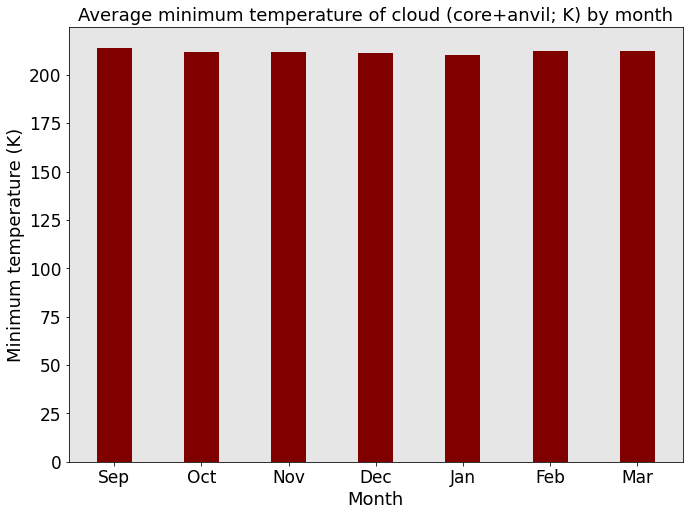

In [12]:
# rainfall (hours)

#mcs_track_data_files=['/glade/u/home/isingh9/work/Zhe_Feng_data/Feng2020JGR_data/data/spac/robust_mcs_tracks_extc_'+str(year)+'0101_'+str(year)+'1231.nc' for year in np.arange(2014,2020,1)]
mcs_track_data_files=['/glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_'+str(year)+'0101.0000_'+str(year+1)+'0101.0000.nc' for year in years]

def out_timeframes(year):
    timeframes=[[pd.to_datetime(str(year)+'-09-01'),pd.to_datetime(str(year)+'-09-30')],\
                [pd.to_datetime(str(year)+'-10-01'),pd.to_datetime(str(year)+'-10-31')],\
                [pd.to_datetime(str(year)+'-11-01'),pd.to_datetime(str(year)+'-11-30')],\
                [pd.to_datetime(str(year)+'-12-01'),pd.to_datetime(str(year)+'-12-31')],\
                [pd.to_datetime(str(year)+'-01-01'),pd.to_datetime(str(year)+'-01-31')],\
                [pd.to_datetime(str(year)+'-02-01'),pd.to_datetime(str(year)+'-02-28')],\
                [pd.to_datetime(str(year)+'-03-01'),pd.to_datetime(str(year)+'-03-31')]]
    
    return timeframes

years=np.arange(2001,2021,1)
months= ['September','October','November','December','January','February','March']
kk = 0 
data = np.zeros((7))


for jj in range(7):
    print('month is ',months[jj])
    kk=0
    for fil in mcs_track_data_files:
        print('file is ',fil)
        yr = years[kk]
        print('year is ',yr)
        print('time frame is ',out_timeframes(yr)[jj])
        ds_subset = subset_file(fil,None,[-70,-55],[-45,-25],out_timeframes(yr)[jj])
        mintb = np.nanmean(ds_subset.corecold_mintb.values)
        print('mintb of MCS is ',mintb,' K')
        data[jj]=data[jj]+mintb
        kk = kk + 1
    print('\n-------\n')
    
data=data/len(years)

fig = plt.figure(figsize=(11,8))
xtick_labels = ['Sep','Oct','Nov','Dec','Jan', 'Feb','Mar']
plt.bar(xtick_labels, data, color ='maroon',width = 0.4)
plt.xlabel('Month')
plt.ylabel('Minimum temperature (K)')
plt.title('Average minimum temperature of cloud (core+anvil; K) by month')
fig.savefig('mintb_by_month.png', dpi=200) 

month is  September
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20010101.0000_20020101.0000.nc
year is  2001
time frame is  [Timestamp('2001-09-01 00:00:00'), Timestamp('2001-09-30 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20010101.0000_20020101.0000.nc
core_area of MCS is  7531.277  km2
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20020101.0000_20030101.0000.nc
year is  2002
time frame is  [Timestamp('2002-09-01 00:00:00'), Timestamp('2002-09-30 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20020101.0000_20030101.0000.nc
core_area of MCS is  8180.5283  km2
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20030101.0000_20040101.0000.nc
year is  2003
time frame is  [Timestamp('2003-09-01 00:00:00'), Timestamp('2003-09-30 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/st

core_area of MCS is  6592.04  km2
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20040101.0000_20050101.0000.nc
year is  2004
time frame is  [Timestamp('2004-10-01 00:00:00'), Timestamp('2004-10-31 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20040101.0000_20050101.0000.nc
core_area of MCS is  9185.072  km2
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20050101.0000_20060101.0000.nc
year is  2005
time frame is  [Timestamp('2005-10-01 00:00:00'), Timestamp('2005-10-31 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20050101.0000_20060101.0000.nc
core_area of MCS is  6110.6704  km2
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20060101.0000_20070101.0000.nc
year is  2006
time frame is  [Timestamp('2006-10-01 00:00:00'), Timestamp('2006-10-31 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zh

core_area of MCS is  5993.4805  km2
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20080101.0000_20090101.0000.nc
year is  2008
time frame is  [Timestamp('2008-11-01 00:00:00'), Timestamp('2008-11-30 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20080101.0000_20090101.0000.nc
core_area of MCS is  4591.852  km2
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20090101.0000_20100101.0000.nc
year is  2009
time frame is  [Timestamp('2009-11-01 00:00:00'), Timestamp('2009-11-30 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20090101.0000_20100101.0000.nc
core_area of MCS is  8144.843  km2
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20100101.0000_20110101.0000.nc
year is  2010
time frame is  [Timestamp('2010-11-01 00:00:00'), Timestamp('2010-11-30 00:00:00')]
input file is  /glade/u/home/isingh9/work/Z

core_area of MCS is  6318.7847  km2
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20110101.0000_20120101.0000.nc
year is  2011
time frame is  [Timestamp('2011-12-01 00:00:00'), Timestamp('2011-12-31 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20110101.0000_20120101.0000.nc
core_area of MCS is  3122.431  km2
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20120101.0000_20130101.0000.nc
year is  2012
time frame is  [Timestamp('2012-12-01 00:00:00'), Timestamp('2012-12-31 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20120101.0000_20130101.0000.nc
core_area of MCS is  7772.6064  km2
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20130101.0000_20140101.0000.nc
year is  2013
time frame is  [Timestamp('2013-12-01 00:00:00'), Timestamp('2013-12-31 00:00:00')]
input file is  /glade/u/home/isingh9/work/

core_area of MCS is  4797.371  km2
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20140101.0000_20150101.0000.nc
year is  2014
time frame is  [Timestamp('2014-01-01 00:00:00'), Timestamp('2014-01-31 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20140101.0000_20150101.0000.nc
core_area of MCS is  6655.1665  km2
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20150101.0000_20160101.0000.nc
year is  2015
time frame is  [Timestamp('2015-01-01 00:00:00'), Timestamp('2015-01-31 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20150101.0000_20160101.0000.nc
core_area of MCS is  4605.7427  km2
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20160101.0000_20170101.0000.nc
year is  2016
time frame is  [Timestamp('2016-01-01 00:00:00'), Timestamp('2016-01-31 00:00:00')]
input file is  /glade/u/home/isingh9/work/

core_area of MCS is  4219.1333  km2
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20180101.0000_20190101.0000.nc
year is  2018
time frame is  [Timestamp('2018-02-01 00:00:00'), Timestamp('2018-02-28 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20180101.0000_20190101.0000.nc
core_area of MCS is  2975.2737  km2
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20190101.0000_20200101.0000.nc
year is  2019
time frame is  [Timestamp('2019-02-01 00:00:00'), Timestamp('2019-02-28 00:00:00')]
input file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20190101.0000_20200101.0000.nc
core_area of MCS is  6361.7354  km2
file is  /glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_20200101.0000_20210101.0000.nc
year is  2020
time frame is  [Timestamp('2020-02-01 00:00:00'), Timestamp('2020-02-28 00:00:00')]
input file is  /glade/u/home/isingh9/work

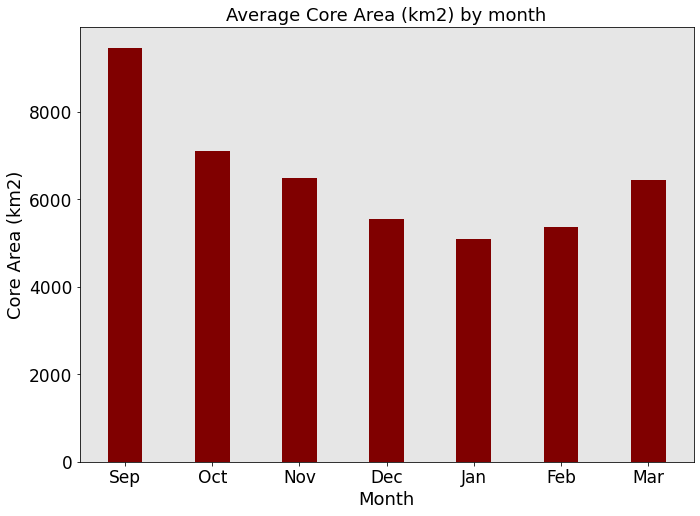

In [15]:
# rainfall (hours)

#mcs_track_data_files=['/glade/u/home/isingh9/work/Zhe_Feng_data/Feng2020JGR_data/data/spac/robust_mcs_tracks_extc_'+str(year)+'0101_'+str(year)+'1231.nc' for year in np.arange(2014,2020,1)]
mcs_track_data_files=['/glade/u/home/isingh9/work/Zhe_Feng_data/stats/mcs_tracks_final_extc_'+str(year)+'0101.0000_'+str(year+1)+'0101.0000.nc' for year in years]

def out_timeframes(year):
    timeframes=[[pd.to_datetime(str(year)+'-09-01'),pd.to_datetime(str(year)+'-09-30')],\
                [pd.to_datetime(str(year)+'-10-01'),pd.to_datetime(str(year)+'-10-31')],\
                [pd.to_datetime(str(year)+'-11-01'),pd.to_datetime(str(year)+'-11-30')],\
                [pd.to_datetime(str(year)+'-12-01'),pd.to_datetime(str(year)+'-12-31')],\
                [pd.to_datetime(str(year)+'-01-01'),pd.to_datetime(str(year)+'-01-31')],\
                [pd.to_datetime(str(year)+'-02-01'),pd.to_datetime(str(year)+'-02-28')],\
                [pd.to_datetime(str(year)+'-03-01'),pd.to_datetime(str(year)+'-03-31')]]
    
    return timeframes

years=np.arange(2001,2021,1)
months= ['September','October','November','December','January','February','March']
kk = 0 
data = np.zeros((7))


for jj in range(7):
    print('month is ',months[jj])
    kk=0
    for fil in mcs_track_data_files:
        print('file is ',fil)
        yr = years[kk]
        print('year is ',yr)
        print('time frame is ',out_timeframes(yr)[jj])
        ds_subset = subset_file(fil,None,[-70,-55],[-45,-25],out_timeframes(yr)[jj])
        total_rain = np.nanmean(ds_subset.total_rain.values)
        print('core_area of MCS is ',total_rain,' km2')
        data[jj]=data[jj]+total_rain
        kk = kk + 1
    print('\n-------\n')
    
data=data/len(years)

fig = plt.figure(figsize=(11,8))
xtick_labels = ['Sep','Oct','Nov','Dec','Jan', 'Feb','Mar']
plt.bar(xtick_labels, data, color ='maroon',width = 0.4)
plt.xlabel('Month')
plt.ylabel('Core Area (km2)')
plt.title('Average Core Area (km2) by month')
fig.savefig('core_area_by_month.png', dpi=200) 

working on  September
working on  October
working on  November
working on  December
working on  January
working on  February


/glade/scratch/isingh9/ipykernel_8666/1807408914.py:68: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


saving to ...  Z_climatology_South_America_SONDJF.png


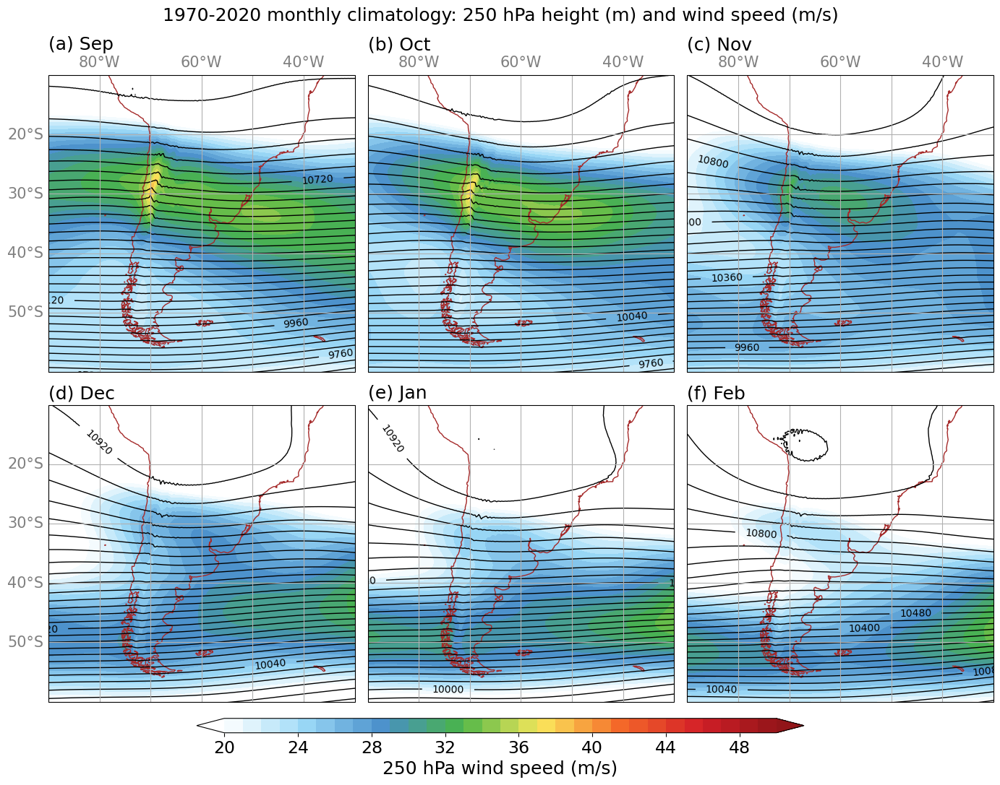

In [21]:
def plot_pv_monthly_climatology():
    
    mpl.rcParams['font.size'] = 12
    mpl.rcParams['font.family'] = 'Helvetica'

    season        = ['September','October','November','December','January','February']
    month_numbers = ['09','10','11','12','01','02']
    titles = ['(a) Sep','(b) Oct','(c) Nov','(d) Dec','(e) Jan','(f) Feb']

    fig = plt.figure(figsize=[14,10], dpi=100)

    resolution = '110m'
    #land = cfeature.NaturalEarthFeature('physical', 'land', resolution)
    #ocean = cfeature.NaturalEarthFeature('physical', 'ocean', resolution)
    #borders = cfeature.NaturalEarthFeature('cultural', 'admin_0_boundary_lines_land', resolution)
#    states = cfeature.NaturalEarthFeature('cultural', 'admin_1_states_provinces_lakes', resolution)

    for jj in range(0,6):
        print('working on ',season[jj])
        
        ax = plt.subplot(2, 3, jj+1, projection=crs.PlateCarree())
        ax.set_extent([-90, -30, -10, -60], crs=crs.PlateCarree()); 
        gl = ax.gridlines()#color="gray",alpha=0.5, linestyle='--',draw_labels=True,linewidth=2)
        ax.coastlines(color='brown')
        gl.xlines = True
        gl.ylines = True

        if jj<=2:
            gl.top_labels = True
        if (jj==0) | (jj==3):
            gl.left_labels = True
        gl.xformatter = LONGITUDE_FORMATTER
        gl.yformatter = LATITUDE_FORMATTER
        gl.xlabel_style = {'size': 15, 'color': 'gray'}#, 'weight': 'bold'}
        gl.ylabel_style = {'size': 15, 'color': 'gray'}#, 'weight': 'bold'}

        ax.set_title(titles[jj], loc='left')
        
        
        gh_300=xr.open_dataset('/glade/u/home/isingh9/work/ERA5_SON_DJF_monthly_means/250hpa_geop_mon_mean_1970_2018.nc')
        #pv_300=xr.open_dataset('/glade/u/home/isingh9/work/ERA5_SON_DJF_monthly_means/300hpa_pv_mon_mean_1970_2018.nc')
        u_300=xr.open_dataset('/glade/u/home/isingh9/work/ERA5_SON_DJF_monthly_means/250hpa_uwnd_mon_mean_1970_2018.nc')
        v_300=xr.open_dataset('/glade/u/home/isingh9/work/ERA5_SON_DJF_monthly_means/250hpa_vwnd_mon_mean_1970_2018.nc')
        
        gph = gh_300.z.sel(time=gh_300.time.dt.month.isin([int(month_numbers[jj])])).mean(dim='time',keep_attrs=True)/9.81
        #pv  = pv_300.pv.sel(time=pv_300.time.dt.month.isin([int(month_numbers[jj])])).mean(dim='time',keep_attrs=True)*10**6
        u   = u_300 .u.sel(time=  u_300.time.dt.month.isin([int(month_numbers[jj])])).mean(dim='time',keep_attrs=True)
        v   = v_300 .v.sel(time=  v_300.time.dt.month.isin([int(month_numbers[jj])])).mean(dim='time',keep_attrs=True)
        wspd = np.sqrt(u**2 + v**2)
        
        cf1 = plt.contour(gh_300.longitude.values,gh_300.latitude.values,gph.values, levels=np.arange(8000,13000,40),transform=crs.PlateCarree(), colors='k',linewidths=1.0,linestyles='-')
        #cf1 = plt.contour(pv_300.longitude.values,pv_300.latitude.values,pv.values, levels=np.arange(-8,0,0.5),transform=crs.PlateCarree(), colors='k',linewidths=1.0,linestyles='-')
        ax.clabel(cf1, inline=1, fontsize=10)
        cf2 = plt.contourf(u_300.longitude.values,u_300.latitude.values,wspd.values, levels=np.arange(20,51,1), cmap=cma4,transform=crs.PlateCarree(),extend='both')

        ax.set_aspect('auto', adjustable=None)
        
    cb_ax = fig.add_axes([0.2, -0.025, 0.6, 0.02])  # two panels
    cbar = fig.colorbar(cf2, cax=cb_ax, orientation = 'horizontal',label='250 hPa wind speed (m/s)',extend='both')
    #cbar.formatter.set_powerlimits((0,0))
    
        # Terrain height
        #ct = ax.contour(lon_hgt, lat_hgt, hgt_s, levels=levelshgt, \
        #                colors='dimgray', linewidths=(1.0,1.5), transform=ccrs.PlateCarree(), zorder=6)
#         ctlb = ax.clabel(ct, inline=True, fmt='%.0f', fontsize=10)

    plt.suptitle('1970-2020 monthly climatology: 250 hPa height (m) and wind speed (m/s)',fontsize=18)
    plt.tight_layout()
    #plt.tight_layout(w_pad=2.5, h_pad=1.2)
    filename = 'Z_climatology_South_America_SONDJF.png'
    print('saving to ... ',filename)
    fig.savefig(filename, dpi=200, bbox_inches='tight')
    #plt.close()

    
plot_pv_monthly_climatology()

working on  September
working on  October
working on  November
working on  December
working on  January
working on  February


/glade/scratch/isingh9/ipykernel_9448/2602618456.py:73: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


saving to ...  850hPa_Z_v-wspd_climatology_South_America_SONDJF.png


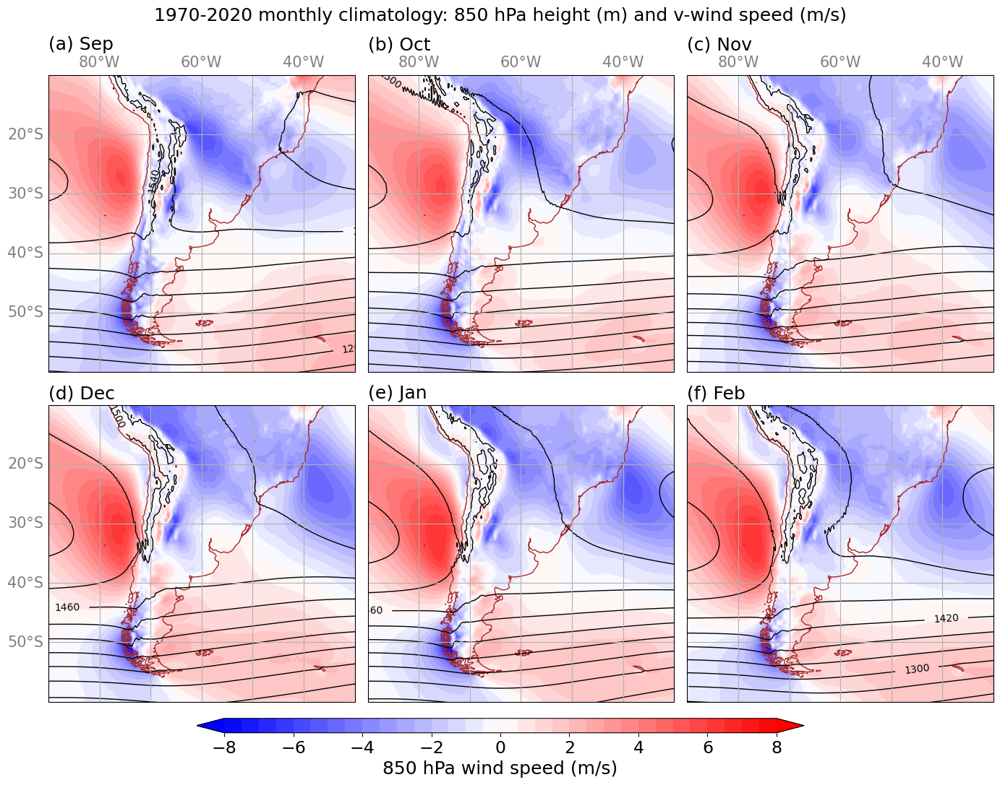

In [230]:
terr=xr.open_dataset("/glade/u/home/isingh9/jupyter_nbks/etopo1.nc")
terr['Band1'].values[terr['Band1'].values < 0.]=np.nan

def plot_sallj_monthly_climatology():
    
    mpl.rcParams['font.size'] = 12
    mpl.rcParams['font.family'] = 'Helvetica'

    season        = ['September','October','November','December','January','February']
    month_numbers = ['09','10','11','12','01','02']
    titles = ['(a) Sep','(b) Oct','(c) Nov','(d) Dec','(e) Jan','(f) Feb']

    fig = plt.figure(figsize=[14,10], dpi=100)

    resolution = '110m'
    #land = cfeature.NaturalEarthFeature('physical', 'land', resolution)
    #ocean = cfeature.NaturalEarthFeature('physical', 'ocean', resolution)
    #borders = cfeature.NaturalEarthFeature('cultural', 'admin_0_boundary_lines_land', resolution)
#    states = cfeature.NaturalEarthFeature('cultural', 'admin_1_states_provinces_lakes', resolution)

    for jj in range(0,6):
        print('working on ',season[jj])
        
        ax = plt.subplot(2, 3, jj+1, projection=crs.PlateCarree())
        ax.set_extent([-90, -30, -10, -60], crs=crs.PlateCarree()); 
        gl = ax.gridlines()#color="gray",alpha=0.5, linestyle='--',draw_labels=True,linewidth=2)
        ax.coastlines(color='brown')
        gl.xlines = True
        gl.ylines = True

        if jj<=2:
            gl.top_labels = True
        if (jj==0) | (jj==3):
            gl.left_labels = True
        gl.xformatter = LONGITUDE_FORMATTER
        gl.yformatter = LATITUDE_FORMATTER
        gl.xlabel_style = {'size': 15, 'color': 'gray'}#, 'weight': 'bold'}
        gl.ylabel_style = {'size': 15, 'color': 'gray'}#, 'weight': 'bold'}

        ax.set_title(titles[jj], loc='left')
        
        
        gh_850=xr.open_dataset('/glade/u/home/isingh9/work/ERA5_SON_DJF_monthly_means/850hpa_geop_mon_mean_1970_2018.nc')
        #pv_300=xr.open_dataset('/glade/u/home/isingh9/work/ERA5_SON_DJF_monthly_means/300hpa_pv_mon_mean_1970_2018.nc')
        uv_850=xr.open_dataset('/glade/u/home/isingh9/work/ERA5_SON_DJF_monthly_means/850hpa_uwnd_vwnd_mon_mean_1970_2018.nc')
        
        gph = gh_850.z.sel(time=gh_850.time.dt.month.isin([int(month_numbers[jj])])).mean(dim='time',keep_attrs=True)/9.81
        #pv  = pv_300.pv.sel(time=pv_300.time.dt.month.isin([int(month_numbers[jj])])).mean(dim='time',keep_attrs=True)*10**6
        u   = uv_850 .u.sel(time=  uv_850.time.dt.month.isin([int(month_numbers[jj])])).mean(dim='time',keep_attrs=True)
        v   = uv_850 .v.sel(time=  uv_850.time.dt.month.isin([int(month_numbers[jj])])).mean(dim='time',keep_attrs=True)
        wspd = v
        
        cf1 = plt.contour(gh_850.longitude.values,gh_850.latitude.values,gph.values, levels=np.arange(500,8000,40),transform=crs.PlateCarree(), colors='k',linewidths=1.0,linestyles='-')
        #cf1 = plt.contour(pv_300.longitude.values,pv_300.latitude.values,pv.values, levels=np.arange(-8,0,0.5),transform=crs.PlateCarree(), colors='k',linewidths=1.0,linestyles='-')
        ax.clabel(cf1, inline=1, fontsize=10)
        #topo_cont1=plt.contour(terr.lon.values,terr.lat.values,terr.Band1.values, levels=[1000], \
        #           colors="saddlebrown",linewidths=0.7,transform=crs.PlateCarree())
        cf2 = plt.contourf(uv_850.longitude.values,uv_850.latitude.values,wspd.values, levels=np.arange(-8,8.5,.5), cmap=cma1,transform=crs.PlateCarree(),extend='both')

        
        ax.set_aspect('auto', adjustable=None)
        
    cb_ax = fig.add_axes([0.2, -0.025, 0.6, 0.02])  # two panels
    cbar = fig.colorbar(cf2, cax=cb_ax, orientation = 'horizontal',label='850 hPa wind speed (m/s)',extend='both')
    #cbar.formatter.set_powerlimits((0,0))
    
        # Terrain height
        #ct = ax.contour(lon_hgt, lat_hgt, hgt_s, levels=levelshgt, \
        #                colors='dimgray', linewidths=(1.0,1.5), transform=ccrs.PlateCarree(), zorder=6)
#         ctlb = ax.clabel(ct, inline=True, fmt='%.0f', fontsize=10)

    plt.suptitle('1970-2020 monthly climatology: 850 hPa height (m) and v-wind speed (m/s)',fontsize=18)
    plt.tight_layout()
    #plt.tight_layout(w_pad=2.5, h_pad=1.2)
    filename = '850hPa_Z_v-wspd_climatology_South_America_SONDJF.png'
    print('saving to ... ',filename)
    fig.savefig(filename, dpi=200, bbox_inches='tight')
    #plt.close()

    
plot_sallj_monthly_climatology()

In [ ]:
#df_pvirrot_48hrs_abv75pc.index#[(df_pvirrot_48hrs_abv75pc.index.year==2019) & \
#                               (df_pvirrot_48hrs_abv75pc.index.month==3)]

df_temp = df_pvirrot_48hrs_abv75pc.reset_index(drop=False)

dt = df_temp['date']
hr = pd.Timedelta('1h')
in_block = ((dt - dt.shift(-1)).abs() == hr) | (dt.diff() == hr)

filt = df_temp.loc[in_block.values]
breaks = filt['date'].diff() != hr
groups = breaks.cumsum()

df_temp['groups'] = groups

In [ ]:

high_pv_num_20 = 0
sallj_75_pc  = final_df['sallj'].quantile(.75)
sallj_50_pc  = final_df['sallj'].quantile(.50)

for _, frame in filt.groupby(groups):
    #print('len of this group is : ',len(frame))
    start_date = frame.iloc[0]['date']
    mid_date = frame.iloc[(len(frame))//2]['date']
    end_date = frame.iloc[-1]['date']
    #print('start point of this group is ',start_date)
    #print('mid point of this group is ',mid_date)
    #print('end point of this group is ',end_date)
    #print(frame)
    if len(frame)>18:
        #print(' Found a group with > 20 times ...')
        high_pv_num_20=high_pv_num_20+1
        #plot_ERA5_timestep(pd.to_datetime(start_date))
        #plot_ERA5_timestep(pd.to_datetime(mid_date))
        #plot_ERA5_timestep(pd.to_datetime(end_date))
        #plot_ERA5_NBE_timestep(pd.to_datetime(start_date))
        #plot_ERA5_NBE_timestep(pd.to_datetime(mid_date))
        #plot_ERA5_NBE_timestep(pd.to_datetime(end_date))
        #print('%age of time SALLJ > 75th percentile ',frame.loc[frame['sallj'] > sallj_75_pc,'sallj'].count()*100./frame['sallj'].count())
        #print('%age of time SALLJ > 50th percentile ',frame.loc[frame['sallj'] > sallj_50_pc,'sallj'].count()*100./frame['sallj'].count())
        #print('-------')
    #print('\n')

print('number of > 20-hr high_pv_num ',high_pv_num_20)

In [ ]:
df_temp.groupby(groups).size().values#.hist()

In [ ]:
plt.hist(df_temp.groupby(groups).size().values)
plt.ylabel('frequency')
plt.xlabel('consecutive days of > median +PV adv irrot wnds') #

In [ ]:
#plot_ERA5_timestep(pd.to_datetime('2002-10-10 11:00:00'))
plot_ERA5_PV_wspd_timestep(pd.to_datetime('2002-10-10 11:00:00'))

In [ ]:
final_of_interest = final_df[(final_df['pvadv_irrot'] > final_df['pvadv_irrot'].quantile(.90)) & (final_df['MI'] > final_df['MI'].quantile(.90))]
#final_of_interest = final_df_plotting[(final_df_plotting['pvadv_irrot'] > final_df_plotting['pvadv_irrot'].quantile(.75)) & (final_df_plotting['MI'] < final_df_plotting['MI'].quantile(.75))]

cases_high_pv_adv_low_MI=final_of_interest.index

#df_sallj_48hrs_abvavg = final_df[final_df.rolling(48)['sallj'].min() >= sallj_median]

print(cases_high_pv_adv_low_MI)
print('number of such cases: ',len(cases_high_pv_adv_low_MI))
print('number of cases with high PV adv : ',len(final_df[(final_df['pvadv_irrot'] > final_df['pvadv_irrot'].quantile(.90))]))
print('percentage of such cases is : ',len(cases_high_pv_adv_low_MI)/len(final_df))

In [ ]:
df_jetmax_gt_50 = final_df[final_df['max_jet'] >= final_df['max_jet'].quantile(.80)]
df_jetmax_gt_50

In [ ]:
df_jetmax_gt_50.index.intersection(df_sallj_48hrs_abv75pc.index)

In [ ]:
final_df_aboveavg_pvadv.index.intersection(df_sallj_48hrs_abv75pc.index)

In [ ]:
occurences = df.groupby(df.index.month)['sallj'].count().to_frame('occurences')

occurences

In [ ]:
final_df_subset = final_df.loc['2009-01-01':'2010-03-31']
final_df_plotting = final_df_subset#.resample('D').mean().rolling(3).mean()

#'sallj'
#'pvadv_irrot'
#'rrmax'
#'rravg'
#'MI'
#'max_jet'
units_dict = {'sallj':'m/s','pvadv_irrot':'PVU/hr','rrmax':'mm/hr','rravg':'mm/hr','MI':'m/s','max_jet':'m/s'}
variable_name1_plot = 'pvadv_irrot'
variable_name2_plot = 'MI'

fig, ax = plt.subplots(figsize=(16, 10))
ax.set(xlabel="Time (UTC)",\
       title="Time series of "+variable_name1_plot +' and '+ variable_name2_plot)
ax.tick_params(axis='y', labelcolor='blue')
ax.set_ylabel(variable_name1_plot + " (" + units_dict[variable_name1_plot] + ")", color='blue')

ax.plot(final_df_plotting.index,final_df_plotting[variable_name1_plot],label=variable_name1_plot,color='blue')#,s=2)#,linestyle='-')
#ax.scatter(final_df.index,final_df[variable_name2_plot],label=variable_name2_plot,color='green',s=2)#,linestyle='--')

ax2=ax.twinx()
#ax2.invert_yaxis()
ax2.plot(final_df_plotting.index,final_df_plotting[variable_name2_plot],label=variable_name2_plot,color='red')#,linestyle='-')
ax2.set_ylabel(variable_name2_plot + " (" + units_dict[variable_name2_plot] + ")", color='red')  # we already handled the x-label with ax1
ax2.tick_params(axis='y', labelcolor='red')

# Define the date format
date_form = DateFormatter("%m-%d %H")
ax.xaxis.set_major_formatter(date_form)
ax.xaxis.set_major_locator(mdates.DayLocator(interval=15))
ax.tick_params(axis='x', labelsize=9)

#plt.plot(times_list3,area_avgd_quant_list3,label='CU ON LHT OFF')
h1, l1 = ax.get_legend_handles_labels()
h2, l2 = ax2.get_legend_handles_labels()
ax.legend(h1+h2, l1+l2, loc=0)


#ax.axhline(y=final_df['meridional_index'].mean() + 2.0*final_df['meridional_index'].std(),color='blue')
#ax2.axhline(y=final_df['UL_PV_ageo_adv'].mean() + 2.0*final_df['UL_PV_ageo_adv'].std(),color='red')

plt.grid()
filename = 'time_series_ERA5_'+variable_name1_plot+'_'+variable_name2_plot+'.png'
print(filename)

# Separating out interesting cases:
final_of_interest = final_df_plotting.rolling(24).mean()[(final_df_plotting['pvadv_irrot'] > final_df_plotting['pvadv_irrot'].quantile(.80)) & (final_df_plotting['MI'] < final_df_plotting['MI'].quantile(.10))]
#final_of_interest = final_df_plotting[(final_df_plotting['pvadv_irrot'] > final_df_plotting['pvadv_irrot'].quantile(.75)) & (final_df_plotting['MI'] < final_df_plotting['MI'].quantile(.75))]




cases_high_pv_adv_low_MI=final_of_interest.index
print(cases_high_pv_adv_low_MI)
print('number of such cases: ',len(cases_high_pv_adv_low_MI))
#ax.axvline (cases_high_pv_adv_low_MI)#,final_of_interest.loc[cases_high_pv_adv_low_MI]['MI'],s=120,facecolors='none', edgecolors='green')
#ax.vlines(x=cases_high_pv_adv_low_MI, ymin=0, ymax=25, color='k', ls='--')

# the code below is the code to dray lines over interesting cases
#for xx in cases_high_pv_adv_low_MI:
#    ax.axvline(xx,color='k',ls='--')
    
plt.savefig(filename,dpi=200)

### Plot specific cases

In [ ]:
west_lon=275
east_lon=325  # -35
south_lat=-45.0
north_lat=-15.0

plot_ERA5_timestep(pd.to_datetime('2010-02-09 01:00:00'))#'2010-03-07 19:00:00'))

In [ ]:
fig, ax = plt.subplots(figsize=(10,10))
plt.scatter(final_df['pvadv_irrot'],final_df['MI'],c=final_df['sallj'])
#plt.scatter(final_df['pvadv_irrot'],final_df['MI'],c=final_df['max_jet'])
#new_df = final_df[(final_df['pvadv_irrot'] > final_df['pvadv_irrot'].quantile(.75)) & (final_df['MI'] > final_df['MI'].quantile(.75))]
#plt.scatter(new_df['pvadv_irrot'],new_df['MI'],c=new_df['sallj'])
plt.xlabel('PV advection by irrotational winds (PVU/hr)')
plt.ylabel('Meridional Index (m/s; abs val of v-wind)')
plt.title('Colored by jet maximum')
plt.colorbar()

In [ ]:
# using percentiles

final_df_vhigh_pvadv_pc              = final_df[ final_df['UL_PV_ageo_adv']     > (final_df['UL_PV_ageo_adv']     .quantile(.95))]

final_df_vhigh_pvadv_vhigh_mi_pc      = final_df[(final_df['UL_PV_ageo_adv']     > (final_df['UL_PV_ageo_adv']     .quantile(.95))) & \
                                              (final_df['meridional_index']   > (final_df['meridional_index']   .quantile(.95)))]

final_df_vhigh_pvadv_vhigh_heating_pc = final_df[(final_df['UL_PV_ageo_adv']     > (final_df['UL_PV_ageo_adv']     .quantile(.95))) & \
                                              (final_df['500-200hPa_heating'] > (final_df['500-200hPa_heating'] .quantile(.95)))]

final_df_vhigh_mi_vhigh_heating_pc = final_df[(final_df['meridional_index']     > (final_df['meridional_index']     .quantile(.95))) & \
                                              (final_df['500-200hPa_heating'] > (final_df['500-200hPa_heating'] .quantile(.95)))]

final_df_belavg_pvadv_vhigh_mi_pc     = final_df[(final_df['UL_PV_ageo_adv']     < (final_df['UL_PV_ageo_adv']     .quantile(.50))) & \
                                              (final_df['meridional_index']   > (final_df['meridional_index']   .quantile(.95)))]

final_df_low_pvadv_vhigh_mi_pc     = final_df[(final_df['UL_PV_ageo_adv']     < (final_df['UL_PV_ageo_adv']     .quantile(.25))) & \
                                              (final_df['meridional_index']   > (final_df['meridional_index']   .quantile(.95)))]

final_df_vhigh_pvadv_belavg_mi_pc     = final_df[(final_df['UL_PV_ageo_adv']     > (final_df['UL_PV_ageo_adv']     .quantile(.95))) & \
                                                 (final_df['meridional_index']   < (final_df['meridional_index']   .quantile(.50)))]

final_df_high_pvadv_high_mi_pc        = final_df[(final_df['UL_PV_ageo_adv']     > (final_df['UL_PV_ageo_adv']     .quantile(.75))) & \
                                                 (final_df['meridional_index']   > (final_df['meridional_index']   .quantile(.75)))]

final_df_high_pvadv_low_mi_pc        = final_df[(final_df['UL_PV_ageo_adv']     > (final_df['UL_PV_ageo_adv']     .quantile(.75))) & \
                                                 (final_df['meridional_index']   < (final_df['meridional_index']   .quantile(.25)))]

final_df_low_pvadv_high_mi_pc        = final_df[(final_df['UL_PV_ageo_adv']     < (final_df['UL_PV_ageo_adv']     .quantile(.25))) & \
                                                (final_df['meridional_index']   > (final_df['meridional_index']   .quantile(.75)))]


final_df_vhigh_mi_pc                  = final_df[ final_df['meridional_index']   > (final_df['meridional_index']   .quantile(.95))]

## Read and analyze TRMM data

In [ ]:
dir_main='/glade/u/home/isingh9/work/TRMM_data/uw2/SAM/DCC/01/'
trmm_files=sorted(glob.glob(dir_main+'TPR7_uw2_DCC_mod_grd_200201_SAM.nc'))
print(trmm_files)
da = xr.open_dataset(trmm_files[0])
da

In [ ]:
da.dcc_core_rain_rate_count.plot()

## Track troughs and ridges

In [57]:
west_lon  =  280 #235
east_lon  =  310 #355 
south_lat = -50.0
north_lat = -25.0

climatology_file = '500hpa_geop_mon_means_1970-2021.nc'

# for lons
#clim_ds = xr.open_dataset(climatology_file).sel(latitude=np.arange(south_lat,north_lat,0.25),\
#                   longitude=np.arange(west_lon-360,east_lon-360,0.25))/9.81
# for lons with negative values
clim_ds = xr.open_dataset(climatology_file).sel(latitude=np.arange(south_lat,north_lat,0.25),\
                   longitude=np.arange(west_lon-360,east_lon-360,0.25))/9.81
print(clim_ds)
#clim_ds = clim_ds.assign_coords({"longitude": clim_ds.longitude+360.}).rename({"z":"Z"})

#print(clim_ds)
#print('-----------')
###########
#./Nov_10_2018_500hpa_height.nc
#z_ds = xr.open_dataset('500hpa_geopotential_2018-19.nc').sel(latitude=np.arange(south_lat,north_lat,0.25),\
#                 longitude=np.arange(west_lon,east_lon,0.25)).sel(time=slice('2018-10-01','2018-12-31'))
"""
DIRECTORY_PRES    = '/glade/collections/rda/data/ds633.0/e5.oper.an.pl/'
era5_time_range = pd.date_range(start='2018-10-01', end='2018-10-31', freq='1D')
#z_filenames    = DIRECTORY_PRES+TIM.strftime('%Y%m')+'/'+'e5.oper.an.pl.128_129_z.ll025sc.'+TIM.strftime('%Y%m%d00_%Y%m%d23.nc')
z_filenames = [DIRECTORY_PRES+TIME.strftime('%Y%m')+'/'+'e5.oper.an.pl.128_129_z.ll025sc.'+TIME.strftime('%Y%m%d00_%Y%m%d23.nc') for TIME in era5_time_range]
z_ds = xr.open_mfdataset(z_filenames).Z.sel(latitude=np.arange(south_lat,north_lat,0.25),\
                 longitude=np.arange(west_lon,east_lon,0.25)).sel(time=slice('2018-10-01','2018-10-31'), level=500)/9.81
z_ds.coords['longitude'] = (z_ds.coords['longitude'] + 180) % 360 - 180
z_ds = z_ds.sortby(z_ds.longitude)
#z_ds
"""
z_ds = xr.open_dataset('/glade/u/home/isingh9/work/ERA5_download_dir/'+'era5_2018-2021_500hPa_Z_SH.nc').sel(latitude=np.arange(south_lat,north_lat,0.25),\
                 longitude=np.arange(west_lon-360,east_lon-360,0.25)).sel(time=slice('2018-10-01','2018-12-31'))/9.81
print(z_ds)
#print('-----------')
###########
anom_ds = z_ds.groupby("time.month") - clim_ds.groupby("time.month").mean("time")
#print(anom_ds)
anom_ds = anom_ds.rename({"z":"anom"})
print(anom_ds)

<xarray.Dataset>
Dimensions:    (longitude: 120, latitude: 100, time: 416)
Coordinates:
  * longitude  (longitude) float32 -80.0 -79.75 -79.5 ... -50.75 -50.5 -50.25
  * latitude   (latitude) float32 -50.0 -49.75 -49.5 ... -25.75 -25.5 -25.25
  * time       (time) datetime64[ns] 1970-01-01 1970-02-01 ... 2021-12-01
Data variables:
    z          (time, latitude, longitude) float32 5.542e+03 ... 5.824e+03
Attributes:
    Conventions:  CF-1.6
    history:      2022-10-12 23:18:26 GMT by grib_to_netcdf-2.25.1: /opt/ecmw...
<xarray.Dataset>
Dimensions:    (longitude: 120, latitude: 100, time: 2208)
Coordinates:
  * longitude  (longitude) float32 -80.0 -79.75 -79.5 ... -50.75 -50.5 -50.25
  * latitude   (latitude) float32 -50.0 -49.75 -49.5 ... -25.75 -25.5 -25.25
  * time       (time) datetime64[ns] 2018-10-01 ... 2018-12-31T23:00:00
Data variables:
    z          (time, latitude, longitude) float32 5.354e+03 ... 5.894e+03
Attributes:
    Conventions:  CF-1.6
    history:      2022-12-07 1

In [58]:
#anom_ds.anom.isel(time=12).plot()

anom_ds_arr = anom_ds.anom.values

from ipywidgets import interact, interactive, fixed, interact_manual
import ipywidgets as widgets

def f(x):
    plt.imshow(anom_ds_arr[x,::-1,:],vmin=-150,vmax=150)
    plt.colorbar()

interact(f, x=widgets.IntSlider(min=0, max=31*24*3, step=1, value=10));

interactive(children=(IntSlider(value=10, description='x', max=2232), Output()), _dom_classes=('widget-interac…

In [59]:
#@jit

# dimensions of input aray should be time, lat, lon

def track_contour(NP_ARRAY,THRES,GORL,LATS,DLAT,DLON,OVERLAP,TWOSIDED,PERSISTENCE):
    
    # dimensions are (lat, lon, time)
    ntimes, nlats, nlons = np.shape(NP_ARRAY)
    print(' # lats:  ',nlats)
    print(' # lons:  ',nlons)
    print(' # times: ',ntimes)
    
    NP_ARRAY = ndimage.gaussian_filter(NP_ARRAY, sigma=1.5, order=0)
    
    if GORL == '>=' or GORL == 'ge':
        flag = np.where(NP_ARRAY >= THRES, 1, 0)
    elif GORL == '<=' or GORL == 'le':
        flag = np.where(NP_ARRAY <= THRES, 1, 0)
    elif GORL == '>' or GORL == 'gt':
        flag = np.where(NP_ARRAY > THRES, 1, 0)
    elif GORL == '<' or GORL == 'lt':
        flag = np.where(NP_ARRAY < THRES, 1, 0)
    else:
        errmsg = ' Please select from [>, >=, <, >=] for gorl'
        raise ValueError(errmsg)
        
    flag, num_features = ndimage.label(flag, structure= np.array([[[0, 0, 0], [0,0,0], [0,0,0]],
                                                                          [[1, 1, 1], [1,1,1], [1,1,1]],
                                                                          [[0, 0, 0], [0,0,0], [0,0,0]]]))
    
    # can lead to memory error... better to loop over each time step?  
            
    # periodic boundry: allow contours to cross date border
    # comment: what if dimension index not in order (time,lat,lon)? --> self.ds[variable].dims.index(self._latitude_name)

    for tt in range(ntimes):
        for yy in range(nlats):
            if flag[tt, yy, 0] > 0 and flag[tt, yy, -1] > 0 and (flag[tt, yy, 0] > flag[tt, yy, -1]):
                # downstream
                flag[tt][flag[tt] == flag[tt, yy, 0]] = flag[tt, yy, -1]
            if flag[tt, yy, 0] > 0 and flag[tt, yy, -1] > 0 and (flag[tt, yy, 0] < flag[tt, yy, -1]):
                # upstream
                flag[tt][flag[tt] == flag[tt, yy, -1]] = flag[tt, yy, 0] 

    #step 3: OVERLAPping
    print("Apply OVERLAP...")
 
    weight_lat = np.cos(LATS*np.pi/180.0)
    weight_grid = np.ones((nlats,nlons))*(np.array((111.0*DLAT*111.0*DLON*weight_lat))[:, None])
    #print(weight_grid)
    for tt in range(1,ntimes-1):  
        # loop over individual contours
        slices = ndimage.find_objects(flag[tt])
        label = 0
        for slice_ in slices:
            label = label+1
            if slice_ is None:
                #no feature with this flag/label
                continue

            # calculate values
            areacon = np.sum(weight_grid[slice_][flag[tt][slice_] == label])
            areaover_forward = np.sum(weight_grid[slice_][(flag[tt][slice_] == label) & (flag[tt+1][slice_] >= 1)])
            areaover_backward = np.sum(weight_grid[slice_][(flag[tt][slice_] == label) & (flag[tt-1][slice_] >= 1)])

            fraction_backward = (1 / areacon) * areaover_backward
            fraction_forward = (1 / areacon) * areaover_forward 

            # apply OVERLAP criterion forward and backward
            if TWOSIDED:
                # middle
                if fraction_backward != 0 and fraction_forward != 0:
                    if (fraction_backward < OVERLAP) or (fraction_forward < OVERLAP):
                        flag[tt][slice_][(flag[tt][slice_] == label)] = 0.
                # decay
                if fraction_backward != 0 and fraction_forward == 0:
                    if (fraction_backward < OVERLAP):
                        flag[tt][slice_][(flag[tt][slice_] == label)] = 0.
                # onset
                if fraction_backward == 0 and fraction_forward != 0:        
                    if (fraction_forward < OVERLAP):
                        flag[tt][slice_][(flag[tt][slice_] == label)] = 0.

            # apply OVERLAP criterion only forward (capture also more transient features)           
            else:
                if (fraction_forward < OVERLAP):
                    flag[tt][slice_][(flag[tt][slice_] == label)] = 0.

    # step 4: persistence
    # find features along time axis
    print("Apply persistence...")
    flag = np.where(flag >= 1, 1, 0)
    flag, num_features = ndimage.label(flag, structure = np.array([[[0, 0, 0], [0,1,0], [0,0,0]],
                                                                  [[1, 1, 1], [1,1,1], [1,1,1]],
                                                                  [[0, 0, 0], [0,1,0], [0,0,0]]]))
    # can lead to memory error...
    # periodic boundry: allow features to cross date border
    slices = ndimage.find_objects(flag)
    """
    for tt in range(len(ntimes)):
        for yy in range(nlats):
            if flag[tt, yy, 0] > 0 and flag[tt, yy, -1] > 0 and (flag[tt, yy, 0] > flag[tt, yy, -1]):
                # downstream
                slice_ = slices[flag[tt, yy, 0]-1]
                flag[slice_][(flag[slice_] == flag[tt, yy, 0])] = flag[tt, yy, -1]
            if flag[tt, yy, 0] > 0 and flag[tt, yy, -1] > 0 and (flag[tt, yy, 0] < flag[tt, yy, -1]):
                # upstream
                slice_ = slices[flag[tt, yy, -1]-1]
                flag[slice_][(flag[slice_] == flag[tt, yy, -1])] = flag[tt, yy, 0]
    """
    # check for persistence, remove features with lifetime < persistance
    label = 0
    for slice_ in ndimage.find_objects(flag):
        label = label+1
        if slice_ is None:
            #no feature with this flag
            continue
        if (slice_[0].stop - slice_[0].start) < PERSISTENCE:
            flag[slice_][(flag[slice_] == label)] = 0.        

    num_features = len(np.unique(flag)) - 1  # don't count 0
    print("Running contrack... DONE\n"
                "{} contours tracked".format(num_features))
   
    return flag

In [60]:
import time
start_time = time.perf_counter()   
#track_contour(NP_ARRAY,THRES,GORL,LATS,DLAT,DLON,OVERLAP,TWOSIDED,PERSISTENCE)
out_arr = track_contour(anom_ds.anom.values,150.,'ge',anom_ds.latitude.values,0.25,0.25,0.5,True,24)
finish_time = time.perf_counter()
print(f"Program finished in {finish_time-start_time} seconds")

 # lats:   100
 # lons:   120
 # times:  2208
Apply OVERLAP...
Apply persistence...
Running contrack... DONE
10 contours tracked
Program finished in 2.9755009934306145 seconds


In [61]:
from ipywidgets import interact, interactive, fixed, interact_manual
import ipywidgets as widgets

def f(x):
    plt.imshow(out_arr[x,::-1,:],vmin=0,vmax=35,cmap=plt.get_cmap('gist_ncar'))
    plt.title(z_ds.isel(time=x).time.values)
    plt.colorbar()

interact(f, x=widgets.IntSlider(min=0, max=24*30*3, step=1, value=10));

interactive(children=(IntSlider(value=10, description='x', max=2160), Output()), _dom_classes=('widget-interac…

In [62]:
 def run_lifecycle(FLAG,ANOM_ARRAY,LATS,LONS,TIMES_LIST,DLAT,DLON):
        
    # dimensions are (lat, lon, time)
    ntimes, nlats, nlons = np.shape(FLAG)
    print(' # lats:  ',nlats)
    print(' # lons:  ',nlons)
    print(' # times: ',ntimes)
                  
    # define grid weight
    weight_lat  = np.cos(LATS*np.pi/180.0)
    weight_grid = np.ones((nlats,nlons))*(np.array((111.0*DLAT*111.0*DLON*weight_lat))[:, None])            

    # define output
    # initialize wanted variables!
    block_id  = []
    time      = []
    intensity = []
    size      = []
    com_lon   = []
    com_lat   = []

    # loop through time
    for i_time in range(ntimes): 

        currentstep = TIMES_LIST[i_time]
        
        #print('working on time: ',currentstep)

        # loop over individual contours
        labels = np.unique(FLAG[i_time,:,:])
        labels = labels[labels != 0]
        if len(labels) == 0:
            #no flag at this timestep
            continue

        for label in labels:
            # calculate area and intensity
            areacon      = np.sum(weight_grid[FLAG[i_time,:,:] == label])
            intensitycon = np.sum(weight_grid[FLAG[i_time,:,:] == label]*ANOM_ARRAY[i_time,:,:][FLAG[i_time,:,:] == label])
            intensitycon = intensitycon/areacon

            # calculate center of mass
            # periodic boundary: roll field if flag is split at boundary
            """
            if label in self.ds[flag].isel(**{self._time_name: i_time, self._longitude_name:0}).data and label in self.ds[flag].isel(**{self._time_name: i_time, self._longitude_name:-1}).data:
                # find western edge of flag
                yloc, xloc = np.where(self.ds[flag].isel(**{self._time_name: i_time}).data == label)
                lon_roll = np.unique(xloc)[np.argmax(np.diff(np.unique(xloc)))+1]
                flag_roll = self.ds[flag].isel(**{self._time_name: i_time}).roll(**{self._longitude_name:(-1) * lon_roll},roll_coords=True)
                variable_roll = self.ds[variable].isel(**{self._time_name: i_time}).roll(**{self._longitude_name:(-1) * lon_roll},roll_coords=True)
                center_of_mass = ndimage.center_of_mass(variable_roll.data*weight_grid, flag_roll.data, [label])

                comlatcon = int(flag_roll[self._latitude_name][int(center_of_mass[0][0])].data)
                comloncon = int(flag_roll[self._longitude_name][int(center_of_mass[0][1])].data)

            else:
            """
            center_of_mass = ndimage.center_of_mass(ANOM_ARRAY[i_time,:,:]*weight_grid, FLAG[i_time,:,:], [label])
            comlatcon      = int(LATS[int(center_of_mass[0][0])])
            comloncon      = int(LONS[int(center_of_mass[0][1])])

            # append to output list
            block_id.append(label)
            time.append(str(currentstep))                
            intensity.append(round(intensitycon,2))
            size.append(round(areacon,2))
            com_lon.append(comloncon)
            com_lat.append(comlatcon)
                           
    return pd.DataFrame(sorted(list(zip(block_id,time,com_lon,com_lat,intensity,size)), key=lambda x: (x[0], x[1])) , columns=['Flag','Date','Longitude','Latitude','Intensity','Size'])

In [63]:
block_df = run_lifecycle(out_arr,anom_ds.anom.values,anom_ds.latitude.values,anom_ds.longitude.values,anom_ds.time.values,0.25,0.25)
#track_contour(anom_ds.anom.values,-80.,'le',anom_ds.latitude.values,0.25,0.25,0.5,False,5)

# filter the contours based on the originating position; do not need contours originating
# east of the Andes
#block_df = block_df[block_df['Longitude'] < -60]

block_df = block_df.groupby('Flag').filter(lambda x: len(x) >= 48)

#block_df = block_df.groupby('Flag').filter(lambda x: x['Longitude'].min() < -65)


block_df

 # lats:   100
 # lons:   120
 # times:  2208


,Flag,Date,Longitude,Latitude,Intensity,Size
0,2,2018-10-03T02:00:00.000000000,-79,-48,158.48,27668.68
1,2,2018-10-03T03:00:00.000000000,-79,-48,160.31,37753.30
2,2,2018-10-03T04:00:00.000000000,-79,-47,162.64,51932.03
3,2,2018-10-03T05:00:00.000000000,-79,-47,163.11,66155.91
4,2,2018-10-03T06:00:00.000000000,-79,-47,167.53,77284.84
...,...,...,...,...,...,...
459,40,2018-12-08T02:00:00.000000000,-68,-46,175.75,1239843.40
460,40,2018-12-08T03:00:00.000000000,-68,-46,171.50,1143128.49
461,40,2018-12-08T04:00:00.000000000,-67,-46,168.67,975684.48
462,40,2018-12-08T05:00:00.000000000,-67,-46,163.07,754041.17


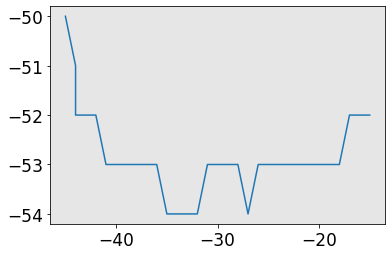

In [84]:
block_df_selected = block_df[block_df['Flag']==87]
#block_df

plt.plot(block_df_selected.Longitude.values,block_df_selected.Latitude.values)

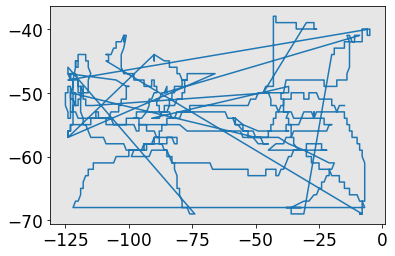

In [79]:
plt.plot(block_df.Longitude.values,block_df.Latitude.values)

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '


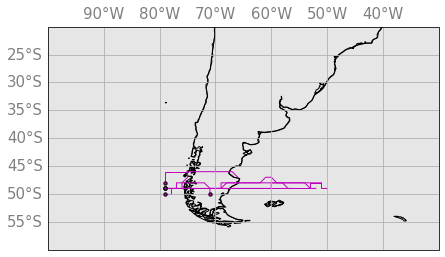

In [93]:
# plotting blocking track (center of mass) and genesis
f, ax = plt.subplots(1, 1, figsize=(7,5), subplot_kw=dict(projection=crs.PlateCarree()))
ax.set_extent([-100, -30, -20, -60], crs=crs.PlateCarree()); ax.coastlines()
gl = ax.gridlines()#color="gray",alpha=0.5, linestyle='--',draw_labels=True,linewidth=2)
ax.coastlines(resolution='110m')
gl.xlines = True
gl.ylines = True

gl.xlabels_top = True
gl.ylabels_right = False
gl.ylabels_left = True
gl.ylabels_bottom = True

gl.xformatter = LONGITUDE_FORMATTER
gl.yformatter = LATITUDE_FORMATTER
gl.xlabel_style = {'size': 15, 'color': 'gray'}#, 'weight': 'bold'}
gl.ylabel_style = {'size': 15, 'color': 'gray'}#, 'weight': 'bold'}


#need to split each blocking track due to longitude wrapping (jumping at map edge)
for bid in np.unique(np.asarray(block_df['Flag'])): #select blocking id
    lons = np.asarray(block_df['Longitude'].iloc[np.where(block_df['Flag']==bid)])
    lats = np.asarray(block_df['Latitude'].iloc[np.where(block_df['Flag']==bid)])
    intensity = np.asarray(block_df['Intensity'].iloc[np.where(block_df['Flag']==bid)])

    """
    # cosmetic: sometimes there is a gap near map edge where track is split:
    #lons[lons >= 355] = 359.9
    #lons[lons <= 3] = 0.1
    segment = np.vstack((lons,lats))

    #move longitude into the map region and split if longitude jumps by more than "threshold"
    lon0 = 0 #center of map
    bleft = lon0-0.
    bright = lon0+360
    segment[0,segment[0]> bright] -= 360
    segment[0,segment[0]< bleft]  += 360
    threshold = 180  # CHANGE HERE
    isplit = np.nonzero(np.abs(np.diff(segment[0])) > threshold)[0]
    subsegs = np.split(segment,isplit+1,axis=+1)

    #plot the tracks
    for seg in subsegs:
        x,y = seg[0],seg[1]
        ax.plot(x ,y,c = 'm',linewidth=1, transform=crs.PlateCarree())
    #plot the starting points
    ax.scatter(lons[0],lats[0],s=11,c='m', zorder=10, edgecolor='black', transform=crs.PlateCarree())
    """
    ax.plot( lons, lats,c = 'm' ,linewidth=1, transform=crs.PlateCarree())
    ax.scatter(lons[0],lats[0],s=11,c='m', zorder=10, edgecolor='black', transform=crs.PlateCarree())

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '


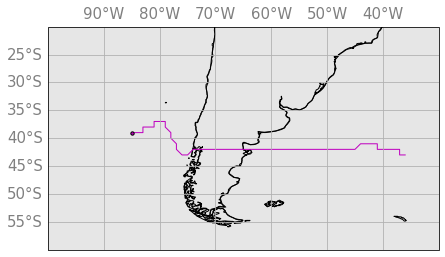

In [21]:
# plotting blocking track (center of mass) and genesis
f, ax = plt.subplots(1, 1, figsize=(7,5), subplot_kw=dict(projection=crs.PlateCarree()))
ax.set_extent([-100, -30, -20, -60], crs=crs.PlateCarree()); ax.coastlines()
gl = ax.gridlines()#color="gray",alpha=0.5, linestyle='--',draw_labels=True,linewidth=2)
ax.coastlines(resolution='110m')
gl.xlines = True
gl.ylines = True

gl.xlabels_top = True
gl.ylabels_right = False
gl.ylabels_left = True
gl.ylabels_bottom = True

gl.xformatter = LONGITUDE_FORMATTER
gl.yformatter = LATITUDE_FORMATTER
gl.xlabel_style = {'size': 15, 'color': 'gray'}#, 'weight': 'bold'}
gl.ylabel_style = {'size': 15, 'color': 'gray'}#, 'weight': 'bold'}


#need to split each blocking track due to longitude wrapping (jumping at map edge)
bid=2
lons = np.asarray(block_df['Longitude'].iloc[np.where(block_df['Flag']==bid)])
lats = np.asarray(block_df['Latitude'].iloc[np.where(block_df['Flag']==bid)])

"""
# cosmetic: sometimes there is a gap near map edge where track is split:
#lons[lons >= 355] = 359.9
#lons[lons <= 3] = 0.1
segment = np.vstack((lons,lats))

#move longitude into the map region and split if longitude jumps by more than "threshold"
lon0 = 0 #center of map
bleft = lon0-0.
bright = lon0+360
segment[0,segment[0]> bright] -= 360
segment[0,segment[0]< bleft]  += 360
threshold = 180  # CHANGE HERE
isplit = np.nonzero(np.abs(np.diff(segment[0])) > threshold)[0]
subsegs = np.split(segment,isplit+1,axis=+1)

#plot the tracks
for seg in subsegs:
    x,y = seg[0],seg[1]
    ax.plot(x ,y,c = 'm',linewidth=1, transform=crs.PlateCarree())
#plot the starting points
ax.scatter(lons[0],lats[0],s=11,c='m', zorder=10, edgecolor='black', transform=crs.PlateCarree())
"""
ax.plot( lons, lats,c = 'm',linewidth=1, transform=crs.PlateCarree())
ax.scatter(lons[0],lats[0],s=11,c='m', zorder=10, edgecolor='black', transform=crs.PlateCarree())

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '


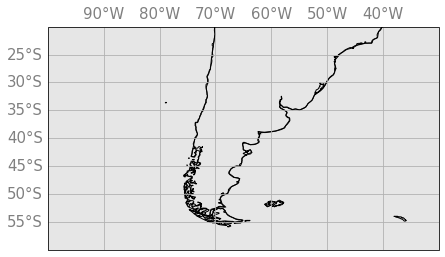

interactive(children=(IntSlider(value=1, description='x', max=32, min=1), Output()), _dom_classes=('widget-int…

In [14]:
from ipywidgets import interact, interactive, fixed, interact_manual
import ipywidgets as widgets

fig, ax = plt.subplots(1, 1, figsize=(7,5), subplot_kw=dict(projection=crs.PlateCarree()))
ax.set_extent([-100, -30, -20, -60], crs=crs.PlateCarree()); ax.coastlines()
gl = ax.gridlines()#color="gray",alpha=0.5, linestyle='--',draw_labels=True,linewidth=2)
ax.coastlines(resolution='110m')
gl.xlines = True
gl.ylines = True

gl.xlabels_top = True
gl.ylabels_right = False
gl.ylabels_left = True
gl.ylabels_bottom = True

gl.xformatter = LONGITUDE_FORMATTER
gl.yformatter = LATITUDE_FORMATTER
gl.xlabel_style = {'size': 15, 'color': 'gray'}#, 'weight': 'bold'}
gl.ylabel_style = {'size': 15, 'color': 'gray'}#, 'weight': 'bold'}


def f(x):
    
    
    lons = np.asarray(block_df['Longitude'].iloc[np.where(block_df['Flag']==x)])
    lats = np.asarray(block_df['Latitude'].iloc[np.where(block_df['Flag']==x)])

    """
    # cosmetic: sometimes there is a gap near map edge where track is split:
    #lons[lons >= 355] = 359.9
    #lons[lons <= 3] = 0.1
    segment = np.vstack((lons,lats))

    #move longitude into the map region and split if longitude jumps by more than "threshold"
    lon0 = 0 #center of map
    bleft = lon0-0.
    bright = lon0+360
    segment[0,segment[0]> bright] -= 360
    segment[0,segment[0]< bleft]  += 360
    threshold = 180  # CHANGE HERE
    isplit = np.nonzero(np.abs(np.diff(segment[0])) > threshold)[0]
    subsegs = np.split(segment,isplit+1,axis=+1)

    #plot the tracks
    for seg in subsegs:
        x,y = seg[0],seg[1]
        ax.plot(x ,y,c = 'm',linewidth=1, transform=crs.PlateCarree())
    #plot the starting points
    ax.scatter(lons[0],lats[0],s=11,c='m', zorder=10, edgecolor='black', transform=crs.PlateCarree())
    """
    ax.plot( lons, lats,c = 'm',linewidth=1, transform=crs.PlateCarree())
    #ax.scatter(lons[0],lats[0],s=11,c='m', zorder=10, edgecolor='black', transform=crs.PlateCarree())
    
    
interact(f, x=widgets.IntSlider(min=1, max=32, step=1, value=1));

## Detect Jet stream using jsmetrics

In [ ]:
# Detect jet stream
import jsmetrics

# load windspeed data with u- and v- component wind.
u_v_filenames = '/glade/collections/rda/data/ds633.0/e5.oper.an.pl/199409/e5.oper.an.pl.128_13[1-2]_*.1994090[6-8]00_1994090[6-8]23.nc'
print('u v files are: ',u_v_filenames)
uv_data = xr.open_mfdataset(u_v_filenames)
#print(uv_data)
uv_data = uv_data.rename({"U": "ua", "V": "va","latitude": "lat", "longitude": "lon","level":"plev"}).sel(plev=300)
#uv_data = uv_data.rename_dims({"latitude": "lat", "longitude": "lon","level":"plev"})#.sel(plev=300)
print(uv_data)
# run Kuang et al. 2014 metric
k14 = jsmetrics.jetstream_metrics.woollings_et_al_2010(uv_data)
k14

In [ ]:

# perform calculations on a sub-domain to speed things up
west_lon=275
east_lon=325  # -35
south_lat=-45.0
north_lat=-15.0

DIRECTORY_PRES    = '/glade/collections/rda/data/ds633.0/e5.oper.an.pl/'
DIRECTORY_FLUX    = '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/'

u_filenames  = [DIRECTORY_PRES+TIME.strftime('%Y%m')+'/'+'e5.oper.an.pl.128_131_u.ll025uv.'+TIME.strftime('%Y%m%d00_%Y%m%d23.nc') for TIME in era5_time_range]
v_filenames  = [DIRECTORY_PRES+TIME.strftime('%Y%m')+'/'+'e5.oper.an.pl.128_132_v.ll025uv.'+TIME.strftime('%Y%m%d00_%Y%m%d23.nc') for TIME in era5_time_range]
pv_filenames = [DIRECTORY_PRES+TIME.strftime('%Y%m')+'/'+'e5.oper.an.pl.128_060_pv.ll025sc.'+TIME.strftime('%Y%m%d00_%Y%m%d23.nc') for TIME in era5_time_range]
#z_filenames =  [DIRECTORY_PRES+TIME.strftime('%Y%m')+'/'+'e5.oper.an.pl.128_129_z.ll025sc.'+TIME.strftime('%Y%m%d00_%Y%m%d23.nc') for TIME in era5_time_range]
clwc_filenames = [DIRECTORY_PRES+TIME.strftime('%Y%m')+'/'+'e5.oper.an.pl.128_246_clwc.ll025sc.'+TIME.strftime('%Y%m%d00_%Y%m%d23.nc') for TIME in era5_time_range]
ciwc_filenames = [DIRECTORY_PRES+TIME.strftime('%Y%m')+'/'+'e5.oper.an.pl.128_247_ciwc.ll025sc.'+TIME.strftime('%Y%m%d00_%Y%m%d23.nc') for TIME in era5_time_range]
cswc_filenames = [DIRECTORY_PRES+TIME.strftime('%Y%m')+'/'+'e5.oper.an.pl.128_076_cswc.ll025sc.'+TIME.strftime('%Y%m%d00_%Y%m%d23.nc') for TIME in era5_time_range]
#crwc_filenames = [DIRECTORY+TIME.strftime('%Y%m')+'/'+'e5.oper.an.pl.128_075_crwc.ll025sc.'+TIME.strftime('%Y%m%d00_%Y%m%d23.nc') for TIME in era5_time_range]
#mtpr_filenames = sorted(glob.glob(DIRECTORY_FLUX+TIME.strftime('%Y%m')+'/e5.oper.fc.sfc.meanflux.235_055_mtpr*.nc')
prev_month = era5_time_range[0]-pd.Timedelta(days=20)
mtpr_filename_prev_month = sorted(glob.glob(DIRECTORY_FLUX+prev_month.strftime('%Y%m')+'/e5.oper.fc.sfc.meanflux.235_055_mtpr*.nc'))[1]
mtpr_filenames = [mtpr_filename_prev_month] + sorted(glob.glob(DIRECTORY_FLUX+era5_time_range[0].strftime('%Y%m')+'/e5.oper.fc.sfc.meanflux.235_055_mtpr*.nc'))
u_filenames

In [ ]:
# Same as above but using mfdataset
era5_time_range = pd.date_range(start='2019-04-01', end='2019-04-30', freq='1D')

# perform calculations on a sub-domain to speed things up
west_lon=275
east_lon=325  # -35
south_lat=-45.0
north_lat=-15.0

DIRECTORY_PRES    = '/glade/collections/rda/data/ds633.0/e5.oper.an.pl/'
DIRECTORY_FLUX    = '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/'

u_filenames  = [DIRECTORY_PRES+TIME.strftime('%Y%m')+'/'+'e5.oper.an.pl.128_131_u.ll025uv.'+TIME.strftime('%Y%m%d00_%Y%m%d23.nc') for TIME in era5_time_range]
v_filenames  = [DIRECTORY_PRES+TIME.strftime('%Y%m')+'/'+'e5.oper.an.pl.128_132_v.ll025uv.'+TIME.strftime('%Y%m%d00_%Y%m%d23.nc') for TIME in era5_time_range]
pv_filenames = [DIRECTORY_PRES+TIME.strftime('%Y%m')+'/'+'e5.oper.an.pl.128_060_pv.ll025sc.'+TIME.strftime('%Y%m%d00_%Y%m%d23.nc') for TIME in era5_time_range]
z_filenames =  [DIRECTORY_PRES+TIME.strftime('%Y%m')+'/'+'e5.oper.an.pl.128_129_z.ll025sc.'+TIME.strftime('%Y%m%d00_%Y%m%d23.nc') for TIME in era5_time_range]
clwc_filenames = [DIRECTORY_PRES+TIME.strftime('%Y%m')+'/'+'e5.oper.an.pl.128_246_clwc.ll025sc.'+TIME.strftime('%Y%m%d00_%Y%m%d23.nc') for TIME in era5_time_range]
ciwc_filenames = [DIRECTORY_PRES+TIME.strftime('%Y%m')+'/'+'e5.oper.an.pl.128_247_ciwc.ll025sc.'+TIME.strftime('%Y%m%d00_%Y%m%d23.nc') for TIME in era5_time_range]
cswc_filenames = [DIRECTORY_PRES+TIME.strftime('%Y%m')+'/'+'e5.oper.an.pl.128_076_cswc.ll025sc.'+TIME.strftime('%Y%m%d00_%Y%m%d23.nc') for TIME in era5_time_range]
#crwc_filenames = [DIRECTORY+TIME.strftime('%Y%m')+'/'+'e5.oper.an.pl.128_075_crwc.ll025sc.'+TIME.strftime('%Y%m%d00_%Y%m%d23.nc') for TIME in era5_time_range]
#mtpr_filenames = sorted(glob.glob(DIRECTORY_FLUX+TIME.strftime('%Y%m')+'/e5.oper.fc.sfc.meanflux.235_055_mtpr*.nc')
prev_month = era5_time_range[0]-pd.Timedelta(days=20)
mtpr_filename_prev_month = sorted(glob.glob(DIRECTORY_FLUX+prev_month.strftime('%Y%m')+'/e5.oper.fc.sfc.meanflux.235_055_mtpr*.nc'))[1]
mtpr_filenames = [mtpr_filename_prev_month] + sorted(glob.glob(DIRECTORY_FLUX+era5_time_range[0].strftime('%Y%m')+'/e5.oper.fc.sfc.meanflux.235_055_mtpr*.nc'))

#[DIRECTORY_FLUX+TIME.strftime('%Y%m')+'/'+'e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.'+TIME.strftime('%Y%m0106_%Y%m1606.nc') for TIME in era5_time_range]

#/glade/collections/rda/data/ds633.0/e5.oper.an.pl/201811>
#print(u_filenames) 



In [ ]:
from windspharm.xarray import VectorWind


def non_time_coords(ds):
    return [v for v in ds.data_vars if 'time' not in ds[v].dims]

def drop_non_essential_vars_pop(ds):
    return ds.drop(non_time_coords(ds))

#import time
#start_time = time.time()
print(len(u_filenames))
#xr.open_mfdataset('*.nc', combine='by_coords', preprocess=drop_all_coords)
%timeit uwnd_xr1  = xr.open_mfdataset(u_filenames, preprocess=drop_non_essential_vars_pop)
vwnd_xr  = xr.open_mfdataset(v_filenames, preprocess=drop_non_essential_vars_pop)

#lons = uwnd_xr.longitude.values
#lats = uwnd_xr.latitude.values

# uwnd = uwnd_xr['U'].sel(level=300).values
# vwnd = vwnd_xr['V'].sel(level=300).values

# uwnd, uwnd_info = prep_data(uwnd, 'tyx')
# vwnd, vwnd_info = prep_data(vwnd, 'tyx')
# print("--- %s seconds ---" % (time.time() - start_time))

In [ ]:
u_vals = uwnd_xr.U 
v_vals = vwnd_xr.V

In [ ]:
u_vals

In [ ]:
for ii in range(len(u_vals)):
    w = VectorWind(u_vals[ii,20,:,:], v_vals[ii,20,:,:])
    #print(w)
    UCHI, VCHI = w.irrotationalcomponent()
    print(ii)

In [ ]:
#from numba import jit

#@jit(nopython=True)
def use_dawsonfunc(UWND,VWND):
    w = VectorWind(UWND, VWND)
    print(w)
    UCHI, VCHI = w.irrotationalcomponent()
    return UCHI, VCHI

print(np.shape(use_dawsonfunc(uwnd,vwnd)))

In [ ]:


import csv
time_period_csv=era5_time_range[0].strftime('%Y-%m-%d_%H-%M')+'-'+\
                era5_time_range[-1].strftime('%Y-%m-%d_%H-%M')
print('time period is : ',time_period_csv)
#csv_file_name='ERA5_time_series_va_meridional_index_ulpvadvirrot_'+time_period_csv+'.csv'
#print('csv_file_name:  ',csv_file_name)


def non_time_coords(ds):
    return [v for v in ds.data_vars if 'time' not in ds[v].dims]

def drop_non_essential_vars_pop(ds):
    return ds.drop(non_time_coords(ds))

#xr.open_mfdataset('*.nc', combine='by_coords', preprocess=drop_all_coords)
uwnd_xr  = xr.open_mfdataset(u_filenames, preprocess=drop_non_essential_vars_pop)
vwnd_xr  = xr.open_mfdataset(v_filenames, preprocess=drop_non_essential_vars_pop)
pv_xr    = xr.open_mfdataset(pv_filenames, preprocess=drop_non_essential_vars_pop)
z_xr     = xr.open_mfdataset(z_filenames, preprocess=drop_non_essential_vars_pop)


clwc_xr  = xr.open_mfdataset(clwc_filenames, preprocess=drop_non_essential_vars_pop)
ciwc_xr  = xr.open_mfdataset(ciwc_filenames, preprocess=drop_non_essential_vars_pop)
cswc_xr  = xr.open_mfdataset(cswc_filenames, preprocess=drop_non_essential_vars_pop)

#mtpr_xr  = xr.open_mfdataset(mtpr_filenames, preprocess=drop_non_essential_vars_pop)
print(cswc_xr)
# get winds at upper levels
uwnd_levs = uwnd_xr['U'].sel(level=slice(200,300))
vwnd_levs = vwnd_xr['V'].sel(level=slice(200,300))
pv_levs   =  pv_xr['PV'].sel(level=slice(200,300))

# perform Helmholtz decomposition and get 
print('    performing Helmholtz decomposition...')
w_levs    = VectorWind(uwnd_levs, vwnd_levs)
uchi_levs, vchi_levs = w_levs.irrotationalcomponent()
print('helmholtz decomposition done!!!')
#uchi = uchi_levs.mean(dim='level',keep_attrs=True)
#vchi = vchi_levs.mean(dim='level',keep_attrs=True)
uchi_levs_subset = uchi_levs.sel(latitude=np.arange(south_lat,north_lat,0.25),\
                    longitude=np.arange(west_lon,east_lon,0.25))
vchi_levs_subset = vchi_levs.sel(latitude=np.arange(south_lat,north_lat,0.25),\
                    longitude=np.arange(west_lon,east_lon,0.25))
pv_levs_subset   = pv_levs  .sel(latitude=np.arange(south_lat,north_lat,0.25),\
                    longitude=np.arange(west_lon,east_lon,0.25))

uchi_layer_avgd = uchi_levs_subset.mean(dim='level',keep_attrs=True)
vchi_layer_avgd = vchi_levs_subset.mean(dim='level',keep_attrs=True)

pv_adv_mean = mpcalc.advection(pv_levs_subset, u=uchi_levs_subset, v=vchi_levs_subset).mean(dim='level',keep_attrs=True)#,dx=dx.magnitude, dy=dy.magnitude)*3600.
pv_adv_mean.values=pv_adv_mean.values*3600.0*10**6

print('pv mean advection array : ',pv_adv_mean)

# SALLJ magnitude calculation
uwnd_low = uwnd_xr['U'].sel(level=slice(750,900),latitude=np.arange(-35,-25,0.25),\
                    longitude=np.arange(295,300,0.25)).mean(dim='level',skipna = True)
vwnd_low = vwnd_xr['V'].sel(level=slice(750,900),latitude=np.arange(-35,-25,0.25),\
                    longitude=np.arange(295,300,0.25)).mean(dim='level',skipna = True)
sallj_mag = np.sqrt((uwnd_low**2 + vwnd_low**2).mean(skipna = True).values)

print('sallj magnitude array :',sallj_mag)

# area-averaged pv_adv_irrot calculation
pvadv_irrot = pv_adv_mean.sel(latitude=np.arange(-40,-20,0.25),\
                             longitude=np.arange(295,310,0.25)).mean(skipna = True).values
print('mean pv advection time series : ',pvadv_irrot)
print('\n------------------\n')


#date sallj pvadv rr_area_ rr_max MI_area_wgtd area_jet jet_max


In [ ]:
extension = 'csv'
all_filenames = [i for i in glob.glob('ERA5_time_series_va_meridional_index_ulpv*.{}'.format(extension))]

#print(all_filenames)

combined_csv = pd.concat([pd.read_csv(f,header=None,delimiter='\t',names=['date','sallj_mag','pvadv','rrmax','MI','maxjet'],index_col='date',parse_dates=True) for f in all_filenames ])

final_df = combined_csv.sort_values(by='date')

print(len(final_df))
final_df
#final_df = final_df[final_df['UL_PV_ageo_adv'] > 0.0]

In [ ]:
# using percentiles
final_df_vhigh_pvadv_vhigh_mi_pc = final_df[(final_df['pvadv']>(final_df['pvadv'].quantile(.90))) & \
                                            (final_df['MI']   >(final_df['MI']   .quantile(.90)))]

final_df_vhigh_pvadv_vlow_mi_pc = final_df[(final_df['pvadv']>(final_df['pvadv'].quantile(.90))) & \
                                            (final_df['MI']  <(final_df['MI']   .quantile(.10)))]

final_df_vlow_pvadv_vhigh_mi_pc = final_df[(final_df['pvadv']<(final_df['pvadv'].quantile(.10))) & \
                                            (final_df['MI']  >(final_df['MI']   .quantile(.90)))]

final_df_high_pvadv_high_sallj_pc = final_df[(final_df['pvadv']>(final_df['pvadv'].quantile(.80))) & \
                                             (final_df['sallj_mag']   >(final_df['sallj_mag']   .quantile(.80)))]

print(final_df_high_pvadv_high_sallj_pc.index)

In [ ]:
from dask.distributed import Client
client = Client(n_workers=2, threads_per_worker=2, memory_limit='1GB')

In [ ]:
levs_850hgt = np.arange(1000,3500,10)
levs_500hgt = np.arange(4000,6500,40)
levs_300hgt = np.arange(8000,10000,40)

levs_t2     = np.arange(285,316,1)
levs_slp    = np.arange(980,1025,3)
levs_ctt    = np.arange(-40,21,1)

levs_850wsp = np.arange(1,21,1)
levs_500wsp = np.arange(10,61,1)
levs_300wsp = np.arange(10,71,1)

# perform calculations on a sub-domain to speed things up
west_lon=275
east_lon=325  # -35
south_lat=-45.0
north_lat=-15.0

terr=xr.open_dataset("/glade/u/home/isingh9/jupyter_nbks/etopo1.nc")
terr['Band1'].values[terr['Band1'].values < 0.]=np.nan


DIRECTORY_PRES    = '/glade/collections/rda/data/ds633.0/e5.oper.an.pl/'
DIRECTORY_FLUX    = '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/'
DIRECTORY_SFC    = '/glade/collections/rda/data/ds633.0/e5.oper.an.sfc/'

def create_composite_ERA5_times_surface(TIMES):
    #u_filenames    = [DIRECTORY_PRES+TIME.strftime('%Y%m')+'/'+'e5.oper.an.pl.128_131_u.ll025uv.'+TIME.strftime('%Y%m%d00_%Y%m%d23.nc') for TIME in TIMES]
    #v_filenames    = [DIRECTORY_PRES+TIME.strftime('%Y%m')+'/'+'e5.oper.an.pl.128_132_v.ll025uv.'+TIME.strftime('%Y%m%d00_%Y%m%d23.nc') for TIME in TIMES]
    #pv_filenames   = [DIRECTORY_PRES+TIME.strftime('%Y%m')+'/'+'e5.oper.an.pl.128_060_pv.ll025sc.'+TIME.strftime('%Y%m%d00_%Y%m%d23.nc') for TIME in TIMES]
    #z_filenames    = [DIRECTORY_PRES+TIME.strftime('%Y%m')+'/'+'e5.oper.an.pl.128_129_z.ll025sc.'+TIME.strftime('%Y%m%d00_%Y%m%d23.nc') for TIME in TIMES]
    #clwc_filenames = [DIRECTORY_PRES+TIME.strftime('%Y%m')+'/'+'e5.oper.an.pl.128_246_clwc.ll025sc.'+TIME.strftime('%Y%m%d00_%Y%m%d23.nc') for TIME in TIMES]
    #ciwc_filenames = [DIRECTORY_PRES+TIME.strftime('%Y%m')+'/'+'e5.oper.an.pl.128_247_ciwc.ll025sc.'+TIME.strftime('%Y%m%d00_%Y%m%d23.nc') for TIME in TIMES]
    #cswc_filenames = [DIRECTORY_PRES+TIME.strftime('%Y%m')+'/'+'e5.oper.an.pl.128_076_cswc.ll025sc.'+TIME.strftime('%Y%m%d00_%Y%m%d23.nc') for TIME in TIMES]
    t2_filenames   = sorted([*set([(glob.glob(DIRECTORY_SFC+toim.strftime('%Y%m')+'/e5.oper.an.sfc.128_167*.nc'))[0] for toim in TIMES])])
    u10_filenames  = sorted([*set([(glob.glob(DIRECTORY_SFC+toim.strftime('%Y%m')+'/e5.oper.an.sfc.128_165*.nc'))[0] for toim in TIMES])])
    v10_filenames  = sorted([*set([(glob.glob(DIRECTORY_SFC+toim.strftime('%Y%m')+'/e5.oper.an.sfc.128_166*.nc'))[0] for toim in TIMES])])
    slp_filenames  = sorted([*set([(glob.glob(DIRECTORY_SFC+toim.strftime('%Y%m')+'/e5.oper.an.sfc.128_151*.nc'))[0] for toim in TIMES])]) 
    
#     prev_month = TIMES.min() - pd.Timedelta(days=20)
#     last_date  = TIMES.max()
#     date_range = pd.date_range(TIMES.min(),TIMES.max() + pd.Timedelta(days=20),freq='m')
#     mtpr_filename_prev_month = sorted(glob.glob(DIRECTORY_FLUX+prev_month.strftime('%Y%m')+'/e5.oper.fc.sfc.meanflux.235_055_mtpr*.nc'))[1]
#     mtpr_filenames = []
#     for tim in date_range:
#         temp_files = sorted(glob.glob(DIRECTORY_FLUX+tim.strftime('%Y%m')+'/e5.oper.fc.sfc.meanflux.235_055_mtpr*.nc'))
#         for ii in range(len(temp_files)):
#             mtpr_filenames.append(temp_files[ii])
#     mtpr_filenames = [mtpr_filename_prev_month] + mtpr_filenames
    
    print('t2  filenames: ',t2_filenames)
    print('u10 filenames: ',u10_filenames)
    print('v10 filenames: ',v10_filenames)
    print('slp filenames: ',slp_filenames)
    
    
    #print(xr.open_mfdataset(t2_filenames))
    # figure 1 : surface plot
    

    def non_time_coords(ds):
        return [v for v in ds.data_vars if 'time' not in ds[v].dims]

    def drop_non_essential_vars_pop(ds):
        return ds.drop(non_time_coords(ds))

    #xr.open_mfdataset('*.nc', combine='by_coords', preprocess=drop_all_coords)
    t2  = xr.open_mfdataset(t2_filenames, chunks={'time': 1},\
                       preprocess=drop_non_essential_vars_pop, )['VAR_2T'].sel(time=TIMES,latitude=np.arange(south_lat,north_lat,0.25),\
                                longitude=np.arange(west_lon,east_lon,0.25)).mean(dim='time',keep_attrs=True)
    slp = xr.open_mfdataset(slp_filenames, chunks={'time': 1},\
                       preprocess=drop_non_essential_vars_pop)['MSL'].sel(time=TIMES,latitude=np.arange(south_lat,north_lat,0.25),\
                                longitude=np.arange(west_lon,east_lon,0.25)).mean(dim='time',keep_attrs=True)
    u10 = xr.open_mfdataset(u10_filenames, chunks={'time': 1},\
                       preprocess=drop_non_essential_vars_pop)['VAR_10U'].sel(time=TIMES,latitude=np.arange(south_lat,north_lat,0.25),\
                                longitude=np.arange(west_lon,east_lon,0.25)).mean(dim='time',keep_attrs=True)
    v10 = xr.open_mfdataset(v10_filenames, chunks={'time': 1},\
                       preprocess=drop_non_essential_vars_pop)['VAR_10V'].sel(time=TIMES,latitude=np.arange(south_lat,north_lat,0.25),\
                                longitude=np.arange(west_lon,east_lon,0.25)).mean(dim='time',keep_attrs=True)
    
    #decode_times=False
    print(t2)
    
    lats = t2.latitude.values
    lons = t2.longitude.values
    
    fig = plt.figure(figsize=(16,14)) # Create a figure (for two subplots)
    ax1 = fig.add_subplot(1, 1, 1, projection=crs.PlateCarree())
    ax1.set_extent([-85, -35, -45, -15], crs=crs.PlateCarree())

    C421 = ax1.contour(lons ,lats, slp.values/100.,transform=crs.PlateCarree(),levels=levs_slp,colors='k',linestyle='-',linewidth=0.4)
    plt.clabel(C421, inline=1, fontsize=10, fmt="%i")

    C420 = ax1.contourf(lons ,lats, t2.values,transform=crs.PlateCarree(),levels=levs_t2,cmap=cma4,extend='both')

    winds_thin_x = 5
    C01=ax1.barbs(lons[::winds_thin_x],lats[::winds_thin_x],u10.values[::winds_thin_x,::winds_thin_x],v10.values[::winds_thin_x,::winds_thin_x],linewidth=0.9, length=6, pivot='middle',transform=crs.PlateCarree(),flip_barb=True)

    topo_cont1=ax1.contour(terr.lon.values,terr.lat.values,terr.Band1.values, levels=[1000], \
                   colors="saddlebrown",linewidths=0.7,transform=crs.PlateCarree())

    gl = ax1.gridlines()#color="gray",alpha=0.5, linestyle='--',draw_labels=True,linewidth=2)
    ax1.coastlines(resolution='110m')
    gl.xlines = True
    gl.ylines = True

    gl.xlabels_top = True
    gl.ylabels_right = False
    gl.ylabels_left = True
    gl.ylabels_bottom = True

    gl.xformatter = LONGITUDE_FORMATTER
    gl.yformatter = LATITUDE_FORMATTER
    gl.xlabel_style = {'size': 15, 'color': 'gray'}#, 'weight': 'bold'}
    gl.ylabel_style = {'size': 15, 'color': 'gray'}#, 'weight': 'bold'}

    composite_name = 'high_pv_high_mi'
    plt.title('ERA5 composite High PV adv irrot and high MI ('+str(len(TIMES))+' timeteps)\n'+'2-m Temperature (deg C) and SLP (hPa)')
    cbar = fig.colorbar(C420,  orientation = 'horizontal',fraction=0.09,shrink=0.6,aspect=30,pad=0.02) #cax=cb_ax,
    plt.tight_layout()
    filename='ERA5 composite_t2_slp_uv10_'+composite_name+'.png'
    #print(filename)
    #plt.savefig(filename,dpi=200)
 
create_composite_ERA5_times(final_df_high_pvadv_high_sallj_pc.index)

In [ ]:

wrf_files=sorted(glob.glob(wrf_directory+'/*.nc'))
#print(wrf_files)

################################################# match GOES and WRF files ########################
import os

#wrf_directory1='/glade/u/home/isingh9/scratch/cu_scheme_ON_latent_heat_on_20km/'
wrf_directory1='/glade/u/home/isingh9/scratch/WRF_4.3_run_theta_tend_template/LHT_ON_70_vertlevs_maxdom2/'
filelist = sorted(glob.glob(wrf_directory1+'wrfout_d01_2018-11-09_*:00:00'))
#print((filelist))

wrf_times1=[]

for ff in filelist:
    #print(ff)
    wrf_times1.append(pd.to_datetime(getvar(Dataset(ff),'times').values))

#wrf_directory2 = '/glade/u/home/isingh9/scratch/cu_scheme_OFF_latent_heat_off_20km/'
wrf_directory2 = '/glade/u/home/isingh9/scratch/WRF_4.3_run_theta_tend_template/LHT_OFF_70_vertlevs_maxdom2/'
wrf_files=sorted(glob.glob(wrf_directory2+'wrfout_d01_2018-11-09_*:00:00'))
#print(wrf_files)

In [ ]:
ii = 0 

for wrf_file in wrf_files:
    nc_file = Dataset(wrf_file)
    wrf_time = pd.to_datetime(getvar(nc_file,'times').values)
    print('time in WRF file is',wrf_time)
    closest_dict = { abs(wrf_time - wrf_time1) : wrf_time1 for wrf_time1 in wrf_times1}
    # extracting minimum key using min()
    res = closest_dict[min(closest_dict.keys())]
    print("Nearest time from WRF1 list : " + str(res))
    
    corresp_wrf1_file = filelist[list(closest_dict.values()).index(res)]
    print('corresponding WRF1 file is: ',corresp_wrf1_file)
    
    plot_2_WRF_runs_comparison(corresp_wrf1_file,wrf_file)
    print('--------------')
#################################################################################################

In [ ]:
ddd = Dataset('/glade/u/home/isingh9/scratch/WRF_4.3.3_run_ERA5_run1/wrfout_d01_2018-11-09_01:00:00')
print(getvar(ddd,'T2').description)

In [ ]:
pd.to_datetime(ddd.XTIME.values)

In [ ]:
import nclcmaps as ncm

# MCS climatology in South America (TRMM+Feng)

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_6947/3383671009.py:33: UserWarning: 

The `bw` parameter is deprecated in favor of `bw_method` and `bw_adjust`.
Setting `bw_method

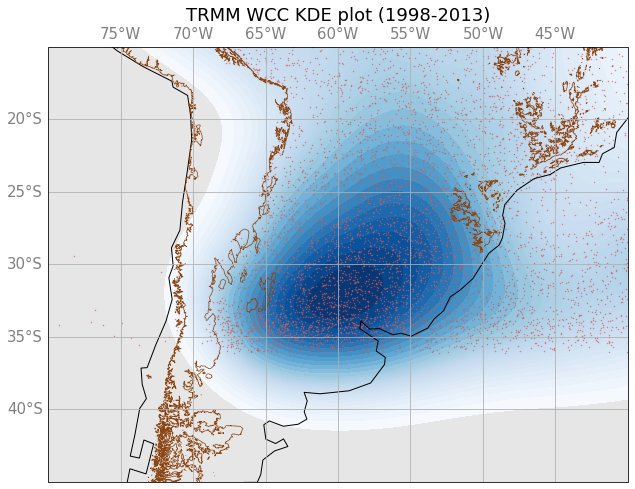

In [45]:
import seaborn as sns


terr=xr.open_dataset("/glade/u/home/isingh9/jupyter_nbks/etopo1.nc")
terr['Band1'].values[terr['Band1'].values < 0.]=np.nan

f, ax = plt.subplots(1, 1, figsize=(11,8), subplot_kw=dict(projection=crs.PlateCarree()))
ax.set_extent([-80, -40, -15, -45], crs=crs.PlateCarree())
gl = ax.gridlines()#color="gray",alpha=0.5, linestyle='--',draw_labels=True,linewidth=2)
ax.coastlines(resolution='110m')
gl.xlines = True
gl.ylines = True

gl.xlabels_top = True
gl.ylabels_right = False
gl.ylabels_left = True
gl.ylabels_bottom = True

gl.xformatter = LONGITUDE_FORMATTER
gl.yformatter = LATITUDE_FORMATTER
gl.xlabel_style = {'size': 15, 'color': 'gray'}#, 'weight': 'bold'}
gl.ylabel_style = {'size': 15, 'color': 'gray'}#, 'weight': 'bold'}

plt.title('tracks')

#for ii in range(len(ds.tracks)):
#    ax.plot(ds.meanlon.isel(tracks=ii),ds.meanlat.isel(tracks=ii),c='k',linewidth=4.25)
#    ax.plot(ds.meanlon.isel(tracks=ii),ds.meanlat.isel(tracks=ii),c='green',  linewidth=3.0)
#    ii = ii  + 1
dd=pd.read_csv('TRMM_WCC_data_1998-2013_SONDJFM.csv')
#print(dd)
plt.title('TRMM WCC KDE plot (1998-2013)')
sns.kdeplot(data=dd,x="core_lon",y="core_lat", cmap="Blues",bw='scott',levels=40,shade=True, shade_lowest=False,ax=ax)
ax.scatter(dd.core_lon,dd.core_lat,s=0.2,c='indianred',alpha=0.8)#, zorder=, edgecolor='black', transform=crs.PlateCarree())
topo_cont1=ax.contour(terr.lon.values,terr.lat.values,terr.Band1.values, levels=np.array([1000.]), 
                       colors="saddlebrown",linewidths=0.7,transform=crs.PlateCarree())
plt.savefig('TRMM_MCS_WCC_density_1998-2013.png',dpi=200)

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_6947/2610828101.py:33: UserWarning: 

The `bw` parameter is deprecated in favor of `bw_method` and `bw_adjust`.
Setting `bw_method

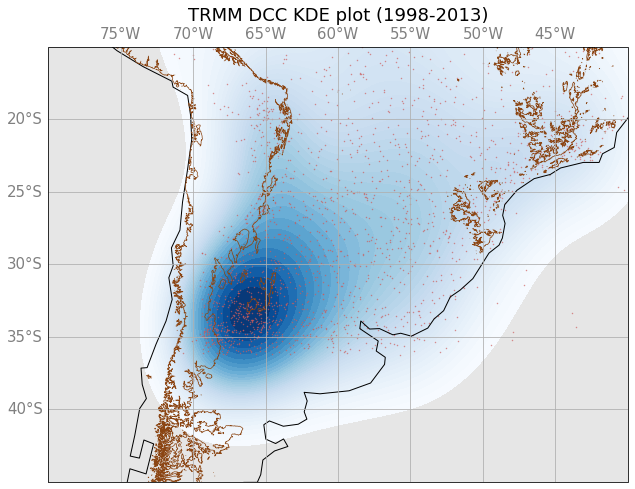

In [46]:
import seaborn as sns


terr=xr.open_dataset("/glade/u/home/isingh9/jupyter_nbks/etopo1.nc")
terr['Band1'].values[terr['Band1'].values < 0.]=np.nan

f, ax = plt.subplots(1, 1, figsize=(11,8), subplot_kw=dict(projection=crs.PlateCarree()))
ax.set_extent([-80, -40, -15, -45], crs=crs.PlateCarree())
gl = ax.gridlines()#color="gray",alpha=0.5, linestyle='--',draw_labels=True,linewidth=2)
ax.coastlines(resolution='110m')
gl.xlines = True
gl.ylines = True

gl.xlabels_top = True
gl.ylabels_right = False
gl.ylabels_left = True
gl.ylabels_bottom = True

gl.xformatter = LONGITUDE_FORMATTER
gl.yformatter = LATITUDE_FORMATTER
gl.xlabel_style = {'size': 15, 'color': 'gray'}#, 'weight': 'bold'}
gl.ylabel_style = {'size': 15, 'color': 'gray'}#, 'weight': 'bold'}

plt.title('tracks')

#for ii in range(len(ds.tracks)):
#    ax.plot(ds.meanlon.isel(tracks=ii),ds.meanlat.isel(tracks=ii),c='k',linewidth=4.25)
#    ax.plot(ds.meanlon.isel(tracks=ii),ds.meanlat.isel(tracks=ii),c='green',  linewidth=3.0)
#    ii = ii  + 1
dd=pd.read_csv('TRMM_DCC_data_1998-2013_SONDJFM.csv')
#print(dd)
plt.title('TRMM DCC KDE plot (1998-2013)')
sns.kdeplot(data=dd,x="core_lon",y="core_lat", cmap="Blues",bw='scott',levels=40,shade=True, shade_lowest=False,ax=ax)
ax.scatter(dd.core_lon,dd.core_lat,s=0.2,c='indianred',alpha=0.8)#, zorder=, edgecolor='black', transform=crs.PlateCarree())
topo_cont1=ax.contour(terr.lon.values,terr.lat.values,terr.Band1.values, levels=np.array([1000.]), 
                       colors="saddlebrown",linewidths=0.7,transform=crs.PlateCarree())
plt.savefig('TRMM_MCS_DCC_density_1998-2013.png',dpi=200)

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_6947/2528069058.py:32: UserWarning: 

The `bw` parameter is deprecated in favor of `bw_method` and `bw_adjust`.
Setting `bw_method

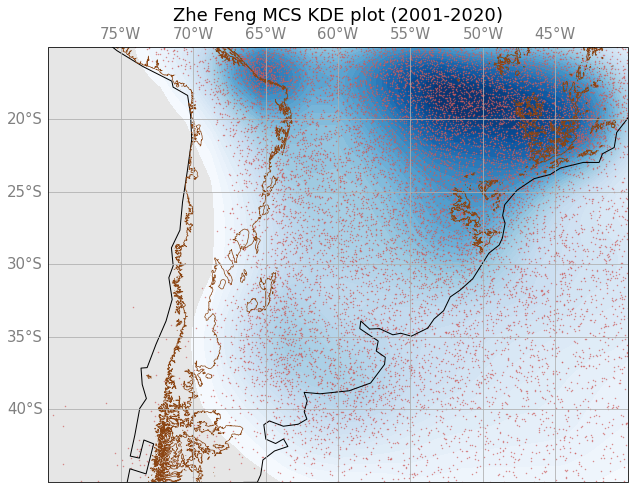

In [47]:
import seaborn as sns

terr=xr.open_dataset("/glade/u/home/isingh9/jupyter_nbks/etopo1.nc")
terr['Band1'].values[terr['Band1'].values < 0.]=np.nan

f, ax = plt.subplots(1, 1, figsize=(11,8), subplot_kw=dict(projection=crs.PlateCarree()))
ax.set_extent([-80, -40, -15, -45], crs=crs.PlateCarree())
gl = ax.gridlines()#color="gray",alpha=0.5, linestyle='--',draw_labels=True,linewidth=2)
ax.coastlines(resolution='110m')
gl.xlines = True
gl.ylines = True

gl.xlabels_top = True
gl.ylabels_right = False
gl.ylabels_left = True
gl.ylabels_bottom = True

gl.xformatter = LONGITUDE_FORMATTER
gl.yformatter = LATITUDE_FORMATTER
gl.xlabel_style = {'size': 15, 'color': 'gray'}#, 'weight': 'bold'}
gl.ylabel_style = {'size': 15, 'color': 'gray'}#, 'weight': 'bold'}

#for ii in range(len(ds.tracks)):
#    ax.plot(ds.meanlon.isel(tracks=ii),ds.meanlat.isel(tracks=ii),c='k',linewidth=4.25)
#    ax.plot(ds.meanlon.isel(tracks=ii),ds.meanlat.isel(tracks=ii),c='green',  linewidth=3.0)
#    ii = ii  + 1

plt.title('Zhe Feng MCS KDE plot (2001-2020)')

dd=pd.read_csv('Zhe_Feng_SONDJFM_2001-2020_tracks_stats_time_of_max_total_rain.csv')
#print(dd)
sns.kdeplot(data=dd,x="meanlon",y="meanlat", cmap="Blues",bw='scott',levels=40,shade=True, shade_lowest=False,ax=ax)
#ax.scatter(dd.meanlon,dd.meanlat,s=2,c='m', zorder=0.5, edgecolor='black', transform=crs.PlateCarree())
ax.scatter(dd.meanlon,dd.meanlat,s=0.2,c='indianred',alpha=0.8)#, zorder=0.5, edgecolor='black', transform=crs.PlateCarree())
topo_cont1=ax.contour(terr.lon.values,terr.lat.values,terr.Band1.values, levels=np.array([1000.]), 
                       colors="saddlebrown",linewidths=0.7,transform=crs.PlateCarree())
plt.savefig('Zhe_Feng_MCS_density_2001-2020.png',dpi=200)

# TRMM data analysis

In [121]:
trmm_file = '/glade/u/home/isingh9/work/TRMM_data/uw2/SAM/DCC/01/TPR7_uw2_DCC_str_tab_200701_SAM.nc'
da=xr.open_dataset(trmm_file)
#da
#da#.wcc_core_rain_rate_sum#.plot()
#print(len(da.case))

# print(min(da.core_lon.values))
# print(max(da.core_lon.values))
# print(min(da.core_lat.values))
# print(max(da.core_lat.values))
#print((da.case))
#print((da.date.values))
#print((da.core_id.values))
#22–36S, 52–69W
df = da.to_dataframe()
df

,orbit,date,time,core_id,core_lon,core_lat,core_area,core_top_ht,core_bot_ht,core_dim_x,...,storm_rain_rate_min,storm_rain_pix_all,storm_rain_pix_stra,storm_rain_pix_conv,storm_rain_rate_mean_all,storm_rain_rate_mean_stra,storm_rain_rate_mean_conv,storm_rain_vol_all,storm_rain_vol_stra,storm_rain_vol_conv
case,,,,,,,,,,,,,,,,,,,,,
0,b'52027',b'20070102',b'001530',1.0,-67.199997,-32.549999,755.609985,10.25,1.00,0.45,...,0.0,1360.0,534.0,384.0,4.3984,0.5897,14.750800,43.402302,2.284700,41.098598
1,b'52041',b'20070102',b'214334',1.0,-58.849998,-26.520000,774.400024,12.25,1.25,0.45,...,0.0,1677.0,1047.0,284.0,2.9982,1.5170,12.097800,38.710800,12.228600,26.452801
2,b'52041',b'20070102',b'214334',2.0,-60.099998,-25.080000,139.990005,10.75,1.00,0.15,...,0.0,102.0,32.0,45.0,3.0550,1.6150,5.776200,2.427900,0.402700,2.025200
3,b'52057',b'20070103',b'222652',1.0,-55.119999,-33.279999,930.340027,10.00,1.00,0.50,...,0.0,657.0,421.0,58.0,1.4393,0.6237,11.777000,6.805800,1.889700,4.916100
4,b'52076',b'20070105',b'022131',1.0,-67.070000,-30.700001,345.519989,10.00,1.50,0.30,...,0.0,573.0,269.0,99.0,1.9586,0.4426,10.106300,8.264300,0.876700,7.367600
5,b'52106',b'20070107',b'003019',1.0,-67.570000,-35.000000,987.500000,10.00,1.25,0.70,...,0.0,197.0,39.0,104.0,5.5300,0.9920,10.098300,7.669300,0.272400,7.393500
6,b'52150',b'20070109',b'214359',1.0,-67.800003,-34.330002,893.469971,10.50,1.25,0.35,...,0.0,269.0,131.0,47.0,2.9907,0.2401,16.421499,5.682600,0.222100,5.451700
7,b'52150',b'20070109',b'214359',2.0,-67.680000,-36.049999,824.719971,11.75,1.25,0.40,...,0.0,116.0,30.0,69.0,9.3587,1.0184,15.290700,7.538800,0.212200,7.326600
8,b'52152',b'20070109',b'232139',1.0,-67.199997,-34.049999,922.000000,10.75,1.25,0.35,...,0.0,84.0,26.0,44.0,9.7707,1.4153,17.816799,5.842300,0.261900,5.580400


In [172]:
# concatenate all TRMM files to a dataframe
jj=0
seasons        = ['September','October','November','December','January','February','March']
month_numbers  = ['09','10','11','12','01','02','03']

for mon in month_numbers:
    print('----------********----------')
    print('working on month: ',mon)
    print('...........')
    direc = '/glade/u/home/isingh9/work/TRMM_data/uw2/SAM/DCC/'+mon+'/'
    files = sorted(glob.glob(direc+'TPR7_uw2_DCC_str_tab*.nc'))
    print(files)
    da_list=[]
    
    for fil in files:
        print('file is ',fil)
        da1 = xr.open_dataset(fil)
        #da1 = subset_file_TRMM(fil, None, lon_box, lat_box) 
        print('number of cases is '+str(len(da1.case)))
        da_list.append(da1.to_dataframe())
        
    final_df = pd.concat(da_list, ignore_index=True)
    csv_filename='TRMM_DCC_SAM_'+seasons[jj]+'_.csv'
    print('saving to csv file: ',csv_filename)
    df = final_df.to_csv(csv_filename)
    jj=jj+1
    print('------------------------------\n\n')

----------********----------
working on month:  09
...........
['/glade/u/home/isingh9/work/TRMM_data/uw2/SAM/DCC/09/TPR7_uw2_DCC_str_tab_199809_SAM.nc', '/glade/u/home/isingh9/work/TRMM_data/uw2/SAM/DCC/09/TPR7_uw2_DCC_str_tab_199909_SAM.nc', '/glade/u/home/isingh9/work/TRMM_data/uw2/SAM/DCC/09/TPR7_uw2_DCC_str_tab_200009_SAM.nc', '/glade/u/home/isingh9/work/TRMM_data/uw2/SAM/DCC/09/TPR7_uw2_DCC_str_tab_200109_SAM.nc', '/glade/u/home/isingh9/work/TRMM_data/uw2/SAM/DCC/09/TPR7_uw2_DCC_str_tab_200209_SAM.nc', '/glade/u/home/isingh9/work/TRMM_data/uw2/SAM/DCC/09/TPR7_uw2_DCC_str_tab_200309_SAM.nc', '/glade/u/home/isingh9/work/TRMM_data/uw2/SAM/DCC/09/TPR7_uw2_DCC_str_tab_200409_SAM.nc', '/glade/u/home/isingh9/work/TRMM_data/uw2/SAM/DCC/09/TPR7_uw2_DCC_str_tab_200509_SAM.nc', '/glade/u/home/isingh9/work/TRMM_data/uw2/SAM/DCC/09/TPR7_uw2_DCC_str_tab_200609_SAM.nc', '/glade/u/home/isingh9/work/TRMM_data/uw2/SAM/DCC/09/TPR7_uw2_DCC_str_tab_200709_SAM.nc', '/glade/u/home/isingh9/work/TRMM_dat

file is  /glade/u/home/isingh9/work/TRMM_data/uw2/SAM/DCC/11/TPR7_uw2_DCC_str_tab_200011_SAM.nc
number of cases is 17
file is  /glade/u/home/isingh9/work/TRMM_data/uw2/SAM/DCC/11/TPR7_uw2_DCC_str_tab_200111_SAM.nc
number of cases is 18
file is  /glade/u/home/isingh9/work/TRMM_data/uw2/SAM/DCC/11/TPR7_uw2_DCC_str_tab_200211_SAM.nc
number of cases is 42
file is  /glade/u/home/isingh9/work/TRMM_data/uw2/SAM/DCC/11/TPR7_uw2_DCC_str_tab_200311_SAM.nc
number of cases is 22
file is  /glade/u/home/isingh9/work/TRMM_data/uw2/SAM/DCC/11/TPR7_uw2_DCC_str_tab_200411_SAM.nc
number of cases is 13
file is  /glade/u/home/isingh9/work/TRMM_data/uw2/SAM/DCC/11/TPR7_uw2_DCC_str_tab_200511_SAM.nc
number of cases is 36
file is  /glade/u/home/isingh9/work/TRMM_data/uw2/SAM/DCC/11/TPR7_uw2_DCC_str_tab_200611_SAM.nc
number of cases is 27
file is  /glade/u/home/isingh9/work/TRMM_data/uw2/SAM/DCC/11/TPR7_uw2_DCC_str_tab_200711_SAM.nc
number of cases is 18
file is  /glade/u/home/isingh9/work/TRMM_data/uw2/SAM/DC

number of cases is 9
file is  /glade/u/home/isingh9/work/TRMM_data/uw2/SAM/DCC/02/TPR7_uw2_DCC_str_tab_199902_SAM.nc
number of cases is 7
file is  /glade/u/home/isingh9/work/TRMM_data/uw2/SAM/DCC/02/TPR7_uw2_DCC_str_tab_200002_SAM.nc
number of cases is 12
file is  /glade/u/home/isingh9/work/TRMM_data/uw2/SAM/DCC/02/TPR7_uw2_DCC_str_tab_200102_SAM.nc
number of cases is 8
file is  /glade/u/home/isingh9/work/TRMM_data/uw2/SAM/DCC/02/TPR7_uw2_DCC_str_tab_200202_SAM.nc
number of cases is 10
file is  /glade/u/home/isingh9/work/TRMM_data/uw2/SAM/DCC/02/TPR7_uw2_DCC_str_tab_200302_SAM.nc
number of cases is 56
file is  /glade/u/home/isingh9/work/TRMM_data/uw2/SAM/DCC/02/TPR7_uw2_DCC_str_tab_200402_SAM.nc
number of cases is 16
file is  /glade/u/home/isingh9/work/TRMM_data/uw2/SAM/DCC/02/TPR7_uw2_DCC_str_tab_200502_SAM.nc
number of cases is 14
file is  /glade/u/home/isingh9/work/TRMM_data/uw2/SAM/DCC/02/TPR7_uw2_DCC_str_tab_200602_SAM.nc
number of cases is 37
file is  /glade/u/home/isingh9/work/T

In [173]:
import ast

def process_TRMM_monthly_csv(infile):
    df1=pd.read_csv(infile)
    df=df1.loc[:, ~df1.columns.str.match('^Unnamed')]
    #df.loc[:,'date']=df.loc[:,'date'].str.decode("utf-8")
    #df.loc[:,'time']=df.loc[:,'time'].str.decode("utf-8")
    df['date'] = df['date'].map(lambda v: ast.literal_eval(v).decode())
    df['time'] = df['time'].map(lambda v: ast.literal_eval(v).decode())
    df['datetime'] = pd.to_datetime(df['date'] + " " + df['time'])
    temp_cols=df.columns.tolist()
    new_cols=temp_cols[-1:] + temp_cols[:-1]
    df=df[new_cols]
    return df

#csv_trmm_files=['TRMM_WCC_SAM_September_.csv','TRMM_WCC_SAM_October_.csv','TRMM_WCC_SAM_November_.csv',\
#                'TRMM_WCC_SAM_December_.csv','TRMM_WCC_SAM_January_.csv','TRMM_WCC_SAM_February_.csv',\
#                 'TRMM_WCC_SAM_March_.csv']

csv_trmm_files=glob.glob('TRMM_DCC_SAM_*_.csv')
print(csv_trmm_files)
empty_list=[]
for fil in csv_trmm_files:
    print('processing file : ',fil)
    empty_list.append(process_TRMM_monthly_csv(fil))
                      
final_df = pd.concat(empty_list, ignore_index=True)
final_df=final_df.sort_values(by='datetime')
final_df=final_df.reset_index()
final_df=final_df.drop(columns=['index'])
final_df
final_df.to_csv('TRMM_DCC_data_1998-2013_SONDJFM.csv')
# final_df contains 1998-2013 TRMM storm category data for months Sep-Mar. It's probabaly the only thing needed


['TRMM_DCC_SAM_November_.csv', 'TRMM_DCC_SAM_October_.csv', 'TRMM_DCC_SAM_January_.csv', 'TRMM_DCC_SAM_September_.csv', 'TRMM_DCC_SAM_March_.csv', 'TRMM_DCC_SAM_December_.csv', 'TRMM_DCC_SAM_February_.csv']
processing file :  TRMM_DCC_SAM_November_.csv
processing file :  TRMM_DCC_SAM_October_.csv
processing file :  TRMM_DCC_SAM_January_.csv
processing file :  TRMM_DCC_SAM_September_.csv
processing file :  TRMM_DCC_SAM_March_.csv


/glade/scratch/isingh9/ipykernel_9448/686339637.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['date'] = df['date'].map(lambda v: ast.literal_eval(v).decode())
/glade/scratch/isingh9/ipykernel_9448/686339637.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['time'] = df['time'].map(lambda v: ast.literal_eval(v).decode())
/glade/scratch/isingh9/ipykernel_9448/686339637.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col

processing file :  TRMM_DCC_SAM_December_.csv
processing file :  TRMM_DCC_SAM_February_.csv


/glade/scratch/isingh9/ipykernel_9448/686339637.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['time'] = df['time'].map(lambda v: ast.literal_eval(v).decode())
/glade/scratch/isingh9/ipykernel_9448/686339637.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['date'] = df['date'].map(lambda v: ast.literal_eval(v).decode())
/glade/scratch/isingh9/ipykernel_9448/686339637.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col

In [174]:
dd=pd.read_csv('TRMM_DCC_data_1998-2013_SONDJFM.csv')
df=dd.loc[:, ~dd.columns.str.match('^Unnamed')]
df

,datetime,orbit,date,time,core_id,core_lon,core_lat,core_area,core_top_ht,core_bot_ht,...,storm_rain_rate_min,storm_rain_pix_all,storm_rain_pix_stra,storm_rain_pix_conv,storm_rain_rate_mean_all,storm_rain_rate_mean_stra,storm_rain_rate_mean_conv,storm_rain_vol_all,storm_rain_vol_stra,storm_rain_vol_conv
0,1998-01-01 02:15:17,b'00539',19980101,21517,1.0,-60.88,-33.25,594.56,10.25,1.00,...,0.0,7190.0,6061.0,292.0,1.6839,1.5453,9.3574,85.7014,66.2977,19.3406
1,1998-01-01 21:46:39,b'00552',19980101,214639,1.0,-45.30,-21.05,576.96,10.25,1.25,...,0.0,84.0,14.0,37.0,4.8794,0.6671,10.8252,3.2839,0.0748,3.2091
2,1998-01-03 20:58:28,b'00583',19980103,205828,1.0,-47.60,-20.95,259.81,12.00,1.50,...,0.0,346.0,192.0,68.0,2.5394,0.7902,10.6490,7.0596,1.2190,5.8181
3,1998-01-03 22:34:24,b'00584',19980103,223424,1.0,-65.73,-22.60,114.15,10.25,4.75,...,0.0,519.0,304.0,24.0,0.8167,0.7928,7.4970,3.3500,1.9048,1.4221
4,1998-01-03 22:37:01,b'00584',19980103,223701,1.0,-59.42,-26.25,221.78,10.75,0.75,...,0.0,1505.0,806.0,346.0,2.9124,0.8403,10.6890,33.7102,5.2091,28.4438
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2297,2013-12-31 01:13:02,b'91850',20131231,11302,1.0,-61.58,-32.03,288.27,10.75,0.75,...,0.0,1636.0,690.0,371.0,3.7740,0.2957,16.0821,44.9100,1.4839,43.3979
2298,2013-12-31 02:51:33,b'91852',20131231,25133,2.0,-59.33,-34.15,767.43,10.50,1.25,...,0.0,1723.0,957.0,469.0,3.6351,0.3817,12.5655,44.0399,2.5684,41.4372
2299,2013-12-31 02:51:33,b'91852',20131231,25133,1.0,-58.47,-34.38,331.66,12.50,1.00,...,0.0,1723.0,957.0,469.0,3.6351,0.3817,12.5655,44.0399,2.5684,41.4372
2300,2013-12-31 04:27:23,b'91853',20131231,42723,1.0,-66.82,-33.38,387.20,11.75,1.00,...,0.0,94.0,27.0,38.0,5.3506,0.6634,12.7644,3.6033,0.1283,3.4750


In [80]:
trmm_file = '/glade/u/home/isingh9/work/TRMM_data/uw2/SAM/DCC/01/TPR7_uw2_DCC_str_grd_200701_SAM.nc'
da=xr.open_dataset(trmm_file)
da#.wcc_core_rain_rate_sum#.plot()
#print(len(da.case))

# print(min(da.core_lon.values))
# print(max(da.core_lon.values))
# print(min(da.core_lat.values))
# print(max(da.core_lat.values))
# print((da.case))
# print((da.core_id.values))
#22–36S, 52–69W


<xarray.Dataset>
Dimensions:                    (longitude: 1201, latitude: 1101)
Coordinates:
  * longitude                  (longitude) float32 -90.0 -89.95 ... -30.05 -30.0
  * latitude                   (latitude) float32 -40.0 -39.95 ... 14.95 15.0
Data variables:
    dcc_core_rain_rate_sum     (latitude, longitude) float32 ...
    dcc_core_rain_rate_count   (latitude, longitude) float64 ...
    dcc_storm_rain_rate_sum    (latitude, longitude) float32 ...
    dcc_storm_rain_rate_count  (latitude, longitude) float64 ...
Attributes:
    Title:                     Deep convective monthly rain rate sums based o...
    DeepConvective_Criterion:  40dBZ echos exceed 10km in height
    source_uw:                 Created by the Mesoscale Group, University of ...
    source_nasa:               Original data obtained from NASA Goddard Earth...
    reference:                 Houze et al. 2015 (Reviews of Geophysics)
    data_location:             http://trmm.atmos.washington.edu
    region:                    SAM Southamerica
    lon_min:                   -90.0
    lon_max:                   -30.0
    lat_min:                   -40.0
    lat_max:                   15.0

In [57]:
def subset_file_TRMM(infile, outdir, lon_box, lat_box):
    
    print('subsetting file... ',infile)
    # Read input MCS track file
    
    ds = xr.open_dataset(infile)

    # Get track initiation lat/lon location
    lon0 = ds.core_lon
    lat0 = ds.core_lat

    # Get track index for MCS initiation location within a region
    trackid = np.where((lon0 >= np.min(lon_box)) & (lon0 <= np.max(lon_box)) & (lat0 >= np.min(lat_box)) & (lat0 <= np.max(lat_box)))[0]
    dsout = ds.isel(case=trackid, drop=True)
    return dsout

lon_box = [-69,-52]
lat_box = [-36, -22]
dss = subset_file_TRMM(trmm_file, None, lon_box, lat_box)
dss


subsetting file...  /glade/u/home/isingh9/work/TRMM_data/uw2/SAM/DCC/01/TPR7_uw2_DCC_str_tab_201201_SAM.nc


<xarray.Dataset>
Dimensions:                    (case: 12)
Dimensions without coordinates: case
Data variables: (12/48)
    orbit                      (case) |S5 ...
    date                       (case) |S8 ...
    time                       (case) |S6 ...
    core_id                    (case) float32 ...
    core_lon                   (case) float32 -68.43 -68.0 ... -62.25 -63.35
    core_lat                   (case) float32 -34.95 -32.88 ... -35.0 -28.12
    ...                         ...
    storm_rain_rate_mean_all   (case) float32 ...
    storm_rain_rate_mean_stra  (case) float32 ...
    storm_rain_rate_mean_conv  (case) float32 ...
    storm_rain_vol_all         (case) float32 ...
    storm_rain_vol_stra        (case) float32 ...
    storm_rain_vol_conv        (case) float32 ...
Attributes:
    Title:                     DeepConvective Cases Based on 2A25 nearSurfRai...
    DeepConvective_Criterion:  40dBZ echos exceed 10km in height
    source_uw:                 Created by the Mesoscale Group, University of ...
    source_nasa:               Original data obtained from NASA Goddard Earth...
    reference:                 Methodology described in Houze et al. 2015 (Re...
    data_location:             http://trmm.atmos.washington.edu
    region:                    SAM Southamerica
    lon_min:                   -90.0
    lon_max:                   -30.0
    lat_min:                   -40.0
    lat_max:                   15.0

In [70]:
seasons        = ['September','October','November','December','January','February','March']
month_numbers = ['09','10','11','12','01','02','03']
data = np.zeros((7))

lon_box = [-69,-52]
lat_box = [-36, -22]

jj=0
area_list=[]

for mon in month_numbers:
    print('------------------------------')
    print('working on month: ',mon)
    print('...........')
    direc = '/glade/u/home/isingh9/work/TRMM_data/uw2/SAM/WCC/'+mon+'/'
    files = sorted(glob.glob(direc+'TPR7_uw2_WCC_str_tab*.nc'))
    print(files)
    
    for fil in files:
        print('file is ',fil)
        da1 = subset_file_TRMM(fil, None, lon_box, lat_box) 
        print('number of cases is '+str(len(da1.case)))
        data[jj]=data[jj]+len(da1.case)
        area_list.append(da1.core_area.values[:])
        
    jj=jj+1

------------------------------
working on month:  09
...........
['/glade/u/home/isingh9/work/TRMM_data/uw2/SAM/WCC/09/TPR7_uw2_WCC_str_tab_199809_SAM.nc', '/glade/u/home/isingh9/work/TRMM_data/uw2/SAM/WCC/09/TPR7_uw2_WCC_str_tab_199909_SAM.nc', '/glade/u/home/isingh9/work/TRMM_data/uw2/SAM/WCC/09/TPR7_uw2_WCC_str_tab_200009_SAM.nc', '/glade/u/home/isingh9/work/TRMM_data/uw2/SAM/WCC/09/TPR7_uw2_WCC_str_tab_200109_SAM.nc', '/glade/u/home/isingh9/work/TRMM_data/uw2/SAM/WCC/09/TPR7_uw2_WCC_str_tab_200209_SAM.nc', '/glade/u/home/isingh9/work/TRMM_data/uw2/SAM/WCC/09/TPR7_uw2_WCC_str_tab_200309_SAM.nc', '/glade/u/home/isingh9/work/TRMM_data/uw2/SAM/WCC/09/TPR7_uw2_WCC_str_tab_200409_SAM.nc', '/glade/u/home/isingh9/work/TRMM_data/uw2/SAM/WCC/09/TPR7_uw2_WCC_str_tab_200509_SAM.nc', '/glade/u/home/isingh9/work/TRMM_data/uw2/SAM/WCC/09/TPR7_uw2_WCC_str_tab_200609_SAM.nc', '/glade/u/home/isingh9/work/TRMM_data/uw2/SAM/WCC/09/TPR7_uw2_WCC_str_tab_200709_SAM.nc', '/glade/u/home/isingh9/work/TRMM_d

number of cases is 26
file is  /glade/u/home/isingh9/work/TRMM_data/uw2/SAM/WCC/10/TPR7_uw2_WCC_str_tab_200610_SAM.nc
subsetting file...  /glade/u/home/isingh9/work/TRMM_data/uw2/SAM/WCC/10/TPR7_uw2_WCC_str_tab_200610_SAM.nc
number of cases is 33
file is  /glade/u/home/isingh9/work/TRMM_data/uw2/SAM/WCC/10/TPR7_uw2_WCC_str_tab_200710_SAM.nc
subsetting file...  /glade/u/home/isingh9/work/TRMM_data/uw2/SAM/WCC/10/TPR7_uw2_WCC_str_tab_200710_SAM.nc
number of cases is 45
file is  /glade/u/home/isingh9/work/TRMM_data/uw2/SAM/WCC/10/TPR7_uw2_WCC_str_tab_200810_SAM.nc
subsetting file...  /glade/u/home/isingh9/work/TRMM_data/uw2/SAM/WCC/10/TPR7_uw2_WCC_str_tab_200810_SAM.nc
number of cases is 23
file is  /glade/u/home/isingh9/work/TRMM_data/uw2/SAM/WCC/10/TPR7_uw2_WCC_str_tab_200910_SAM.nc
subsetting file...  /glade/u/home/isingh9/work/TRMM_data/uw2/SAM/WCC/10/TPR7_uw2_WCC_str_tab_200910_SAM.nc
number of cases is 17
file is  /glade/u/home/isingh9/work/TRMM_data/uw2/SAM/WCC/10/TPR7_uw2_WCC_str_

number of cases is 37
file is  /glade/u/home/isingh9/work/TRMM_data/uw2/SAM/WCC/12/TPR7_uw2_WCC_str_tab_200612_SAM.nc
subsetting file...  /glade/u/home/isingh9/work/TRMM_data/uw2/SAM/WCC/12/TPR7_uw2_WCC_str_tab_200612_SAM.nc
number of cases is 40
file is  /glade/u/home/isingh9/work/TRMM_data/uw2/SAM/WCC/12/TPR7_uw2_WCC_str_tab_200712_SAM.nc
subsetting file...  /glade/u/home/isingh9/work/TRMM_data/uw2/SAM/WCC/12/TPR7_uw2_WCC_str_tab_200712_SAM.nc
number of cases is 37
file is  /glade/u/home/isingh9/work/TRMM_data/uw2/SAM/WCC/12/TPR7_uw2_WCC_str_tab_200812_SAM.nc
subsetting file...  /glade/u/home/isingh9/work/TRMM_data/uw2/SAM/WCC/12/TPR7_uw2_WCC_str_tab_200812_SAM.nc
number of cases is 25
file is  /glade/u/home/isingh9/work/TRMM_data/uw2/SAM/WCC/12/TPR7_uw2_WCC_str_tab_200912_SAM.nc
subsetting file...  /glade/u/home/isingh9/work/TRMM_data/uw2/SAM/WCC/12/TPR7_uw2_WCC_str_tab_200912_SAM.nc
number of cases is 48
file is  /glade/u/home/isingh9/work/TRMM_data/uw2/SAM/WCC/12/TPR7_uw2_WCC_str_

number of cases is 13
file is  /glade/u/home/isingh9/work/TRMM_data/uw2/SAM/WCC/02/TPR7_uw2_WCC_str_tab_200602_SAM.nc
subsetting file...  /glade/u/home/isingh9/work/TRMM_data/uw2/SAM/WCC/02/TPR7_uw2_WCC_str_tab_200602_SAM.nc
number of cases is 29
file is  /glade/u/home/isingh9/work/TRMM_data/uw2/SAM/WCC/02/TPR7_uw2_WCC_str_tab_200702_SAM.nc
subsetting file...  /glade/u/home/isingh9/work/TRMM_data/uw2/SAM/WCC/02/TPR7_uw2_WCC_str_tab_200702_SAM.nc
number of cases is 33
file is  /glade/u/home/isingh9/work/TRMM_data/uw2/SAM/WCC/02/TPR7_uw2_WCC_str_tab_200802_SAM.nc
subsetting file...  /glade/u/home/isingh9/work/TRMM_data/uw2/SAM/WCC/02/TPR7_uw2_WCC_str_tab_200802_SAM.nc
number of cases is 27
file is  /glade/u/home/isingh9/work/TRMM_data/uw2/SAM/WCC/02/TPR7_uw2_WCC_str_tab_200902_SAM.nc
subsetting file...  /glade/u/home/isingh9/work/TRMM_data/uw2/SAM/WCC/02/TPR7_uw2_WCC_str_tab_200902_SAM.nc
number of cases is 36
file is  /glade/u/home/isingh9/work/TRMM_data/uw2/SAM/WCC/02/TPR7_uw2_WCC_str_

In [79]:
areas=np.concatenate(area_list, axis=None) 
#print(len(areas))
np.percentile(areas, 10)

1078.4070190429688

## TRMM data and PV advection from ERA5 combined analysis

In [166]:
# load pv advection data
extension = 'csv'
all_filenames = [i for i in glob.glob('ERA5_time_series_va_meridional_index_ulpvadvirrot_parallel_7outputvars_20*.{}'.format(extension))]
#print(all_filenames)
combined_csv = pd.concat([pd.read_csv(f,header=None,delimiter=',',names=['date','sallj','pvadv_irrot','rrmax','rravg','MI','max_jet'],index_col='date',parse_dates=True) for f in all_filenames ])
final_df_pv_adv = combined_csv.sort_values(by='date')
#final_df_pv_adv


pvadv_75_pc  = final_df_pv_adv['pvadv_irrot'].quantile(.90)
print('pvadv 75 percentile : ',pvadv_75_pc)
#df_sallj_48hrs_abvavg = final_df_pv_adv[final_df_pv_adv.rolling(48)['max_pos_PVadv'].min() >= sallj_median]
df_pvadv_abv75pc = final_df_pv_adv[final_df_pv_adv['pvadv_irrot'] >= pvadv_75_pc]
#df_pvadv_abv75pc


start_day = '1998-01-01'
end_day = '2013-12-31'
#start_day = pd.to_datetime(start_day)
#end_day = pd.to_datetime(end_day)
#df_pvadv_abv75pc=df_pvadv_abv75pc[df.index.between(start_day, end_day)]
#df_pvadv_abv75pc=df_pvadv_abv75pc.loc[start_day:start_day]
df_pvadv_abv75pc=df_pvadv_abv75pc.query("'1998-01-01' <= index <= '2013-12-31'")
df_pvadv_abv75pc

pvadv 75 percentile :  0.03427332379482146


,sallj,pvadv_irrot,rrmax,rravg,MI,max_jet
date,,,,,,
2001-10-01 04:00:00,14.936342,0.040069,15.664959,0.637117,7.625264,64.729644
2001-10-01 05:00:00,14.790277,0.047736,14.767170,0.620397,7.585202,64.292856
2001-10-01 06:00:00,14.552658,0.053478,15.155125,0.608762,7.634635,64.089396
2001-10-01 07:00:00,14.208599,0.054664,11.406040,0.522226,7.776260,63.878405
2001-10-01 08:00:00,13.816536,0.051910,12.580204,0.515119,7.942615,63.582879
...,...,...,...,...,...,...
2013-03-25 22:00:00,4.220149,0.036104,5.494881,0.140524,13.861164,45.762600
2013-03-25 23:00:00,4.695015,0.035709,6.312847,0.138464,13.820999,46.453762
2013-03-26 00:00:00,5.067494,0.034721,7.633352,0.145717,13.758490,46.623535


In [217]:
# other csv file pvadv

# max UL +PV advection

extension = 'csv'
all_filenames = [i for i in glob.glob('ERA5_time_series_max_ulpvadvirrot_parallel*.{}'.format(extension))]
#print(all_filenames)
combined_csv = pd.concat([pd.read_csv(f,header=None,delimiter=',',names=['date','max_pos_PVadv','max_lat','max_lon'],index_col='date',parse_dates=True) for f in all_filenames ])
final_df_pv_adv = combined_csv.sort_values(by='date')
#print(len(final_df))
#final_df = final_df[final_df['pvadv_irrot'] > 0.0]
#print(len(final_df))
#print(final_df.index.year.unique())

pvadv_75_pc  = final_df_pv_adv['max_pos_PVadv'].quantile(.90)
print('pvadv 75 percentile : ',pvadv_75_pc)
#df_sallj_48hrs_abvavg = final_df_pv_adv[final_df_pv_adv.rolling(48)['max_pos_PVadv'].min() >= sallj_median]
df_pvadv_abv75pc = final_df_pv_adv[final_df_pv_adv['max_pos_PVadv'] >= pvadv_75_pc]
#df_pvadv_abv75pc


start_day = '1998-01-01'
end_day = '2013-12-31'
#start_day = pd.to_datetime(start_day)
#end_day = pd.to_datetime(end_day)
#df_pvadv_abv75pc=df_pvadv_abv75pc[df.index.between(start_day, end_day)]
#df_pvadv_abv75pc=df_pvadv_abv75pc.loc[start_day:start_day]
df_pvadv_abv75pc=df_pvadv_abv75pc.query("'1998-01-01' <= index <= '2013-12-31'")
final_df_pv_adv

pvadv 75 percentile :  0.9137121545706895


,max_pos_PVadv,max_lat,max_lon
date,,,
2002-10-01 00:00:00,0.180756,-23.75,309.75
2002-10-01 01:00:00,0.207959,-28.00,307.50
2002-10-01 02:00:00,0.237427,-28.50,308.75
2002-10-01 03:00:00,0.258060,-28.25,308.75
2002-10-01 04:00:00,0.278384,-28.25,309.75
...,...,...,...
2019-03-31 19:00:00,0.352706,-35.50,295.00
2019-03-31 20:00:00,0.629592,-36.00,295.00
2019-03-31 21:00:00,0.791858,-35.25,295.00


In [167]:
unique_days_pvadv=pd.to_datetime(df_pvadv_abv75pc.index.map(pd.Timestamp.date).unique())
unique_days_pvadv

DatetimeIndex(['2001-10-01', '2001-10-07', '2001-10-08', '2001-10-09',
               '2001-10-15', '2001-10-16', '2001-10-20', '2001-10-21',
               '2001-10-28', '2001-10-29',
               ...
               '2013-03-02', '2013-03-12', '2013-03-13', '2013-03-16',
               '2013-03-19', '2013-03-20', '2013-03-21', '2013-03-24',
               '2013-03-25', '2013-03-26'],
              dtype='datetime64[ns]', name='date', length=362, freq=None)

In [241]:
# load TRMM WCC data
dd=pd.read_csv('TRMM_WCC_data_1998-2013_SONDJFM.csv')
df_wcc=dd.loc[:, ~dd.columns.str.match('^Unnamed')]
df_wcc

# extract the data within a lat-lon box
df_wcc=df_wcc.loc[(df_wcc.core_lon>=-70.) & (df_wcc.core_lon<=-50.) &\
                 (df_wcc.core_lat >=-45.) & (df_wcc.core_lat<=-20)]
unique_days_wcc=pd.to_datetime(pd.to_datetime(df_wcc['datetime']).map(pd.Timestamp.date).unique())
#unique_days_wcc
df_wcc

,datetime,orbit,date,time,core_id,core_lon,core_lat,core_area,core_top_ht,core_bot_ht,...,storm_rain_rate_min,storm_rain_pix_all,storm_rain_pix_stra,storm_rain_pix_conv,storm_rain_rate_mean_all,storm_rain_rate_mean_stra,storm_rain_rate_mean_conv,storm_rain_vol_all,storm_rain_vol_stra,storm_rain_vol_conv
0,1998-01-01 05:26:50,b'00542',19980101,52650,2.0,-64.47,-30.33,2508.05,6.75,1.00,...,0.0,3813.0,1430.0,1408.0,7.1839,1.5280,17.8818,202.4453,16.1485,186.0775
1,1998-01-01 05:26:50,b'00542',19980101,52650,1.0,-62.72,-30.85,2467.97,9.50,0.75,...,0.0,3813.0,1430.0,1408.0,7.1839,1.5280,17.8818,202.4453,16.1485,186.0775
4,1998-01-03 22:37:01,b'00584',19980103,223701,1.0,-59.45,-27.10,1981.24,6.50,0.75,...,0.0,1505.0,806.0,346.0,2.9124,0.8403,10.6890,33.7102,5.2091,28.4438
5,1998-01-04 23:01:42,b'00600',19980104,230142,1.0,-56.28,-32.08,1126.27,7.50,0.50,...,0.0,2654.0,1514.0,494.0,2.6149,0.9907,10.9750,50.8352,10.9871,39.7132
6,1998-01-04 23:01:42,b'00600',19980104,230142,2.0,-55.80,-31.58,1027.05,6.50,0.75,...,0.0,2654.0,1514.0,494.0,2.6149,0.9907,10.9750,50.8352,10.9871,39.7132
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10286,2013-12-29 06:18:34,b'91823',20131229,61834,1.0,-62.53,-30.70,2046.56,9.25,1.25,...,0.0,2243.0,1076.0,826.0,8.0150,1.1504,20.2602,132.4872,9.1224,123.3288
10288,2013-12-30 00:32:47,b'91834',20131230,3247,1.0,-51.88,-29.33,1212.74,7.75,1.25,...,0.0,712.0,305.0,277.0,4.1240,1.2650,9.2075,21.9760,2.8877,19.0883
10290,2013-12-30 05:26:31,b'91838',20131230,52631,1.0,-53.33,-29.05,2648.17,6.75,0.75,...,0.0,690.0,383.0,197.0,4.2316,1.6234,11.6651,21.8737,4.6580,17.2157
10293,2013-12-31 02:53:03,b'91852',20131231,25303,1.0,-51.83,-35.65,1733.13,7.00,1.00,...,0.0,418.0,111.0,192.0,5.4495,1.0259,11.2710,15.9132,0.7955,15.1177


In [178]:
# load TRMM DCC data
dd=pd.read_csv('TRMM_DCC_data_1998-2013_SONDJFM.csv')
df_dcc=dd.loc[:, ~dd.columns.str.match('^Unnamed')]
df_dcc

# extract the data within a lat-lon box
df_dcc=df_dcc.loc[(df_dcc.core_lon>=-70.) & (df_dcc.core_lon<=-50.) &\
                 (df_dcc.core_lat >=-45.) & (df_dcc.core_lat<=-20)]
unique_days_dcc=pd.to_datetime(pd.to_datetime(df_dcc['datetime']).map(pd.Timestamp.date).unique())
unique_days_dcc

DatetimeIndex(['1998-01-01', '1998-01-03', '1998-01-05', '1998-01-06',
               '1998-01-10', '1998-01-11', '1998-01-13', '1998-01-16',
               '1998-01-17', '1998-01-19',
               ...
               '2013-11-18', '2013-11-24', '2013-11-25', '2013-12-01',
               '2013-12-02', '2013-12-03', '2013-12-26', '2013-12-27',
               '2013-12-30', '2013-12-31'],
              dtype='datetime64[ns]', length=754, freq=None)

In [181]:
common_dates=np.intersect1d(unique_days_dcc, unique_days_wcc)
print(len(common_dates))
print(common_dates)

525
['1998-01-01T00:00:00.000000000' '1998-01-03T00:00:00.000000000'
 '1998-01-05T00:00:00.000000000' '1998-01-06T00:00:00.000000000'
 '1998-01-11T00:00:00.000000000' '1998-01-17T00:00:00.000000000'
 '1998-01-19T00:00:00.000000000' '1998-01-21T00:00:00.000000000'
 '1998-01-27T00:00:00.000000000' '1998-02-06T00:00:00.000000000'
 '1998-02-07T00:00:00.000000000' '1998-02-17T00:00:00.000000000'
 '1998-02-26T00:00:00.000000000' '1998-09-02T00:00:00.000000000'
 '1998-09-12T00:00:00.000000000' '1998-10-06T00:00:00.000000000'
 '1998-10-10T00:00:00.000000000' '1998-10-16T00:00:00.000000000'
 '1998-10-18T00:00:00.000000000' '1998-10-22T00:00:00.000000000'
 '1998-11-06T00:00:00.000000000' '1998-11-07T00:00:00.000000000'
 '1998-11-09T00:00:00.000000000' '1998-11-12T00:00:00.000000000'
 '1998-11-17T00:00:00.000000000' '1998-11-23T00:00:00.000000000'
 '1998-11-24T00:00:00.000000000' '1998-12-09T00:00:00.000000000'
 '1998-12-14T00:00:00.000000000' '1998-12-28T00:00:00.000000000'
 '1999-01-12T00:00:00

In [177]:
# for indexes: np.in1d(datetime1, datetime2)
common_dates=np.intersect1d(unique_days_pvadv, unique_days_wcc)
print(len(common_dates))
print(common_dates)

108
['2001-10-20T00:00:00.000000000' '2001-10-28T00:00:00.000000000'
 '2001-11-06T00:00:00.000000000' '2001-11-10T00:00:00.000000000'
 '2001-11-13T00:00:00.000000000' '2001-11-21T00:00:00.000000000'
 '2001-11-29T00:00:00.000000000' '2001-12-21T00:00:00.000000000'
 '2002-01-31T00:00:00.000000000' '2002-02-08T00:00:00.000000000'
 '2002-02-19T00:00:00.000000000' '2002-03-29T00:00:00.000000000'
 '2002-10-09T00:00:00.000000000' '2002-10-10T00:00:00.000000000'
 '2002-10-16T00:00:00.000000000' '2002-10-21T00:00:00.000000000'
 '2002-10-27T00:00:00.000000000' '2002-10-28T00:00:00.000000000'
 '2002-11-10T00:00:00.000000000' '2002-11-20T00:00:00.000000000'
 '2002-11-25T00:00:00.000000000' '2002-11-30T00:00:00.000000000'
 '2003-02-02T00:00:00.000000000' '2003-02-03T00:00:00.000000000'
 '2003-02-10T00:00:00.000000000' '2003-02-19T00:00:00.000000000'
 '2006-10-02T00:00:00.000000000' '2006-10-04T00:00:00.000000000'
 '2006-10-05T00:00:00.000000000' '2006-10-10T00:00:00.000000000'
 '2006-10-14T00:00:00

In [218]:
final_df_pv_adv=final_df_pv_adv.resample('D').max()
final_df_pv_adv

,max_pos_PVadv,max_lat,max_lon
date,,,
2002-10-01,0.667786,-20.25,309.75
2002-10-02,2.637573,-29.75,309.25
2002-10-03,1.775630,-22.00,309.75
2002-10-04,1.114733,-28.25,309.75
2002-10-05,1.217431,-22.50,309.75
...,...,...,...
2019-03-27,0.196268,-22.25,309.75
2019-03-28,0.260700,-20.25,309.75
2019-03-29,0.140360,-20.25,309.75


In [215]:
df_wcc['datetime']= pd.to_datetime(df_wcc['datetime'])
df_wcc_new = df_wcc.set_index('datetime').resample('D').max()
df_wcc_new

,orbit,date,time,core_id,core_lon,core_lat,core_area,core_top_ht,core_bot_ht,core_dim_x,...,storm_rain_rate_min,storm_rain_pix_all,storm_rain_pix_stra,storm_rain_pix_conv,storm_rain_rate_mean_all,storm_rain_rate_mean_stra,storm_rain_rate_mean_conv,storm_rain_vol_all,storm_rain_vol_stra,storm_rain_vol_conv
datetime,,,,,,,,,,,,,,,,,,,,,
1998-01-01,b'00542',19980101.0,52650.0,2.0,-62.72,-30.33,2508.05,9.50,1.00,1.30,...,0.0,3813.0,1430.0,1408.0,7.1839,1.5280,17.8818,202.4453,16.1485,186.0775
1998-01-02,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1998-01-03,b'00584',19980103.0,223701.0,1.0,-59.45,-27.10,1981.24,6.50,0.75,0.75,...,0.0,1505.0,806.0,346.0,2.9124,0.8403,10.6890,33.7102,5.2091,28.4438
1998-01-04,b'00600',19980104.0,230142.0,2.0,-55.80,-31.58,1126.27,7.50,0.75,0.55,...,0.0,2654.0,1514.0,494.0,2.6149,0.9907,10.9750,50.8352,10.9871,39.7132
1998-01-05,b'00615',19980105.0,215045.0,1.0,-52.05,-30.30,3521.09,9.25,0.75,1.65,...,0.0,2874.0,1880.0,538.0,4.5540,2.0337,14.1535,80.5636,27.4384,53.0394
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2013-12-27,b'91789',20131227.0,31754.0,1.0,-58.55,-32.62,1093.41,8.00,0.75,0.55,...,0.0,747.0,332.0,243.0,4.2413,1.2563,11.3173,22.6980,2.9881,19.7021
2013-12-28,b'91803',20131228.0,4347.0,2.0,-55.72,-21.52,1293.97,8.75,0.75,0.50,...,0.0,579.0,342.0,88.0,4.9082,1.5147,8.6470,8.1708,2.1404,6.0119
2013-12-29,b'91823',20131229.0,61834.0,1.0,-62.53,-30.70,2046.56,9.25,1.25,0.70,...,0.0,2243.0,1076.0,826.0,8.0150,1.1504,20.2602,132.4872,9.1224,123.3288


In [219]:
merged_df= pd.concat([final_df_pv_adv,df_wcc_new], join='inner', axis=1).dropna()#.reset_index(drop=True)
merged_df#.columns

,max_pos_PVadv,max_lat,max_lon,orbit,date,time,core_id,core_lon,core_lat,core_area,...,storm_rain_rate_min,storm_rain_pix_all,storm_rain_pix_stra,storm_rain_pix_conv,storm_rain_rate_mean_all,storm_rain_rate_mean_stra,storm_rain_rate_mean_conv,storm_rain_vol_all,storm_rain_vol_stra,storm_rain_vol_conv
2002-10-02,2.637573,-29.75,309.25,b'27836',20021002.0,211927.0,2.0,-56.00,-31.52,8354.60,...,0.0,3807.0,2082.0,1063.0,6.3931,2.1142,17.3886,167.1023,32.1217,134.8871
2002-10-03,1.775630,-22.00,309.75,b'27847',20021003.0,153012.0,1.0,-53.88,-22.92,1537.34,...,0.0,3616.0,2803.0,504.0,3.5838,2.7819,10.2399,101.3717,60.9969,40.3714
2002-10-04,1.114733,-28.25,309.75,b'27866',20021004.0,192753.0,3.0,-55.05,-33.72,3416.19,...,0.0,3834.0,1946.0,1035.0,5.4717,1.2405,16.6625,112.0042,17.1896,103.2183
2002-10-05,1.217431,-22.50,309.75,b'27878',20021005.0,151654.0,1.0,-50.60,-28.38,2610.92,...,0.0,6994.0,4570.0,1641.0,6.0062,3.3068,16.3785,317.3562,114.1674,203.0493
2002-10-06,3.461011,-23.00,309.75,b'27897',20021006.0,191428.0,2.0,-56.80,-31.23,1647.41,...,0.0,2299.0,1276.0,616.0,4.9568,2.0867,14.5402,82.3397,19.2392,63.0702
2002-10-07,0.595246,-34.50,309.75,b'27909',20021007.0,150435.0,1.0,-55.90,-29.95,1178.45,...,0.0,8470.0,7548.0,378.0,2.4899,2.2189,11.4847,153.6069,121.9872,31.6197
2002-10-08,0.701928,-30.25,309.75,b'27929',20021008.0,203915.0,3.0,-55.35,-20.20,7665.95,...,0.0,6309.0,5008.0,1035.0,5.0063,3.7050,13.9175,236.6176,139.0026,98.7757
2002-10-11,1.176546,-25.75,304.00,b'27974',20021011.0,175250.0,2.0,-52.53,-27.20,2091.20,...,0.0,3541.0,2590.0,530.0,6.3155,2.8775,12.4976,94.7484,55.2357,39.4528
2002-10-14,1.439717,-27.50,309.75,b'28020',20021014.0,164425.0,2.0,-54.05,-22.52,1872.36,...,0.0,2405.0,1424.0,595.0,6.2698,2.0715,16.4082,75.7824,23.1111,69.5368
2002-10-15,1.024193,-30.00,306.25,b'28034',20021015.0,140831.0,1.0,-60.80,-34.85,1432.61,...,0.0,2629.0,2075.0,285.0,4.3467,2.0605,14.0383,40.2983,21.4146,24.4787


Text(0, 0.5, 'rain TRMM')

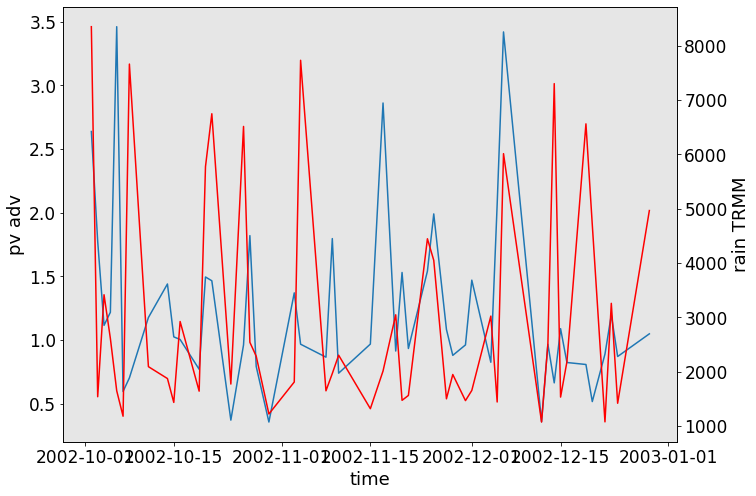

In [224]:


fig = plt.figure(figsize=(11,8))
ax=plt.gca()
ax.plot(merged_df.max_pos_PVadv)
ax.set_ylabel('pv adv')
ax.set_xlabel('time')
ax2=ax.twinx()
ax2.plot(merged_df.core_area,color='red')
ax2.set_ylabel('rain TRMM')
#plt.plot(merged_df.max_pos_PVadv)

In [220]:
col1, col2 = "max_pos_PVadv", "core_rain_rate_max"
corr = merged_df[col1].corr(merged_df[col2])
print("Correlation between ", col1, " and ", col2, "is: ", round(corr, 2))

Correlation between  max_pos_PVadv  and  core_rain_rate_max is:  -0.02


In [207]:
print(merged_df.columns)#astype('float64').corr(method='pearson')
merged_df[['sallj', 'pvadv_irrot', 'rrmax', 'rravg', 'MI', 'max_jet','core_area',
       'core_top_ht', 'core_bot_ht', 'core_dim_x', 'core_dim_y', 
       'core_rain_rate_mean', 'core_rain_rate_std_dev',
       'core_rain_rate_max', 'core_rain_rate_min', 'core_rain_pix_all',
       'core_rain_pix_stra', 'core_rain_pix_conv', 'core_rain_rate_mean_all',
       'core_rain_rate_mean_stra', 'core_rain_rate_mean_conv',
       'core_rain_vol_all', 'core_rain_vol_stra', 'core_rain_vol_conv',
       'storm_top_ht', 'storm_bot_ht',
       'storm_dim_x', 'storm_dim_y', 'storm_ter_ht', 'storm_ocean_land_flag',
       'storm_rain_mean', 'storm_rain_rate_std_dev', 'storm_rain_rate_max',
       'storm_rain_rate_min', 'storm_rain_pix_all', 'storm_rain_pix_stra',
       'storm_rain_pix_conv', 'storm_rain_rate_mean_all',
       'storm_rain_rate_mean_stra', 'storm_rain_rate_mean_conv',
       'storm_rain_vol_all', 'storm_rain_vol_stra', 'storm_rain_vol_conv']].corr()

Index(['max_pos_PVadv', 'max_lat', 'max_lon', 'orbit', 'date', 'time',
       'core_id', 'core_lon', 'core_lat', 'core_area', 'core_top_ht',
       'core_bot_ht', 'core_dim_x', 'core_dim_y', 'core_ter_ht',
       'core_ocean_land_flag', 'core_rain_rate_mean', 'core_rain_rate_std_dev',
       'core_rain_rate_max', 'core_rain_rate_min', 'core_rain_pix_all',
       'core_rain_pix_stra', 'core_rain_pix_conv', 'core_rain_rate_mean_all',
       'core_rain_rate_mean_stra', 'core_rain_rate_mean_conv',
       'core_rain_vol_all', 'core_rain_vol_stra', 'core_rain_vol_conv',
       'storm_lon', 'storm_lat', 'storm_area', 'storm_top_ht', 'storm_bot_ht',
       'storm_dim_x', 'storm_dim_y', 'storm_ter_ht', 'storm_ocean_land_flag',
       'storm_rain_mean', 'storm_rain_rate_std_dev', 'storm_rain_rate_max',
       'storm_rain_rate_min', 'storm_rain_pix_all', 'storm_rain_pix_stra',
       'storm_rain_pix_conv', 'storm_rain_rate_mean_all',
       'storm_rain_rate_mean_stra', 'storm_rain_rate_mean_conv'

KeyError: "['sallj', 'pvadv_irrot', 'rrmax', 'rravg', 'MI', 'max_jet'] not in index"

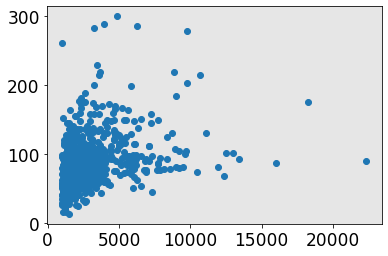

In [195]:
plt.scatter(merged_df.core_area,merged_df.core_rain_rate_max)

## Get ERA5 +PV advection for large TRMM WCCs

In [40]:
# perform calculations on a sub-domain to speed things up
from multiprocessing import Pool
import os
import time
import csv
from windspharm.xarray import VectorWind

In [26]:
# load TRMM WCC data
dd=pd.read_csv('TRMM_WCC_data_1998-2013_SONDJFM.csv')
df_wcc=dd.loc[:, ~dd.columns.str.match('^Unnamed')]
df_wcc['datetime']=pd.to_datetime(df_wcc['datetime'])

# extract the data within a lat-lon box
df_wcc=df_wcc.loc[(df_wcc.core_lon>=-70.) & (df_wcc.core_lon<=-50.) &\
                 (df_wcc.core_lat >=-45.) & (df_wcc.core_lat<=-20)]
df_wcc=df_wcc.set_index('datetime')
#unique_days_wcc=pd.to_datetime(pd.to_datetime(df_wcc['datetime']).map(pd.Timestamp.date).unique())
#unique_days_wcc


/glade/scratch/isingh9/ipykernel_26974/1796538718.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_wcc['datetime']=pd.to_datetime(df_wcc['datetime'])


In [27]:
df_wcc.groupby([df_wcc.index.month])['orbit'].count()#.values

datetime
1     570
2     544
3     497
9     403
10    600
11    562
12    579
Name: orbit, dtype: int64

In [28]:
# For repeating time indexes, add one second to the index to differentiate
values = df_wcc.index.duplicated(keep=False).astype(float)
values[values==0] = np.NaN

missings = np.isnan(values)
cumsum = np.cumsum(~missings)
diff = np.diff(np.concatenate(([0.], cumsum[missings])))
values[missings] = -diff
# print result
result = df_wcc.index + np.cumsum(values)*pd.Timedelta(1, "s")
#print(result)
df_wcc.index = result
df_wcc

,orbit,date,time,core_id,core_lon,core_lat,core_area,core_top_ht,core_bot_ht,core_dim_x,...,storm_rain_rate_min,storm_rain_pix_all,storm_rain_pix_stra,storm_rain_pix_conv,storm_rain_rate_mean_all,storm_rain_rate_mean_stra,storm_rain_rate_mean_conv,storm_rain_vol_all,storm_rain_vol_stra,storm_rain_vol_conv
datetime,,,,,,,,,,,,,,,,,,,,,
1998-01-01 05:26:51,b'00542',19980101,52650,2.0,-64.47,-30.33,2508.05,6.75,1.00,1.30,...,0.0,3813.0,1430.0,1408.0,7.1839,1.5280,17.8818,202.4453,16.1485,186.0775
1998-01-01 05:26:52,b'00542',19980101,52650,1.0,-62.72,-30.85,2467.97,9.50,0.75,0.80,...,0.0,3813.0,1430.0,1408.0,7.1839,1.5280,17.8818,202.4453,16.1485,186.0775
1998-01-03 22:37:01,b'00584',19980103,223701,1.0,-59.45,-27.10,1981.24,6.50,0.75,0.75,...,0.0,1505.0,806.0,346.0,2.9124,0.8403,10.6890,33.7102,5.2091,28.4438
1998-01-04 23:01:43,b'00600',19980104,230142,1.0,-56.28,-32.08,1126.27,7.50,0.50,0.40,...,0.0,2654.0,1514.0,494.0,2.6149,0.9907,10.9750,50.8352,10.9871,39.7132
1998-01-04 23:01:44,b'00600',19980104,230142,2.0,-55.80,-31.58,1027.05,6.50,0.75,0.55,...,0.0,2654.0,1514.0,494.0,2.6149,0.9907,10.9750,50.8352,10.9871,39.7132
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2013-12-29 06:18:34,b'91823',20131229,61834,1.0,-62.53,-30.70,2046.56,9.25,1.25,0.70,...,0.0,2243.0,1076.0,826.0,8.0150,1.1504,20.2602,132.4872,9.1224,123.3288
2013-12-30 00:32:47,b'91834',20131230,3247,1.0,-51.88,-29.33,1212.74,7.75,1.25,0.70,...,0.0,712.0,305.0,277.0,4.1240,1.2650,9.2075,21.9760,2.8877,19.0883
2013-12-30 05:26:31,b'91838',20131230,52631,1.0,-53.33,-29.05,2648.17,6.75,0.75,1.20,...,0.0,690.0,383.0,197.0,4.2316,1.6234,11.6651,21.8737,4.6580,17.2157


In [29]:
# get WCC days and calulate PV advection on those days, the calculate correlation bw 
#PVADV values and WCC area, rainfall etc. 
df_wcc_temp=df_wcc[['core_area','core_top_ht',  'core_dim_x', 'core_dim_y', 
       'core_rain_rate_mean','core_rain_rate_max', 'core_rain_rate_min', 
       'core_rain_rate_mean_all','core_rain_rate_mean_stra', 'core_rain_rate_mean_conv',
       'core_rain_vol_all', 'core_rain_vol_stra', 'core_rain_vol_conv']]
#df_wcc_temp

large_wcc_area_thres  = df_wcc_temp['core_area'].quantile(.90)
print('core area 75 percentile : ',large_wcc_area_thres)
df_wcc_large= df_wcc_temp[df_wcc_temp['core_area'] >= large_wcc_area_thres]
df_wcc_large=df_wcc_large.resample('D').max().dropna()
df_wcc_large

core area 75 percentile :  3997.2739999999994


,core_area,core_top_ht,core_dim_x,core_dim_y,core_rain_rate_mean,core_rain_rate_max,core_rain_rate_min,core_rain_rate_mean_all,core_rain_rate_mean_stra,core_rain_rate_mean_conv,core_rain_vol_all,core_rain_vol_stra,core_rain_vol_conv
datetime,,,,,,,,,,,,,
1998-01-07,5709.91,7.25,1.65,1.05,19.18,115.52,0.00,19.1768,0.0,19.1768,30.4160,0.0,30.4160
1998-01-15,6232.79,9.75,2.10,1.10,15.41,63.67,0.00,15.4129,0.0,15.4129,26.6849,0.0,26.6849
1998-01-21,9329.27,8.50,2.20,1.10,18.76,52.47,1.19,18.7557,0.0,18.7557,48.6048,0.0,48.6048
1998-01-30,6165.43,7.25,1.55,1.10,23.60,198.96,1.18,23.6002,0.0,23.6002,40.4182,0.0,40.4182
1998-02-04,5836.55,8.50,1.75,1.40,22.53,127.73,1.11,22.5328,0.0,22.5328,34.9627,0.0,34.9627
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2013-10-26,4375.32,4.75,1.40,1.15,17.50,72.36,1.50,17.5046,0.0,17.5046,21.2745,0.0,21.2745
2013-10-31,9634.60,9.75,2.15,1.50,27.46,193.98,0.00,27.4586,0.0,27.4586,58.4109,0.0,58.4109
2013-11-01,10494.51,9.00,2.00,1.90,24.00,121.55,2.63,23.9951,0.0,23.9951,69.9491,0.0,69.9491


In [27]:
df_wcc_temp.loc['1998-01-07']

,core_area,core_top_ht,core_dim_x,core_dim_y,core_rain_rate_mean,core_rain_rate_max,core_rain_rate_min,core_rain_rate_mean_all,core_rain_rate_mean_stra,core_rain_rate_mean_conv,core_rain_vol_all,core_rain_vol_stra,core_rain_vol_conv
datetime,,,,,,,,,,,,,
1998-01-07 03:03:39,5709.91,7.25,1.65,1.05,19.18,115.52,0.00,19.1768,0.0,19.1768,30.4160,0.0,30.4160
1998-01-07 03:03:39,2768.92,9.50,0.85,0.85,19.48,117.55,0.61,19.4792,0.0,19.4792,14.9824,0.0,14.9824


In [18]:
DIRECTORY_PRES    = '/glade/collections/rda/data/ds633.0/e5.oper.an.pl/'
DIRECTORY_FLUX    = '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/'

era5_time_range = df_wcc_large.index
print(era5_time_range)
print('----------------------------------\n')
u_filenames  = [DIRECTORY_PRES+TIME.strftime('%Y%m')+'/'+'e5.oper.an.pl.128_131_u.ll025uv.'+TIME.strftime('%Y%m%d00_%Y%m%d23.nc') for TIME in era5_time_range]
v_filenames  = [DIRECTORY_PRES+TIME.strftime('%Y%m')+'/'+'e5.oper.an.pl.128_132_v.ll025uv.'+TIME.strftime('%Y%m%d00_%Y%m%d23.nc') for TIME in era5_time_range]
pv_filenames = [DIRECTORY_PRES+TIME.strftime('%Y%m')+'/'+'e5.oper.an.pl.128_060_pv.ll025sc.'+TIME.strftime('%Y%m%d00_%Y%m%d23.nc') for TIME in era5_time_range]

argument = []
for xx in range(len(u_filenames)):
    for yy in range(24):
        #argument = argument + [(yy,u_filenames[xx],v_filenames[xx],pv_filenames[xx],mtpr_filenames)]
        argument = argument + [(yy,u_filenames[xx],v_filenames[xx],pv_filenames[xx])]

print(len(argument))

#csv_file_name='ERA5_time_series_va_meridional_index_ulpvadvirrot_parallel_7outputvars_'+time_period_csv+'.csv'
csv_file_name='ERA5_time_series_max_ulpvadvirrot_large_wcc_days.csv'

print('csv_file_name:  ',csv_file_name)

    
def main(FUNCTION, ARGUMENT, CSV_FILENAME):
    pool = Pool(24)
    start_time = time.perf_counter()
    results = pool.starmap(FUNCTION, ARGUMENT)
    finish_time = time.perf_counter()
    print(f"Program finished in {finish_time-start_time} seconds")


    filio = open(CSV_FILENAME, 'w+', newline ='')

    # writing the data into the file
    with filio:   
        write = csv.writer(filio)
        write.writerows(results)
    print('\nCSV file written!!!\n')

if __name__ == "__main__":
    #main(process_ERA5_file_parallel, argument, csv_file_name)
    main(get_ERA5_max_PVadv, argument, csv_file_name)
#print(argument)
#era5_time_range.month

DatetimeIndex(['1998-01-15', '1998-01-21', '1998-01-30', '1998-02-07',
               '1998-02-17', '1998-03-06', '1998-09-12', '1998-09-27',
               '1998-10-22', '1998-11-14',
               ...
               '2012-11-22', '2012-12-06', '2013-01-25', '2013-02-24',
               '2013-03-08', '2013-03-10', '2013-09-07', '2013-10-24',
               '2013-10-31', '2013-11-01'],
              dtype='datetime64[ns]', name='datetime', length=147, freq=None)
----------------------------------

3528
csv_file_name:   ERA5_time_series_max_ulpvadvirrot_large_wcc_days.csv
working on time  1999-03-28 21:00:00
working on time  2001-01-23 09:00:00
working on time  1998-12-21 19:00:00
working on time  2000-10-17 03:00:00working on time 
 1998-02-07 02:00:00
working on time  1998-09-27 17:00:00
working on time working on time   2001-10-08 22:00:002000-10-23 16:00:00

working on time  1998-01-15 00:00:00
working on time  2001-01-07 20:00:00
working on time  1998-11-14 06:00:00
working on tim

latitude of max positive PV advection is  -29.0
latitude of max positive PV advection is  302.5
working on time  1998-01-15 06:00:00
latitude of max positive PV advection is  -27.75
latitude of max positive PV advection is  298.5
working on time  2000-10-17 08:00:00
latitude of max positive PV advection is  -23.25
latitude of max positive PV advection is  303.0
latitude of max positive PV advection is  -31.25
latitude of max positive PV advection is  309.75
working on time latitude of max positive PV advection is   -25.75latitude of max positive PV advection is  2001-11-14 16:00:00-40.0

latitude of max positive PV advection is working on time 
  latitude of max positive PV advection is 301.5 305.25
1998-02-07 07:00:00

working on time working on time   2000-10-23 21:00:002001-01-23 14:00:00
latitude of max positive PV advection is  -26.75latitude of max positive PV advection is  -37.5
latitude of max positive PV advection is  308.0


latitude of max positive PV advection is latitude o

latitude of max positive PV advection is  working on time  1998-09-12 15:00:00
309.75
 295.0
working on time  2001-10-27 09:00:00
latitude of max positive PV advection is  -36.0
latitude of max positive PV advection is  295.0
working on time  1998-12-28 05:00:00
latitude of max positive PV advection is  -32.0
latitude of max positive PV advection is  296.75
latitude of max positive PV advection is  -28.5
latitude of max positive PV advection is  309.75
latitude of max positive PV advection is  -40.0
latitude of max positive PV advection is  298.25
working on time  2000-02-11 09:00:00
working on time  1998-10-22 02:00:00
working on time  2000-02-25 22:00:00
working on time  2000-10-14 00:00:00
latitude of max positive PV advection is  -36.0
latitude of max positive PV advection is  309.5
working on time  1998-11-14 16:00:00
latitude of max positive PV advection is  -35.0
latitude of max positive PV advection is  300.75
latitude of max positive PV advection is working on time   2000-12-2

working on time  2000-02-11 14:00:00
latitude of max positive PV advection is  -37.5
latitude of max positive PV advection is  296.5
working on time  2001-01-18 11:00:00
latitude of max positive PV advection is  -36.75
latitude of max positive PV advection is  302.75
latitude of max positive PV advection is  -40.0
latitude of max positive PV advection is  295.75
working on time  1998-01-30 04:00:00
working on time  2000-02-08 01:00:00
latitude of max positive PV advection is  -39.25
latitude of max positive PV advection is  299.0
working on time  1998-10-22 07:00:00
latitude of max positive PV advection is  -32.75
latitude of max positive PV advection is  309.75
working on time  2001-10-08 00:00:00
latitude of max positive PV advection is  -30.5
latitude of max positive PV advection is  309.25
working on time  2000-11-29 22:00:00
latitude of max positive PV advection is  -38.75
latitude of max positive PV advection is  297.5
working on time  1999-03-28 00:00:00
latitude of max positive

latitude of max positive PV advection is  -28.75
latitude of max positive PV advection is  300.5
working on time  2000-02-08 06:00:00
latitude of max positive PV advection is  -36.0
latitude of max positive PV advection is  297.5
working on time  1998-12-28 15:00:00
working on time  1998-09-27 01:00:00
latitude of max positive PV advection is  -33.75
latitude of max positive PV advection is  306.25
working on time  1999-03-28 05:00:00
latitude of max positive PV advection is  -32.75
latitude of max positive PV advection is  302.25
working on time  1998-01-30 09:00:00
latitude of max positive PV advection is  -24.5
latitude of max positive PV advection is  308.0
working on time  2000-10-17 22:00:00
latitude of max positive PV advection is  -29.5
latitude of max positive PV advection is  296.25
latitude of max positive PV advection is  -31.25
latitude of max positive PV advection is  298.25
working on time  2000-03-16 21:00:00
latitude of max positive PV advection is  -37.75
latitude of 

working on time  2000-10-14 15:00:00
latitude of max positive PV advection is  -34.0
latitude of max positive PV advection is  298.5
latitude of max positive PV advection is  -40.0
latitude of max positive PV advection is  298.25
working on time  1998-12-21 08:00:00
working on time  1998-10-22 17:00:00
latitude of max positive PV advection is  -31.75
latitude of max positive PV advection is latitude of max positive PV advection is   308.75-37.25

latitude of max positive PV advection is  297.75
working on time  1998-03-06 18:00:00
working on time  1999-03-28 10:00:00
latitude of max positive PV advection is  -40.0
latitude of max positive PV advection is  297.25
working on time  2001-01-07 09:00:00
latitude of max positive PV advection is  -35.75
latitude of max positive PV advection is  299.5
working on time  1998-12-28 20:00:00
latitude of max positive PV advection is  -27.25
latitude of max positive PV advection is  300.75
latitude of max positive PV advection is  -40.0
latitude of 

working on time  1999-03-28 15:00:00
latitude of max positive PV advection is  -37.5
latitude of max positive PV advection is  300.5
working on time  2001-10-08 15:00:00
latitude of max positive PV advection is  -40.0
latitude of max positive PV advection is  297.75
working on time  latitude of max positive PV advection is  2001-01-07 14:00:00
-32.0
latitude of max positive PV advection is  309.75
latitude of max positive PV advection is  -33.25
latitude of max positive PV advection is  309.25working on time  1998-03-06 23:00:00

working on time  2000-12-04 14:00:00
latitude of max positive PV advection is  -27.75
latitude of max positive PV advection is  295.0
working on time  2001-01-23 02:00:00
latitude of max positive PV advection is  -27.5
latitude of max positive PV advection is  296.0
working on time  2000-02-08 16:00:00
latitude of max positive PV advection is  -32.25
latitude of max positive PV advection is  295.0
working on time  2001-11-14 06:00:00
latitude of max positive P

latitude of max positive PV advection is  -39.0
latitude of max positive PV advection is  295.25
working on time  2000-02-08 21:00:00
working on time  2002-01-13 23:00:00
latitude of max positive PV advection is  -39.0
latitude of max positive PV advection is  295.0
latitude of max positive PV advection is  -40.0
latitude of max positive PV advection is  300.0
working on time  1998-01-21 12:00:00
working on time  2002-10-08 04:00:00
latitude of max positive PV advection is  -30.75
latitude of max positive PV advection is  307.25
latitude of max positive PV advection is  -28.25
latitude of max positive PV advection is  303.75
working on time  2001-11-14 09:00:00
working on time  2002-10-21 17:00:00
latitude of max positive PV advection is  -25.75
latitude of max positive PV advection is  301.5
working on time  1998-02-07 01:00:00
latitude of max positive PV advection is  -40.0
latitude of max positive PV advection is  308.25
latitude of max positive PV advection is  -24.5
latitude of ma

latitude of max positive PV advection is  295.5
working on time  2004-11-10 10:00:00
latitude of max positive PV advection is  -26.0
latitude of max positive PV advection is  309.5
working on time  2002-09-17 19:00:00
latitude of max positive PV advection is  -40.0
latitude of max positive PV advection is  295.0
working on time  2002-12-06 23:00:00
latitude of max positive PV advection is  -24.0
latitude of max positive PV advection is  295.0
latitude of max positive PV advection is  -34.75
latitude of max positive PV advection is  307.25
working on time  2003-11-29 05:00:00
working on time  2004-10-13 20:00:00
latitude of max positive PV advection is  -34.0
latitude of max positive PV advection is  309.75
working on time  2003-01-22 01:00:00
latitude of max positive PV advection is -31.5 
latitude of max positive PV advection is  302.25
latitude of max positive PV advection is  -26.75
latitude of max positive PV advection is  305.75
working on time  2002-03-04 19:00:00
latitude of max

working on time  2002-09-12 00:00:00
latitude of max positive PV advection is  -27.0latitude of max positive PV advection is 
latitude of max positive PV advection is latitude of max positive PV advection is   -35.75
latitude of max positive PV advection is  -38.0 302.25303.75


latitude of max positive PV advection is  295.0
working on time working on time   2003-01-22 06:00:002003-12-08 22:00:00

working on time  2004-11-03 01:00:00
working on time  2002-10-02 00:00:00
latitude of max positive PV advection is  -35.25
latitude of max positive PV advection is  304.5
working on time  2002-11-04 16:00:00
latitude of max positive PV advection is  -31.75
latitude of max positive PV advection is  latitude of max positive PV advection is 309.75latitude of max positive PV advection is 
  -26.0
latitude of max positive PV advection is  295.0
-36.0
latitude of max positive PV advection is  306.25
working on time  2004-11-10 15:00:00
working on time  2002-10-08 15:00:00
working on time  2002-10-

latitude of max positive PV advection is  295.5
working on time  2002-11-04 21:00:00
latitude of max positive PV advection is  -36.25
latitude of max positive PV advection is  304.75
working on time  2003-10-19 13:00:00
latitude of max positive PV advection is  -37.0
latitude of max positive PV advection is  latitude of max positive PV advection is  -20.25
latitude of max positive PV advection is  303.25309.75

working on time  2002-12-14 10:00:00
latitude of max positive PV advection is  -30.0
latitude of max positive PV advection is  latitude of max positive PV advection is 305.75
latitude of max positive PV advection is  -23.25
latitude of max positive PV advection is  295.0
 -28.5
latitude of max positive PV advection is  307.25
working on time  2004-10-17 19:00:00
latitude of max positive PV advection is  -33.5
latitude of max positive PV advection is  306.75
working on time  2002-10-26 08:00:00
working on time  2004-11-03 06:00:00working on time  2003-11-29 16:00:00

working on t

latitude of max positive PV advection is  306.75
working on time  2002-10-02 09:00:00working on time 
 2004-10-16 11:00:00
working on time  2002-12-06 02:00:00
working on time  2003-12-22 07:00:00
latitude of max positive PV advection is  -40.0
latitude of max positive PV advection is  299.5
working on time  2003-01-22 16:00:00
latitude of max positive PV advection is  -30.25
latitude of max positive PV advection is  301.75
working on time  2003-11-18 06:00:00
latitude of max positive PV advection is  -29.75
latitude of max positive PV advection is  301.25
working on time  2002-09-12 10:00:00
latitude of max positive PV advection is  -40.0
latitude of max positive PV advection is  295.0
working on time  2005-03-08 03:00:00
latitude of max positive PV advection is  -30.0
latitude of max positive PV advection is  299.0latitude of max positive PV advection is  
-30.25
latitude of max positive PV advection is  302.5
working on time  2003-01-21 03:00:00
working on time  2005-02-06 13:00:00


latitude of max positive PV advection is  301.25
working on time  2002-09-17 07:00:00
latitude of max positive PV advection is  -40.0
latitude of max positive PV advection is  -24.0
latitude of max positive PV advection is  303.25
working on time  2002-12-14 21:00:00
latitude of max positive PV advection is  303.0
latitude of max positive PV advection is  -32.5
latitude of max positive PV advection is  309.75
working on time  2002-10-21 07:00:00
working on time  2003-01-22 22:00:00
latitude of max positive PV advection is  -29.75
latitude of max positive PV advection is  309.75
working on time  2002-10-26 18:00:00
latitude of max positive PV advection is  -32.75
latitude of max positive PV advection is  295.0
working on time  2003-01-21 08:00:00
latitude of max positive PV advection is  -26.5
latitude of max positive PV advection is  300.5
working on time  2002-12-06 06:00:00
latitude of max positive PV advection is  -30.0
latitude of max positive PV advection is  303.5
working on time

latitude of max positive PV advection is  301.5
working on time  2003-01-21 13:00:00
latitude of max positive PV advection is  -36.0
latitude of max positive PV advection is  307.0
working on time  2002-03-04 10:00:00
latitude of max positive PV advection is  -33.75
latitude of max positive PV advection is  305.25
working on time  2004-10-16 22:00:00
latitude of max positive PV advection is  -25.75
latitude of max positive PV advection is latitude of max positive PV advection is  -34.0 295.0

latitude of max positive PV advection is  299.25
working on time  2002-12-06 11:00:00
latitude of max positive PV advection is working on time  2004-10-23 11:00:00
 -34.75
latitude of max positive PV advection is  306.0
working on time  2005-11-04 14:00:00
latitude of max positive PV advection is  -32.5
latitude of max positive PV advection is  304.25
working on time  2003-10-25 05:00:00
latitude of max positive PV advection is  -34.25
latitude of max positive PV advection is  295.25
working on ti

latitude of max positive PV advection is  297.5
working on time  2005-10-03 06:00:00
latitude of max positive PV advection is  -32.0
latitude of max positive PV advection is  307.0
latitude of max positive PV advection is  -39.25
latitude of max positive PV advection is  309.25
latitude of max positive PV advection is  -38.0
latitude of max positive PV advection is  299.0
latitude of max positive PV advection is  -38.5
latitude of max positive PV advection is  300.0
working on time  2005-11-04 18:00:00
working on time  2005-01-09 16:00:00
working on time  2003-09-23 20:00:00
latitude of max positive PV advection is  -25.75
latitude of max positive PV advection is  295.0
latitude of max positive PV advection is  -35.5
latitude of max positive PV advection is  
302.0latitude of max positive PV advection is  -40.0working on time  2004-10-23 16:00:00
latitude of max positive PV advection is  -21.5
latitude of max positive PV advection is  309.75

latitude of max positive PV advection is  3

latitude of max positive PV advection is  297.0
working on time  2007-11-08 12:00:00
latitude of max positive PV advection is latitude of max positive PV advection is   -40.0-33.25

latitude of max positive PV advection is latitude of max positive PV advection is   295.0309.75

working on time  2006-11-06 22:00:00
working on time  2009-01-12 04:00:00
latitude of max positive PV advection is  -34.25
latitude of max positive PV advection is  299.75
working on time  2007-03-27 00:00:00
latitude of max positive PV advection is  -28.75
latitude of max positive PV advection is  304.0
working on time  2006-09-20 09:00:00
latitude of max positive PV advection is  -31.75
latitude of max positive PV advection is  300.5
latitude of max positive PV advection is  -40.0
latitude of max positive PV advection is  307.25
working on time working on time   2006-01-16 20:00:00
2009-03-02 06:00:00
latitude of max positive PV advection is  -38.25
latitude of max positive PV advection is  304.75
working on t

latitude of max positive PV advection is  297.5
working on time  2007-03-27 05:00:00
latitude of max positive PV advection is  -33.75
latitude of max positive PV advection is  297.25
latitude of max positive PV advection is  latitude of max positive PV advection is  -29.5
latitude of max positive PV advection is  304.75
-37.0
latitude of max positive PV advection is  303.75
latitude of max positive PV advection is latitude of max positive PV advection is  -27.5
latitude of max positive PV advection is  303.25
 -37.25
latitude of max positive PV advection is  309.0
working on time  2009-01-12 09:00:00
latitude of max positive PV advection is  -26.75
working on time latitude of max positive PV advection is   2008-11-02 20:00:00295.0

working on time  2007-11-19 06:00:00
working on time  2006-03-04 15:00:00
working on time  2006-12-18 03:00:00
working on time  2009-11-22 13:00:00
latitude of max positive PV advection is  -40.0
latitude of max positive PV advection is  296.75
working on ti

latitude of max positive PV advection is latitude of max positive PV advection is  309.75 
295.0
latitude of max positive PV advection is  -26.5
latitude of max positive PV advection is  306.0
working on time  2009-03-02 16:00:00
working on time  2009-10-11 18:00:00
latitude of max positive PV advection is  -31.5
latitude of max positive PV advection is  302.5
working on time  2007-11-08 22:00:00
working on time  2008-10-13 00:00:00
latitude of max positive PV advection is  latitude of max positive PV advection is -31.25
latitude of max positive PV advection is  -36.5 
latitude of max positive PV advection is 303.0 
307.0
working on time  2006-03-04 20:00:00
working on time  2009-09-18 05:00:00
latitude of max positive PV advection is  -33.5
latitude of max positive PV advection is  295.0
working on time  2006-01-03 08:00:00
latitude of max positive PV advection is  -31.75
latitude of max positive PV advection is  297.75
working on time  2008-11-24 02:00:00
latitude of max positive PV 

latitude of max positive PV advection is  299.0
 -36.5

latitude of max positive PV advection is working on time   2006-09-01 13:00:00
309.75
working on time  working on time 2009-09-18 10:00:00 2008-10-22 19:00:00
latitude of max positive PV advection is  
-29.75
working on time latitude of max positive PV advection is   302.0
2009-01-25 06:00:00working on time 
 2006-03-11 01:00:00
working on time  2009-11-21 10:00:00
latitude of max positive PV advection is  -25.0
latitude of max positive PV advection is  309.0
working on time  2006-11-06 00:00:00
latitude of max positive PV advection is  -31.75
latitude of max positive PV advection is  301.0
latitude of max positive PV advection is working on time   -32.75
2009-12-16 12:00:00
latitude of max positive PV advection is  300.25
working on time  2006-12-18 13:00:00
latitude of max positive PV advection is  -25.25
latitude of max positive PV advection is  301.75
working on time  2009-10-11 23:00:00
latitude of max positive PV advection i

latitude of max positive PV advection is  303.5
working on time  2008-10-13 10:00:00
working on time  2006-01-03 18:00:00
working on time  2006-11-06 05:00:00
latitude of max positive PV advection is latitude of max positive PV advection is   -40.0
latitude of max positive PV advection is  -29.0
latitude of max positive PV advection is 295.0
 303.25
latitude of max positive PV advection is  -39.0
latitude of max positive PV advection is  302.5
working on time  2009-11-21 15:00:00
working on time  2005-11-23 04:00:00
working on time  2006-03-11 06:00:00
latitude of max positive PV advection is  -32.5
latitude of max positive PV advection is  301.75
working on time  2007-11-09 08:00:00
latitude of max positive PV advection is  -32.75
latitude of max positive PV advection is  296.25
latitude of max positive PV advection is  -38.5
latitude of max positive PV advection is  304.5
working on time  2009-10-21 04:00:00
working on time  2006-12-18 18:00:00
latitude of max positive PV advection i

working on time  2006-01-12 00:00:00
latitude of max positive PV advection is  -20.25
latitude of max positive PV advection is  309.75
latitude of max positive PV advection is  -32.75
latitude of max positive PV advection is  295.0
working on time  2006-02-01 21:00:00
working on time  2009-12-20 09:00:00
latitude of max positive PV advection is  -28.25
latitude of max positive PV advection is  299.5
working on time 2007-11-09 14:00:00 
latitude of max positive PV advection is  -40.0
latitude of max positive PV advection is  304.0
latitude of max positive PV advection is  -29.75
latitude of max positive PV advection is  297.5
working on time  2009-10-21 09:00:00
working on time  2006-01-16 14:00:00
latitude of max positive PV advection is  -38.0
latitude of max positive PV advection is  295.0
working on time  2006-03-11 11:00:00
latitude of max positive PV advection is  -40.0
latitude of max positive PV advection is  299.25
working on time  2007-03-09 12:00:00
latitude of max positive P

latitude of max positive PV advection is  -33.25
latitude of max positive PV advection is  working on time  2009-01-18 11:00:00
297.75
working on time  2009-10-11 02:00:00
latitude of max positive PV advection is  -29.5
latitude of max positive PV advection is  302.5
working on time  2006-09-20 03:00:00
latitude of max positive PV advection is  -35.75
latitude of max positive PV advection is  295.0latitude of max positive PV advection is 
 -38.0
latitude of max positive PV advection is  298.0
working on time  2006-12-20 05:00:00
latitude of max positive PV advection is  -33.0
latitude of max positive PV advection is  305.5
working on time  2010-02-06 15:00:00
working on time  2010-01-16 16:00:00
latitude of max positive PV advection is  -40.0
latitude of max positive PV advection is  297.5
working on time  2009-12-20 14:00:00
latitude of max positive PV advection is  -24.5
latitude of max positive PV advection is  304.75
working on time  2008-11-24 22:00:00
latitude of max positive PV 

latitude of max positive PV advection is  -35.0
latitude of max positive PV advection is  301.5
working on time  2010-12-11 21:00:00
latitude of max positive PV advection is  -40.0
latitude of max positive PV advection is  306.0
working on time  2010-01-16 21:00:00
latitude of max positive PV advection is  -34.5
latitude of max positive PV advection is  309.75
working on time  2009-12-31 10:00:00
latitude of max positive PV advection is  -35.75
latitude of max positive PV advection is  298.5
working on time  2009-12-19 08:00:00
latitude of max positive PV advection is  -40.0
latitude of max positive PV advection is  304.5
working on time  2010-02-06 19:00:00
latitude of max positive PV advection is  -40.0
latitude of max positive PV advection is  307.25
working on time  2012-03-06 14:00:00
latitude of max positive PV advection is  -35.0
latitude of max positive PV advection is  297.0
working on time  2010-03-18 20:00:00
latitude of max positive PV advection is  -33.0
latitude of max po

latitude of max positive PV advection is latitude of max positive PV advection is   -32.25
latitude of max positive PV advection is  299.0
-31.5
latitude of max positive PV advection is  296.5
working on time  2012-11-22 09:00:00
working on time  2012-12-06 22:00:00
working on time  2012-03-01 06:00:00
latitude of max positive PV advection is  -20.25
latitude of max positive PV advection is  299.25
working on time  2010-10-13 01:00:00
latitude of max positive PV advection is  -32.5
latitude of max positive PV advection is  309.75
latitude of max positive PV advection is  -33.0
latitude of max positive PV advection is  latitude of max positive PV advection is -26.25 
latitude of max positive PV advection is 298.0 
308.5
working on time  2011-10-07 03:00:00
working on time  2013-10-24 23:00:00
working on time  2013-03-08 21:00:00
latitude of max positive PV advection is  -39.25
latitude of max positive PV advection is  295.0
working on time  2012-02-18 05:00:00
latitude of max positive P

latitude of max positive PV advection is  -29.0
latitude of max positive PV advection is  295.0
working on time  2010-12-12 08:00:00
latitude of max positive PV advection is  -38.0
latitude of max positive PV advection is  301.75
working on time  2012-02-18 11:00:00
latitude of max positive PV advection is  -34.5latitude of max positive PV advection is 
 latitude of max positive PV advection is -31.5
latitude of max positive PV advection is   295.0301.75
latitude of max positive PV advection is  -36.5
latitude of max positive PV advection is  298.5

working on time  2012-03-01 12:00:00
working on time  2012-02-25 22:00:00
working on time  2010-01-19 08:00:00
latitude of max positive PV advection is  -36.0
latitude of max positive PV advection is  295.0
working on time  2011-10-07 08:00:00
latitude of max positive PV advection is  -40.0
latitude of max positive PV advection is  296.0
latitude of max positive PV advection is  -31.5
latitude of max positive PV advection is  working on tim

latitude of max positive PV advection is  -40.0
latitude of max positive PV advection is  302.5
working on time  2010-02-06 00:00:00
latitude of max positive PV advection is  -37.25
latitude of max positive PV advection is  304.5
working on time  2012-10-02 17:00:00
latitude of max positive PV advection is  -36.25
latitude of max positive PV advection is  300.5
working on time  2010-01-19 13:00:00
latitude of max positive PV advection is  -26.0
latitude of max positive PV advection is  303.25
working on time  2010-03-14 23:00:00
latitude of max positive PV advection is  -30.75
latitude of max positive PV advection is  309.75
working on time  2012-03-22 05:00:00
latitude of max positive PV advection is  -40.0
latitude of max positive PV advection is  298.0
working on time  2012-10-29 07:00:00
latitude of max positive PV advection is  -38.25
latitude of max positive PV advection is  305.75
working on time  2012-02-18 16:00:00
latitude of max positive PV advection is  -35.0latitude of max

latitude of max positive PV advection is  309.75
working on time  2010-02-11 16:00:00
working on time  2013-03-08 00:00:00
latitude of max positive PV advection is  -23.5
latitude of max positive PV advection is  295.0
latitude of max positive PV advection is  -33.25
latitude of max positive PV advection is  301.5
working on time  2010-10-13 18:00:00
latitude of max positive PV advection is  -38.0
latitude of max positive PV advection is  301.5
working on time  2010-01-16 07:00:00
working on time  2010-01-19 19:00:00
latitude of max positive PV advection is  -37.5
latitude of max positive PV advection is  298.5
working on time  2012-10-29 13:00:00
latitude of max positive PV advection is  -36.25
latitude of max positive PV advection is  306.0
latitude of max positive PV advection is  -36.75
latitude of max positive PV advection is  295.0
working on time  2012-01-25 08:00:00
working on time  2011-10-07 18:00:00
latitude of max positive PV advection is  -36.5
latitude of max positive PV 

latitude of max positive PV advection is  309.75
working on time  2010-03-18 11:00:00
latitude of max positive PV advection is  -37.0
latitude of max positive PV advection is  297.25
working on time  2011-09-17 12:00:00
latitude of max positive PV advection is  -25.5
latitude of max positive PV advection is  299.75
working on time  2013-01-25 18:00:00
latitude of max positive PV advection is  -29.0
latitude of max positive PV advection is  304.25
working on time  2012-03-22 16:00:00
latitude of max positive PV advection is  -28.5
latitude of max positive PV advection is  300.5
working on time  2010-10-13 23:00:00
latitude of max positive PV advection is  -40.0
latitude of max positive PV advection is  296.75
working on time  2012-02-25 03:00:00
latitude of max positive PV advection is  -31.25
latitude of max positive PV advection is  295.75
working on time  2012-10-15 04:00:00
latitude of max positive PV advection is  -33.5
latitude of max positive PV advection is  304.5
working on tim

latitude of max positive PV advection is  -29.0
latitude of max positive PV advection is  305.25
working on time  2012-03-22 21:00:00
latitude of max positive PV advection is  -34.5
latitude of max positive PV advection is  304.75
latitude of max positive PV advection is  -23.25
latitude of max positive PV advection is  300.5
latitude of max positive PV advection is  -32.25latitude of max positive PV advection is 
 latitude of max positive PV advection is  -37.75301.5
latitude of max positive PV advection is 
 296.0
working on time  2012-12-06 12:00:00
working on time  2012-01-25 18:00:00
working on time  working on time 2012-02-25 09:00:00
 2010-12-24 04:00:00
latitude of max positive PV advection is  -37.25
latitude of max positive PV advection is  300.0
working on time  2010-12-11 14:00:00
latitude of max positive PV advection is  -37.0
latitude of max positive PV advection is  307.0
working on time  2013-10-24 12:00:00
latitude of max positive PV advection is  -40.0
latitude of max

[504 408 504 312 696 576 528]


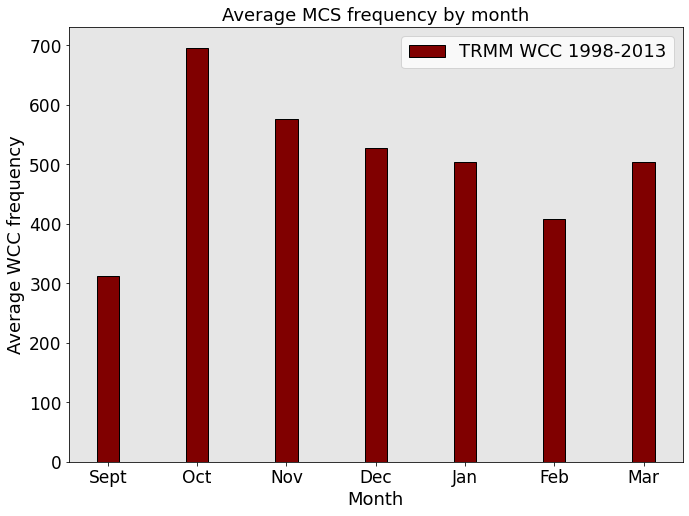

In [113]:
final_df_pv_adv=pd.read_csv('ERA5_time_series_max_ulpvadvirrot_large_wcc_days.csv',header=None,delimiter=',',names=['date','max_pos_PVadv','max_lat','max_lon'],index_col='date',parse_dates=True) 
final_df_pv_adv = final_df_pv_adv.sort_values(by='date')
ff=final_df_pv_adv.groupby(final_df_pv_adv.index.month).count()['max_pos_PVadv'].values
print(ff)
#plt.plot(ff)
ff_vals=[ff[3],ff[4],ff[5],ff[6],ff[0],ff[1],ff[2]]

fig = plt.figure(figsize=(11,8))
xtick_labels = ['Sept','Oct','Nov','Dec','Jan', 'Feb','Mar']

# Set position of bar on X axis
barWidth = 0.0
br1 = np.arange(len(data))
 
plt.bar(br1, ff_vals, color ='maroon',width=0.25,label='TRMM WCC 1998-2013',edgecolor='k')

plt.xlabel('Month')
plt.ylabel('Average WCC frequency')
plt.title ('Average MCS frequency by month')
plt.xticks([r + barWidth for r in range(len(data))],xtick_labels)
plt.legend()
#xtick_labels = ['Oct','Nov','Dec','Jan', 'Feb','Mar']
#ax.set_xticklabels(xtick_labels,rotation = 0)
#final_df.groupby(final_df.index.month).count().plot(kind="bar")
fig.savefig('no_MCSs_by_month_TRMM.png', dpi=200)

In [103]:
final_df_pv_adv=pd.read_csv('ERA5_time_series_max_ulpvadvirrot_large_wcc_days.csv',header=None,delimiter=',',names=['date','max_pos_PVadv','max_lat','max_lon'],index_col='date',parse_dates=True) 
final_df_pv_adv = final_df_pv_adv.sort_values(by='date')
#final_df_pv_adv=final_df_pv_adv.resample('D').max()

final_df_max_pv_adv_90_pc_composite=final_df_pv_adv['max_pos_PVadv'].quantile(.95)
df_pvadv_abv75pc = final_df_pv_adv[final_df_pv_adv['max_pos_PVadv'] >= final_df_max_pv_adv_90_pc_composite]
print(df_pvadv_abv75pc)
df_maybe=df_pvadv_abv75pc.loc[df_pvadv_abv75pc.groupby([df_pvadv_abv75pc.index.day, df_pvadv_abv75pc.index.month, df_pvadv_abv75pc.index.year])['max_pos_PVadv'].idxmax()]
df_maybe=df_maybe.sort_values(by='max_pos_PVadv',ascending=False)
print(df_maybe)
print(len(df_maybe))


                     max_pos_PVadv  max_lat  max_lon
date                                                
1998-09-12 07:00:00       2.187988   -28.25   305.75
1998-09-12 09:00:00       1.838418   -31.25   302.75
1998-09-12 10:00:00       2.121073   -32.00   303.75
1998-09-12 11:00:00       2.203948   -32.50   304.25
1998-09-12 12:00:00       2.195860   -33.50   305.50
...                            ...      ...      ...
2012-11-22 01:00:00       1.743160   -37.75   295.25
2012-11-22 02:00:00       1.959724   -38.50   295.00
2012-11-22 03:00:00       1.889063   -40.00   296.00
2012-11-22 04:00:00       1.649286   -40.00   295.00
2013-10-31 10:00:00       1.932974   -32.75   303.25

[177 rows x 3 columns]
                     max_pos_PVadv  max_lat  max_lon
date                                                
2003-09-23 06:00:00       3.954699   -36.00   301.50
2009-10-11 01:00:00       3.554348   -33.25   297.75
2009-09-07 23:00:00       3.517477   -28.25   303.75
2011-10-07 07:00:00   

mean lon is  300.11538461538464
mean lat is  -32.26923076923077
 working on time :  2006-09-01 20:00:00
MAX_LON:  303.25
MAX_LAT:  -27.5
shape of lats_TIM:  (120,)
shape of lons_TIM:  (120,)
shape of zz:  (120, 120)
 working on time :  2002-10-02 20:00:00
MAX_LON:  306.5
MAX_LAT:  -30.25
shape of lats_TIM:  (120,)
shape of lons_TIM:  (120,)
shape of zz:  (120, 120)
 working on time :  2004-11-03 07:00:00
MAX_LON:  309.75
MAX_LAT:  -33.75
shape of lats_TIM:  (120,)
shape of lons_TIM:  (120,)
shape of zz:  (120, 120)
 working on time :  2010-02-04 02:00:00
MAX_LON:  295.0
MAX_LAT:  -33.25
shape of lats_TIM:  (120,)
shape of lons_TIM:  (120,)
shape of zz:  (120, 120)
 working on time :  2010-02-06 00:00:00
MAX_LON:  296.5
MAX_LAT:  -34.5
shape of lats_TIM:  (120,)
shape of lons_TIM:  (120,)
shape of zz:  (120, 120)
 working on time :  2002-12-06 10:00:00
MAX_LON:  295.0
MAX_LAT:  -25.75
shape of lats_TIM:  (120,)
shape of lons_TIM:  (120,)
shape of zz:  (120, 120)
 working on time :  2001

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:1666: UserWarning: The following kwargs were not used by contour: 'linestyle', 'linewidth'
  result = matplotlib.axes.Axes.contour(self, *args, **kwargs)
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visib

saving to file:  ERA5_composite_pvadv_irrot_TRMM WCC day (>95 percentile PV adv irrot).png


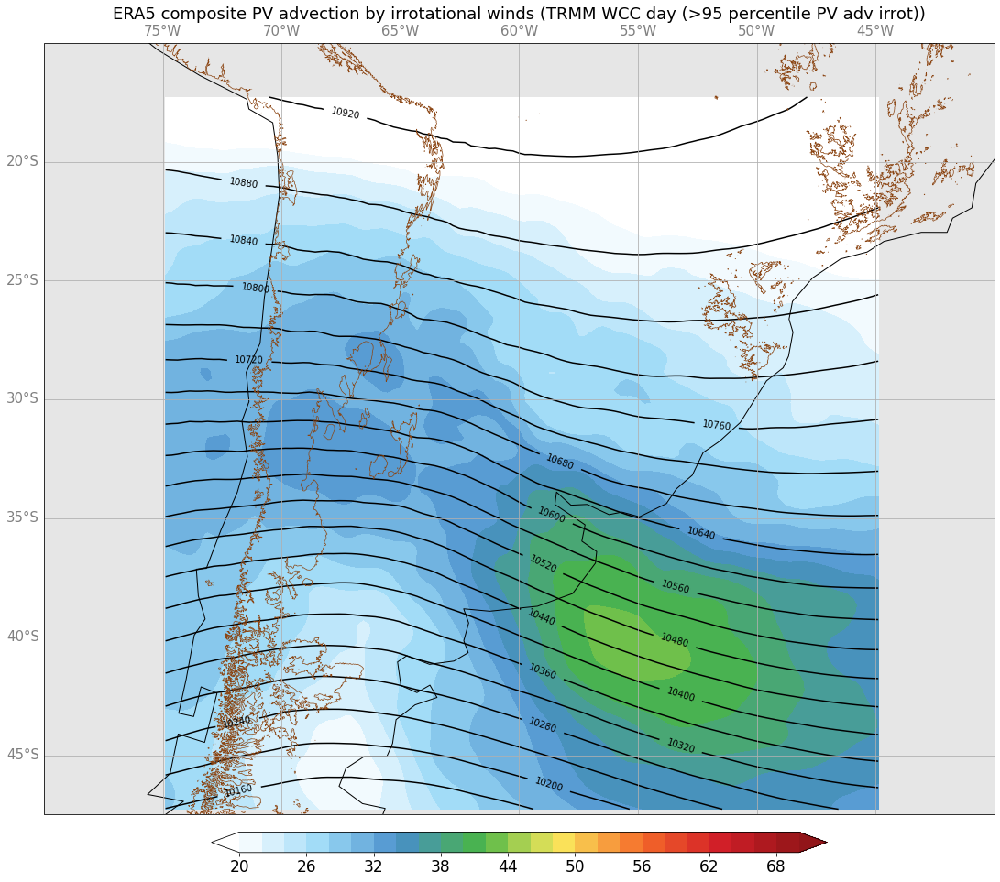

In [101]:
create_composite_ERA5_times_300hpa(df_maybe,250,'TRMM WCC day (>95 percentile PV adv irrot)')

u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200309/e5.oper.an.pl.128_131_u.ll025uv.2003092300_2003092323.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200309/e5.oper.an.pl.128_132_v.ll025uv.2003092300_2003092323.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200309/e5.oper.an.pl.128_060_pv.ll025sc.2003092300_2003092323.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200309/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2003091606_2003100106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200309/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2003090106_2003091606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200309/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2003091606_2003100106.nc']
    performing Helmholtz decomposition...
    getting rain rate...


/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_37070/131181990.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incor

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_greater_than_95percentile_PVadv_2003-09-23_06.png
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200910/e5.oper.an.pl.128_131_u.ll025uv.2009101100_2009101123.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200910/e5.oper.an.pl.128_132_v.ll025uv.2009101100_2009101123.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200910/e5.oper.an.pl.128_060_pv.ll025sc.2009101100_2009101123.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200909/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2009091606_2009100106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200910/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2009100106_2009101606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200910/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2009101606_2009110106.nc']
    performing Helmholtz decomposition...
    getting rain rate...


/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_37070/131181990.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incor

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_greater_than_95percentile_PVadv_2009-10-11_01.png
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200909/e5.oper.an.pl.128_131_u.ll025uv.2009090700_2009090723.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200909/e5.oper.an.pl.128_132_v.ll025uv.2009090700_2009090723.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200909/e5.oper.an.pl.128_060_pv.ll025sc.2009090700_2009090723.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200908/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2009081606_2009090106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200909/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2009090106_2009091606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200909/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2009091606_2009100106.nc']
    performing Helmholtz decomposition...
    getting rain rate...


/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_37070/131181990.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incor

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_greater_than_95percentile_PVadv_2009-09-07_23.png
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/201110/e5.oper.an.pl.128_131_u.ll025uv.2011100700_2011100723.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/201110/e5.oper.an.pl.128_132_v.ll025uv.2011100700_2011100723.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/201110/e5.oper.an.pl.128_060_pv.ll025sc.2011100700_2011100723.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/201109/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2011091606_2011100106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/201110/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2011100106_2011101606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/201110/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2011101606_2011110106.nc']
    performing Helmholtz decomposition...
    getting rain rate...


/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_37070/131181990.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incor

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_greater_than_95percentile_PVadv_2011-10-07_07.png
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200212/e5.oper.an.pl.128_131_u.ll025uv.2002120600_2002120623.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200212/e5.oper.an.pl.128_132_v.ll025uv.2002120600_2002120623.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200212/e5.oper.an.pl.128_060_pv.ll025sc.2002120600_2002120623.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200211/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2002111606_2002120106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200212/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2002120106_2002121606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200212/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2002121606_2003010106.nc']
    performing Helmholtz decomposition...
    getting rain rate...


/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_37070/131181990.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incor

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_greater_than_95percentile_PVadv_2002-12-06_10.png
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200012/e5.oper.an.pl.128_131_u.ll025uv.2000122700_2000122723.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200012/e5.oper.an.pl.128_132_v.ll025uv.2000122700_2000122723.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200012/e5.oper.an.pl.128_060_pv.ll025sc.2000122700_2000122723.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200012/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2000121606_2001010106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200012/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2000120106_2000121606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200012/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2000121606_2001010106.nc']
    performing Helmholtz decomposition...
    getting rain rate...


/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_37070/131181990.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incor

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_greater_than_95percentile_PVadv_2000-12-27_04.png
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200310/e5.oper.an.pl.128_131_u.ll025uv.2003102500_2003102523.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200310/e5.oper.an.pl.128_132_v.ll025uv.2003102500_2003102523.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200310/e5.oper.an.pl.128_060_pv.ll025sc.2003102500_2003102523.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200310/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2003101606_2003110106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200310/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2003100106_2003101606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200310/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2003101606_2003110106.nc']
    performing Helmholtz decomposition...
    getting rain rate...


/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_37070/131181990.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incor

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_greater_than_95percentile_PVadv_2003-10-25_23.png
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200411/e5.oper.an.pl.128_131_u.ll025uv.2004111000_2004111023.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200411/e5.oper.an.pl.128_132_v.ll025uv.2004111000_2004111023.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200411/e5.oper.an.pl.128_060_pv.ll025sc.2004111000_2004111023.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200410/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2004101606_2004110106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200411/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2004110106_2004111606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200411/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2004111606_2004120106.nc']
    performing Helmholtz decomposition...
    getting rain rate...


/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_37070/131181990.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incor

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_greater_than_95percentile_PVadv_2004-11-10_06.png
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/201109/e5.oper.an.pl.128_131_u.ll025uv.2011091700_2011091723.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/201109/e5.oper.an.pl.128_132_v.ll025uv.2011091700_2011091723.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/201109/e5.oper.an.pl.128_060_pv.ll025sc.2011091700_2011091723.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/201108/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2011081606_2011090106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/201109/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2011090106_2011091606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/201109/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2011091606_2011100106.nc']
    performing Helmholtz decomposition...
    getting rain rate...


/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_37070/131181990.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incor

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_greater_than_95percentile_PVadv_2011-09-17_10.png
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200410/e5.oper.an.pl.128_131_u.ll025uv.2004101600_2004101623.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200410/e5.oper.an.pl.128_132_v.ll025uv.2004101600_2004101623.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200410/e5.oper.an.pl.128_060_pv.ll025sc.2004101600_2004101623.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200409/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2004091606_2004100106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200410/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2004100106_2004101606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200410/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2004101606_2004110106.nc']
    performing Helmholtz decomposition...
    getting rain rate...


/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_37070/131181990.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incor

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_greater_than_95percentile_PVadv_2004-10-16_05.png
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200210/e5.oper.an.pl.128_131_u.ll025uv.2002100200_2002100223.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200210/e5.oper.an.pl.128_132_v.ll025uv.2002100200_2002100223.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200210/e5.oper.an.pl.128_060_pv.ll025sc.2002100200_2002100223.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200209/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2002091606_2002100106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200210/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2002100106_2002101606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200210/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2002101606_2002110106.nc']
    performing Helmholtz decomposition...
    getting rain rate...


/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_37070/131181990.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incor

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_greater_than_95percentile_PVadv_2002-10-02_20.png
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200411/e5.oper.an.pl.128_131_u.ll025uv.2004110300_2004110323.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200411/e5.oper.an.pl.128_132_v.ll025uv.2004110300_2004110323.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200411/e5.oper.an.pl.128_060_pv.ll025sc.2004110300_2004110323.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200410/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2004101606_2004110106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200411/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2004110106_2004111606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200411/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2004111606_2004120106.nc']
    performing Helmholtz decomposition...
    getting rain rate...


/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_37070/131181990.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incor

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_greater_than_95percentile_PVadv_2004-11-03_07.png
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/199812/e5.oper.an.pl.128_131_u.ll025uv.1998122800_1998122823.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/199812/e5.oper.an.pl.128_132_v.ll025uv.1998122800_1998122823.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/199812/e5.oper.an.pl.128_060_pv.ll025sc.1998122800_1998122823.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/199812/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.1998121606_1999010106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/199812/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.1998120106_1998121606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/199812/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.1998121606_1999010106.nc']
    performing Helmholtz decomposition...
    getting rain rate...


/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_37070/131181990.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incor

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_greater_than_95percentile_PVadv_1998-12-28_06.png
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/201002/e5.oper.an.pl.128_131_u.ll025uv.2010020400_2010020423.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/201002/e5.oper.an.pl.128_132_v.ll025uv.2010020400_2010020423.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/201002/e5.oper.an.pl.128_060_pv.ll025sc.2010020400_2010020423.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/201001/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2010011606_2010020106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/201002/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2010020106_2010021606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/201002/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2010021606_2010030106.nc']
    performing Helmholtz decomposition...


KeyboardInterrupt: 

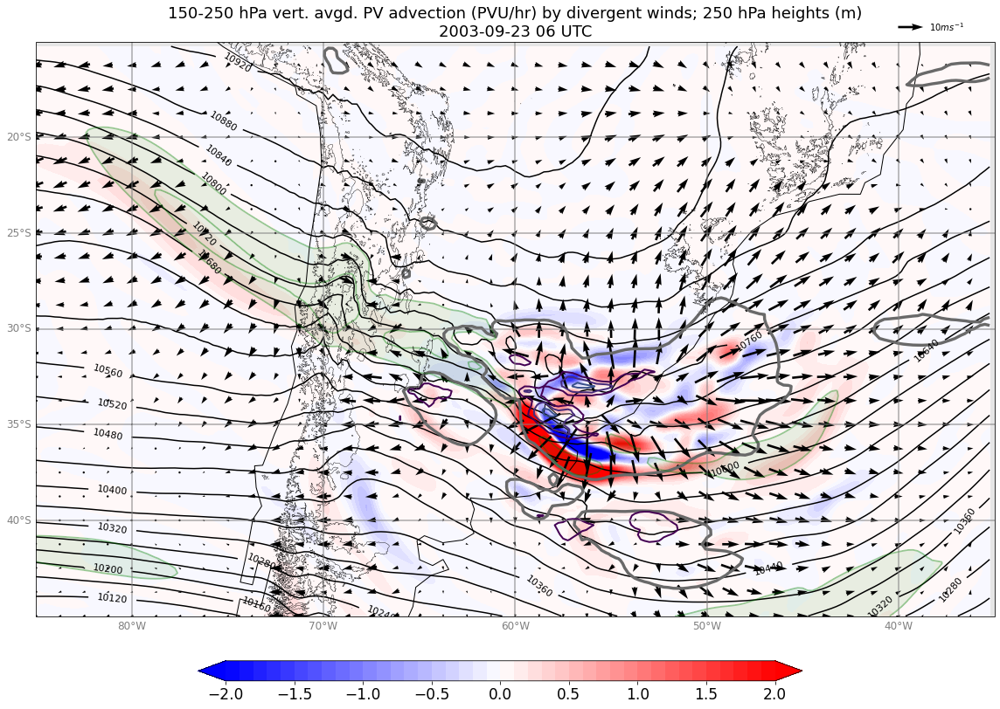

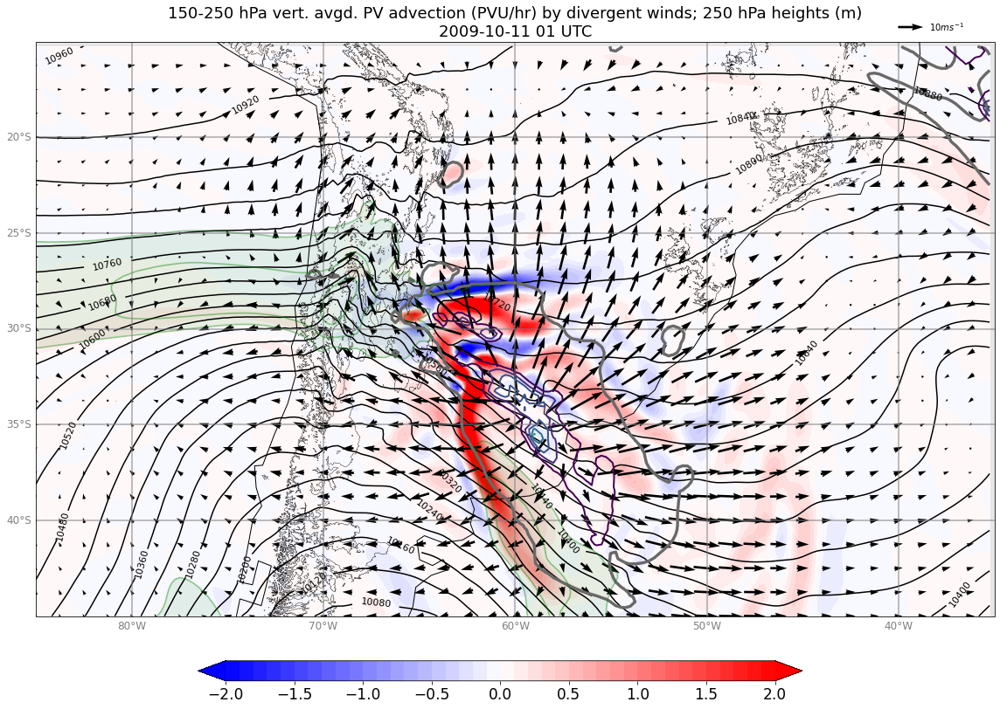

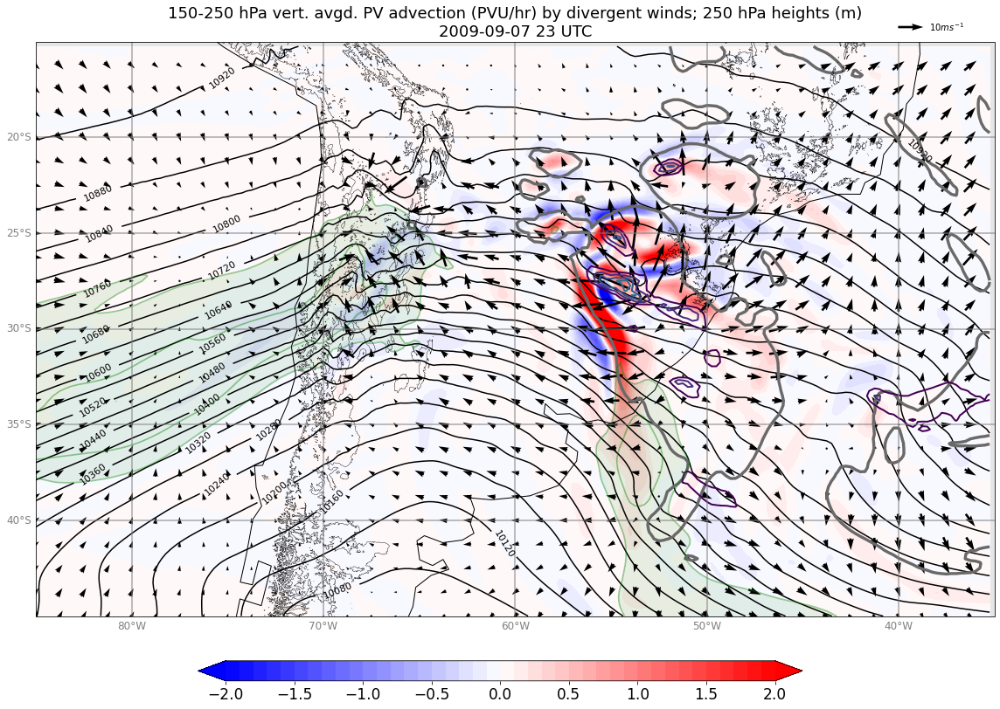

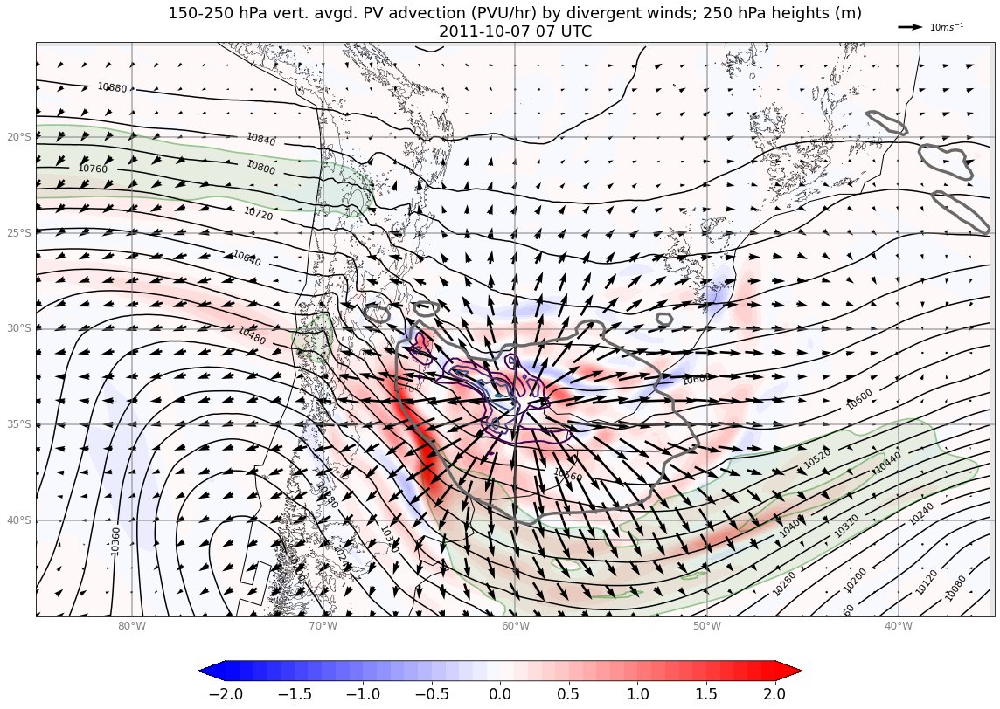

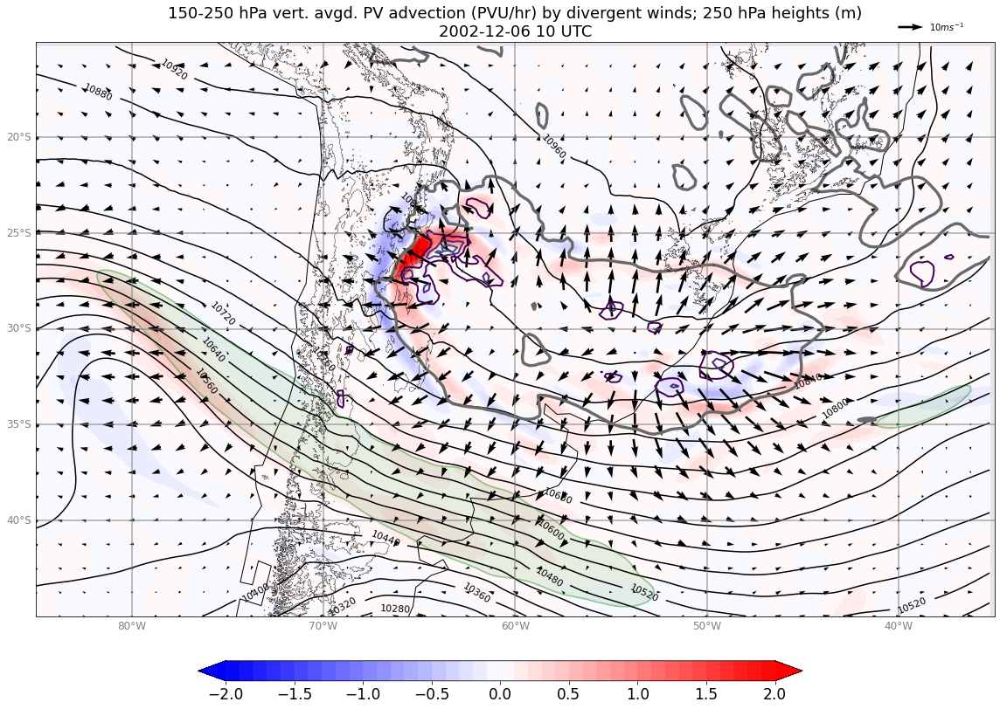

...

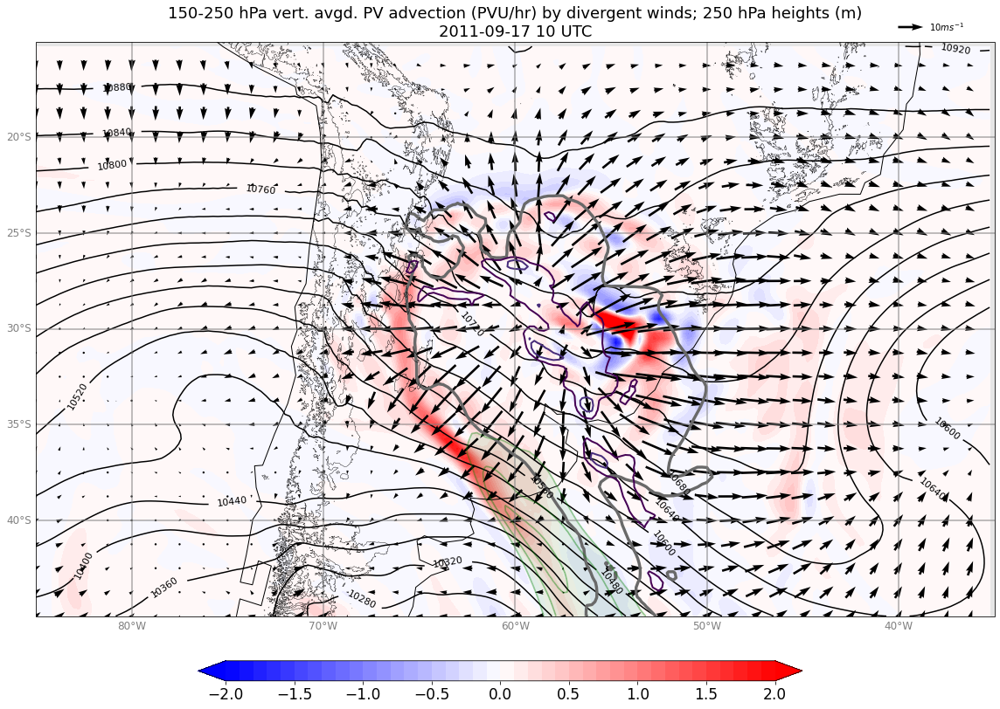

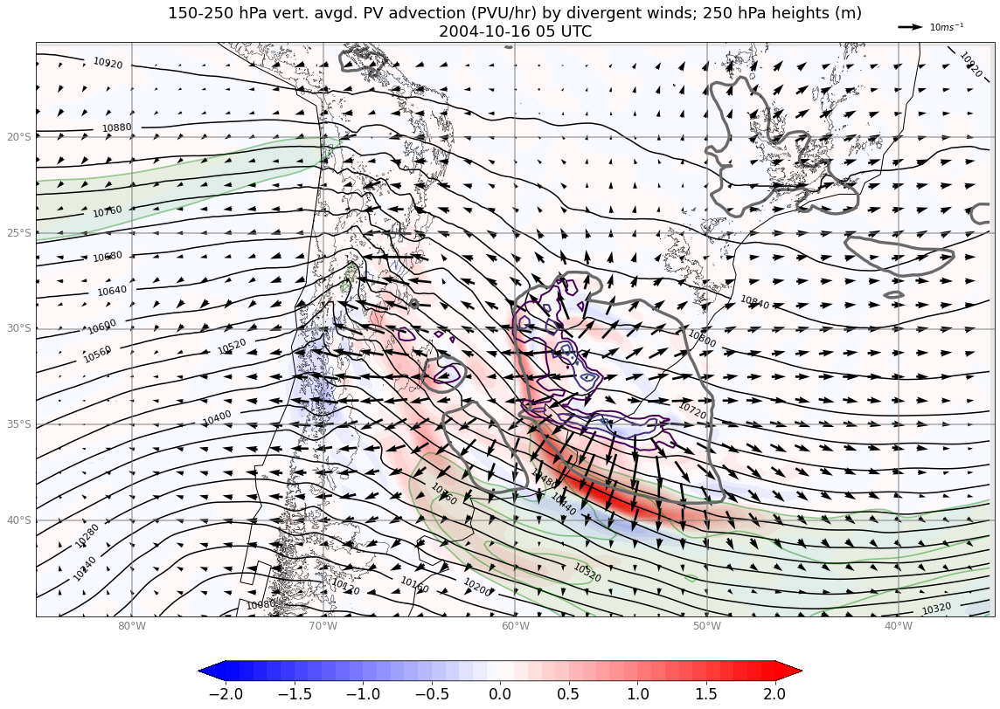

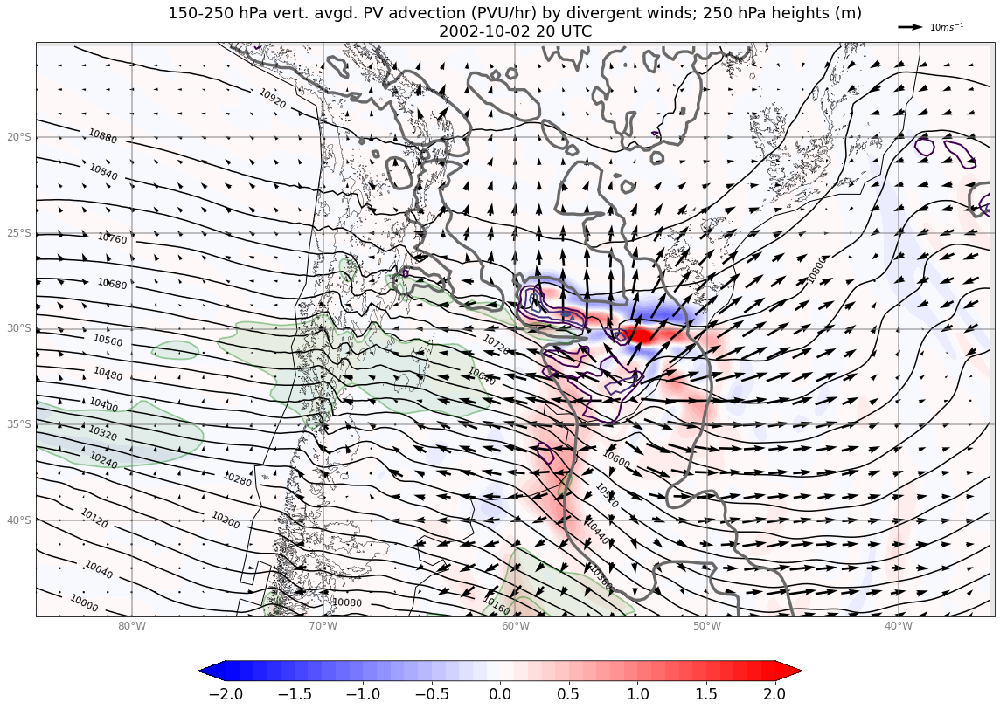

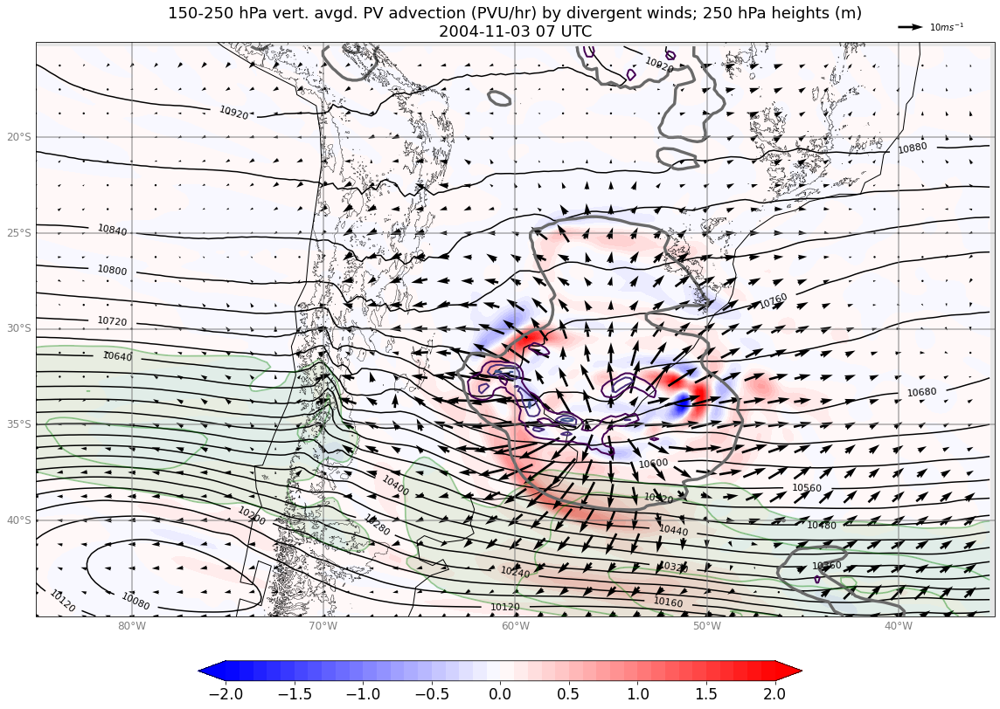

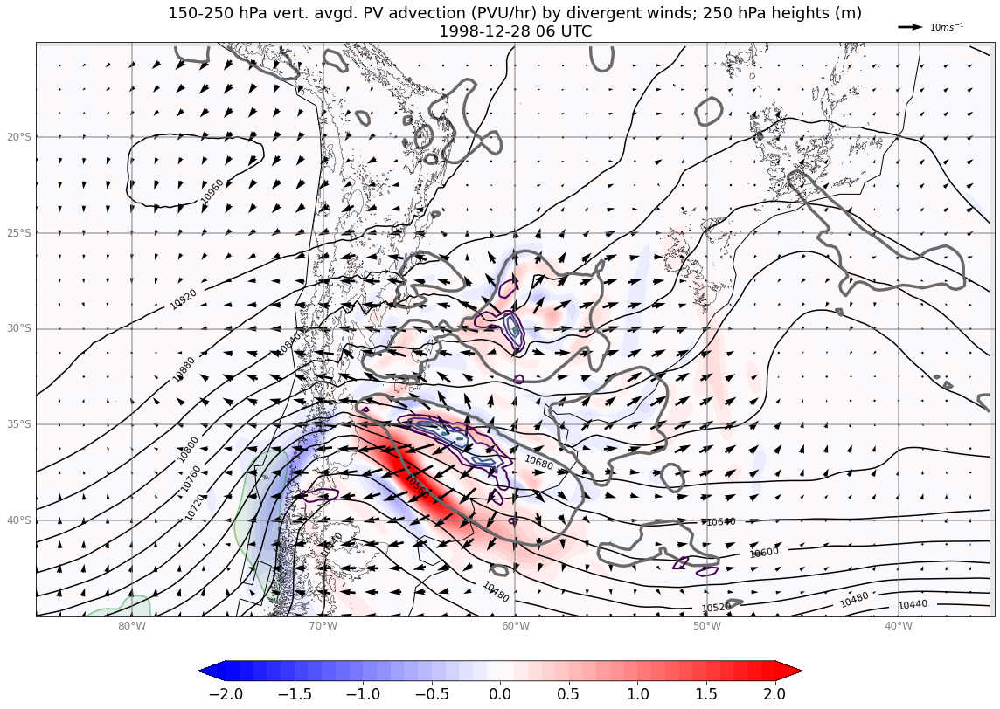

In [104]:
for tim in df_maybe.index:
    plot_ERA5_timestep(150,250,tim,'greater_than_95percentile_PVadv')

In [25]:
final_df_pv_adv=pd.read_csv('ERA5_time_series_max_ulpvadvirrot_large_wcc_days.csv',header=None,delimiter=',',names=['date','max_pos_PVadv','max_lat','max_lon'],index_col='date',parse_dates=True) 
final_df_pv_adv=final_df_pv_adv.resample('D').max()#.dropna(axis=0,inplace=True)
final_df=final_df_pv_adv.dropna(axis=0)
final_df

,max_pos_PVadv,max_lat,max_lon
date,,,
1998-01-15,0.977981,-20.25,307.75
1998-01-21,1.279186,-35.00,309.75
1998-01-30,1.164397,-30.00,305.75
1998-02-07,0.897614,-25.75,309.75
1998-02-17,1.635804,-26.00,305.00
...,...,...,...
2013-03-10,0.866583,-32.25,309.75
2013-09-07,1.303168,-20.25,307.50
2013-10-24,1.135157,-25.00,309.75


In [30]:
merged_df= pd.concat([final_df,df_wcc_large], join='inner', axis=1)#.dropna()#.reset_index(drop=True)
merged_df

,max_pos_PVadv,max_lat,max_lon,core_area,core_top_ht,core_dim_x,core_dim_y,core_rain_rate_mean,core_rain_rate_max,core_rain_rate_min,core_rain_rate_mean_all,core_rain_rate_mean_stra,core_rain_rate_mean_conv,core_rain_vol_all,core_rain_vol_stra,core_rain_vol_conv
1998-01-15,0.977981,-20.25,307.75,6232.79,9.75,2.10,1.10,15.41,63.67,0.00,15.4129,0.0,15.4129,26.6849,0.0,26.6849
1998-01-21,1.279186,-35.00,309.75,9329.27,8.50,2.20,1.10,18.76,52.47,1.19,18.7557,0.0,18.7557,48.6048,0.0,48.6048
1998-01-30,1.164397,-30.00,305.75,6165.43,7.25,1.55,1.10,23.60,198.96,1.18,23.6002,0.0,23.6002,40.4182,0.0,40.4182
1998-02-07,0.897614,-25.75,309.75,7108.47,8.25,2.00,0.95,23.75,84.82,0.00,23.7499,0.0,23.7499,46.8959,0.0,46.8959
1998-02-17,1.635804,-26.00,305.00,10451.03,9.75,1.50,1.85,29.62,149.39,1.26,29.6227,0.0,29.6227,85.9967,0.0,85.9967
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2013-03-10,0.866583,-32.25,309.75,7866.39,6.75,2.15,1.15,23.40,79.62,0.00,23.3974,0.0,23.3974,51.1260,0.0,51.1260
2013-09-07,1.303168,-20.25,307.50,6266.06,6.00,1.45,1.30,23.90,114.87,0.47,23.8978,0.0,23.8978,41.5958,0.0,41.5958
2013-10-24,1.135157,-25.00,309.75,6420.07,8.00,1.75,1.25,25.15,66.40,0.44,25.1453,0.0,25.1453,39.5673,0.0,39.5673
2013-10-31,1.932974,-23.75,309.75,9634.60,9.75,2.15,1.50,27.46,193.98,0.00,27.4586,0.0,27.4586,58.4109,0.0,58.4109


In [31]:
merged_df['aspect_ratio']=merged_df['core_dim_x']/merged_df['core_dim_y']

In [32]:
merged_df.corr()

,max_pos_PVadv,max_lat,max_lon,core_area,core_top_ht,core_dim_x,core_dim_y,core_rain_rate_mean,core_rain_rate_max,core_rain_rate_min,core_rain_rate_mean_all,core_rain_rate_mean_stra,core_rain_rate_mean_conv,core_rain_vol_all,core_rain_vol_stra,core_rain_vol_conv,aspect_ratio
max_pos_PVadv,1.000000,0.000839,-0.243081,0.170203,0.094513,0.050941,0.240073,0.092684,0.139684,0.139474,0.092745,NaN,0.092745,0.164860,NaN,0.164860,-0.179513
max_lat,0.000839,1.000000,0.229811,-0.080954,-0.049717,-0.140236,0.125629,-0.104820,-0.089909,0.052523,-0.104806,NaN,-0.104806,-0.093502,NaN,-0.093502,-0.212336
max_lon,-0.243081,0.229811,1.000000,-0.115061,-0.009811,0.097868,-0.166350,0.009712,-0.061848,-0.082486,0.009735,NaN,0.009735,-0.084199,NaN,-0.084199,0.162493
core_area,0.170203,-0.080954,-0.115061,1.000000,0.186506,0.638938,0.498831,-0.033605,0.092560,0.272817,-0.033574,NaN,-0.033574,0.854002,NaN,0.854002,0.049256
core_top_ht,0.094513,-0.049717,-0.009811,0.186506,1.000000,0.157813,0.167663,0.125833,0.156488,-0.013920,0.125978,NaN,0.125978,0.190885,NaN,0.190885,-0.061100
core_dim_x,0.050941,-0.140236,0.097868,0.638938,0.157813,1.000000,0.100641,-0.125697,-0.017131,0.087079,-0.125718,NaN,-0.125718,0.498826,NaN,0.498826,0.585909
core_dim_y,0.240073,0.125629,-0.166350,0.498831,0.167663,0.100641,1.000000,0.063632,0.162794,0.331078,0.063629,NaN,0.063629,0.443686,NaN,0.443686,-0.663437
core_rain_rate_mean,0.092684,-0.104820,0.009712,-0.033605,0.125833,-0.125697,0.063632,1.000000,0.680372,-0.027761,1.000000,NaN,1.000000,0.419058,NaN,0.419058,-0.130863
core_rain_rate_max,0.139684,-0.089909,-0.061848,0.092560,0.156488,-0.017131,0.162794,0.680372,1.000000,-0.006970,0.680434,NaN,0.680434,0.405767,NaN,0.405767,-0.158306
core_rain_rate_min,0.139474,0.052523,-0.082486,0.272817,-0.013920,0.087079,0.331078,-0.027761,-0.006970,1.000000,-0.027710,NaN,-0.027710,0.178826,NaN,0.178826,-0.151258


In [11]:
# sort by pv advection
final_df_pv_adv=pd.read_csv('ERA5_time_series_max_ulpvadvirrot_large_wcc_days.csv',header=None,delimiter=',',names=['date','max_pos_PVadv','max_lat','max_lon'],index_col='date',parse_dates=True) 
final_df_pv_adv = final_df_pv_adv.sort_values(by='max_pos_PVadv')
final_df_pv_adv

,max_pos_PVadv,max_lat,max_lon
date,,,
2009-03-02 16:00:00,0.062809,-27.50,306.00
2010-10-13 02:00:00,0.070568,-31.50,296.25
2010-10-13 03:00:00,0.072674,-31.75,297.00
2010-10-13 04:00:00,0.073145,-32.00,309.75
2009-03-02 14:00:00,0.075760,-31.00,306.25
...,...,...,...
2011-10-07 07:00:00,3.451775,-36.00,295.00
2009-09-07 23:00:00,3.517477,-28.25,303.75
2009-10-11 01:00:00,3.554348,-33.25,297.75


In [12]:
final_df_pv_adv=final_df_pv_adv.resample('D').max()#.dropna(axis=0,inplace=True)
final_df=final_df_pv_adv.dropna(axis=0)
final_df

,max_pos_PVadv,max_lat,max_lon
date,,,
1998-01-15,0.977981,-20.25,307.75
1998-01-21,1.279186,-35.00,309.75
1998-01-30,1.164397,-30.00,305.75
1998-02-07,0.897614,-25.75,309.75
1998-02-17,1.635804,-26.00,305.00
...,...,...,...
2013-03-10,0.866583,-32.25,309.75
2013-09-07,1.303168,-20.25,307.50
2013-10-24,1.135157,-25.00,309.75


In [ ]:
for tim in final_df.index:
    print('working on time ',tim)
    plot_ERA5_timestep(150,250,tim)

working on time  1998-01-15 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/199801/e5.oper.an.pl.128_131_u.ll025uv.1998011500_1998011523.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/199801/e5.oper.an.pl.128_132_v.ll025uv.1998011500_1998011523.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/199801/e5.oper.an.pl.128_060_pv.ll025sc.1998011500_1998011523.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/199712/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.1997121606_1998010106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/199801/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.1998010106_1998011606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/199801/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.1998011606_1998020106.nc']
    performing Helmholtz decomposition...
    getting rain rate...
        forecast_initial_time =  1998-01-14 18:00:00
        forecast hour =

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_1998-01-15_00.png
working on time  1998-01-21 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/199801/e5.oper.an.pl.128_131_u.ll025uv.1998012100_1998012123.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/199801/e5.oper.an.pl.128_132_v.ll025uv.1998012100_1998012123.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/199801/e5.oper.an.pl.128_060_pv.ll025sc.1998012100_1998012123.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/199801/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.1998011606_1998020106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/199801/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.1998010106_1998011606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/199801/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.1998011606_1998020106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_1998-01-21_00.png
working on time  1998-01-30 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/199801/e5.oper.an.pl.128_131_u.ll025uv.1998013000_1998013023.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/199801/e5.oper.an.pl.128_132_v.ll025uv.1998013000_1998013023.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/199801/e5.oper.an.pl.128_060_pv.ll025sc.1998013000_1998013023.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/199801/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.1998011606_1998020106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/199801/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.1998010106_1998011606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/199801/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.1998011606_1998020106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_1998-01-30_00.png
working on time  1998-02-07 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/199802/e5.oper.an.pl.128_131_u.ll025uv.1998020700_1998020723.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/199802/e5.oper.an.pl.128_132_v.ll025uv.1998020700_1998020723.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/199802/e5.oper.an.pl.128_060_pv.ll025sc.1998020700_1998020723.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/199801/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.1998011606_1998020106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/199802/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.1998020106_1998021606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/199802/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.1998021606_1998030106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_1998-02-07_00.png
working on time  1998-02-17 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/199802/e5.oper.an.pl.128_131_u.ll025uv.1998021700_1998021723.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/199802/e5.oper.an.pl.128_132_v.ll025uv.1998021700_1998021723.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/199802/e5.oper.an.pl.128_060_pv.ll025sc.1998021700_1998021723.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/199801/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.1998011606_1998020106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/199802/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.1998020106_1998021606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/199802/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.1998021606_1998030106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_1998-02-17_00.png
working on time  1998-03-06 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/199803/e5.oper.an.pl.128_131_u.ll025uv.1998030600_1998030623.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/199803/e5.oper.an.pl.128_132_v.ll025uv.1998030600_1998030623.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/199803/e5.oper.an.pl.128_060_pv.ll025sc.1998030600_1998030623.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/199802/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.1998021606_1998030106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/199803/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.1998030106_1998031606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/199803/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.1998031606_1998040106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_1998-03-06_00.png
working on time  1998-09-12 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/199809/e5.oper.an.pl.128_131_u.ll025uv.1998091200_1998091223.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/199809/e5.oper.an.pl.128_132_v.ll025uv.1998091200_1998091223.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/199809/e5.oper.an.pl.128_060_pv.ll025sc.1998091200_1998091223.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/199808/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.1998081606_1998090106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/199809/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.1998090106_1998091606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/199809/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.1998091606_1998100106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_1998-09-12_00.png
working on time  1998-09-27 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/199809/e5.oper.an.pl.128_131_u.ll025uv.1998092700_1998092723.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/199809/e5.oper.an.pl.128_132_v.ll025uv.1998092700_1998092723.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/199809/e5.oper.an.pl.128_060_pv.ll025sc.1998092700_1998092723.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/199809/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.1998091606_1998100106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/199809/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.1998090106_1998091606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/199809/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.1998091606_1998100106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_1998-09-27_00.png
working on time  1998-10-22 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/199810/e5.oper.an.pl.128_131_u.ll025uv.1998102200_1998102223.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/199810/e5.oper.an.pl.128_132_v.ll025uv.1998102200_1998102223.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/199810/e5.oper.an.pl.128_060_pv.ll025sc.1998102200_1998102223.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/199810/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.1998101606_1998110106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/199810/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.1998100106_1998101606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/199810/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.1998101606_1998110106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_1998-10-22_00.png
working on time  1998-11-14 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/199811/e5.oper.an.pl.128_131_u.ll025uv.1998111400_1998111423.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/199811/e5.oper.an.pl.128_132_v.ll025uv.1998111400_1998111423.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/199811/e5.oper.an.pl.128_060_pv.ll025sc.1998111400_1998111423.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/199810/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.1998101606_1998110106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/199811/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.1998110106_1998111606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/199811/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.1998111606_1998120106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:1666: UserWarning: No contour levels were found within the data range.
  result = matplotlib.axes.Axes.contour(self, *args, **kwargs)
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warn

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_1998-11-14_00.png
working on time  1998-12-21 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/199812/e5.oper.an.pl.128_131_u.ll025uv.1998122100_1998122123.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/199812/e5.oper.an.pl.128_132_v.ll025uv.1998122100_1998122123.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/199812/e5.oper.an.pl.128_060_pv.ll025sc.1998122100_1998122123.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/199812/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.1998121606_1999010106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/199812/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.1998120106_1998121606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/199812/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.1998121606_1999010106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_1998-12-21_00.png
working on time  1998-12-28 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/199812/e5.oper.an.pl.128_131_u.ll025uv.1998122800_1998122823.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/199812/e5.oper.an.pl.128_132_v.ll025uv.1998122800_1998122823.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/199812/e5.oper.an.pl.128_060_pv.ll025sc.1998122800_1998122823.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/199812/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.1998121606_1999010106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/199812/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.1998120106_1998121606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/199812/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.1998121606_1999010106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_1998-12-28_00.png
working on time  1999-03-24 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/199903/e5.oper.an.pl.128_131_u.ll025uv.1999032400_1999032423.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/199903/e5.oper.an.pl.128_132_v.ll025uv.1999032400_1999032423.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/199903/e5.oper.an.pl.128_060_pv.ll025sc.1999032400_1999032423.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/199903/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.1999031606_1999040106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/199903/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.1999030106_1999031606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/199903/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.1999031606_1999040106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_1999-03-24_00.png
working on time  1999-03-28 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/199903/e5.oper.an.pl.128_131_u.ll025uv.1999032800_1999032823.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/199903/e5.oper.an.pl.128_132_v.ll025uv.1999032800_1999032823.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/199903/e5.oper.an.pl.128_060_pv.ll025sc.1999032800_1999032823.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/199903/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.1999031606_1999040106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/199903/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.1999030106_1999031606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/199903/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.1999031606_1999040106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_1999-03-28_00.png
working on time  1999-12-18 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/199912/e5.oper.an.pl.128_131_u.ll025uv.1999121800_1999121823.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/199912/e5.oper.an.pl.128_132_v.ll025uv.1999121800_1999121823.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/199912/e5.oper.an.pl.128_060_pv.ll025sc.1999121800_1999121823.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/199911/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.1999111606_1999120106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/199912/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.1999120106_1999121606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/199912/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.1999121606_2000010106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_1999-12-18_00.png
working on time  1999-12-22 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/199912/e5.oper.an.pl.128_131_u.ll025uv.1999122200_1999122223.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/199912/e5.oper.an.pl.128_132_v.ll025uv.1999122200_1999122223.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/199912/e5.oper.an.pl.128_060_pv.ll025sc.1999122200_1999122223.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/199912/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.1999121606_2000010106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/199912/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.1999120106_1999121606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/199912/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.1999121606_2000010106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_1999-12-22_00.png
working on time  2000-02-08 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200002/e5.oper.an.pl.128_131_u.ll025uv.2000020800_2000020823.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200002/e5.oper.an.pl.128_132_v.ll025uv.2000020800_2000020823.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200002/e5.oper.an.pl.128_060_pv.ll025sc.2000020800_2000020823.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200001/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2000011606_2000020106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200002/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2000020106_2000021606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200002/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2000021606_2000030106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:1666: UserWarning: No contour levels were found within the data range.
  result = matplotlib.axes.Axes.contour(self, *args, **kwargs)
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warn

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2000-02-08_00.png
working on time  2000-02-11 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200002/e5.oper.an.pl.128_131_u.ll025uv.2000021100_2000021123.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200002/e5.oper.an.pl.128_132_v.ll025uv.2000021100_2000021123.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200002/e5.oper.an.pl.128_060_pv.ll025sc.2000021100_2000021123.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200001/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2000011606_2000020106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200002/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2000020106_2000021606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200002/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2000021606_2000030106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2000-02-11_00.png
working on time  2000-02-25 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200002/e5.oper.an.pl.128_131_u.ll025uv.2000022500_2000022523.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200002/e5.oper.an.pl.128_132_v.ll025uv.2000022500_2000022523.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200002/e5.oper.an.pl.128_060_pv.ll025sc.2000022500_2000022523.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200002/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2000021606_2000030106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200002/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2000020106_2000021606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200002/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2000021606_2000030106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:1666: UserWarning: No contour levels were found within the data range.
  result = matplotlib.axes.Axes.contour(self, *args, **kwargs)
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warn

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2000-02-25_00.png
working on time  2000-03-04 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200003/e5.oper.an.pl.128_131_u.ll025uv.2000030400_2000030423.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200003/e5.oper.an.pl.128_132_v.ll025uv.2000030400_2000030423.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200003/e5.oper.an.pl.128_060_pv.ll025sc.2000030400_2000030423.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200002/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2000021606_2000030106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200003/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2000030106_2000031606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200003/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2000031606_2000040106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:1666: UserWarning: No contour levels were found within the data range.
  result = matplotlib.axes.Axes.contour(self, *args, **kwargs)
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warn

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2000-03-04_00.png
working on time  2000-03-16 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200003/e5.oper.an.pl.128_131_u.ll025uv.2000031600_2000031623.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200003/e5.oper.an.pl.128_132_v.ll025uv.2000031600_2000031623.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200003/e5.oper.an.pl.128_060_pv.ll025sc.2000031600_2000031623.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200002/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2000021606_2000030106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200003/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2000030106_2000031606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200003/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2000031606_2000040106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/scratch/isingh9/ipykernel_18218/1254759702.py:11: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=(16, 16))
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2000-03-16_00.png
working on time  2000-03-26 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200003/e5.oper.an.pl.128_131_u.ll025uv.2000032600_2000032623.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200003/e5.oper.an.pl.128_132_v.ll025uv.2000032600_2000032623.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200003/e5.oper.an.pl.128_060_pv.ll025sc.2000032600_2000032623.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200003/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2000031606_2000040106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200003/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2000030106_2000031606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200003/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2000031606_2000040106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2000-03-26_00.png
working on time  2000-10-14 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200010/e5.oper.an.pl.128_131_u.ll025uv.2000101400_2000101423.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200010/e5.oper.an.pl.128_132_v.ll025uv.2000101400_2000101423.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200010/e5.oper.an.pl.128_060_pv.ll025sc.2000101400_2000101423.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200009/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2000091606_2000100106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200010/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2000100106_2000101606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200010/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2000101606_2000110106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2000-10-14_00.png
working on time  2000-10-17 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200010/e5.oper.an.pl.128_131_u.ll025uv.2000101700_2000101723.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200010/e5.oper.an.pl.128_132_v.ll025uv.2000101700_2000101723.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200010/e5.oper.an.pl.128_060_pv.ll025sc.2000101700_2000101723.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200009/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2000091606_2000100106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200010/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2000100106_2000101606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200010/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2000101606_2000110106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2000-10-17_00.png
working on time  2000-10-23 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200010/e5.oper.an.pl.128_131_u.ll025uv.2000102300_2000102323.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200010/e5.oper.an.pl.128_132_v.ll025uv.2000102300_2000102323.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200010/e5.oper.an.pl.128_060_pv.ll025sc.2000102300_2000102323.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200010/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2000101606_2000110106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200010/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2000100106_2000101606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200010/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2000101606_2000110106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2000-10-23_00.png
working on time  2000-11-05 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200011/e5.oper.an.pl.128_131_u.ll025uv.2000110500_2000110523.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200011/e5.oper.an.pl.128_132_v.ll025uv.2000110500_2000110523.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200011/e5.oper.an.pl.128_060_pv.ll025sc.2000110500_2000110523.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200010/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2000101606_2000110106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200011/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2000110106_2000111606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200011/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2000111606_2000120106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2000-11-05_00.png
working on time  2000-11-29 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200011/e5.oper.an.pl.128_131_u.ll025uv.2000112900_2000112923.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200011/e5.oper.an.pl.128_132_v.ll025uv.2000112900_2000112923.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200011/e5.oper.an.pl.128_060_pv.ll025sc.2000112900_2000112923.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200011/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2000111606_2000120106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200011/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2000110106_2000111606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200011/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2000111606_2000120106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2000-11-29_00.png
working on time  2000-12-04 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200012/e5.oper.an.pl.128_131_u.ll025uv.2000120400_2000120423.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200012/e5.oper.an.pl.128_132_v.ll025uv.2000120400_2000120423.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200012/e5.oper.an.pl.128_060_pv.ll025sc.2000120400_2000120423.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200011/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2000111606_2000120106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200012/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2000120106_2000121606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200012/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2000121606_2001010106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2000-12-04_00.png
working on time  2000-12-27 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200012/e5.oper.an.pl.128_131_u.ll025uv.2000122700_2000122723.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200012/e5.oper.an.pl.128_132_v.ll025uv.2000122700_2000122723.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200012/e5.oper.an.pl.128_060_pv.ll025sc.2000122700_2000122723.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200012/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2000121606_2001010106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200012/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2000120106_2000121606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200012/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2000121606_2001010106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2000-12-27_00.png
working on time  2000-12-29 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200012/e5.oper.an.pl.128_131_u.ll025uv.2000122900_2000122923.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200012/e5.oper.an.pl.128_132_v.ll025uv.2000122900_2000122923.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200012/e5.oper.an.pl.128_060_pv.ll025sc.2000122900_2000122923.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200012/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2000121606_2001010106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200012/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2000120106_2000121606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200012/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2000121606_2001010106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2000-12-29_00.png
working on time  2001-01-07 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200101/e5.oper.an.pl.128_131_u.ll025uv.2001010700_2001010723.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200101/e5.oper.an.pl.128_132_v.ll025uv.2001010700_2001010723.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200101/e5.oper.an.pl.128_060_pv.ll025sc.2001010700_2001010723.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200012/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2000121606_2001010106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200101/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2001010106_2001011606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200101/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2001011606_2001020106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2001-01-07_00.png
working on time  2001-01-18 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200101/e5.oper.an.pl.128_131_u.ll025uv.2001011800_2001011823.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200101/e5.oper.an.pl.128_132_v.ll025uv.2001011800_2001011823.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200101/e5.oper.an.pl.128_060_pv.ll025sc.2001011800_2001011823.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200012/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2000121606_2001010106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200101/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2001010106_2001011606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200101/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2001011606_2001020106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2001-01-18_00.png
working on time  2001-01-23 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200101/e5.oper.an.pl.128_131_u.ll025uv.2001012300_2001012323.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200101/e5.oper.an.pl.128_132_v.ll025uv.2001012300_2001012323.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200101/e5.oper.an.pl.128_060_pv.ll025sc.2001012300_2001012323.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200101/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2001011606_2001020106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200101/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2001010106_2001011606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200101/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2001011606_2001020106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2001-01-23_00.png
working on time  2001-10-08 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200110/e5.oper.an.pl.128_131_u.ll025uv.2001100800_2001100823.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200110/e5.oper.an.pl.128_132_v.ll025uv.2001100800_2001100823.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200110/e5.oper.an.pl.128_060_pv.ll025sc.2001100800_2001100823.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200109/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2001091606_2001100106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200110/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2001100106_2001101606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200110/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2001101606_2001110106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2001-10-08_00.png
working on time  2001-10-27 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200110/e5.oper.an.pl.128_131_u.ll025uv.2001102700_2001102723.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200110/e5.oper.an.pl.128_132_v.ll025uv.2001102700_2001102723.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200110/e5.oper.an.pl.128_060_pv.ll025sc.2001102700_2001102723.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200110/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2001101606_2001110106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200110/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2001100106_2001101606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200110/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2001101606_2001110106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2001-10-27_00.png
working on time  2001-11-14 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200111/e5.oper.an.pl.128_131_u.ll025uv.2001111400_2001111423.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200111/e5.oper.an.pl.128_132_v.ll025uv.2001111400_2001111423.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200111/e5.oper.an.pl.128_060_pv.ll025sc.2001111400_2001111423.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200110/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2001101606_2001110106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200111/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2001110106_2001111606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200111/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2001111606_2001120106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2001-11-14_00.png
working on time  2002-01-13 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200201/e5.oper.an.pl.128_131_u.ll025uv.2002011300_2002011323.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200201/e5.oper.an.pl.128_132_v.ll025uv.2002011300_2002011323.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200201/e5.oper.an.pl.128_060_pv.ll025sc.2002011300_2002011323.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200112/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2001121606_2002010106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200201/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2002010106_2002011606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200201/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2002011606_2002020106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2002-01-13_00.png
working on time  2002-01-24 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200201/e5.oper.an.pl.128_131_u.ll025uv.2002012400_2002012423.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200201/e5.oper.an.pl.128_132_v.ll025uv.2002012400_2002012423.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200201/e5.oper.an.pl.128_060_pv.ll025sc.2002012400_2002012423.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200201/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2002011606_2002020106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200201/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2002010106_2002011606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200201/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2002011606_2002020106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2002-01-24_00.png
working on time  2002-03-04 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200203/e5.oper.an.pl.128_131_u.ll025uv.2002030400_2002030423.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200203/e5.oper.an.pl.128_132_v.ll025uv.2002030400_2002030423.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200203/e5.oper.an.pl.128_060_pv.ll025sc.2002030400_2002030423.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200202/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2002021606_2002030106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200203/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2002030106_2002031606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200203/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2002031606_2002040106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2002-03-04_00.png
working on time  2002-09-12 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200209/e5.oper.an.pl.128_131_u.ll025uv.2002091200_2002091223.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200209/e5.oper.an.pl.128_132_v.ll025uv.2002091200_2002091223.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200209/e5.oper.an.pl.128_060_pv.ll025sc.2002091200_2002091223.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200208/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2002081606_2002090106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200209/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2002090106_2002091606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200209/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2002091606_2002100106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2002-09-12_00.png
working on time  2002-09-14 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200209/e5.oper.an.pl.128_131_u.ll025uv.2002091400_2002091423.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200209/e5.oper.an.pl.128_132_v.ll025uv.2002091400_2002091423.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200209/e5.oper.an.pl.128_060_pv.ll025sc.2002091400_2002091423.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200208/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2002081606_2002090106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200209/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2002090106_2002091606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200209/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2002091606_2002100106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2002-09-14_00.png
working on time  2002-09-17 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200209/e5.oper.an.pl.128_131_u.ll025uv.2002091700_2002091723.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200209/e5.oper.an.pl.128_132_v.ll025uv.2002091700_2002091723.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200209/e5.oper.an.pl.128_060_pv.ll025sc.2002091700_2002091723.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200208/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2002081606_2002090106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200209/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2002090106_2002091606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200209/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2002091606_2002100106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2002-09-17_00.png
working on time  2002-10-02 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200210/e5.oper.an.pl.128_131_u.ll025uv.2002100200_2002100223.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200210/e5.oper.an.pl.128_132_v.ll025uv.2002100200_2002100223.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200210/e5.oper.an.pl.128_060_pv.ll025sc.2002100200_2002100223.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200209/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2002091606_2002100106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200210/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2002100106_2002101606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200210/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2002101606_2002110106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2002-10-02_00.png
working on time  2002-10-08 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200210/e5.oper.an.pl.128_131_u.ll025uv.2002100800_2002100823.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200210/e5.oper.an.pl.128_132_v.ll025uv.2002100800_2002100823.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200210/e5.oper.an.pl.128_060_pv.ll025sc.2002100800_2002100823.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200209/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2002091606_2002100106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200210/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2002100106_2002101606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200210/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2002101606_2002110106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2002-10-08_00.png
working on time  2002-10-21 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200210/e5.oper.an.pl.128_131_u.ll025uv.2002102100_2002102123.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200210/e5.oper.an.pl.128_132_v.ll025uv.2002102100_2002102123.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200210/e5.oper.an.pl.128_060_pv.ll025sc.2002102100_2002102123.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200210/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2002101606_2002110106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200210/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2002100106_2002101606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200210/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2002101606_2002110106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2002-10-21_00.png
working on time  2002-10-26 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200210/e5.oper.an.pl.128_131_u.ll025uv.2002102600_2002102623.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200210/e5.oper.an.pl.128_132_v.ll025uv.2002102600_2002102623.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200210/e5.oper.an.pl.128_060_pv.ll025sc.2002102600_2002102623.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200210/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2002101606_2002110106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200210/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2002100106_2002101606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200210/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2002101606_2002110106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2002-10-26_00.png
working on time  2002-11-04 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200211/e5.oper.an.pl.128_131_u.ll025uv.2002110400_2002110423.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200211/e5.oper.an.pl.128_132_v.ll025uv.2002110400_2002110423.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200211/e5.oper.an.pl.128_060_pv.ll025sc.2002110400_2002110423.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200210/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2002101606_2002110106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200211/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2002110106_2002111606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200211/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2002111606_2002120106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2002-11-04_00.png
working on time  2002-12-06 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200212/e5.oper.an.pl.128_131_u.ll025uv.2002120600_2002120623.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200212/e5.oper.an.pl.128_132_v.ll025uv.2002120600_2002120623.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200212/e5.oper.an.pl.128_060_pv.ll025sc.2002120600_2002120623.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200211/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2002111606_2002120106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200212/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2002120106_2002121606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200212/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2002121606_2003010106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2002-12-06_00.png
working on time  2002-12-14 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200212/e5.oper.an.pl.128_131_u.ll025uv.2002121400_2002121423.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200212/e5.oper.an.pl.128_132_v.ll025uv.2002121400_2002121423.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200212/e5.oper.an.pl.128_060_pv.ll025sc.2002121400_2002121423.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200211/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2002111606_2002120106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200212/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2002120106_2002121606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200212/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2002121606_2003010106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2002-12-14_00.png
working on time  2002-12-19 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200212/e5.oper.an.pl.128_131_u.ll025uv.2002121900_2002121923.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200212/e5.oper.an.pl.128_132_v.ll025uv.2002121900_2002121923.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200212/e5.oper.an.pl.128_060_pv.ll025sc.2002121900_2002121923.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200211/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2002111606_2002120106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200212/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2002120106_2002121606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200212/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2002121606_2003010106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2002-12-19_00.png
working on time  2003-01-21 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200301/e5.oper.an.pl.128_131_u.ll025uv.2003012100_2003012123.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200301/e5.oper.an.pl.128_132_v.ll025uv.2003012100_2003012123.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200301/e5.oper.an.pl.128_060_pv.ll025sc.2003012100_2003012123.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200301/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2003011606_2003020106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200301/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2003010106_2003011606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200301/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2003011606_2003020106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2003-01-21_00.png
working on time  2003-01-22 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200301/e5.oper.an.pl.128_131_u.ll025uv.2003012200_2003012223.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200301/e5.oper.an.pl.128_132_v.ll025uv.2003012200_2003012223.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200301/e5.oper.an.pl.128_060_pv.ll025sc.2003012200_2003012223.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200301/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2003011606_2003020106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200301/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2003010106_2003011606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200301/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2003011606_2003020106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2003-01-22_00.png
working on time  2003-02-05 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200302/e5.oper.an.pl.128_131_u.ll025uv.2003020500_2003020523.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200302/e5.oper.an.pl.128_132_v.ll025uv.2003020500_2003020523.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200302/e5.oper.an.pl.128_060_pv.ll025sc.2003020500_2003020523.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200301/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2003011606_2003020106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200302/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2003020106_2003021606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200302/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2003021606_2003030106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2003-02-05_00.png
working on time  2003-09-23 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200309/e5.oper.an.pl.128_131_u.ll025uv.2003092300_2003092323.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200309/e5.oper.an.pl.128_132_v.ll025uv.2003092300_2003092323.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200309/e5.oper.an.pl.128_060_pv.ll025sc.2003092300_2003092323.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200309/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2003091606_2003100106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200309/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2003090106_2003091606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200309/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2003091606_2003100106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2003-09-23_00.png
working on time  2003-10-19 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200310/e5.oper.an.pl.128_131_u.ll025uv.2003101900_2003101923.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200310/e5.oper.an.pl.128_132_v.ll025uv.2003101900_2003101923.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200310/e5.oper.an.pl.128_060_pv.ll025sc.2003101900_2003101923.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200309/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2003091606_2003100106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200310/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2003100106_2003101606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200310/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2003101606_2003110106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2003-10-19_00.png
working on time  2003-10-25 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200310/e5.oper.an.pl.128_131_u.ll025uv.2003102500_2003102523.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200310/e5.oper.an.pl.128_132_v.ll025uv.2003102500_2003102523.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200310/e5.oper.an.pl.128_060_pv.ll025sc.2003102500_2003102523.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200310/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2003101606_2003110106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200310/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2003100106_2003101606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200310/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2003101606_2003110106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2003-10-25_00.png
working on time  2003-11-18 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200311/e5.oper.an.pl.128_131_u.ll025uv.2003111800_2003111823.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200311/e5.oper.an.pl.128_132_v.ll025uv.2003111800_2003111823.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200311/e5.oper.an.pl.128_060_pv.ll025sc.2003111800_2003111823.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200310/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2003101606_2003110106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200311/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2003110106_2003111606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200311/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2003111606_2003120106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2003-11-18_00.png
working on time  2003-11-29 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200311/e5.oper.an.pl.128_131_u.ll025uv.2003112900_2003112923.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200311/e5.oper.an.pl.128_132_v.ll025uv.2003112900_2003112923.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200311/e5.oper.an.pl.128_060_pv.ll025sc.2003112900_2003112923.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200311/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2003111606_2003120106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200311/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2003110106_2003111606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200311/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2003111606_2003120106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2003-11-29_00.png
working on time  2003-12-08 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200312/e5.oper.an.pl.128_131_u.ll025uv.2003120800_2003120823.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200312/e5.oper.an.pl.128_132_v.ll025uv.2003120800_2003120823.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200312/e5.oper.an.pl.128_060_pv.ll025sc.2003120800_2003120823.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200311/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2003111606_2003120106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200312/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2003120106_2003121606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200312/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2003121606_2004010106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2003-12-08_00.png
working on time  2003-12-22 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200312/e5.oper.an.pl.128_131_u.ll025uv.2003122200_2003122223.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200312/e5.oper.an.pl.128_132_v.ll025uv.2003122200_2003122223.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200312/e5.oper.an.pl.128_060_pv.ll025sc.2003122200_2003122223.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200312/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2003121606_2004010106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200312/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2003120106_2003121606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200312/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2003121606_2004010106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2003-12-22_00.png
working on time  2004-02-28 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200402/e5.oper.an.pl.128_131_u.ll025uv.2004022800_2004022823.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200402/e5.oper.an.pl.128_132_v.ll025uv.2004022800_2004022823.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200402/e5.oper.an.pl.128_060_pv.ll025sc.2004022800_2004022823.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200402/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2004021606_2004030106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200402/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2004020106_2004021606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200402/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2004021606_2004030106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2004-02-28_00.png
working on time  2004-10-13 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200410/e5.oper.an.pl.128_131_u.ll025uv.2004101300_2004101323.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200410/e5.oper.an.pl.128_132_v.ll025uv.2004101300_2004101323.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200410/e5.oper.an.pl.128_060_pv.ll025sc.2004101300_2004101323.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200409/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2004091606_2004100106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200410/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2004100106_2004101606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200410/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2004101606_2004110106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2004-10-13_00.png
working on time  2004-10-16 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200410/e5.oper.an.pl.128_131_u.ll025uv.2004101600_2004101623.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200410/e5.oper.an.pl.128_132_v.ll025uv.2004101600_2004101623.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200410/e5.oper.an.pl.128_060_pv.ll025sc.2004101600_2004101623.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200409/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2004091606_2004100106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200410/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2004100106_2004101606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200410/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2004101606_2004110106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2004-10-16_00.png
working on time  2004-10-17 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200410/e5.oper.an.pl.128_131_u.ll025uv.2004101700_2004101723.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200410/e5.oper.an.pl.128_132_v.ll025uv.2004101700_2004101723.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200410/e5.oper.an.pl.128_060_pv.ll025sc.2004101700_2004101723.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200409/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2004091606_2004100106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200410/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2004100106_2004101606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200410/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2004101606_2004110106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2004-10-17_00.png
working on time  2004-10-23 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200410/e5.oper.an.pl.128_131_u.ll025uv.2004102300_2004102323.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200410/e5.oper.an.pl.128_132_v.ll025uv.2004102300_2004102323.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200410/e5.oper.an.pl.128_060_pv.ll025sc.2004102300_2004102323.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200410/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2004101606_2004110106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200410/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2004100106_2004101606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200410/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2004101606_2004110106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2004-10-23_00.png
working on time  2004-11-03 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200411/e5.oper.an.pl.128_131_u.ll025uv.2004110300_2004110323.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200411/e5.oper.an.pl.128_132_v.ll025uv.2004110300_2004110323.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200411/e5.oper.an.pl.128_060_pv.ll025sc.2004110300_2004110323.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200410/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2004101606_2004110106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200411/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2004110106_2004111606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200411/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2004111606_2004120106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2004-11-03_00.png
working on time  2004-11-10 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200411/e5.oper.an.pl.128_131_u.ll025uv.2004111000_2004111023.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200411/e5.oper.an.pl.128_132_v.ll025uv.2004111000_2004111023.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200411/e5.oper.an.pl.128_060_pv.ll025sc.2004111000_2004111023.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200410/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2004101606_2004110106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200411/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2004110106_2004111606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200411/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2004111606_2004120106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2004-11-10_00.png
working on time  2005-01-09 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200501/e5.oper.an.pl.128_131_u.ll025uv.2005010900_2005010923.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200501/e5.oper.an.pl.128_132_v.ll025uv.2005010900_2005010923.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200501/e5.oper.an.pl.128_060_pv.ll025sc.2005010900_2005010923.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200412/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2004121606_2005010106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200501/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2005010106_2005011606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200501/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2005011606_2005020106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2005-01-09_00.png
working on time  2005-02-06 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200502/e5.oper.an.pl.128_131_u.ll025uv.2005020600_2005020623.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200502/e5.oper.an.pl.128_132_v.ll025uv.2005020600_2005020623.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200502/e5.oper.an.pl.128_060_pv.ll025sc.2005020600_2005020623.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200501/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2005011606_2005020106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200502/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2005020106_2005021606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200502/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2005021606_2005030106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:1666: UserWarning: No contour levels were found within the data range.
  result = matplotlib.axes.Axes.contour(self, *args, **kwargs)
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warn

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2005-02-06_00.png
working on time  2005-03-07 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200503/e5.oper.an.pl.128_131_u.ll025uv.2005030700_2005030723.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200503/e5.oper.an.pl.128_132_v.ll025uv.2005030700_2005030723.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200503/e5.oper.an.pl.128_060_pv.ll025sc.2005030700_2005030723.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200502/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2005021606_2005030106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200503/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2005030106_2005031606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200503/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2005031606_2005040106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2005-03-07_00.png
working on time  2005-03-08 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200503/e5.oper.an.pl.128_131_u.ll025uv.2005030800_2005030823.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200503/e5.oper.an.pl.128_132_v.ll025uv.2005030800_2005030823.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200503/e5.oper.an.pl.128_060_pv.ll025sc.2005030800_2005030823.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200502/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2005021606_2005030106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200503/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2005030106_2005031606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200503/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2005031606_2005040106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2005-03-08_00.png
working on time  2005-09-23 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200509/e5.oper.an.pl.128_131_u.ll025uv.2005092300_2005092323.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200509/e5.oper.an.pl.128_132_v.ll025uv.2005092300_2005092323.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200509/e5.oper.an.pl.128_060_pv.ll025sc.2005092300_2005092323.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200509/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2005091606_2005100106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200509/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2005090106_2005091606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200509/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2005091606_2005100106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2005-09-23_00.png
working on time  2005-10-03 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200510/e5.oper.an.pl.128_131_u.ll025uv.2005100300_2005100323.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200510/e5.oper.an.pl.128_132_v.ll025uv.2005100300_2005100323.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200510/e5.oper.an.pl.128_060_pv.ll025sc.2005100300_2005100323.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200509/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2005091606_2005100106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200510/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2005100106_2005101606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200510/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2005101606_2005110106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2005-10-03_00.png
working on time  2005-11-04 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200511/e5.oper.an.pl.128_131_u.ll025uv.2005110400_2005110423.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200511/e5.oper.an.pl.128_132_v.ll025uv.2005110400_2005110423.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200511/e5.oper.an.pl.128_060_pv.ll025sc.2005110400_2005110423.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200510/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2005101606_2005110106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200511/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2005110106_2005111606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200511/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2005111606_2005120106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2005-11-04_00.png
working on time  2005-11-22 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200511/e5.oper.an.pl.128_131_u.ll025uv.2005112200_2005112223.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200511/e5.oper.an.pl.128_132_v.ll025uv.2005112200_2005112223.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200511/e5.oper.an.pl.128_060_pv.ll025sc.2005112200_2005112223.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200511/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2005111606_2005120106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200511/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2005110106_2005111606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200511/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2005111606_2005120106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2005-11-22_00.png
working on time  2005-11-23 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200511/e5.oper.an.pl.128_131_u.ll025uv.2005112300_2005112323.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200511/e5.oper.an.pl.128_132_v.ll025uv.2005112300_2005112323.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200511/e5.oper.an.pl.128_060_pv.ll025sc.2005112300_2005112323.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200511/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2005111606_2005120106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200511/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2005110106_2005111606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200511/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2005111606_2005120106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2005-11-23_00.png
working on time  2006-01-03 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200601/e5.oper.an.pl.128_131_u.ll025uv.2006010300_2006010323.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200601/e5.oper.an.pl.128_132_v.ll025uv.2006010300_2006010323.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200601/e5.oper.an.pl.128_060_pv.ll025sc.2006010300_2006010323.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200512/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2005121606_2006010106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200601/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2006010106_2006011606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200601/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2006011606_2006020106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2006-01-03_00.png
working on time  2006-01-12 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200601/e5.oper.an.pl.128_131_u.ll025uv.2006011200_2006011223.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200601/e5.oper.an.pl.128_132_v.ll025uv.2006011200_2006011223.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200601/e5.oper.an.pl.128_060_pv.ll025sc.2006011200_2006011223.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200512/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2005121606_2006010106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200601/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2006010106_2006011606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200601/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2006011606_2006020106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2006-01-12_00.png
working on time  2006-01-16 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200601/e5.oper.an.pl.128_131_u.ll025uv.2006011600_2006011623.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200601/e5.oper.an.pl.128_132_v.ll025uv.2006011600_2006011623.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200601/e5.oper.an.pl.128_060_pv.ll025sc.2006011600_2006011623.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200512/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2005121606_2006010106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200601/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2006010106_2006011606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200601/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2006011606_2006020106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2006-01-16_00.png
working on time  2006-02-01 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200602/e5.oper.an.pl.128_131_u.ll025uv.2006020100_2006020123.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200602/e5.oper.an.pl.128_132_v.ll025uv.2006020100_2006020123.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200602/e5.oper.an.pl.128_060_pv.ll025sc.2006020100_2006020123.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200601/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2006011606_2006020106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200602/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2006020106_2006021606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200602/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2006021606_2006030106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2006-02-01_00.png
working on time  2006-03-04 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200603/e5.oper.an.pl.128_131_u.ll025uv.2006030400_2006030423.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200603/e5.oper.an.pl.128_132_v.ll025uv.2006030400_2006030423.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200603/e5.oper.an.pl.128_060_pv.ll025sc.2006030400_2006030423.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200602/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2006021606_2006030106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200603/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2006030106_2006031606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200603/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2006031606_2006040106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2006-03-04_00.png
working on time  2006-03-11 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200603/e5.oper.an.pl.128_131_u.ll025uv.2006031100_2006031123.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200603/e5.oper.an.pl.128_132_v.ll025uv.2006031100_2006031123.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200603/e5.oper.an.pl.128_060_pv.ll025sc.2006031100_2006031123.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200602/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2006021606_2006030106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200603/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2006030106_2006031606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200603/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2006031606_2006040106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2006-03-11_00.png
working on time  2006-09-01 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200609/e5.oper.an.pl.128_131_u.ll025uv.2006090100_2006090123.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200609/e5.oper.an.pl.128_132_v.ll025uv.2006090100_2006090123.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200609/e5.oper.an.pl.128_060_pv.ll025sc.2006090100_2006090123.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200608/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2006081606_2006090106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200609/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2006090106_2006091606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200609/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2006091606_2006100106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2006-09-01_00.png
working on time  2006-09-20 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200609/e5.oper.an.pl.128_131_u.ll025uv.2006092000_2006092023.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200609/e5.oper.an.pl.128_132_v.ll025uv.2006092000_2006092023.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200609/e5.oper.an.pl.128_060_pv.ll025sc.2006092000_2006092023.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200608/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2006081606_2006090106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200609/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2006090106_2006091606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200609/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2006091606_2006100106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2006-09-20_00.png
working on time  2006-11-06 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200611/e5.oper.an.pl.128_131_u.ll025uv.2006110600_2006110623.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200611/e5.oper.an.pl.128_132_v.ll025uv.2006110600_2006110623.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200611/e5.oper.an.pl.128_060_pv.ll025sc.2006110600_2006110623.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200610/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2006101606_2006110106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200611/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2006110106_2006111606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200611/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2006111606_2006120106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2006-11-06_00.png
working on time  2006-12-18 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200612/e5.oper.an.pl.128_131_u.ll025uv.2006121800_2006121823.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200612/e5.oper.an.pl.128_132_v.ll025uv.2006121800_2006121823.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200612/e5.oper.an.pl.128_060_pv.ll025sc.2006121800_2006121823.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200611/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2006111606_2006120106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200612/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2006120106_2006121606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200612/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2006121606_2007010106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2006-12-18_00.png
working on time  2006-12-20 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200612/e5.oper.an.pl.128_131_u.ll025uv.2006122000_2006122023.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200612/e5.oper.an.pl.128_132_v.ll025uv.2006122000_2006122023.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200612/e5.oper.an.pl.128_060_pv.ll025sc.2006122000_2006122023.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200611/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2006111606_2006120106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200612/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2006120106_2006121606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200612/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2006121606_2007010106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2006-12-20_00.png
working on time  2007-03-09 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200703/e5.oper.an.pl.128_131_u.ll025uv.2007030900_2007030923.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200703/e5.oper.an.pl.128_132_v.ll025uv.2007030900_2007030923.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200703/e5.oper.an.pl.128_060_pv.ll025sc.2007030900_2007030923.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200702/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2007021606_2007030106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200703/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2007030106_2007031606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200703/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2007031606_2007040106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2007-03-09_00.png
working on time  2007-03-27 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200703/e5.oper.an.pl.128_131_u.ll025uv.2007032700_2007032723.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200703/e5.oper.an.pl.128_132_v.ll025uv.2007032700_2007032723.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200703/e5.oper.an.pl.128_060_pv.ll025sc.2007032700_2007032723.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200703/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2007031606_2007040106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200703/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2007030106_2007031606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200703/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2007031606_2007040106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2007-03-27_00.png
working on time  2007-11-08 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200711/e5.oper.an.pl.128_131_u.ll025uv.2007110800_2007110823.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200711/e5.oper.an.pl.128_132_v.ll025uv.2007110800_2007110823.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200711/e5.oper.an.pl.128_060_pv.ll025sc.2007110800_2007110823.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200710/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2007101606_2007110106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200711/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2007110106_2007111606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200711/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2007111606_2007120106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2007-11-08_00.png
working on time  2007-11-09 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200711/e5.oper.an.pl.128_131_u.ll025uv.2007110900_2007110923.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200711/e5.oper.an.pl.128_132_v.ll025uv.2007110900_2007110923.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200711/e5.oper.an.pl.128_060_pv.ll025sc.2007110900_2007110923.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200710/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2007101606_2007110106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200711/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2007110106_2007111606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200711/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2007111606_2007120106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2007-11-09_00.png
working on time  2007-11-19 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200711/e5.oper.an.pl.128_131_u.ll025uv.2007111900_2007111923.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200711/e5.oper.an.pl.128_132_v.ll025uv.2007111900_2007111923.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200711/e5.oper.an.pl.128_060_pv.ll025sc.2007111900_2007111923.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200710/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2007101606_2007110106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200711/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2007110106_2007111606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200711/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2007111606_2007120106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2007-11-19_00.png
working on time  2008-02-18 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200802/e5.oper.an.pl.128_131_u.ll025uv.2008021800_2008021823.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200802/e5.oper.an.pl.128_132_v.ll025uv.2008021800_2008021823.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200802/e5.oper.an.pl.128_060_pv.ll025sc.2008021800_2008021823.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200801/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2008011606_2008020106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200802/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2008020106_2008021606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200802/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2008021606_2008030106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2008-02-18_00.png
working on time  2008-10-13 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200810/e5.oper.an.pl.128_131_u.ll025uv.2008101300_2008101323.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200810/e5.oper.an.pl.128_132_v.ll025uv.2008101300_2008101323.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200810/e5.oper.an.pl.128_060_pv.ll025sc.2008101300_2008101323.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200809/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2008091606_2008100106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200810/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2008100106_2008101606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200810/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2008101606_2008110106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2008-10-13_00.png
working on time  2008-10-22 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200810/e5.oper.an.pl.128_131_u.ll025uv.2008102200_2008102223.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200810/e5.oper.an.pl.128_132_v.ll025uv.2008102200_2008102223.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200810/e5.oper.an.pl.128_060_pv.ll025sc.2008102200_2008102223.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200810/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2008101606_2008110106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200810/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2008100106_2008101606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200810/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2008101606_2008110106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2008-10-22_00.png
working on time  2008-11-02 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200811/e5.oper.an.pl.128_131_u.ll025uv.2008110200_2008110223.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200811/e5.oper.an.pl.128_132_v.ll025uv.2008110200_2008110223.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200811/e5.oper.an.pl.128_060_pv.ll025sc.2008110200_2008110223.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200810/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2008101606_2008110106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200811/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2008110106_2008111606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200811/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2008111606_2008120106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2008-11-02_00.png
working on time  2008-11-24 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200811/e5.oper.an.pl.128_131_u.ll025uv.2008112400_2008112423.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200811/e5.oper.an.pl.128_132_v.ll025uv.2008112400_2008112423.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200811/e5.oper.an.pl.128_060_pv.ll025sc.2008112400_2008112423.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200811/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2008111606_2008120106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200811/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2008110106_2008111606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200811/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2008111606_2008120106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2008-11-24_00.png
working on time  2009-01-12 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200901/e5.oper.an.pl.128_131_u.ll025uv.2009011200_2009011223.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200901/e5.oper.an.pl.128_132_v.ll025uv.2009011200_2009011223.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200901/e5.oper.an.pl.128_060_pv.ll025sc.2009011200_2009011223.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200812/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2008121606_2009010106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200901/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2009010106_2009011606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200901/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2009011606_2009020106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:1666: UserWarning: No contour levels were found within the data range.
  result = matplotlib.axes.Axes.contour(self, *args, **kwargs)
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warn

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2009-01-12_00.png
working on time  2009-01-18 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200901/e5.oper.an.pl.128_131_u.ll025uv.2009011800_2009011823.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200901/e5.oper.an.pl.128_132_v.ll025uv.2009011800_2009011823.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200901/e5.oper.an.pl.128_060_pv.ll025sc.2009011800_2009011823.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200812/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2008121606_2009010106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200901/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2009010106_2009011606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200901/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2009011606_2009020106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2009-01-18_00.png
working on time  2009-01-25 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200901/e5.oper.an.pl.128_131_u.ll025uv.2009012500_2009012523.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200901/e5.oper.an.pl.128_132_v.ll025uv.2009012500_2009012523.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200901/e5.oper.an.pl.128_060_pv.ll025sc.2009012500_2009012523.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200901/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2009011606_2009020106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200901/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2009010106_2009011606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200901/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2009011606_2009020106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2009-01-25_00.png
working on time  2009-03-02 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200903/e5.oper.an.pl.128_131_u.ll025uv.2009030200_2009030223.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200903/e5.oper.an.pl.128_132_v.ll025uv.2009030200_2009030223.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200903/e5.oper.an.pl.128_060_pv.ll025sc.2009030200_2009030223.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200902/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2009021606_2009030106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200903/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2009030106_2009031606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200903/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2009031606_2009040106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2009-03-02_00.png
working on time  2009-09-07 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200909/e5.oper.an.pl.128_131_u.ll025uv.2009090700_2009090723.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200909/e5.oper.an.pl.128_132_v.ll025uv.2009090700_2009090723.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200909/e5.oper.an.pl.128_060_pv.ll025sc.2009090700_2009090723.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200908/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2009081606_2009090106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200909/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2009090106_2009091606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200909/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2009091606_2009100106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2009-09-07_00.png
working on time  2009-09-18 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200909/e5.oper.an.pl.128_131_u.ll025uv.2009091800_2009091823.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200909/e5.oper.an.pl.128_132_v.ll025uv.2009091800_2009091823.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200909/e5.oper.an.pl.128_060_pv.ll025sc.2009091800_2009091823.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200908/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2009081606_2009090106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200909/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2009090106_2009091606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200909/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2009091606_2009100106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2009-09-18_00.png
working on time  2009-10-11 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200910/e5.oper.an.pl.128_131_u.ll025uv.2009101100_2009101123.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200910/e5.oper.an.pl.128_132_v.ll025uv.2009101100_2009101123.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200910/e5.oper.an.pl.128_060_pv.ll025sc.2009101100_2009101123.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200909/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2009091606_2009100106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200910/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2009100106_2009101606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200910/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2009101606_2009110106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2009-10-11_00.png
working on time  2009-10-21 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200910/e5.oper.an.pl.128_131_u.ll025uv.2009102100_2009102123.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200910/e5.oper.an.pl.128_132_v.ll025uv.2009102100_2009102123.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200910/e5.oper.an.pl.128_060_pv.ll025sc.2009102100_2009102123.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200910/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2009101606_2009110106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200910/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2009100106_2009101606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200910/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2009101606_2009110106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2009-10-21_00.png
working on time  2009-11-21 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200911/e5.oper.an.pl.128_131_u.ll025uv.2009112100_2009112123.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200911/e5.oper.an.pl.128_132_v.ll025uv.2009112100_2009112123.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200911/e5.oper.an.pl.128_060_pv.ll025sc.2009112100_2009112123.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200911/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2009111606_2009120106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200911/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2009110106_2009111606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200911/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2009111606_2009120106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2009-11-21_00.png
working on time  2009-11-22 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200911/e5.oper.an.pl.128_131_u.ll025uv.2009112200_2009112223.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200911/e5.oper.an.pl.128_132_v.ll025uv.2009112200_2009112223.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200911/e5.oper.an.pl.128_060_pv.ll025sc.2009112200_2009112223.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200911/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2009111606_2009120106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200911/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2009110106_2009111606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200911/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2009111606_2009120106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2009-11-22_00.png
working on time  2009-11-28 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200911/e5.oper.an.pl.128_131_u.ll025uv.2009112800_2009112823.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200911/e5.oper.an.pl.128_132_v.ll025uv.2009112800_2009112823.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200911/e5.oper.an.pl.128_060_pv.ll025sc.2009112800_2009112823.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200911/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2009111606_2009120106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200911/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2009110106_2009111606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200911/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2009111606_2009120106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2009-11-28_00.png
working on time  2009-12-16 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200912/e5.oper.an.pl.128_131_u.ll025uv.2009121600_2009121623.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200912/e5.oper.an.pl.128_132_v.ll025uv.2009121600_2009121623.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200912/e5.oper.an.pl.128_060_pv.ll025sc.2009121600_2009121623.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200911/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2009111606_2009120106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200912/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2009120106_2009121606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200912/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2009121606_2010010106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:1666: UserWarning: No contour levels were found within the data range.
  result = matplotlib.axes.Axes.contour(self, *args, **kwargs)
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warn

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2009-12-16_00.png
working on time  2009-12-19 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200912/e5.oper.an.pl.128_131_u.ll025uv.2009121900_2009121923.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200912/e5.oper.an.pl.128_132_v.ll025uv.2009121900_2009121923.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200912/e5.oper.an.pl.128_060_pv.ll025sc.2009121900_2009121923.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200911/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2009111606_2009120106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200912/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2009120106_2009121606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200912/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2009121606_2010010106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2009-12-19_00.png
working on time  2009-12-20 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200912/e5.oper.an.pl.128_131_u.ll025uv.2009122000_2009122023.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200912/e5.oper.an.pl.128_132_v.ll025uv.2009122000_2009122023.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200912/e5.oper.an.pl.128_060_pv.ll025sc.2009122000_2009122023.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200911/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2009111606_2009120106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200912/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2009120106_2009121606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200912/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2009121606_2010010106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2009-12-20_00.png
working on time  2009-12-31 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200912/e5.oper.an.pl.128_131_u.ll025uv.2009123100_2009123123.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200912/e5.oper.an.pl.128_132_v.ll025uv.2009123100_2009123123.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/200912/e5.oper.an.pl.128_060_pv.ll025sc.2009123100_2009123123.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200912/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2009121606_2010010106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200912/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2009120106_2009121606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200912/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2009121606_2010010106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2009-12-31_00.png
working on time  2010-01-16 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/201001/e5.oper.an.pl.128_131_u.ll025uv.2010011600_2010011623.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/201001/e5.oper.an.pl.128_132_v.ll025uv.2010011600_2010011623.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/201001/e5.oper.an.pl.128_060_pv.ll025sc.2010011600_2010011623.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200912/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2009121606_2010010106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/201001/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2010010106_2010011606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/201001/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2010011606_2010020106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2010-01-16_00.png
working on time  2010-01-19 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/201001/e5.oper.an.pl.128_131_u.ll025uv.2010011900_2010011923.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/201001/e5.oper.an.pl.128_132_v.ll025uv.2010011900_2010011923.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/201001/e5.oper.an.pl.128_060_pv.ll025sc.2010011900_2010011923.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/200912/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2009121606_2010010106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/201001/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2010010106_2010011606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/201001/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2010011606_2010020106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2010-01-19_00.png
working on time  2010-02-04 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/201002/e5.oper.an.pl.128_131_u.ll025uv.2010020400_2010020423.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/201002/e5.oper.an.pl.128_132_v.ll025uv.2010020400_2010020423.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/201002/e5.oper.an.pl.128_060_pv.ll025sc.2010020400_2010020423.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/201001/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2010011606_2010020106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/201002/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2010020106_2010021606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/201002/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2010021606_2010030106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2010-02-04_00.png
working on time  2010-02-06 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/201002/e5.oper.an.pl.128_131_u.ll025uv.2010020600_2010020623.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/201002/e5.oper.an.pl.128_132_v.ll025uv.2010020600_2010020623.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/201002/e5.oper.an.pl.128_060_pv.ll025sc.2010020600_2010020623.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/201001/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2010011606_2010020106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/201002/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2010020106_2010021606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/201002/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2010021606_2010030106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2010-02-06_00.png
working on time  2010-02-11 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/201002/e5.oper.an.pl.128_131_u.ll025uv.2010021100_2010021123.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/201002/e5.oper.an.pl.128_132_v.ll025uv.2010021100_2010021123.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/201002/e5.oper.an.pl.128_060_pv.ll025sc.2010021100_2010021123.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/201001/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2010011606_2010020106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/201002/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2010020106_2010021606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/201002/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2010021606_2010030106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2010-02-11_00.png
working on time  2010-03-14 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/201003/e5.oper.an.pl.128_131_u.ll025uv.2010031400_2010031423.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/201003/e5.oper.an.pl.128_132_v.ll025uv.2010031400_2010031423.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/201003/e5.oper.an.pl.128_060_pv.ll025sc.2010031400_2010031423.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/201002/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2010021606_2010030106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/201003/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2010030106_2010031606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/201003/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2010031606_2010040106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2010-03-14_00.png
working on time  2010-03-18 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/201003/e5.oper.an.pl.128_131_u.ll025uv.2010031800_2010031823.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/201003/e5.oper.an.pl.128_132_v.ll025uv.2010031800_2010031823.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/201003/e5.oper.an.pl.128_060_pv.ll025sc.2010031800_2010031823.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/201002/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2010021606_2010030106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/201003/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2010030106_2010031606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/201003/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2010031606_2010040106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2010-03-18_00.png
working on time  2010-10-13 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/201010/e5.oper.an.pl.128_131_u.ll025uv.2010101300_2010101323.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/201010/e5.oper.an.pl.128_132_v.ll025uv.2010101300_2010101323.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/201010/e5.oper.an.pl.128_060_pv.ll025sc.2010101300_2010101323.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/201009/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2010091606_2010100106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/201010/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2010100106_2010101606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/201010/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2010101606_2010110106.nc']
    performing Helmholtz decomposition...
    getting rain

/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:475: UserWarning: The .ylabels_left attribute is deprecated. Please use .left_labels to toggle visibility instead.
  warnings.warn('The .ylabels_left attribute is deprecated. Please '
/glade/work/isingh9/conda-envs/env_pyart/lib/python3.10/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/glade/scratch/isingh9/ipykernel_18218/1254759702.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be inco

        saved to file:  ERA5_vertavgd_pv_adv_irrot_winds_wcc_large_2010-10-13_00.png
working on time  2010-10-30 00:00:00
u file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/201010/e5.oper.an.pl.128_131_u.ll025uv.2010103000_2010103023.nc
v file is     /glade/collections/rda/data/ds633.0/e5.oper.an.pl/201010/e5.oper.an.pl.128_132_v.ll025uv.2010103000_2010103023.nc
pv file is    /glade/collections/rda/data/ds633.0/e5.oper.an.pl/201010/e5.oper.an.pl.128_060_pv.ll025sc.2010103000_2010103023.nc
rr files are  ['/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/201010/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2010101606_2010110106.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/201010/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2010100106_2010101606.nc', '/glade/collections/rda/data/ds633.0/e5.oper.fc.sfc.meanflux/201010/e5.oper.fc.sfc.meanflux.235_055_mtpr.ll025sc.2010101606_2010110106.nc']
    performing Helmholtz decomposition...


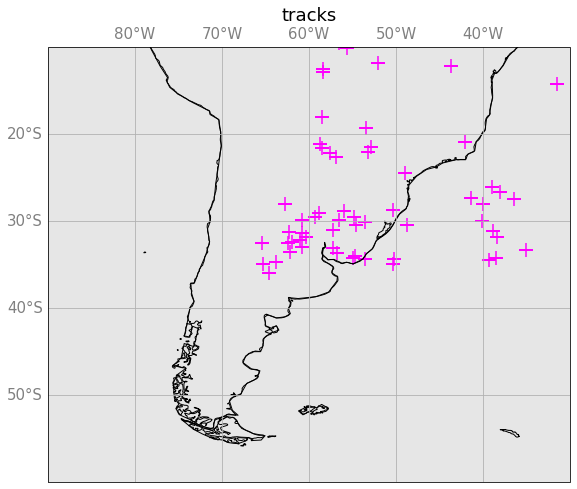

In [27]:
f, ax = plt.subplots(1, 1, figsize=(11,8), subplot_kw=dict(projection=crs.PlateCarree()))
ax.set_extent([-90, -30, -10, -60], crs=crs.PlateCarree()); ax.coastlines()
gl = ax.gridlines()#color="gray",alpha=0.5, linestyle='--',draw_labels=True,linewidth=2)
ax.coastlines(resolution='110m')
gl.xlines = True
gl.ylines = True

gl.xlabels_top = True
gl.ylabels_right = False
gl.ylabels_left = True
gl.ylabels_bottom = True

gl.xformatter = LONGITUDE_FORMATTER
gl.yformatter = LATITUDE_FORMATTER
gl.xlabel_style = {'size': 15, 'color': 'gray'}#, 'weight': 'bold'}
gl.ylabel_style = {'size': 15, 'color': 'gray'}#, 'weight': 'bold'}

plt.title('tracks')

#for ii in range(len(ds.tracks)):
#    ax.plot(ds.meanlon.isel(tracks=ii),ds.meanlat.isel(tracks=ii),c='k',linewidth=4.25)
#    ax.plot(ds.meanlon.isel(tracks=ii),ds.meanlat.isel(tracks=ii),c='green',  linewidth=3.0)
#    ii = ii  + 1
    
ax.scatter(da.core_lon.values,da.core_lat.values,s=200,c='magenta',marker='+')

    

# Divergent and Rotational Winds from ERA5

In [ ]:
import cartopy.crs as ccrs
import matplotlib as mpl
import matplotlib.pyplot as plt
import xarray as xr
import pandas as pd

from windspharm.xarray import VectorWind
from windspharm.examples import example_data_path
from windspharm.tools import prep_data

mpl.rcParams['mathtext.default'] = 'regular'


uwnd_xr = xr.open_dataset('/glade/u/home/isingh9/work/RELAMPAGO_ERA5_NetCDF/download_u.nc')
vwnd_xr = xr.open_dataset('/glade/u/home/isingh9/work/RELAMPAGO_ERA5_NetCDF/download_v.nc')
#wwnd_xr = xr.open_dataset('/glade/u/home/isingh9/work/RELAMPAGO_ERA5_NetCDF/download_w.nc')
geop_xr = xr.open_dataset('/glade/u/home/isingh9/work/RELAMPAGO_ERA5_NetCDF/download_geopot.nc')
pv_xr = xr.open_dataset('/glade/u/home/isingh9/work/RELAMPAGO_ERA5_NetCDF/download_pv.nc')
#print(ds

lons = vwnd_xr.longitude.values
lats = vwnd_xr.latitude.values
times = pd.to_datetime(vwnd_xr.time.values)

In [ ]:
#long1 = (long3 + 180) % 360 - 180

In [ ]:
lats_array_degrees = np.ones((721,1440))*lats[:,np.newaxis]
lons_array_degrees = np.ones((721,1440))*lons[np.newaxis,:]
lats_array_radians = lats_array_degrees*np.pi/180.0
lons_array_radians = lons_array_degrees*np.pi/180.0

In [ ]:
plot_GOES_data = True

if plot_GOES_data:
    #nm,cm=cmap=ctables.registry.get_with_range('ir_tpc',0,200)
    latlon_goes=xr.open_dataset('../simple.nc')
    lats_goes=latlon_goes['lat'].values
    lons_goes=latlon_goes['lon'].values
    goes_directory='/glade/u/home/isingh9/work/GOES_RELAMPAGO_AWSdata/317/'
    goes_filelist = sorted(glob.glob(goes_directory+'**/OR_ABI-L1b-RadF-M?C14_G16*.nc', recursive=True))
    #print((filelist))

    goes_times=[]

    for ff in goes_filelist:
        #print(ff)
        goes_times.append(pd.to_datetime((xr.open_dataset(ff).t.values)))
    
    #print(goes_times)

In [ ]:
def calc_nbe(u_wind_xr,v_wind_xr,geo_pt_xr,TIME,LEVEL):
    print('Calculating NBE at level '+str(LEVEL)+' for time ',TIME)
    
    # perform calculations on a sub-domain to speed things up
    west_lon=280
    east_lon=307
    south_lat=-40
    north_lat=-22.25

    # extract lat-lon values from a random time step of u (or any other variable)
    uuu = uwnd_xr['u'].sel(time=pd.to_datetime('2018-11-13 00:00'),latitude=np.arange(south_lat,north_lat,0.25),\
                       longitude=np.arange(west_lon,east_lon,0.25),level=300)

    subset_lats=uuu.latitude.values
    subset_lons=uuu.longitude.values
    

    lats_array_subset_degrees = np.ones_like(uuu.values)*subset_lats[:,np.newaxis]
    print('   ')
    print('lats_array_subset_degrees',lats_array_subset_degrees)
    print('   ')
    lons_array_subset_degrees = np.ones_like(uuu.values)*subset_lons[np.newaxis,:] - 180.
    # convert degrees to radians
    lats_array_subset_radians = lats_array_subset_degrees*np.pi/180.0
    lons_array_subset_radians = lons_array_subset_degrees*np.pi/180.0
    # calculate grid spacings to compute gradients and laplacian while computing NBE residual
    dx1_subset, dy1_subset = mpcalc.lat_lon_grid_deltas(lons_array_subset_degrees*units('degrees'),\
                                                        lats_array_subset_degrees*units('degrees'))
    #print(dy1_subset)
    print('   ')
    print('shape of dx1_subset  = ',np.shape(dx1_subset))
    print('dx1_subset = ',dx1_subset)
    print('   ')
    print('dy1_subset = ',dy1_subset)
    print('   ')
    
    
    uwnd_temp  = u_wind_xr.u.sel(time=time,level=LEVEL)
    vwnd_temp  = v_wind_xr.v.sel(time=time,level=LEVEL)
    w_temp     = VectorWind(uwnd_temp, vwnd_temp)
    vort_temp  = w_temp.vorticity()
    #print(vort_temp)
    
    uwnd_subset= uwnd_temp.sel(latitude=np.arange(south_lat,north_lat,0.25),\
                            longitude=np.arange(west_lon,east_lon,0.25))
    print(uwnd_subset)
    print('   ')
    vwnd_subset= vwnd_temp.sel(latitude=np.arange(south_lat,north_lat,0.25),\
                            longitude=np.arange(west_lon,east_lon,0.25))
    print(vwnd_subset)
    print('   ')
    geop_subset= geo_pt_xr.z.sel(time=time,level=LEVEL,latitude=np.arange(south_lat,north_lat,0.25),\
               longitude=np.arange(west_lon,east_lon,0.25))
    print(geop_subset)
    vort_subset = vort_temp.sel(latitude=np.arange(south_lat,north_lat,0.25),\
               longitude=np.arange(west_lon,east_lon,0.25))
    print(vort_subset)
    print('   ')
    #

    radius_earth = 6378100.0
    omega = 2*np.pi/(24*60*60)
    cor_param = 2.0*omega*np.sin(lats_array_subset_radians)
    rossby_param = 2.0*omega*np.cos(lats_array_subset_radians)/radius_earth

    #print('calculating d_u_dy...')
    d_u_dy = mpcalc.first_derivative(uwnd_subset.values, axis=0, delta=dy1_subset).magnitude
    #print('calculating d_u_dx...')
    d_u_dx = mpcalc.first_derivative(uwnd_subset.values, axis=1, delta=dx1_subset).magnitude
    #print('calculating d_v_dy...')
    d_v_dy = mpcalc.first_derivative(vwnd_subset.values, axis=0, delta=dy1_subset).magnitude
    #print('calculating d_v_dx...')
    d_v_dx = mpcalc.first_derivative(vwnd_subset.values, axis=1, delta=dx1_subset).magnitude 

    laplacian_geopot = mpcalc.laplacian(geop_subset,deltas=[dy1_subset.magnitude,dx1_subset.magnitude]).magnitude

    nbe = 2.0*(d_u_dx*d_v_dy - d_v_dx*d_u_dy) + cor_param*vort_subset.values \
          -1.0*rossby_param*uwnd_subset.values - laplacian_geopot

    return nbe

In [ ]:
time_range=pd.date_range(start='2018-11-13 00:00', end='2018-11-13 23:00', freq='1H')
time_range

## Main plotting function

In [ ]:
terr=xr.open_dataset("/glade/u/home/isingh9/jupyter_nbks/etopo1.nc")
terr['Band1'].values[terr['Band1'].values < 0.]=np.nan

test_range = pd.to_datetime(['2018-11-11 02:00',])#'2018-11-13 21:00'])

plot_GOES_data = False
use_mean_divergent_wind = True
plot_NBE = True
plot_pv_adv_irrot = False

# if plot_NBE:
#     west_lon=280
#     east_lon=307
#     south_lat=-40
#     north_lat=-22.25

#     uuu = uwnd_xr['u'].sel(time=pd.to_datetime('2018-11-13 00:00'),latitude=np.arange(south_lat,north_lat,0.25),\
#                        longitude=np.arange(west_lon,east_lon,0.25),level=300)

#     subset_lats=uuu.latitude.values
#     subset_lons=uuu.longitude.values
#     lats_array_subset_degrees = np.ones_like(uuu.values)*subset_lats[:,np.newaxis]
#     lons_array_subset_degrees = np.ones_like(uuu.values)*subset_lons[np.newaxis,:] - 180.
#     lats_array_subset_radians = lats_array_subset_degrees*np.pi/180.0
#     lons_array_subset_radians = lons_array_subset_degrees*np.pi/180.0

#     dx1_subset, dy1_subset = mpcalc.lat_lon_grid_deltas(lons_array_subset_degrees*units('degrees'),\
#                                                         lats_array_subset_degrees*units('degrees'))
#     #print(dy1_subset)

for time in test_range:
    time_string_save = time.strftime('%Y-%m-%d_%H-%M')
    time_string_title = time.strftime('%Y-%m-%d %H:%M')
    print('Time is : ',time)
        
    uwnd_300 = uwnd_xr['u'].sel(time=pd.to_datetime(time),level=300)
    vwnd_300 = vwnd_xr['v'].sel(time=pd.to_datetime(time),level=300)
    wspd_300 = np.sqrt(uwnd_300**2 + vwnd_300**2)
    geop_300 = geop_xr['z'].sel(time=pd.to_datetime(time),level=300)
    geo_hgt_300 = geop_300/9.81
    pv_300 = pv_xr['pv'].sel(time=pd.to_datetime(time),level=300)*10**6 # PVU
    
    # Create a VectorWind instance to handle the computation of streamfunction and
    # velocity potential.
    w_300 = VectorWind(uwnd_300, vwnd_300)

    # Compute the streamfunction and velocity potential.
    #sf, vp = w.sfvp()
    #uchi, vchi = w.irrotationalcomponent()
    #upsi, vpsi = w.nondivergentcomponent()
    vort_300  = w_300.vorticity()
    #print(vort)
    
    if use_mean_divergent_wind:
        uwnd_levs = uwnd_xr['u'].sel(time=pd.to_datetime(time),level=slice(200,300))
        vwnd_levs = vwnd_xr['v'].sel(time=pd.to_datetime(time),level=slice(200,300))
        w_levs = VectorWind(uwnd_levs, vwnd_levs)
        uchi_levs, vchi_levs, upsi_levs, vpsi_levs = w_levs.helmholtz()
        #print(uchi_levs)
        uchi = uchi_levs.mean(dim='level',keep_attrs=True)
        vchi = vchi_levs.mean(dim='level',keep_attrs=True)
    else:
        uchi, vchi, upsi, vpsi = w_300.helmholtz()
        
    n=1
    winds_thin_x=2
    panel_plot = False
    var_to_plot=wspd_300
    var_name = 'wspd_NBE'#'wspd_pv_adv_300hPa'

    if panel_plot:
        fig = plt.figure(figsize=(16, 16)) 
        #fig, (ax1, ax2) = plt.subplots(1, 2,  projection=crs.PlateCarree())
        ax1 = fig.add_subplot(1, 2, 1, projection=crs.PlateCarree())
        ax2 = fig.add_subplot(1, 2, 2, projection=crs.PlateCarree())
        #fig.suptitle('Horizontally stacked subplots')

        #ax.set_extent([-66, -64, -34, -30], crs=ccrs.PlateCarree())
        ax1.set_extent([-75, -55, -39, -24], crs=crs.PlateCarree())
        ax2.set_extent([-75, -55, -39, -24], crs=crs.PlateCarree())

        # C1=ax1.barbs(lons[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x], lats[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x],\
        #                        uchi[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x],\
        #                        vchi[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x],linewidth=0.9, length=5, pivot='middle',transform=crs.PlateCarree(),\
        #                             flip_barb=True)
        #C11=ax1.contourf(lons,lats,wspd,levels=np.arange(40,92,2),cmap=cma4,extend='both')
        #C12=ax2.contourf(lons,lats,wspd,levels=np.arange(40,92,2),cmap=cma4,extend='both')

        C11=ax1.contourf(lons,lats,pv_adv_irrot)#,levels=np.arange(40,92,2),cmap=cma4,extend='both')
        C12=ax2.contourf(lons,lats,pv_adv_irrot)#,levels=np.arange(40,92,2),cmap=cma4,extend='both')

        #C21=ax1.contour(lons,lats,geo_hgt,levels=np.arange(9000,12000,40),linewidths=1.0,colors='k')
        #C22=ax2.contour(lons,lats,geo_hgt,levels=np.arange(9000,12000,40),linewidths=1.0,colors='k')

        #C31=ax1.contour(lons,lats,pv,levels=np.arange(-5,-1,1),linewidths=1.2,colors='blue',linestyles='solid')
        #C32=ax2.contour(lons,lats,pv,levels=np.arange(-5,-1,1),linewidths=1.2,colors='blue',linestyles='solid')

        #C01=ax1.barbs(lons[::winds_thin_x],lats[::winds_thin_x],uchi[::winds_thin_x,::winds_thin_x],vchi[::winds_thin_x,::winds_thin_x],linewidth=0.9, length=6, pivot='middle',transform=crs.PlateCarree(),flip_barb=True)
        #C02=ax2.barbs(lons[::winds_thin_x],lats[::winds_thin_x],upsi[::winds_thin_x,::winds_thin_x],vpsi[::winds_thin_x,::winds_thin_x],linewidth=0.9, length=6, pivot='middle',transform=crs.PlateCarree(),flip_barb=True)
        ################################ Plot terrain contours ##########################
        topo_cont1=ax1.contour(terr.lon.values,terr.lat.values,terr.Band1.values, levels=np.array([1000,3000,5000]), 
                       colors="k",linewidths=0.4,transform=crs.PlateCarree())
        topo_cont2=ax2.contour(terr.lon.values,terr.lat.values,terr.Band1.values, levels=np.array([1000,3000,5000]), 
                       colors="k",linewidths=0.4,transform=crs.PlateCarree())
        #ax.clabel(topo_cont, topo_cont.levels,inline=True, fmt='%1.f',fontsize=7)
        ax1.set_title('Irrotational wind (m/s)'+'\n'+time_string_title)
        ax2.set_title('Non-divergent wind (m/s)'+'\n'+time_string_title)
        #plt.suptitle('ERA5 wind field decomposition'+'\n'+time_string_title)
        #################################################################################
        gl = ax1.gridlines(crs=crs.PlateCarree(),draw_labels=True,linewidth=2, color='gray', alpha=0.5, linestyle='-')
        gl.xlabels_top = False
        gl.ylabels_left = True
        gl.ylabels_right = False
        gl.ylabels_bottom = True
        gl.xformatter = LONGITUDE_FORMATTER
        gl.yformatter = LATITUDE_FORMATTER
        gl.xlabel_style = {'size': 12, 'color': 'gray'}#, 'weight': 'bold'}
        gl.ylabel_style = {'size': 12, 'color': 'gray'}#, 'weight': 'bold'}


        gl = ax2.gridlines(crs=crs.PlateCarree(),draw_labels=True,linewidth=2, color='gray', alpha=0.5, linestyle='-')
        gl.xlabels_top = False
        gl.ylabels_left = True
        gl.ylabels_right = False
        gl.ylabels_bottom = True
        gl.xformatter = LONGITUDE_FORMATTER
        gl.yformatter = LATITUDE_FORMATTER
        gl.xlabel_style = {'size': 12, 'color': 'gray'}#, 'weight': 'bold'}
        gl.ylabel_style = {'size': 12, 'color': 'gray'}#, 'weight': 'bold'}

        #plt.colorbar(C11,orientation='horizontal')
        cb_ax = fig.add_axes([0.2, 0.27, 0.6, 0.02])  
        cbar = fig.colorbar(C11,cax=cb_ax,orientation = 'horizontal',fraction=0.09,shrink=0.6,aspect=30,pad=0.02) #cax=cb_ax,

    else:
        fig = plt.figure(figsize=(9, 9)) 
        ax1 = fig.add_subplot(1, 1, 1, projection=crs.PlateCarree())
        ax1.set_extent([-75, -55, -39, -24], crs=crs.PlateCarree())
        ax1.coastlines()
        pv_levels = np.arange(-6,0,2)
        pv_levels = pv_levels[pv_levels!=0]
        pv_adv_levels= np.linspace(0,0.001,8)
        pv_adv_levels = pv_adv_levels[pv_adv_levels!=0.0]
        #print(pv_adv_levels)
        # C1=ax1.barbs(lons[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x], lats[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x],\
        #                        uchi[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x],\
        #                        vchi[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x],linewidth=0.9, length=5, pivot='middle',transform=crs.PlateCarree(),\
        #                             flip_barb=True)
        #C11=ax1.contourf(lons,lats,wspd,levels=np.arange(40,92,2),cmap=cma4,extend='both')
        if plot_GOES_data:
            closest_dict = { abs(time - goes_time) : goes_time for goes_time in goes_times}
            # extracting minimum key using min()
            res = closest_dict[min(closest_dict.keys())]
            print("Time in ERA file : ", time)
            print("Nearest time from GOES list : " + str(res))

            corresp_goes_file = goes_filelist[list(closest_dict.values()).index(res)]
            print('corresponding goes file is: ',corresp_goes_file)

            C=xr.open_dataset(corresp_goes_file)
            Rad = C.metpy.parse_cf('Rad')[3500:5000,2500:4000]
            #print(Rad)
            lats1=latlon_goes['lat'].values[3500:5000,2500:4000]
            lons1=latlon_goes['lon'].values[3500:5000,2500:4000]
            geos = Rad.metpy.cartopy_crs

            # Convert radiance to Brightness Temp 
            fk1 = C.variables['planck_fk1'].values
            fk2 = C.variables['planck_fk2'].values
            bc1 = C.variables['planck_bc1'].values
            bc2 = C.variables['planck_bc2'].values
            #Compute brightness temp from radiances
            dat = (fk2 / ( np.log((fk1 / Rad.values) + 1 )) - bc1) / bc2
            #################################### Plot contours ################################
            C51=ax1.contourf(lons1,lats1,dat,cmap=cma5,levels=np.arange(160,331,1),extend='both')#,\
            
        if plot_NBE:
            #nbe_200 = calc_nbe(uwnd_xr,vwnd_xr,geop_xr,time,200)
            #nbe_225 = calc_nbe(uwnd_xr,vwnd_xr,geop_xr,time,225)
            nbe_250 = calc_nbe(uwnd_xr,vwnd_xr,geop_xr,time,250)
            nbe_300 = calc_nbe(uwnd_xr,vwnd_xr,geop_xr,time,300)
            #nbe_mean = (nbe_200 + nbe_225 + nbe_250 + nbe_300)/2.0
            nbe_mean = (nbe_250 + nbe_300)/2.0
            nbe_levs = np.linspace(-7*10**-7,7*10**-7,9)
            nbe_levs = nbe_levs[nbe_levs!=0.0]
            #
            #C61=ax1.contour(subset_lons,subset_lats,nbe,levels=np.linspace(-6*10**-7,6*10**-7,7))#,extend='both',cmap=plt.get_cmap('RdBu'))
            #C611=ax1.contour(subset_lons,subset_lats,nbe,levels=nbe_levs,colors='white',linewidths=2.5)#,extend='both',cmap=plt.get_cmap('RdBu'))
            C610=ax1.contour(subset_lons,subset_lats,nbe_mean,levels=nbe_levs,colors='cyan',linewidths=1.5)#,extend='both',cmap=plt.get_cmap('RdBu'))
                
        if plot_pv_adv_irrot:
            uwnd_levs_adv = uwnd_xr['u'].sel(time=pd.to_datetime(time),level=slice(275,325))
            vwnd_levs_adv = vwnd_xr['v'].sel(time=pd.to_datetime(time),level=slice(275,325))
            w_levs_adv = VectorWind(uwnd_levs_adv, vwnd_levs_adv)
            uchi_levs, vchi_levs, upsi_levs, vpsi_levs = w_levs_adv.helmholtz()
            uchi_adv = uchi_levs.mean(dim='level',keep_attrs=True)
            vchi_adv = vchi_levs.mean(dim='level',keep_attrs=True)
            pv_adv_irrot = mpcalc.advection(pv_300, u=uchi_adv, v=vchi_adv) #* 10000.#, w=None, 
            C41=ax1.contour(lons,lats,pv_adv_irrot,levels=pv_adv_levels,linewidths=1.3,colors='green')
            #print(np.min(pv_adv_irrot))
            #print(np.max(pv_adv_irrot))
           
        ####################################
        C11=ax1.contourf(lons,lats,var_to_plot,levels=np.arange(40,82,2),alpha=0.6,cmap=plt.get_cmap('Oranges'),extend='max')
        C21=ax1.contour(lons,lats,geo_hgt_300,levels=np.arange(9000,12000,40),linewidths=0.9,colors='k')
        C31=ax1.contour(lons,lats,pv_300,levels=pv_levels,linewidths=1.0,colors='blue',linestyles='solid')
        C01=ax1.barbs(lons[::winds_thin_x],lats[::winds_thin_x],uchi[::winds_thin_x,::winds_thin_x],vchi[::winds_thin_x,::winds_thin_x],linewidth=0.9, length=5, pivot='middle',transform=crs.PlateCarree(),flip_barb=True)
        ####################################
        
        
        ################################ Plot terrain contours ##########################
        topo_cont1=ax1.contour(terr.lon.values,terr.lat.values,terr.Band1.values, levels=np.array([1000,3000,5000]), 
                       colors="yellow",linewidths=0.4,transform=crs.PlateCarree())#saddlebrown
        #ax.clabel(topo_cont, topo_cont.levels,inline=True, fmt='%1.f',fontsize=7)
        #ax1.set_title('Irrotational wind (m/s)'+'\n'+time_string_title)
        #ax1.set_title('Positive PV advection at 300 hPa (PVU/s)'+'\n'+time_string_title)
        ax1.set_title('NBE'+'\n'+time_string_title)
        #plt.suptitle('ERA5 wind field decomposition'+'\n'+time_string_title)
        #################################################################################
        gl = ax1.gridlines(crs=crs.PlateCarree(),draw_labels=True,linewidth=2, color='gray', alpha=0.5, linestyle='-')
        gl.xlabels_top = False
        gl.ylabels_left = True
        gl.ylabels_right = False
        gl.ylabels_bottom = True
        gl.xformatter = LONGITUDE_FORMATTER
        gl.yformatter = LATITUDE_FORMATTER
        gl.xlabel_style = {'size': 12, 'color': 'gray'}#, 'weight': 'bold'}
        gl.ylabel_style = {'size': 12, 'color': 'gray'}#, 'weight': 'bold'}
        
        #plt.colorbar(C11,orientation='horizontal')
        cb_ax = fig.add_axes([0.21, 0.09, 0.6, 0.02])  
        cbar = fig.colorbar(C11,cax=cb_ax,orientation = 'horizontal',fraction=0.09,shrink=0.6,aspect=30,pad=0.02) #cax=cb_ax,
        #format=OOMFormatter(-4, mathText=False)
    plt.tight_layout()
    filename = var_name+'_ERA5_GOES_'+time_string_save+'.png'
    print(filename)
    #plt.savefig(filename,dpi=200)
    #plt.close()
    print('--------------------------------------------------------------')

## Hovemoller of PV advection by divergent winds

In [ ]:
import cartopy.crs as ccrs
import matplotlib as mpl
import matplotlib.pyplot as plt
import xarray as xr
import pandas as pd

from windspharm.xarray import VectorWind
from windspharm.examples import example_data_path
from windspharm.tools import prep_data

mpl.rcParams['mathtext.default'] = 'regular'


uwnd_xr = xr.open_dataset('/glade/u/home/isingh9/work/RELAMPAGO_ERA5_NetCDF/download_u.nc')
vwnd_xr = xr.open_dataset('/glade/u/home/isingh9/work/RELAMPAGO_ERA5_NetCDF/download_v.nc')
#wwnd_xr = xr.open_dataset('/glade/u/home/isingh9/work/RELAMPAGO_ERA5_NetCDF/download_w.nc')
geop_xr = xr.open_dataset('/glade/u/home/isingh9/work/RELAMPAGO_ERA5_NetCDF/download_geopot.nc')
pv_xr = xr.open_dataset('/glade/u/home/isingh9/work/RELAMPAGO_ERA5_NetCDF/download_pv.nc')
#print(ds

lons = vwnd_xr.longitude.values
lats = vwnd_xr.latitude.values
times = pd.to_datetime(vwnd_xr.time.values)

In [ ]:

west_lon_llj=294
east_lon_llj=302
south_lat_llj=-30
north_lat_llj=-20

vwnd_xr.sel(latitude=np.arange(south_lat_llj,north_lat_llj,0.25),\
                       longitude=np.arange(west_lon_llj,east_lon_llj,0.25),level=slice(1000).isel(time=2).v.plot()

In [ ]:
#Hovemoller of PV advection by divergent winds

time_range=pd.date_range(start='2018-11-10 00:00', end='2018-11-13 23:00', freq='1H')

uwnd_levs_adv = uwnd_xr['u'].sel(time=time_range,level=slice(275,325))
vwnd_levs_adv = vwnd_xr['v'].sel(time=time_range,level=slice(275,325))

pv_300 = pv_xr['pv'].sel(time=time_range,level=300)*10**6 # PVU

#print(uwnd_levs_adv)

w_levs_adv = VectorWind(uwnd_levs_adv, vwnd_levs_adv)

uchi_levs, vchi_levs, upsi_levs, vpsi_levs = w_levs_adv.helmholtz()

uchi_adv = uchi_levs.mean(dim='level',keep_attrs=True)
vchi_adv = vchi_levs.mean(dim='level',keep_attrs=True)

pv_adv_irrot = mpcalc.advection(pv_300, u=uchi_adv, v=vchi_adv) #* 10000.#, w=None, 


west_lon=292
east_lon=302
south_lat=-38
north_lat=-28

west_lon_llj=294
east_lon_llj=302
south_lat_llj=-30
north_lat_llj=-20

pv_adv_irrot_subset = pv_adv_irrot.sel(latitude=np.arange(south_lat,north_lat,0.25),\
                       longitude=np.arange(west_lon,east_lon,0.25))
#C41=ax1.contour(lons,lats,pv_adv_irrot,levels=pv_adv_levels,linewidths=1.3,colors='green')
#print(np.min(pv_adv_irrot))
#print(np.max(pv_adv_irrot))

In [ ]:
vwnd_llj = vwnd_xr['v'].sel(time=time_range,level=slice(775,975),latitude=np.arange(south_lat_llj,north_lat_llj,0.25),\
                            longitude=np.arange(west_lon_llj,east_lon_llj,0.25)).mean(dim='level').mean(dim='latitude')
vwnd_llj.plot()

In [ ]:
fig = plt.figure(figsize=(11,8))
#tr = pv_adv_irrot_subset.time.values
#lo = pv_adv_irrot_subset.longitude.values
#print(tr)
#print(lo)
#plt.plot(lo,tr,pv_adv_irrot_subset.mean(dim='latitude').values)
c_pv = pv_adv_irrot_subset.mean(dim='latitude').plot()
vwnd_llj = vwnd_xr['v'].sel(time=time_range,level=slice(775,975),latitude=np.arange(south_lat_llj,north_lat_llj,0.25),\
                            longitude=np.arange(west_lon_llj,east_lon_llj,0.25)).mean(dim='level').mean(dim='latitude')\
         .plot.contour(levels=np.arange(-10,12,2),cmap='viridis')
plt.savefig('PV_advection_LLJ.png',dpi=200)

In [ ]:
################################# Title and colorbar ############################
kk=pd.to_datetime(C.t.values)
ax1.title.set_text('GOES-16 Ch14 Brightness Temperature $(K)$ \n'+kk.strftime('%d %B %Y %H:%M UTC '))
cb_ch14 = fig.colorbar(pp1, ax=ax1, shrink=.85,orientation='horizontal',pad = 0.02)

#################################### plot gridlines ############################
gl = ax1.gridlines(crs=crs.PlateCarree(),draw_labels=True,linewidth=2, color='gray', alpha=0.5, linestyle='-')
gl.xlabels_top = False
gl.ylabels_left = True
gl.ylabels_right = False
gl.ylabels_bottom = True
gl.xformatter = LONGITUDE_FORMATTER
gl.yformatter = LATITUDE_FORMATTER
gl.xlabel_style = {'size': 12, 'color': 'gray'}#, 'weight': 'bold'}
gl.ylabel_style = {'size': 12, 'color': 'gray'}#, 'weight': 'bold'}

################################ WRF file ####################################   
ncfile = Dataset(WRF_FILE)
wrf_times = getvar(ncfile,'times')
ctt = getvar(ncfile,'ctt',units='K')#/1000.
#print(ctt)
pp2 = ax2.contourf(lons_wrf,lats_wrf, ctt.values,transform=crs.PlateCarree(),levels=np.arange(160,331,1),\
             extend='both',cmap=plt.get_cmap('viridis_r'))
#topo_cont2=ax2.contour(lons_wrf,lats_wrf,terr_wrf.values, levels=np.arange(0,7000,1000), 
#               colors="k",linewidths=0.4,transform=crs.PlateCarree())
topo_cont2=ax2.contour(terr.lon.values,terr.lat.values,terr.Band1.values, levels=np.arange(0,7000,1000), 
               colors="k",linewidths=0.4,transform=crs.PlateCarree())

ax2.set_extent([-75, -55, -39, -24], crs=crs.PlateCarree())

tiempo = pd.to_datetime(wrf_times.values).strftime('%d %B %Y %H:%M UTC ')
ax2.title.set_text('WRF Cloud Top Temperature $(K)$ \n'+tiempo)
#cb2 = ax2.colorbar(pp2)
# Plot contours
#levels=np.arange(0.0,800.0,10.0))
#plt.colorbar(pp2,orientation='horizontal')
ncfile.close()
cb_ctt = fig.colorbar(pp2, ax=ax2, shrink=.850,orientation='horizontal', pad = 0.02)

gl = ax2.gridlines(crs=crs.PlateCarree(),draw_labels=True,linewidth=2, color='gray', alpha=0.5, linestyle='-')
gl.xlabels_top = False
gl.ylabels_right = True
gl.ylabels_left = False
gl.ylabels_bottom = True
#gl.xlines = False
#gl.xlocator = mticker.FixedLocator([-67, -66, 0, 45, 180])
gl.xformatter = LONGITUDE_FORMATTER
gl.yformatter = LATITUDE_FORMATTER
gl.xlabel_style = {'size': 12, 'color': 'gray'}#, 'weight': 'bold'}
gl.ylabel_style = {'size': 12, 'color': 'gray'}#, 'weight': 'bold'}

plt.tight_layout()

In [ ]:
# Pick out the field for December.
sf_dec = sf[sf['time.month'] == 12]
vp_dec = vp[vp['time.month'] == 12]

# Plot streamfunction.
clevs = [-120, -100, -80, -60, -40, -20, 0, 20, 40, 60, 80, 100, 120]
ax = plt.subplot(111, projection=ccrs.PlateCarree(central_longitude=180))
sf_dec *= 1e-6
fill_sf = sf_dec[0].plot.contourf(ax=ax, levels=clevs, cmap=plt.cm.RdBu_r,
                                  transform=ccrs.PlateCarree(), extend='both',
                                  add_colorbar=False)
ax.coastlines()
ax.gridlines()
plt.colorbar(fill_sf, orientation='horizontal')
plt.title('Streamfunction ($10^6$m$^2$s$^{-1}$)', fontsize=16)

# Plot velocity potential.
plt.figure()
clevs = [-10, -8, -6, -4, -2, 0, 2, 4, 6, 8, 10]
ax = plt.subplot(111, projection=ccrs.PlateCarree(central_longitude=180))
vp_dec *= 1e-6
fill_vp = vp_dec[0].plot.contourf(ax=ax, levels=clevs, cmap=plt.cm.RdBu_r,
                                  transform=ccrs.PlateCarree(), extend='both',
                                  add_colorbar=False)
ax.coastlines()
ax.gridlines()
plt.colorbar(fill_vp, orientation='horizontal')
plt.title('Velocity Potential ($10^6$m$^2$s$^{-1}$)', fontsize=16)
plt.show()

##### Functions

In [ ]:
import cdsapi
import fsspec
import dask.array as dsa
from dask.base import tokenize

In [ ]:
def request_to_dataset(name, request):
    c = cdsapi.Client()
    r = c.retrieve(name, request, None)
    #print(r)
    with fsspec.open(r.location) as f:
        ds = xr.open_dataset(f, engine='scipy')
    return ds


def request_to_numpy_array(name, request, vname):
    ds = request_to_dataset(name, request)
    return ds[vname].values


def full_request(request_base, date):
    #print(date.year)
    #print(date.month)
    #print(date.day)
    #print(date.hour)
    request = {'date': date.strftime("%Y")+"-"+date.strftime("%m")+"-"+date.strftime("%d")}
    #request = {'year': f'{date.year}',
    #           'month': f'{date.month:02d}',
    #           'day': f'{date.day:02d}',
    #           'time': f'{date.hour:02d}:00'}
    request.update(request_base)
    return request

    
class CDSTimeseriesRequest:
    """A class that can generate lazy representations of CDS data for many timesteps.
    
    Parameters
    ----------
    name : str
        Passed to CDS API
    request_base : dict
        Passed to CDS API
    **date_range_kwargs : dict
        Passed to pandas.date_range to generate dates
        https://pandas.pydata.org/pandas-docs/stable/reference/api/pandas.date_range.html
    """
    
    def __init__(self, name, request_base,dates):
        self.name = name
        self.request_base = request_base
        # TODO: validate date range
        self.time = dates
        
    
    def dataset(self):
        """Create xarray dataset for requests.
        
        Returns
        -------
        ds : xarray.Dataset
        """
        # get the first file eagerly
        print(self.time)
        request = full_request(self.request_base, self.time[0])
        #print(request)
        ds1 = request_to_dataset(self.name, request)
        
        #print(ds1)
        
        assert len(ds1.data_vars) == 1
        vname = list(ds1.data_vars.keys())[0]
        dvar = ds1[vname]
        dtype = dvar.dtype
        base_shape = dvar.shape[1:]
        shape = (len(self.time),) + base_shape

        # manually build dask graph
        # this is a bit a black magic, and there are easier ways to do it
        # however, this way scales very well (can handle millions of tasks)
        chunks = (len(self.time) * (1,),) + tuple([(s,) for s in base_shape])
        dsk = {}
        token = tokenize(self.name, self.request_base, self.time)
        for n_time, time in enumerate(self.time):
            request = full_request(self.request_base, time)
            name = '-'.join([vname, token])
            key = (name, n_time) + len(base_shape) * (0,)
            task = request_to_numpy_array, self.name, request, vname
            dsk[key] = task
        data = dsa.Array(dsk, name, chunks, dtype)

        # put back together as a dataset
        coords = ds1.coords
        del coords['time']
        ds = xr.Dataset({vname: (dvar.dims, data, dvar.attrs)},
                        coords=coords)
        ds['time'] = 'time', self.time
        return ds

### Dynamic Tropopause data

In [ ]:
# plot_dt_theta:
#TIMES=pd.to_datetime('2018-11-11 10')

#print(date.strftime("%Y"))
print('getting DT data from archive')

def get_pressure_on_dt(TIMES):
    name = 'reanalysis-era5-complete'
    request = {
        'class'   : 'ea',
        'levelist': '2000',
        'levtype' : 'pv',
        'param'   : '54.128',
        'stream'  : 'oper',
        'grid'    : [0.25, 0.25],
        'area'    : [-20.,-80, -40.,-40.], #N,W,S,E
        'type'    : 'an',
        'format'  : 'netcdf'
        }
    r = CDSTimeseriesRequest(name, request, dates=TIMES)# start='2008-01-01 12:00', freq='1H', periods=24)
    dsc = r.dataset()
    return dsc
#'time'    : ['00:00', '12:00',],
final_ds =get_pressure_on_dt(pd.date_range(start='2018-11-09 00', end='2018-11-14 00', freq = '12H').tolist())
#final_ds = get_pressure_on_dt([pd.to_datetime('2018-11-09 00'),pd.to_datetime('2018-11-14 00')])


# def get_olr(TIMES):
#     name = 'reanalysis-era5-complete'
#     request = {
#         'variable': 'top_net_thermal_radiation',
#         'class'   : 'ea',
#         'levtype' : 'sfc',
#         'grid'    : [0.25, 0.25],
#         'area'    : [-20.,-80, -40.,-40.], #N,W,S,E
#         'type'    : 'fc',
#         'format'  : 'netcdf'
#         }
#     r = CDSTimeseriesRequest(name, request, dates=TIMES)# start='2008-01-01 12:00', freq='1H', periods=24)
#     dsc = r.dataset()
#     return dsc
# #'time'    : ['00:00', '12:00',],
# final_ds_olr =get_olr(pd.date_range(start='2018-11-09 00', end='2018-11-14 00', freq = '6H').tolist())
# #final_ds = get_pressure_on_dt([pd.to_datetime('2018-11-09 00'),pd.to_datetime('2018-11-14 00')])

In [ ]:
final_ds.load()
times_label='relampago_times'
location_label=''
final_ds.to_netcdf('pres_at_2pvu_sfc_'+times_label+'_'+location_label+'.nc')

dt_pressure_da = xr.open_dataset('./pres_at_2pvu_sfc_relampago_times_.nc')

### GOES data

In [ ]:
latlon_goes=xr.open_dataset('../simple.nc')

print(latlon_goes)
lats_goes=latlon_goes['lat'].values
lons_goes=latlon_goes['lon'].values


terr=xr.open_dataset("/glade/u/home/isingh9/jupyter_nbks/etopo1.nc")
terr['Band1'].values[terr['Band1'].values < 0.]=np.nan

In [ ]:
def find_latlon_indices(lat_N,lat_S,lon_W,lon_E,lats_array,lons_array):
    
    difference_array = np.absolute(lats_array-lat_N)
    index_lat_N = np.unravel_index(np.nanargmin(difference_array, axis=None), difference_array.shape) #difference_array.argmin(difference_array)
    
    difference_array = np.absolute(lats_array-lat_S)
    index_lat_S = np.unravel_index(np.nanargmin(difference_array, axis=None), difference_array.shape)

    difference_array = np.absolute(lons_array-lon_W)
    index_lon_W = np.unravel_index(np.nanargmin(difference_array, axis=None), difference_array.shape)

    difference_array = np.absolute(lons_array-lon_E)
    index_lon_E = np.unravel_index(np.nanargmin(difference_array, axis=None), difference_array.shape)
    #print(index)

    print('index of northernmost latitude is ',index_lat_N)
    print('index of southernmost latitude is ',index_lat_S)
    print('index of westernmost longitude is ',index_lon_W)
    print('index of easternmost longitude is ',index_lon_E)
    
    print('returning values in the format y1 y2 x1 x2')
    return 4100,4600,3000,3500

    #print("Nearest element to the given values is : ", arr[index])
    #print("Index of nearest value is : ", index)

goes_y1,goes_y2, goes_x1, goes_x2 = find_latlon_indices(-20,-40,-80,-40,lats_goes,lons_goes)
print(goes_y1)
print(goes_y2)
print(goes_x1)
print(goes_x2)
#plt.imshow(lons_goes)
#plt.colorbar()

In [ ]:
directory='/glade/u/home/isingh9/work/GOES_RELAMPAGO_AWSdata/31?/'
filelist = sorted(glob.glob(directory+'00/OR_ABI-L1b-RadF-M?C14_G16_s2018?????00*.nc', recursive=True)+\
                  glob.glob(directory+'06/OR_ABI-L1b-RadF-M?C14_G16_s2018?????00*.nc', recursive=True)+\
                  glob.glob(directory+'12/OR_ABI-L1b-RadF-M?C14_G16_s2018?????00*.nc', recursive=True)+\
                  glob.glob(directory+'18/OR_ABI-L1b-RadF-M?C14_G16_s2018?????00*.nc', recursive=True))
print(filelist)

BT_avg_list=[]
goes_time_list=[]

for fil in filelist:
    goes_time = pd.to_datetime((xr.open_dataset(fil).t.values))
    print('time in the GOES file is ',goes_time)
    C=xr.open_dataset(fil)
    Rad = C.metpy.parse_cf('Rad')[goes_y1:goes_y2,goes_x1:goes_x2]
    # Convert radiance to Brightness Temp 
    fk1 = C.variables['planck_fk1'].values
    fk2 = C.variables['planck_fk2'].values
    bc1 = C.variables['planck_bc1'].values
    bc2 = C.variables['planck_bc2'].values
    #Compute brightness temp from radiances
    dat = np.mean((fk2 / ( np.log((fk1 / Rad.values) + 1 )) - bc1) / bc2)
    BT_avg_list.append(dat)
    goes_time_list.append(goes_time)

In [ ]:
fff = '/glade/u/home/isingh9/work/GOES_RELAMPAGO_AWSdata/316/10/OR_ABI-L1b-RadF-M3C14_G16_s20183161000348_e20183161011114_c20183161011184.nc'
C=xr.open_dataset(fff)
#ax.set_extent([-66, -64, -34, -30], crs=ccrs.PlateCarree())
Rad = C.metpy.parse_cf('Rad')[goes_y1:goes_y2,goes_x1:goes_x2]
#print(Rad)
# Convert radiance to Brightness Temp 
fk1 = C.variables['planck_fk1'].values
fk2 = C.variables['planck_fk2'].values
bc1 = C.variables['planck_bc1'].values
bc2 = C.variables['planck_bc2'].values
print(" ")
#Compute brightness temp from radiances
dat = (fk2 / ( np.log((fk1 / Rad.values) + 1 )) - bc1) / bc2


fig = plt.figure(figsize=(15, 15)) 
#fig, (ax1, ax2) = plt.subplots(1, 2,  projection=crs.PlateCarree())
ax1 = fig.add_subplot(1, 1, 1, projection=crs.PlateCarree())
ax1.set_extent([-70, -50, -42, -25], crs=crs.PlateCarree())


lats1=latlon_goes['lat'].values[goes_y1:goes_y2,goes_x1:goes_x2]
lons1=latlon_goes['lon'].values[goes_y1:goes_y2,goes_x1:goes_x2]

#################################### Plot contours ################################
pp1=ax1.contourf(lons1,lats1,dat,cmap=plt.get_cmap('viridis_r'),levels=np.arange(160,331,1),extend='both')#,\

################################ Plot terrain contours ##########################
topo_cont1=ax1.contour(terr.lon.values,terr.lat.values,terr.Band1.values, levels=np.arange(0,7000,1000), 
               colors="k",linewidths=0.4,transform=crs.PlateCarree())
#ax.clabel(topo_cont, topo_cont.levels,inline=True, fmt='%1.f',fontsize=7)

ax1.coastlines(resolution='110m')

gl = ax1.gridlines(crs=crs.PlateCarree(),draw_labels=True,linewidth=2, color='gray', alpha=0.5, linestyle='-')
gl.xlabels_top = False
gl.ylabels_right = False
gl.ylabels_left = True
gl.ylabels_bottom = True
gl.xformatter = LONGITUDE_FORMATTER
gl.yformatter = LATITUDE_FORMATTER
gl.xlabel_style = {'size': 9, 'color': 'gray'}#, 'weight': 'bold'}
gl.ylabel_style = {'size': 9, 'color': 'gray'}#, 'weight': 'bold'}

In [ ]:
fig = plt.figure(figsize=(11,8))
plt.plot()

In [ ]:
for gf in filelist:
    print(gf)
    C=xr.open_dataset(gf)
    #ax.set_extent([-66, -64, -34, -30], crs=ccrs.PlateCarree())
    Rad = C.metpy.parse_cf('Rad')[goes_y1:goes_y2,goes_x1:goes_x2]
    #print(Rad)
    # Convert radiance to Brightness Temp 
    fk1 = C.variables['planck_fk1'].values
    fk2 = C.variables['planck_fk2'].values
    bc1 = C.variables['planck_bc1'].values
    bc2 = C.variables['planck_bc2'].values
    print(" ")
    #Compute brightness temp from radiances
    dat = (fk2 / ( np.log((fk1 / Rad.values) + 1 )) - bc1) / bc2
    print(np.min(dat))
    #print((dat))

### Dynamic tropopause and GOES

In [ ]:
# Final time series plot of GOES-16 brightness temperature avgd. over the domain and 
# dynamic tropopause pressure

fig = plt.figure(figsize=(11,8))
ax=plt.gca()
ax.plot(dt_pressure_da.time,dt_pressure_da.pres.mean(dim=['latitude','longitude'])/100.,color='red')
ax.set_ylabel('Dynamic Tropopause (hPa)')
ax.set_xlabel('time')
ax2=ax.twinx()
ax2.plot(goes_time_list,BT_avg_list,color='blue')
ax2.set_ylabel('GOES-16 Brightness Temperature (K)')

### EOF analysis

In [ ]:
from eofs.standard import Eof
# Eofs for prec CRU TS v4.03 – seasonal DJF means

filename = '/Users/pedrotildes/data/crupre-djfmeaneur.nc'
ncin = Dataset(filename, ‘r’)

pre_djf = ncin.variables['pre'][:]
lons = ncin.variables['lon'][:]
lats = ncin.variables['lat'][:]
ncin.close()

# Compute anomalies by removing the time-mean.
pre_djf_mean = pre_djf.mean(axis=0)
pre_djf = pre_djf – pre_djf_mean
#print(s_djf)

# Create an EOF solver to do the EOF analysis. Square-root of cosine of
# latitude weights are applied before the computation of EOFs.
coslat = np.cos(np.deg2rad(lats)).clip(0., 1.)
wgts = np.sqrt(coslat)[…, np.newaxis]
solver = Eof(pre_djf, weights=wgts)

# Retrieve the leading EOF, expressed as the correlation between the leading PC
# time series and the input SLP anomalies at each grid point.
eof1 = solver.eofsAsCorrelation(neofs=3)
pc1 = solver.pcs(npcs=3, pcscaling=0)
varfrac = solver.varianceFraction()
lambdas = solver.eigenvalues()

# Plot the leading EOF (3) expressed as correlation in the European domain.
for i in range(0,3):
    plt.figure(figsize=(13,6.2))

#plt.subplot(211)
#ax=fig.add_axes([0.1,0.1,0.8,0.8])
ax = plt.axes(projection=ccrs.PlateCarree())
ax.coastlines(resolution=’110m’)
ax.gridlines()
fill=ax.contourf(lons, lats, eof1[i,:,:].squeeze(), levels=10,
cmap=plt.cm.RdBu_r, transform=ccrs.PlateCarree())
cb = plt.colorbar(fill, orientation=’vertical’)
plt.title(‘EOF ‘ + str(i+1), fontsize=16)
plt.show()

#plt.subplot(212)
plt.figure(figsize=(13,6.2))
years = np.arange(1900,2018,1)
plt.plot(years, pc1[:,i], linewidth=2)
plt.xticks(range(1900, 2018,10), rotation=’vertical’)
plt.axhline(0, color=’k’)
plt.xlabel(‘Year’)
plt.ylabel(‘PC Amplitude’)
plt.xlim(1902, 2018)
plt.ylim(np.min(pc1.squeeze()), np.max(pc1.squeeze()))
plt.xticks(np.arange(min(years), max(years)+1, 10.0))
plt.tight_layout()
plt.show()

# QG Analysis of ERA5 data

In [ ]:
uwnd_xr = xr.open_dataset('/glade/u/home/isingh9/work/RELAMPAGO_ERA5_NetCDF/download_u.nc')
vwnd_xr = xr.open_dataset('/glade/u/home/isingh9/work/RELAMPAGO_ERA5_NetCDF/download_v.nc')
temp_xr = xr.open_dataset('/glade/u/home/isingh9/work/RELAMPAGO_ERA5_NetCDF/download_t.nc')
geop_xr = xr.open_dataset('/glade/u/home/isingh9/work/RELAMPAGO_ERA5_NetCDF/download_geopot.nc')
pv_xr = xr.open_dataset('/glade/u/home/isingh9/work/RELAMPAGO_ERA5_NetCDF/download_pv.nc')
#wwnd_xr = xr.open_dataset('/glade/u/home/isingh9/work/RELAMPAGO_ERA5_NetCDF/download_w.nc')
#print(ds

lons = vwnd_xr.longitude.values
lats = vwnd_xr.latitude.values
times = pd.to_datetime(vwnd_xr.time.values)

west_lon=275
east_lon=316
south_lat=-45
north_lat=-15

terr=xr.open_dataset("/glade/u/home/isingh9/jupyter_nbks/etopo1.nc")
terr['Band1'].values[terr['Band1'].values < 0.]=np.nan

In [ ]:
geop_xr.z.isel(time = 11).sel(level=300).plot()

In [ ]:
def q_vectors_div_era5(GEOPT_XR,UWND_XR,VWND_XR,TEMP_XR,TIME,LEVEL):
    
    time_string_title = TIME.strftime('%Y-%m-%d %H:%M') 
    time_string_save = TIME.strftime('%Y-%m-%d_%H-%M')
    n_reps = 150
    print(GEOPT_XR)
    geo_hgts = GEOPT_XR.z.sel(latitude=np.arange(south_lat,north_lat,0.25),\
                             longitude=np.arange(west_lon,east_lon,0.25),level=LEVEL,time=TIME)/9.8
    
    latitude = geo_hgts.latitude
    longitude = geo_hgts.longitude
    dx, dy = mpcalc.lat_lon_grid_deltas(longitude.values*units('degrees'),latitude.values*units('degrees'))

    print('dx :',dx)
    
    #u_2d_s = UWND_XR.u.sel(latitude=np.arange(south_lat,north_lat,0.25),\
    #                         longitude=np.arange(west_lon,east_lon,0.25),level=LEVEL,time=TIME)
    
    #v_2d_s = VWND_XR.v.sel(latitude=np.arange(south_lat,north_lat,0.25),\
    #                         longitude=np.arange(west_lon,east_lon,0.25),level=LEVEL,time=TIME)
    
    u_300 = UWND_XR.u.sel(latitude=np.arange(south_lat,north_lat,0.25),\
                             longitude=np.arange(west_lon,east_lon,0.25),level=300,time=TIME)
    
    v_300 = VWND_XR.v.sel(latitude=np.arange(south_lat,north_lat,0.25),\
                             longitude=np.arange(west_lon,east_lon,0.25),level=300,time=TIME)
    
    u_2d_s, v_2d_s = mpcalc.geostrophic_wind(geo_hgts*units.m)
    
    tk_2d_s = TEMP_XR.t.sel(latitude=np.arange(south_lat,north_lat,0.25),\
                             longitude=np.arange(west_lon,east_lon,0.25),level=LEVEL,time=TIME)
    print('temp is ',tk_2d_s)
    
    uqvect, vqvect = mpcalc.q_vector(u=u_2d_s.values*units('m/s'), v=v_2d_s.values*units('m/s'), temperature=tk_2d_s.values*units('K'  ),pressure=LEVEL*units('hPa'), dx=dx, dy=dy)
    print('u component of q vector ',uqvect)

    var2d_vals = -2.0*mpcalc.divergence(uqvect, vqvect, dx=dx, dy=dy).m*1e15
    #     #var2d_vals = np.sign(var2d_vals) * np.log10(np.abs(var2d_vals))

    print(' q vector divergence: ',var2d_vals)
    
    fig = plt.figure(figsize=(10, 10)) 
    #fig, (ax1, ax2) = plt.subplots(1, 2,  projection=crs.PlateCarree())
    ax1 = fig.add_subplot(1, 1, 1, projection=crs.PlateCarree())
    ax1.set_extent([-80, -45, -45, -20], crs=crs.PlateCarree())
   
    C11=ax1.contourf(longitude.values,latitude,var2d_vals,levels=np.arange(-30,31,1),cmap=cma1,extend='both')#,levels=np.arange(40,92,2),cmap=cma4,extend='both')
    C12=ax1.contour(longitude.values,latitude,geo_hgts,colors='k')
    ax1.clabel(C12, C12.levels,inline=True, fmt='%1.f',fontsize=7)
    ################################ Plot terrain contours ##########################
    topo_cont1=ax1.contour(terr.lon.values,terr.lat.values,terr.Band1.values, levels=np.array([1000,3000,5000]), 
                   colors="k",linewidths=0.4,transform=crs.PlateCarree())
    #ax.clabel(topo_cont, topo_cont.levels,inline=True, fmt='%1.f',fontsize=7)
    ax1.set_title('Q-vector divergence at '+str(int(LEVEL))+' hPa'+'\n'+time_string_title)# + '('+var2d_vals.u+')')
    #plt.suptitle('ERA5 wind field decomposition'+'\n'+time_string_title)
    #################################################################################
    C13=ax1.contourf(longitude.values,latitude,np.sqrt(u_300**2 + v_300**2),levels=np.arange(50,80,10),colors='green',alpha=0.23)#,levels=np.arange(40,92,2),cmap=cma4,extend='both')    
    
    n=2
    winds_thin_x=2
    C3231=ax1.quiver(longitude.values[::winds_thin_x], latitude.values[::winds_thin_x],\
                       uqvect[::winds_thin_x,::winds_thin_x].m,\
                       vqvect[::winds_thin_x,::winds_thin_x].m,\
                       pivot='middle',scale=1e-9, scale_units='inches',transform=crs.PlateCarree())
         
    
    
    
    
    gl = ax1.gridlines(crs=crs.PlateCarree(),draw_labels=True,linewidth=2, color='gray', alpha=0.5, linestyle='-')
    gl.xlabels_top = False
    gl.ylabels_left = True
    gl.ylabels_right = False
    gl.ylabels_bottom = True
    gl.xformatter = LONGITUDE_FORMATTER
    gl.yformatter = LATITUDE_FORMATTER
    gl.xlabel_style = {'size': 12, 'color': 'gray'}#, 'weight': 'bold'}
    gl.ylabel_style = {'size': 12, 'color': 'gray'}#, 'weight': 'bold'}
    
    ax1.coastlines(resolution='110m')
    plt.colorbar(C11,orientation='horizontal')
    filename = 'Qvector_div_700hpa_era5_'+time_string_save+'.png'
    plt.savefig(filename,dpi=200)


q_vectors_div_era5(geop_xr,uwnd_xr,vwnd_xr,temp_xr,pd.to_datetime('2018-11-12 12'),700)

# Difference b/w two met_em files

In [ ]:
import cartopy.crs as crs
import matplotlib.ticker as mticker
from cartopy.feature import NaturalEarthFeature
from cartopy.mpl.gridliner import LATITUDE_FORMATTER, LONGITUDE_FORMATTER

met_em_directory='/glade/u/home/isingh9/scratch/WPSV4.3_intel_serial_large-file_ERA5/'
wrf_temp = Dataset(wrf_directory+'wrfout_d01_2018-11-13_00:00:00')
terr_wrf = getvar(wrf_temp,'ter')
lats_wrf, lons_wrf = latlon_coords(terr_wrf) # Get the latitude and longitude points
lats_wrf = to_np(lats_wrf)
lons_wrf = to_np(lons_wrf)
wrf_times = getvar(wrf_temp,'times')
#print(pd.to_datetime(wrf_times.values).strftime('%d %B %Y %H:%M UTC '))
wrf_temp.close()

terr=xr.open_dataset("/glade/u/home/isingh9/jupyter_nbks/etopo1.nc")
terr['Band1'].values[terr['Band1'].values < 0.]=np.nan

def plot_2_WRF_runs_comparison(WRF_FILE1,WRF_FILE2):
    print('WRF file 1 :',WRF_FILE1)
    print('WRF file 2 :',WRF_FILE2)
    
    levels_both = np.arange(270,321,1)
    terrain_levs = np.arange(1000,7500,1000)
    common_title_string = '2-m temperature (K)'
    #lon_grids = np.arange(-66, -62.5, 0.25)
    #lat_grids = np.arange(-33, -30, 0.25)
    lon_grids = np.arange(-75, -55, 1)
    lat_grids = np.arange(-39, -24, 1)

    fig = plt.figure(figsize=(15,10)) # Create a figure
    ax1 = fig.add_subplot(1, 2, 1, projection=crs.PlateCarree())
    ax2 = fig.add_subplot(1, 2, 2, projection=crs.PlateCarree())
    
    #----------------------------------------------------------------------------------------------------------------------------------------------
    # WRF1 #

    ncfile1 = Dataset(WRF_FILE1)
    wrf_times = getvar(ncfile1,'times')
    ctt = getvar(ncfile1,'T2')[:,:]
    refl = getvar(ncfile1,'dbz')[0,:,:]
    u10,v10=getvar(ncfile1,'uvmet10')
    ncfile1.close()
    #print(ctt)
    pp1 = ax1.contourf(lons_wrf,lats_wrf, ctt.values,transform=crs.PlateCarree(),levels=levels_both,extend='both',cmap=cma4)
    n=2
    winds_thin_x=3
    print('plotting winds at thr surface')
    C3=ax1.barbs(lons_wrf[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x], lats_wrf[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x],\
           u10[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x],\
           v10[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x],linewidth=0.9, length=5, pivot='middle',transform=crs.PlateCarree(),\
                flip_barb=True) 
    C2 = ax1.contour(lons_wrf ,lats_wrf, refl.values,transform=crs.PlateCarree(),levels=[35.0],colors='k')

    #matplotlib.cm.get_cmap('pyart_NWSRef')
    topo_cont1=ax1.contour(lons_wrf,lats_wrf,terr_wrf, levels=terrain_levs, colors="saddlebrown",linewidths=0.9,transform=crs.PlateCarree())

    #ax1.set_extent([-65.5, -63.5, -32.25, -30.75], crs=crs.PlateCarree())
    ax1.set_extent([-75, -55, -39, -24], crs=crs.PlateCarree())

    gl_wrf = ax1.gridlines(crs=crs.PlateCarree(),draw_labels=True,linewidth=1, color='gray', alpha=0.5, linestyle='-')
    gl_wrf.xlabels_top = False
    gl_wrf.ylabels_right = True
    gl_wrf.ylabels_left = False
    gl_wrf.ylabels_bottom = False
    gl_wrf.xlocator = mticker.FixedLocator(list(lon_grids))
    gl_wrf.ylocator = mticker.FixedLocator(list(lat_grids))
    gl_wrf.xformatter = LONGITUDE_FORMATTER
    gl_wrf.yformatter = LATITUDE_FORMATTER
    gl_wrf.xlabel_style = {'size': 10, 'color': 'k'}#, 'weight': 'bold'}
    gl_wrf.ylabel_style = {'size': 10, 'color': 'k'}#, 'weight': 'bold'}


    tiempo = pd.to_datetime(wrf_times.values).strftime('%d %B %Y %H:%M UTC ')
    ax1.set_title(common_title_string+'\n'+tiempo+'\nLTH ON',fontsize=13)

    #----------------------------------------------------------------------------------------------------------------------------------------------
    # WRF2 #

    ncfile2 = Dataset(WRF_FILE2)
    wrf_times = getvar(ncfile2,'times')
    ctt = getvar(ncfile2,'T2')[:,:]
    terr_wrf1 = getvar(ncfile2,'ter')
    refl = getvar(ncfile2,'dbz')[0,:,:]
    u10,v10=getvar(ncfile2,'uvmet10')
    ncfile2.close()
    #print(ctt)
    pp2 = ax2.contourf(lons_wrf,lats_wrf, ctt.values,transform=crs.PlateCarree(),levels=levels_both,extend='both',cmap=cma4)
    #C2 = ax2.contour(lons_wrf ,lats_wrf, refl.values,transform=crs.PlateCarree(),levels=[35.0],colors='k')
    #matplotlib.cm.get_cmap('pyart_NWSRef')
    n=2
    winds_thin_x=3
    print('plotting winds at thr surface')
    C3=ax2.barbs(lons_wrf[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x], lats_wrf[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x],\
           u10[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x],\
           v10[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x],linewidth=0.9, length=5, pivot='middle',transform=crs.PlateCarree(),\
                flip_barb=True)
    topo_cont2=ax2.contour(lons_wrf,lats_wrf,terr_wrf1,levels=terrain_levs,colors="saddlebrown",linewidths=0.9,transform=crs.PlateCarree())

    #ax2.set_extent([-65.5, -63.5, -32.25, -30.75], crs=crs.PlateCarree())
    ax2.set_extent([-75, -55, -39, -24], crs=crs.PlateCarree())

    gl_wrf = ax2.gridlines(crs=crs.PlateCarree(),draw_labels=True,linewidth=1, color='gray', alpha=0.5, linestyle='-')
    gl_wrf.xlabels_top = False
    gl_wrf.ylabels_right = True
    gl_wrf.ylabels_left = False
    gl_wrf.ylabels_bottom = False
    gl_wrf.xlocator = mticker.FixedLocator(list(lon_grids))
    gl_wrf.ylocator = mticker.FixedLocator(list(lat_grids))
    gl_wrf.xformatter = LONGITUDE_FORMATTER
    gl_wrf.yformatter = LATITUDE_FORMATTER
    gl_wrf.xlabel_style = {'size': 10, 'color': 'k'}#, 'weight': 'bold'}
    gl_wrf.ylabel_style = {'size': 10, 'color': 'k'}#, 'weight': 'bold'}


    tiempo = pd.to_datetime(wrf_times.values).strftime('%d %B %Y %H:%M UTC ')
    filename_time = pd.to_datetime(wrf_times.values).strftime('%Y-%m-%d_%H-%M')
    ax2.set_title(common_title_string+'\n'+tiempo+'\nLTH OFF',fontsize=13)
    #fig.subplots_adjust(right=0.8)
    #cb_ax = fig.add_axes([.99, 0.1, 0.02, 0.8])
    cb_ax = fig.add_axes([0.2, 0.15, 0.6, 0.03]) 
    cbar = fig.colorbar(pp2, cax=cb_ax, orientation = 'horizontal')

    plt.tight_layout()
    #'/glade/u/home/isingh9/scratch/WRF_4.3.3_run_ERA5_run1/'+WRF_FILE
    filename_time = pd.to_datetime(wrf_times.values).strftime('%Y-%m-%d_%H-%M')
    filename = 'WRF_comparison_latent_heats_exps_'+filename_time+'.png'
    print('image file : ',filename)
    plt.savefig(filename,dpi=200)
    plt.close()
    #plt.show()
    
    
wrf_files=sorted(glob.glob(wrf_directory+'/*.nc'))
#print(wrf_files)

################################################# match GOES and WRF files ########################
import os

directory='/glade/u/home/isingh9/scratch/cu_scheme_ON_latent_heat_on_20km/'
filelist = sorted(glob.glob(directory+'wrfout_d01_2018-11-*:00:00'))
#print((filelist))

wrf1_times=[]

for ff in filelist:
    #print(ff)
    wrf1_times.append(pd.to_datetime(getvar(Dataset(ff),'times').values))

wrf_directory = '/glade/u/home/isingh9/scratch/cu_scheme_OFF_latent_heat_off_20km/'
wrf_files=sorted(glob.glob(wrf_directory+'wrfout_d01_2018-11-*:00:00'))
#print(wrf_files)

ii = 0 

for wrf_file in wrf_files:
    nc_file = Dataset(wrf_file)
    wrf_time = pd.to_datetime(getvar(nc_file,'times').values)
    print('time in WRF file is',wrf_time)
    closest_dict = { abs(wrf_time - wrf1_time) : wrf1_time for wrf1_time in wrf1_times}
    # extracting minimum key using min()
    res = closest_dict[min(closest_dict.keys())]
    print("Nearest time from WRF1 list : " + str(res))
    
    corresp_wrf1_file = filelist[list(closest_dict.values()).index(res)]
    print('corresponding WRF1 file is: ',corresp_wrf1_file)
    
    plot_2_WRF_runs_comparison(corresp_wrf1_file,wrf_file)
    print('--------------')
#################################################################################################

In [ ]:
met_em_directory1='/glade/u/home/isingh9/scratch/WPSV4.3_intel_serial_large-file_ERA5/'
met_em_directory2='/glade/u/home/isingh9/scratch/WPSV4.3_intel_serial_large-file_ERA5_copy/'
met_em_ds1 = xr.open_dataset(met_em_directory1+'met_em.d01.2018-11-09_04:00:00.nc').TT[0,0,:,:]
met_em_ds2 = xr.open_dataset(met_em_directory2+'met_em.d01.2018-11-09_04:00:00.nc').TT[0,0,:,:]

var = met_em_ds2 - met_em_ds1
plt.figure(figsize=(11,8))
var.plot()

print(np.min(var))
print(np.max(var))

# Difference b/w two wrfinput files

In [ ]:
met_em_directory1='/glade/u/home/isingh9/scratch/WRF_4.3.3_run_ERA5/'
met_em_directory2='/glade/u/home/isingh9/scratch/WRF_4.3.3_run_ERA5_copy_SDC_ON/'
met_em_ds1 = xr.open_dataset(met_em_directory1+'wrfinput_d01').V[0,0,:,:]
met_em_ds2 = xr.open_dataset(met_em_directory2+'wrfinput_d01').V[0,0,:,:]

var = met_em_ds2 - met_em_ds1
#print(var)
plt.figure(figsize=(11,8))
var.plot()
#plt.savefig('comparison_temp_SDC_vs_no_SDC.png',dpi=200)
print(np.min(var))
print(np.max(var))

In [ ]:
ddd = xr.open_dataset('/glade/u/home/isingh9/scratch/WPSV4.3_intel_serial_large-file_ERA5/wrf')

In [ ]:
met_em_ds1 = xr.open_dataset(met_em_directory1+'met_em.d01.2018-11-09_04:00:00.nc')
met_em_ds1

# Comparison of WRF output with RELAMPAGO soundings

In [ ]:
fi_list=(sorted(glob.glob(directory+"wrfout_d02_2019-01-25_18:25:00")))
#fi_list = fi_list +  (sorted(glob.glob(directory_333m+"wrfout_d03_2017-11-29_2*")))
pt2=[-31.6,-64.55]
pt1=[-32.0,-64.55]
# 1800 UTC  pt1=[-32.0,-64.7]; pt2=[-31.6,-64.7]
# 1900 UTC  pt1=[-32.0,-64.7]; pt2=[-31.6,-64.7]
for file in fi_list:
    print(file)
    fig = plt.figure(figsize=(15,10)) # Create a figure
    #ax = plt.axes(projection=cart_proj) # Set the GeoAxes to the projection used by WRF
    ax = plt.axes(projection=crs.PlateCarree())
    plot_WRF_3dvar(file,'T2',3000,\
                   -15,16,1,20,cma1,\
                   lons,lats,True,\
                   True,'barbs',True,True,True,False,False,\
                   False,pt1,pt2,\
                   terr,ax)

# Compare WRF reflectivity with RELAMPAGO radar

In [ ]:
import pyart

filename = ('/glade/u/home/isingh9/work/RADAR_Nov_11_2018_COR/cfrad.20181111_111257.000_to_20181111_111422.914_1_SUR.nc') 

radar = pyart.io.read(filename)
display = pyart.graph.RadarMapDisplay(radar)

In [ ]:
import cartopy.crs as crs
import matplotlib.ticker as mticker
import pyart
from cartopy.feature import NaturalEarthFeature
from cartopy.mpl.gridliner import LATITUDE_FORMATTER, LONGITUDE_FORMATTER

wrf_directory='/glade/u/home/isingh9/scratch/WRF_4.3.3_run_ERA5_run1/'
wrf_temp = Dataset(wrf_directory+'wrfout_d01_2018-11-13_00:00:00')
terr_wrf = getvar(wrf_temp,'ter')
lats_wrf, lons_wrf = latlon_coords(terr_wrf) # Get the latitude and longitude points
lats_wrf = to_np(lats_wrf)
lons_wrf = to_np(lons_wrf)
wrf_times = getvar(wrf_temp,'times')
#print(pd.to_datetime(wrf_times.values).strftime('%d %B %Y %H:%M UTC '))
wrf_temp.close()

terr=xr.open_dataset("/glade/u/home/isingh9/jupyter_nbks/etopo1.nc")
terr['Band1'].values[terr['Band1'].values < 0.]=np.nan

def plot_Radar_WRF_comparison(RADAR_FILE,WRF_FILE):
    print('Radar file:',RADAR_FILE)
    print('WRF file:',WRF_FILE)

    fig = plt.figure(figsize=(15,10)) # Create a figure
    ax1 = fig.add_subplot(1, 2, 1, projection=crs.PlateCarree())
    ax2 = fig.add_subplot(1, 2, 2, projection=crs.PlateCarree())
    
    radar = pyart.io.read(RADAR_FILE)
    display = pyart.graph.RadarMapDisplay(radar)
    display.plot_ppi_map('TH', 0,colorbar_flag=False,
                         vmin=10, vmax=70, cmap=cma4,mask_outside=True, colorbar_label='',
                         min_lon=-65.5, max_lon=-63.5, min_lat=-32.25, max_lat=-30.75, ax = ax1,
                         lon_lines=np.arange(-66, -62.5, 0.25), 
                         lat_lines=np.arange(-33, -30, 0.25), resolution='110m',
                         lat_0=radar.latitude['data'][0],
                         lon_0=radar.longitude['data'][0])
    ax1.contour(terr.lon.values,terr.lat.values,terr.Band1.values, levels=np.arange(0,7000,1000), 
                   colors="k",linewidths=1.0,transform=crs.PlateCarree())
    # plot range rings at 10, 20, 30 and 40km
    display.plot_range_ring(10., col='k', ls='-', lw=0.6)
    display.plot_range_ring(20., col='k', ls='-', lw=0.6)
    display.plot_range_ring(30., col='k', ls='-', lw=0.6)
    display.plot_range_ring(40., col='k', ls='-', lw=0.6)
    display.plot_range_ring(50., col='k', ls='-', lw=0.6)
    display.plot_range_ring(60., col='k', ls='-', lw=0.6)
    display.plot_range_ring(70., col='k', ls='-', lw=0.6)
    display.plot_range_ring(80., col='k', ls='-', lw=0.6)
    #----------------------------------------------------------------------------------------------------------------------------------------------
    # WRF #

    ncfile = Dataset(WRF_FILE)
    wrf_times = getvar(ncfile,'times')
    ctt = getvar(ncfile,'dbz')[0,:,:]
    ncfile.close()
    #print(ctt)
    pp2 = ax2.contourf(lons_wrf,lats_wrf, ctt.values,transform=crs.PlateCarree(),levels=np.arange(10,71,1),\
                 extend='both',cmap=cma4)
    #matplotlib.cm.get_cmap('pyart_NWSRef')
    topo_cont2=ax2.contour(terr.lon.values,terr.lat.values,terr.Band1.values, levels=np.arange(0,7000,1000), 
                   colors="k",linewidths=1.0,transform=crs.PlateCarree())

    ax2.set_extent([-65.5, -63.5, -32.25, -30.75], crs=crs.PlateCarree())

    gl_wrf = ax2.gridlines(crs=crs.PlateCarree(),draw_labels=True,linewidth=1, color='gray', alpha=0.5, linestyle='-')
    gl_wrf.xlabels_top = False
    gl_wrf.ylabels_right = True
    gl_wrf.ylabels_left = False
    gl_wrf.ylabels_bottom = False
    gl_wrf.xlocator = mticker.FixedLocator(list(np.array(np.arange(-66, -62.5, 0.25))))
    gl_wrf.ylocator = mticker.FixedLocator(list(np.array(np.arange(-33, -30, 0.25))))
    gl_wrf.xformatter = LONGITUDE_FORMATTER
    gl_wrf.yformatter = LATITUDE_FORMATTER
    gl_wrf.xlabel_style = {'size': 10, 'color': 'k'}#, 'weight': 'bold'}
    gl_wrf.ylabel_style = {'size': 10, 'color': 'k'}#, 'weight': 'bold'}


    tiempo = pd.to_datetime(wrf_times.values).strftime('%d %B %Y %H:%M UTC ')
    filename_time = pd.to_datetime(wrf_times.values).strftime('%Y-%m-%d_%H-%M')
    ax2.set_title('WRF reflectivity at the lowest ml $(dBZ)$ \n'+tiempo,fontsize=13)
    #ax2.text(0.05, 0.89, LABEL, fontsize=13,  transform=AX.transAxes, color='white')
    #ax2.text(0.63, 0.85, DESCRIPTION, fontsize=9,  transform=AX.transAxes, color='white')
    #cb2 = ax2.colorbar(pp2)

    #fig.subplots_adjust(right=0.8)
    #cb_ax = fig.add_axes([.99, 0.1, 0.02, 0.8])
    cb_ax = fig.add_axes([0.2, 0.15, 0.6, 0.03]) 
    cbar = fig.colorbar(pp2, cax=cb_ax, orientation = 'horizontal')

    plt.tight_layout()
    #'/glade/u/home/isingh9/scratch/WRF_4.3.3_run_ERA5_run1/'+WRF_FILE
    filename_time = pd.to_datetime(wrf_times.values).strftime('%Y-%m-%d_%H-%M')
    filename = 'WRFrun1_5mins_radar_comparison_'+filename_time+'.png'
    print('image file : ',filename)
    plt.savefig(filename,dpi=200)

    plt.show()
    plt.close()

In [ ]:
import os

directory='/glade/u/home/isingh9/work/RADAR_Nov_11_2018_COR/'
filelist = sorted(glob.glob(directory+'cfrad.201811*SUR.nc'))#, recursive=True))
#print((filelist))

radar_times=[]

for ff in filelist:
    #print(ff)
    radar_times.append(pd.to_datetime((xr.open_dataset(ff).attrs['start_time'])))

In [ ]:
print(radar_times)

In [ ]:
wrf_directory = '/glade/u/home/isingh9/scratch/WRF_4.3.3_run_ERA5_run_5mins/'
wrf_files=sorted(glob.glob(wrf_directory+'wrfout_d01_2018-11-11*'))
#print(wrf_files)

ii = 0 

for wrf_file in wrf_files:
    nc_file = Dataset(wrf_file)
    wrf_time = pd.to_datetime(getvar(nc_file,'times').values)
    print('time in WRF file is',wrf_time)
    closest_dict = { abs(wrf_time - radar_time) : radar_time for radar_time in radar_times}
    # extracting minimum key using min()
    res = closest_dict[min(closest_dict.keys())]
    print("Nearest time from radar list : " + str(res))
    
    corresp_radar_file = filelist[list(closest_dict.values()).index(res)]
    print('corresponding goes file is: ',corresp_radar_file)
    
    #wrf_filename_only = os.path.basename(wrf_file)
    plot_Radar_WRF_comparison(corresp_radar_file,wrf_file)
    #plot_wrf_goes_comparison(corresp_goes_file,wrf_filename_only)
    print('--------------')
#################################################################################################

# Modify terrain in geogrid files (remove SDC)

In [ ]:
#%pylab inline

### Original Terrain ###

#import scipy
import netCDF4

dset = netCDF4.Dataset('/glade/u/home/isingh9/scratch/WPSV4.3_intel_serial_large-file_ERA5/geo_em.d01.nc','r')

terr = dset['HGT_M'][:]

dset.close()

In [ ]:
print(np.shape(terr))

In [ ]:
plt.figure(figsize=(12,8))
plt.contourf(terr[0,:,:])#200:360,410:490],levels=np.arange(10,2900,10),cmap="terrain")
cb = plt.colorbar()
cb.set_label("Model Terrain Height [ m ]", size=14)
font_size = 10 # Adjust as appropriate.
cb.ax.tick_params(labelsize=font_size)
#plt.contour(terr[0,200:360,410:490],levels=[1000],colors='k')
grid('on')
#plt.savefig('/data/meso/a/jmulhol2/WRF_runs_29Nov2017/figures/' + '_orig_terrain_d01_CTRL.png',dpi=300)
plt.show()

print(np.amax(terr[0,200:360,410:490]))

In [ ]:
dset = netCDF4.Dataset('/glade/u/home/isingh9/scratch/WPSV4.3_intel_serial_large-file_ERA5/geo_em.d01.nc','r')

terr = dset['HGT_M'][:]

dset.close()


plt.figure(figsize=(12,8))
plt.contourf(terr[0,150:350,250:400],levels=np.arange(10,3510,10),extend='both')#200:360,410:490],levels=np.arange(10,2900,10),cmap="terrain")
cb = plt.colorbar()
cb.set_label("Model Terrain Height [ m ]", size=14)
font_size = 10 # Adjust as appropriate.
cb.ax.tick_params(labelsize=font_size)
#plt.contour(terr[0,200:360,410:490],levels=[1000],colors='k')
grid('on')
#plt.savefig('/data/meso/a/jmulhol2/WRF_runs_29Nov2017/figures/' + '_orig_terrain_d01_CTRL.png',dpi=300)
plt.show()

print(np.amax(terr[0,200:360,410:490]))

In [ ]:
import netCDF4

dset = netCDF4.Dataset('/glade/u/home/isingh9/scratch/WPSV4.3_intel_serial_large-file_ERA5/geo_em.d01_test.nc','r')

terr = dset['HGT_M'][:]

dset.close()

#params
plotting     = True
grid_spacing = 3000.0
a            = 145000.0/grid_spacing #140.0
b            = 300000.0/grid_spacing #390.0
c            = 135.0
d            = 125.0
sigma_y_1    = 1.0 
sigma_x_1    = 1.0

sigma_y_2    = 2.0 
sigma_x_2    = 2.0

angle        = np.radians(-20.0) #20 degree w.r.t + y-axis
levels       = np.arange(-100.0,2500.0,100.0)
levels_diff  = np.arange(-100.0,100.0,10.0)

arr = terr[0,150:400,200:450]
#noise = np.random.normal(0,1,(np.shape(arr)[0],np.shape(arr)[1]))
#arr = arr + noise

#plot contours of elevation
xlist = np.linspace(0.0, np.shape(arr)[1], np.shape(arr)[1])
print('size of xlist ',np.shape(xlist))
ylist = np.linspace(0.0, np.shape(arr)[0], np.shape(arr)[0])
print('size of ylist ',np.shape(ylist))
X, Y  = np.meshgrid(xlist, ylist)

# calculation of modified topography -> translation and then rotation: x' = (x-c)cos(a) + (y-d)sin(a), y' = ...
func = (((  (X-c)*np.cos(angle) + (Y-d)*np.sin(angle))**2)/(a**2) \
     + ((-1*(X-c)*np.sin(angle) + (Y-d)*np.cos(angle))**2)/(b**2) - 1.0)


modification = 'paper3'

if modification=='paper1':
    mask_simple  = np.heaviside(func,1.0)
    mask_exp     = mask_simple*exp(-2.0*func)  #-0.6*func
    mask_ridge   = (mask_simple-1.0)*-1.0
    mask_final   = mask_ridge + mask_exp
    arr_modified = arr*mask_final
    arr_modified = numpy.nan_to_num(arr_modified)
    
elif modification=='paper3':
    binary_in_zero_out_one  = np.heaviside(func,1.0)
    topo_in_zero_out_real = binary_in_zero_out_one*arr
    
    binary_in_one_out_zero = np.where(binary_in_zero_out_one>0,0.0,1)
    topo_in_real_out_one = binary_in_one_out_zero*arr + 1.0
    
    #topo_in_scaled_out_one = np.where(topo_in_real_out_one>100,slope*topo_in_real_out_one+yintercept,topo_in_real_out_one)
    topo_in_scaled_out_one = np.where(topo_in_real_out_one>100,exp(2.3*func)*topo_in_real_out_one,topo_in_real_out_one)
    arr_modified = topo_in_scaled_out_one + topo_in_zero_out_real
    
    print('min topo (original) is ',np.min(arr))
    print('max topo (original) is ',np.max(arr))
    
    print('min topo (modified) is ',np.min(arr_modified))
    print('max topo (modified) is ',np.max(arr_modified))
    
    
else:
    print('lll')


print("shape of the array is "+str(np.shape(arr_modified)))
#print("num of missing values in arr_modified are "+str(np.count_nonzero(np.isnan(arr_modified))))
from cmcrameri import cm

CMAP=cm.bilbao #()

plotting_publication=True
if plotting_publication:
    plt.rcParams.update({'font.size':16})
    fig, axes = plt.subplots(nrows=1,ncols=2,figsize=(11,11))

    ax1=axes[0]
    ax1.set_aspect('equal')
    cp = ax1.contourf(X, Y, arr, levels,cmap=CMAP,extend='both')
    elip_c1 = ax1.contour(X, Y, func, [0.0], colors='black')
    #ax1.plot(c,d,'.k')
    #ellipse1 = Ellipse(xy=(c, d), width=a, height=b ,angle = 0.5*angle, edgecolor='r', fc='None', lw=1.5)
    #ax1.add_patch(ellipse1)
    #fig.colorbar(cp, ax=ax1)
    ax1.set_title('Original Elevation (m)')
    ax1.set_xlabel('x-distance (km)')
    ax1.set_ylabel('y-distance (km)')
    #ax1.invert_yaxis()

    ax2=axes[1]
    ax2.set_aspect('equal')
    #cp_m = ax2.contourf(X, Y, mask_simple, levels,cmap=CMAP,extend='both')
    cp_m = ax2.contourf(X, Y, arr_modified, levels,cmap=CMAP,extend='both')
    elip_c2 = ax2.contour(X, Y, func, [0.0], colors='black')
    #ax2.plot(c,d,'.k')
    #ellipse2 = Ellipse(xy=(c, d), width=a, height=b ,angle = 0.5*angle, edgecolor='r', fc='None', lw=1.5)
    #ax2.add_patch(ellipse2)
    #fig.colorbar(cp_m, ax=ax2)
    ax2.set_title('Modified elevation (m)')
    ax2.set_xlabel('x-distance (km)')
    ax2.yaxis.set_label_position("right")
    ax2.set_ylabel('y-distance (km)')
    #ax2.invert_yaxis()
    
    fig.colorbar(cp,  ax=axes.ravel().tolist(), orientation='horizontal',pad=0.08)
    
    
    plt.savefig('SDC_removed_WRF.png',dpi=200)

In [ ]:
terr_modified = terr
terr_modified[0,150:400,200:450]=arr_modified

plt.figure(figsize=(12,8))
plt.contourf(terr_modified[0,:,:],levels=np.arange(10,6900,10),cmap="terrain")
cb = plt.colorbar()
cb.set_label("Model Terrain Height [ m ]", size=14)
font_size = 10 # Adjust as appropriate.
cb.ax.tick_params(labelsize=font_size)
#plt.contour(terr[0,200:360,410:490],levels=[1000],colors='k')
grid('on')
#plt.savefig('/data/meso/a/jmulhol2/WRF_runs_29Nov2017/figures/' + '_orig_terrain_d01_CTRL.png',dpi=300)
plt.show()

print(np.amax(terr[0,200:360,410:490]))

In [ ]:
import netCDF4

dset = netCDF4.Dataset('/glade/u/home/isingh9/scratch/WPSV4.3_intel_serial_large-file_ERA5/geo_em.d01.nc','r+')


dset['HGT_M'][:] = terr_modified
dset.close()

In [ ]:
### Edited Terrain ###

import netCDF4
import numpy as np
import xarray as xr
from scipy import interpolate

dset = netCDF4.Dataset('/data/meso/a/jmulhol2/WRFV3.9.1/WPS/geo_em.d01_modified_HIGH_40.nc','r+')

# Actually code----
terr = dset['HGT_M'][:,:,:]
print(np.amax(terr))
temp=dset['HGT_M'][0,150:350,250:400]

x = (terr[0,150:350,250:400])
print(np.amax(x))
maxterr = np.max(x)

factor=1.40  ## -40%, -25%, 0%, +25%, +40%
slope=(factor*2000-1000)/(2000-1000)
yintercept=1000-(slope*1000)

good = np.where(x>1000,slope*x+yintercept,x)

terr[0,150:350,250:400]=good

#dset['HGT_M'][:] = terr
#dset.close()          

#print(maxterr)
plt.figure(figsize=(12,8))
plt.contourf(terr)#200:360,410:490],levels=np.arange(10,2900,10),cmap="terrain")
cb = plt.colorbar()
cb.set_label("Model Terrain Height [ m ]", size=14)
font_size = 10 # Adjust as appropriate.
cb.ax.tick_params(labelsize=font_size)
#plt.contour(terr[0,200:360,410:490],levels=[1000],colors='k')
grid('on')
#plt.savefig('/data/meso/a/jmulhol2/WRF_runs_29Nov2017/figures/' + '_orig_terrain_d01_CTRL.png',dpi=300)
plt.show()

# Plot vertical cross-section

In [ ]:
from mpl_toolkits.axes_grid1.inset_locator import zoomed_inset_axes, mark_inset, InsetPosition


# Get the WRF variables
def plot_vert_cross(FILE,PT1,PT2,CMAP,\
                    VARNAME1,LEVELS_VAR1,\
                    VARNAME2,LEVELS_VAR2,\
                    VARNAME3,LEVELS_VAR3,\
                    VARNAME4,LEVELS_VAR4,\
                    VERT_VORTICITY,Q_HYDROMETEORS,LEVELS_HYD_G_KG,QCLOUD,Q_COLOR,DYN_TROPOPAUSE,TROPO_COLOR,\
                    SHADE_TERRAIN,AX,\
                    CREATE_XLABELS, CREATE_YLABELS, CREATE_COLORBAR, CREATE_TITLE,\
                    SUPTITLE,PANEL_TEXT,\
                    INSET_AXIS):
    
    PV_DIABATIC_TENDENCY = False
     # Open the NetCDF file
    nc_file = Dataset(FILE)

    wrf_times = getvar(nc_file,'times')
    tiempo = np.datetime_as_string(wrf_times.values, timezone='UTC',unit='m')

    ter  =  getvar(nc_file, "ter")
    z    =  getvar(nc_file, "z")
    if VARNAME1:
        if VARNAME1=='pv_diabatic_tendency':
            p1 = getvar(nc_file,'pres',units='Pa')
            theta_tend = getvar(nc_file,'H_DIABATIC')
            print('theta tendency ',theta_tend)
            print('---')
            ua = getvar(nc_file,'ua')
            va = getvar(nc_file,'va')
            wa = getvar(nc_file,'wa')
            planetary_vort_vert = getvar(nc_file,'F')
            print('f = ',planetary_vort_vert)
            print('---')
            #print('shape of ua is ',np.shape(ua))

            lat_2d = getvar(nc_file,'lat')
            lon_2d = getvar(nc_file,'lon')
            dx, dy = mpcalc.lat_lon_grid_deltas(lon_2d.values*units('degrees'),lat_2d.values*units('degrees'))
            
            print('dx = ',dx)
            print('---')
            dp =  p1[1:,:,:].values - p1[:-1,:,:].values
            print('dp',dp)
            print('---')
            dx = dx[np.newaxis,:,:]
            dy = dy[np.newaxis,:,:]

            d_theta_dp = mpcalc.first_derivative(theta_tend.values, axis=0, delta=dp).magnitude
            d_theta_dy = mpcalc.first_derivative(theta_tend.values, axis=1, delta=dy).magnitude
            d_theta_dx = mpcalc.first_derivative(theta_tend.values, axis=2, delta=dx).magnitude

            d_ua_dp = mpcalc.first_derivative(ua.values, axis=0, delta=dp).magnitude
            d_ua_dy = mpcalc.first_derivative(ua.values, axis=1, delta=dy).magnitude
            d_ua_dx = mpcalc.first_derivative(ua.values, axis=2, delta=dx).magnitude

            d_va_dp = mpcalc.first_derivative(va.values, axis=0, delta=dp).magnitude
            d_va_dy = mpcalc.first_derivative(va.values, axis=1, delta=dy).magnitude
            d_va_dx = mpcalc.first_derivative(va.values, axis=2, delta=dx).magnitude

            # may need to omit this part
            d_wa_dp = 0.0 #mpcalc.first_derivative(wa.values, axis=0, delta=dp).magnitude
            d_wa_dy = mpcalc.first_derivative(wa.values, axis=1, delta=dy).magnitude
            d_wa_dx = mpcalc.first_derivative(wa.values, axis=2, delta=dx).magnitude
            ###
            
            var1_vals = -9.81*((d_theta_dx*(d_wa_dy - d_va_dp)) + (d_theta_dy*(d_ua_dp - d_wa_dx)) + (d_theta_dp*(d_va_dx - d_ua_dy + planetary_vort_vert.values[None,:,:])))*(10**6)*3600.

            var1 = ua.copy()
            var1.values = var1_vals
            var1.attrs['description']= 'PV diabatic tendency'
            var1.attrs['units']= 'PVU/hr'
        else:
            var1 =  getvar(nc_file, VARNAME1)#[0,:] #'wa'
    if VARNAME2:
        var2 =  getvar(nc_file, VARNAME2) #"QVAPOR"
    if VARNAME3:
        var3 =  getvar(nc_file, VARNAME3)#"theta"
    if VARNAME4:
        var4 =  getvar(nc_file, VARNAME4)#"theta"
    if VERT_VORTICITY:
        vort =  (getvar(nc_file, "avo")*(10**-5) - getvar(nc_file, "F"))
    if Q_HYDROMETEORS:
        qhyd =  (getvar(nc_file, "QCLOUD")+getvar(nc_file,"QSNOW")+getvar(nc_file,"QICE")+getvar(nc_file,"QGRAUP"))*1000.
    if QCLOUD:
        qclo =  getvar(nc_file, "QCLOUD")*1000.0
    #if Q_NONPRECIP_HYD:
    #    q_nonprec =  getvar(nc_file, "QCLOUD")+getvar(nc_file,"QSNOW")+getvar(nc_file,"QICE")+getvar(nc_file,"QGRAUP")

    #print(var1)

    # Set the start point and end point for the cross section
    start_point = CoordPair(lat=PT1[0], lon=PT1[1])
    end_point = CoordPair(lat=PT2[0], lon=PT2[1])

    # Compute the vertical cross-section interpolation.  Also, include the
    # lat/lon points along the cross-section in the metadata by setting latlon
    # to True.

    # Get the lat/lon points
    lats, lons = latlon_coords(z)

    # Make the contour plot for wind speed
    if VARNAME1:
        var1_cross = vertcross(var1, z, wrfin=nc_file, start_point=start_point,
                           end_point=end_point, latlon=True, meta=True)
        print('min '+VARNAME1+' ',np.min(var1_cross))
        print('max '+VARNAME1+' ',np.max(var1_cross))
        #print(var1_cross)
        #print(np.shape(var1_cross))
        xs = np.arange(0, var1_cross.shape[-1], 1)
        ys = to_np(var1_cross.coords["vertical"])
        if LEVELS_VAR1 is None:
            var1_contours = AX.contourf(xs,ys,to_np(var1_cross),cmap=CMAP,extend='both')
        else:
            var1_contours = AX.contourf(xs,ys,to_np(var1_cross),levels=LEVELS_VAR1,cmap=CMAP,extend='both')
    if VARNAME2:
        var2_cross = vertcross(var2, z, wrfin=nc_file, start_point=start_point,
                           end_point=end_point, latlon=True, meta=True)
        var2_contours = AX.contour(xs,ys,to_np(var2_cross),levels=LEVELS_VAR2,linestyles='-',colors='k')
        AX.clabel(var2_contours, inline=1, fontsize=10,fmt='%.0f')
    if VARNAME3:
        var3_cross = vertcross(var3, z, wrfin=nc_file, start_point=start_point,
                           end_point=end_point, latlon=True, meta=True)
        var3_contours = AX.contour(xs,ys,to_np(var3_cross), levels=LEVELS_VAR3,linestyles='-',colors='blue')
        AX.clabel(var3_contours, inline=1, fontsize=10,fmt='%.3f')
    if VARNAME4:
        var4_cross = vertcross(var4, z, wrfin=nc_file, start_point=start_point,
                           end_point=end_point, latlon=True, meta=True)
        var4_contours = AX.contour(xs,ys,to_np(var4_cross), levels=LEVELS_VAR4,linestyles='-',colors='magenta')
        AX.clabel(var4_contours, inline=1, fontsize=10,fmt='%.0f')
        
    if VERT_VORTICITY:
        vort_cross = vertcross(vort, z, wrfin=nc_file, start_point=start_point,
                           end_point=end_point, latlon=True, meta=True)
        vort_contours = AX.contour(xs,ys,to_np(vort_cross), levels=np.arange(-0.05,-0.01,0.005),colors='forestgreen',\
                    linestyles='--')
        vort_contours = AX.contour(xs,ys,to_np(vort_cross), levels=np.arange(0.01,0.055,0.005),colors='forestgreen',\
                    linestyles='-')
    if PV_DIABATIC_TENDENCY:
        p1 = getvar(nc_file,'pres',units='Pa')
        heights = getvar(nc_file,'z')
        theta = getvar(nc_file,'theta')
        theta_tend = getvar(nc_file,'H_DIABATIC')
        ua = getvar(nc_file,'ua')
        va = getvar(nc_file,'va')
        wa = getvar(nc_file,'wa')
        planetary_vort_vert = getvar(nc_file,'F')
        T = getvar(nc_file,'tk')
        density = p1*100.0/(287.0*T)
        lat_2d = getvar(nc_file,'lat')
        lon_2d = getvar(nc_file,'lon')
        dx, dy = mpcalc.lat_lon_grid_deltas(lon_2d.values*units('degrees'),lat_2d.values*units('degrees'))
        dz =  heights[1:,:,:].values - heights[:-1,:,:].values
        dx = dx[None,:,:]
        dy = dy[None,:,:]

        d_theta_dz = mpcalc.first_derivative(theta_tend.values, axis=0, delta=dz).magnitude
        d_theta_dy = mpcalc.first_derivative(theta_tend.values, axis=1, delta=dy).magnitude
        d_theta_dx = mpcalc.first_derivative(theta_tend.values, axis=2, delta=dx).magnitude

        d_ua_dz = mpcalc.first_derivative(ua.values, axis=0, delta=dz).magnitude
        d_ua_dy = mpcalc.first_derivative(ua.values, axis=1, delta=dy).magnitude
        d_ua_dx = mpcalc.first_derivative(ua.values, axis=2, delta=dx).magnitude

        d_va_dz = mpcalc.first_derivative(va.values, axis=0, delta=dz).magnitude
        d_va_dy = mpcalc.first_derivative(va.values, axis=1, delta=dy).magnitude
        d_va_dx = mpcalc.first_derivative(va.values, axis=2, delta=dx).magnitude

        d_wa_dz = mpcalc.first_derivative(wa.values, axis=0, delta=dz).magnitude
        d_wa_dy = mpcalc.first_derivative(wa.values, axis=1, delta=dy).magnitude
        d_wa_dx = mpcalc.first_derivative(wa.values, axis=2, delta=dx).magnitude

        var3d = (1.0/density)*((d_theta_dx*(d_wa_dy - d_va_dz)) + (d_theta_dy*(d_ua_dz - d_wa_dx)) + (d_theta_dz*(d_va_dx - d_ua_dy + planetary_vort_vert.values[None,:,:])))*(10**6)*3600.0
        #var3d = (1.0/density)*((d_theta_dz*(d_va_dx - d_ua_dy + planetary_vort_vert.values[None,:,:])))#*(10**6)*3600.0

        pv_dia_tend_cross = vertcross(var3d, z, wrfin=nc_file, start_point=start_point,
                           end_point=end_point, latlon=True, meta=True)
        #pv_dia_tend_contours = AX.contour(xs,ys,to_np(pv_dia_tend_cross), levels=np.arange(-0.05,-0.01,0.005),colors='forestgreen',\
        #            linestyles='--')   
    if Q_HYDROMETEORS:
        qhyd_cross = vertcross(qhyd, z, wrfin=nc_file, start_point=start_point,
                           end_point=end_point, latlon=True, meta=True)
        if LEVELS_HYD_G_KG is None:
            qhyd_contours = AX.contour(xs,ys,to_np(qhyd_cross),linestyles='-',colors=Q_COLOR,linewidths=2.5)
        else:
            qhyd_contours = AX.contour(xs,ys,to_np(qhyd_cross),levels=[LEVELS_HYD_G_KG],linestyles='-',colors=Q_COLOR,linewidths=2.5)
        #AX.clabel(qhyd_contours, inline=1, fontsize=10,fmt='%.0f')
    if QCLOUD:
        qclo_cross = vertcross(qclo, z, wrfin=nc_file, start_point=start_point,
                           end_point=end_point, latlon=True, meta=True)
        qclo_contours = AX.contour(xs,ys,to_np(qclo_cross)*1000.,linestyles='-',colors=Q_COLOR)
        
    if DYN_TROPOPAUSE:
        dyn_trop =  getvar(nc_file, 'pvo') #"QVAPOR"
        pvo2_cross = vertcross(dyn_trop, z, wrfin=nc_file, start_point=start_point,
                           end_point=end_point, latlon=True, meta=True)
        pvo2_contours = AX.contour(xs,ys,to_np(pvo2_cross),levels=[-2.],linestyles='-',colors=TROPO_COLOR,linewidths=2.5)
    
    thin_x=7
    thin_y=7
    if PT1[1]==PT2[1]:
        print('NS')
        va   =  getvar(nc_file, "va")
        wa   =  getvar(nc_file, "wa")
        va_cross   = vertcross(va, z, wrfin=nc_file, start_point=start_point,
                           end_point=end_point, latlon=True, meta=True)
        wa_cross   = vertcross(wa, z, wrfin=nc_file, start_point=start_point,
                           end_point=end_point, latlon=True, meta=True)
        barbs = AX.barbs(xs[::thin_x],ys[::thin_y],va_cross.values[::thin_x,::thin_y],wa_cross.values[::thin_x,::thin_y],\
                           length=6,pivot='middle',flip_barb=True,linewidth=0.9)
    elif PT1[0]==PT2[0]:
        print('WE')
        ua   =  getvar(nc_file, "ua")
        wa   =  getvar(nc_file, "wa")
        ua_cross   = vertcross(ua, z, wrfin=nc_file, start_point=start_point,
                           end_point=end_point, latlon=True, meta=True)
        wa_cross   = vertcross(wa, z, wrfin=nc_file, start_point=start_point,
                           end_point=end_point, latlon=True, meta=True)
        barbs = AX.barbs(xs[::thin_x],ys[::thin_y],ua_cross[::thin_x,::thin_y],wa_cross[::thin_x,::thin_y],\
                           length=6,pivot='middle',flip_barb=True,linewidth=0.9)
    else:
        print('SLANTED CROSS-SEC')
        print('no barbs')


    #AX.clabel(var4_contours, inline=1, fontsize=10,fmt='%.3f')
    #AX.clabel(var4_contours, inline=1, fontsize=10,fmt='%.0f')
    # Add the color bar
    if CREATE_COLORBAR:
        cb = plt.colorbar(var1_contours,ax=AX,orientation='horizontal')
        cb.ax.tick_params(labelsize=16) 
    
    ##############
    if SHADE_TERRAIN:
        # Make a copy of the z cross data. Let's use regular numpy arrays for this.
        var_cross_filled = np.ma.copy(to_np(var1_cross))

        # For each cross section column, find the first index with non-missing
        # values and copy these to the missing elements below.
        for i in range(var_cross_filled.shape[-1]):
            column_vals = var_cross_filled[:,i]
            # Let's find the lowest index that isn't filled. The nonzero function
            # finds all unmasked values greater than 0. Since 0 is a valid value
            # for dBZ, let's change that threshold to be -200 dBZ instead.
            first_idx = int(np.transpose((column_vals > -200).nonzero())[0])
            var_cross_filled[0:first_idx, i] = var_cross_filled[first_idx, i]

        # Get the terrain heights along the cross section line
        ter_line = interpline(ter, wrfin=nc_file, start_point=start_point,
                              end_point=end_point)
        #print(ter_line)
        ht_fill = AX.fill_between(xs, 0, to_np(ter_line),facecolor="burlywood")
    ####################


    # Set the x-ticks to use latitude and longitude labels
    if CREATE_XLABELS:
        coord_pairs = to_np(var1_cross.coords["xy_loc"])
        x_ticks = np.arange(coord_pairs.shape[0])
        #x_labels = [pair.latlon_str() for pair in to_np(coord_pairs)]
        x_labels = [pair.latlon_str(fmt="{:.2f}, {:.2f}")
                for pair in to_np(coord_pairs)]
        #print(x_labels)
        AX.set_xticks(x_ticks[::10])
        AX.set_xticklabels(x_labels[::10], rotation=45,fontsize=9)
        AX.set_xlabel("Latitude, Longitude", fontsize=16)
    else:
        AX.set(xticklabels=[]) 
        AX.tick_params(bottom=False)  # remove the ticks

    # Set the y-ticks to be height
    #vert_vals = np.round(to_np(var1_cross.coords["vertical"]),decimals=0)
    #print(vert_vals)
    #v_ticks = np.arange(vert_vals.shape[0])
    #AX.set_yticks(v_ticks[::10])
    #AX.set_yticklabels(vert_vals[::10], fontsize=16)
    
    AX.set_ylim([0,18000])
    
    if CREATE_YLABELS:
        AX.set_ylabel("Height (m)", fontsize=16)
    else:
        AX.set(xticklabels=[]) 
        AX.tick_params(left=False)

    
    title_string = "vertical cross-section of "+var1.description.lower()+' ('+var1.units+')\n'+ tiempo
    
    if SUPTITLE:
        title_string = title_string + ' (' + SUPTITLE + ')'
        #plt.suptitle(SUPTITLE, x=0.67,y=0.84, fontsize=8)
    # Add a title
    if CREATE_TITLE:
        AX.set_title(title_string, {"fontsize" : 14})

    if PANEL_TEXT:
        AX.annotate(PANEL_TEXT, xy=(0.04, 0.96), fontsize=12,
            xycoords='axes fraction', textcoords='offset points',
            bbox=dict(facecolor='white', alpha=0.9, boxstyle='round'),
            horizontalalignment='left', verticalalignment='top') 
    
    if INSET_AXIS:
        rect = [0.1, 0.15, 0.4, 0.4]
        # inset location relative to main plot (ax) in normalized units
        inset_x = 1
        inset_y = 1
        inset_size = 0.2
        AX_INSET = plt.axes([0, 0, 1, 1], projection=crs.PlateCarree())
        #ax2.add_feature(cfeature.LAND)
        #ax2.add_feature(cfeature.OCEAN)
        #ax2.add_feature(cfeature.COASTLINE)
        #ip = InsetPosition(AX, [inset_x - inset_size,
        #                        inset_y - inset_size,
        #                        inset_size,
        #                        inset_size])
        ip = InsetPosition(AX, [0.01,inset_y - inset_size,inset_size,inset_size])
        AX_INSET.set_axes_locator(ip)
        refl = getvar(nc_file,'dbz')[0,:,:]
        p_inset = getvar(nc_file, "pressure")
        wspd_inset = getvar(nc_file, "wspd")
        z_inset = getvar(nc_file, "z", units="m")
        z_prs_lvl_inset = interplevel(z_inset, p_inset,300)
        wspd_prs_lvl_inset = interplevel(wspd_inset, p_inset,300)
        lats_inset, lons_inset = latlon_coords(p_inset)
        #refl_values = refl[0,:,:].values
        #refl_values[refl_values < -5.0] = 0.0
        #print(np.max(refl))
        
        C_terr_inset = AX_INSET.contour(lons_inset,lats_inset,ter,transform=crs.PlateCarree(),levels=[1000.0],colors='saddlebrown')#np.arange(1000,7000,2000))
        C_refl_inset = AX_INSET.contour(lons_inset,lats_inset,refl.values,transform=crs.PlateCarree(),levels=[35],colors='magenta')
        C_hgts_inset = AX_INSET.contour(lons_inset,lats_inset,z_prs_lvl_inset.values,transform=crs.PlateCarree(),levels=np.arange(8000,12000,60),colors='k',linewidths=0.7)#,cmap=cma4)
        C_wspd_inset = AX_INSET.contourf(lons_inset,lats_inset,wspd_prs_lvl_inset.values,transform=crs.PlateCarree(),levels=np.arange(40,91,1),cmap=cma4)
        #AX_INSET.set_extent([-75, -55, -40, -25], crs=crs.PlateCarree())
        AX_INSET.plot([PT1[1],PT2[1]],[PT1[0],PT2[0]],transform=crs.PlateCarree(),color='k')
        AX_INSET.coastlines(resolution='110m')
        
    nc_file.close()
    #plt.show()
    return var1_contours,tiempo

In [ ]:
file_searching_string = "wrfout_d01_2018-11-13_03:00:00"


experiment_name='LHT_ON'


fi_list1=(sorted(glob.glob("/glade/u/home/isingh9/scratch/WRF_4.3_run_theta_tend_template/"+experiment_name+"_70_vertlevs_maxdom2/"+file_searching_string)))
fi_list2=(sorted(glob.glob("/glade/u/home/isingh9/scratch/WRF_4.3_run_theta_tend_template/"+experiment_name+"_70_vertlevs_maxdom2/"+file_searching_string)))
#fi_list3=(sorted(glob.glob("/glade/u/home/isingh9/scratch/cu_scheme_ON_latent_heat_on_20km/"+file_searching_string)))
   
panel_plot=False

save_fig = False
#pt2=[-36,-66]
#pt1=[-30,-60]


#pt2=[-35,-62]
#pt1=[-27,-62]

#pt1=[-36,-80] # west
#pt2=[-28.5,-60]  # east

pt1=[-42,-62] # west
pt2=[-22,-62]  # east

ii = 0

vcross_dict = {'H_DIABATIC':[np.arange(-0.04,0.041,0.001),cma1],'dbz':[np.arange(10,71,1),cma4],\
               'pvo':[np.arange(-9.0,9.5,0.5),cma1],'wspd':[np.arange(0,101,1),cma4],'pv_diabatic_tendency':[np.arange(-5,5.1,.1),cma1]}

main_var = 'pv_diabatic_tendency'

for file1 in fi_list1:

    fig = plt.figure(figsize=(11,8)) # Create a figure
    
    if panel_plot:
        file2 = fi_list2[ii]
        ax1 = fig.add_subplot(1, 2, 1)
        ax2 = fig.add_subplot(1, 2, 2)
        #ax3 = fig.add_subplot(3, 1, 3)
        print('file 1 : ',file1)
        print('file 2 : ',file2)
    else:
        print('file 1 : ',file1)
        fig, ax1 = plt.subplots(1,1,figsize=(15,8)) # Create a figure
        
        var4_levs= np.arange(-0.06,0.08,0.02) 
        var4_levs = np.delete(var4_levs, np.abs(var4_levs).argmin())
        print(var4_levs)
  
        cont_out,tt = plot_vert_cross(file1,pt1,pt2,vcross_dict[main_var][1],\
                        main_var,vcross_dict[main_var][0],\
                        'theta',np.arange(290,500,3),\
                        'QVAPOR',np.arange(0.008,0.026,0.004),\
                        'H_DIABATIC', var4_levs,\
                        True,True,0.002,False,'gray',False,'magenta',
                        True,ax1,\
                        True, True, False,True,\
                        'CU ON + LT ON','(a)',\
                        True)

    if panel_plot:
        
        cont_out,tt = plot_vert_cross(file2,pt1,pt2,vcross_dict[main_var][1],\
                        main_var,vcross_dict[main_var][0],\
                        'theta',np.arange(290,500,3),\
                        'QVAPOR',np.arange(0.008,0.026,0.004),\
                        None,[40.],\
                        True,True,0.002,False,'gray',False,'magenta',
                        True,ax2,\
                        True, False, False,True,\
                        'CU OFF + LT OFF','(b)',\
                        True)
        
    if panel_plot:
        cb_ax = fig.add_axes([0.25, -0.003, 0.6, 0.02])  
        cbar = fig.colorbar(cont_out, cax=cb_ax, orientation = 'horizontal')
    else:
        cb_ax = fig.add_axes([0.25, -0.03, 0.6, 0.03])
        cbar = fig.colorbar(cont_out, cax=cb_ax, orientation = 'horizontal')
        
    plt.tight_layout()
    
    if save_fig:
        if panel_plot:
            filename = 'vert_cross_panel_plot_LH_exps_70levs_'+main_var+'_'+tt+\
            '_pt1_'+str( str(abs(int(pt1[0])))+'S' if pt1[0] < 0 else str(abs(int(pt1[0])))+'N') +'-' + \
                   str( str(abs(int(pt1[1])))+'W' if pt1[1] < 0 else str(abs(int(pt1[1])))+'E')       + \
            '_pt2_'+str( str(abs(int(pt2[0])))+'S' if pt2[0] < 0 else str(abs(int(pt2[0])))+'N') +'-' + \
                   str( str(abs(int(pt2[1])))+'W' if pt2[1] < 0 else str(abs(int(pt2[1])))+'E')        \
            + '.png'
            print(filename)
            plt.savefig(filename,dpi=200)
        else:
            filename = 'vert_cross_panel_plot_LH_exps_70levs_' + experiment_name + '_' + main_var+'_'+tt+\
            '_pt1_'+str( str(abs(int(pt1[0])))+'S' if pt1[0] < 0 else str(abs(int(pt1[0])))+'N') +'-' + \
                   str( str(abs(int(pt1[1])))+'W' if pt1[1] < 0 else str(abs(int(pt1[1])))+'E')       + \
            '_pt2_'+str( str(abs(int(pt2[0])))+'S' if pt2[0] < 0 else str(abs(int(pt2[0])))+'N') +'-' + \
                   str( str(abs(int(pt2[1])))+'W' if pt2[1] < 0 else str(abs(int(pt2[1])))+'E')        \
            + '.png'
            print(filename)
            plt.savefig(filename,dpi=200)
        
    ii = ii + 1

In [ ]:
def plot_WRF_3dvar(FILE,VARNAME,LEVEL,Y1,Y2,X1,X2,\
                   MIN_LEV,MAX_LEV,STEP_LEV,NUMLEVELS,COLORMAP,\
                   LONS_ALL,LATS_ALL,LATLON_LABELS,\
                   PLOT_WINDS,WIND_STYLE,PLOT_REFL,UPDRAFT_CONTOUR,VORT_CONTOURS,LEVEL_VORT,\
                   TERR,AX,LABELS_KM,CROSS_SEC,\
                   TRACKING,RUN_NO,START_X,START_Y,BOX_WIDTH,\
                   COLD_POOL,INITIAL_FILE):
    
    # Open the NetCDF file
    data = xr.open_dataset(FILE) # Xarray for vars in the file
    nc_file = Dataset(FILE)      # Dataset (wrf python) for diagnostics
    tiempo = np.datetime_as_string(data.coords['XTIME'].values[0], timezone='UTC',unit='m')
    ##############################################################################################
    # get reflectivity at the lowest model level
    if PLOT_REFL:
        refl = data['REFL_10CM'][0,0,Y1:Y2,X1:X2]
        refl = refl.where (refl>10,np.nan)
        C4   = AX.contour(refl.values,levels=[35.0],colors='k')
    ##############################################################################################
    #get vars for cold pool
    if COLD_POOL:
        data1 = xr.open_dataset(INITIAL_FILE)
        #cp    = data['T2'][0,Y1:Y2,X1:X2] - data1['T2'][0,Y1:Y2,X1:X2]
        #C6    = AX.contourf(cp.values,levels=np.arange(-10,10),cmap=cma1)#,alpha = 0.4)
    ##############################################################################################
    # highlight the updraft 
    if UPDRAFT_CONTOUR:
         ww = data['W'][0,12:31,Y1:Y2,X1:X2].mean(dim='bottom_top_stag')
         C7 = AX.contour(ww,levels=[7.],colors='red',linewidths=1.)#,alpha=0.98) 
    ##############################################################################################
    if VORT_CONTOURS:
         rvort =  (getvar(nc_file, "avo")*(10**-5) - getvar(ncfile, "F"))[:,Y1:Y2,X1:X2]
         print(rvort)
         z = getvar(nc_file, "z")[:,Y1:Y2,X1:X2]
         rvort2d = interplevel(rvort, z, LEVEL_VORT)
         C8 = AX.contour(rvort2d.values,levels=np.array([-0.01]),colors='green',linewidths=1.)#,alpha=0.98) 
    ##############################################################################################
        
    # get the main variable to be plotted
    if VARNAME:
        if VARNAME =='rel_vort':
            var3d =  (getvar(ncfile, "avo")*(10**-5) - getvar(ncfile, "F")) 
            var2d =  var3d[LEVEL,Y1:Y2,X1:X2]
            var2d.attrs['description'] = 'relative vorticity'
            var2d.attrs['units'] = '1/s'
        else:
            var3d = getvar(nc_file,VARNAME)
            var2d = var3d[LEVEL,Y1:Y2,X1:X2]
        if VARNAME=='dbz':
            var2d = var2d.where(var2d>5.,np.nan)
        print('shape of variable to be plotted ',np.shape(var2d.values))
        if MIN_LEV!=None:
            levels  = np.arange(MIN_LEV,MAX_LEV,STEP_LEV)
            C1 = AX.contourf(var2d.values,levels=levels,extend='both',cmap=COLORMAP)
        else:
            if (np.amin(var2d)==0.0 and np.amax(var2d)==0.0):
                C1 = AX.contourf(var2d.values,extend='both',cmap=COLORMAP)
            else:
                C1 = AX.contourf(var2d.values,\
                     levels = np.linspace(np.amin(var2d.values),np.amax(var2d.values),NUMLEVELS),extend='both',\
                     cmap=COLORMAP)
        

        AX.set_title(var2d.description + ' at model level '+str(LEVEL)+ ' (' +var2d.units + ') \n'+ tiempo,fontsize=14)

        # Add a color bar
        plt.colorbar(C1, ax=AX, shrink=.98, orientation = 'horizontal')
    else:
        plt.title(tiempo)
        
    ################################
    if LABELS_KM:
        # x-labels
        nn = 30

        print(np.shape(var2d))
        x_ticks = np.arange(np.shape(var2d)[1])
        x_labels = (np.round(x_ticks*data.DX/1000.,decimals=0)).astype(str)
        #print(x_labels)
        AX.set_xticks(x_ticks[::nn])
        AX.set_xticklabels(x_labels[::nn],fontsize=14)
        AX.set_xlabel("x-distance (km)", fontsize=15)

        y_ticks = np.arange(np.shape(var2d)[0])
        y_labels = (np.round(y_ticks*data.DX/1000.,decimals=0)).astype(str)
        #print(y_labels)
        AX.set_yticks(y_ticks[::nn])
        AX.set_yticklabels(y_labels[::nn],fontsize=14)
        AX.set_ylabel("y-distance (km)", fontsize=15)
    ##############################################################################################
    # plot terrain contours
    C2 = AX.contour(TERR[Y1:Y2,X1:X2], np.array([500.,1000.,1500.,2000.,2500.]), colors="brown")
    ##############################################################################################
    if PLOT_WINDS:
        n=2
        winds_thin_x=20
        u10,v10=getvar(nc_file,'uvmet10')
        u10 = u10[Y1:Y2,X1:X2]
        v10 = v10[Y1:Y2,X1:X2]
        xx = np.arange(0,np.shape(u10)[1])
        yy = np.arange(0,np.shape(u10)[0])
        if WIND_STYLE=='barbs':
            C3=AX.barbs(xx[n:-1*n:winds_thin_x],yy[n:-1*n:winds_thin_x],\
                   u10[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x],\
                   v10[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x],linewidth=0.9, length=5, pivot='middle',\
                        flip_barb=True)
    
        if WIND_STYLE=='sl':
            C3=AX.streamplot(yy, xx, u10, v10, density=1, linewidth=0.9, color='k', cmap=None,\
                      norm=None, arrowsize=1.5, arrowstyle='-|>', minlength=0.1,\
                      zorder=None, start_points=None, integration_direction='both',data=None)
    ##############################################################################################    
    # add a feature
    #AX.add_patch(mpl.patches.Rectangle((70,170),50,50,
    #                                    fill=None, lw=1.5, edgecolor='k', zorder=10))
    #AX.set_extent([-65.5, -63.5, -33, -30.5], crs=crs.PlateCarree())
    ##############################################################################################    
    # get vars for updraft tracking
    wa    = getvar(nc_file,'wa')[12:31,Y1:Y2,X1:X2].mean(axis=0)
    wa1   = getvar(nc_file,'wa')[0:24,Y1:Y2,X1:X2].mean(axis=0)
    uh = getvar(nc_file,'updraft_helicity')[Y1:Y2,X1:X2]
    z  = getvar(nc_file,'z')[:,Y1:Y2,X1:X2]
    ################
    print('RUN_NO',RUN_NO)
    #print(START_X)
    #print(START_Y)

    # First guess location of the updraft
    AX.add_patch(mpl.patches.Rectangle((START_X,START_Y),BOX_WIDTH,BOX_WIDTH,
                                fill=None, lw=1.8, edgecolor='r', zorder=10))

    w_temp      =  wa [  START_Y:START_Y+BOX_WIDTH,START_X:START_X+BOX_WIDTH].values
    w_down_temp =  wa1[  START_Y:START_Y+BOX_WIDTH,START_X:START_X+BOX_WIDTH].values
    uh_temp     =  uh [  START_Y:START_Y+BOX_WIDTH,START_X:START_X+BOX_WIDTH].values
    z_temp      =  z  [:,START_Y:START_Y+BOX_WIDTH,START_X:START_X+BOX_WIDTH].values

    #print('shape of w_temp = ',np.shape(w_temp))

    #Get their max values 
    wmax    = w_temp.max()
    #print('wmax = ',wmax)
    uh_max  = uh_temp.max()
    #print('uhmax = ',uh_max)

    # get the indices of the max values
    ind_wmax =np.unravel_index(w_temp.argmax(),   w_temp.shape)
    #print('index of wmax = ',ind_wmax)
    #print('indices of max w : ',ind_wmax)
    ind_uhmax=np.unravel_index(uh_temp.argmax(), uh_temp.shape)

    # find the heights where those max values are obtained
    #wmax_height=z_temp[ind_wmax[0],ind_wmax[1],ind_wmax[2]]
    yy=ind_wmax[0] + START_Y + Y1
    xx=ind_wmax[1] + START_X + X1
    #print('xx = ',xx)
    #print('yy = ',yy)
    lat_wmax,lon_wmax = xy_to_ll(nc_file,xx,yy)
    lat_wmax = lat_wmax.values
    lon_wmax = lon_wmax.values
    #print('lat lon of w max = ',lat_wmax,lon_wmax)
    
    lat_wmax,lon_wmax = xy_to_ll(nc_file,xx,yy)
    lat_wmax = lat_wmax.values
    lon_wmax = lon_wmax.values
    
    if CROSS_SEC=='NS':
    
        lat_n= lat_wmax  + 0.2
        lat_s= lat_wmax  - 0.2
        lon_n= lon_wmax  
        lon_s= lon_wmax

        x_n,y_n = ll_to_xy(nc_file,lat_n,lon_n)
        x_s,y_s = ll_to_xy(nc_file,lat_s,lon_s)

        AX.plot([x_n.values-X1,x_s.values-X1],[y_n.values-Y1,y_s.values-Y1],color='green') # plot the vertical cross-section transect

    elif CROSS_SEC=='WE':
        lat_n= lat_wmax  
        lat_s= lat_wmax 
        lon_n= lon_wmax + 0.2 
        lon_s= lon_wmax - 0.2

        x_n,y_n = ll_to_xy(nc_file,lat_n,lon_n)
        x_s,y_s = ll_to_xy(nc_file,lat_s,lon_s)

        AX.plot([x_n.values-X1,x_s.values-X1],[y_n.values-Y1,y_s.values-Y1],color='green') # plot the vertical cross-section transect
    
    else:
        print('cross-section values can WE or NS')
        
    AX.scatter(START_X+ind_wmax[1],START_Y+ind_wmax[0],s=73,color='k',marker='+')
    AX.scatter(START_X+ind_uhmax[1],START_Y+ind_uhmax[0],s=73,color='k',marker='o',facecolor='none')

    upd_xpos=ind_wmax[1]
    upd_ypos=ind_wmax[0]

    start_x_out = START_X + upd_xpos - int(BOX_WIDTH/2)
    start_y_out = START_Y + upd_ypos - int(BOX_WIDTH/2)
    ##############################################################################################
    nc_file.close()
    return  start_x_out,start_y_out,lat_wmax,lon_wmax,lat_n,lat_s,lon_n,lon_s,tiempo
    ##############################################################################################
    # end of function

In [ ]:
fig,ax1 = plt.subplots(1,1,figsize=(11,8))
start_x=160
start_y=165
initial_file = directory_333m + "wrfout_d03_2017-11-29_15:00:00"
file         = directory_333m + "wrfout_d03_2017-11-29_19:00:00"
#########################
start_x1,start_y1,la,lo,la_n,la_s,lo_n,lo_s,out_time=\
plot_WRF_3dvar(file,'rel_vort',10,550,1000,600,900,\
                   -0.01,0.015,0.005,20,cma1,\
                   lons,lats,True,\
                   True,'barbs',True,True,True,2000.,\
                   terr,ax1,False,'WE',\
                   False,1,start_x,start_y,26,
                   False,initial_file)
print(start_x1,start_y1,la,lo,la_n,la_s,lo_n,lo_s)

In [ ]:
fi_list=(sorted(glob.glob(directory_333m+"wrfout_d03_2017-11-29_1[8-9]*")))
fi_list= fi_list + (sorted(glob.glob(directory_333m+"wrfout_d03_2017-11-29_2[0-1]*")))
print(fi_list)
initial_file = directory_333m+"wrfout_d03_2017-11-29_15:00:00"
#print(fi_list)  

run_no=1
start_x=110  #110 for 1800 UTC, 160 for 1900 UTC
start_y=120 #120 for 1800 UTC, 165 for 1900 UTC
cr_sec=['NS']

#pt2=[-31.6,-64.7]
#pt1=[-32.0,-64.7]
for file in fi_list:
    print(file)
    for ii in cr_sec:
        #fig = plt.figure(figsize=(11,8)) # Create a figure
        fig, (ax1, ax2) = plt.subplots(1,2,figsize=(15,8))
        #########################
        start_x1,start_y1,la,lo,la_n,la_s,lo_n,lo_s,out_time=\
        plot_WRF_3dvar(file,'wa',15,550,1000,600,900,\
                       -15,16,1,20,cma1,\
                       lons,lats,True,\
                       True,'barbs',True,True,False,2000.,\
                       terr,ax2,True,ii,\
                       False,run_no,start_x,start_y,28,
                       False,initial_file)

        start_x = start_x1
        start_y = start_y1
        run_no=run_no+1
        #########################
        pt2=[la_n,lo_n]
        pt1=[la_s,lo_s]
        plot_vert_cross(file,pt1,pt2,cma1,False,ax1)
        #########################
        plt.tight_layout()
        filename='d03_' + 'track_vertcross_' + ii +  '_' + out_time + '.png'
        print(filename)
        plt.savefig(filename,dpi=200)
        plt.close()

In [ ]:
fi_list=(sorted(glob.glob(directory_333m+"wrfout_d03_2017-11-29_1[8-9]*")))
fi_list= fi_list + (sorted(glob.glob(directory_333m+"wrfout_d03_2017-11-29_2[0-1]*")))
print(fi_list)
initial_file = directory_333m+"wrfout_d03_2017-11-29_15:00:00"
#print(fi_list)  

run_no=1
start_x=110  #110 for 1800 UTC, 160 for 1900 UTC
start_y=120 #120 for 1800 UTC, 165 for 1900 UTC
cr_sec=['WE']

#pt2=[-31.6,-64.7]
#pt1=[-32.0,-64.7]
for file in fi_list:
    print(file)
    for ii in cr_sec:
        #fig = plt.figure(figsize=(11,8)) # Create a figure
        fig, (ax1, ax2) = plt.subplots(1,2,figsize=(15,8))
        #########################
        start_x1,start_y1,la,lo,la_n,la_s,lo_n,lo_s,out_time=\
        plot_WRF_3dvar(file,'wa',15,550,1000,600,900,\
                       -15,16,1,20,cma1,\
                       lons,lats,True,\
                       True,'barbs',True,True,False,2000.,\
                       terr,ax2,True,ii,\
                       False,run_no,start_x,start_y,28,
                       False,initial_file)

        start_x = start_x1
        start_y = start_y1
        run_no=run_no+1
        #########################
        pt2=[la_n,lo_n]
        pt1=[la_s,lo_s]
        plot_vert_cross(file,pt1,pt2,cma1,False,ax1)
        #########################
        plt.tight_layout()
        filename='d03_' + 'track_vertcross_' + ii +  '_' + out_time + '.png'
        print(filename)
        plt.savefig(filename,dpi=200)
        plt.close()

# Updraft analysis

In [ ]:
def plot_WRF_3dvar(FILE,VARNAME,LEVEL,Y1,Y2,X1,X2,\
               MIN_LEV,MAX_LEV,STEP_LEV,NUMLEVELS,COLORMAP,\
               LONS_ALL,LATS_ALL,LATLON_LABELS,\
               PLOT_WINDS,WIND_STYLE,PLOT_REFL,\
               TERR,AX,\
               TRACKING,RUN_NO,START_X,START_Y,BOX_WIDTH):

    LONS = LONS_ALL[Y1:Y2,X1:X2].values
    LATS = LATS_ALL[Y1:Y2,X1:X2].values
    # Open the NetCDF file
    data = xr.open_dataset(FILE)
    nc_file = Dataset(FILE)

    tiempo = np.datetime_as_string(data.coords['XTIME'].values[0], timezone='UTC',unit='m')

    # get main variable to be plotted
    var3d = getvar(nc_file,VARNAME)
    var2d = var3d[LEVEL,Y1:Y2,X1:X2]
    var2d = var2d.where(var2d>5.,np.nan)
    wa    = getvar(nc_file,'wa')[:,Y1:Y2,X1:X2]

    # get reflectivity at the lowest model level
    refl = data['REFL_10CM'][0,0,Y1:Y2,X1:X2]

    #get vars for updraft tracking
    qi = data['QICE'][0,:,Y1:Y2,X1:X2]
    qc = data['QCLOUD'][0,:,Y1:Y2,X1:X2]
    uh = getvar(nc_file,'updraft_helicity')[Y1:Y2,X1:X2]
    the= getvar(nc_file,'theta_e')[:,Y1:Y2,X1:X2]
    z  = getvar(nc_file,'z')[:,Y1:Y2,X1:X2]

    #print('--------------')
    #print('wa')
    #print(wa)
    #print('--------------')
    #print('qi')
    #print(qi)
    #print('--------------')
    #print('qc')
    #print(qc)
    #print('--------------')
    #print('uh')
    #print(uh)
    #print('--------------')
    #print('z')
    #print(z)
    #print('--------------')


    if MIN_LEV!=None:
        levels  = np.arange(MIN_LEV,MAX_LEV,STEP_LEV)
        C1 = plt.contourf(var2d.values,levels=levels,\
             extend='both',cmap=COLORMAP,axis=AX)
    else:
        if (np.amin(var2d)==0.0 and np.amax(var2d)==0.0):
            C1 = plt.contourf(var2d.values,\
                 extend='both',cmap=COLORMAP,axis=AX)
        else:
            C1 = plt.contourf(var2d.values,\
                 levels = np.linspace(np.amin(var2d.values),np.amax(var2d.values),NUMLEVELS),extend='both',\
                 cmap=COLORMAP,axis=AX)

    # Add a color bar
    plt.colorbar(ax=AX, shrink=.98)#, orientation = 'horizontal')
    C2 = plt.contour(TERR[Y1:Y2,X1:X2], np.array([500.,1000.,1500.,2000.,2500.]), colors="k")

    if PLOT_WINDS:
        #print('Plotting winds')
        n=2
        winds_thin_x=20
        u10,v10=getvar(nc_file,'uvmet10')
        #print(u10)
        u10 = u10[Y1:Y2,X1:X2]
        v10 = v10[Y1:Y2,X1:X2]

        if WIND_STYLE=='barbs':
            #print('plotting barbs')
            C3=AX.barbs(LONS[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x], LATS[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x],\
                   u10[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x],\
                   v10[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x],linewidth=0.9, length=5, pivot='middle',\
                        flip_barb=True)

        if WIND_STYLE=='sl':
            C3=AX.streamplot(LONS, LATS, u10, v10, density=1, linewidth=0.9, color='k', cmap=None,\
                      norm=None, arrowsize=1.5, arrowstyle='-|>', minlength=0.1,\
                      zorder=None, start_points=None, integration_direction='both',data=None)
    if PLOT_REFL:
        C4 = plt.contour(refl.values,levels=[35.0],\
             colors='k',axis=AX)

    plt.title(var2d.description + ' at model level '+str(LEVEL)+ ' (' +var2d.units + ') \n'+ tiempo)

    #AX.add_patch(mpl.patches.Rectangle((70,170),50,50,
    #                                    fill=None, lw=1.5, edgecolor='k', zorder=10))

    #AX.set_extent([-65.5, -63.5, -33, -30.5], crs=crs.PlateCarree())

    nc_file.close()
    
    if SEGM:
    IMAGE=var1.values
    bw = closing(IMAGE > THRES, square(3)) # apply threshold
    cleared = clear_border(bw)             # remove artifacts connected to image border
    label_image = label(cleared)           # label image regions
    #C6 = plt.contour(XH,YH,label_image,levels=[1],colors = 'darkblue',linewidths=1.1,linestyles='--', axis=AX)
    regions = [rr for rr in regionprops(label_image)]
    areas = [r.area for r in regions]

        if areas:
            max_area=max(np.array(areas))
            max_area_ind= areas.index(max(areas))
            max_area_label_coords_array = regions[max_area_ind].coords

            for region in regions:
                if region.area >= (max_area-1.0):# take regions with large enough areas
                    minr, minc, maxr, maxc = region.bbox

            rows = [uu[0] for uu in max_area_label_coords_array]
            cols = [uu[1] for uu in max_area_label_coords_array]
            neu_arr=np.zeros_like(label_image)#*np.nan
            #neu_arr[max_area_label_coords]=1.0
            neu_arr[rows,cols]=1.0
            C7 = plt.contour(XH,YH,neu_arr,levels=[1.0],colors='darkblue',linewidths=1.1,linestyles='-', axis=AX)


    if TRACKING:
        print('RUN_NO',RUN_NO)
        print(START_X)
        print(START_Y)

        # First guess location of the updraft
        AX.add_patch(mpl.patches.Rectangle((START_X,START_Y),BOX_WIDTH,BOX_WIDTH,
                                    fill=None, lw=1.8, edgecolor='r', zorder=10))

        # Subset all the required variables to be limited to only the box drawn
        #w_temp_xr  = wa[:,START_Y:START_Y+50,START_X:START_X+50]
        #uh_temp_xr = uh[  START_Y:START_Y+50,START_X:START_X+50]
        #qc_temp_xr = qc[:,START_Y:START_Y+50,START_X:START_X+50]
        #qi_temp_xr = qi[:,START_Y:START_Y+50,START_X:START_X+50]
        #z_temp_xr  = z [:,START_Y:START_Y+50,START_X:START_X+50]

        #print( w_temp_xr)
        #print(uh_temp_xr)
        #print(qc_temp_xr)
        #print(qi_temp_xr)
        #print( z_temp_xr)

        w_temp  =  wa[:,START_Y:START_Y+BOX_WIDTH,START_X:START_X+BOX_WIDTH].values
        uh_temp =  uh[  START_Y:START_Y+BOX_WIDTH,START_X:START_X+BOX_WIDTH].values
        qc_temp =  qc[:,START_Y:START_Y+BOX_WIDTH,START_X:START_X+BOX_WIDTH].values
        qi_temp =  qi[:,START_Y:START_Y+BOX_WIDTH,START_X:START_X+BOX_WIDTH].values
        te_temp = the[:,START_Y:START_Y+BOX_WIDTH,START_X:START_X+BOX_WIDTH].values
        z_temp  =  z [:,START_Y:START_Y+BOX_WIDTH,START_X:START_X+BOX_WIDTH].values

        print('shape of w_temp = ',np.shape(w_temp))
        print('shape of uh_temp = ',np.shape(uh_temp))
        print('shape of qc_temp = ',np.shape(qc_temp))
        print('shape of qi_temp = ',np.shape(qi_temp))
        print('shape of te_temp = ',np.shape(te_temp))
        print('shape of z_temp = ',np.shape(z_temp))

        #Get their max values 
        wmax    = w_temp.max()
        print('wmax = ',wmax)
        uh_max  = uh_temp.max()
        print('uhmax = ',uh_max)
        qc_max  = qc_temp.max()
        print('qcmax = ',qc_max)
        qi_max  = qi_temp.max()
        print('qimax = ',qi_max)

        # get the indices of the max values
        ind_wmax =np.unravel_index(w_temp.argmax(),   w_temp.shape)
        print('indices of max w : ',ind_wmax)
        ind_uhmax=np.unravel_index(uh_temp.argmax(), uh_temp.shape)
        print('indices of max uh : ',ind_uhmax)
        ind_qcmax=np.unravel_index(qc_temp.argmax(), qc_temp.shape)
        print('indices of max qc : ',ind_qcmax)
        ind_qimax=np.unravel_index(qi_temp.argmax(), qi_temp.shape)
        print('indices of max qi : ',ind_qimax)

        # find the heights where those max values are obtained
        wmax_height =z_temp[ind_wmax[0] ,ind_wmax[1],ind_wmax[2]]
        qcmax_height=z_temp[ind_qcmax[0],ind_wmax[1],ind_wmax[2]]
        qimax_height=z_temp[ind_qimax[0],ind_wmax[1],ind_wmax[2]]

        te_max      =te_temp[ind_wmax[0] ,ind_wmax[1],ind_wmax[2]]

        # UH
        IMAGE=uh_temp
        bw = closing(IMAGE > 250., square(3)) # apply threshold
        cleared = clear_border(bw)             # remove artifacts connected to image border
        label_image = label(cleared)           # label image regions
        #C6 = plt.contour(XH,YH,label_image,levels=[1],colors = 'darkblue',linewidths=1.1,linestyles='--', axis=AX)
        regions = [rr for rr in regionprops(label_image)]
        areas = [r.area for r in regions]
        if areas:
            max_uh_area=max(np.array(areas))
        else:
            max_uh_area=0.0

        AX.scatter(START_X+ind_wmax[2],START_Y+ind_wmax[1],s=73,color='k',marker='+')
        AX.scatter(START_X+ind_uhmax[1],START_Y+ind_uhmax[0],s=73,color='k',marker='o',facecolor='none')

        upd_xpos=ind_wmax[2]
        upd_ypos=ind_wmax[1]

        start_x_out = START_X + upd_xpos - int(BOX_WIDTH/2)
        start_y_out = START_Y + upd_ypos - int(BOX_WIDTH/2)

        print('Lower left corner of the next box (x,y): ',start_x_out,start_y_out)

        return  start_x_out,start_y_out,wmax,wmax_height,qc_max,\
                qcmax_height,qi_max,qimax_height,uh_max,max_uh_area,te_max,upd_xpos,upd_ypos,tiempo

run_no=1
start_x=40
start_y=45
wmax_list=[]
wmax_height_list=[]
qc_max_height_list=[]
qc_max_list=[]
qi_max_height_list=[]
qi_max_list=[]
uh_max_list=[]
uh_max_area_list=[]
te_max_list=[]
upd_xpos_list=[]
upd_ypos_list=[]
times=[]

fi_list = (sorted(glob.glob(directory+"wrfout_d02_2017-11-29_1[5-9]*")))
fi_list = fi_list + (sorted(glob.glob(directory+"wrfout_d02_2017-11-29_2*")))
print(fi_list)    
for file in fi_list:
print(file)
fig = plt.figure(figsize=(11,8)) # Create a figure
ax = plt.gca()
#ax = plt.axes(projection=cart_proj) # Set the GeoAxes to the projection used by WRF
#ax = plt.axes(projection=crs.PlateCarree())

#cma1=plt.get_cmap('bwr')
#cma2=coltbls.reflect()
#cma3=plt.get_cmap('tab20c')
#cma4=ncm.cmap("WhiteBlueGreenYellowRed")
#cma5=plt.get_cmap('gray_r')
start_x1,start_y1,wm,wmh,qcm,qcmh,qim,qimh,uhm,uhma,tem,updx,updy,out_time=\
plot_WRF_3dvar(file,'dbz',0,370,600,500,700,\
                   -30,76,1,20,cma2,\
                   lons,lats,True,\
                   False,'barbs',False,\
                   terr,ax,\
                   True,run_no,start_x,start_y,30)

start_x = start_x1
start_y = start_y1
#plt.show()
filename='d02_' + 'wa' + '_' + out_time + 'tracking_1km.png'
print(filename)
plt.savefig(filename,dpi=200)
plt.close()

run_no=run_no+1
wmax_list.append(wm)
wmax_height_list.append(wmh)
qc_max_list.append(qcm)
qc_max_height_list.append(qcmh)
qi_max_list.append(qim)
qi_max_height_list.append(qimh)
uh_max_list.append(uhm)
uh_max_area_list.append(uhma)
te_max_list.append(tem)
upd_xpos_list.append(updx)
upd_ypos_list.append(updy)
times.append(out_time)

In [ ]:
lons#.sel(south_north=slice(23,65)).values

# Updraft tracking

In [ ]:
def plot_WRF_3dvar(FILE,VARNAME,LEVEL,Y1,Y2,X1,X2,\
                   MIN_LEV,MAX_LEV,STEP_LEV,NUMLEVELS,COLORMAP,\
                   LONS_ALL,LATS_ALL,LATLON_LABELS,\
                   PLOT_WINDS,WIND_STYLE,PLOT_REFL,\
                   TERR,AX,\
                   TRACKING,RUN_NO,START_X,START_Y):
    
    LONS = LONS_ALL[Y1:Y2,X1:X2].values
    LATS = LATS_ALL[Y1:Y2,X1:X2].values
    # Open the NetCDF file
    data = xr.open_dataset(FILE)
    nc_file = Dataset(FILE)

    tiempo = np.datetime_as_string(data.coords['XTIME'].values[0], timezone='UTC',unit='m')

    # get main variable to be plotted
    var3d = getvar(nc_file,VARNAME)
    var2d = var3d[LEVEL,Y1:Y2,X1:X2]
    var2d = var2d.where(var2d>5.,np.nan)
    wa    = getvar(nc_file,'wa')[:,Y1:Y2,X1:X2]
    
    # get reflectivity at the lowest model level
    refl = data['REFL_10CM'][0,0,Y1:Y2,X1:X2]
    
    #get vars for updraft tracking
    qi = data['QICE'][0,:,Y1:Y2,X1:X2]
    qc = data['QCLOUD'][0,:,Y1:Y2,X1:X2]
    uh = getvar(nc_file,'updraft_helicity')[Y1:Y2,X1:X2]
    the= getvar(nc_file,'theta_e')[:,Y1:Y2,X1:X2]
    z  = getvar(nc_file,'z')[:,Y1:Y2,X1:X2]
    
    #print('--------------')
    #print('wa')
    #print(wa)
    #print('--------------')
    #print('qi')
    #print(qi)
    #print('--------------')
    #print('qc')
    #print(qc)
    #print('--------------')
    #print('uh')
    #print(uh)
    #print('--------------')
    #print('z')
    #print(z)
    #print('--------------')
    
    
    if MIN_LEV!=None:
        levels  = np.arange(MIN_LEV,MAX_LEV,STEP_LEV)
        C1 = plt.contourf(var2d.values,levels=levels,\
             extend='both',cmap=COLORMAP,axis=AX)
    else:
        if (np.amin(var2d)==0.0 and np.amax(var2d)==0.0):
            C1 = plt.contourf(var2d.values,\
                 extend='both',cmap=COLORMAP,axis=AX)
        else:
            C1 = plt.contourf(var2d.values,\
                 levels = np.linspace(np.amin(var2d.values),np.amax(var2d.values),NUMLEVELS),extend='both',\
                 cmap=COLORMAP,axis=AX)

    # Add a color bar
    plt.colorbar(ax=AX, shrink=.98)#, orientation = 'horizontal')
    C2 = plt.contour(TERR[Y1:Y2,X1:X2], np.array([500.,1000.,1500.,2000.,2500.]), colors="k")
    
    if PLOT_WINDS:
        #print('Plotting winds')
        n=2
        winds_thin_x=20
        u10,v10=getvar(nc_file,'uvmet10')
        #print(u10)
        u10 = u10[Y1:Y2,X1:X2]
        v10 = v10[Y1:Y2,X1:X2]
        
        if WIND_STYLE=='barbs':
            #print('plotting barbs')
            C3=AX.barbs(LONS[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x], LATS[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x],\
                   u10[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x],\
                   v10[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x],linewidth=0.9, length=5, pivot='middle',\
                        flip_barb=True)
    
        if WIND_STYLE=='sl':
            C3=AX.streamplot(LONS, LATS, u10, v10, density=1, linewidth=0.9, color='k', cmap=None,\
                      norm=None, arrowsize=1.5, arrowstyle='-|>', minlength=0.1,\
                      zorder=None, start_points=None, integration_direction='both',data=None)
    if PLOT_REFL:
        C4 = plt.contour(refl.values,levels=[35.0],\
             colors='k',axis=AX)

    plt.title(var2d.description + ' at model level '+str(LEVEL)+ ' (' +var2d.units + ') \n'+ tiempo)
    
    #AX.add_patch(mpl.patches.Rectangle((70,170),50,50,
    #                                    fill=None, lw=1.5, edgecolor='k', zorder=10))
    
    #AX.set_extent([-65.5, -63.5, -33, -30.5], crs=crs.PlateCarree())
    
    nc_file.close()
    
    
    if TRACKING:
        print('RUN_NO',RUN_NO)
        print(START_X)
        print(START_Y)

        # First guess location of the updraft
        AX.add_patch(mpl.patches.Rectangle((START_X,START_Y),50,50,
                                    fill=None, lw=1.8, edgecolor='r', zorder=10))

        # Subset all the required variables to be limited to only the box drawn
        #w_temp_xr  = wa[:,START_Y:START_Y+50,START_X:START_X+50]
        #uh_temp_xr = uh[  START_Y:START_Y+50,START_X:START_X+50]
        #qc_temp_xr = qc[:,START_Y:START_Y+50,START_X:START_X+50]
        #qi_temp_xr = qi[:,START_Y:START_Y+50,START_X:START_X+50]
        #z_temp_xr  = z [:,START_Y:START_Y+50,START_X:START_X+50]
        
        #print( w_temp_xr)
        #print(uh_temp_xr)
        #print(qc_temp_xr)
        #print(qi_temp_xr)
        #print( z_temp_xr)
        
        w_temp  =  wa[:,START_Y:START_Y+50,START_X:START_X+50].values
        uh_temp =  uh[  START_Y:START_Y+50,START_X:START_X+50].values
        qc_temp =  qc[:,START_Y:START_Y+50,START_X:START_X+50].values
        qi_temp =  qi[:,START_Y:START_Y+50,START_X:START_X+50].values
        te_temp = the[:,START_Y:START_Y+50,START_X:START_X+50].values
        z_temp  =  z [:,START_Y:START_Y+50,START_X:START_X+50].values

        print('shape of w_temp = ',np.shape(w_temp))
        print('shape of uh_temp = ',np.shape(uh_temp))
        print('shape of qc_temp = ',np.shape(qc_temp))
        print('shape of qi_temp = ',np.shape(qi_temp))
        print('shape of te_temp = ',np.shape(te_temp))
        print('shape of z_temp = ',np.shape(z_temp))
        
        #Get their max values 
        wmax    = w_temp.max()
        print('wmax = ',wmax)
        uh_max  = uh_temp.max()
        print('uhmax = ',uh_max)
        qc_max  = qc_temp.max()
        print('qcmax = ',qc_max)
        qi_max  = qi_temp.max()
        print('qimax = ',qi_max)

        # get the indices of the max values
        ind_wmax =np.unravel_index(w_temp.argmax(),   w_temp.shape)
        print('indices of max w : ',ind_wmax)
        ind_uhmax=np.unravel_index(uh_temp.argmax(), uh_temp.shape)
        print('indices of max uh : ',ind_uhmax)
        ind_qcmax=np.unravel_index(qc_temp.argmax(), qc_temp.shape)
        print('indices of max qc : ',ind_qcmax)
        ind_qimax=np.unravel_index(qi_temp.argmax(), qi_temp.shape)
        print('indices of max qi : ',ind_qimax)

        # find the heights where those max values are obtained
        wmax_height =z_temp[ind_wmax[0] ,ind_wmax[1],ind_wmax[2]]
        qcmax_height=z_temp[ind_qcmax[0],ind_wmax[1],ind_wmax[2]]
        qimax_height=z_temp[ind_qimax[0],ind_wmax[1],ind_wmax[2]]
        
        te_max      =te_temp[ind_wmax[0] ,ind_wmax[1],ind_wmax[2]]

        # UH
        IMAGE=uh_temp
        bw = closing(IMAGE > 250., square(3)) # apply threshold
        cleared = clear_border(bw)             # remove artifacts connected to image border
        label_image = label(cleared)           # label image regions
        #C6 = plt.contour(XH,YH,label_image,levels=[1],colors = 'darkblue',linewidths=1.1,linestyles='--', axis=AX)
        regions = [rr for rr in regionprops(label_image)]
        areas = [r.area for r in regions]
        if areas:
            max_uh_area=max(np.array(areas))
        else:
            max_uh_area=0.0

        AX.scatter(START_X+ind_wmax[2],START_Y+ind_wmax[1],s=73,color='k',marker='+')
        AX.scatter(START_X+ind_uhmax[1],START_Y+ind_uhmax[0],s=73,color='k',marker='o',fillstyle='none')
        
        upd_xpos=ind_wmax[2]
        upd_ypos=ind_wmax[1]

        start_x_out = START_X + upd_xpos - 25
        start_y_out = START_Y + upd_ypos - 25
        
        print('Lower left corner of the next box (x,y): ',start_x_out,start_y_out)
        
        return  start_x_out,start_y_out,wmax,wmax_height,qc_max,\
                qcmax_height,qi_max,qimax_height,uh_max,max_uh_area,te_max,upd_xpos,upd_ypos,tiempo

run_no=1
start_x=80
start_y=180
wmax_list=[]
wmax_height_list=[]
qc_max_height_list=[]
qc_max_list=[]
qi_max_height_list=[]
qi_max_list=[]
uh_max_list=[]
uh_max_area_list=[]
te_max_list=[]
upd_xpos_list=[]
upd_ypos_list=[]
times=[]

fi_list=(sorted(glob.glob(directory_333m+"wrfout_d03_2017-11-29*")))
print(fi_list)    
for file in fi_list:
    print(file)
    fig = plt.figure(figsize=(11,8)) # Create a figure
    ax = plt.gca()
    #ax = plt.axes(projection=cart_proj) # Set the GeoAxes to the projection used by WRF
    #ax = plt.axes(projection=crs.PlateCarree())

    #cma1=plt.get_cmap('bwr')
    #cma2=coltbls.reflect()
    #cma3=plt.get_cmap('tab20c')
    #cma4=ncm.cmap("WhiteBlueGreenYellowRed")
    #cma5=plt.get_cmap('gray_r')
    start_x1,start_y1,wm,wmh,qcm,qcmh,qim,qimh,uhm,uhma,tem,updx,updy,out_time=\
    plot_WRF_3dvar(file,'dbz',0,500,1000,600,1000,\
                       -30,76,1,20,cma2,\
                       lons,lats,True,\
                       False,'barbs',False,\
                       terr,ax,\
                       True,run_no,start_x,start_y)
    
    start_x = start_x1
    start_y = start_y1
    #plt.show()
    filename='d03_' + 'wa' + '_' + out_time + 'tracking.png'
    print(filename)
    plt.savefig(filename,dpi=200)
    plt.close()
    
    run_no=run_no+1
    wmax_list.append(wm)
    wmax_height_list.append(wmh)
    qc_max_list.append(qcm)
    qc_max_height_list.append(qcmh)
    qi_max_list.append(qim)
    qi_max_height_list.append(qimh)
    uh_max_list.append(uhm)
    uh_max_area_list.append(uhma)
    te_max_list.append(tem)
    upd_xpos_list.append(updx)
    upd_ypos_list.append(updy)
    times.append(out_time)

In [ ]:
tracking_array = np.column_stack([times                         ,\
                                  wmax_list,wmax_height_list    ,\
                                  qc_max_list,qc_max_height_list,\
                                  qi_max_list,qi_max_height_list,\
                                  uh_max_list,uh_max_area_list  ,\
                                  #te_max_list                   ,\
                                  upd_xpos_list,upd_ypos_list   ])
np.save('WRF_Jake_333m_ud_tracking', tracking_array)

In [ ]:
aaa = np.load('WRF_Jake_333m_ud_tracking.npy')
aaa

In [ ]:
df= pd.DataFrame(aaa[1:,1:],index=aaa[1:,0],columns=['wmax','wmax_height','qcmax','qcmax_height',\
                                                     'qimax','qimax_height','uhmax','uhmax_area',\
                                                     #'temax'                                    ,\
                                                     'upd_xind','upd_ypos'                      ])
df = df.astype('float')
df.index = pd.to_datetime(df.index)

# Updraft model-averaged 

In [ ]:
def plot_WRF_3dvar(FILE,VARNAME,LEVEL,Y1,Y2,X1,X2,\
                   MIN_LEV,MAX_LEV,STEP_LEV,NUMLEVELS,COLORMAP,\
                   LONS_ALL,LATS_ALL,LATLON_LABELS,\
                   PLOT_WINDS,WIND_STYLE,PLOT_REFL,UPDRAFT_CONTOUR,UH_CONTOUR,\
                   TERR,AX,\
                   TRACKING,RUN_NO,START_X,START_Y,BOX_WIDTH,\
                   COLD_POOL,INITIAL_FILE):
    
    # Open the NetCDF file
    data = xr.open_dataset(FILE) # Xarray for vars in the file
    nc_file = Dataset(FILE)      # Dataset (wrf python) for diagnostics
    tiempo = np.datetime_as_string(data.coords['XTIME'].values[0], timezone='UTC',unit='m')
    ##############################################################################################
    # get reflectivity at the lowest model level
    if PLOT_REFL:
        refl = data['REFL_10CM'][0,0,Y1:Y2,X1:X2]
        C4   = plt.contour(refl.values,levels=[35.0],\
               colors='k',axis=AX)
    ##############################################################################################
    #get vars for cold pool
    if COLD_POOL:
        data1 = xr.open_dataset(INITIAL_FILE)
        cp    = data['T2'][0,Y1:Y2,X1:X2] - data1['T2'][0,Y1:Y2,X1:X2]
        C6    = plt.contourf(cp.values,levels=np.arange(-10,10),cmap=cma1)#,alpha = 0.4)
    ##############################################################################################
    # highlight the updraft 
    if UPDRAFT_CONTOUR:
         ww = data['W'][0,12:31,Y1:Y2,X1:X2].mean(dim='bottom_top_stag')
         C7 = plt.contour(ww,levels=[7.],colors='red',linewidths=1.)#,alpha=0.98) 
    ##############################################################################################
    # get the main variable to be plotted
    if VARNAME:
        var3d = getvar(nc_file,VARNAME)
        var2d = var3d[LEVEL,Y1:Y2,X1:X2]
        if VARNAME=='dbz':
            var2d = var2d.where(var2d>5.,np.nan)
        print('shape of variable to be plotted ',np.shape(var2d.values))
        if MIN_LEV!=None:
            levels  = np.arange(MIN_LEV,MAX_LEV,STEP_LEV)
            C1 = plt.contourf(var2d.values,levels=levels,\
                 extend='both',cmap=COLORMAP,axis=AX)
        else:
            if (np.amin(var2d)==0.0 and np.amax(var2d)==0.0):
                C1 = plt.contourf(var2d.values,\
                     extend='both',cmap=COLORMAP,axis=AX)
            else:
                C1 = plt.contourf(var2d.values,\
                     levels = np.linspace(np.amin(var2d.values),np.amax(var2d.values),NUMLEVELS),extend='both',\
                     cmap=COLORMAP,axis=AX)
        plt.title(var2d.description + ' at model level '+str(LEVEL)+ ' (' +var2d.units + ') \n'+ tiempo)
        # Add a color bar
        plt.colorbar(C1, ax=AX, shrink=.98)#, orientation = 'horizontal')
    else:
        plt.title(tiempo)
    ##############################################################################################
    # plot terrain contours
    C2 = plt.contour(TERR[Y1:Y2,X1:X2], np.array([500.,1000.,1500.,2000.,2500.]), colors="brown")
    ##############################################################################################
    if PLOT_WINDS:
        n=2
        winds_thin_x=20
        u10,v10=getvar(nc_file,'uvmet10')
        u10 = u10[Y1:Y2,X1:X2]
        v10 = v10[Y1:Y2,X1:X2]
        xx = np.arange(0,np.shape(u10)[1])
        yy = np.arange(0,np.shape(u10)[0])
        if WIND_STYLE=='barbs':
            C3=AX.barbs(xx[n:-1*n:winds_thin_x],yy[n:-1*n:winds_thin_x],\
                   u10[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x],\
                   v10[n:-1*n:winds_thin_x,n:-1*n:winds_thin_x],linewidth=0.9, length=5, pivot='middle',\
                        flip_barb=True)
    
        if WIND_STYLE=='sl':
            C3=AX.streamplot(yy, xx, u10, v10, density=1, linewidth=0.9, color='k', cmap=None,\
                      norm=None, arrowsize=1.5, arrowstyle='-|>', minlength=0.1,\
                      zorder=None, start_points=None, integration_direction='both',data=None)
    ##############################################################################################    
    # add a feature
    #AX.add_patch(mpl.patches.Rectangle((70,170),50,50,
    #                                    fill=None, lw=1.5, edgecolor='k', zorder=10))
    #AX.set_extent([-65.5, -63.5, -33, -30.5], crs=crs.PlateCarree())
    ##############################################################################################    
    if TRACKING:
        #get vars for updraft tracking
        wa    = getvar(nc_file,'wa')[12:31,Y1:Y2,X1:X2].mean(axis=0)
        wa1   = getvar(nc_file,'wa')[0:24,Y1:Y2,X1:X2].mean(axis=0)
        qi = data['QICE'][0,:,Y1:Y2,X1:X2]
        qc = data['QCLOUD'][0,:,Y1:Y2,X1:X2]
        uh = getvar(nc_file,'updraft_helicity')[Y1:Y2,X1:X2]
        the= getvar(nc_file,'theta_e')[:,Y1:Y2,X1:X2]
        z  = getvar(nc_file,'z')[:,Y1:Y2,X1:X2]
        print('RUN_NO',RUN_NO)
        #print(START_X)
        #print(START_Y)

        # First guess location of the updraft
        AX.add_patch(mpl.patches.Rectangle((START_X,START_Y),BOX_WIDTH,BOX_WIDTH,
                                    fill=None, lw=1.8, edgecolor='r', zorder=10))

        # Subset all the required variables to be limited to only the box drawn
        #w_temp_xr  = wa[:,START_Y:START_Y+50,START_X:START_X+50]
        #uh_temp_xr = uh[  START_Y:START_Y+50,START_X:START_X+50]
        #qc_temp_xr = qc[:,START_Y:START_Y+50,START_X:START_X+50]
        #qi_temp_xr = qi[:,START_Y:START_Y+50,START_X:START_X+50]
        #z_temp_xr  = z [:,START_Y:START_Y+50,START_X:START_X+50]
        
        #print( w_temp_xr)
        #print(uh_temp_xr)
        #print(qc_temp_xr)
        #print(qi_temp_xr)
        #print( z_temp_xr)
        
        w_temp      =  wa [  START_Y:START_Y+BOX_WIDTH,START_X:START_X+BOX_WIDTH].values
        w_down_temp =  wa1[  START_Y:START_Y+BOX_WIDTH,START_X:START_X+BOX_WIDTH].values
        uh_temp     =  uh [  START_Y:START_Y+BOX_WIDTH,START_X:START_X+BOX_WIDTH].values
        qc_temp     =  qc [:,START_Y:START_Y+BOX_WIDTH,START_X:START_X+BOX_WIDTH].values
        qi_temp     =  qi [:,START_Y:START_Y+BOX_WIDTH,START_X:START_X+BOX_WIDTH].values
        te_temp     =  the[:,START_Y:START_Y+BOX_WIDTH,START_X:START_X+BOX_WIDTH].values
        z_temp      =  z  [:,START_Y:START_Y+BOX_WIDTH,START_X:START_X+BOX_WIDTH].values

        print('shape of w_temp = ',np.shape(w_temp))
        #print('shape of uh_temp = ',np.shape(uh_temp))
        #print('shape of qc_temp = ',np.shape(qc_temp))
        #print('shape of qi_temp = ',np.shape(qi_temp))
        #print('shape of te_temp = ',np.shape(te_temp))
        #print('shape of z_temp = ',np.shape(z_temp))
        
        #Get their max values 
        wmax    = w_temp.max()
        print('wmax = ',wmax)
        uh_max  = uh_temp.max()
        print('uhmax = ',uh_max)
        qc_max  = qc_temp.max()
        print('qcmax = ',qc_max)
        qi_max  = qi_temp.max()
        print('qimax = ',qi_max)

        # get the indices of the max values
        ind_wmax =np.unravel_index(w_temp.argmax(),   w_temp.shape)
        #print('indices of max w : ',ind_wmax)
        ind_uhmax=np.unravel_index(uh_temp.argmax(), uh_temp.shape)
        #print('indices of max uh : ',ind_uhmax)
        ind_qcmax=np.unravel_index(qc_temp.argmax(), qc_temp.shape)
        #print('indices of max qc : ',ind_qcmax)
        ind_qimax=np.unravel_index(qi_temp.argmax(), qi_temp.shape)
        #print('indices of max qi : ',ind_qimax)

        # find the heights where those max values are obtained
        qcmax_height= 0.0 #z_temp[ind_qcmax[0],ind_wmax[1],ind_wmax[2]]
        qimax_height= 0.0 #z_temp[ind_qimax[0],ind_wmax[1],ind_wmax[2]]
        te_max      = 0.0 #te_temp[ind_wmax[0] ,ind_wmax[0],ind_wmax[2]]
        
        
        # calculate R_up
        IMAGE=wa.values
        print(np.shape(IMAGE))
        bw = closing(IMAGE > 10., square(3)) # apply threshold
        cleared = clear_border(bw)             # remove artifacts connected to image border
        label_image_w = label(cleared)           # label image regions
        #print('shape of label_image = ',np.shape(label_image))
        C6 = plt.contour(label_image_w,colors = 'darkblue',linewidths=1.1,linestyles='-',axis=AX)
        #np.arange(START_X,START_X+BOX_WIDTH),np.arange(START_Y,START_Y+BOX_WIDTH),
        #levels=[1],colors = 'darkblue',linewidths=1.1,linestyles='-',
        regions = [rr for rr in regionprops(label_image_w)]
        areas = [r.area for r in regions]
        print(areas)
        if areas: 
            max_w_area=max(np.array(areas))
            R_up = max_w_area
            print('updraft area = ',R_up,'$km^{2}$')
        else:
            max_w_area=0.0  
            print('no strong updraft')
         
        # calculate R_dn
        IMAGE=w_down_temp
        bw = closing(IMAGE < -8., square(3)) # apply threshold
        cleared = clear_border(bw)             # remove artifacts connected to image border
        label_image = label(cleared)           # label image regions
        #C7 = plt.contour(label_image,levels=[1],colors = 'deeppink',linewidths=1.1,linestyles='-', axis=AX)
        regions = [rr for rr in regionprops(label_image)]
        areas = [r.area for r in regions]
        if areas: 
            min_w_area=max(np.array(areas))
            R_dn = min_w_area
            print('downdraft area = ',R_dn,'$km^{2}$')
        else:
            min_w_area=0.0
            print('no strong downdraft')
        
        # Calculate R_meso
        IMAGE=uh_temp
        bw = closing(IMAGE > 200., square(3)) # apply threshold
        cleared = clear_border(bw)             # remove artifacts connected to image border
        label_image = label(cleared)           # label image regions
        #C8 = plt.contour(label_image,levels=[1],colors = 'lime',linewidths=1.4,linestyles='-', axis=AX)
        regions = [rr for rr in regionprops(label_image)]
        areas = [r.area for r in regions]
        if areas:
            max_uh_area=max(np.array(areas))
            R_meso = max_uh_area
            print('mesocyclone area = ',R_meso,'$km^{2}$')
        else:
            max_uh_area=0.0
            print('no strong mesocyclone')

        AX.scatter(START_X+ind_wmax[1],START_Y+ind_wmax[0],s=73,color='k',marker='+')
        AX.scatter(START_X+ind_uhmax[1],START_Y+ind_uhmax[0],s=73,color='k',marker='o',facecolor='none')
        
        upd_xpos=ind_wmax[1]
        upd_ypos=ind_wmax[0]

        start_x_out = START_X + upd_xpos - int(BOX_WIDTH/2)
        start_y_out = START_Y + upd_ypos - int(BOX_WIDTH/2)
        
        #print('Lower left corner of the next box (x,y): ',start_x_out,start_y_out)
    else:
        start_x_out=0.0
        start_y_out=0.0
        wmax=0.0
        max_w_area=0.0
        min_w_area=0.0
        qc_max=0.0
        qcmax_height=0.0
        qi_max=0.0
        qimax_height=0.0
        uh_max=0.0
        max_uh_area=0.0
        te_max=0.0
        upd_xpos=0.0
        upd_ypos=0.0
    ##############################################################################################
    nc_file.close()
    return  start_x_out,start_y_out,wmax,max_w_area,min_w_area,qc_max,\
                qcmax_height,qi_max,qimax_height,uh_max,max_uh_area,te_max,upd_xpos,upd_ypos,tiempo
    ##############################################################################################
    # end of function

run_no=1
start_x=40
start_y=30
wmax_list=[]
wmax_area_list=[]
wmin_area_list=[]
qc_max_height_list=[]
qc_max_list=[]
qi_max_height_list=[]
qi_max_list=[]
uh_max_list=[]
uh_max_area_list=[]
te_max_list=[]
upd_xpos_list=[]
upd_ypos_list=[]
times=[]


initial_file = directory_333m+"wrfout_d03_2017-11-29_15:00:00"
#fi_list = (sorted(glob.glob(directory+"wrfout_d02_2017-11-29_18:3?:00")))
fi_list = (sorted(glob.glob(directory_333m+"wrfout_d03_2017-11-29_17:00:00")))
#fi_list = fi_list + (sorted(glob.glob(directory+"wrfout_d02_2017-11-29_1[8-9]*")))
#fi_list = fi_list + (sorted(glob.glob(directory+"wrfout_d02_2017-11-29_2[0-1]")))
print(fi_list)    
for file in fi_list:
    print(file)
    fig = plt.figure(figsize=(11,8)) # Create a figure
    ax = plt.gca()
    #ax = plt.axes(projection=cart_proj) # Set the GeoAxes to the projection used by WRF
    #ax = plt.axes(projection=crs.PlateCarree())

    #cma1=plt.get_cmap('bwr')
    #cma2=coltbls.reflect()
    #cma3=plt.get_cmap('tab20c')
    #cma4=ncm.cmap("WhiteBlueGreenYellowRed")
    #cma5=plt.get_cmap('gray_r')
    start_x1,start_y1,wm,wmaxa,wmina,qcm,qcmh,qim,qimh,uhm,uhma,tem,updx,updy,out_time=\
    plot_WRF_3dvar(file,'wa',15,370,600,500,660,\
                       -15,16,1,20,cma1,\
                       lons,lats,True,\
                       True,'barbs',True,True,True,\
                       terr,ax,\
                       True,run_no,start_x,start_y,30,
                       False,initial_file)
    
    start_x = start_x1
    start_y = start_y1
    #plt.show()
    filename='d03_' + 'wa' + '_' + out_time + '_1km_2-8km_cp.png'
    print(filename)
    plt.savefig(filename,dpi=200)
    plt.close()
    
    run_no=run_no+1
    wmax_list.append(wm)
    wmax_area_list.append(wmaxa)
    wmin_area_list.append(wmina)
    qc_max_list.append(qcm)
    qc_max_height_list.append(qcmh)
    qi_max_list.append(qim)
    qi_max_height_list.append(qimh)
    uh_max_list.append(uhm)
    uh_max_area_list.append(uhma)
    te_max_list.append(tem)
    upd_xpos_list.append(updx)
    upd_ypos_list.append(updy)
    times.append(out_time)

In [ ]:
# supplementary code

# Download and add the states and coastlines
    #states = NaturalEarthFeature(category="cultural", scale="50m",
    #                             facecolor="none",
    #                             name="admin_1_states_provinces_shp")
    #ax.add_feature(states, linewidth=.5, edgecolor="black")
    #ax.coastlines('50m', linewidth=0.8)

    # Make the contour outlines and filled contours for the smoothed sea level
    # pressure.
    #plt.contour(to_np(lons), to_np(lats), to_np(smooth_slp), 10, colors="black",
    #            transform=crs.PlateCarree())